## Imports

In [1]:
import sys
import importlib
importlib.reload(sys)
for p in sys.path:
    print (p)

/home/how/dostools/dostools/tests
/home/how/anaconda3/lib/python39.zip
/home/how/anaconda3/lib/python3.9
/home/how/anaconda3/lib/python3.9/lib-dynload

/home/how/anaconda3/lib/python3.9/site-packages
/home/how/dostools/dostools/src


In [7]:
sys.modules['dostools.src'] = dostools

In [5]:
import dostools
import importlib
import numpy as np
import pickle
import torch
import sys
import matplotlib.pyplot as plt
import copy
from tqdm import tqdm
torch.set_default_dtype(torch.float64) 

In [8]:
import dostools.datasets.data as data
import dostools.utils.utils as utils

n_structures = 1039
np.random.seed(0)
n_train = int(0.8 * n_structures)
train_index = np.arange(n_structures)
np.random.shuffle(train_index)
test_index = train_index[n_train:]
train_index = train_index[:n_train]

with torch.no_grad():
    structures = data.load_structures(":")
    n_structures = len(structures) #total number of structures
    for structure in structures:#implement periodicity
        structure.wrap(eps = 1e-12) 
    n_atoms = np.zeros(n_structures, dtype = int) #stores number of atoms in each structures
    for i in range(n_structures):
        n_atoms[i] = len(structures[i])

    #eigenergies, emin, emax = dostools.src.datasets.data.load_eigenenergies(unpack = True, n_structures = len(structures))
    xdos = torch.tensor(data.load_xdos())
    ldos = torch.tensor(data.load_ldos())
    ldos *= 2

    print ("ldos shape is {}".format(ldos.shape))
    mean_dos_per_atom = ldos[train_index].mean(axis = 0) #only calculated for train set to prevent data leakage
    print ("mean dos shape is {}".format(mean_dos_per_atom.shape))
    
    
    y_pw = ldos - mean_dos_per_atom
    y_lcdf = torch.cumsum(y_pw, dim = 1)
    _, pc_vectors = utils.build_pc(ldos[train_index], mean_dos_per_atom[None,:], n_pc = 10)
    y_pc = utils.build_coeffs(ldos - mean_dos_per_atom[None,:], pc_vectors)
    Silicon = data.load_features()
    kMM = data.load_kMM()

ldos shape is torch.Size([1039, 778])
mean dos shape is torch.Size([778])
Variance covered with 10 PCs is = 0.9871211778950163


## Evaluator

In [11]:
import dostools.evaluation.evaluation as evaluation
importlib.reload(evaluation)
import dostools.models.training as training
importlib.reload(training)

targets = {
    'pw' : ldos,
    'lcdf' : y_lcdf,
    'pc' : y_pc
}
evaluator = evaluation.Evaluator(targets, xdos, mean_dos_per_atom)

## Dataset and DataLoader

In [12]:
import dostools.src.datasets.dataset as data
from torch.utils.data import TensorDataset, DataLoader

device = 'cpu'
kwargs = {"pin_memory":True} if device == "cuda:0" else {}
#Dataset
train_data_soap = TensorDataset(Silicon.Features["structure_avedescriptors"][train_index].double(), y_pw[train_index].double())
train_data_kernel = TensorDataset(Silicon.Features["structure_avekerneldescriptors"][train_index].double(), y_pw[train_index].double())

test_data_soap = TensorDataset(Silicon.Features["structure_avedescriptors"][test_index].double(), y_pw[test_index].double())
test_data_kernel = TensorDataset(Silicon.Features["structure_avekerneldescriptors"][test_index].double(), y_pw[test_index].double())

#Dataloader

train_dataloader_soap = DataLoader(train_data_soap, batch_size = len(train_data_soap), shuffle = False, **kwargs)
train_dataloader_kernel = DataLoader(train_data_kernel, batch_size = len(train_data_kernel), shuffle = False, **kwargs)



In [15]:
print ([x for x in range(5)])

[0, 1, 2, 3, 4]


## Loss Function

In [43]:
import dostools.consistency.consistency as consistency
import dostools.loss.loss as loss
importlib.reload(loss)
importlib.reload(consistency)

def t_get_jitter_mse(prediction, true, shifts, shift_interval, xdos = None, perc = False):
    if xdos is not None:
        mse = torch.zeros(true.shape[0])
        new_shifts = torch.zeros_like(shifts)
        xdos_step = xdos[1] - xdos[0]
        shift_range = torch.clamp(torch.vstack([shifts + x for x in range(-1*shift_interval, shift_interval +1)]).T, -778, 778)* xdos_step
        if perc:
            mean = true.mean(axis = 0)
            std = torch.sqrt(torch.trapezoid((true - mean)**2, xdos, axis=1)).mean()
        else:
            std = None
        for i, pred in enumerate(prediction):
            shifted_preds = consistency.shifted_ldos(pred.repeat(shift_range.shape[1],1), xdos, shift_range[i])
            mse[i], index = torch.min(loss.t_get_each_mse(shifted_preds, true[i].repeat(shift_range.shape[1],1), xdos = xdos, perc = perc, std_dev = std),0)
            new_shifts[i] = shift_range[i][index]
        
        mse = torch.mean(mse, 0)  
                                    
        return mse, new_shifts/xdos_step
    else:
        raise ValueError("xdos not defined")
    



## Evaluation Function

In [44]:
def t_get_opt_BF_shift_rmse(prediction, true, opt_shift, xdos = None, perc = False):
    if xdos is not None:
        rmse = torch.zeros(true.shape[0])
        index = torch.zeros(true.shape[0])
        shifted_preds = consistency.shifted_ldos(prediction, xdos, opt_shift)
        rmse = torch.sqrt(torch.trapezoid((shifted_preds - true)**2, xdos, axis = 1)).mean()

        if perc:
            mean = true.mean(axis = 0)
            std = torch.sqrt(torch.trapezoid((true - mean)**2, xdos, axis = 1)).mean()
            loss = (100 * rmse/std)
        return loss        
    else:
        raise ValueError("xdos not defined")

## Alignment Model

In [68]:
import dostools.models.models as models
import dostools.models.training as training
import dostools.models.architectures as architecture
import dostools.loss.loss as loss
import torch.nn as nn

importlib.reload(models)
importlib.reload(training)
importlib.reload(architecture)
importlib.reload(loss)


class JitteralignmentLinearModel(nn.Module):
    def __init__(self, inputSize, outputSize, train_size, xdos, reg, opt, device):
        super(JitteralignmentLinearModel, self).__init__()
        self.linear = nn.Linear(inputSize, outputSize, bias = False)
        self.xdos = xdos
        self.opt = opt
        self.device = device
        self.reg = torch.tensor(reg, requires_grad = False).to(self.device)
        self.alignment = torch.zeros(train_size, device = self.device)
        self.to(self.device)

    def forward(self, x):
        """
        Performs the transformations to the features based on the model
        
        Args:
            x (tensor): input features
        
        Returns:
            tensor: output
        """
        out = self.linear(x)
        return out

    def fit(self, traindata_loader, valdata_loader, loss, lr ,n_epochs):
        """
        Fits the model based on the training data, early stopping is based on performance on training data (or validation data)
        Returns the loss history 
        
        Args:
            traindata_loader (DataLoader): Train dataloader
            valdata_loader (DataLoader): Validation dataloader
            loss (function): Loss function
            lr (float): Learning rate
            n_epochs (int): Max number of epochs
        
        Returns:
            list: Loss history of the training process
        """
        if self.opt == "Adam":
            opt = torch.optim.Adam(self.parameters(), lr = lr, weight_decay = self.reg.item())
            if valdata_loader is not None:
                threshold = 1000
                scheduler_threshold = 100
            else:
                threshold = 1000
                scheduler_threshold = 1000
            tol = 1e-4
        if self.opt == "LBFGS":
            opt = torch.optim.LBFGS(self.parameters(), lr = lr)
            if valdata_loader is not None:
                threshold = 2000
                scheduler_threshold = 2000
            else:
                threshold = 30
                scheduler_threshold = 5
            tol = 1e-2
        scheduler = torch.optim.lr_scheduler.StepLR(opt, scheduler_threshold, gamma = 0.1)
        best_state = copy.deepcopy(self.state_dict())
        lowest_loss = torch.tensor(9999)
        pred_loss = torch.tensor(0)
        trigger = 0
        loss_history =[]
        pbar = tqdm(range(n_epochs))
        
        for epoch in pbar:
            pbar.set_description(f"Epoch: {epoch}")
            if valdata_loader is not None:
                pbar.set_postfix(val_loss = lowest_loss.item(), trigger = trigger, train_loss = pred_loss.item())
            else:
                pbar.set_postfix(pred_loss = pred_loss.item(), lowest_loss = lowest_loss.item(), trigger = trigger)

            for x_data, y_data in traindata_loader:
                opt.zero_grad()
                x_data, y_data = x_data.to(self.device), y_data.to(self.device)
                if self.opt == "LBFGS":
                    def closure(predictions = False):
                        """
                        Function is necessary for LBFGS, returns the total loss of the model
                        
                        Args:
                            predictions (bool, optional): Returns prediction loss if true, returns total loss if False
                        
                        Returns:
                            tensor: Loss
                        """
                        opt.zero_grad()
                        _pred = self.forward(x_data)
                        _pred_loss, self.alignment = t_get_jitter_mse(_pred, y_data, self.alignment, shift_interval, self.xdos)#, self.xdos), perc = True)       
                        print (self.alignment)
                        _pred_loss *= 1e7
                        _pred_loss = torch.nan_to_num(_pred_loss, nan=lowest_loss.item(), posinf = lowest_loss.item(), neginf = lowest_loss.item())                 
                        _reg_loss = torch.sum(torch.pow(self.linear.weight,2))
                        _reg_loss *= self.reg.item()
                        _new_loss = _pred_loss + _reg_loss
                        _new_loss.backward()
                        # global z 
                        # z = (torch.sum(abs(self.linear.weight.grad)))
                        if predictions:
                            return _pred_loss
                        return _new_loss
                    opt.step(closure)
                    #print (z)
                    with torch.no_grad():
                        pred = self.forward(x_data)
                        pred_loss = t_get_opt_BF_shift_rmse(pred, y_data, self.alignment, self.xdos, perc = True)
                        reg_loss = torch.sum(torch.pow(self.linear.weight,2))
                        reg_loss *= self.reg.item()
                        new_loss = pred_loss + reg_loss
                    if pred_loss >100000 or (pred_loss.isnan().any()) :
                        print ("Optimizer shows weird behaviour, reinitializing at previous best_State")
                        self.load_state_dict(best_state)
                        opt = torch.optim.LBFGS(self.parameters(), lr = lr)
                    if epoch %10 == 1:
                        loss_history.append(lowest_loss.item())
                elif self.opt == "Adam":
                    pred = self.forward(x_data)
                    pred_loss, self.alignment = t_get_jitter_mse(pred, y_data, self.alignment, shift_interval, self.xdos)#, self.xdos, perc = True)
                    print (self.alignment)
                    new_loss = pred_loss
                    pred_loss.backward()
                    opt.step()
                    if pred_loss >100000 or (pred_loss.isnan().any()) :
                        print ("Optimizer shows weird behaviour, reinitializing at previous best_State")
                        self.load_state_dict(best_state)
                        opt = torch.optim.Adam(self.parameters(), lr = lr, weight_decay = self.reg.item())
                    if epoch %1000 == 1:
                        loss_history.append(lowest_loss.item())

            with torch.no_grad():
                if valdata_loader is not None:
                    new_loss = torch.zeros(1, requires_grad = False).to(self.device)
                    for x_val, y_val in valdata_loader:
                        x_val, y_val = x_val.to(self.device), y_val.to(self.device)
                        val_pred = self.forward(x_val)
                        new_loss += loss(val_pred, y_val, self.xdos, perc = False)

                if lowest_loss - new_loss > tol: #threshold to stop training
                    best_state = copy.deepcopy(self.state_dict())
                    lowest_loss = new_loss
                    trigger = 0

                else:
                    trigger +=1
                    scheduler.step()
                    if trigger > threshold:
                        self.load_state_dict(best_state)
                        print ("Implemented early stopping with lowest_loss: {}".format(lowest_loss))
                        return loss_history
        return loss_history

In [69]:
xdos_step = xdos[1] - xdos[0]
#shift_range = torch.tensor([x*xdos_step for x in range(0,1)])
shift_interval = 1
M_soap = JitteralignmentLinearModel(448, 778, n_train, xdos, 1e-11, "Adam", "cpu")
loss_history = M_soap.fit(train_dataloader_soap,None, None, 1, 20000)

Epoch: 0:   0%|                                                                                                                                | 0/20000 [00:00<?, ?it/s, lowest_loss=9999, pred_loss=0, trigger=0]

tensor([-1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1.,  1.,  1., -1.,  1.,
         1., -1.,  1., -1., -1.,  1., -1., -1.,  1., -1.,  1.,  1., -1., -1.,
         1.,  1.,  1., -1., -1.,  1.,  1.,  1.,  1., -1.,  1.,  1., -1., -1.,
         1.,  1., -1.,  1.,  1., -1., -1., -1.,  1.,  1., -1.,  1., -1.,  1.,
        -1., -1., -1.,  1.,  1.,  1.,  1.,  1., -1., -1.,  1.,  1.,  1.,  1.,
        -1.,  1., -1., -1.,  1., -1., -1.,  1.,  1., -1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1., -1.,  1., -1., -1.,  1.,  1.,  1., -1., -1.,  1.,  1.,
         1.,  1., -1., -1.,  1.,  1., -1.,  1.,  1., -1.,  1., -1.,  1.,  1.,
        -1.,  1.,  1., -1.,  1.,  1., -1.,  1.,  1.,  1., -1.,  1.,  1., -1.,
         1.,  1., -1., -1.,  1.,  1.,  1., -1.,  1., -1.,  1.,  1.,  1.,  1.,
         1.,  1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  0.,  1.,
        -1., -1.,  1.,  1.,  1.,  1.,  1.,  1.,  1., -1., -1., -1.,  1.,  1.,
         1.,  1.,  1.,  1., -1.,  1.,  1.,  1.,  1., -1., -1., -

Epoch: 1:   0%|                                                                                                                   | 1/20000 [00:00<4:15:46,  1.30it/s, lowest_loss=0.45, pred_loss=0.45, trigger=0]

tensor([-2., -2.,  2.,  2.,  2.,  2.,  2., -2., -2.,  2.,  2.,  2., -2.,  2.,
         2., -2.,  2., -2., -2.,  2., -2., -2.,  2., -2.,  2.,  2., -2., -2.,
         2.,  2.,  2., -2., -2.,  2.,  2.,  2.,  2., -2.,  2.,  2., -2., -2.,
         2.,  2., -2.,  2.,  2., -2., -2., -2.,  2.,  2., -2.,  2., -2.,  2.,
        -2., -2., -2.,  2.,  2.,  2.,  2.,  2., -2., -2.,  2.,  2.,  2.,  2.,
        -2.,  2., -2., -2.,  2., -2., -2.,  2.,  2., -2.,  2.,  2.,  2.,  2.,
         2.,  2.,  2., -2.,  2., -2., -2.,  2.,  2.,  2., -2., -2.,  2.,  2.,
         2.,  2., -2., -2.,  2.,  2., -2.,  2.,  2., -2.,  2., -2.,  2.,  2.,
        -2.,  2.,  2., -2.,  2.,  2., -2.,  2.,  2.,  2., -2.,  2.,  2., -2.,
         2.,  2., -2., -2.,  2.,  2.,  2., -2.,  2., -2.,  2.,  2.,  2.,  2.,
         2.,  2., -2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2., -1.,  2.,
        -2., -2.,  2.,  2.,  2.,  2.,  2.,  2.,  2., -2., -2., -2.,  2.,  2.,
         2.,  2.,  2.,  2., -2.,  2.,  2.,  2.,  2., -2., -2., -

Epoch: 2:   0%|                                                                                                                | 2/20000 [00:01<3:57:43,  1.40it/s, lowest_loss=0.45, pred_loss=5.01e+3, trigger=1]

tensor([-3., -3.,  3.,  3.,  3.,  3.,  3., -3., -3.,  3.,  3.,  3., -3.,  3.,
         3., -3.,  3., -3., -3.,  3., -3., -3.,  3., -3.,  3.,  3., -3., -3.,
         3.,  3.,  3., -3., -3.,  3.,  3.,  3.,  3., -3.,  3.,  3., -3., -3.,
         3.,  3., -3.,  3.,  3., -3., -3., -3.,  3.,  3., -3.,  3., -3.,  3.,
        -3., -3., -3.,  3.,  3.,  3.,  3.,  3., -3., -3.,  3.,  3.,  3.,  3.,
        -3.,  3., -3., -3.,  3., -3., -3.,  3.,  3., -3.,  3.,  3.,  3.,  3.,
         3.,  3.,  3., -3.,  3., -3., -3.,  3.,  3.,  3., -3., -3.,  3.,  3.,
         3.,  3., -3., -3.,  3.,  3., -3.,  3.,  3., -3.,  3., -3.,  3.,  3.,
        -3.,  3.,  3., -3.,  3.,  3., -3.,  3.,  3.,  3., -3.,  3.,  3., -3.,
         3.,  3., -3., -3.,  3.,  3.,  3., -3.,  3., -3.,  3.,  3.,  3.,  3.,
         3.,  3., -3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  0.,  3.,
        -3., -3.,  3.,  3.,  3.,  3.,  3.,  3.,  3., -3., -3., -3.,  3.,  3.,
         3.,  3.,  3.,  3., -3.,  3.,  3.,  3.,  3., -3., -3., -

Epoch: 3:   0%|                                                                                                                    | 3/20000 [00:02<4:01:22,  1.38it/s, lowest_loss=0.45, pred_loss=468, trigger=2]

tensor([-4., -4.,  4.,  4.,  4.,  4.,  4., -4., -4.,  4.,  4.,  4., -4.,  4.,
         4., -4.,  4., -4., -4.,  4., -4., -4.,  4., -4.,  4.,  4., -4., -4.,
         4.,  4.,  4., -4., -4.,  4.,  4.,  4.,  4., -4.,  4.,  4., -4., -4.,
         4.,  4., -4.,  4.,  4., -4., -4., -4.,  4.,  4., -4.,  4., -4.,  4.,
        -4., -4., -4.,  4.,  4.,  4.,  4.,  4., -4., -4.,  4.,  4.,  4.,  4.,
        -4.,  4., -4., -4.,  4., -4., -4.,  4.,  4., -4.,  4.,  4.,  4.,  4.,
         4.,  4.,  4., -4.,  4., -4., -4.,  4.,  4.,  4., -4., -4.,  4.,  4.,
         4.,  4., -4., -4.,  4.,  4., -4.,  4.,  4., -4.,  4., -4.,  4.,  4.,
        -4.,  4.,  4., -4.,  4.,  4., -4.,  4.,  4.,  4., -4.,  4.,  4., -4.,
         4.,  4., -4., -4.,  4.,  4.,  4., -4.,  4., -4.,  4.,  4.,  4.,  4.,
         4.,  4., -4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4., -1.,  4.,
        -4., -4.,  4.,  4.,  4.,  4.,  4.,  4.,  4., -4., -4., -4.,  4.,  4.,
         4.,  4.,  4.,  4., -4.,  4.,  4.,  4.,  4., -4., -4., -

Epoch: 4:   0%|                                                                                                                | 4/20000 [00:02<4:05:14,  1.36it/s, lowest_loss=0.45, pred_loss=1.36e+3, trigger=3]

tensor([-5., -5.,  5.,  5.,  5.,  5.,  5., -5., -5.,  5.,  5.,  5., -5.,  5.,
         5., -5.,  5., -5., -5.,  5., -5., -5.,  5., -5.,  5.,  5., -5., -5.,
         5.,  5.,  5., -5., -5.,  5.,  5.,  5.,  5., -5.,  5.,  5., -5., -5.,
         5.,  5., -5.,  5.,  5., -5., -5., -5.,  5.,  5., -5.,  5., -5.,  5.,
        -5., -5., -5.,  5.,  5.,  5.,  5.,  5., -5., -5.,  5.,  5.,  5.,  5.,
        -5.,  5., -5., -5.,  5., -5., -5.,  5.,  5., -5.,  5.,  5.,  5.,  5.,
         5.,  5.,  5., -5.,  5., -5., -5.,  5.,  5.,  5., -5., -5.,  5.,  5.,
         5.,  5., -5., -5.,  5.,  5., -5.,  5.,  5., -5.,  5., -5.,  5.,  5.,
        -5.,  5.,  5., -5.,  5.,  5., -5.,  5.,  5.,  5., -5.,  5.,  5., -5.,
         5.,  5., -5., -5.,  5.,  5.,  5., -5.,  5., -5.,  5.,  5.,  5.,  5.,
         5.,  5., -5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.,  5., -2.,  5.,
        -5., -5.,  5.,  5.,  5.,  5.,  5.,  5.,  5., -5., -5., -5.,  5.,  5.,
         5.,  5.,  5.,  5., -5.,  5.,  5.,  5.,  5., -5., -5., -

Epoch: 5:   0%|                                                                                                                | 5/20000 [00:03<4:06:32,  1.35it/s, lowest_loss=0.45, pred_loss=2.92e+3, trigger=4]

tensor([-6., -6.,  6.,  6.,  6.,  6.,  6., -6., -6.,  6.,  6.,  6., -6.,  6.,
         6., -6.,  6., -6., -6.,  6., -6., -6.,  6., -6.,  6.,  6., -6., -6.,
         6.,  6.,  6., -6., -6.,  6.,  6.,  6.,  6., -6.,  6.,  6., -6., -6.,
         6.,  6., -6.,  6.,  6., -6., -6., -6.,  6.,  6., -6.,  6., -6.,  6.,
        -6., -6., -6.,  6.,  6.,  6.,  6.,  6., -6., -6.,  6.,  6.,  6.,  6.,
        -6.,  6., -6., -6.,  6., -6., -6.,  6.,  6., -6.,  6.,  6.,  6.,  6.,
         6.,  6.,  6., -6.,  6., -6., -6.,  6.,  6.,  6., -6., -6.,  6.,  6.,
         6.,  6., -6., -6.,  6.,  6., -6.,  6.,  6., -6.,  6., -6.,  6.,  6.,
        -6.,  6.,  6., -6.,  6.,  6., -6.,  6.,  6.,  6., -6.,  6.,  6., -6.,
         6.,  6., -6., -6.,  6.,  6.,  6., -6.,  6., -6.,  6.,  6.,  6.,  6.,
         6.,  6., -6.,  6.,  6.,  6.,  6.,  6.,  6.,  6.,  6.,  6., -3.,  6.,
        -6., -6.,  6.,  6.,  6.,  6.,  6.,  6.,  6., -6., -6., -6.,  6.,  6.,
         6.,  6.,  6.,  6., -6.,  6.,  6.,  6.,  6., -6., -6., -

Epoch: 6:   0%|                                                                                                                | 6/20000 [00:04<4:08:30,  1.34it/s, lowest_loss=0.45, pred_loss=2.06e+3, trigger=5]

tensor([-7., -7.,  7.,  7.,  7.,  7.,  7., -7., -7.,  7.,  7.,  7., -7.,  7.,
         7., -7.,  7., -7., -7.,  7., -7., -7.,  7., -7.,  7.,  7., -7., -7.,
         7.,  7.,  7., -7., -7.,  7.,  7.,  7.,  7., -7.,  7.,  7., -7., -7.,
         7.,  7., -7.,  7.,  7., -7., -7., -7.,  7.,  7., -7.,  7., -7.,  7.,
        -7., -7., -7.,  7.,  7.,  7.,  7.,  7., -7., -7.,  7.,  7.,  7.,  7.,
        -7.,  7., -7., -7.,  7., -7., -7.,  7.,  7., -7.,  7.,  7.,  7.,  7.,
         7.,  7.,  7., -7.,  7., -7., -7.,  7.,  7.,  7., -7., -7.,  7.,  7.,
         7.,  7., -7., -7.,  7.,  7., -7.,  7.,  7., -7.,  7., -7.,  7.,  7.,
        -7.,  7.,  7., -7.,  7.,  7., -7.,  7.,  7.,  7., -7.,  7.,  7., -7.,
         7.,  7., -7., -7.,  7.,  7.,  7., -7.,  7., -7.,  7.,  7.,  7.,  7.,
         7.,  7., -7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7., -4.,  7.,
        -7., -7.,  7.,  7.,  7.,  7.,  7.,  7.,  7., -7., -7., -7.,  7.,  7.,
         7.,  7.,  7.,  7., -7.,  7.,  7.,  7.,  7., -7., -7., -

Epoch: 7:   0%|                                                                                                                    | 7/20000 [00:05<4:20:41,  1.28it/s, lowest_loss=0.45, pred_loss=581, trigger=6]

tensor([-6., -6.,  7.,  7.,  7.,  8.,  8., -6., -6.,  8.,  8.,  8., -6.,  7.,
         7., -6.,  6., -6., -6.,  7., -6., -6.,  7., -6.,  7.,  7., -6., -6.,
         7.,  8.,  7., -6., -6.,  6.,  6.,  6.,  7., -6.,  7.,  7., -6., -6.,
         8.,  6., -6.,  7.,  7., -6., -6., -6.,  6.,  8., -6.,  7., -6.,  7.,
        -6., -8., -6.,  7.,  7.,  7.,  6.,  8., -6., -6.,  6.,  6.,  6.,  6.,
        -6.,  8., -6., -6.,  7., -6., -6.,  7.,  8., -6.,  6.,  6.,  8.,  7.,
         7.,  7.,  7., -6.,  6., -8., -6.,  7.,  7.,  6., -6., -6.,  8.,  7.,
         7.,  8., -8., -6.,  8.,  7., -6.,  7.,  7., -6.,  7., -6.,  8.,  7.,
        -8.,  6.,  8., -6.,  6.,  7., -6.,  6.,  6.,  8., -6.,  6.,  7., -6.,
         7.,  6., -6., -6.,  7.,  6.,  6., -6.,  6., -6.,  8.,  6.,  7.,  8.,
         8.,  6., -6.,  8.,  8.,  8.,  8.,  7.,  8.,  8.,  7.,  7., -5.,  6.,
        -6., -6.,  6.,  6.,  6.,  7.,  8.,  7.,  8., -6., -6., -6.,  6.,  8.,
         8.,  7.,  7.,  6., -6.,  8.,  6.,  8.,  7., -6., -6., -

Epoch: 8:   0%|                                                                                                                    | 8/20000 [00:06<4:33:19,  1.22it/s, lowest_loss=0.45, pred_loss=137, trigger=7]

tensor([-7., -7.,  8.,  8.,  8.,  9.,  9., -7., -7.,  9.,  9.,  9., -7.,  8.,
         8., -7.,  7., -7., -7.,  8., -7., -7.,  8., -7.,  8.,  8., -7., -7.,
         8.,  9.,  8., -7., -7.,  7.,  7.,  7.,  8., -7.,  8.,  8., -7., -7.,
         9.,  7., -7.,  8.,  8., -7., -7., -7.,  7.,  9., -7.,  8., -7.,  8.,
        -7., -9., -7.,  8.,  8.,  8.,  7.,  9., -7., -7.,  7.,  7.,  7.,  7.,
        -7.,  9., -7., -7.,  8., -7., -7.,  8.,  9., -7.,  7.,  7.,  9.,  8.,
         8.,  8.,  8., -7.,  7., -9., -7.,  8.,  8.,  7., -7., -7.,  9.,  8.,
         8.,  9., -9., -7.,  9.,  8., -7.,  8.,  8., -7.,  8., -7.,  9.,  8.,
        -9.,  7.,  9., -7.,  7.,  8., -7.,  7.,  7.,  9., -7.,  7.,  8., -7.,
         8.,  7., -7., -7.,  8.,  7.,  7., -7.,  7., -7.,  9.,  7.,  8.,  9.,
         9.,  7., -7.,  9.,  9.,  9.,  9.,  8.,  9.,  9.,  8.,  8., -6.,  7.,
        -7., -7.,  7.,  7.,  7.,  8.,  9.,  8.,  9., -7., -7., -7.,  7.,  9.,
         9.,  8.,  8.,  7., -7.,  9.,  7.,  9.,  8., -7., -7., -

Epoch: 9:   0%|                                                                                                                    | 9/20000 [00:06<4:29:35,  1.24it/s, lowest_loss=0.45, pred_loss=796, trigger=8]

tensor([ -8.,  -8.,   9.,   9.,   9.,  10.,  10.,  -8.,  -8.,  10.,  10.,  10.,
         -8.,   9.,   9.,  -8.,   8.,  -8.,  -8.,   9.,  -8.,  -8.,   9.,  -8.,
          9.,   9.,  -8.,  -8.,   9.,  10.,   9.,  -8.,  -8.,   8.,   8.,   8.,
          9.,  -8.,   9.,   9.,  -8.,  -8.,  10.,   8.,  -8.,   9.,   9.,  -8.,
         -8.,  -8.,   8.,  10.,  -8.,   9.,  -8.,   9.,  -8., -10.,  -8.,   9.,
          9.,   9.,   8.,  10.,  -8.,  -8.,   8.,   8.,   8.,   8.,  -8.,  10.,
         -8.,  -8.,   9.,  -8.,  -8.,   9.,  10.,  -8.,   8.,   8.,  10.,   9.,
          9.,   9.,   9.,  -8.,   8., -10.,  -8.,   9.,   9.,   8.,  -8.,  -8.,
         10.,   9.,   9.,  10., -10.,  -8.,  10.,   9.,  -8.,   9.,   9.,  -8.,
          9.,  -8.,  10.,   9., -10.,   8.,  10.,  -8.,   8.,   9.,  -8.,   8.,
          8.,  10.,  -8.,   8.,   9.,  -8.,   9.,   8.,  -8.,  -8.,   9.,   8.,
          8.,  -8.,   8.,  -8.,  10.,   8.,   9.,  10.,  10.,   8.,  -8.,  10.,
         10.,  10.,  10.,   9.,  10.,  1

Epoch: 10:   0%|                                                                                                              | 10/20000 [00:07<4:26:06,  1.25it/s, lowest_loss=0.45, pred_loss=1.41e+3, trigger=9]

tensor([ -9.,  -9.,  10.,  10.,  10.,  11.,  11.,  -9.,  -9.,  11.,  11.,  11.,
         -9.,  10.,  10.,  -9.,   9.,  -9.,  -9.,  10.,  -9.,  -9.,  10.,  -9.,
         10.,  10.,  -9.,  -9.,  10.,  11.,  10.,  -9.,  -9.,   9.,   9.,   9.,
         10.,  -9.,  10.,  10.,  -9.,  -9.,  11.,   9.,  -9.,  10.,  10.,  -9.,
         -9.,  -9.,   9.,  11.,  -9.,  10.,  -9.,  10.,  -9., -11.,  -9.,  10.,
         10.,  10.,   9.,  11.,  -9.,  -9.,   9.,   9.,   9.,   9.,  -9.,  11.,
         -9.,  -9.,  10.,  -9.,  -9.,  10.,  11.,  -9.,   9.,   9.,  11.,  10.,
         10.,  10.,  10.,  -9.,   9., -11.,  -9.,  10.,  10.,   9.,  -9.,  -9.,
         11.,  10.,  10.,  11., -11.,  -9.,  11.,  10.,  -9.,  10.,  10.,  -9.,
         10.,  -9.,  11.,  10., -11.,   9.,  11.,  -9.,   9.,  10.,  -9.,   9.,
          9.,  11.,  -9.,   9.,  10.,  -9.,  10.,   9.,  -9.,  -9.,  10.,   9.,
          9.,  -9.,   9.,  -9.,  11.,   9.,  10.,  11.,  11.,   9.,  -9.,  11.,
         11.,  11.,  11.,  10.,  11.,  1

Epoch: 11:   0%|                                                                                                             | 11/20000 [00:08<4:21:43,  1.27it/s, lowest_loss=0.45, pred_loss=1.23e+3, trigger=10]

tensor([-10., -10.,  11.,  11.,  11.,  12.,  12., -10., -10.,  12.,  12.,  12.,
        -10.,  11.,  11., -10.,  10., -10., -10.,  11., -10., -10.,  11., -10.,
         11.,  11., -10., -10.,  11.,  12.,  11., -10., -10.,  10.,  10.,  10.,
         11., -10.,  11.,  11., -10., -10.,  12.,  10., -10.,  11.,  11., -10.,
        -10., -10.,  10.,  12., -10.,  11., -10.,  11., -10., -12., -10.,  11.,
         11.,  11.,  10.,  12., -10., -10.,  10.,  10.,  10.,  10., -10.,  12.,
        -10., -10.,  11., -10., -10.,  11.,  12., -10.,  10.,  10.,  12.,  11.,
         11.,  11.,  11., -10.,  10., -12., -10.,  11.,  11.,  10., -10., -10.,
         12.,  11.,  11.,  12., -12., -10.,  12.,  11., -10.,  11.,  11., -10.,
         11., -10.,  12.,  11., -12.,  10.,  12., -10.,  10.,  11., -10.,  10.,
         10.,  12., -10.,  10.,  11., -10.,  11.,  10., -10., -10.,  11.,  10.,
         10., -10.,  10., -10.,  12.,  10.,  11.,  12.,  12.,  10., -10.,  12.,
         12.,  12.,  12.,  11.,  12.,  1

Epoch: 12:   0%|                                                                                                                 | 12/20000 [00:09<4:18:51,  1.29it/s, lowest_loss=0.45, pred_loss=592, trigger=11]

tensor([-11., -11.,  12.,  12.,  12.,  13.,  13., -11., -11.,  13.,  13.,  13.,
        -11.,  12.,  12., -11.,  11., -11., -11.,  12., -11., -11.,  12., -11.,
         12.,  12., -11., -11.,  12.,  13.,  12., -11., -11.,  11.,  11.,  11.,
         12., -11.,  12.,  12., -11., -11.,  13.,  11., -11.,  12.,  12., -11.,
        -11., -11.,  11.,  13., -11.,  12., -11.,  12., -11., -13., -11.,  12.,
         12.,  12.,  11.,  13., -11., -11.,  11.,  11.,  11.,  11., -11.,  13.,
        -11., -11.,  12., -11., -11.,  12.,  13., -11.,  11.,  11.,  13.,  12.,
         12.,  12.,  12., -11.,  11., -13., -11.,  12.,  12.,  11., -11., -11.,
         13.,  12.,  12.,  13., -13., -11.,  13.,  12., -11.,  12.,  12., -11.,
         12., -11.,  13.,  12., -13.,  11.,  13., -11.,  11.,  12., -11.,  11.,
         11.,  13., -11.,  11.,  12., -11.,  12.,  11., -11., -11.,  12.,  11.,
         11., -11.,  11., -11.,  13.,  11.,  12.,  13.,  13.,  11., -11.,  13.,
         13.,  13.,  13.,  12.,  13.,  1

Epoch: 13:   0%|                                                                                                                 | 13/20000 [00:10<4:15:51,  1.30it/s, lowest_loss=0.45, pred_loss=143, trigger=12]

tensor([-12., -10.,  13.,  13.,  13.,  14.,  14., -12., -12.,  14.,  14.,  14.,
        -10.,  13.,  13., -12.,  10., -10., -12.,  13., -12., -12.,  13., -12.,
         13.,  13., -12., -12.,  13.,  14.,  13., -12., -12.,  10.,  11.,  10.,
         13., -12.,  13.,  13., -12., -12.,  14.,  10., -12.,  13.,  13., -12.,
        -12., -12.,  10.,  14., -12.,  13., -12.,  13., -12., -14., -12.,  13.,
         13.,  13.,  10.,  14., -12., -12.,  10.,  10.,  10.,  10., -12.,  14.,
        -12., -12.,  13., -12., -12.,  13.,  14., -12.,  10.,  11.,  14.,  13.,
         13.,  13.,  13., -12.,  10., -14., -12.,  13.,  13.,  10., -12., -12.,
         14.,  13.,  13.,  14., -14., -12.,  14.,  13., -12.,  11.,  13., -12.,
         13., -12.,  14.,  13., -14.,  10.,  14., -12.,  10.,  13., -12.,  10.,
         10.,  14., -12.,  10.,  13., -12.,  11.,  10., -12., -10.,  13.,  11.,
         10., -10.,  10., -12.,  14.,  10.,  13.,  14.,  14.,  10., -10.,  14.,
         14.,  14.,  14.,  13.,  14.,  1

Epoch: 14:   0%|                                                                                                                 | 14/20000 [00:10<4:14:16,  1.31it/s, lowest_loss=0.45, pred_loss=192, trigger=13]

tensor([-13.,  -9.,  14.,  14.,  14.,  15.,  15., -13., -13.,  15.,  15.,  15.,
         -9.,  14.,  14., -13.,  10.,  -9., -13.,  14., -13., -13.,  14., -13.,
         14.,  14., -13., -13.,  14.,  15.,  14., -13., -13.,  10.,  12.,  10.,
         14., -13.,  14.,  14., -13., -13.,  15.,  10., -13.,  14.,  14., -13.,
        -13., -13.,  10.,  15., -13.,  14., -13.,  14., -13., -15., -13.,  14.,
         14.,  14.,  10.,  15., -13., -13.,  10.,  10.,  10.,  10., -13.,  15.,
        -13., -13.,  14., -13., -13.,  14.,  15., -13.,  10.,  12.,  15.,  14.,
         14.,  14.,  14., -13.,  10., -15., -13.,  14.,  14.,  10., -13., -13.,
         15.,  14.,  14.,  15., -15., -13.,  15.,  14., -13.,  12.,  14., -13.,
         14., -13.,  15.,  14., -15.,  10.,  15., -13.,  10.,  14., -13.,  10.,
         10.,  15., -13.,  10.,  14., -13.,  10.,  10., -13.,  -9.,  14.,  12.,
         10.,  -9.,  10., -13.,  15.,  10.,  14.,  15.,  15.,  10.,  -9.,  15.,
         15.,  15.,  15.,  14.,  15.,  1

Epoch: 15:   0%|                                                                                                                 | 15/20000 [00:11<4:12:37,  1.32it/s, lowest_loss=0.45, pred_loss=530, trigger=14]

tensor([-14.,  -8.,  15.,  15.,  15.,  16.,  16., -14., -14.,  16.,  16.,  16.,
         -8.,  15.,  15., -14.,  11.,  -8., -14.,  15., -14., -14.,  15., -14.,
         15.,  15., -14., -14.,  15.,  16.,  15., -14., -14.,  11.,  13.,  11.,
         15., -14.,  15.,  15., -14., -14.,  16.,  11., -14.,  15.,  15., -14.,
        -14., -14.,  11.,  16., -14.,  15., -14.,  15., -14., -16., -14.,  15.,
         15.,  15.,  11.,  16., -14., -14.,  11.,   9.,  11.,   9., -14.,  16.,
        -14., -14.,  15., -14., -14.,  15.,  16., -14.,   9.,  13.,  16.,  15.,
         15.,  15.,  15., -14.,  11., -16., -14.,  15.,  15.,   9., -14., -14.,
         16.,  15.,  15.,  16., -16., -14.,  16.,  15., -14.,  13.,  15., -14.,
         15., -14.,  16.,  15., -16.,  11.,  16., -14.,  11.,  15., -14.,  11.,
         11.,  16., -14.,   9.,  15., -14.,  11.,   9., -14.,  -8.,  15.,  13.,
         11.,  -8.,  11., -14.,  16.,  11.,  15.,  16.,  16.,  11.,  -8.,  16.,
         16.,  16.,  16.,  15.,  16.,  1

Epoch: 16:   0%|                                                                                                                 | 16/20000 [00:12<4:11:53,  1.32it/s, lowest_loss=0.45, pred_loss=728, trigger=15]

tensor([-15.,  -9.,  16.,  16.,  16.,  17.,  17., -15., -15.,  17.,  17.,  17.,
         -9.,  16.,  16., -15.,  12.,  -9., -15.,  16., -15., -15.,  16., -15.,
         16.,  16., -15., -15.,  16.,  17.,  16., -15., -15.,  12.,  14.,  12.,
         16., -15.,  16.,  16., -15., -15.,  17.,  12., -15.,  16.,  16., -15.,
        -15., -15.,  12.,  17., -15.,  16., -15.,  16., -15., -17., -15.,  16.,
         16.,  16.,  12.,  17., -15., -15.,  12.,   8.,  12.,   8., -15.,  17.,
        -15., -15.,  16., -15., -15.,  16.,  17., -15.,   8.,  14.,  17.,  16.,
         16.,  16.,  16., -15.,  12., -17., -15.,  16.,  16.,   8., -15., -15.,
         17.,  16.,  16.,  17., -17., -15.,  17.,  16., -15.,  14.,  16., -15.,
         16., -15.,  17.,  16., -17.,  12.,  17., -15.,  12.,  16., -15.,  12.,
         12.,  17., -15.,   8.,  16., -15.,  12.,   8., -15.,  -9.,  16.,  14.,
         12.,  -9.,  12., -15.,  17.,  12.,  16.,  17.,  17.,  12.,  -9.,  17.,
         17.,  17.,  17.,  16.,  17.,  1

Epoch: 17:   0%|                                                                                                                 | 17/20000 [00:13<4:10:13,  1.33it/s, lowest_loss=0.45, pred_loss=588, trigger=16]

tensor([-16., -10.,  17.,  17.,  17.,  18.,  18., -16., -16.,  18.,  18.,  18.,
        -10.,  17.,  17., -16.,  13., -10., -16.,  17., -16., -16.,  17., -16.,
         17.,  17., -16., -16.,  17.,  18.,  17., -16., -16.,  13.,  15.,  13.,
         17., -16.,  17.,  17., -16., -16.,  18.,  13., -16.,  17.,  17., -16.,
        -16., -16.,  13.,  18., -16.,  17., -16.,  17., -16., -18., -16.,  17.,
         17.,  17.,  13.,  18., -16., -16.,  13.,   7.,  13.,   7., -16.,  18.,
        -16., -16.,  17., -16., -16.,  17.,  18., -16.,   7.,  15.,  18.,  17.,
         17.,  17.,  17., -16.,  13., -18., -16.,  17.,  17.,   7., -16., -16.,
         18.,  17.,  17.,  18., -18., -16.,  18.,  17., -16.,  15.,  17., -16.,
         17., -16.,  18.,  17., -18.,  13.,  18., -16.,  13.,  17., -16.,  13.,
         13.,  18., -16.,   7.,  17., -16.,  13.,   7., -16., -10.,  17.,  15.,
         13., -10.,  13., -16.,  18.,  13.,  17.,  18.,  18.,  13., -10.,  18.,
         18.,  18.,  18.,  17.,  18.,  1

Epoch: 18:   0%|                                                                                                                 | 18/20000 [00:13<4:10:42,  1.33it/s, lowest_loss=0.45, pred_loss=270, trigger=17]

tensor([-17., -11.,  18.,  18.,  18.,  17.,  19., -17., -17.,  19.,  19.,  17.,
        -11.,  18.,  18., -17.,  14., -11., -17.,  18., -17., -17.,  18., -17.,
         18.,  18., -17., -17.,  18.,  19.,  18., -17., -17.,  14.,  16.,  14.,
         18., -17.,  18.,  18., -17., -17.,  19.,  14., -17.,  18.,  18., -17.,
        -17., -17.,  14.,  19., -17.,  18., -17.,  18., -17., -19., -17.,  18.,
         18.,  18.,  14.,  19., -17., -17.,  14.,   8.,  14.,   8., -17.,  19.,
        -17., -17.,  18., -17., -17.,  18.,  19., -17.,   8.,  16.,  19.,  18.,
         18.,  18.,  18., -17.,  14., -19., -17.,  18.,  18.,   8., -17., -17.,
         19.,  18.,  18.,  19., -19., -17.,  19.,  18., -17.,  16.,  18., -17.,
         18., -17.,  19.,  18., -19.,  14.,  19., -16.,  14.,  18., -17.,  14.,
         14.,  19., -17.,   8.,  18., -17.,  14.,   8., -17., -11.,  18.,  16.,
         14., -11.,  14., -17.,  19.,  14.,  18.,  19.,  19.,  14., -11.,  19.,
         19.,  19.,  19.,  18.,  19.,  1

Epoch: 19:   0%|                                                                                                                | 19/20000 [00:14<4:08:46,  1.34it/s, lowest_loss=0.45, pred_loss=68.3, trigger=18]

tensor([-18., -12.,  19.,  19.,  17.,  16.,  18., -18., -18.,  20.,  20.,  18.,
        -12.,  19.,  19., -18.,  15., -12., -18.,  19., -16., -18.,  19., -18.,
         19.,  19., -18., -18.,  19.,  20.,  19., -18., -16.,  15.,  17.,  15.,
         19., -18.,  19.,  17., -18., -18.,  20.,  15., -16.,  19.,  19., -16.,
        -16., -18.,  15.,  20., -18.,  17., -18.,  19., -18., -20., -18.,  19.,
         19.,  18.,  15.,  18., -18., -18.,  15.,   9.,  15.,   9., -18.,  20.,
        -18., -18.,  18., -18., -16.,  17.,  20., -18.,   9.,  17.,  20.,  19.,
         19.,  17.,  19., -18.,  15., -20., -18.,  18.,  19.,   9., -18., -18.,
         20.,  19.,  19.,  18., -20., -18.,  20.,  19., -18.,  17.,  17., -18.,
         18., -18.,  20.,  18., -20.,  15.,  20., -15.,  15.,  19., -18.,  15.,
         15.,  18., -18.,   9.,  19., -18.,  15.,   9., -18., -12.,  19.,  17.,
         15., -12.,  15., -18.,  20.,  15.,  18.,  20.,  20.,  15., -12.,  20.,
         20.,  20.,  20.,  18.,  20.,  2

Epoch: 20:   0%|                                                                                                                 | 20/20000 [00:15<4:09:37,  1.33it/s, lowest_loss=0.45, pred_loss=124, trigger=19]

tensor([-19., -13.,  20.,  20.,  18.,  15.,  19., -19., -19.,  21.,  21.,  19.,
        -13.,  20.,  20., -19.,  16., -13., -19.,  20., -17., -19.,  20., -19.,
         20.,  20., -19., -19.,  20.,  21.,  20., -19., -17.,  16.,  18.,  16.,
         20., -19.,  20.,  18., -19., -19.,  21.,  16., -17.,  20.,  20., -17.,
        -17., -19.,  16.,  21., -19.,  18., -19.,  20., -19., -21., -19.,  20.,
         20.,  19.,  16.,  19., -19., -19.,  16.,  10.,  16.,  10., -19.,  21.,
        -19., -19.,  19., -19., -17.,  18.,  21., -19.,  10.,  18.,  21.,  20.,
         20.,  18.,  20., -19.,  16., -21., -19.,  19.,  20.,  10., -19., -19.,
         21.,  20.,  20.,  19., -21., -19.,  21.,  20., -19.,  18.,  18., -19.,
         19., -19.,  21.,  19., -21.,  16.,  21., -16.,  16.,  20., -19.,  16.,
         16.,  19., -19.,  10.,  20., -19.,  16.,  10., -19., -13.,  20.,  18.,
         16., -13.,  16., -19.,  21.,  16.,  19.,  21.,  21.,  16., -13.,  21.,
         21.,  21.,  21.,  19.,  21.,  2

Epoch: 21:   0%|                                                                                                                 | 21/20000 [00:15<4:08:26,  1.34it/s, lowest_loss=0.45, pred_loss=312, trigger=20]

tensor([-20., -14.,  21.,  21.,  19.,  16.,  20., -20., -20.,  22.,  22.,  20.,
        -14.,  21.,  21., -20.,  17., -14., -20.,  21., -18., -20.,  21., -20.,
         21.,  21., -20., -20.,  21.,  22.,  21., -20., -18.,  17.,  19.,  17.,
         21., -20.,  21.,  19., -20., -20.,  22.,  17., -18.,  21.,  21., -18.,
        -18., -20.,  17.,  22., -20.,  19., -20.,  21., -20., -22., -20.,  21.,
         21.,  20.,  17.,  20., -20., -20.,  17.,  11.,  17.,  11., -20.,  22.,
        -20., -20.,  20., -20., -18.,  19.,  22., -20.,  11.,  19.,  22.,  21.,
         21.,  19.,  21., -20.,  17., -22., -20.,  20.,  21.,  11., -20., -20.,
         22.,  21.,  21.,  20., -22., -20.,  22.,  21., -20.,  19.,  19., -20.,
         20., -20.,  22.,  20., -22.,  17.,  22., -17.,  17.,  21., -20.,  17.,
         17.,  20., -20.,  11.,  21., -20.,  17.,  11., -20., -14.,  21.,  19.,
         17., -14.,  17., -20.,  22.,  17.,  20.,  22.,  22.,  17., -14.,  22.,
         22.,  22.,  22.,  20.,  22.,  2

Epoch: 22:   0%|                                                                                                                 | 22/20000 [00:16<4:11:15,  1.33it/s, lowest_loss=0.45, pred_loss=400, trigger=21]

tensor([-21., -15.,  22.,  22.,  20.,  17.,  21., -21., -21.,  23.,  23.,  21.,
        -15.,  22.,  22., -21.,  18., -15., -21.,  22., -19., -21.,  22., -21.,
         22.,  22., -21., -21.,  22.,  23.,  22., -21., -19.,  18.,  20.,  18.,
         22., -21.,  22.,  20., -21., -21.,  23.,  18., -19.,  22.,  22., -19.,
        -19., -21.,  18.,  23., -21.,  20., -21.,  22., -21., -23., -21.,  22.,
         22.,  21.,  18.,  21., -21., -21.,  18.,  12.,  18.,  12., -21.,  23.,
        -21., -21.,  21., -21., -19.,  20.,  23., -21.,  12.,  20.,  23.,  22.,
         22.,  20.,  22., -21.,  18., -23., -21.,  21.,  22.,  12., -21., -21.,
         23.,  22.,  22.,  21., -23., -21.,  23.,  22., -21.,  20.,  20., -21.,
         21., -21.,  23.,  21., -22.,  18.,  23., -18.,  18.,  22., -21.,  18.,
         18.,  21., -21.,  12.,  22., -21.,  18.,  12., -21., -15.,  22.,  20.,
         18., -15.,  18., -21.,  23.,  18.,  21.,  23.,  23.,  18., -15.,  23.,
         23.,  23.,  23.,  21.,  23.,  2

Epoch: 23:   0%|▏                                                                                                                | 23/20000 [00:17<4:14:43,  1.31it/s, lowest_loss=0.45, pred_loss=298, trigger=22]

tensor([-22., -16.,  23.,  23.,  21.,  18.,  22., -22., -22.,  24.,  24.,  22.,
        -16.,  23.,  23., -22.,  19., -16., -22.,  23., -20., -22.,  23., -22.,
         23.,  23., -22., -22.,  23.,  24.,  23., -22., -20.,  19.,  21.,  19.,
         23., -22.,  23.,  21., -22., -22.,  24.,  19., -20.,  23.,  23., -20.,
        -20., -22.,  19.,  24., -22.,  21., -22.,  23., -22., -24., -22.,  23.,
         23.,  22.,  19.,  22., -22., -22.,  19.,  13.,  19.,  13., -22.,  24.,
        -22., -22.,  22., -22., -20.,  21.,  24., -22.,  13.,  21.,  24.,  23.,
         23.,  21.,  23., -22.,  19., -24., -22.,  22.,  23.,  13., -22., -22.,
         24.,  23.,  23.,  22., -24., -22.,  24.,  23., -22.,  21.,  21., -22.,
         22., -22.,  24.,  22., -22.,  19.,  24., -19.,  19.,  23., -22.,  19.,
         19.,  22., -22.,  13.,  23., -22.,  19.,  13., -22., -16.,  23.,  21.,
         19., -16.,  19., -22.,  24.,  19.,  22.,  24.,  24.,  19., -16.,  24.,
         24.,  24.,  24.,  22.,  24.,  2

Epoch: 24:   0%|▏                                                                                                                | 24/20000 [00:18<4:21:59,  1.27it/s, lowest_loss=0.45, pred_loss=123, trigger=23]

tensor([-23., -16.,  24.,  24.,  22.,  19.,  23., -23., -23.,  23.,  23.,  23.,
        -16.,  24.,  24., -23.,  20., -16., -23.,  24., -21., -23.,  24., -23.,
         24.,  24., -23., -23.,  24.,  24.,  24., -23., -21.,  20.,  21.,  20.,
         24., -23.,  23.,  22., -23., -23.,  25.,  20., -21.,  24.,  24., -21.,
        -21., -23.,  20.,  25., -23.,  22., -23.,  24., -23., -25., -23.,  24.,
         24.,  23.,  20.,  23., -23., -23.,  20.,  14.,  20.,  14., -23.,  23.,
        -23., -23.,  23., -23., -21.,  22.,  25., -23.,  14.,  22.,  23.,  24.,
         24.,  22.,  24., -23.,  20., -25., -23.,  23.,  24.,  14., -23., -23.,
         25.,  24.,  24.,  23., -25., -23.,  25.,  24., -23.,  22.,  22., -23.,
         23., -23.,  25.,  23., -23.,  20.,  23., -20.,  20.,  24., -23.,  20.,
         20.,  23., -23.,  14.,  24., -23.,  20.,  14., -23., -16.,  23.,  21.,
         20., -16.,  20., -23.,  25.,  20.,  23.,  25.,  25.,  20., -16.,  25.,
         25.,  24.,  23.,  23.,  25.,  2

Epoch: 25:   0%|▏                                                                                                               | 25/20000 [00:19<4:18:45,  1.29it/s, lowest_loss=0.45, pred_loss=40.7, trigger=24]

tensor([-24., -15.,  25.,  25.,  23.,  20.,  24., -24., -24.,  24.,  22.,  22.,
        -15.,  25.,  25., -24.,  21., -15., -24.,  25., -22., -24.,  25., -24.,
         25.,  25., -24., -24.,  25.,  25.,  25., -24., -22.,  21.,  20.,  21.,
         25., -24.,  24.,  23., -24., -24.,  26.,  21., -22.,  25.,  25., -22.,
        -22., -24.,  21.,  26., -24.,  23., -24.,  25., -24., -26., -24.,  25.,
         25.,  24.,  21.,  24., -24., -24.,  21.,  15.,  21.,  15., -24.,  22.,
        -24., -24.,  24., -24., -22.,  23.,  26., -24.,  15.,  21.,  22.,  25.,
         25.,  23.,  25., -24.,  21., -26., -24.,  24.,  25.,  15., -24., -24.,
         26.,  25.,  25.,  24., -26., -24.,  26.,  25., -24.,  21.,  23., -24.,
         24., -24.,  26.,  24., -24.,  21.,  24., -19.,  21.,  25., -24.,  21.,
         21.,  24., -24.,  15.,  25., -24.,  21.,  15., -24., -15.,  24.,  20.,
         21., -15.,  21., -24.,  26.,  21.,  24.,  26.,  26.,  21., -15.,  26.,
         26.,  25.,  24.,  24.,  26.,  2

Epoch: 26:   0%|▏                                                                                                               | 26/20000 [00:19<4:16:18,  1.30it/s, lowest_loss=0.45, pred_loss=95.5, trigger=25]

tensor([-25., -14.,  26.,  26.,  24.,  21.,  25., -25., -25.,  25.,  23.,  23.,
        -14.,  26.,  26., -25.,  20., -14., -25.,  26., -23., -25.,  26., -25.,
         26.,  26., -25., -25.,  26.,  26.,  26., -25., -23.,  20.,  19.,  20.,
         26., -25.,  25.,  24., -25., -25.,  27.,  20., -23.,  26.,  26., -23.,
        -23., -25.,  20.,  27., -25.,  24., -25.,  26., -25., -27., -25.,  26.,
         26.,  25.,  20.,  25., -25., -25.,  20.,  16.,  20.,  16., -25.,  23.,
        -25., -25.,  25., -25., -23.,  24.,  27., -25.,  16.,  20.,  23.,  26.,
         26.,  24.,  26., -25.,  20., -27., -25.,  25.,  26.,  16., -25., -25.,
         27.,  26.,  26.,  25., -27., -25.,  27.,  26., -25.,  22.,  24., -25.,
         25., -25.,  27.,  25., -25.,  22.,  25., -20.,  20.,  26., -25.,  20.,
         20.,  25., -25.,  16.,  26., -25.,  22.,  16., -25., -14.,  25.,  19.,
         20., -14.,  20., -25.,  27.,  22.,  25.,  27.,  27.,  20., -14.,  27.,
         27.,  26.,  25.,  25.,  27.,  2

Epoch: 27:   0%|▏                                                                                                                | 27/20000 [00:20<4:13:25,  1.31it/s, lowest_loss=0.45, pred_loss=189, trigger=26]

tensor([-26., -13.,  27.,  27.,  25.,  22.,  26., -26., -26.,  26.,  24.,  24.,
        -13.,  27.,  27., -26.,  19., -13., -26.,  27., -24., -26.,  27., -26.,
         27.,  27., -26., -26.,  27.,  27.,  27., -26., -24.,  19.,  18.,  19.,
         27., -26.,  26.,  25., -26., -26.,  28.,  19., -24.,  27.,  27., -24.,
        -24., -26.,  19.,  28., -26.,  25., -26.,  27., -26., -28., -26.,  27.,
         27.,  26.,  19.,  26., -26., -26.,  19.,  17.,  19.,  17., -26.,  24.,
        -26., -26.,  26., -26., -24.,  25.,  28., -26.,  17.,  19.,  24.,  27.,
         27.,  25.,  27., -26.,  19., -28., -26.,  26.,  27.,  17., -26., -26.,
         28.,  27.,  27.,  26., -28., -26.,  28.,  27., -26.,  23.,  25., -26.,
         26., -26.,  28.,  26., -26.,  23.,  26., -21.,  19.,  27., -26.,  19.,
         19.,  26., -26.,  17.,  27., -26.,  23.,  17., -26., -13.,  26.,  18.,
         19., -13.,  19., -26.,  28.,  23.,  26.,  28.,  28.,  19., -13.,  28.,
         28.,  27.,  26.,  26.,  28.,  2

Epoch: 28:   0%|▏                                                                                                                | 28/20000 [00:21<4:11:56,  1.32it/s, lowest_loss=0.45, pred_loss=208, trigger=27]

tensor([-27., -12.,  28.,  28.,  26.,  23.,  27., -27., -27.,  27.,  25.,  25.,
        -12.,  28.,  28., -27.,  18., -12., -27.,  28., -25., -27.,  28., -27.,
         28.,  28., -27., -27.,  28.,  28.,  28., -27., -25.,  18.,  17.,  18.,
         28., -27.,  27.,  26., -27., -27.,  29.,  18., -25.,  28.,  28., -25.,
        -25., -27.,  18.,  29., -27.,  26., -27.,  28., -27., -29., -27.,  28.,
         28.,  27.,  18.,  27., -27., -27.,  18.,  16.,  18.,  16., -27.,  25.,
        -27., -27.,  27., -27., -25.,  26.,  29., -27.,  16.,  18.,  25.,  28.,
         28.,  26.,  28., -27.,  18., -29., -27.,  27.,  28.,  16., -27., -27.,
         29.,  28.,  28.,  27., -29., -27.,  29.,  28., -27.,  24.,  26., -27.,
         27., -27.,  29.,  27., -27.,  24.,  27., -22.,  18.,  28., -27.,  18.,
         18.,  27., -27.,  16.,  28., -27.,  24.,  16., -27., -12.,  27.,  17.,
         18., -12.,  18., -27.,  29.,  24.,  27.,  29.,  29.,  18., -12.,  29.,
         29.,  28.,  27.,  27.,  29.,  2

Epoch: 29:   0%|▏                                                                                                                | 29/20000 [00:22<4:08:44,  1.34it/s, lowest_loss=0.45, pred_loss=136, trigger=28]

tensor([-28., -13.,  29.,  29.,  27.,  24.,  28., -28., -28.,  28.,  26.,  26.,
        -13.,  29.,  29., -28.,  19., -13., -28.,  29., -26., -28.,  29., -28.,
         29.,  29., -28., -28.,  29.,  29.,  29., -28., -26.,  19.,  18.,  19.,
         29., -28.,  28.,  27., -28., -28.,  30.,  19., -26.,  29.,  29., -26.,
        -26., -28.,  19.,  30., -28.,  27., -28.,  29., -28., -30., -28.,  29.,
         29.,  28.,  19.,  28., -28., -28.,  19.,  16.,  19.,  16., -28.,  26.,
        -28., -28.,  28., -28., -26.,  27.,  30., -28.,  16.,  19.,  26.,  29.,
         29.,  27.,  29., -28.,  19., -30., -28.,  28.,  29.,  16., -28., -28.,
         30.,  29.,  29.,  28., -30., -28.,  30.,  29., -28.,  25.,  27., -28.,
         28., -28.,  30.,  28., -28.,  25.,  28., -23.,  19.,  29., -28.,  19.,
         19.,  28., -28.,  16.,  29., -28.,  25.,  16., -28., -13.,  28.,  18.,
         19., -13.,  19., -28.,  30.,  25.,  28.,  30.,  30.,  19., -13.,  30.,
         30.,  29.,  28.,  28.,  30.,  2

Epoch: 30:   0%|▏                                                                                                               | 30/20000 [00:22<4:08:42,  1.34it/s, lowest_loss=0.45, pred_loss=51.9, trigger=29]

tensor([-27., -14.,  28.,  28.,  28.,  25.,  28., -29., -29.,  29.,  27.,  27.,
        -14.,  28.,  28., -29.,  20., -14., -29.,  28., -27., -29.,  28., -27.,
         28.,  28., -29., -29.,  28.,  28.,  28., -29., -27.,  20.,  19.,  20.,
         28., -29.,  28.,  28., -29., -29.,  29.,  20., -27.,  28.,  28., -27.,
        -27., -29.,  20.,  29., -29.,  28., -29.,  29., -29., -31., -29.,  28.,
         28.,  28.,  20.,  28., -29., -27.,  20.,  17.,  20.,  17., -29.,  27.,
        -27., -29.,  28., -29., -27.,  28.,  29., -29.,  17.,  20.,  27.,  28.,
         28.,  28.,  28., -27.,  20., -29., -29.,  28.,  28.,  17., -29., -29.,
         29.,  28.,  28.,  28., -31., -29.,  29.,  28., -29.,  26.,  28., -29.,
         28., -27.,  31.,  28., -29.,  26.,  28., -24.,  20.,  28., -29.,  20.,
         20.,  28., -29.,  17.,  28., -29.,  26.,  17., -29., -14.,  28.,  19.,
         20., -14.,  20., -29.,  31.,  26.,  28.,  29.,  30.,  20., -14.,  31.,
         29.,  28.,  29.,  28.,  29.,  2

Epoch: 31:   0%|▏                                                                                                               | 31/20000 [00:23<3:50:22,  1.44it/s, lowest_loss=0.45, pred_loss=31.2, trigger=30]

tensor([-28., -15.,  29.,  27.,  27.,  26.,  27., -30., -30.,  30.,  28.,  28.,
        -15.,  27.,  29., -30.,  21., -15., -30.,  27., -28., -30.,  27., -26.,
         27.,  27., -30., -30.,  29.,  27.,  29., -30., -28.,  21.,  20.,  21.,
         27., -30.,  27.,  27., -30., -30.,  30.,  21., -28.,  27.,  29., -28.,
        -28., -30.,  21.,  28., -30.,  27., -30.,  30., -30., -32., -30.,  29.,
         27.,  29.,  21.,  27., -30., -26.,  21.,  18.,  21.,  18., -30.,  27.,
        -28., -30.,  27., -30., -28.,  29.,  30., -30.,  18.,  21.,  26.,  29.,
         29.,  29.,  29., -28.,  21., -30., -30.,  27.,  29.,  18., -30., -30.,
         28.,  29.,  27.,  27., -32., -30.,  28.,  29., -30.,  27.,  27., -30.,
         29., -28.,  32.,  29., -30.,  27.,  27., -23.,  21.,  29., -30.,  21.,
         21.,  27., -30.,  18.,  29., -30.,  27.,  18., -30., -15.,  27.,  20.,
         21., -15.,  21., -30.,  32.,  27.,  29.,  30.,  31.,  21., -15.,  32.,
         30.,  27.,  30.,  29.,  28.,  2

Epoch: 32:   0%|▏                                                                                                               | 32/20000 [00:23<3:37:52,  1.53it/s, lowest_loss=0.45, pred_loss=73.9, trigger=31]

tensor([-29., -16.,  30.,  26.,  28.,  27.,  28., -31., -31.,  31.,  29.,  29.,
        -16.,  26.,  30., -31.,  22., -16., -31.,  28., -29., -31.,  28., -27.,
         28.,  28., -31., -31.,  30.,  26.,  30., -31., -29.,  22.,  21.,  22.,
         28., -31.,  26.,  28., -31., -31.,  31.,  22., -29.,  26.,  30., -29.,
        -29., -31.,  22.,  29., -31.,  28., -31.,  31., -31., -33., -31.,  30.,
         28.,  30.,  22.,  28., -31., -27.,  22.,  19.,  22.,  19., -31.,  28.,
        -29., -31.,  28., -31., -29.,  30.,  31., -31.,  19.,  22.,  25.,  30.,
         30.,  30.,  30., -29.,  22., -31., -31.,  28.,  30.,  19., -31., -31.,
         29.,  30.,  26.,  28., -33., -31.,  29.,  30., -31.,  28.,  28., -31.,
         30., -29.,  33.,  30., -31.,  28.,  26., -24.,  22.,  30., -31.,  22.,
         22.,  28., -31.,  19.,  30., -31.,  28.,  19., -31., -16.,  26.,  21.,
         22., -16.,  22., -31.,  33.,  28.,  30.,  31.,  32.,  22., -16.,  33.,
         31.,  26.,  31.,  30.,  29.,  2

Epoch: 33:   0%|▏                                                                                                                | 33/20000 [00:24<3:28:06,  1.60it/s, lowest_loss=0.45, pred_loss=116, trigger=32]

tensor([-30., -17.,  31.,  25.,  29.,  28.,  29., -32., -32.,  32.,  30.,  30.,
        -17.,  25.,  31., -32.,  23., -17., -32.,  29., -30., -32.,  29., -28.,
         29.,  29., -32., -32.,  31.,  25.,  31., -32., -30.,  22.,  22.,  23.,
         29., -32.,  27.,  29., -32., -32.,  32.,  23., -30.,  25.,  31., -30.,
        -30., -32.,  23.,  30., -32.,  29., -32.,  32., -32., -34., -32.,  31.,
         29.,  31.,  23.,  29., -32., -28.,  23.,  20.,  23.,  20., -32.,  29.,
        -30., -32.,  29., -32., -30.,  31.,  32., -32.,  20.,  23.,  26.,  31.,
         31.,  31.,  31., -30.,  23., -32., -32.,  29.,  31.,  20., -32., -32.,
         30.,  31.,  25.,  29., -34., -32.,  30.,  31., -32.,  29.,  29., -32.,
         31., -30.,  34.,  31., -32.,  29.,  27., -25.,  23.,  31., -32.,  23.,
         23.,  29., -32.,  20.,  31., -32.,  29.,  20., -32., -17.,  27.,  22.,
         23., -17.,  22., -32.,  34.,  29.,  31.,  32.,  33.,  23., -17.,  34.,
         32.,  25.,  32.,  31.,  30.,  3

Epoch: 34:   0%|▏                                                                                                                | 34/20000 [00:25<3:22:00,  1.65it/s, lowest_loss=0.45, pred_loss=105, trigger=33]

tensor([-31., -18.,  32.,  26.,  30.,  29.,  30., -33., -33.,  33.,  31.,  31.,
        -18.,  26.,  32., -33.,  22., -18., -33.,  30., -31., -33.,  30., -29.,
         30.,  30., -33., -33.,  32.,  26.,  32., -33., -31.,  22.,  22.,  22.,
         30., -33.,  28.,  30., -33., -33.,  33.,  22., -31.,  26.,  32., -31.,
        -31., -33.,  22.,  31., -33.,  30., -33.,  33., -33., -35., -33.,  32.,
         30.,  32.,  22.,  30., -33., -29.,  22.,  21.,  22.,  21., -33.,  30.,
        -31., -33.,  30., -33., -31.,  32.,  33., -33.,  21.,  22.,  27.,  32.,
         32.,  32.,  32., -31.,  22., -33., -33.,  30.,  32.,  21., -33., -33.,
         31.,  32.,  26.,  30., -35., -33.,  31.,  32., -33.,  30.,  30., -33.,
         32., -31.,  35.,  32., -33.,  30.,  28., -26.,  22.,  32., -33.,  22.,
         22.,  30., -33.,  21.,  32., -33.,  30.,  21., -33., -18.,  28.,  22.,
         22., -18.,  22., -33.,  35.,  30.,  32.,  33.,  34.,  22., -18.,  35.,
         33.,  26.,  33.,  32.,  31.,  3

Epoch: 35:   0%|▏                                                                                                               | 35/20000 [00:25<3:17:26,  1.69it/s, lowest_loss=0.45, pred_loss=55.8, trigger=34]

tensor([-32., -19.,  33.,  27.,  31.,  30.,  31., -34., -34.,  34.,  32.,  32.,
        -19.,  27.,  33., -33.,  22., -19., -34.,  31., -32., -34.,  31., -30.,
         31.,  31., -34., -34.,  33.,  27.,  33., -34., -32.,  22.,  22.,  22.,
         31., -34.,  29.,  31., -34., -34.,  34.,  22., -32.,  27.,  33., -32.,
        -32., -34.,  22.,  32., -34.,  31., -34.,  34., -34., -36., -34.,  33.,
         31.,  33.,  22.,  31., -34., -30.,  22.,  22.,  22.,  22., -32.,  31.,
        -32., -34.,  31., -32., -32.,  33.,  34., -34.,  22.,  22.,  28.,  33.,
         33.,  33.,  33., -32.,  22., -34., -34.,  31.,  33.,  22., -34., -34.,
         32.,  33.,  27.,  31., -36., -34.,  32.,  33., -34.,  31.,  31., -34.,
         33., -32.,  36.,  33., -34.,  31.,  29., -27.,  22.,  33., -34.,  22.,
         22.,  31., -34.,  22.,  33., -34.,  31.,  22., -34., -19.,  29.,  22.,
         22., -19.,  22., -34.,  36.,  31.,  33.,  34.,  35.,  22., -19.,  36.,
         34.,  27.,  34.,  33.,  32.,  3

Epoch: 36:   0%|▏                                                                                                               | 36/20000 [00:26<3:14:16,  1.71it/s, lowest_loss=0.45, pred_loss=20.3, trigger=35]

tensor([-33., -18.,  34.,  28.,  32.,  29.,  32., -35., -35.,  35.,  33.,  33.,
        -18.,  28.,  34., -34.,  23., -18., -35.,  32., -33., -35.,  32., -31.,
         32.,  32., -35., -35.,  34.,  28.,  34., -35., -33.,  22.,  22.,  23.,
         32., -35.,  30.,  32., -35., -35.,  34.,  22., -33.,  28.,  34., -33.,
        -32., -35.,  23.,  33., -35.,  32., -35.,  35., -35., -36., -35.,  34.,
         32.,  34.,  23.,  32., -35., -31.,  23.,  23.,  23.,  23., -31.,  32.,
        -32., -35.,  32., -31., -33.,  34.,  35., -35.,  23.,  23.,  29.,  34.,
         34.,  34.,  34., -33.,  22., -35., -35.,  32.,  34.,  23., -35., -35.,
         33.,  34.,  28.,  32., -36., -35.,  33.,  34., -35.,  30.,  32., -35.,
         34., -33.,  37.,  34., -35.,  30.,  30., -26.,  23.,  34., -35.,  23.,
         23.,  32., -35.,  23.,  34., -35.,  30.,  23., -35., -18.,  30.,  22.,
         23., -18.,  23., -35.,  37.,  30.,  34.,  35.,  36.,  23., -18.,  37.,
         34.,  28.,  35.,  34.,  33.,  3

Epoch: 37:   0%|▏                                                                                                               | 37/20000 [00:26<3:13:10,  1.72it/s, lowest_loss=0.45, pred_loss=28.4, trigger=36]

tensor([-34., -17.,  35.,  29.,  33.,  28.,  33., -36., -36.,  36.,  34.,  34.,
        -17.,  29.,  35., -35.,  24., -17., -36.,  33., -34., -36.,  33., -32.,
         33.,  33., -36., -36.,  35.,  29.,  35., -36., -34.,  23.,  23.,  24.,
         33., -36.,  31.,  33., -36., -36.,  35.,  23., -34.,  29.,  35., -34.,
        -31., -36.,  24.,  34., -36.,  33., -36.,  36., -36., -37., -36.,  35.,
         33.,  35.,  24.,  33., -36., -32.,  24.,  24.,  24.,  24., -32.,  33.,
        -33., -36.,  33., -30., -34.,  35.,  36., -36.,  24.,  24.,  30.,  35.,
         35.,  35.,  35., -34.,  23., -36., -36.,  33.,  35.,  24., -36., -36.,
         34.,  35.,  29.,  33., -37., -36.,  34.,  35., -36.,  29.,  33., -36.,
         35., -34.,  38.,  35., -36.,  29.,  31., -25.,  24.,  35., -36.,  24.,
         24.,  33., -36.,  24.,  35., -36.,  29.,  24., -36., -17.,  31.,  23.,
         24., -17.,  24., -36.,  38.,  29.,  35.,  36.,  37.,  24., -17.,  38.,
         35.,  29.,  36.,  35.,  34.,  3

Epoch: 38:   0%|▏                                                                                                               | 38/20000 [00:27<3:14:20,  1.71it/s, lowest_loss=0.45, pred_loss=57.8, trigger=37]

tensor([-35., -16.,  36.,  30.,  34.,  27.,  34., -37., -37.,  37.,  35.,  35.,
        -16.,  30.,  36., -36.,  25., -16., -37.,  34., -35., -37.,  34., -33.,
         34.,  34., -37., -37.,  36.,  30.,  36., -37., -35.,  24.,  24.,  25.,
         34., -37.,  32.,  34., -37., -37.,  36.,  24., -35.,  30.,  36., -35.,
        -30., -37.,  25.,  35., -37.,  34., -37.,  37., -37., -38., -37.,  36.,
         34.,  36.,  25.,  34., -37., -33.,  25.,  24.,  25.,  24., -33.,  34.,
        -34., -37.,  34., -31., -35.,  36.,  37., -37.,  24.,  25.,  31.,  36.,
         36.,  36.,  36., -35.,  24., -37., -37.,  34.,  36.,  24., -37., -37.,
         35.,  36.,  30.,  34., -38., -37.,  35.,  36., -37.,  28.,  34., -37.,
         36., -35.,  39.,  36., -37.,  28.,  32., -25.,  25.,  36., -37.,  25.,
         25.,  34., -37.,  24.,  36., -37.,  28.,  25., -37., -16.,  32.,  24.,
         25., -16.,  25., -37.,  39.,  28.,  36.,  37.,  38.,  25., -16.,  39.,
         36.,  30.,  37.,  36.,  35.,  3

Epoch: 39:   0%|▏                                                                                                               | 39/20000 [00:27<3:12:01,  1.73it/s, lowest_loss=0.45, pred_loss=66.9, trigger=38]

tensor([-36., -15.,  37.,  31.,  35.,  26.,  35., -38., -38.,  38.,  36.,  36.,
        -15.,  31.,  37., -37.,  25., -15., -38.,  35., -36., -38.,  35., -34.,
         35.,  35., -38., -38.,  37.,  31.,  37., -38., -36.,  25.,  25.,  25.,
         35., -38.,  33.,  35., -38., -38.,  37.,  25., -36.,  31.,  37., -36.,
        -31., -38.,  25.,  36., -38.,  35., -38.,  38., -38., -39., -38.,  37.,
         35.,  37.,  25.,  35., -38., -34.,  25.,  23.,  25.,  23., -34.,  35.,
        -35., -38.,  35., -32., -36.,  37.,  38., -38.,  23.,  25.,  32.,  37.,
         37.,  37.,  37., -36.,  25., -38., -38.,  35.,  37.,  23., -38., -38.,
         36.,  37.,  31.,  35., -39., -38.,  36.,  37., -38.,  27.,  35., -38.,
         37., -36.,  40.,  37., -38.,  27.,  33., -26.,  25.,  37., -38.,  25.,
         25.,  35., -38.,  23.,  37., -38.,  27.,  24., -38., -15.,  33.,  25.,
         25., -15.,  25., -38.,  40.,  27.,  37.,  38.,  39.,  25., -15.,  40.,
         37.,  31.,  38.,  37.,  36.,  3

Epoch: 40:   0%|▏                                                                                                               | 40/20000 [00:28<3:09:21,  1.76it/s, lowest_loss=0.45, pred_loss=44.6, trigger=39]

tensor([-37., -14.,  38.,  32.,  36.,  25.,  36., -39., -39.,  39.,  37.,  37.,
        -14.,  32.,  38., -38.,  25., -14., -39.,  36., -37., -39.,  36., -35.,
         36.,  36., -39., -39.,  38.,  32.,  38., -39., -37.,  25.,  25.,  25.,
         36., -39.,  34.,  36., -39., -39.,  38.,  25., -37.,  32.,  38., -37.,
        -32., -39.,  25.,  37., -39.,  36., -39.,  39., -39., -40., -39.,  38.,
         36.,  38.,  25.,  36., -39., -35.,  25.,  23.,  25.,  23., -35.,  36.,
        -36., -39.,  36., -33., -37.,  38.,  39., -39.,  23.,  25.,  33.,  38.,
         38.,  38.,  38., -37.,  25., -39., -39.,  36.,  38.,  23., -39., -39.,
         37.,  38.,  32.,  36., -40., -39.,  37.,  38., -39.,  26.,  36., -39.,
         38., -37.,  39.,  38., -39.,  26.,  34., -27.,  25.,  38., -39.,  25.,
         25.,  36., -39.,  23.,  38., -39.,  26.,  23., -39., -14.,  34.,  25.,
         25., -14.,  25., -39.,  41.,  26.,  38.,  39.,  39.,  25., -14.,  40.,
         38.,  32.,  39.,  38.,  37.,  3

Epoch: 41:   0%|▏                                                                                                               | 41/20000 [00:29<3:07:27,  1.77it/s, lowest_loss=0.45, pred_loss=17.6, trigger=40]

tensor([-36., -15.,  37.,  33.,  37.,  24.,  37., -38., -40.,  38.,  36.,  36.,
        -15.,  33.,  37., -39.,  25., -15., -38.,  37., -37., -38.,  37., -36.,
         37.,  37., -38., -40.,  37.,  33.,  37., -38., -37.,  25.,  25.,  25.,
         37., -40.,  35.,  37., -40., -40.,  37.,  25., -36.,  33.,  37., -37.,
        -33., -38.,  25.,  36., -40.,  37., -40.,  38., -40., -41., -38.,  37.,
         37.,  37.,  25.,  37., -40., -34.,  25.,  24.,  24.,  24., -36.,  36.,
        -37., -38.,  37., -34., -36.,  37.,  38., -38.,  24.,  25.,  34.,  37.,
         37.,  37.,  37., -36.,  26., -40., -40.,  37.,  37.,  24., -38., -40.,
         37.,  37.,  33.,  37., -41., -40.,  36.,  37., -40.,  25.,  37., -38.,
         37., -36.,  38.,  37., -40.,  25.,  35., -28.,  25.,  37., -40.,  25.,
         25.,  37., -38.,  24.,  37., -40.,  25.,  24., -40., -15.,  35.,  26.,
         25., -15.,  25., -40.,  40.,  25.,  37.,  38.,  38.,  25., -15.,  39.,
         37.,  33.,  38.,  37.,  36.,  3

Epoch: 42:   0%|▏                                                                                                               | 42/20000 [00:29<3:05:53,  1.79it/s, lowest_loss=0.45, pred_loss=13.4, trigger=41]

tensor([-35., -16.,  36.,  33.,  38.,  25.,  38., -39., -41.,  38.,  35.,  35.,
        -16.,  33.,  36., -38.,  26., -16., -37.,  36., -36., -37.,  36., -37.,
         36.,  36., -39., -41.,  38.,  33.,  36., -39., -36.,  26.,  26.,  26.,
         36., -41.,  34.,  38., -41., -41.,  38.,  26., -35.,  33.,  36., -36.,
        -32., -37.,  26.,  35., -41.,  38., -41.,  39., -41., -42., -37.,  36.,
         36.,  38.,  26.,  38., -41., -33.,  26.,  25.,  25.,  25., -37.,  35.,
        -38., -39.,  38., -33., -35.,  38.,  39., -39.,  25.,  26.,  33.,  38.,
         36.,  38.,  36., -35.,  27., -41., -41.,  36.,  36.,  25., -39., -41.,
         36.,  38.,  33.,  38., -42., -41.,  35.,  36., -41.,  26.,  38., -38.,
         36., -35.,  39.,  36., -41.,  26.,  34., -27.,  26.,  36., -41.,  26.,
         26.,  38., -39.,  25.,  36., -41.,  26.,  25., -41., -16.,  34.,  27.,
         26., -16.,  26., -41.,  41.,  26.,  36.,  37.,  39.,  26., -16.,  40.,
         38.,  33.,  38.,  36.,  35.,  3

Epoch: 43:   0%|▏                                                                                                               | 43/20000 [00:30<3:05:01,  1.80it/s, lowest_loss=0.45, pred_loss=28.7, trigger=42]

tensor([-36., -17.,  35.,  32.,  39.,  26.,  39., -40., -42.,  39.,  34.,  34.,
        -17.,  32.,  35., -39.,  27., -17., -38.,  35., -35., -36.,  35., -38.,
         35.,  35., -40., -42.,  39.,  32.,  35., -40., -35.,  27.,  27.,  27.,
         35., -42.,  33.,  39., -42., -42.,  39.,  27., -34.,  32.,  35., -35.,
        -31., -36.,  27.,  34., -42.,  39., -42.,  40., -42., -43., -36.,  35.,
         35.,  39.,  27.,  39., -42., -32.,  27.,  26.,  26.,  26., -38.,  34.,
        -39., -40.,  39., -32., -34.,  39.,  40., -40.,  26.,  27.,  32.,  39.,
         35.,  39.,  35., -36.,  28., -42., -42.,  35.,  35.,  26., -40., -42.,
         35.,  39.,  32.,  39., -43., -42.,  34.,  35., -42.,  27.,  39., -39.,
         35., -36.,  40.,  35., -42.,  27.,  33., -26.,  27.,  35., -42.,  27.,
         27.,  39., -40.,  26.,  35., -42.,  27.,  26., -42., -17.,  33.,  28.,
         27., -17.,  27., -42.,  42.,  27.,  35.,  38.,  40.,  27., -17.,  41.,
         39.,  32.,  39.,  35.,  34.,  3

Epoch: 44:   0%|▎                                                                                                                 | 44/20000 [00:30<3:04:21,  1.80it/s, lowest_loss=0.45, pred_loss=39, trigger=43]

tensor([-37., -18.,  35.,  31.,  40.,  27.,  40., -41., -43.,  40.,  35.,  35.,
        -18.,  31.,  34., -40.,  28., -18., -39.,  34., -34., -35.,  34., -39.,
         34.,  34., -41., -43.,  40.,  31.,  34., -41., -34.,  28.,  28.,  28.,
         34., -43.,  34.,  40., -43., -43.,  40.,  28., -33.,  31.,  34., -34.,
        -31., -35.,  28.,  34., -43.,  40., -43.,  41., -43., -44., -35.,  34.,
         34.,  40.,  28.,  40., -43., -31.,  28.,  27.,  27.,  27., -39.,  35.,
        -40., -41.,  40., -31., -33.,  40.,  41., -41.,  27.,  28.,  31.,  40.,
         34.,  40.,  34., -37.,  29., -43., -43.,  34.,  34.,  27., -41., -43.,
         36.,  40.,  31.,  40., -44., -43.,  34.,  34., -43.,  28.,  40., -40.,
         34., -37.,  41.,  34., -43.,  28.,  34., -25.,  28.,  34., -43.,  28.,
         28.,  40., -41.,  27.,  34., -43.,  28.,  27., -43., -18.,  34.,  28.,
         28., -18.,  28., -43.,  43.,  28.,  34.,  39.,  41.,  28., -18.,  42.,
         40.,  31.,  40.,  34.,  35.,  3

Epoch: 45:   0%|▎                                                                                                               | 45/20000 [00:31<3:02:51,  1.82it/s, lowest_loss=0.45, pred_loss=30.5, trigger=44]

tensor([-38., -17.,  36.,  30.,  41.,  28.,  41., -42., -44.,  41.,  36.,  36.,
        -17.,  30.,  35., -41.,  27., -17., -40.,  33., -33., -34.,  33., -40.,
         33.,  33., -42., -44.,  40.,  30.,  33., -42., -33.,  27.,  27.,  27.,
         33., -44.,  35.,  40., -44., -44.,  40.,  27., -32.,  30.,  33., -33.,
        -31., -34.,  27.,  35., -44.,  40., -44.,  42., -44., -45., -34.,  33.,
         33.,  40.,  27.,  41., -44., -32.,  27.,  27.,  26.,  27., -40.,  36.,
        -41., -42.,  40., -31., -32.,  40.,  42., -42.,  27.,  27.,  32.,  40.,
         33.,  40.,  33., -38.,  28., -44., -44.,  33.,  33.,  27., -42., -44.,
         37.,  40.,  30.,  41., -45., -44.,  35.,  33., -44.,  27.,  40., -41.,
         33., -38.,  42.,  33., -42.,  27.,  35., -24.,  27.,  33., -44.,  27.,
         27.,  41., -42.,  27.,  33., -44.,  27.,  27., -44., -17.,  35.,  27.,
         27., -17.,  27., -44.,  44.,  27.,  33.,  40.,  42.,  27., -17.,  43.,
         40.,  30.,  41.,  33.,  36.,  3

Epoch: 46:   0%|▎                                                                                                               | 46/20000 [00:31<3:03:49,  1.81it/s, lowest_loss=0.45, pred_loss=14.2, trigger=45]

tensor([-39., -16.,  37.,  31.,  42.,  27.,  41., -41., -45.,  42.,  37.,  37.,
        -16.,  31.,  36., -42.,  26., -16., -41.,  34., -32., -33.,  34., -41.,
         34.,  34., -41., -43.,  41.,  31.,  32., -41., -32.,  26.,  26.,  26.,
         34., -43.,  36.,  41., -45., -43.,  40.,  26., -31.,  31.,  34., -32.,
        -31., -33.,  26.,  36., -43.,  41., -45.,  43., -43., -44., -33.,  34.,
         34.,  41.,  26.,  41., -45., -33.,  26.,  26.,  25.,  26., -39.,  37.,
        -40., -41.,  41., -32., -32.,  41.,  41., -41.,  26.,  26.,  33.,  41.,
         34.,  41.,  34., -39.,  27., -43., -43.,  34.,  34.,  26., -41., -45.,
         38.,  41.,  31.,  41., -44., -43.,  36.,  34., -44.,  26.,  41., -40.,
         34., -39.,  41.,  34., -41.,  26.,  36., -23.,  26.,  34., -43.,  26.,
         26.,  40., -41.,  26.,  34., -43.,  26.,  26., -45., -16.,  36.,  26.,
         26., -16.,  26., -45.,  43.,  26.,  34.,  41.,  42.,  26., -16.,  42.,
         40.,  31.,  42.,  34.,  37.,  3

Epoch: 47:   0%|▎                                                                                                               | 47/20000 [00:32<3:02:53,  1.82it/s, lowest_loss=0.45, pred_loss=8.08, trigger=46]

tensor([-40., -15.,  38.,  32.,  42.,  26.,  41., -40., -46.,  43.,  38.,  36.,
        -15.,  32.,  37., -43.,  25., -15., -42.,  35., -32., -34.,  35., -40.,
         35.,  35., -40., -42.,  42.,  32.,  33., -40., -33.,  25.,  25.,  25.,
         35., -42.,  37.,  42., -46., -44.,  41.,  25., -31.,  32.,  35., -32.,
        -31., -34.,  25.,  37., -44.,  42., -46.,  44., -44., -43., -34.,  35.,
         35.,  42.,  25.,  41., -46., -34.,  25.,  25.,  24.,  25., -38.,  38.,
        -39., -40.,  42., -32., -32.,  42.,  41., -40.,  25.,  25.,  34.,  42.,
         35.,  42.,  35., -40.,  26., -42., -42.,  35.,  35.,  25., -40., -46.,
         39.,  42.,  32.,  41., -43., -42.,  37.,  35., -45.,  25.,  42., -39.,
         35., -40.,  41.,  35., -41.,  25.,  37., -22.,  25.,  35., -44.,  25.,
         25.,  41., -40.,  25.,  35., -44.,  25.,  25., -46., -15.,  37.,  25.,
         25., -15.,  25., -46.,  42.,  25.,  35.,  42.,  42.,  25., -15.,  42.,
         41.,  32.,  43.,  35.,  38.,  3

Epoch: 48:   0%|▎                                                                                                               | 48/20000 [00:32<3:04:13,  1.81it/s, lowest_loss=0.45, pred_loss=15.1, trigger=47]

tensor([-41., -14.,  39.,  33.,  43.,  25.,  42., -39., -47.,  44.,  39.,  35.,
        -14.,  33.,  38., -44.,  24., -14., -43.,  36., -33., -35.,  36., -39.,
         36.,  36., -41., -43.,  43.,  33.,  34., -41., -34.,  24.,  24.,  24.,
         36., -43.,  38.,  43., -47., -45.,  41.,  24., -30.,  33.,  36., -33.,
        -30., -35.,  24.,  38., -45.,  43., -47.,  45., -45., -44., -35.,  36.,
         36.,  43.,  24.,  42., -47., -35.,  24.,  24.,  23.,  24., -37.,  39.,
        -38., -39.,  43., -32., -31.,  43.,  42., -41.,  24.,  24.,  35.,  43.,
         36.,  43.,  36., -41.,  25., -43., -43.,  36.,  36.,  24., -41., -47.,
         40.,  43.,  33.,  42., -44., -43.,  38.,  36., -46.,  24.,  43., -38.,
         36., -41.,  42.,  36., -42.,  24.,  38., -22.,  24.,  36., -45.,  24.,
         24.,  42., -39.,  24.,  36., -45.,  24.,  24., -47., -14.,  38.,  24.,
         24., -14.,  24., -47.,  43.,  24.,  36.,  43.,  43.,  24., -14.,  43.,
         41.,  33.,  44.,  36.,  39.,  4

Epoch: 49:   0%|▎                                                                                                               | 49/20000 [00:33<3:03:35,  1.81it/s, lowest_loss=0.45, pred_loss=22.3, trigger=48]

tensor([-42., -13.,  40.,  34.,  44.,  24.,  43., -40., -48.,  45.,  40.,  34.,
        -13.,  34.,  39., -45.,  25., -13., -44.,  37., -34., -36.,  37., -40.,
         37.,  37., -42., -44.,  44.,  34.,  35., -42., -35.,  25.,  24.,  24.,
         37., -44.,  39.,  44., -48., -46.,  41.,  25., -29.,  34.,  37., -34.,
        -29., -36.,  23.,  39., -46.,  44., -48.,  46., -46., -45., -36.,  37.,
         37.,  44.,  24.,  43., -48., -36.,  24.,  23.,  24.,  23., -36.,  40.,
        -39., -40.,  44., -33., -30.,  44.,  43., -42.,  23.,  24.,  36.,  44.,
         37.,  44.,  37., -42.,  24., -44., -44.,  37.,  37.,  23., -42., -48.,
         41.,  44.,  34.,  43., -45., -44.,  39.,  37., -47.,  23.,  44., -39.,
         37., -42.,  43.,  37., -43.,  23.,  39., -23.,  24.,  37., -46.,  24.,
         24.,  43., -40.,  23.,  37., -46.,  23.,  23., -48., -13.,  39.,  24.,
         24., -13.,  24., -48.,  44.,  23.,  37.,  44.,  44.,  24., -13.,  44.,
         42.,  34.,  45.,  37.,  40.,  4

Epoch: 50:   0%|▎                                                                                                               | 50/20000 [00:34<3:02:50,  1.82it/s, lowest_loss=0.45, pred_loss=19.3, trigger=49]

tensor([-43., -12.,  41.,  34.,  45.,  25.,  44., -41., -49.,  46.,  41.,  33.,
        -12.,  34.,  40., -46.,  26., -12., -45.,  38., -35., -37.,  38., -41.,
         38.,  38., -43., -45.,  45.,  35.,  36., -43., -36.,  26.,  25.,  25.,
         38., -45.,  40.,  45., -49., -47.,  40.,  26., -30.,  34.,  38., -35.,
        -30., -37.,  24.,  40., -47.,  45., -49.,  47., -47., -46., -37.,  38.,
         38.,  45.,  25.,  44., -49., -37.,  25.,  24.,  25.,  24., -37.,  41.,
        -40., -41.,  45., -34., -31.,  45.,  44., -43.,  24.,  25.,  37.,  45.,
         38.,  45.,  38., -43.,  25., -45., -45.,  38.,  38.,  24., -43., -49.,
         42.,  45.,  34.,  44., -46., -45.,  40.,  38., -48.,  24.,  45., -40.,
         38., -43.,  44.,  38., -44.,  24.,  40., -24.,  25.,  38., -47.,  25.,
         25.,  44., -41.,  24.,  38., -47.,  24.,  24., -49., -12.,  40.,  25.,
         25., -12.,  25., -49.,  45.,  24.,  38.,  45.,  45.,  25., -12.,  45.,
         43.,  35.,  46.,  38.,  41.,  4

Epoch: 51:   0%|▎                                                                                                               | 51/20000 [00:34<3:01:48,  1.83it/s, lowest_loss=0.45, pred_loss=9.94, trigger=50]

tensor([-42., -13.,  40.,  33.,  46.,  26.,  45., -42., -50.,  45.,  42.,  32.,
        -13.,  34.,  40., -47.,  27., -13., -46.,  39., -36., -37.,  39., -42.,
         39.,  39., -44., -46.,  44.,  36.,  37., -44., -37.,  27.,  26.,  26.,
         39., -46.,  40.,  46., -50., -48.,  40.,  27., -31.,  33.,  39., -35.,
        -31., -37.,  25.,  40., -48.,  46., -50.,  48., -48., -47., -37.,  39.,
         39.,  46.,  26.,  45., -50., -38.,  26.,  25.,  26.,  25., -38.,  42.,
        -41., -42.,  46., -35., -32.,  46.,  45., -44.,  25.,  26.,  38.,  44.,
         39.,  46.,  39., -42.,  26., -46., -46.,  39.,  39.,  25., -44., -50.,
         43.,  44.,  33.,  45., -47., -46.,  39.,  39., -49.,  25.,  46., -41.,
         39., -42.,  44.,  39., -45.,  25.,  40., -25.,  26.,  39., -48.,  26.,
         26.,  45., -42.,  25.,  39., -48.,  25.,  25., -50., -13.,  40.,  26.,
         26., -13.,  26., -50.,  44.,  25.,  39.,  44.,  44.,  26., -13.,  44.,
         43.,  36.,  45.,  39.,  40.,  4

Epoch: 52:   0%|▎                                                                                                               | 52/20000 [00:35<3:02:24,  1.82it/s, lowest_loss=0.45, pred_loss=5.09, trigger=51]

tensor([-41., -14.,  39.,  32.,  47.,  27.,  46., -43., -51.,  44.,  41.,  33.,
        -14.,  35.,  39., -48.,  28., -14., -45.,  39., -35., -36.,  39., -43.,
         39.,  39., -43., -45.,  43.,  37.,  37., -43., -36.,  28.,  27.,  27.,
         39., -47.,  39.,  47., -51., -49.,  39.,  28., -32.,  32.,  39., -34.,
        -32., -36.,  26.,  39., -47.,  47., -51.,  49., -47., -47., -36.,  39.,
         39.,  47.,  27.,  46., -51., -37.,  27.,  26.,  27.,  26., -39.,  41.,
        -41., -43.,  47., -35., -33.,  47.,  46., -45.,  26.,  27.,  39.,  43.,
         39.,  47.,  38., -41.,  27., -46., -45.,  39.,  39.,  26., -43., -51.,
         42.,  43.,  32.,  46., -46., -46.,  38.,  38., -50.,  26.,  47., -40.,
         39., -41.,  43.,  39., -44.,  26.,  39., -26.,  27.,  39., -47.,  27.,
         27.,  46., -43.,  26.,  39., -47.,  26.,  26., -51., -14.,  39.,  27.,
         27., -14.,  27., -51.,  43.,  26.,  39.,  43.,  43.,  27., -14.,  43.,
         42.,  37.,  44.,  39.,  39.,  4

Epoch: 53:   0%|▎                                                                                                               | 53/20000 [00:35<3:02:44,  1.82it/s, lowest_loss=0.45, pred_loss=8.45, trigger=52]

tensor([-40., -15.,  38.,  32.,  48.,  28.,  47., -44., -52.,  45.,  40.,  34.,
        -15.,  36.,  38., -49.,  29., -15., -46.,  38., -34., -35.,  38., -43.,
         38.,  38., -44., -46.,  44.,  36.,  37., -42., -35.,  29.,  28.,  28.,
         38., -48.,  38.,  48., -52., -50.,  40.,  28., -31.,  32.,  38., -33.,
        -31., -35.,  27.,  38., -48.,  48., -52.,  50., -48., -48., -35.,  38.,
         38.,  48.,  28.,  47., -52., -36.,  28.,  27.,  28.,  27., -40.,  40.,
        -42., -44.,  48., -34., -32.,  48.,  47., -46.,  27.,  28.,  38.,  44.,
         38.,  48.,  37., -40.,  28., -47., -46.,  38.,  38.,  27., -44., -52.,
         41.,  42.,  32.,  47., -47., -47.,  37.,  37., -51.,  27.,  48., -39.,
         38., -40.,  44.,  38., -43.,  27.,  38., -25.,  28.,  38., -48.,  28.,
         28.,  47., -44.,  27.,  38., -48.,  27.,  27., -52., -15.,  38.,  28.,
         28., -15.,  28., -52.,  44.,  27.,  38.,  42.,  44.,  28., -15.,  44.,
         43.,  36.,  45.,  38.,  38.,  4

Epoch: 54:   0%|▎                                                                                                               | 54/20000 [00:36<3:03:27,  1.81it/s, lowest_loss=0.45, pred_loss=13.1, trigger=53]

tensor([-41., -16.,  39.,  33.,  49.,  29.,  48., -45., -53.,  46.,  41.,  35.,
        -16.,  36.,  39., -50.,  30., -16., -47.,  37., -33., -34.,  37., -44.,
         37.,  37., -45., -47.,  45.,  36.,  37., -43., -34.,  30.,  29.,  29.,
         37., -49.,  37.,  49., -53., -51.,  41.,  29., -30.,  33.,  37., -32.,
        -30., -36.,  28.,  37., -49.,  49., -53.,  51., -49., -49., -36.,  37.,
         37.,  49.,  29.,  48., -53., -37.,  29.,  28.,  29.,  28., -41.,  41.,
        -43., -45.,  49., -33., -31.,  49.,  48., -47.,  28.,  29.,  37.,  45.,
         37.,  49.,  37., -41.,  29., -48., -47.,  37.,  37.,  28., -45., -53.,
         40.,  43.,  33.,  48., -48., -48.,  36.,  37., -52.,  28.,  49., -38.,
         37., -41.,  45.,  37., -42.,  28.,  37., -24.,  29.,  37., -49.,  29.,
         29.,  48., -45.,  28.,  37., -49.,  28.,  28., -53., -16.,  37.,  29.,
         29., -16.,  29., -53.,  45.,  28.,  37.,  43.,  45.,  29., -16.,  45.,
         44.,  36.,  46.,  37.,  37.,  4

Epoch: 55:   0%|▎                                                                                                               | 55/20000 [00:36<3:04:52,  1.80it/s, lowest_loss=0.45, pred_loss=11.9, trigger=54]

tensor([-42., -15.,  40.,  34.,  50.,  30.,  49., -46., -54.,  47.,  42.,  36.,
        -15.,  37.,  40., -51.,  30., -15., -48.,  38., -32., -35.,  38., -45.,
         38.,  38., -46., -48.,  46.,  37.,  38., -44., -35.,  30.,  30.,  30.,
         38., -50.,  38.,  50., -54., -52.,  42.,  30., -30.,  34.,  38., -31.,
        -31., -37.,  29.,  38., -50.,  50., -54.,  52., -50., -50., -36.,  38.,
         38.,  50.,  30.,  49., -54., -38.,  30.,  29.,  30.,  29., -42.,  42.,
        -44., -46.,  50., -32., -31.,  50.,  49., -48.,  29.,  30.,  38.,  46.,
         38.,  50.,  38., -42.,  30., -48., -48.,  38.,  38.,  29., -46., -54.,
         41.,  44.,  34.,  49., -49., -49.,  37.,  38., -53.,  29.,  50., -37.,
         38., -42.,  46.,  38., -43.,  29.,  38., -23.,  30.,  38., -50.,  30.,
         30.,  49., -46.,  29.,  38., -50.,  29.,  29., -54., -15.,  38.,  30.,
         30., -15.,  30., -54.,  46.,  29.,  38.,  44.,  46.,  30., -15.,  46.,
         45.,  37.,  47.,  38.,  38.,  4

Epoch: 56:   0%|▎                                                                                                               | 56/20000 [00:37<3:05:04,  1.80it/s, lowest_loss=0.45, pred_loss=6.39, trigger=55]

tensor([-43., -14.,  41.,  35.,  49.,  31.,  48., -45., -55.,  48.,  43.,  37.,
        -14.,  38.,  41., -52.,  29., -14., -49.,  39., -33., -36.,  39., -45.,
         39.,  39., -45., -47.,  47.,  38.,  39., -44., -36.,  29.,  29.,  29.,
         39., -49.,  39.,  49., -55., -51.,  43.,  29., -31.,  35.,  39., -32.,
        -32., -38.,  29.,  39., -49.,  49., -55.,  53., -49., -51., -37.,  39.,
         39.,  49.,  29.,  48., -55., -39.,  29.,  30.,  29.,  30., -41.,  43.,
        -43., -45.,  49., -31., -32.,  49.,  48., -47.,  30.,  29.,  39.,  47.,
         39.,  49.,  39., -43.,  29., -47., -47.,  39.,  39.,  30., -45., -55.,
         42.,  45.,  35.,  48., -48., -48.,  38.,  39., -53.,  30.,  49., -37.,
         39., -43.,  46.,  39., -44.,  30.,  39., -22.,  29.,  39., -49.,  29.,
         29.,  48., -45.,  30.,  39., -49.,  30.,  30., -55., -14.,  39.,  29.,
         29., -14.,  29., -55.,  45.,  30.,  39.,  45.,  47.,  29., -14.,  46.,
         44.,  38.,  48.,  39.,  39.,  4

Epoch: 57:   0%|▎                                                                                                               | 57/20000 [00:37<3:05:27,  1.79it/s, lowest_loss=0.45, pred_loss=3.31, trigger=56]

tensor([-44., -13.,  42.,  36.,  48.,  30.,  47., -44., -56.,  49.,  44.,  38.,
        -13.,  39.,  42., -53.,  29., -13., -50.,  40., -34., -37.,  40., -46.,
         40.,  40., -44., -48.,  48.,  39.,  40., -43., -37.,  29.,  29.,  29.,
         40., -48.,  40.,  48., -56., -52.,  42.,  29., -32.,  36.,  40., -33.,
        -33., -39.,  29.,  40., -50.,  48., -56.,  54., -50., -52., -38.,  40.,
         40.,  48.,  29.,  47., -56., -40.,  29.,  29.,  28.,  29., -40.,  44.,
        -42., -44.,  48., -31., -33.,  48.,  47., -46.,  29.,  29.,  40.,  48.,
         40.,  48.,  40., -44.,  29., -48., -48.,  40.,  40.,  29., -44., -56.,
         43.,  46.,  36.,  47., -47., -49.,  39.,  40., -54.,  29.,  48., -38.,
         40., -44.,  45.,  40., -45.,  29.,  40., -21.,  29.,  40., -49.,  29.,
         29.,  47., -44.,  29.,  40., -49.,  29.,  29., -56., -13.,  40.,  29.,
         29., -13.,  29., -56.,  44.,  29.,  40.,  46.,  46.,  29., -13.,  45.,
         43.,  39.,  49.,  40.,  40.,  4

Epoch: 58:   0%|▎                                                                                                               | 58/20000 [00:38<3:05:33,  1.79it/s, lowest_loss=0.45, pred_loss=5.17, trigger=57]

tensor([-45., -12.,  43.,  37.,  47.,  29.,  46., -45., -57.,  50.,  45.,  39.,
        -12.,  40.,  43., -54.,  29., -12., -51.,  41., -35., -38.,  41., -47.,
         41.,  41., -45., -49.,  49.,  40.,  41., -42., -38.,  29.,  29.,  29.,
         41., -49.,  41.,  47., -57., -53.,  41.,  29., -33.,  37.,  41., -34.,
        -34., -40.,  29.,  41., -51.,  47., -57.,  55., -51., -53., -39.,  41.,
         41.,  47.,  29.,  46., -57., -41.,  29.,  29.,  28.,  29., -39.,  45.,
        -41., -43.,  47., -31., -34.,  47.,  46., -47.,  29.,  29.,  41.,  49.,
         41.,  47.,  41., -45.,  29., -49., -49.,  41.,  41.,  29., -45., -57.,
         44.,  45.,  37.,  46., -48., -50.,  40.,  41., -55.,  29.,  47., -39.,
         41., -45.,  44.,  41., -46.,  29.,  41., -22.,  29.,  41., -50.,  29.,
         29.,  46., -43.,  29.,  41., -50.,  29.,  29., -57., -12.,  41.,  29.,
         29., -12.,  29., -57.,  43.,  29.,  41.,  47.,  45.,  29., -12.,  44.,
         42.,  40.,  50.,  41.,  41.,  4

Epoch: 59:   0%|▎                                                                                                               | 59/20000 [00:39<3:05:26,  1.79it/s, lowest_loss=0.45, pred_loss=7.85, trigger=58]

tensor([-46., -11.,  44.,  38.,  48.,  29.,  45., -46., -58.,  51.,  46.,  38.,
        -11.,  41.,  44., -55.,  29., -11., -52.,  42., -36., -39.,  42., -48.,
         42.,  42., -46., -50.,  50.,  41.,  42., -43., -39.,  29.,  29.,  29.,
         42., -50.,  42.,  48., -58., -54.,  41.,  29., -34.,  38.,  42., -35.,
        -35., -41.,  29.,  42., -52.,  48., -58.,  56., -52., -54., -40.,  42.,
         42.,  48.,  29.,  45., -58., -42.,  29.,  29.,  29.,  29., -38.,  46.,
        -42., -44.,  48., -30., -35.,  48.,  45., -48.,  29.,  29.,  42.,  50.,
         42.,  48.,  42., -46.,  29., -50., -50.,  42.,  42.,  29., -46., -58.,
         45.,  46.,  38.,  46., -49., -51.,  41.,  41., -56.,  29.,  48., -40.,
         42., -46.,  43.,  42., -47.,  29.,  42., -23.,  29.,  42., -51.,  29.,
         29.,  45., -44.,  29.,  42., -51.,  29.,  29., -58., -11.,  42.,  29.,
         29., -11.,  29., -58.,  42.,  29.,  42.,  48.,  44.,  29., -11.,  43.,
         41.,  41.,  51.,  42.,  42.,  4

Epoch: 60:   0%|▎                                                                                                               | 60/20000 [00:39<3:06:29,  1.78it/s, lowest_loss=0.45, pred_loss=7.04, trigger=59]

tensor([-47., -10.,  45.,  37.,  49.,  30.,  46., -47., -59.,  50.,  47.,  37.,
        -10.,  40.,  45., -56.,  29., -10., -53.,  43., -36., -40.,  43., -49.,
         43.,  43., -47., -51.,  51.,  40.,  43., -44., -40.,  29.,  29.,  29.,
         43., -51.,  43.,  49., -59., -55.,  42.,  29., -35.,  37.,  43., -36.,
        -36., -42.,  29.,  43., -53.,  49., -59.,  57., -53., -55., -41.,  43.,
         43.,  49.,  29.,  46., -59., -43.,  29.,  29.,  29.,  29., -37.,  47.,
        -43., -45.,  49., -29., -36.,  49.,  46., -49.,  29.,  29.,  43.,  51.,
         43.,  49.,  43., -47.,  29., -51., -51.,  43.,  43.,  29., -47., -59.,
         46.,  47.,  37.,  47., -50., -52.,  42.,  41., -57.,  29.,  49., -41.,
         43., -47.,  44.,  43., -48.,  29.,  43., -23.,  29.,  43., -52.,  29.,
         29.,  46., -45.,  29.,  43., -52.,  29.,  29., -59., -10.,  43.,  29.,
         29., -10.,  29., -59.,  43.,  29.,  43.,  49.,  45.,  29., -10.,  44.,
         42.,  40.,  50.,  43.,  43.,  4

Epoch: 61:   0%|▎                                                                                                               | 61/20000 [00:40<3:05:51,  1.79it/s, lowest_loss=0.45, pred_loss=3.81, trigger=60]

tensor([-46., -11.,  46.,  36.,  48.,  31.,  47., -48., -60.,  49.,  48.,  37.,
        -11.,  39.,  46., -57.,  30., -11., -52.,  44., -36., -41.,  44., -48.,
         44.,  44., -48., -50.,  50.,  39.,  44., -45., -41.,  30.,  30.,  30.,
         44., -52.,  44.,  48., -60., -56.,  43.,  30., -35.,  36.,  44., -35.,
        -35., -42.,  30.,  44., -54.,  48., -60.,  56., -54., -54., -42.,  44.,
         44.,  48.,  30.,  47., -60., -44.,  30.,  30.,  29.,  30., -38.,  48.,
        -44., -46.,  48., -28., -35.,  48.,  47., -50.,  30.,  30.,  44.,  50.,
         44.,  48.,  44., -46.,  30., -51., -51.,  44.,  44.,  30., -48., -60.,
         47.,  46.,  36.,  48., -51., -51.,  43.,  41., -58.,  29.,  48., -42.,
         44., -46.,  45.,  44., -49.,  30.,  44., -23.,  30.,  44., -53.,  30.,
         30.,  47., -46.,  30.,  44., -53.,  29.,  30., -60., -11.,  43.,  30.,
         30., -11.,  30., -60.,  44.,  30.,  44.,  48.,  46.,  30., -11.,  45.,
         43.,  39.,  49.,  44.,  44.,  4

Epoch: 62:   0%|▎                                                                                                               | 62/20000 [00:40<3:05:59,  1.79it/s, lowest_loss=0.45, pred_loss=2.23, trigger=61]

tensor([-45., -12.,  47.,  35.,  49.,  32.,  48., -47., -59.,  48.,  49.,  38.,
        -12.,  38.,  47., -58.,  31., -12., -51.,  45., -35., -40.,  45., -47.,
         45.,  45., -47., -49.,  51.,  38.,  45., -46., -40.,  31.,  31.,  31.,
         45., -51.,  43.,  49., -61., -55.,  44.,  31., -34.,  35.,  44., -34.,
        -34., -41.,  31.,  44., -53.,  49., -60.,  55., -53., -53., -41.,  44.,
         45.,  48.,  31.,  48., -59., -43.,  31.,  31.,  30.,  31., -39.,  47.,
        -45., -47.,  48., -27., -34.,  49.,  48., -49.,  31.,  31.,  45.,  51.,
         44.,  48.,  43., -45.,  31., -50., -50.,  45.,  44.,  31., -47., -61.,
         46.,  45.,  35.,  49., -50., -50.,  43.,  40., -57.,  30.,  49., -41.,
         45., -45.,  46.,  45., -48.,  31.,  43., -22.,  31.,  44., -52.,  31.,
         31.,  48., -47.,  31.,  44., -52.,  30.,  31., -59., -12.,  43.,  31.,
         31., -12.,  31., -59.,  45.,  31.,  45.,  47.,  47.,  31., -12.,  46.,
         44.,  38.,  48.,  45.,  43.,  4

Epoch: 63:   0%|▎                                                                                                               | 63/20000 [00:41<3:06:09,  1.78it/s, lowest_loss=0.45, pred_loss=3.52, trigger=62]

tensor([-44., -13.,  48.,  34.,  50.,  33.,  49., -46., -60.,  47.,  50.,  39.,
        -13.,  37.,  48., -59.,  32., -13., -52.,  44., -34., -39.,  46., -46.,
         46.,  46., -46., -48.,  52.,  37.,  46., -46., -39.,  32.,  32.,  32.,
         46., -50.,  43.,  50., -62., -54.,  45.,  32., -33.,  34.,  43., -33.,
        -34., -40.,  32.,  43., -52.,  50., -61.,  56., -52., -52., -40.,  44.,
         46.,  49.,  32.,  49., -60., -42.,  32.,  32.,  31.,  32., -38.,  48.,
        -44., -47.,  49., -26., -33.,  50.,  49., -48.,  32.,  32.,  44.,  52.,
         43.,  49.,  43., -44.,  32., -49., -49.,  46.,  43.,  32., -46., -62.,
         45.,  44.,  34.,  50., -49., -49.,  42.,  40., -56.,  31.,  50., -40.,
         46., -44.,  47.,  46., -47.,  32.,  43., -21.,  32.,  43., -51.,  32.,
         32.,  49., -46.,  32.,  43., -51.,  31.,  32., -60., -13.,  42.,  32.,
         32., -13.,  32., -60.,  46.,  32.,  46.,  46.,  48.,  32., -13.,  47.,
         45.,  37.,  47.,  46.,  42.,  4

Epoch: 64:   0%|▎                                                                                                               | 64/20000 [00:41<3:06:22,  1.78it/s, lowest_loss=0.45, pred_loss=4.89, trigger=63]

tensor([-45., -14.,  49.,  33.,  51.,  34.,  50., -47., -60.,  48.,  51.,  39.,
        -14.,  38.,  49., -60.,  31., -14., -53.,  45., -33., -38.,  47., -47.,
         47.,  47., -47., -49.,  53.,  38.,  47., -47., -38.,  31.,  31.,  31.,
         47., -49.,  44.,  51., -63., -53.,  46.,  31., -32.,  33.,  44., -32.,
        -33., -39.,  31.,  42., -51.,  51., -62.,  57., -51., -51., -39.,  45.,
         47.,  50.,  31.,  50., -60., -43.,  31.,  33.,  30.,  33., -37.,  49.,
        -45., -48.,  50., -25., -33.,  51.,  50., -49.,  33.,  31.,  45.,  53.,
         43.,  50.,  42., -45.,  31., -48., -48.,  47.,  43.,  33., -47., -63.,
         46.,  45.,  33.,  51., -50., -50.,  41.,  40., -56.,  32.,  51., -39.,
         47., -45.,  48.,  47., -46.,  33.,  44., -20.,  31.,  43., -51.,  31.,
         31.,  50., -46.,  33.,  43., -50.,  32.,  33., -60., -14.,  41.,  31.,
         31., -14.,  31., -60.,  47.,  33.,  47.,  47.,  49.,  31., -14.,  48.,
         46.,  38.,  48.,  47.,  41.,  4

Epoch: 65:   0%|▎                                                                                                               | 65/20000 [00:42<3:05:27,  1.79it/s, lowest_loss=0.45, pred_loss=3.99, trigger=64]

tensor([-46., -13.,  50.,  33.,  51.,  33.,  51., -47., -59.,  49.,  52.,  39.,
        -13.,  39.,  50., -61.,  30., -13., -54.,  46., -33., -38.,  48., -47.,
         48.,  48., -47., -48.,  54.,  39.,  48., -46., -38.,  30.,  30.,  30.,
         48., -48.,  45.,  51., -63., -53.,  46.,  30., -33.,  34.,  45., -31.,
        -33., -39.,  30.,  43., -50.,  51., -61.,  58., -50., -50., -39.,  46.,
         48.,  51.,  30.,  51., -59., -44.,  30.,  32.,  29.,  32., -36.,  50.,
        -45., -47.,  51., -25., -34.,  51.,  51., -48.,  32.,  30.,  46.,  54.,
         44.,  51.,  43., -46.,  30., -47., -48.,  48.,  44.,  32., -47., -63.,
         47.,  46.,  33.,  51., -49., -49.,  40.,  41., -56.,  31.,  51., -38.,
         48., -46.,  49.,  48., -47.,  32.,  45., -19.,  30.,  44., -50.,  30.,
         30.,  51., -45.,  32.,  44., -50.,  31.,  32., -59., -13.,  42.,  30.,
         30., -13.,  30., -59.,  48.,  32.,  48.,  48.,  49.,  30., -13.,  49.,
         47.,  39.,  49.,  48.,  42.,  5

Epoch: 66:   0%|▎                                                                                                               | 66/20000 [00:42<3:06:13,  1.78it/s, lowest_loss=0.45, pred_loss=2.05, trigger=65]

tensor([-47., -12.,  51.,  34.,  50.,  32.,  50., -46., -60.,  50.,  53.,  38.,
        -12.,  40.,  51., -62.,  29., -12., -55.,  47., -34., -39.,  48., -47.,
         48.,  48., -46., -47.,  53.,  40.,  48., -45., -39.,  29.,  29.,  29.,
         48., -47.,  46.,  50., -64., -53.,  45.,  29., -34.,  35.,  46., -32.,
        -33., -40.,  29.,  44., -50.,  50., -61.,  57., -50., -49., -40.,  47.,
         48.,  50.,  29.,  50., -60., -45.,  29.,  31.,  28.,  31., -35.,  51.,
        -44., -46.,  50., -24., -35.,  50.,  50., -47.,  31.,  30.,  47.,  55.,
         45.,  50.,  44., -47.,  29., -46., -47.,  48.,  45.,  31., -46., -64.,
         48.,  47.,  34.,  50., -48., -48.,  41.,  42., -57.,  30.,  50., -39.,
         48., -47.,  48.,  48., -46.,  31.,  46., -18.,  29.,  45., -49.,  29.,
         29.,  50., -44.,  31.,  45., -49.,  30.,  31., -60., -12.,  43.,  29.,
         29., -12.,  29., -60.,  47.,  31.,  48.,  49.,  48.,  29., -12.,  48.,
         46.,  40.,  50.,  48.,  43.,  5

Epoch: 67:   0%|▍                                                                                                               | 67/20000 [00:43<3:06:11,  1.78it/s, lowest_loss=0.45, pred_loss=1.52, trigger=66]

tensor([-48., -11.,  52.,  35.,  49.,  31.,  49., -45., -61.,  51.,  54.,  37.,
        -11.,  41.,  52., -63.,  29., -11., -56.,  47., -35., -40.,  47., -48.,
         47.,  47., -45., -46.,  54.,  41.,  47., -44., -40.,  29.,  29.,  29.,
         47., -46.,  47.,  49., -65., -54.,  44.,  29., -35.,  36.,  47., -33.,
        -34., -41.,  29.,  45., -51.,  49., -62.,  58., -51., -48., -41.,  47.,
         47.,  49.,  29.,  49., -61., -46.,  29.,  30.,  28.,  30., -34.,  52.,
        -43., -45.,  49., -23., -36.,  49.,  49., -46.,  30.,  30.,  48.,  56.,
         46.,  49.,  45., -48.,  29., -45., -46.,  47.,  46.,  30., -45., -65.,
         49.,  47.,  35.,  49., -47., -47.,  42.,  43., -58.,  29.,  49., -40.,
         47., -48.,  47.,  47., -47.,  30.,  47., -18.,  29.,  46., -50.,  29.,
         28.,  49., -43.,  30.,  46., -50.,  29.,  30., -61., -11.,  44.,  29.,
         29., -11.,  29., -61.,  46.,  30.,  47.,  49.,  47.,  29., -11.,  47.,
         45.,  41.,  51.,  47.,  44.,  5

Epoch: 68:   0%|▍                                                                                                               | 68/20000 [00:44<3:08:39,  1.76it/s, lowest_loss=0.45, pred_loss=2.49, trigger=67]

tensor([-49., -10.,  53.,  36.,  48.,  30.,  48., -44., -62.,  52.,  55.,  37.,
        -10.,  41.,  53., -64.,  29., -10., -57.,  47., -36., -41.,  47., -49.,
         46.,  47., -46., -47.,  55.,  42.,  46., -43., -41.,  29.,  29.,  29.,
         46., -47.,  46.,  48., -66., -55.,  43.,  29., -36.,  37.,  47., -34.,
        -35., -42.,  29.,  46., -52.,  48., -63.,  59., -52., -49., -42.,  47.,
         46.,  48.,  30.,  48., -62., -47.,  29.,  29.,  29.,  29., -33.,  53.,
        -42., -44.,  48., -23., -37.,  48.,  48., -45.,  29.,  30.,  49.,  57.,
         47.,  48.,  46., -49.,  29., -46., -47.,  47.,  47.,  29., -44., -66.,
         50.,  46.,  36.,  48., -48., -48.,  43.,  44., -59.,  28.,  48., -41.,
         46., -49.,  46.,  47., -48.,  29.,  46., -18.,  29.,  47., -51.,  29.,
         29.,  48., -42.,  29.,  47., -51.,  28.,  29., -62., -10.,  44.,  29.,
         29., -10.,  29., -62.,  45.,  29.,  47.,  50.,  46.,  29., -10.,  46.,
         44.,  42.,  52.,  46.,  44.,  5

Epoch: 69:   0%|▍                                                                                                               | 69/20000 [00:44<3:08:30,  1.76it/s, lowest_loss=0.45, pred_loss=3.05, trigger=68]

tensor([-50.,  -9.,  54.,  35.,  49.,  29.,  47., -45., -63.,  51.,  56.,  38.,
         -9.,  40.,  54., -65.,  30.,  -9., -58.,  48., -37., -41.,  48., -50.,
         47.,  48., -47., -48.,  56.,  41.,  45., -44., -41.,  29.,  29.,  29.,
         47., -48.,  45.,  49., -67., -56.,  42.,  29., -36.,  38.,  48., -35.,
        -36., -42.,  29.,  47., -53.,  49., -64.,  60., -53., -50., -42.,  48.,
         47.,  49.,  30.,  47., -63., -48.,  29.,  28.,  29.,  28., -32.,  54.,
        -43., -45.,  49., -24., -36.,  49.,  47., -46.,  28.,  30.,  50.,  58.,
         48.,  49.,  47., -50.,  29., -47., -48.,  48.,  48.,  28., -45., -67.,
         51.,  45.,  35.,  47., -49., -49.,  42.,  43., -60.,  28.,  49., -40.,
         47., -50.,  45.,  48., -49.,  28.,  45., -17.,  29.,  48., -52.,  29.,
         29.,  47., -43.,  28.,  48., -52.,  28.,  28., -63.,  -9.,  43.,  29.,
         29.,  -9.,  29., -63.,  44.,  28.,  48.,  51.,  45.,  29.,  -9.,  45.,
         43.,  41.,  51.,  47.,  43.,  5

Epoch: 70:   0%|▍                                                                                                               | 70/20000 [00:45<3:08:56,  1.76it/s, lowest_loss=0.45, pred_loss=2.23, trigger=69]

tensor([-49., -10.,  55.,  34.,  50.,  30.,  48., -46., -63.,  50.,  57.,  39.,
        -10.,  39.,  55., -66.,  30., -10., -59.,  49., -36., -40.,  49., -50.,
         48.,  49., -48., -49.,  57.,  40.,  44., -45., -40.,  29.,  29.,  29.,
         48., -49.,  44.,  50., -67., -57.,  41.,  29., -35.,  38.,  49., -35.,
        -35., -41.,  29.,  48., -54.,  50., -63.,  61., -54., -51., -41.,  49.,
         48.,  50.,  30.,  48., -63., -49.,  29.,  29.,  29.,  29., -32.,  55.,
        -44., -46.,  50., -25., -35.,  50.,  48., -47.,  29.,  30.,  51.,  58.,
         49.,  50.,  48., -49.,  29., -48., -49.,  49.,  49.,  29., -46., -68.,
         50.,  44.,  34.,  48., -50., -50.,  41.,  42., -61.,  29.,  50., -39.,
         48., -49.,  44.,  49., -50.,  29.,  44., -16.,  29.,  49., -53.,  29.,
         29.,  48., -44.,  29.,  49., -53.,  29.,  29., -63., -10.,  42.,  29.,
         29., -10.,  29., -63.,  43.,  29.,  49.,  50.,  44.,  29., -10.,  44.,
         42.,  40.,  50.,  48.,  42.,  5

Epoch: 71:   0%|▍                                                                                                               | 71/20000 [00:45<3:09:49,  1.75it/s, lowest_loss=0.45, pred_loss=1.15, trigger=70]

tensor([-48., -11.,  54.,  33.,  51.,  31.,  49., -47., -62.,  49.,  56.,  39.,
        -11.,  38.,  54., -67.,  29., -11., -58.,  50., -35., -39.,  50., -49.,
         49.,  50., -48., -48.,  56.,  39.,  43., -46., -39.,  29.,  29.,  29.,
         49., -50.,  43.,  51., -66., -56.,  40.,  29., -34.,  38.,  50., -34.,
        -34., -40.,  29.,  48., -53.,  51., -62.,  60., -53., -50., -40.,  50.,
         49.,  50.,  30.,  49., -62., -50.,  29.,  30.,  29.,  30., -31.,  54.,
        -45., -47.,  50., -24., -35.,  51.,  49., -48.,  30.,  30.,  50.,  57.,
         50.,  50.,  49., -48.,  29., -48., -48.,  50.,  50.,  30., -47., -67.,
         49.,  43.,  33.,  49., -49., -49.,  40.,  41., -60.,  30.,  51., -38.,
         49., -48.,  43.,  50., -49.,  30.,  43., -15.,  29.,  50., -52.,  29.,
         29.,  49., -45.,  30.,  50., -52.,  30.,  30., -62., -11.,  41.,  29.,
         29., -11.,  29., -62.,  42.,  30.,  50.,  49.,  45.,  29., -11.,  43.,
         41.,  39.,  49.,  49.,  41.,  5

Epoch: 72:   0%|▍                                                                                                               | 72/20000 [00:46<3:09:47,  1.75it/s, lowest_loss=0.45, pred_loss=1.14, trigger=71]

tensor([-47., -12.,  55.,  32.,  52.,  32.,  50., -46., -61.,  49.,  56.,  38.,
        -12.,  37.,  55., -68.,  29., -12., -59.,  50., -35., -38.,  51., -48.,
         50.,  51., -47., -47.,  57.,  38.,  44., -45., -38.,  29.,  29.,  29.,
         50., -49.,  44.,  52., -65., -55.,  41.,  29., -34.,  37.,  49., -33.,
        -34., -39.,  29.,  47., -52.,  52., -61.,  59., -52., -49., -39.,  49.,
         50.,  51.,  29.,  50., -61., -51.,  29.,  30.,  29.,  30., -30.,  53.,
        -44., -46.,  51., -23., -35.,  52.,  50., -47.,  30.,  30.,  49.,  56.,
         49.,  51.,  49., -47.,  29., -47., -47.,  51.,  49.,  31., -46., -66.,
         48.,  44.,  32.,  50., -48., -48.,  39.,  40., -59.,  30.,  52., -38.,
         50., -47.,  44.,  51., -48.,  30.,  44., -14.,  29.,  49., -51.,  29.,
         29.,  50., -44.,  30.,  49., -51.,  30.,  31., -61., -12.,  40.,  29.,
         29., -12.,  29., -61.,  43.,  31.,  51.,  48.,  46.,  29., -12.,  44.,
         41.,  38.,  49.,  50.,  41.,  5

Epoch: 73:   0%|▍                                                                                                                | 73/20000 [00:46<3:09:27,  1.75it/s, lowest_loss=0.45, pred_loss=1.8, trigger=72]

tensor([-46., -11.,  56.,  31.,  53.,  33.,  51., -45., -60.,  50.,  57.,  37.,
        -11.,  37.,  56., -69.,  29., -11., -60.,  51., -34., -37.,  52., -47.,
         51.,  52., -46., -46.,  58.,  37.,  45., -44., -38.,  29.,  29.,  29.,
         51., -48.,  45.,  53., -64., -54.,  42.,  29., -34.,  37.,  49., -32.,
        -34., -38.,  29.,  46., -51.,  53., -60.,  60., -51., -48., -38.,  50.,
         51.,  52.,  29.,  51., -60., -52.,  29.,  31.,  29.,  31., -29.,  54.,
        -43., -45.,  52., -22., -35.,  53.,  51., -46.,  31.,  30.,  50.,  57.,
         50.,  52.,  49., -46.,  29., -46., -46.,  52.,  50.,  32., -45., -65.,
         48.,  45.,  31.,  51., -47., -47.,  38.,  41., -58.,  31.,  53., -37.,
         51., -48.,  45.,  52., -47.,  31.,  45., -15.,  29.,  50., -50.,  29.,
         29.,  51., -43.,  31.,  50., -50.,  31.,  32., -60., -11.,  41.,  29.,
         29., -11.,  29., -60.,  44.,  32.,  52.,  47.,  47.,  30., -11.,  45.,
         42.,  37.,  50.,  51.,  42.,  5

Epoch: 74:   0%|▍                                                                                                               | 74/20000 [00:47<3:10:16,  1.75it/s, lowest_loss=0.45, pred_loss=1.82, trigger=73]

tensor([-47., -10.,  57.,  32.,  54.,  34.,  52., -44., -59.,  51.,  58.,  37.,
        -10.,  37.,  57., -70.,  29., -10., -61.,  52., -34., -38.,  52., -46.,
         52.,  52., -45., -45.,  59.,  38.,  46., -43., -38.,  29.,  29.,  29.,
         52., -47.,  46.,  54., -63., -54.,  43.,  29., -35.,  37.,  50., -33.,
        -34., -39.,  29.,  46., -50.,  54., -60.,  59., -50., -47., -39.,  51.,
         52.,  52.,  29.,  52., -59., -53.,  29.,  31.,  29.,  31., -28.,  55.,
        -42., -44.,  53., -21., -35.,  54.,  51., -45.,  31.,  30.,  51.,  58.,
         51.,  53.,  50., -47.,  29., -45., -45.,  53.,  51.,  31., -44., -64.,
         49.,  46.,  32.,  52., -46., -46.,  38.,  42., -57.,  31.,  54., -38.,
         52., -49.,  46.,  52., -46.,  31.,  46., -15.,  29.,  51., -50.,  29.,
         29.,  52., -42.,  31.,  51., -50.,  31.,  31., -59., -10.,  42.,  29.,
         29., -10.,  29., -59.,  45.,  31.,  52.,  46.,  46.,  29., -10.,  46.,
         43.,  38.,  51.,  52.,  43.,  5

Epoch: 75:   0%|▍                                                                                                               | 75/20000 [00:48<3:09:59,  1.75it/s, lowest_loss=0.45, pred_loss=1.12, trigger=74]

tensor([-48.,  -9.,  58.,  33.,  53.,  33.,  51., -43., -60.,  51.,  59.,  37.,
         -9.,  38.,  58., -69.,  29.,  -9., -62.,  51., -35., -39.,  51., -47.,
         51.,  52., -44., -44.,  58.,  39.,  47., -42., -39.,  29.,  29.,  29.,
         51., -46.,  45.,  53., -63., -54.,  43.,  29., -35.,  38.,  51., -33.,
        -35., -39.,  29.,  47., -51.,  53., -61.,  58., -51., -47., -39.,  51.,
         51.,  51.,  29.,  51., -59., -54.,  29.,  30.,  29.,  30., -28.,  56.,
        -41., -43.,  52., -20., -36.,  53.,  51., -44.,  30.,  29.,  52.,  59.,
         51.,  52.,  51., -48.,  29., -44., -44.,  52.,  51.,  30., -43., -63.,
         50.,  47.,  33.,  51., -45., -46.,  39.,  43., -57.,  30.,  53., -38.,
         51., -50.,  45.,  52., -47.,  30.,  46., -15.,  29.,  51., -50.,  29.,
         29.,  51., -41.,  30.,  51., -50.,  30.,  30., -60.,  -9.,  43.,  29.,
         29.,  -9.,  29., -60.,  44.,  30.,  52.,  47.,  45.,  29.,  -9.,  45.,
         43.,  39.,  51.,  51.,  44.,  5

Epoch: 76:   0%|▍                                                                                                              | 76/20000 [00:48<3:10:07,  1.75it/s, lowest_loss=0.45, pred_loss=0.698, trigger=75]

tensor([-49.,  -8.,  59.,  34.,  52.,  32.,  51., -44., -61.,  52.,  60.,  36.,
         -8.,  39.,  59., -70.,  29.,  -8., -63.,  51., -36., -40.,  51., -47.,
         51.,  52., -45., -45.,  59.,  40.,  46., -43., -40.,  29.,  29.,  28.,
         51., -46.,  45.,  52., -64., -55.,  42.,  29., -36.,  39.,  51., -34.,
        -35., -40.,  29.,  48., -51.,  52., -62.,  57., -51., -48., -40.,  51.,
         51.,  51.,  29.,  51., -60., -55.,  28.,  29.,  28.,  29., -29.,  57.,
        -42., -43.,  51., -19., -36.,  52.,  50., -45.,  29.,  29.,  53.,  60.,
         52.,  51.,  52., -49.,  29., -45., -45.,  51.,  52.,  29., -44., -64.,
         51.,  48.,  34.,  51., -46., -47.,  40.,  44., -58.,  29.,  52., -39.,
         51., -51.,  44.,  51., -48.,  29.,  47., -15.,  28.,  52., -50.,  29.,
         28.,  50., -42.,  29.,  52., -50.,  29.,  29., -61.,  -8.,  44.,  29.,
         29.,  -8.,  28., -61.,  43.,  29.,  51.,  48.,  44.,  29.,  -8.,  44.,
         42.,  40.,  51.,  51.,  44.,  5

Epoch: 77:   0%|▍                                                                                                              | 77/20000 [00:49<3:09:58,  1.75it/s, lowest_loss=0.45, pred_loss=0.961, trigger=76]

tensor([-48.,  -7.,  60.,  35.,  51.,  31.,  50., -45., -62.,  51.,  61.,  35.,
         -7.,  40.,  60., -71.,  28.,  -7., -64.,  52., -36., -41.,  52., -47.,
         50.,  53., -46., -46.,  60.,  41.,  45., -44., -41.,  28.,  28.,  28.,
         50., -47.,  46.,  51., -65., -56.,  41.,  28., -36.,  40.,  52., -35.,
        -36., -41.,  28.,  49., -52.,  51., -63.,  58., -52., -49., -41.,  52.,
         50.,  51.,  28.,  50., -61., -56.,  28.,  28.,  28.,  28., -30.,  58.,
        -43., -43.,  50., -19., -37.,  51.,  49., -45.,  28.,  28.,  54.,  61.,
         53.,  50.,  53., -48.,  28., -46., -46.,  51.,  53.,  28., -45., -65.,
         50.,  47.,  35.,  50., -46., -48.,  41.,  43., -59.,  28.,  51., -40.,
         50., -50.,  43.,  51., -49.,  28.,  47., -15.,  28.,  53., -51.,  28.,
         28.,  50., -43.,  28.,  53., -51.,  28.,  28., -62.,  -7.,  43.,  28.,
         28.,  -7.,  28., -62.,  42.,  28.,  51.,  49.,  43.,  28.,  -7.,  43.,
         41.,  41.,  50.,  50.,  43.,  5

Epoch: 78:   0%|▍                                                                                                               | 78/20000 [00:49<3:11:39,  1.73it/s, lowest_loss=0.45, pred_loss=1.26, trigger=77]

tensor([-47.,  -6.,  61.,  35.,  51.,  32.,  50., -46., -63.,  50.,  61.,  34.,
         -7.,  39.,  61., -72.,  28.,  -7., -63.,  53., -37., -41.,  53., -48.,
         50.,  54., -47., -47.,  60.,  40.,  44., -45., -41.,  27.,  28.,  27.,
         51., -48.,  45.,  51., -66., -57.,  40.,  28., -36.,  39.,  53., -35.,
        -36., -42.,  27.,  49., -53.,  50., -63.,  59., -53., -50., -42.,  53.,
         50.,  50.,  28.,  50., -62., -57.,  27.,  27.,  27.,  27., -31.,  59.,
        -44., -43.,  50., -20., -37.,  51.,  49., -46.,  27.,  28.,  55.,  62.,
         54.,  50.,  54., -47.,  27., -47., -47.,  51.,  54.,  27., -46., -66.,
         49.,  46.,  36.,  50., -47., -49.,  40.,  42., -60.,  27.,  51., -40.,
         50., -49.,  42.,  51., -50.,  27.,  46., -16.,  27.,  54., -52.,  28.,
         27.,  49., -44.,  27.,  54., -52.,  27.,  27., -63.,  -7.,  42.,  27.,
         27.,  -7.,  27., -63.,  41.,  27.,  51.,  49.,  42.,  27.,  -7.,  42.,
         40.,  40.,  49.,  50.,  42.,  5

Epoch: 79:   0%|▍                                                                                                               | 79/20000 [00:50<3:16:18,  1.69it/s, lowest_loss=0.45, pred_loss=1.03, trigger=78]

tensor([-46.,  -7.,  60.,  34.,  52.,  33.,  51., -47., -62.,  49.,  60.,  33.,
         -7.,  38.,  61., -73.,  27.,  -7., -62.,  54., -36., -40.,  54., -48.,
         51.,  54., -48., -48.,  59.,  40.,  43., -46., -40.,  27.,  27.,  27.,
         52., -49.,  44.,  52., -65., -57.,  39.,  27., -36.,  38.,  54., -35.,
        -36., -41.,  27.,  48., -54.,  51., -62.,  60., -54., -51., -41.,  54.,
         51.,  51.,  27.,  51., -62., -58.,  27.,  27.,  27.,  27., -32.,  58.,
        -45., -44.,  51., -21., -36.,  52.,  50., -47.,  27.,  28.,  54.,  61.,
         54.,  51.,  54., -46.,  27., -48., -48.,  52.,  54.,  27., -47., -65.,
         48.,  45.,  35.,  51., -48., -50.,  39.,  41., -60.,  27.,  52., -40.,
         51., -48.,  41.,  52., -50.,  27.,  45., -17.,  27.,  54., -53.,  27.,
         27.,  50., -45.,  27.,  54., -53.,  27.,  27., -62.,  -7.,  41.,  27.,
         27.,  -7.,  27., -62.,  40.,  27.,  52.,  48.,  41.,  27.,  -7.,  41.,
         39.,  40.,  48.,  51.,  41.,  5

Epoch: 80:   0%|▍                                                                                                              | 80/20000 [00:51<3:18:46,  1.67it/s, lowest_loss=0.45, pred_loss=0.585, trigger=79]

tensor([-45.,  -8.,  59.,  33.,  53.,  34.,  52., -47., -61.,  48.,  59.,  34.,
         -8.,  37.,  60., -74.,  27.,  -8., -61.,  53., -36., -39.,  54., -48.,
         52.,  54., -47., -47.,  58.,  39.,  42., -47., -40.,  27.,  27.,  27.,
         53., -49.,  44.,  53., -65., -56.,  38.,  27., -35.,  37.,  53., -34.,
        -35., -40.,  28.,  47., -53.,  52., -61.,  59., -53., -50., -40.,  54.,
         52.,  52.,  28.,  52., -61., -59.,  27.,  28.,  27.,  28., -31.,  57.,
        -46., -45.,  52., -22., -36.,  53.,  51., -47.,  28.,  28.,  53.,  60.,
         54.,  52.,  54., -45.,  27., -47., -48.,  53.,  54.,  28., -46., -64.,
         47.,  44.,  34.,  52., -48., -49.,  38.,  40., -59.,  28.,  53., -39.,
         52., -47.,  40.,  53., -49.,  28.,  44., -18.,  27.,  54., -53.,  28.,
         27.,  51., -46.,  28.,  54., -53.,  28.,  28., -61.,  -8.,  42.,  27.,
         27.,  -8.,  27., -61.,  39.,  28.,  53.,  47.,  40.,  27.,  -8.,  40.,
         38.,  39.,  47.,  52.,  41.,  5

Epoch: 81:   0%|▍                                                                                                              | 81/20000 [00:51<3:15:11,  1.70it/s, lowest_loss=0.45, pred_loss=0.523, trigger=80]

tensor([-44.,  -8.,  58.,  32.,  53.,  35.,  52., -46., -60.,  49.,  58.,  35.,
         -8.,  36.,  59., -75.,  28.,  -8., -60.,  53., -35., -39.,  53., -48.,
         53.,  54., -46., -46.,  58.,  38.,  43., -46., -40.,  27.,  28.,  27.,
         53., -48.,  44.,  54., -64., -55.,  39.,  28., -35.,  36.,  53., -34.,
        -35., -40.,  28.,  46., -52.,  53., -61.,  58., -52., -49., -40.,  53.,
         53.,  53.,  28.,  52., -60., -60.,  27.,  29.,  27.,  29., -30.,  56.,
        -45., -44.,  53., -23., -36.,  54.,  52., -46.,  29.,  28.,  52.,  59.,
         53.,  53.,  53., -44.,  27., -46., -47.,  54.,  53.,  29., -45., -64.,
         47.,  45.,  33.,  53., -47., -48.,  37.,  39., -58.,  29.,  53., -39.,
         53., -46.,  41.,  54., -48.,  29.,  44., -17.,  27.,  53., -52.,  28.,
         27.,  52., -45.,  29.,  53., -52.,  29.,  29., -60.,  -8.,  43.,  27.,
         28.,  -8.,  27., -60.,  40.,  29.,  54.,  46.,  41.,  28.,  -8.,  40.,
         39.,  38.,  48.,  53.,  42.,  5

Epoch: 82:   0%|▍                                                                                                              | 82/20000 [00:52<3:15:51,  1.69it/s, lowest_loss=0.45, pred_loss=0.774, trigger=81]

tensor([-45.,  -7.,  59.,  31.,  54.,  34.,  53., -45., -60.,  49.,  57.,  36.,
         -8.,  35.,  60., -76.,  28.,  -8., -61.,  53., -35., -39.,  54., -47.,
         53.,  55., -45., -45.,  59.,  37.,  44., -45., -40.,  27.,  28.,  27.,
         53., -47.,  43.,  55., -64., -54.,  40.,  27., -35.,  35.,  53., -34.,
        -35., -40.,  28.,  45., -51.,  54., -61.,  59., -51., -48., -40.,  54.,
         53.,  54.,  28.,  53., -60., -61.,  27.,  29.,  27.,  29., -29.,  55.,
        -44., -43.,  54., -23., -36.,  55.,  52., -45.,  29.,  28.,  51.,  60.,
         54.,  54.,  54., -45.,  27., -45., -46.,  54.,  54.,  29., -44., -63.,
         48.,  46.,  32.,  53., -46., -47.,  37.,  40., -57.,  29.,  54., -39.,
         54., -47.,  42.,  54., -47.,  29.,  44., -16.,  27.,  54., -51.,  28.,
         27.,  52., -44.,  29.,  54., -51.,  29.,  29., -60.,  -8.,  43.,  27.,
         28.,  -8.,  27., -60.,  41.,  29.,  54.,  46.,  42.,  28.,  -8.,  41.,
         40.,  38.,  49.,  54.,  42.,  5

Epoch: 83:   0%|▍                                                                                                              | 83/20000 [00:53<4:43:41,  1.17it/s, lowest_loss=0.45, pred_loss=0.814, trigger=82]

tensor([-46.,  -6.,  60.,  32.,  54.,  33.,  53., -44., -60.,  49.,  58.,  37.,
         -7.,  35.,  61., -75.,  27.,  -7., -62.,  54., -35., -39.,  54., -47.,
         54.,  55., -44., -44.,  59.,  38.,  45., -44., -40.,  27.,  27.,  27.,
         54., -46.,  44.,  54., -63., -54.,  40.,  27., -35.,  34.,  54., -34.,
        -35., -40.,  27.,  46., -50.,  54., -61.,  59., -50., -47., -40.,  55.,
         54.,  54.,  27.,  53., -59., -60.,  27.,  28.,  27.,  28., -28.,  54.,
        -43., -42.,  54., -23., -36.,  55.,  52., -44.,  28.,  28.,  52.,  60.,
         55.,  54.,  55., -46.,  27., -44., -45.,  55.,  55.,  28., -43., -63.,
         49.,  47.,  33.,  53., -45., -46.,  38.,  41., -57.,  28.,  54., -39.,
         54., -48.,  42.,  54., -46.,  28.,  45., -15.,  27.,  55., -50.,  27.,
         27.,  52., -43.,  28.,  55., -50.,  28.,  28., -60.,  -7.,  43.,  27.,
         27.,  -7.,  27., -60.,  42.,  28.,  54.,  47.,  43.,  27.,  -7.,  42.,
         41.,  39.,  49.,  54.,  43.,  5

Epoch: 84:   0%|▍                                                                                                              | 84/20000 [00:54<4:16:53,  1.29it/s, lowest_loss=0.45, pred_loss=0.541, trigger=83]

tensor([-47.,  -5.,  61.,  33.,  53.,  32.,  52., -43., -60.,  50.,  59.,  36.,
         -6.,  36.,  62., -74.,  27.,  -6., -63.,  54., -36., -40.,  54., -47.,
         54.,  55., -43., -43.,  58.,  39.,  46., -43., -40.,  26.,  27.,  26.,
         54., -45.,  45.,  54., -63., -54.,  39.,  27., -36.,  35.,  54., -34.,
        -35., -40.,  27.,  47., -50.,  54., -61.,  59., -50., -46., -40.,  54.,
         54.,  54.,  27.,  52., -60., -59.,  26.,  27.,  26.,  27., -28.,  55.,
        -42., -41.,  54., -23., -36.,  54.,  51., -43.,  27.,  27.,  53.,  61.,
         55.,  53.,  55., -47.,  26., -43., -44.,  54.,  55.,  27., -42., -63.,
         50.,  48.,  34.,  52., -44., -45.,  39.,  42., -57.,  27.,  54., -39.,
         53., -49.,  41.,  54., -47.,  27.,  46., -16.,  26.,  55., -50.,  27.,
         26.,  51., -42.,  27.,  55., -50.,  27.,  27., -60.,  -6.,  44.,  26.,
         26.,  -6.,  26., -60.,  41.,  27.,  54.,  48.,  42.,  27.,  -6.,  41.,
         40.,  40.,  50.,  53.,  44.,  5

Epoch: 85:   0%|▍                                                                                                              | 85/20000 [00:54<3:59:25,  1.39it/s, lowest_loss=0.362, pred_loss=0.362, trigger=0]

tensor([-48.,  -5.,  61.,  34.,  53.,  31.,  52., -43., -61.,  51.,  60.,  35.,
         -5.,  37.,  63., -73.,  26.,  -5., -62.,  54., -36., -40.,  54., -47.,
         53.,  54., -44., -44.,  59.,  40.,  45., -43., -40.,  26.,  26.,  26.,
         54., -45.,  46.,  53., -64., -54.,  38.,  26., -36.,  36.,  54., -35.,
        -36., -40.,  26.,  48., -51.,  53., -61.,  60., -51., -46., -40.,  54.,
         53.,  53.,  26.,  51., -61., -58.,  26.,  26.,  26.,  26., -29.,  56.,
        -41., -41.,  53., -24., -37.,  54.,  50., -44.,  26.,  26.,  54.,  62.,
         54.,  53.,  55., -48.,  26., -42., -45.,  54.,  54.,  26., -43., -64.,
         51.,  49.,  35.,  52., -45., -45.,  40.,  43., -58.,  26.,  53., -40.,
         53., -48.,  40.,  53., -47.,  26.,  47., -17.,  26.,  54., -50.,  26.,
         26.,  51., -42.,  26.,  54., -50.,  26.,  26., -61.,  -5.,  45.,  26.,
         26.,  -5.,  26., -61.,  40.,  26.,  53.,  49.,  41.,  26.,  -5.,  40.,
         39.,  41.,  51.,  53.,  45.,  5

Epoch: 86:   0%|▍                                                                                                              | 86/20000 [00:55<3:45:51,  1.47it/s, lowest_loss=0.362, pred_loss=0.466, trigger=1]

tensor([-47.,  -5.,  62.,  35.,  52.,  30.,  51., -44., -62.,  51.,  61.,  34.,
         -5.,  38.,  63., -74.,  26.,  -5., -61.,  54., -37., -40.,  54., -47.,
         53.,  54., -45., -45.,  60.,  41.,  44., -44., -41.,  26.,  26.,  26.,
         53., -46.,  45.,  53., -65., -55.,  37.,  26., -36.,  37.,  54., -35.,
        -36., -41.,  26.,  48., -51.,  53., -62.,  61., -52., -46., -41.,  54.,
         53.,  53.,  26.,  51., -62., -59.,  26.,  25.,  26.,  25., -30.,  57.,
        -42., -42.,  53., -25., -37.,  53.,  50., -45.,  25.,  26.,  54.,  62.,
         55.,  52.,  55., -47.,  26., -43., -46.,  53.,  54.,  25., -44., -65.,
         51.,  48.,  36.,  52., -45., -46.,  41.,  42., -59.,  25.,  53., -40.,
         53., -47.,  39.,  53., -48.,  25.,  46., -18.,  26.,  54., -51.,  26.,
         26.,  51., -43.,  25.,  54., -51.,  25.,  25., -62.,  -5.,  45.,  26.,
         26.,  -5.,  26., -62.,  39.,  25.,  53.,  50.,  40.,  26.,  -5.,  39.,
         38.,  41.,  51.,  53.,  44.,  5

Epoch: 87:   0%|▍                                                                                                              | 87/20000 [00:56<3:36:24,  1.53it/s, lowest_loss=0.362, pred_loss=0.579, trigger=2]

tensor([-46.,  -4.,  62.,  36.,  52.,  29.,  51., -45., -63.,  50.,  60.,  33.,
         -5.,  39.,  62., -75.,  26.,  -5., -60.,  54., -37., -40.,  54., -48.,
         53.,  55., -46., -45.,  60.,  40.,  43., -45., -41.,  26.,  26.,  26.,
         53., -47.,  44.,  53., -66., -56.,  36.,  26., -36.,  38.,  54., -35.,
        -36., -41.,  26.,  48., -52.,  53., -63.,  61., -52., -47., -41.,  55.,
         53.,  53.,  26.,  51., -63., -60.,  26.,  25.,  26.,  25., -31.,  56.,
        -43., -43.,  53., -25., -37.,  53.,  50., -45.,  25.,  26.,  53.,  62.,
         55.,  53.,  55., -46.,  26., -44., -46.,  53.,  55.,  25., -44., -66.,
         50.,  47.,  37.,  51., -45., -46.,  40.,  41., -60.,  25.,  53., -40.,
         53., -46.,  38.,  53., -49.,  25.,  45., -17.,  26.,  55., -52.,  26.,
         26.,  50., -43.,  25.,  55., -52.,  25.,  25., -63.,  -5.,  44.,  26.,
         26.,  -5.,  26., -63.,  38.,  25.,  53.,  49.,  39.,  26.,  -5.,  38.,
         37.,  40.,  50.,  53.,  43.,  5

Epoch: 88:   0%|▍                                                                                                              | 88/20000 [00:56<3:30:51,  1.57it/s, lowest_loss=0.362, pred_loss=0.476, trigger=3]

tensor([-45.,  -4.,  61.,  36.,  52.,  30.,  51., -44., -62.,  49.,  59.,  34.,
         -5.,  38.,  62., -76.,  26.,  -5., -59.,  54., -36., -40.,  54., -48.,
         54.,  55., -45., -44.,  59.,  39.,  42., -44., -40.,  26.,  26.,  26.,
         54., -48.,  43.,  53., -65., -56.,  35.,  26., -36.,  37.,  54., -35.,
        -36., -40.,  26.,  47., -52.,  53., -62.,  60., -52., -47., -40.,  55.,
         54.,  53.,  26.,  51., -62., -61.,  26.,  25.,  26.,  25., -32.,  55.,
        -43., -43.,  53., -24., -37.,  54.,  51., -45.,  25.,  26.,  53.,  61.,
         55.,  53.,  55., -45.,  26., -44., -45.,  54.,  55.,  25., -43., -65.,
         49.,  46.,  37.,  51., -44., -45.,  39.,  40., -59.,  25.,  53., -39.,
         53., -45.,  37.,  54., -49.,  25.,  44., -16.,  26.,  55., -52.,  26.,
         26.,  51., -42.,  25.,  55., -52.,  25.,  25., -62.,  -5.,  43.,  26.,
         26.,  -5.,  26., -62.,  37.,  25.,  54.,  48.,  38.,  26.,  -5.,  37.,
         36.,  40.,  49.,  53.,  42.,  5

Epoch: 89:   0%|▍                                                                                                              | 89/20000 [00:57<3:27:58,  1.60it/s, lowest_loss=0.303, pred_loss=0.303, trigger=0]

tensor([-44.,  -3.,  60.,  35.,  52.,  31.,  52., -43., -61.,  48.,  58.,  34.,
         -4.,  37.,  61., -77.,  26.,  -4., -58.,  54., -35., -39.,  54., -47.,
         54.,  54., -44., -43.,  58.,  39.,  43., -43., -40.,  26.,  26.,  26.,
         54., -47.,  42.,  53., -64., -55.,  35.,  26., -36.,  36.,  54., -34.,
        -35., -40.,  26.,  46., -51.,  53., -61.,  59., -52., -46., -40.,  54.,
         54.,  54.,  26.,  51., -61., -62.,  26.,  25.,  26.,  25., -32.,  54.,
        -42., -42.,  53., -23., -36.,  54.,  51., -44.,  25.,  26.,  52.,  60.,
         54.,  53.,  54., -44.,  26., -43., -44.,  54.,  54.,  25., -42., -64.,
         48.,  47.,  36.,  52., -44., -45.,  38.,  39., -58.,  25.,  53., -39.,
         53., -44.,  37.,  54., -48.,  25.,  43., -15.,  26.,  54., -51.,  26.,
         26.,  51., -41.,  25.,  54., -51.,  25.,  25., -61.,  -4.,  42.,  26.,
         26.,  -4.,  26., -61.,  36.,  25.,  54.,  47.,  37.,  26.,  -4.,  37.,
         36.,  39.,  48.,  53.,  42.,  5

Epoch: 90:   0%|▍                                                                                                              | 90/20000 [00:57<3:25:40,  1.61it/s, lowest_loss=0.298, pred_loss=0.298, trigger=0]

tensor([-43.,  -3.,  59.,  34.,  52.,  32.,  52., -42., -60.,  48.,  57.,  34.,
         -3.,  36.,  60., -77.,  26.,  -3., -57.,  54., -35., -39.,  54., -47.,
         54.,  54., -43., -43.,  57.,  38.,  44., -42., -39.,  26.,  26.,  26.,
         54., -46.,  43.,  53., -63., -54.,  35.,  26., -35.,  35.,  54., -34.,
        -35., -40.,  26.,  46., -50.,  53., -61.,  58., -51., -45., -40.,  54.,
         54.,  53.,  26.,  52., -60., -63.,  25.,  25.,  25.,  25., -32.,  53.,
        -42., -42.,  53., -23., -36.,  53.,  51., -43.,  25.,  26.,  51.,  59.,
         54.,  53.,  54., -43.,  25., -42., -43.,  54.,  54.,  25., -42., -63.,
         48.,  48.,  35.,  52., -44., -44.,  38.,  40., -57.,  25.,  53., -39.,
         53., -43.,  38.,  53., -47.,  25.,  44., -15.,  26.,  54., -50.,  26.,
         25.,  52., -41.,  25.,  54., -50.,  25.,  25., -60.,  -4.,  42.,  25.,
         26.,  -3.,  25., -60.,  36.,  25.,  53.,  46.,  38.,  26.,  -3.,  37.,
         37.,  39.,  48.,  53.,  42.,  5

Epoch: 91:   0%|▌                                                                                                              | 91/20000 [00:58<3:22:53,  1.64it/s, lowest_loss=0.298, pred_loss=0.401, trigger=1]

tensor([-44.,  -2.,  58.,  34.,  53.,  32.,  52., -42., -60.,  49.,  56.,  34.,
         -3.,  35.,  59., -76.,  25.,  -3., -56.,  54., -35., -39.,  54., -46.,
         53.,  54., -43., -43.,  57.,  39.,  45., -42., -39.,  25.,  25.,  25.,
         53., -45.,  44.,  53., -63., -53.,  35.,  25., -36.,  35.,  54., -34.,
        -35., -40.,  26.,  46., -50.,  53., -60.,  59., -50., -45., -40.,  54.,
         53.,  53.,  26.,  52., -59., -62.,  25.,  24.,  25.,  24., -31.,  53.,
        -42., -42.,  53., -23., -36.,  53.,  51., -43.,  24.,  26.,  52.,  59.,
         54.,  53.,  55., -43.,  25., -42., -43.,  54.,  54.,  24., -42., -63.,
         49.,  49.,  35.,  52., -44., -44.,  39.,  41., -57.,  24.,  53., -39.,
         53., -44.,  38.,  53., -46.,  24.,  45., -16.,  25.,  54., -50.,  26.,
         25.,  51., -41.,  24.,  54., -50.,  24.,  24., -60.,  -3.,  43.,  25.,
         25.,  -3.,  25., -60.,  35.,  24.,  53.,  46.,  38.,  25.,  -3.,  37.,
         36.,  40.,  49.,  53.,  43.,  5

Epoch: 92:   0%|▌                                                                                                              | 92/20000 [00:59<3:21:52,  1.64it/s, lowest_loss=0.298, pred_loss=0.391, trigger=2]

tensor([-45.,  -2.,  59.,  35.,  53.,  31.,  52., -42., -60.,  50.,  57.,  33.,
         -2.,  36.,  60., -75.,  25.,  -3., -56.,  54., -36., -39.,  54., -46.,
         54.,  54., -43., -43.,  57.,  40.,  44., -42., -40.,  25.,  25.,  25.,
         54., -44.,  45.,  53., -63., -53.,  34.,  25., -36.,  36.,  54., -35.,
        -35., -40.,  25.,  47., -50.,  53., -60.,  59., -50., -44., -40.,  54.,
         54.,  53.,  25.,  52., -59., -61.,  25.,  23.,  25.,  23., -32.,  54.,
        -42., -42.,  53., -23., -36.,  53.,  51., -43.,  23.,  25.,  53.,  59.,
         55.,  53.,  55., -44.,  25., -42., -43.,  54.,  55.,  23., -42., -63.,
         50.,  50.,  36.,  52., -44., -44.,  40.,  42., -57.,  23.,  53., -39.,
         53., -45.,  38.,  53., -46.,  23.,  46., -17.,  25.,  55., -50.,  25.,
         25.,  51., -42.,  23.,  55., -50.,  23.,  23., -60.,  -3.,  44.,  25.,
         25.,  -3.,  25., -60.,  35.,  23.,  53.,  47.,  37.,  25.,  -3.,  37.,
         36.,  41.,  50.,  53.,  44.,  5

Epoch: 93:   0%|▌                                                                                                              | 93/20000 [00:59<3:24:15,  1.62it/s, lowest_loss=0.267, pred_loss=0.267, trigger=0]

tensor([-46.,  -2.,  59.,  36.,  53.,  30.,  51., -43., -60.,  50.,  58.,  33.,
         -2.,  37.,  60., -74.,  25.,  -3., -57.,  54., -36., -39.,  54., -46.,
         54.,  54., -43., -43.,  57.,  41.,  43., -42., -40.,  25.,  25.,  25.,
         54., -44.,  45.,  53., -63., -54.,  34.,  25., -36.,  37.,  54., -35.,
        -36., -40.,  25.,  48., -50.,  53., -60.,  59., -50., -44., -40.,  55.,
         54.,  54.,  25.,  51., -60., -60.,  25.,  22.,  25.,  22., -33.,  55.,
        -42., -42.,  53., -24., -37.,  54.,  50., -43.,  22.,  25.,  54.,  60.,
         55.,  53.,  55., -45.,  25., -42., -43.,  54.,  55.,  22., -42., -63.,
         51.,  49.,  37.,  52., -44., -44.,  41.,  43., -57.,  22.,  53., -39.,
         53., -46.,  38.,  54., -47.,  22.,  46., -17.,  25.,  55., -50.,  25.,
         24.,  50., -42.,  22.,  55., -50.,  22.,  22., -60.,  -2.,  45.,  25.,
         25.,  -2.,  25., -60.,  35.,  22.,  54.,  48.,  36.,  25.,  -3.,  36.,
         35.,  42.,  50.,  53.,  44.,  5

Epoch: 94:   0%|▌                                                                                                              | 94/20000 [01:00<3:22:01,  1.64it/s, lowest_loss=0.218, pred_loss=0.218, trigger=0]

tensor([-47.,  -1.,  59.,  37.,  53.,  29.,  51., -43., -61.,  50.,  59.,  32.,
         -2.,  38.,  61., -75.,  25.,  -2., -58.,  54., -36., -40.,  54., -47.,
         54.,  54., -43., -43.,  56.,  41.,  42., -43., -40.,  25.,  24.,  25.,
         54., -44.,  45.,  53., -64., -54.,  33.,  25., -36.,  38.,  54., -35.,
        -36., -40.,  25.,  49., -51.,  53., -61.,  59., -51., -45., -40.,  55.,
         54.,  54.,  25.,  51., -60., -59.,  24.,  21.,  24.,  21., -34.,  56.,
        -42., -41.,  53., -25., -37.,  54.,  50., -43.,  21.,  25.,  54.,  61.,
         55.,  53.,  55., -45.,  25., -42., -43.,  54.,  55.,  22., -43., -63.,
         50.,  48.,  38.,  52., -44., -44.,  41.,  42., -57.,  21.,  53., -39.,
         53., -47.,  37.,  54., -47.,  21.,  46., -17.,  25.,  55., -50.,  25.,
         24.,  50., -41.,  21.,  55., -50.,  21.,  21., -61.,  -2.,  44.,  24.,
         25.,  -2.,  25., -61.,  34.,  21.,  54.,  49.,  35.,  25.,  -2.,  35.,
         34.,  41.,  50.,  53.,  44.,  5

Epoch: 95:   0%|▌                                                                                                              | 95/20000 [01:00<3:17:30,  1.68it/s, lowest_loss=0.218, pred_loss=0.281, trigger=1]

tensor([-46.,   0.,  59.,  38.,  52.,  28.,  51., -43., -61.,  49.,  60.,  31.,
         -1.,  39.,  61., -76.,  25.,  -1., -59.,  54., -36., -40.,  54., -47.,
         54.,  54., -44., -44.,  56.,  41.,  42., -43., -40.,  25.,  24.,  25.,
         54., -45.,  44.,  53., -64., -55.,  33.,  25., -36.,  39.,  54., -35.,
        -36., -40.,  25.,  48., -51.,  53., -61.,  60., -51., -45., -40.,  55.,
         54.,  54.,  25.,  51., -61., -60.,  24.,  21.,  24.,  21., -33.,  55.,
        -42., -41.,  53., -26., -37.,  53.,  50., -43.,  21.,  25.,  54.,  61.,
         55.,  53.,  55., -44.,  24., -43., -44.,  54.,  55.,  22., -43., -64.,
         50.,  47.,  39.,  51., -44., -44.,  40.,  41., -58.,  21.,  53., -39.,
         53., -46.,  37.,  54., -48.,  21.,  45., -16.,  25.,  55., -51.,  25.,
         24.,  50., -42.,  21.,  55., -51.,  21.,  22., -61.,  -1.,  43.,  24.,
         25.,  -1.,  24., -61.,  34.,  21.,  54.,  48.,  34.,  24.,  -1.,  34.,
         34.,  41.,  49.,  53.,  43.,  5

Epoch: 96:   0%|▌                                                                                                              | 96/20000 [01:01<3:15:26,  1.70it/s, lowest_loss=0.218, pred_loss=0.306, trigger=2]

tensor([-45.,   1.,  58.,  38.,  52.,  27.,  51., -43., -61.,  49.,  59.,  30.,
          0.,  38.,  60., -77.,  25.,   0., -58.,  54., -36., -40.,  55., -47.,
         54.,  55., -44., -43.,  56.,  40.,  42., -43., -40.,  25.,  24.,  25.,
         54., -45.,  44.,  53., -64., -55.,  33.,  25., -36.,  38.,  55., -35.,
        -36., -40.,  25.,  47., -52.,  53., -62.,  60., -52., -45., -40.,  55.,
         54.,  54.,  25.,  51., -61., -61.,  24.,  22.,  24.,  22., -33.,  54.,
        -42., -42.,  53., -26., -37.,  53.,  50., -43.,  22.,  25.,  53.,  61.,
         55.,  53.,  55., -43.,  24., -43., -44.,  54.,  55.,  22., -43., -64.,
         49.,  46.,  38.,  51., -44., -44.,  39.,  40., -58.,  21.,  52., -39.,
         53., -45.,  37.,  54., -48.,  21.,  44., -16.,  25.,  55., -51.,  25.,
         24.,  50., -42.,  22.,  55., -51.,  21.,  22., -61.,   0.,  43.,  24.,
         24.,   0.,  24., -61.,  33.,  22.,  54.,  47.,  34.,  24.,   0.,  34.,
         34.,  40.,  49.,  53.,  43.,  5

Epoch: 97:   0%|▌                                                                                                              | 97/20000 [01:01<3:14:30,  1.71it/s, lowest_loss=0.218, pred_loss=0.238, trigger=3]

tensor([-44.,   2.,  58.,  37.,  52.,  28.,  51., -43., -61.,  48.,  58.,  30.,
          1.,  37.,  59., -78.,  24.,   1., -57.,  55., -36., -40.,  55., -47.,
         54.,  55., -43., -43.,  56.,  39.,  42., -43., -40.,  24.,  24.,  24.,
         54., -45.,  43.,  53., -64., -55.,  33.,  24., -36.,  37.,  55., -35.,
        -36., -40.,  25.,  46., -52.,  53., -61.,  59., -52., -44., -40.,  55.,
         54.,  54.,  25.,  51., -61., -62.,  24.,  22.,  24.,  22., -33.,  53.,
        -43., -43.,  53., -25., -37.,  53.,  50., -43.,  22.,  24.,  52.,  60.,
         55.,  53.,  55., -42.,  24., -43., -43.,  54.,  55.,  22., -43., -64.,
         48.,  46.,  37.,  51., -44., -44.,  38.,  39., -58.,  21.,  52., -40.,
         54., -44.,  36.,  54., -48.,  21.,  44., -16.,  24.,  55., -51.,  25.,
         24.,  51., -42.,  22.,  55., -51.,  21.,  22., -61.,   1.,  42.,  24.,
         24.,   1.,  24., -61.,  32.,  22.,  54.,  46.,  34.,  24.,   1.,  34.,
         33.,  39.,  48.,  54.,  43.,  5

Epoch: 98:   0%|▌                                                                                                              | 98/20000 [01:02<3:14:53,  1.70it/s, lowest_loss=0.183, pred_loss=0.183, trigger=0]

tensor([-43.,   3.,  57.,  36.,  52.,  29.,  51., -43., -61.,  48.,  57.,  30.,
          2.,  37.,  58., -79.,  24.,   2., -56.,  55., -36., -40.,  55., -47.,
         54.,  55., -43., -43.,  56.,  39.,  43., -43., -40.,  24.,  24.,  24.,
         54., -45.,  43.,  53., -64., -55.,  32.,  24., -36.,  37.,  55., -35.,
        -36., -40.,  24.,  46., -51.,  53., -61.,  59., -52., -45., -41.,  55.,
         54.,  54.,  24.,  51., -60., -63.,  24.,  21.,  24.,  21., -33.,  53.,
        -42., -43.,  53., -24., -37.,  53.,  51., -43.,  21.,  24.,  51.,  59.,
         55.,  53.,  55., -41.,  24., -43., -43.,  54.,  55.,  21., -42., -64.,
         48.,  47.,  37.,  51., -44., -44.,  38.,  40., -58.,  21.,  53., -40.,
         54., -43.,  36.,  54., -48.,  21.,  44., -16.,  24.,  55., -51.,  24.,
         24.,  51., -42.,  21.,  55., -51.,  21.,  21., -61.,   2.,  43.,  24.,
         24.,   2.,  24., -61.,  32.,  21.,  54.,  45.,  34.,  24.,   2.,  34.,
         33.,  39.,  48.,  54.,  43.,  5

Epoch: 99:   0%|▌                                                                                                              | 99/20000 [01:03<3:13:42,  1.71it/s, lowest_loss=0.183, pred_loss=0.206, trigger=1]

tensor([-42.,   4.,  58.,  36.,  52.,  30.,  51., -43., -61.,  49.,  57.,  30.,
          3.,  37.,  59., -78.,  24.,   3., -55.,  55., -36., -40.,  55., -47.,
         54.,  55., -43., -43.,  56.,  39.,  44., -42., -40.,  24.,  24.,  24.,
         54., -44.,  44.,  54., -64., -54.,  32.,  24., -36.,  37.,  55., -35.,
        -36., -40.,  24.,  46., -51.,  53., -61.,  59., -51., -45., -40.,  55.,
         54.,  54.,  24.,  51., -60., -62.,  23.,  21.,  23.,  20., -33.,  53.,
        -42., -42.,  53., -23., -37.,  54.,  50., -43.,  20.,  24.,  52.,  58.,
         55.,  53.,  55., -40.,  24., -43., -43.,  54.,  55.,  21., -42., -63.,
         49.,  48.,  37.,  51., -44., -44.,  38.,  41., -57.,  20.,  53., -40.,
         54., -42.,  36.,  54., -47.,  21.,  44., -16.,  24.,  55., -51.,  24.,
         23.,  51., -42.,  21.,  55., -51.,  20.,  21., -60.,   3.,  43.,  24.,
         24.,   3.,  23., -60.,  32.,  21.,  54.,  45.,  34.,  24.,   3.,  34.,
         33.,  39.,  49.,  54.,  43.,  5

Epoch: 100:   0%|▌                                                                                                            | 100/20000 [01:03<3:13:45,  1.71it/s, lowest_loss=0.183, pred_loss=0.237, trigger=2]

tensor([-43.,   5.,  58.,  37.,  52.,  29.,  51., -42., -60.,  49.,  58.,  29.,
          4.,  37.,  60., -77.,  24.,   3., -56.,  55., -36., -40.,  55., -47.,
         54.,  55., -43., -43.,  56.,  40.,  43., -42., -40.,  24.,  23.,  24.,
         54., -44.,  44.,  54., -63., -54.,  32.,  24., -36.,  37.,  55., -35.,
        -36., -40.,  24.,  47., -51.,  53., -61.,  59., -51., -45., -40.,  55.,
         54.,  54.,  24.,  51., -60., -61.,  23.,  20.,  23.,  20., -34.,  54.,
        -42., -42.,  54., -23., -37.,  54.,  50., -43.,  20.,  23.,  52.,  59.,
         56.,  54.,  56., -41.,  23., -42., -43.,  54.,  56.,  20., -42., -63.,
         49.,  48.,  37.,  51., -44., -44.,  39.,  42., -57.,  20.,  53., -40.,
         54., -43.,  35.,  54., -47.,  20.,  45., -16.,  24.,  56., -51.,  24.,
         23.,  51., -42.,  20.,  56., -51.,  20.,  20., -60.,   4.,  43.,  23.,
         23.,   4.,  23., -60.,  32.,  20.,  54.,  46.,  34.,  23.,   3.,  34.,
         33.,  40.,  49.,  54.,  43.,  5

Epoch: 101:   1%|▌                                                                                                            | 101/20000 [01:04<3:14:33,  1.70it/s, lowest_loss=0.183, pred_loss=0.204, trigger=3]

tensor([-44.,   5.,  59.,  37.,  53.,  28.,  51., -42., -60.,  49.,  58.,  28.,
          5.,  38.,  60., -76.,  24.,   4., -57.,  55., -36., -40.,  55., -47.,
         55.,  55., -43., -43.,  56.,  40.,  43., -42., -40.,  23.,  23.,  24.,
         55., -43.,  44.,  54., -63., -54.,  31.,  23., -37.,  38.,  56., -35.,
        -36., -40.,  24.,  47., -51.,  53., -61.,  59., -51., -44., -40.,  56.,
         55.,  54.,  24.,  51., -60., -60.,  23.,  19.,  23.,  19., -34.,  54.,
        -42., -41.,  54., -24., -37.,  54.,  50., -43.,  19.,  23.,  53.,  59.,
         56.,  54.,  56., -42.,  23., -42., -43.,  54.,  56.,  19., -42., -63.,
         50.,  47.,  38.,  52., -43., -43.,  40.,  42., -57.,  19.,  53., -40.,
         54., -44.,  35.,  54., -47.,  19.,  45., -16.,  24.,  56., -51.,  24.,
         23.,  51., -41.,  19.,  56., -50.,  19.,  19., -60.,   5.,  44.,  23.,
         23.,   5.,  23., -60.,  32.,  19.,  54.,  47.,  33.,  23.,   4.,  33.,
         32.,  41.,  49.,  54.,  44.,  5

Epoch: 102:   1%|▌                                                                                                            | 102/20000 [01:04<3:16:03,  1.69it/s, lowest_loss=0.158, pred_loss=0.158, trigger=0]

tensor([-43.,   6.,  59.,  38.,  53.,  27.,  51., -42., -60.,  50.,  59.,  27.,
          6.,  39.,  60., -77.,  23.,   5., -58.,  56., -36., -40.,  56., -47.,
         55.,  55., -42., -43.,  56.,  41.,  42., -42., -41.,  23.,  23.,  24.,
         55., -43.,  44.,  54., -64., -54.,  30.,  23., -37.,  39.,  56., -35.,
        -36., -41.,  24.,  47., -51.,  53., -61.,  60., -51., -44., -41.,  56.,
         55.,  55.,  24.,  51., -60., -61.,  23.,  19.,  23.,  19., -35.,  55.,
        -42., -41.,  54., -24., -37.,  54.,  50., -42.,  19.,  23.,  53.,  59.,
         56.,  54.,  56., -42.,  23., -42., -43.,  55.,  56.,  19., -42., -63.,
         50.,  46.,  39.,  52., -43., -43.,  40.,  41., -57.,  19.,  53., -40.,
         55., -43.,  34.,  55., -48.,  19.,  45., -17.,  24.,  56., -51.,  24.,
         23.,  50., -41.,  19.,  56., -51.,  19.,  19., -60.,   6.,  44.,  23.,
         23.,   6.,  23., -60.,  31.,  19.,  55.,  47.,  33.,  23.,   5.,  33.,
         32.,  41.,  50.,  55.,  44.,  5

Epoch: 103:   1%|▌                                                                                                            | 103/20000 [01:05<3:13:05,  1.72it/s, lowest_loss=0.158, pred_loss=0.164, trigger=1]

tensor([-42.,   7.,  60.,  38.,  52.,  26.,  51., -42., -61.,  50.,  59.,  26.,
          7.,  39.,  60., -78.,  23.,   6., -59.,  56., -37., -40.,  56., -47.,
         55.,  56., -43., -43.,  56.,  41.,  41., -42., -41.,  23.,  23.,  23.,
         55., -44.,  44.,  54., -64., -55.,  29.,  23., -37.,  38.,  56., -35.,
        -36., -41.,  24.,  47., -51.,  53., -61.,  60., -51., -44., -41.,  56.,
         55.,  55.,  23.,  51., -61., -62.,  23.,  19.,  23.,  19., -35.,  55.,
        -42., -42.,  54., -25., -37.,  54.,  50., -43.,  19.,  23.,  53.,  60.,
         56.,  54.,  56., -41.,  23., -42., -43.,  55.,  56.,  19., -42., -64.,
         50.,  45.,  38.,  51., -43., -43.,  40.,  41., -58.,  19.,  53., -40.,
         55., -42.,  34.,  55., -48.,  19.,  45., -17.,  23.,  56., -51.,  24.,
         23.,  50., -42.,  19.,  56., -51.,  19.,  19., -61.,   7.,  44.,  23.,
         23.,   7.,  23., -61.,  30.,  19.,  55.,  47.,  33.,  23.,   6.,  33.,
         31.,  41.,  49.,  55.,  44.,  5

Epoch: 104:   1%|▌                                                                                                            | 104/20000 [01:06<3:12:57,  1.72it/s, lowest_loss=0.158, pred_loss=0.188, trigger=2]

tensor([-41.,   8.,  59.,  37.,  52.,  25.,  51., -43., -61.,  49.,  59.,  26.,
          8.,  39.,  60., -79.,  23.,   7., -60.,  56., -37., -40.,  56., -47.,
         55.,  56., -43., -43.,  56.,  41.,  41., -42., -41.,  23.,  23.,  23.,
         55., -44.,  44.,  54., -64., -55.,  29.,  23., -37.,  38.,  56., -35.,
        -36., -41.,  23.,  47., -52.,  53., -61.,  60., -52., -44., -41.,  56.,
         55.,  55.,  23.,  51., -61., -63.,  23.,  19.,  23.,  19., -35.,  55.,
        -42., -42.,  54., -26., -37.,  54.,  50., -43.,  19.,  23.,  53.,  60.,
         56.,  54.,  56., -40.,  23., -43., -43.,  55.,  56.,  19., -42., -64.,
         49.,  44.,  38.,  51., -44., -44.,  39.,  40., -58.,  19.,  53., -40.,
         55., -41.,  33.,  55., -48.,  19.,  44., -17.,  23.,  56., -51.,  23.,
         22.,  50., -42.,  19.,  56., -51.,  19.,  19., -61.,   8.,  43.,  23.,
         23.,   8.,  23., -61.,  29.,  19.,  55.,  46.,  32.,  23.,   7.,  32.,
         30.,  41.,  49.,  55.,  43.,  5

Epoch: 105:   1%|▌                                                                                                            | 105/20000 [01:06<3:13:41,  1.71it/s, lowest_loss=0.158, pred_loss=0.173, trigger=3]

tensor([-40.,   9.,  59.,  37.,  52.,  24.,  51., -43., -61.,  49.,  59.,  26.,
          8.,  38.,  60., -80.,  23.,   8., -59.,  56., -37., -40.,  56., -47.,
         55.,  56., -43., -43.,  56.,  41.,  41., -42., -41.,  23.,  22.,  23.,
         55., -44.,  44.,  54., -64., -55.,  29.,  23., -37.,  38.,  56., -35.,
        -36., -41.,  23.,  46., -52.,  53., -62.,  60., -52., -44., -41.,  56.,
         55.,  55.,  23.,  51., -61., -64.,  22.,  19.,  22.,  20., -35.,  54.,
        -42., -42.,  54., -27., -37.,  54.,  50., -43.,  19.,  23.,  52.,  59.,
         56.,  54.,  57., -39.,  23., -43., -43.,  55.,  56.,  19., -42., -64.,
         49.,  45.,  38.,  51., -44., -44.,  39.,  39., -58.,  19.,  53., -40.,
         55., -40.,  33.,  55., -48.,  19.,  44., -16.,  23.,  56., -51.,  23.,
         22.,  50., -42.,  19.,  56., -51.,  19.,  20., -61.,   8.,  43.,  23.,
         23.,   8.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  22.,   8.,  32.,
         29.,  41.,  49.,  55.,  43.,  5

Epoch: 106:   1%|▌                                                                                                            | 106/20000 [01:07<3:18:23,  1.67it/s, lowest_loss=0.141, pred_loss=0.141, trigger=0]

tensor([-40.,   9.,  58.,  37.,  52.,  23.,  51., -42., -61.,  49.,  58.,  26.,
          8.,  38.,  59., -80.,  23.,   8., -58.,  56., -36., -40.,  56., -47.,
         55.,  56., -43., -43.,  56.,  40.,  41., -42., -41.,  23.,  22.,  23.,
         55., -44.,  44.,  54., -64., -55.,  29.,  23., -37.,  38.,  56., -35.,
        -36., -41.,  23.,  46., -52.,  53., -61.,  59., -52., -44., -41.,  56.,
         55.,  55.,  23.,  51., -61., -65.,  22.,  20.,  22.,  20., -35.,  54.,
        -42., -42.,  54., -26., -37.,  54.,  50., -43.,  20.,  22.,  52.,  59.,
         56.,  54.,  57., -38.,  22., -43., -43.,  55.,  56.,  19., -42., -64.,
         49.,  46.,  38.,  51., -43., -44.,  39.,  39., -58.,  19.,  53., -40.,
         55., -39.,  33.,  55., -48.,  19.,  45., -16.,  23.,  56., -51.,  23.,
         22.,  50., -42.,  20.,  56., -51.,  19.,  20., -61.,   9.,  43.,  22.,
         22.,   8.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  22.,   8.,  32.,
         29.,  41.,  49.,  55.,  43.,  5

Epoch: 107:   1%|▌                                                                                                            | 107/20000 [01:07<3:20:44,  1.65it/s, lowest_loss=0.139, pred_loss=0.139, trigger=0]

tensor([-41.,   8.,  58.,  37.,  52.,  22.,  51., -42., -61.,  49.,  58.,  27.,
          8.,  38.,  60., -79.,  23.,   8., -57.,  56., -36., -40.,  56., -47.,
         56.,  56., -42., -42.,  55.,  40.,  41., -42., -41.,  22.,  22.,  23.,
         56., -43.,  44.,  54., -64., -55.,  29.,  22., -37.,  38.,  56., -35.,
        -36., -41.,  23.,  46., -51.,  53., -61.,  59., -51., -44., -41.,  56.,
         56.,  55.,  23.,  51., -61., -66.,  22.,  19.,  22.,  20., -35.,  54.,
        -42., -42.,  54., -25., -37.,  54.,  50., -42.,  19.,  22.,  52.,  59.,
         57.,  54.,  57., -38.,  22., -42., -42.,  55.,  57.,  19., -41., -64.,
         49.,  46.,  38.,  51., -43., -43.,  39.,  39., -58.,  19.,  53., -40.,
         55., -39.,  34.,  55., -48.,  19.,  45., -16.,  23.,  57., -51.,  23.,
         22.,  51., -41.,  19.,  57., -51.,  19.,  20., -61.,   8.,  44.,  22.,
         22.,   8.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  22.,   8.,  32.,
         29.,  40.,  49.,  55.,  43.,  5

Epoch: 108:   1%|▌                                                                                                            | 108/20000 [01:08<3:17:46,  1.68it/s, lowest_loss=0.139, pred_loss=0.154, trigger=1]

tensor([-42.,   8.,  59.,  38.,  53.,  21.,  51., -42., -61.,  50.,  58.,  26.,
          8.,  38.,  60., -78.,  22.,   8., -56.,  56., -36., -40.,  56., -47.,
         56.,  56., -42., -42.,  55.,  40.,  41., -42., -41.,  22.,  22.,  23.,
         56., -43.,  44.,  54., -64., -54.,  29.,  22., -37.,  38.,  56., -35.,
        -36., -41.,  23.,  46., -51.,  54., -61.,  59., -51., -44., -41.,  56.,
         56.,  55.,  23.,  51., -60., -66.,  22.,  19.,  22.,  19., -35.,  54.,
        -42., -42.,  54., -24., -37.,  54.,  50., -42.,  19.,  22.,  52.,  59.,
         57.,  54.,  57., -39.,  22., -42., -42.,  55.,  57.,  19., -41., -64.,
         49.,  46.,  38.,  52., -43., -43.,  39.,  40., -57.,  19.,  53., -40.,
         55., -40.,  34.,  55., -48.,  19.,  45., -16.,  23.,  57., -51.,  23.,
         22.,  51., -41.,  19.,  57., -51.,  19.,  19., -60.,   8.,  44.,  22.,
         22.,   8.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  22.,   8.,  32.,
         29.,  40.,  50.,  55.,  44.,  5

Epoch: 109:   1%|▌                                                                                                            | 109/20000 [01:09<3:17:35,  1.68it/s, lowest_loss=0.139, pred_loss=0.148, trigger=2]

tensor([-42.,   9.,  59.,  38.,  53.,  20.,  51., -42., -61.,  50.,  58.,  26.,
          8.,  38.,  60., -78.,  22.,   8., -56.,  56., -37., -40.,  56., -47.,
         56.,  56., -42., -42.,  55.,  40.,  41., -42., -41.,  22.,  22.,  23.,
         56., -43.,  45.,  54., -64., -54.,  29.,  22., -37.,  38.,  57., -35.,
        -36., -41.,  23.,  46., -51.,  54., -61.,  59., -51., -44., -41.,  56.,
         56.,  55.,  22.,  51., -60., -66.,  22.,  19.,  22.,  19., -36.,  54.,
        -42., -42.,  54., -25., -37.,  54.,  50., -43.,  19.,  22.,  52.,  59.,
         57.,  54.,  57., -40.,  22., -42., -42.,  55.,  57.,  19., -42., -63.,
         49.,  45.,  38.,  52., -43., -43.,  40.,  40., -57.,  19.,  53., -40.,
         55., -41.,  34.,  55., -48.,  19.,  45., -16.,  23.,  57., -51.,  23.,
         22.,  50., -42.,  19.,  57., -51.,  19.,  19., -60.,   9.,  44.,  22.,
         22.,   9.,  22., -60.,  29.,  19.,  55.,  46.,  31.,  22.,   8.,  32.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 110:   1%|▌                                                                                                            | 110/20000 [01:09<3:20:06,  1.66it/s, lowest_loss=0.128, pred_loss=0.128, trigger=0]

tensor([-43.,   9.,  59.,  38.,  52.,  19.,  51., -42., -61.,  50.,  59.,  26.,
          9.,  39.,  61., -79.,  22.,   8., -57.,  56., -37., -40.,  56., -47.,
         56.,  56., -43., -43.,  55.,  41.,  41., -42., -41.,  22.,  22.,  22.,
         56., -44.,  45.,  54., -64., -54.,  29.,  22., -37.,  39.,  57., -36.,
        -36., -41.,  23.,  47., -51.,  54., -61.,  60., -51., -44., -41.,  56.,
         56.,  55.,  22.,  51., -60., -67.,  22.,  19.,  22.,  19., -37.,  55.,
        -42., -42.,  54., -26., -37.,  54.,  50., -43.,  19.,  22.,  53.,  60.,
         57.,  54.,  57., -41.,  22., -42., -42.,  55.,  57.,  19., -42., -63.,
         49.,  45.,  39.,  51., -43., -43.,  40.,  39., -57.,  19.,  53., -40.,
         55., -42.,  33.,  55., -48.,  19.,  45., -17.,  22.,  57., -51.,  23.,
         21.,  50., -42.,  19.,  57., -51.,  19.,  19., -60.,   9.,  44.,  22.,
         22.,   9.,  22., -61.,  28.,  19.,  55.,  47.,  30.,  22.,   8.,  31.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 111:   1%|▌                                                                                                            | 111/20000 [01:10<3:21:28,  1.65it/s, lowest_loss=0.123, pred_loss=0.123, trigger=0]

tensor([-42.,   9.,  59.,  38.,  52.,  18.,  51., -42., -61.,  50.,  59.,  25.,
          9.,  39.,  61., -79.,  22.,   9., -58.,  56., -37., -40.,  56., -47.,
         56.,  56., -43., -43.,  55.,  41.,  41., -42., -41.,  22.,  22.,  22.,
         56., -44.,  45.,  54., -64., -54.,  29.,  22., -37.,  39.,  56., -36.,
        -36., -41.,  23.,  47., -51.,  53., -61.,  60., -51., -44., -41.,  56.,
         56.,  55.,  22.,  51., -61., -68.,  22.,  19.,  22.,  19., -37.,  55.,
        -42., -42.,  54., -27., -37.,  54.,  50., -43.,  19.,  22.,  53.,  60.,
         57.,  54.,  57., -41.,  22., -42., -42.,  55.,  57.,  19., -42., -64.,
         49.,  45.,  39.,  51., -43., -43.,  40.,  38., -58.,  19.,  53., -40.,
         55., -41.,  33.,  55., -48.,  19.,  45., -17.,  22.,  57., -51.,  23.,
         21.,  50., -42.,  19.,  57., -51.,  19.,  19., -61.,   9.,  44.,  22.,
         22.,   9.,  22., -61.,  28.,  19.,  55.,  47.,  30.,  22.,   9.,  31.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 112:   1%|▌                                                                                                            | 112/20000 [01:10<3:18:07,  1.67it/s, lowest_loss=0.123, pred_loss=0.132, trigger=1]

tensor([-41.,  10.,  59.,  38.,  52.,  17.,  51., -42., -61.,  50.,  59.,  25.,
         10.,  39.,  61., -80.,  22.,   9., -57.,  56., -37., -40.,  56., -47.,
         56.,  56., -42., -43.,  55.,  41.,  40., -42., -41.,  22.,  22.,  22.,
         56., -44.,  45.,  54., -64., -55.,  29.,  22., -37.,  39.,  56., -36.,
        -36., -41.,  23.,  47., -51.,  53., -61.,  60., -51., -44., -41.,  56.,
         56.,  55.,  22.,  51., -61., -69.,  22.,  19.,  22.,  19., -36.,  55.,
        -42., -42.,  54., -28., -37.,  54.,  49., -43.,  19.,  22.,  53.,  59.,
         57.,  54.,  57., -40.,  22., -43., -42.,  55.,  57.,  19., -42., -64.,
         49.,  45.,  39.,  51., -43., -43.,  40.,  38., -58.,  19.,  53., -40.,
         55., -40.,  33.,  55., -48.,  19.,  45., -17.,  22.,  57., -51.,  23.,
         21.,  50., -42.,  19.,  57., -51.,  19.,  19., -61.,  10.,  44.,  22.,
         22.,  10.,  22., -61.,  28.,  19.,  55.,  47.,  30.,  22.,   9.,  31.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 113:   1%|▌                                                                                                            | 113/20000 [01:11<3:16:42,  1.68it/s, lowest_loss=0.123, pred_loss=0.131, trigger=2]

tensor([-41.,  10.,  59.,  38.,  52.,  16.,  50., -42., -61.,  50.,  59.,  25.,
         10.,  39.,  60., -80.,  22.,   9., -56.,  56., -37., -40.,  56., -47.,
         56.,  56., -42., -42.,  55.,  41.,  41., -42., -41.,  22.,  22.,  22.,
         56., -44.,  45.,  54., -64., -55.,  29.,  22., -37.,  39.,  56., -36.,
        -36., -41.,  23.,  47., -51.,  53., -61.,  60., -51., -44., -41.,  56.,
         56.,  55.,  22.,  50., -61., -70.,  22.,  19.,  22.,  19., -35.,  54.,
        -42., -42.,  54., -28., -37.,  54.,  49., -43.,  19.,  22.,  52.,  59.,
         57.,  54.,  57., -39.,  22., -42., -42.,  55.,  57.,  19., -41., -64.,
         49.,  45.,  39.,  51., -43., -43.,  40.,  37., -58.,  19.,  53., -40.,
         55., -39.,  33.,  55., -48.,  19.,  45., -17.,  22.,  57., -51.,  23.,
         21.,  50., -42.,  19.,  57., -51.,  19.,  19., -61.,  10.,  44.,  22.,
         22.,  10.,  22., -61.,  29.,  19.,  55.,  46.,  30.,  22.,   9.,  31.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 114:   1%|▌                                                                                                            | 114/20000 [01:12<3:19:41,  1.66it/s, lowest_loss=0.117, pred_loss=0.117, trigger=0]

tensor([-40.,  10.,  58.,  37.,  52.,  15.,  50., -42., -61.,  50.,  58.,  25.,
         10.,  38.,  60., -80.,  22.,  10., -56.,  56., -37., -40.,  56., -47.,
         56.,  56., -42., -42.,  54.,  41.,  41., -42., -41.,  22.,  22.,  22.,
         56., -44.,  44.,  54., -64., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -36., -41.,  23.,  46., -51.,  53., -61.,  59., -52., -44., -41.,  56.,
         56.,  55.,  22.,  50., -61., -71.,  22.,  19.,  22.,  20., -36.,  54.,
        -42., -42.,  54., -28., -37.,  54.,  49., -43.,  20.,  22.,  52.,  59.,
         57.,  54.,  57., -38.,  22., -42., -42.,  55.,  57.,  19., -41., -64.,
         49.,  45.,  38.,  51., -43., -43.,  39.,  38., -58.,  19.,  53., -40.,
         55., -38.,  33.,  55., -48.,  19.,  45., -16.,  22.,  57., -51.,  23.,
         21.,  50., -42.,  20.,  57., -51.,  19.,  20., -61.,  10.,  44.,  22.,
         22.,  10.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  22.,  10.,  32.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 115:   1%|▋                                                                                                            | 115/20000 [01:12<3:20:07,  1.66it/s, lowest_loss=0.112, pred_loss=0.112, trigger=0]

tensor([-41.,  10.,  58.,  37.,  52.,  14.,  51., -42., -61.,  50.,  58.,  26.,
         10.,  38.,  60., -80.,  22.,  10., -56.,  56., -37., -40.,  56., -48.,
         56.,  56., -42., -42.,  54.,  40.,  41., -42., -41.,  22.,  22.,  22.,
         56., -43.,  44.,  54., -64., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -36., -41.,  23.,  46., -51.,  53., -61.,  59., -52., -44., -41.,  56.,
         56.,  55.,  22.,  51., -61., -71.,  21.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  54., -28., -37.,  54.,  50., -43.,  20.,  22.,  52.,  59.,
         57.,  54.,  57., -39.,  22., -42., -42.,  55.,  57.,  20., -41., -64.,
         49.,  45.,  38.,  51., -43., -43.,  39.,  38., -58.,  20.,  53., -40.,
         55., -39.,  33.,  55., -48.,  19.,  45., -16.,  22.,  57., -51.,  22.,
         21.,  50., -42.,  20.,  57., -51.,  20.,  20., -61.,  10.,  44.,  22.,
         22.,  10.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  22.,  10.,  32.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 116:   1%|▋                                                                                                            | 116/20000 [01:13<3:16:53,  1.68it/s, lowest_loss=0.112, pred_loss=0.118, trigger=1]

tensor([-41.,  10.,  59.,  37.,  52.,  13.,  51., -42., -61.,  50.,  58.,  26.,
         10.,  38.,  60., -79.,  22.,  10., -56.,  56., -37., -40.,  56., -48.,
         56.,  56., -42., -42.,  54.,  40.,  41., -42., -41.,  22.,  22.,  22.,
         56., -43.,  44.,  54., -65., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -37., -41.,  22.,  46., -51.,  53., -62.,  59., -51., -44., -41.,  56.,
         56.,  55.,  22.,  51., -61., -70.,  21.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  54., -28., -38.,  54.,  50., -43.,  20.,  22.,  52.,  59.,
         57.,  54.,  57., -39.,  22., -42., -42.,  55.,  57.,  20., -42., -64.,
         49.,  45.,  38.,  51., -43., -43.,  40.,  38., -58.,  20.,  53., -41.,
         55., -40.,  34.,  55., -48.,  19.,  45., -17.,  22.,  57., -51.,  22.,
         21.,  50., -42.,  20.,  57., -51.,  20.,  20., -61.,  10.,  44.,  22.,
         22.,  10.,  22., -61.,  29.,  19.,  55.,  46.,  31.,  21.,  10.,  32.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 117:   1%|▋                                                                                                            | 117/20000 [01:13<3:16:13,  1.69it/s, lowest_loss=0.112, pred_loss=0.118, trigger=2]

tensor([-42.,  11.,  59.,  38.,  52.,  12.,  51., -42., -61.,  50.,  58.,  25.,
         10.,  39.,  60., -78.,  22.,  10., -57.,  56., -37., -40.,  56., -48.,
         56.,  56., -42., -42.,  54.,  41.,  40., -42., -41.,  22.,  21.,  22.,
         56., -43.,  45.,  54., -65., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -37., -41.,  22.,  47., -51.,  53., -62.,  59., -51., -44., -41.,  56.,
         56.,  55.,  22.,  51., -61., -69.,  21.,  19.,  22.,  20., -38.,  54.,
        -42., -42.,  54., -29., -38.,  54.,  50., -43.,  20.,  22.,  52.,  59.,
         57.,  54.,  57., -40.,  22., -42., -42.,  55.,  57.,  19., -42., -64.,
         49.,  46.,  38.,  51., -43., -43.,  40.,  38., -58.,  19.,  53., -41.,
         55., -41.,  34.,  55., -48.,  19.,  45., -17.,  22.,  57., -51.,  22.,
         21.,  50., -42.,  20.,  57., -51.,  19.,  20., -61.,  11.,  44.,  22.,
         22.,  11.,  21., -61.,  29.,  19.,  55.,  47.,  30.,  21.,  10.,  31.,
         29.,  41.,  50.,  55.,  44.,  5

Epoch: 118:   1%|▋                                                                                                            | 118/20000 [01:14<3:20:58,  1.65it/s, lowest_loss=0.108, pred_loss=0.108, trigger=0]

tensor([-42.,  11.,  59.,  38.,  52.,  11.,  50., -42., -61.,  50.,  58.,  25.,
         11.,  39.,  60., -77.,  22.,  10., -57.,  56., -37., -41.,  56., -48.,
         55.,  56., -42., -42.,  54.,  41.,  39., -42., -41.,  22.,  21.,  22.,
         55., -43.,  45.,  54., -65., -55.,  29.,  22., -37.,  39.,  56., -36.,
        -37., -41.,  22.,  47., -51.,  53., -62.,  59., -51., -44., -41.,  56.,
         55.,  55.,  22.,  50., -61., -69.,  21.,  19.,  22.,  20., -38.,  54.,
        -42., -42.,  54., -29., -38.,  54.,  49., -43.,  20.,  22.,  52.,  59.,
         56.,  54.,  57., -40.,  22., -42., -42.,  55.,  56.,  19., -42., -64.,
         49.,  45.,  39.,  51., -43., -43.,  40.,  37., -58.,  19.,  53., -41.,
         55., -40.,  33.,  55., -48.,  19.,  45., -17.,  22.,  56., -51.,  22.,
         21.,  50., -42.,  20.,  56., -51.,  19.,  20., -61.,  11.,  44.,  22.,
         22.,  11.,  21., -61.,  28.,  19.,  55.,  47.,  30.,  21.,  10.,  31.,
         28.,  41.,  50.,  55.,  44.,  5

Epoch: 119:   1%|▋                                                                                                            | 119/20000 [01:15<3:21:36,  1.64it/s, lowest_loss=0.105, pred_loss=0.105, trigger=0]

tensor([-42.,  11.,  58.,  38.,  52.,  10.,  50., -42., -61.,  50.,  58.,  25.,
         11.,  39.,  60., -78.,  22.,  10., -57.,  56., -37., -41.,  56., -48.,
         55.,  55., -42., -42.,  54.,  41.,  38., -42., -41.,  22.,  21.,  22.,
         55., -43.,  45.,  54., -64., -55.,  29.,  22., -37.,  39.,  56., -36.,
        -37., -41.,  22.,  47., -51.,  53., -62.,  59., -51., -44., -41.,  56.,
         55.,  54.,  22.,  50., -61., -70.,  21.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  54., -30., -38.,  54.,  49., -43.,  20.,  22.,  52.,  59.,
         56.,  54.,  56., -40.,  22., -42., -43.,  55.,  56.,  20., -42., -64.,
         49.,  45.,  39.,  51., -43., -43.,  40.,  37., -58.,  20.,  53., -41.,
         54., -40.,  33.,  55., -48.,  19.,  45., -17.,  22.,  56., -51.,  22.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  11.,  44.,  22.,
         22.,  11.,  22., -61.,  28.,  19.,  55.,  47.,  30.,  21.,  10.,  31.,
         28.,  41.,  50.,  54.,  44.,  5

Epoch: 120:   1%|▋                                                                                                            | 120/20000 [01:15<3:18:14,  1.67it/s, lowest_loss=0.105, pred_loss=0.108, trigger=1]

tensor([-41.,  11.,  58.,  38.,  51.,   9.,  50., -42., -61.,  50.,  58.,  25.,
         11.,  39.,  60., -79.,  22.,  11., -56.,  56., -37., -41.,  56., -48.,
         55.,  55., -42., -42.,  54.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -44.,  44.,  54., -64., -55.,  29.,  22., -37.,  39.,  56., -36.,
        -37., -41.,  22.,  47., -51.,  53., -62.,  59., -51., -44., -41.,  56.,
         55.,  54.,  22.,  50., -61., -71.,  21.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  54., -29., -38.,  54.,  49., -43.,  20.,  22.,  52.,  59.,
         56.,  54.,  56., -40.,  22., -42., -42.,  54.,  56.,  20., -42., -64.,
         49.,  45.,  39.,  50., -43., -43.,  40.,  37., -58.,  20.,  53., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  22.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  11.,  44.,  22.,
         22.,  11.,  22., -61.,  29.,  20.,  54.,  47.,  30.,  22.,  11.,  31.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 121:   1%|▋                                                                                                            | 121/20000 [01:16<3:16:41,  1.68it/s, lowest_loss=0.105, pred_loss=0.108, trigger=2]

tensor([-41.,  12.,  58.,  38.,  51.,   9.,  50., -42., -61.,  50.,  58.,  25.,
         11.,  39.,  60., -80.,  22.,  11., -57.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  44.,  54., -64., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -37., -41.,  23.,  47., -52.,  53., -62.,  59., -52., -44., -41.,  56.,
         55.,  54.,  22.,  50., -61., -72.,  22.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  54., -29., -38.,  54.,  49., -43.,  20.,  22.,  52.,  59.,
         56.,  54.,  56., -39.,  22., -42., -42.,  54.,  56.,  20., -42., -64.,
         49.,  45.,  39.,  50., -43., -43.,  40.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  22.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  30.,  22.,  11.,  31.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 122:   1%|▋                                                                                                            | 122/20000 [01:16<3:19:45,  1.66it/s, lowest_loss=0.101, pred_loss=0.101, trigger=0]

tensor([-41.,  12.,  58.,  38.,  51.,  10.,  50., -42., -61.,  50.,  58.,  26.,
         12.,  39.,  59., -80.,  22.,  11., -57.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  44.,  54., -64., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -37., -41.,  23.,  47., -52.,  53., -62.,  59., -52., -44., -41.,  56.,
         55.,  54.,  22.,  50., -61., -72.,  22.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  54., -28., -38.,  53.,  49., -43.,  20.,  22.,  52.,  59.,
         56.,  54.,  56., -39.,  22., -42., -42.,  54.,  56.,  20., -42., -64.,
         49.,  45.,  38.,  50., -43., -43.,  40.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  23.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  31.,  22.,  11.,  32.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 123:   1%|▋                                                                                                          | 123/20000 [01:17<3:20:14,  1.65it/s, lowest_loss=0.0984, pred_loss=0.0984, trigger=0]

tensor([-41.,  12.,  58.,  38.,  51.,  10.,  50., -42., -61.,  50.,  58.,  26.,
         12.,  39.,  59., -79.,  22.,  11., -57.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  44.,  53., -64., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -37., -41.,  23.,  47., -52.,  53., -62.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -71.,  22.,  20.,  22.,  20., -37.,  54.,
        -42., -42.,  53., -28., -38.,  53.,  49., -43.,  20.,  22.,  52.,  58.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  20., -42., -64.,
         49.,  45.,  38.,  50., -43., -43.,  40.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  23.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  31.,  22.,  11.,  32.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 124:   1%|▋                                                                                                             | 124/20000 [01:18<3:17:07,  1.68it/s, lowest_loss=0.0984, pred_loss=0.1, trigger=1]

tensor([-41.,  12.,  58.,  38.,  51.,  10.,  50., -42., -61.,  50.,  58.,  26.,
         12.,  39.,  59., -78.,  22.,  11., -57.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  44.,  53., -65., -55.,  29.,  22., -37.,  38.,  56., -36.,
        -37., -41.,  23.,  47., -52.,  52., -62.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  20.,  22.,  20., -38.,  54.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  20.,  22.,  52.,  58.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  20., -42., -64.,
         50.,  45.,  39.,  50., -43., -43.,  40.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  23.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  31.,  22.,  11.,  32.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 125:   1%|▋                                                                                                             | 125/20000 [01:18<3:16:23,  1.69it/s, lowest_loss=0.0984, pred_loss=0.1, trigger=2]

tensor([-41.,  12.,  58.,  38.,  51.,  10.,  50., -42., -61.,  50.,  58.,  26.,
         12.,  39.,  59., -77.,  22.,  11., -57.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  47., -52.,  52., -61.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  20.,  22.,  20., -38.,  54.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  20.,  22.,  52.,  58.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  20., -42., -64.,
         50.,  45.,  39.,  50., -43., -43.,  40.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  23.,
         21.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  31.,  22.,  11.,  32.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 126:   1%|▋                                                                                                          | 126/20000 [01:19<3:18:41,  1.67it/s, lowest_loss=0.0961, pred_loss=0.0961, trigger=0]

tensor([-41.,  12.,  58.,  38.,  51.,  10.,  50., -42., -61.,  50.,  58.,  25.,
         12.,  39.,  59., -76.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         54., -43.,  45.,  53., -64., -55.,  29.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  47., -51.,  52., -61.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  20.,  22.,  20., -38.,  54.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  20.,  22.,  53.,  59.,
         56.,  53.,  56., -39.,  22., -42., -43.,  54.,  56.,  20., -42., -64.,
         50.,  45.,  39.,  50., -43., -43.,  40.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  31.,  22.,  12.,  32.,
         29.,  41.,  50.,  54.,  44.,  5

Epoch: 127:   1%|▋                                                                                                          | 127/20000 [01:19<3:19:57,  1.66it/s, lowest_loss=0.0939, pred_loss=0.0939, trigger=0]

tensor([-42.,  12.,  58.,  39.,  51.,  10.,  50., -42., -61.,  50.,  58.,  25.,
         12.,  40.,  59., -77.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  48., -51.,  52., -61.,  59., -52., -44., -41.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  20.,  22.,  20., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  20.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -43.,  54.,  56.,  20., -42., -64.,
         50.,  45.,  39.,  50., -43., -43.,  41.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  45., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  12.,  44.,  22.,
         22.,  12.,  22., -61.,  29.,  20.,  54.,  47.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  44.,  5

Epoch: 128:   1%|▋                                                                                                          | 128/20000 [01:20<3:21:07,  1.65it/s, lowest_loss=0.0939, pred_loss=0.0949, trigger=1]

tensor([-42.,  13.,  58.,  39.,  51.,  10.,  50., -42., -61.,  50.,  59.,  26.,
         12.,  40.,  59., -78.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  41.,  37., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  48., -51.,  52., -61.,  59., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -71.,  22.,  20.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  20.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -43.,  54.,  56.,  20., -42., -64.,
         50.,  45.,  40.,  50., -43., -43.,  41.,  37., -58.,  20.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  46., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  20.,  56., -51.,  20.,  20., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  20.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  44.,  5

Epoch: 129:   1%|▋                                                                                                          | 129/20000 [01:21<3:19:42,  1.66it/s, lowest_loss=0.0939, pred_loss=0.0946, trigger=2]

tensor([-42.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -79.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  42.,  36., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  48., -52.,  52., -61.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -71.,  22.,  20.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  58.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  37., -58.,  21.,  52., -41.,
         54., -39.,  34.,  54., -48.,  20.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  20.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  44.,  5

Epoch: 130:   1%|▋                                                                                                          | 130/20000 [01:21<3:22:10,  1.64it/s, lowest_loss=0.0918, pred_loss=0.0918, trigger=0]

tensor([-41.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -79.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  53.,  42.,  36., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  48., -52.,  52., -61.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -71.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  58.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  20.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  20.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 131:   1%|▋                                                                                                          | 131/20000 [01:22<3:22:39,  1.63it/s, lowest_loss=0.0903, pred_loss=0.0903, trigger=0]

tensor([-41.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -78.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  30.,  22., -37.,  39.,  55., -36.,
        -37., -41.,  23.,  48., -52.,  52., -61.,  58., -52., -43., -41.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  58.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  30.,  21.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 132:   1%|▋                                                                                                          | 132/20000 [01:22<3:18:12,  1.67it/s, lowest_loss=0.0903, pred_loss=0.0908, trigger=1]

tensor([-41.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -77.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  30.,  22., -38.,  39.,  56., -36.,
        -37., -41.,  23.,  48., -52.,  52., -61.,  58., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  30.,  21.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 133:   1%|▋                                                                                                          | 133/20000 [01:23<3:15:38,  1.69it/s, lowest_loss=0.0903, pred_loss=0.0903, trigger=2]

tensor([-42.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  60., -76.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  22.,
         55., -43.,  45.,  53., -64., -55.,  30.,  22., -38.,  39.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -39.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  30.,  21.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 134:   1%|▋                                                                                                          | 134/20000 [01:24<3:17:11,  1.68it/s, lowest_loss=0.0883, pred_loss=0.0883, trigger=0]

tensor([-42.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  60., -75.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  23.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  56.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 135:   1%|▋                                                                                                          | 135/20000 [01:24<3:18:45,  1.67it/s, lowest_loss=0.0873, pred_loss=0.0873, trigger=0]

tensor([-42.,  13.,  58.,  39.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  60., -75.,  22.,  12., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  23.,
         55., -43.,  45.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -70.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         50.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -40.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 136:   1%|▋                                                                                                          | 136/20000 [01:25<3:16:04,  1.69it/s, lowest_loss=0.0873, pred_loss=0.0875, trigger=1]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -75.,  22.,  13., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  23.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  23.,  50., -61., -70.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  12.,  32.,
         29.,  42.,  50.,  54.,  45.,  5

Epoch: 137:   1%|▋                                                                                                          | 137/20000 [01:25<3:17:22,  1.68it/s, lowest_loss=0.0869, pred_loss=0.0869, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -75.,  22.,  13., -56.,  55., -37., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  23.,
         55., -43.,  46.,  53., -64., -55.,  30.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  23.,  50., -61., -70.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 138:   1%|▋                                                                                                          | 138/20000 [01:26<3:18:23,  1.67it/s, lowest_loss=0.0854, pred_loss=0.0854, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -74.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  23.,
         55., -43.,  46.,  53., -64., -55.,  30.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  23.,  50., -61., -69.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 139:   1%|▋                                                                                                          | 139/20000 [01:27<3:17:53,  1.67it/s, lowest_loss=0.0847, pred_loss=0.0847, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -73.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -41.,  22.,  22.,  23.,
         55., -43.,  46.,  53., -64., -55.,  30.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  23.,  50., -61., -69.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 140:   1%|▋                                                                                                          | 140/20000 [01:27<3:17:04,  1.68it/s, lowest_loss=0.0847, pred_loss=0.0847, trigger=1]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  40.,  59., -72.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -42.,  22.,  22.,  23.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -36.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  23.,  50., -61., -69.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  31.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 141:   1%|▊                                                                                                            | 141/20000 [01:28<3:18:08,  1.67it/s, lowest_loss=0.084, pred_loss=0.084, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  41.,  59., -72.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -42.,  22.,  22.,  23.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -37.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  23.,  50., -61., -69.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  40.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  45.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  30.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 142:   1%|▊                                                                                                          | 142/20000 [01:28<3:18:22,  1.67it/s, lowest_loss=0.0829, pred_loss=0.0829, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  50., -42., -61.,  50.,  59.,  26.,
         13.,  41.,  59., -71.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  42.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -37.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -69.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -43.,  21.,  22.,  53.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -39.,  35.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  30.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 143:   1%|▊                                                                                                          | 143/20000 [01:29<3:20:24,  1.65it/s, lowest_loss=0.0825, pred_loss=0.0825, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  49., -42., -61.,  50.,  59.,  26.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  40.,  56., -37.,
        -37., -42.,  23.,  48., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -69.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -43.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  41.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  48.,  30.,  22.,  13.,  32.,
         29.,  43.,  50.,  54.,  45.,  5

Epoch: 144:   1%|▊                                                                                                          | 144/20000 [01:30<3:20:40,  1.65it/s, lowest_loss=0.0823, pred_loss=0.0823, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  49., -42., -61.,  50.,  59.,  26.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  41.,  55., -37.,
        -37., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  49., -61., -69.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -29., -38.,  53.,  49., -43.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  46., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  43.,  51.,  54.,  45.,  5

Epoch: 145:   1%|▊                                                                                                          | 145/20000 [01:30<3:22:20,  1.64it/s, lowest_loss=0.0817, pred_loss=0.0817, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  49., -42., -61.,  51.,  59.,  26.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  41.,  55., -37.,
        -37., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  49., -61., -69.,  22.,  21.,  22.,  21., -37.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -43.,  21.,  22.,  54.,  58.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  43.,  51.,  54.,  45.,  5

Epoch: 146:   1%|▊                                                                                                          | 146/20000 [01:31<3:23:16,  1.63it/s, lowest_loss=0.0808, pred_loss=0.0808, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  49., -42., -61.,  51.,  59.,  26.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  41.,  55., -37.,
        -37., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  49., -61., -68.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  58.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  47.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  43.,  51.,  54.,  45.,  5

Epoch: 147:   1%|▊                                                                                                          | 147/20000 [01:31<3:23:08,  1.63it/s, lowest_loss=0.0805, pred_loss=0.0805, trigger=0]

tensor([-42.,  13.,  58.,  40.,  51.,  11.,  49., -42., -61.,  51.,  59.,  26.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  41.,  55., -37.,
        -37., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -68.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  58.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  43.,  51.,  54.,  45.,  5

Epoch: 148:   1%|▊                                                                                                          | 148/20000 [01:32<3:26:17,  1.60it/s, lowest_loss=0.0803, pred_loss=0.0803, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  49., -42., -61.,  51.,  59.,  25.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  54.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  46.,  53., -64., -55.,  29.,  22., -38.,  41.,  55., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -68.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  58.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  23.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  43.,  51.,  54.,  45.,  5

Epoch: 149:   1%|▊                                                                                                          | 149/20000 [01:33<3:25:44,  1.61it/s, lowest_loss=0.0796, pred_loss=0.0796, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  49., -42., -61.,  51.,  59.,  25.,
         13.,  41.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  41.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -68.,  22.,  21.,  22.,  21., -38.,  55.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  46.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  43.,  51.,  54.,  46.,  5

Epoch: 150:   1%|▊                                                                                                            | 150/20000 [01:33<3:26:32,  1.60it/s, lowest_loss=0.079, pred_loss=0.079, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  49., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -70.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  41.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -68.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  47.,  41.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  49.,  30.,  22.,  13.,  31.,
         29.,  44.,  51.,  54.,  46.,  5

Epoch: 151:   1%|▊                                                                                                          | 151/20000 [01:34<3:25:26,  1.61it/s, lowest_loss=0.0787, pred_loss=0.0787, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  49., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  41.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -68.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -64.,
         51.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  46.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  30.,  22.,  13.,  31.,
         29.,  44.,  51.,  54.,  46.,  5

Epoch: 152:   1%|▊                                                                                                          | 152/20000 [01:35<3:25:32,  1.61it/s, lowest_loss=0.0784, pred_loss=0.0784, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  49., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  43.,  36., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  41.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -68.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         51.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  30.,  22.,  13.,  31.,
         29.,  44.,  51.,  54.,  46.,  5

Epoch: 153:   1%|▊                                                                                                          | 153/20000 [01:35<3:24:52,  1.61it/s, lowest_loss=0.0779, pred_loss=0.0779, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  49., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  30.,  22.,  13.,  31.,
         29.,  44.,  51.,  54.,  46.,  5

Epoch: 154:   1%|▊                                                                                                          | 154/20000 [01:36<3:26:04,  1.61it/s, lowest_loss=0.0774, pred_loss=0.0774, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -38.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  30.,  22.,  13.,  31.,
         29.,  44.,  51.,  54.,  46.,  5

Epoch: 155:   1%|▊                                                                                                          | 155/20000 [01:37<3:29:31,  1.58it/s, lowest_loss=0.0771, pred_loss=0.0771, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  30.,  22.,  13.,  31.,
         29.,  44.,  51.,  54.,  46.,  5

Epoch: 156:   1%|▊                                                                                                          | 156/20000 [01:37<3:28:39,  1.59it/s, lowest_loss=0.0768, pred_loss=0.0768, trigger=0]

tensor([-42.,  13.,  58.,  41.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  54.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  30.,  22.,  13.,  31.,
         28.,  44.,  51.,  54.,  46.,  5

Epoch: 157:   1%|▊                                                                                                          | 157/20000 [01:38<3:27:00,  1.60it/s, lowest_loss=0.0763, pred_loss=0.0763, trigger=0]

tensor([-42.,  13.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -69.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -64., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  29.,  22.,  13.,  31.,
         28.,  44.,  51.,  54.,  46.,  5

Epoch: 158:   1%|▊                                                                                                          | 158/20000 [01:38<3:26:06,  1.60it/s, lowest_loss=0.0759, pred_loss=0.0759, trigger=0]

tensor([-42.,  13.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -63., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  47., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  29.,  22.,  13.,  30.,
         28.,  44.,  51.,  54.,  46.,  5

Epoch: 159:   1%|▊                                                                                                          | 159/20000 [01:39<3:25:01,  1.61it/s, lowest_loss=0.0757, pred_loss=0.0757, trigger=0]

tensor([-42.,  14.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  42.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -43.,  47.,  53., -63., -55.,  29.,  22., -38.,  42.,  56., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  42.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -41.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  29.,  22.,  13.,  30.,
         28.,  44.,  51.,  54.,  46.,  5

Epoch: 160:   1%|▊                                                                                                          | 160/20000 [01:40<3:25:04,  1.61it/s, lowest_loss=0.0753, pred_loss=0.0753, trigger=0]

tensor([-43.,  14.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  43.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  47.,  53., -63., -55.,  29.,  22., -38.,  42.,  55., -37.,
        -38., -42.,  23.,  49., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -67.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -40.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  42.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  50.,  29.,  22.,  13.,  30.,
         28.,  44.,  51.,  54.,  46.,  5

Epoch: 161:   1%|▊                                                                                                          | 161/20000 [01:40<3:24:23,  1.62it/s, lowest_loss=0.0749, pred_loss=0.0749, trigger=0]

tensor([-43.,  14.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  43.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  42.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -61., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  51.,  29.,  22.,  13.,  30.,
         28.,  45.,  51.,  54.,  46.,  5

Epoch: 162:   1%|▊                                                                                                          | 162/20000 [01:41<3:23:52,  1.62it/s, lowest_loss=0.0746, pred_loss=0.0746, trigger=0]

tensor([-43.,  14.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  43.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  42.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  56.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  51.,  29.,  22.,  13.,  30.,
         28.,  45.,  51.,  54.,  46.,  5

Epoch: 163:   1%|▊                                                                                                          | 163/20000 [01:41<3:23:46,  1.62it/s, lowest_loss=0.0743, pred_loss=0.0743, trigger=0]

tensor([-43.,  14.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  43.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  47.,  22.,
         22.,  13.,  22., -61.,  29.,  21.,  54.,  51.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  46.,  5

Epoch: 164:   1%|▉                                                                                                          | 164/20000 [01:42<3:23:30,  1.62it/s, lowest_loss=0.0739, pred_loss=0.0739, trigger=0]

tensor([-43.,  14.,  58.,  42.,  51.,  11.,  50., -42., -61.,  51.,  60.,  25.,
         13.,  43.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  44.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  13.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  51.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  47.,  5

Epoch: 165:   1%|▉                                                                                                          | 165/20000 [01:43<3:24:01,  1.62it/s, lowest_loss=0.0736, pred_loss=0.0736, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  60.,  25.,
         13.,  43.,  59., -68.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  51.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  47.,  5

Epoch: 166:   1%|▉                                                                                                          | 166/20000 [01:43<3:23:31,  1.62it/s, lowest_loss=0.0733, pred_loss=0.0733, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  43.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         52.,  47.,  43.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  56., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  51.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  47.,  5

Epoch: 167:   1%|▉                                                                                                            | 167/20000 [01:44<3:23:13,  1.63it/s, lowest_loss=0.073, pred_loss=0.073, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  43.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         52.,  47.,  44.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  56., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  47.,  5

Epoch: 168:   1%|▉                                                                                                          | 168/20000 [01:45<3:23:05,  1.63it/s, lowest_loss=0.0727, pred_loss=0.0727, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -66.,  22.,  21.,  22.,  21., -38.,  56.,
        -42., -42.,  53., -30., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         56.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         52.,  47.,  44.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  47.,  5

Epoch: 169:   1%|▉                                                                                                          | 169/20000 [01:45<3:24:46,  1.61it/s, lowest_loss=0.0724, pred_loss=0.0724, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  43.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  44.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -17.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  45.,  52.,  54.,  47.,  5

Epoch: 170:   1%|▉                                                                                                          | 170/20000 [01:46<3:26:30,  1.60it/s, lowest_loss=0.0721, pred_loss=0.0721, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  48.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  44.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  48., -18.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 171:   1%|▉                                                                                                          | 171/20000 [01:46<3:25:58,  1.60it/s, lowest_loss=0.0718, pred_loss=0.0718, trigger=0]

tensor([-43.,  14.,  58.,  43.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         55., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  55.,  59.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  44.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 172:   1%|▉                                                                                                          | 172/20000 [01:47<3:36:07,  1.53it/s, lowest_loss=0.0715, pred_loss=0.0715, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         55.,  55., -42., -42.,  55.,  45.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         55.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  59.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  44.,  50., -43., -43.,  43.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  48.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 173:   1%|▉                                                                                                          | 173/20000 [01:48<3:36:08,  1.53it/s, lowest_loss=0.0712, pred_loss=0.0712, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         54.,  55., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  59.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  44.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  52.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 174:   1%|▉                                                                                                            | 174/20000 [01:48<3:39:59,  1.50it/s, lowest_loss=0.071, pred_loss=0.071, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  44.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  59.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  44.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -51.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 175:   1%|▉                                                                                                          | 175/20000 [01:49<3:40:48,  1.50it/s, lowest_loss=0.0707, pred_loss=0.0707, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  56., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 176:   1%|▉                                                                                                          | 176/20000 [01:50<3:41:12,  1.49it/s, lowest_loss=0.0704, pred_loss=0.0704, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  44.,  55., -37.,
        -38., -42.,  23.,  50., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -51.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  47.,  5

Epoch: 177:   1%|▉                                                                                                          | 177/20000 [01:51<3:48:08,  1.45it/s, lowest_loss=0.0701, pred_loss=0.0701, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -48.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  48.,  5

Epoch: 178:   1%|▉                                                                                                          | 178/20000 [01:51<3:44:08,  1.47it/s, lowest_loss=0.0699, pred_loss=0.0699, trigger=0]

tensor([-43.,  14.,  58.,  44.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -41.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -60., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -49.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  48.,  5

Epoch: 179:   1%|▉                                                                                                          | 179/20000 [01:52<3:41:24,  1.49it/s, lowest_loss=0.0696, pred_loss=0.0696, trigger=0]

tensor([-43.,  14.,  58.,  45.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -38.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -31., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -40.,  34.,  54., -49.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  46.,  52.,  54.,  48.,  5

Epoch: 180:   1%|▉                                                                                                          | 180/20000 [01:53<3:39:46,  1.50it/s, lowest_loss=0.0693, pred_loss=0.0693, trigger=0]

tensor([-43.,  14.,  58.,  45.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -39.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  36., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  47.,  52.,  54.,  48.,  5

Epoch: 181:   1%|▉                                                                                                          | 181/20000 [01:53<3:38:11,  1.51it/s, lowest_loss=0.0691, pred_loss=0.0691, trigger=0]

tensor([-43.,  14.,  58.,  45.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -39.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  45.,  50., -43., -43.,  44.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  53.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 182:   1%|▉                                                                                                          | 182/20000 [01:54<3:37:29,  1.52it/s, lowest_loss=0.0688, pred_loss=0.0688, trigger=0]

tensor([-43.,  14.,  58.,  45.,  51.,  12.,  50., -42., -61.,  52.,  61.,  25.,
         13.,  45.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  55., -48.,
         54.,  54., -42., -42.,  55.,  46.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  49.,  53., -63., -55.,  29.,  22., -39.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  46.,  50., -43., -43.,  44.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  54.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 183:   1%|▉                                                                                                          | 183/20000 [01:54<3:36:30,  1.53it/s, lowest_loss=0.0686, pred_loss=0.0686, trigger=0]

tensor([-43.,  14.,  58.,  45.,  51.,  12.,  50., -42., -61.,  52.,  62.,  25.,
         13.,  46.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  55., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  45.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -65.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  46.,  50., -43., -43.,  44.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  49., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  49.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  54.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 184:   1%|▉                                                                                                          | 184/20000 [01:55<3:38:16,  1.51it/s, lowest_loss=0.0684, pred_loss=0.0684, trigger=0]

tensor([-43.,  14.,  58.,  45.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  46.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  55., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  46.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -64.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  46.,  50., -43., -43.,  44.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  54.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 185:   1%|▉                                                                                                          | 185/20000 [01:56<3:40:49,  1.50it/s, lowest_loss=0.0681, pred_loss=0.0681, trigger=0]

tensor([-43.,  14.,  58.,  46.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  46.,  59., -67.,  22.,  13., -56.,  55., -38., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  46.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -64.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  56.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         53.,  47.,  46.,  50., -43., -43.,  44.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  54.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 186:   1%|▉                                                                                                          | 186/20000 [01:57<3:55:42,  1.40it/s, lowest_loss=0.0679, pred_loss=0.0679, trigger=0]

tensor([-43.,  14.,  58.,  46.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  46.,  59., -67.,  22.,  13., -56.,  55., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  46.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -64.,  22.,  21.,  22.,  21., -38.,  57.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -42., -63.,
         54.,  47.,  46.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  54.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 187:   1%|█                                                                                                          | 187/20000 [01:57<3:49:24,  1.44it/s, lowest_loss=0.0676, pred_loss=0.0676, trigger=0]

tensor([-43.,  14.,  58.,  46.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  46.,  59., -66.,  22.,  13., -56.,  55., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  46.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  54.,  22.,  50., -61., -64.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -41., -63.,
         54.,  47.,  46.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  54.,  29.,  22.,  13.,  30.,
         28.,  47.,  53.,  54.,  48.,  5

Epoch: 188:   1%|█                                                                                                          | 188/20000 [01:58<3:41:11,  1.49it/s, lowest_loss=0.0674, pred_loss=0.0674, trigger=0]

tensor([-43.,  14.,  58.,  46.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  46.,  59., -66.,  22.,  13., -56.,  55., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  46.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  53.,  22.,  50., -61., -64.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -41., -63.,
         54.,  48.,  47.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  55.,  29.,  22.,  13.,  30.,
         28.,  48.,  53.,  54.,  48.,  5

Epoch: 189:   1%|█                                                                                                          | 189/20000 [01:59<3:35:01,  1.54it/s, lowest_loss=0.0672, pred_loss=0.0672, trigger=0]

tensor([-43.,  14.,  58.,  46.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  47.,  59., -66.,  22.,  13., -56.,  55., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  47.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  47.,  55., -37.,
        -38., -42.,  23.,  51., -52.,  52., -61.,  59., -52., -43., -42.,  55.,
         54.,  53.,  22.,  50., -61., -63.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -41., -63.,
         54.,  48.,  47.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  55.,  29.,  22.,  13.,  30.,
         28.,  48.,  53.,  54.,  49.,  5

Epoch: 190:   1%|█                                                                                                          | 190/20000 [01:59<3:30:14,  1.57it/s, lowest_loss=0.0669, pred_loss=0.0669, trigger=0]

tensor([-43.,  14.,  58.,  47.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  47.,  59., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  50.,  53., -63., -55.,  29.,  22., -39.,  47.,  55., -37.,
        -38., -42.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  55.,
         54.,  53.,  22.,  50., -60., -63.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -41., -63.,
         54.,  48.,  47.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         54., -41.,  34.,  54., -49.,  21.,  50., -18.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  55.,  29.,  22.,  13.,  30.,
         28.,  48.,  53.,  54.,  49.,  5

Epoch: 191:   1%|█                                                                                                          | 191/20000 [02:00<3:27:56,  1.59it/s, lowest_loss=0.0667, pred_loss=0.0667, trigger=0]

tensor([-43.,  14.,  58.,  47.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  47.,  59., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  47.,  55., -37.,
        -38., -42.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  55.,
         54.,  53.,  22.,  50., -60., -63.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  54.,  55.,  21., -41., -63.,
         54.,  48.,  47.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  54., -49.,  21.,  50., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  50.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  54.,  55.,  29.,  22.,  13.,  30.,
         28.,  48.,  53.,  53.,  49.,  5

Epoch: 192:   1%|█                                                                                                          | 192/20000 [02:00<3:25:30,  1.61it/s, lowest_loss=0.0665, pred_loss=0.0665, trigger=0]

tensor([-43.,  14.,  58.,  47.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  47.,  59., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  47.,  55., -37.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  55.,
         54.,  53.,  22.,  50., -60., -63.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         54.,  48.,  47.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  50., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  55.,  29.,  22.,  13.,  30.,
         28.,  48.,  53.,  53.,  49.,  5

Epoch: 193:   1%|█                                                                                                          | 193/20000 [02:01<3:24:23,  1.62it/s, lowest_loss=0.0662, pred_loss=0.0662, trigger=0]

tensor([-43.,  14.,  58.,  47.,  51.,  12.,  50., -42., -61.,  53.,  62.,  25.,
         13.,  47.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  47.,  55., -38.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  55.,
         54.,  53.,  22.,  50., -60., -63.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         54.,  48.,  47.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  50., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  55.,  29.,  22.,  13.,  30.,
         28.,  48.,  53.,  53.,  49.,  5

Epoch: 194:   1%|█                                                                                                            | 194/20000 [02:02<3:23:54,  1.62it/s, lowest_loss=0.066, pred_loss=0.066, trigger=0]

tensor([-43.,  14.,  58.,  47.,  51.,  12.,  50., -42., -61.,  53.,  63.,  25.,
         13.,  47.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  47.,  55., -38.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         54.,  48.,  48.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  48.,  54.,  53.,  49.,  5

Epoch: 195:   1%|█                                                                                                          | 195/20000 [02:02<3:23:34,  1.62it/s, lowest_loss=0.0658, pred_loss=0.0658, trigger=0]

tensor([-43.,  14.,  58.,  47.,  51.,  12.,  50., -42., -61.,  53.,  63.,  25.,
         13.,  47.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  48.,  55., -38.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         54.,  48.,  48.,  50., -43., -43.,  45.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  48.,  54.,  53.,  49.,  5

Epoch: 196:   1%|█                                                                                                          | 196/20000 [02:03<3:25:12,  1.61it/s, lowest_loss=0.0656, pred_loss=0.0656, trigger=0]

tensor([-43.,  14.,  58.,  48.,  51.,  12.,  50., -42., -61.,  53.,  63.,  25.,
         13.,  48.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  48.,  55., -38.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         54.,  48.,  48.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  48.,  54.,  53.,  49.,  5

Epoch: 197:   1%|█                                                                                                          | 197/20000 [02:03<3:25:37,  1.61it/s, lowest_loss=0.0654, pred_loss=0.0654, trigger=0]

tensor([-43.,  14.,  58.,  48.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  48.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  48.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  48.,  55., -38.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  57.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         54.,  48.,  48.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  49.,  5

Epoch: 198:   1%|█                                                                                                          | 198/20000 [02:04<3:26:20,  1.60it/s, lowest_loss=0.0651, pred_loss=0.0651, trigger=0]

tensor([-43.,  14.,  58.,  48.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  48.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  48.,  55., -38.,
        -38., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  48.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  49.,  5

Epoch: 199:   1%|█                                                                                                          | 199/20000 [02:05<3:26:44,  1.60it/s, lowest_loss=0.0649, pred_loss=0.0649, trigger=0]

tensor([-43.,  14.,  58.,  48.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  48.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  51.,  53., -63., -55.,  29.,  22., -39.,  48.,  55., -38.,
        -39., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  48.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  50.,  5

Epoch: 200:   1%|█                                                                                                          | 200/20000 [02:05<3:27:02,  1.59it/s, lowest_loss=0.0647, pred_loss=0.0647, trigger=0]

tensor([-43.,  14.,  58.,  48.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  48.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  48.,  55., -38.,
        -39., -43.,  23.,  52., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -62.,  22.,  21.,  22.,  21., -38.,  58.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  49.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -61.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  56.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  50.,  5

Epoch: 201:   1%|█                                                                                                          | 201/20000 [02:06<3:27:42,  1.59it/s, lowest_loss=0.0645, pred_loss=0.0645, trigger=0]

tensor([-43.,  14.,  58.,  48.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  48.,  58., -66.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  49.,  55., -38.,
        -39., -43.,  23.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -61.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -39.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  49.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  51.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  50.,  5

Epoch: 202:   1%|█                                                                                                          | 202/20000 [02:07<3:27:20,  1.59it/s, lowest_loss=0.0643, pred_loss=0.0643, trigger=0]

tensor([-44.,  14.,  58.,  49.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  49.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  49.,  55., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -61.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  49.,  50., -43., -43.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  50.,  5

Epoch: 203:   1%|█                                                                                                          | 203/20000 [02:07<3:32:58,  1.55it/s, lowest_loss=0.0641, pred_loss=0.0641, trigger=0]

tensor([-44.,  14.,  58.,  49.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  49.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  49.,  55., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -61.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -41.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  49.,  50., -43., -42.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  51., -19.,  22.,  55., -52.,  23.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -61.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  49.,  54.,  53.,  50.,  5

Epoch: 204:   1%|█                                                                                                          | 204/20000 [02:08<3:37:14,  1.52it/s, lowest_loss=0.0639, pred_loss=0.0639, trigger=0]

tensor([-44.,  14.,  58.,  49.,  51.,  12.,  50., -42., -61.,  54.,  63.,  25.,
         13.,  49.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  49.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  49.,  55., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -61.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  49.,  50., -43., -42.,  46.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  52., -19.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  50.,  54.,  53.,  50.,  5

Epoch: 205:   1%|█                                                                                                          | 205/20000 [02:09<3:31:10,  1.56it/s, lowest_loss=0.0637, pred_loss=0.0637, trigger=0]

tensor([-44.,  14.,  58.,  49.,  51.,  12.,  50., -42., -61.,  54.,  64.,  25.,
         13.,  49.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  49.,  55., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -61.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  49.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  50.,  54.,  53.,  50.,  5

Epoch: 206:   1%|█                                                                                                          | 206/20000 [02:09<3:27:14,  1.59it/s, lowest_loss=0.0635, pred_loss=0.0635, trigger=0]

tensor([-44.,  14.,  58.,  49.,  51.,  12.,  50., -42., -61.,  54.,  64.,  25.,
         13.,  49.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  49.,  55., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -61.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  50.,  55.,  53.,  50.,  5

Epoch: 207:   1%|█                                                                                                          | 207/20000 [02:10<3:23:33,  1.62it/s, lowest_loss=0.0633, pred_loss=0.0633, trigger=0]

tensor([-44.,  14.,  58.,  49.,  51.,  12.,  50., -42., -60.,  54.,  64.,  25.,
         13.,  49.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  50.,  55., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  58.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -42.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  57.,  29.,  22.,  13.,  30.,
         28.,  50.,  55.,  53.,  50.,  5

Epoch: 208:   1%|█                                                                                                          | 208/20000 [02:10<3:21:41,  1.64it/s, lowest_loss=0.0631, pred_loss=0.0631, trigger=0]

tensor([-44.,  14.,  58.,  50.,  51.,  12.,  50., -42., -60.,  55.,  64.,  25.,
         13.,  50.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -42.,  22.,  22.,  22.,
         54., -42.,  52.,  53., -63., -55.,  29.,  22., -39.,  50.,  54., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         55.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  50.,  55.,  53.,  50.,  5

Epoch: 209:   1%|█                                                                                                          | 209/20000 [02:11<3:20:02,  1.65it/s, lowest_loss=0.0629, pred_loss=0.0629, trigger=0]

tensor([-44.,  14.,  58.,  50.,  51.,  12.,  50., -42., -60.,  55.,  64.,  25.,
         13.,  50.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  50.,  54., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         56.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  52.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  50.,  55.,  53.,  51.,  5

Epoch: 210:   1%|█                                                                                                          | 210/20000 [02:12<3:18:44,  1.66it/s, lowest_loss=0.0627, pred_loss=0.0627, trigger=0]

tensor([-44.,  14.,  58.,  50.,  51.,  12.,  50., -42., -60.,  55.,  64.,  24.,
         13.,  50.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  50.,  54., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         56.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  50.,  55.,  53.,  51.,  5

Epoch: 211:   1%|█▏                                                                                                         | 211/20000 [02:12<3:19:29,  1.65it/s, lowest_loss=0.0625, pred_loss=0.0625, trigger=0]

tensor([-44.,  14.,  58.,  50.,  51.,  12.,  50., -42., -60.,  55.,  64.,  24.,
         13.,  50.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  50.,  54., -38.,
        -39., -43.,  22.,  53., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  59.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -63.,
         56.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  50.,  55.,  53.,  51.,  5

Epoch: 212:   1%|█▏                                                                                                         | 212/20000 [02:13<3:18:50,  1.66it/s, lowest_loss=0.0623, pred_loss=0.0623, trigger=0]

tensor([-44.,  14.,  58.,  50.,  51.,  12.,  50., -42., -60.,  55.,  64.,  24.,
         13.,  50.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -48.,
         54.,  54., -42., -42.,  55.,  50.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  50.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  50.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  51.,  55.,  53.,  51.,  5

Epoch: 213:   1%|█▏                                                                                                         | 213/20000 [02:13<3:19:36,  1.65it/s, lowest_loss=0.0621, pred_loss=0.0621, trigger=0]

tensor([-44.,  14.,  58.,  50.,  51.,  12.,  50., -42., -60.,  55.,  64.,  24.,
         13.,  50.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -49.,
         54.,  54., -42., -42.,  55.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  51.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  51.,  50., -43., -42.,  47.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  52., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  51.,  55.,  53.,  51.,  5

Epoch: 214:   1%|█▏                                                                                                         | 214/20000 [02:14<3:18:57,  1.66it/s, lowest_loss=0.0619, pred_loss=0.0619, trigger=0]

tensor([-44.,  14.,  58.,  51.,  51.,  12.,  50., -42., -60.,  55.,  64.,  24.,
         13.,  51.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -49.,
         54.,  54., -42., -42.,  55.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  51.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -60.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -32., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -42., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  51.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -20.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  51.,  55.,  53.,  51.,  5

Epoch: 215:   1%|█▏                                                                                                         | 215/20000 [02:15<3:19:52,  1.65it/s, lowest_loss=0.0617, pred_loss=0.0617, trigger=0]

tensor([-44.,  14.,  58.,  51.,  51.,  12.,  50., -42., -60.,  55.,  65.,  24.,
         13.,  51.,  58., -65.,  22.,  13., -56.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  51.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  51.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -21.,  22.,  55., -52.,  22.,
         22.,  49., -42.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  51.,  55.,  53.,  51.,  5

Epoch: 216:   1%|█▏                                                                                                         | 216/20000 [02:15<3:21:31,  1.64it/s, lowest_loss=0.0616, pred_loss=0.0616, trigger=0]

tensor([-44.,  14.,  58.,  51.,  51.,  12.,  50., -42., -60.,  55.,  65.,  24.,
         13.,  51.,  58., -64.,  22.,  13., -56.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  51.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  51.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -21.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  58.,  29.,  22.,  13.,  30.,
         28.,  51.,  56.,  53.,  51.,  5

Epoch: 217:   1%|█▏                                                                                                         | 217/20000 [02:16<3:21:51,  1.63it/s, lowest_loss=0.0614, pred_loss=0.0614, trigger=0]

tensor([-44.,  14.,  58.,  51.,  51.,  12.,  50., -42., -60.,  55.,  65.,  24.,
         13.,  51.,  58., -64.,  22.,  13., -56.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  53.,  53., -63., -55.,  29.,  22., -39.,  51.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  59.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  51.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -21.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  30.,
         28.,  51.,  56.,  53.,  51.,  5

Epoch: 218:   1%|█▏                                                                                                         | 218/20000 [02:16<3:22:55,  1.62it/s, lowest_loss=0.0612, pred_loss=0.0612, trigger=0]

tensor([-44.,  14.,  58.,  51.,  51.,  12.,  50., -42., -60.,  55.,  65.,  24.,
         13.,  51.,  58., -64.,  22.,  13., -56.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -63., -55.,  29.,  22., -39.,  51.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -61.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         56.,  48.,  51.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -21.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  53.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  30.,
         28.,  51.,  56.,  53.,  52.,  5

Epoch: 219:   1%|█▏                                                                                                           | 219/20000 [02:17<3:23:02,  1.62it/s, lowest_loss=0.061, pred_loss=0.061, trigger=0]

tensor([-44.,  14.,  58.,  51.,  51.,  12.,  50., -41., -60.,  56.,  65.,  24.,
         13.,  51.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  51.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  29.,  22., -39.,  52.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -42., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -21.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  30.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 220:   1%|█▏                                                                                                         | 220/20000 [02:18<3:56:45,  1.39it/s, lowest_loss=0.0608, pred_loss=0.0608, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  65.,  24.,
         13.,  51.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  29.,  22., -39.,  52.,  54., -38.,
        -39., -43.,  22.,  54., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -22.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  30.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 221:   1%|█▏                                                                                                         | 221/20000 [02:19<3:47:02,  1.45it/s, lowest_loss=0.0606, pred_loss=0.0606, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  65.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  29.,  22., -39.,  52.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  60.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -22.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  30.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 222:   1%|█▏                                                                                                         | 222/20000 [02:19<3:39:49,  1.50it/s, lowest_loss=0.0605, pred_loss=0.0605, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  65.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  28.,  22., -40.,  52.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -59.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  48.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  53., -22.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  29.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 223:   1%|█▏                                                                                                         | 223/20000 [02:20<3:35:20,  1.53it/s, lowest_loss=0.0603, pred_loss=0.0603, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  65.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  28.,  22., -40.,  52.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  21.,  54., -22.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  29.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 224:   1%|█▏                                                                                                         | 224/20000 [02:20<3:32:05,  1.55it/s, lowest_loss=0.0601, pred_loss=0.0601, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  65.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  28.,  22., -40.,  52.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -22.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  29.,  22.,  13.,  29.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 225:   1%|█▏                                                                                                         | 225/20000 [02:21<3:29:41,  1.57it/s, lowest_loss=0.0599, pred_loss=0.0599, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  66.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  28.,  22., -40.,  52.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -23.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  28.,  22.,  13.,  29.,
         28.,  52.,  56.,  53.,  52.,  5

Epoch: 226:   1%|█▏                                                                                                         | 226/20000 [02:22<3:28:01,  1.58it/s, lowest_loss=0.0598, pred_loss=0.0598, trigger=0]

tensor([-44.,  14.,  58.,  52.,  51.,  12.,  50., -41., -60.,  56.,  66.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  28.,  22., -40.,  52.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  60.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  52.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -23.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  59.,  28.,  22.,  13.,  29.,
         28.,  52.,  57.,  53.,  52.,  5

Epoch: 227:   1%|█▏                                                                                                         | 227/20000 [02:22<3:26:26,  1.60it/s, lowest_loss=0.0596, pred_loss=0.0596, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  56.,  66.,  24.,
         13.,  52.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  52.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  54.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  53.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -23.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  5

Epoch: 228:   1%|█▏                                                                                                         | 228/20000 [02:23<3:26:42,  1.59it/s, lowest_loss=0.0594, pred_loss=0.0594, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  56.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         57.,  48.,  53.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -23.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  54.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  5

Epoch: 229:   1%|█▏                                                                                                         | 229/20000 [02:24<3:26:13,  1.60it/s, lowest_loss=0.0593, pred_loss=0.0593, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  57.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  53.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -23.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  5

Epoch: 230:   1%|█▏                                                                                                         | 230/20000 [02:24<3:25:41,  1.60it/s, lowest_loss=0.0591, pred_loss=0.0591, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  57.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -39., -42.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  55., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -42.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  53.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -41.,  34.,  53., -49.,  20.,  54., -23.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  6

Epoch: 231:   1%|█▏                                                                                                         | 231/20000 [02:25<3:25:39,  1.60it/s, lowest_loss=0.0589, pred_loss=0.0589, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  57.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -39., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  61.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  53.,  50., -43., -42.,  49.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  54., -24.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  6

Epoch: 232:   1%|█▏                                                                                                         | 232/20000 [02:25<3:26:32,  1.60it/s, lowest_loss=0.0588, pred_loss=0.0588, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  57.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  53.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -24.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  6

Epoch: 233:   1%|█▏                                                                                                         | 233/20000 [02:26<3:27:44,  1.59it/s, lowest_loss=0.0586, pred_loss=0.0586, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  57.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  53.,  54., -38.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -58.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  53.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -24.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  6

Epoch: 234:   1%|█▎                                                                                                         | 234/20000 [02:27<3:28:52,  1.58it/s, lowest_loss=0.0584, pred_loss=0.0584, trigger=0]

tensor([-44.,  14.,  58.,  53.,  51.,  12.,  50., -41., -60.,  57.,  66.,  24.,
         13.,  53.,  58., -64.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -38.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -24.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  53.,  57.,  53.,  53.,  6

Epoch: 235:   1%|█▎                                                                                                         | 235/20000 [02:27<3:29:55,  1.57it/s, lowest_loss=0.0583, pred_loss=0.0583, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  57.,  67.,  24.,
         13.,  53.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  53.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -38.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  61.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -24.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  54.,  57.,  53.,  53.,  6

Epoch: 236:   1%|█▎                                                                                                         | 236/20000 [02:28<3:31:17,  1.56it/s, lowest_loss=0.0581, pred_loss=0.0581, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  57.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  55.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -25.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 237:   1%|█▎                                                                                                         | 237/20000 [02:29<3:31:42,  1.56it/s, lowest_loss=0.0579, pred_loss=0.0579, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  57.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  56.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -25.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  55.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  60.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 238:   1%|█▎                                                                                                         | 238/20000 [02:29<3:34:28,  1.54it/s, lowest_loss=0.0578, pred_loss=0.0578, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  56.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -25.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 239:   1%|█▎                                                                                                         | 239/20000 [02:30<3:33:39,  1.54it/s, lowest_loss=0.0576, pred_loss=0.0576, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -42.,  56.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -39., -43.,  22.,  56., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         58.,  48.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -25.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 240:   1%|█▎                                                                                                         | 240/20000 [02:31<3:31:20,  1.56it/s, lowest_loss=0.0575, pred_loss=0.0575, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -39., -43.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -26.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 241:   1%|█▎                                                                                                         | 241/20000 [02:31<3:31:14,  1.56it/s, lowest_loss=0.0573, pred_loss=0.0573, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -39., -43.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  62.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  54.,  50., -43., -42.,  50.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  55., -26.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 242:   1%|█▎                                                                                                         | 242/20000 [02:32<3:30:46,  1.56it/s, lowest_loss=0.0571, pred_loss=0.0571, trigger=0]

tensor([-44.,  14.,  58.,  54.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  54.,  54., -39.,
        -40., -43.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  54.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -26.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 243:   1%|█▎                                                                                                           | 243/20000 [02:33<3:29:28,  1.57it/s, lowest_loss=0.057, pred_loss=0.057, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  54.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -43.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -43.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -26.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  54.,  58.,  53.,  54.,  6

Epoch: 244:   1%|█▎                                                                                                         | 244/20000 [02:33<3:31:11,  1.56it/s, lowest_loss=0.0568, pred_loss=0.0568, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  58.,  67.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  54.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -43.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -40.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -26.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  55.,  58.,  53.,  54.,  6

Epoch: 245:   1%|█▎                                                                                                         | 245/20000 [02:34<3:29:31,  1.57it/s, lowest_loss=0.0567, pred_loss=0.0567, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  58.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -57.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -41.,  53.,  49., -42.,  21.,  22.,  62.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -27.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  55.,  59.,  53.,  55.,  6

Epoch: 246:   1%|█▎                                                                                                         | 246/20000 [02:34<3:28:41,  1.58it/s, lowest_loss=0.0565, pred_loss=0.0565, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  58.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -27.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  55.,  59.,  53.,  55.,  6

Epoch: 247:   1%|█▎                                                                                                         | 247/20000 [02:35<3:28:53,  1.58it/s, lowest_loss=0.0564, pred_loss=0.0564, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  58.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  56.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -27.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  55.,  59.,  53.,  55.,  6

Epoch: 248:   1%|█▎                                                                                                         | 248/20000 [02:36<3:28:05,  1.58it/s, lowest_loss=0.0562, pred_loss=0.0562, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  59.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -27.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  56.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  61.,  28.,  22.,  13.,  29.,
         28.,  55.,  59.,  53.,  55.,  6

Epoch: 249:   1%|█▎                                                                                                         | 249/20000 [02:36<3:28:27,  1.58it/s, lowest_loss=0.0561, pred_loss=0.0561, trigger=0]

tensor([-44.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  59.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  57., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         59.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -27.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  55.,  59.,  53.,  55.,  6

Epoch: 250:   1%|█▎                                                                                                         | 250/20000 [02:37<3:34:34,  1.53it/s, lowest_loss=0.0559, pred_loss=0.0559, trigger=0]

tensor([-45.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  59.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -33., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -42.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  55.,  50., -43., -42.,  51.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -28.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  21.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  55.,  59.,  53.,  55.,  6

Epoch: 251:   1%|█▎                                                                                                         | 251/20000 [02:38<3:33:23,  1.54it/s, lowest_loss=0.0558, pred_loss=0.0558, trigger=0]

tensor([-45.,  14.,  58.,  55.,  51.,  12.,  50., -41., -60.,  59.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  55.,  54., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  63.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -43.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  55.,  50., -43., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -28.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  55.,  59.,  53.,  55.,  6

Epoch: 252:   1%|█▎                                                                                                         | 252/20000 [02:38<3:32:46,  1.55it/s, lowest_loss=0.0557, pred_loss=0.0557, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  12.,  50., -41., -60.,  59.,  68.,  24.,
         13.,  55.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  54., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -43.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -43., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  56., -28.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  55.,  59.,  53.,  55.,  6

Epoch: 253:   1%|█▎                                                                                                         | 253/20000 [02:39<3:31:21,  1.56it/s, lowest_loss=0.0555, pred_loss=0.0555, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  12.,  50., -41., -60.,  59.,  68.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  55.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -43.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -43., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  57., -28.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  55.,  59.,  53.,  55.,  6

Epoch: 254:   1%|█▎                                                                                                         | 254/20000 [02:40<3:30:28,  1.56it/s, lowest_loss=0.0554, pred_loss=0.0554, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  12.,  50., -41., -60.,  59.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -43.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -43., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  57., -28.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  59.,  53.,  55.,  6

Epoch: 255:   1%|█▎                                                                                                         | 255/20000 [02:40<3:30:10,  1.57it/s, lowest_loss=0.0552, pred_loss=0.0552, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  12.,  50., -41., -60.,  59.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -43., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -43.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  57., -28.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 256:   1%|█▎                                                                                                         | 256/20000 [02:41<3:29:28,  1.57it/s, lowest_loss=0.0551, pred_loss=0.0551, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  12.,  50., -41., -60.,  59.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -42.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  63.,  58.,
         55.,  53.,  55., -43.,  22., -41., -42.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 257:   1%|█▎                                                                                                         | 257/20000 [02:42<3:29:41,  1.57it/s, lowest_loss=0.0549, pred_loss=0.0549, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  12.,  50., -41., -60.,  59.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -56.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -43.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 258:   1%|█▍                                                                                                         | 258/20000 [02:42<3:28:54,  1.58it/s, lowest_loss=0.0548, pred_loss=0.0548, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  57.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 259:   1%|█▍                                                                                                         | 259/20000 [02:43<3:28:47,  1.58it/s, lowest_loss=0.0547, pred_loss=0.0547, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  57.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 260:   1%|█▍                                                                                                         | 260/20000 [02:43<3:28:47,  1.58it/s, lowest_loss=0.0545, pred_loss=0.0545, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  58., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 261:   1%|█▍                                                                                                         | 261/20000 [02:44<3:28:04,  1.58it/s, lowest_loss=0.0544, pred_loss=0.0544, trigger=0]

tensor([-45.,  14.,  58.,  56.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -43.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         60.,  49.,  56.,  50., -42., -42.,  52.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 262:   1%|█▍                                                                                                         | 262/20000 [02:45<3:31:23,  1.56it/s, lowest_loss=0.0543, pred_loss=0.0543, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  56.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -40.,  56.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  64.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  56.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 263:   1%|█▍                                                                                                         | 263/20000 [02:46<3:49:48,  1.43it/s, lowest_loss=0.0541, pred_loss=0.0541, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  57., -29.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 264:   1%|█▍                                                                                                           | 264/20000 [02:46<3:46:37,  1.45it/s, lowest_loss=0.054, pred_loss=0.054, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  69.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  56.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -49.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  62.,  28.,  22.,  13.,  29.,
         27.,  56.,  60.,  53.,  56.,  6

Epoch: 265:   1%|█▍                                                                                                         | 265/20000 [02:47<3:39:25,  1.50it/s, lowest_loss=0.0539, pred_loss=0.0539, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  70.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 266:   1%|█▍                                                                                                         | 266/20000 [02:47<3:37:29,  1.51it/s, lowest_loss=0.0537, pred_loss=0.0537, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  70.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 267:   1%|█▍                                                                                                         | 267/20000 [02:48<3:33:05,  1.54it/s, lowest_loss=0.0536, pred_loss=0.0536, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  70.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  64.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 268:   1%|█▍                                                                                                         | 268/20000 [02:49<3:31:04,  1.56it/s, lowest_loss=0.0535, pred_loss=0.0535, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  60.,  70.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -52., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 269:   1%|█▍                                                                                                         | 269/20000 [02:49<3:29:37,  1.57it/s, lowest_loss=0.0533, pred_loss=0.0533, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  61.,  70.,  24.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -42., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 270:   1%|█▍                                                                                                         | 270/20000 [02:50<3:27:52,  1.58it/s, lowest_loss=0.0532, pred_loss=0.0532, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -52.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 271:   1%|█▍                                                                                                         | 271/20000 [02:51<3:28:42,  1.58it/s, lowest_loss=0.0531, pred_loss=0.0531, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -40., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  58.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  59., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 272:   1%|█▍                                                                                                           | 272/20000 [02:51<3:27:17,  1.59it/s, lowest_loss=0.053, pred_loss=0.053, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -41., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -30.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  58.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 273:   1%|█▍                                                                                                         | 273/20000 [02:52<3:26:41,  1.59it/s, lowest_loss=0.0528, pred_loss=0.0528, trigger=0]

tensor([-45.,  14.,  58.,  57.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -41., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -39.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  65.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  53.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -31.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 274:   1%|█▍                                                                                                         | 274/20000 [02:52<3:25:09,  1.60it/s, lowest_loss=0.0527, pred_loss=0.0527, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  57.,  58., -63.,  22.,  13., -55.,  54., -41., -43.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  57.,  55., -40.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         61.,  49.,  57.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -31.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 275:   1%|█▍                                                                                                         | 275/20000 [02:53<3:24:41,  1.61it/s, lowest_loss=0.0526, pred_loss=0.0526, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  58.,  58., -63.,  22.,  13., -55.,  54., -41., -44.,  54., -49.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  49.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -31.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  61.,  53.,  57.,  6

Epoch: 276:   1%|█▍                                                                                                         | 276/20000 [02:54<3:24:14,  1.61it/s, lowest_loss=0.0525, pred_loss=0.0525, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  61.,  70.,  23.,
         13.,  58.,  58., -63.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  57.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -55.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  49.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  58., -31.,  22.,  55., -52.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  57.,  62.,  53.,  57.,  6

Epoch: 277:   1%|█▍                                                                                                         | 277/20000 [02:54<3:24:06,  1.61it/s, lowest_loss=0.0523, pred_loss=0.0523, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  61.,  71.,  23.,
         13.,  58.,  58., -63.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  49.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  33.,  53., -50.,  20.,  59., -31.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  57.,  6

Epoch: 278:   1%|█▍                                                                                                         | 278/20000 [02:55<3:23:53,  1.61it/s, lowest_loss=0.0522, pred_loss=0.0522, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  61.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  49.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -31.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 279:   1%|█▍                                                                                                         | 279/20000 [02:56<3:23:26,  1.62it/s, lowest_loss=0.0521, pred_loss=0.0521, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  61.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -40., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  65.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  49.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -31.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 280:   1%|█▌                                                                                                           | 280/20000 [02:56<3:23:10,  1.62it/s, lowest_loss=0.052, pred_loss=0.052, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -31.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 281:   1%|█▌                                                                                                         | 281/20000 [02:57<3:24:13,  1.61it/s, lowest_loss=0.0519, pred_loss=0.0519, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  21.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -31.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  14.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 282:   1%|█▌                                                                                                         | 282/20000 [02:57<3:23:25,  1.62it/s, lowest_loss=0.0517, pred_loss=0.0517, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -31.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -52.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 283:   1%|█▌                                                                                                         | 283/20000 [02:58<3:22:56,  1.62it/s, lowest_loss=0.0516, pred_loss=0.0516, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -34., -41.,  53.,  49., -42.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  28.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 284:   1%|█▌                                                                                                         | 284/20000 [02:59<3:22:18,  1.62it/s, lowest_loss=0.0515, pred_loss=0.0515, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  60., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  66.,
        -41., -41.,  53., -35., -41.,  53.,  49., -42.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 285:   1%|█▌                                                                                                         | 285/20000 [02:59<3:22:25,  1.62it/s, lowest_loss=0.0514, pred_loss=0.0514, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -41.,  53.,  49., -42.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  14.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 286:   1%|█▌                                                                                                         | 286/20000 [03:00<3:23:51,  1.61it/s, lowest_loss=0.0513, pred_loss=0.0513, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -42.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 287:   1%|█▌                                                                                                         | 287/20000 [03:00<3:23:27,  1.61it/s, lowest_loss=0.0512, pred_loss=0.0512, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  59.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -44.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 288:   1%|█▌                                                                                                           | 288/20000 [03:01<3:23:06,  1.62it/s, lowest_loss=0.051, pred_loss=0.051, trigger=0]

tensor([-45.,  14.,  58.,  58.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -44.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  21., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  54.,  35., -58.,  21.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  21., -60.,  13.,  59.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  62.,  53.,  58.,  6

Epoch: 289:   1%|█▌                                                                                                         | 289/20000 [03:02<3:23:02,  1.62it/s, lowest_loss=0.0509, pred_loss=0.0509, trigger=0]

tensor([-45.,  14.,  58.,  59.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  58.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -55.,  28.,  22., -41.,  58.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         62.,  48.,  58.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  21.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  63.,  53.,  58.,  6

Epoch: 290:   1%|█▌                                                                                                         | 290/20000 [03:02<3:22:54,  1.62it/s, lowest_loss=0.0508, pred_loss=0.0508, trigger=0]

tensor([-45.,  14.,  58.,  59.,  51.,  11.,  50., -41., -60.,  62.,  71.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  58.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -55.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  63.,  27.,  22.,  13.,  28.,
         27.,  58.,  63.,  53.,  58.,  6

Epoch: 291:   1%|█▌                                                                                                         | 291/20000 [03:03<3:22:32,  1.62it/s, lowest_loss=0.0507, pred_loss=0.0507, trigger=0]

tensor([-45.,  14.,  58.,  59.,  51.,  11.,  50., -41., -60.,  62.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -55.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -54.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  59., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  21.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 292:   1%|█▌                                                                                                         | 292/20000 [03:04<3:22:16,  1.62it/s, lowest_loss=0.0506, pred_loss=0.0506, trigger=0]

tensor([-45.,  13.,  58.,  59.,  51.,  11.,  50., -41., -60.,  62.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  66.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  60., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 293:   1%|█▌                                                                                                         | 293/20000 [03:04<3:22:37,  1.62it/s, lowest_loss=0.0505, pred_loss=0.0505, trigger=0]

tensor([-45.,  13.,  58.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  60., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 294:   1%|█▌                                                                                                         | 294/20000 [03:05<3:22:15,  1.62it/s, lowest_loss=0.0504, pred_loss=0.0504, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  21.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  60., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 295:   1%|█▌                                                                                                         | 295/20000 [03:05<3:22:43,  1.62it/s, lowest_loss=0.0502, pred_loss=0.0502, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  21., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  60., -32.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 296:   1%|█▌                                                                                                         | 296/20000 [03:06<3:22:58,  1.62it/s, lowest_loss=0.0501, pred_loss=0.0501, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  67.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 297:   1%|█▋                                                                                                             | 297/20000 [03:07<3:23:41,  1.61it/s, lowest_loss=0.05, pred_loss=0.05, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -44.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 298:   1%|█▌                                                                                                         | 298/20000 [03:07<3:23:37,  1.61it/s, lowest_loss=0.0499, pred_loss=0.0499, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  61., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  29.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 299:   1%|█▌                                                                                                         | 299/20000 [03:08<3:24:05,  1.61it/s, lowest_loss=0.0498, pred_loss=0.0498, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 300:   2%|█▌                                                                                                         | 300/20000 [03:09<3:24:07,  1.61it/s, lowest_loss=0.0497, pred_loss=0.0497, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 301:   2%|█▌                                                                                                         | 301/20000 [03:09<3:25:38,  1.60it/s, lowest_loss=0.0496, pred_loss=0.0496, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -44.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -41.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 302:   2%|█▌                                                                                                         | 302/20000 [03:10<3:25:33,  1.60it/s, lowest_loss=0.0495, pred_loss=0.0495, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -42.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -41., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  63.,  53.,  59.,  6

Epoch: 303:   2%|█▌                                                                                                         | 303/20000 [03:10<3:28:13,  1.58it/s, lowest_loss=0.0494, pred_loss=0.0494, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -42.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -40., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         27.,  59.,  64.,  53.,  59.,  6

Epoch: 304:   2%|█▋                                                                                                         | 304/20000 [03:11<3:27:23,  1.58it/s, lowest_loss=0.0493, pred_loss=0.0493, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -42.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -40., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         26.,  59.,  64.,  53.,  59.,  6

Epoch: 305:   2%|█▋                                                                                                         | 305/20000 [03:12<3:26:13,  1.59it/s, lowest_loss=0.0492, pred_loss=0.0492, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  72.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -42.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -40., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  55.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         26.,  59.,  64.,  53.,  59.,  6

Epoch: 306:   2%|█▋                                                                                                         | 306/20000 [03:12<3:26:33,  1.59it/s, lowest_loss=0.0491, pred_loss=0.0491, trigger=0]

tensor([-45.,  13.,  59.,  59.,  51.,  11.,  50., -41., -60.,  63.,  73.,  23.,
         13.,  59.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  60.,  53., -62., -56.,  27.,  22., -42.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -43.,  22., -40., -41.,  53.,  55.,  20., -41., -62.,
         63.,  48.,  59.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  60.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         26.,  59.,  64.,  53.,  59.,  6

Epoch: 307:   2%|█▋                                                                                                           | 307/20000 [03:13<3:25:16,  1.60it/s, lowest_loss=0.049, pred_loss=0.049, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  63.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  59.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  59.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -62.,
         64.,  48.,  59.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         26.,  59.,  64.,  53.,  60.,  6

Epoch: 308:   2%|█▋                                                                                                         | 308/20000 [03:14<3:25:23,  1.60it/s, lowest_loss=0.0489, pred_loss=0.0489, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -62.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  60., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  28.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 309:   2%|█▋                                                                                                         | 309/20000 [03:14<3:25:13,  1.60it/s, lowest_loss=0.0488, pred_loss=0.0488, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  67.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  61., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 310:   2%|█▋                                                                                                         | 310/20000 [03:15<3:24:28,  1.60it/s, lowest_loss=0.0487, pred_loss=0.0487, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -53.,  22.,  20.,  22.,  20., -38.,  68.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  61., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 311:   2%|█▋                                                                                                         | 311/20000 [03:15<3:24:02,  1.61it/s, lowest_loss=0.0486, pred_loss=0.0486, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  61., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 312:   2%|█▋                                                                                                         | 312/20000 [03:16<3:21:57,  1.62it/s, lowest_loss=0.0486, pred_loss=0.0485, trigger=1]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -41., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  61., -33.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 313:   2%|█▋                                                                                                         | 313/20000 [03:17<3:25:08,  1.60it/s, lowest_loss=0.0484, pred_loss=0.0484, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  32.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 314:   2%|█▋                                                                                                         | 314/20000 [03:17<3:23:39,  1.61it/s, lowest_loss=0.0484, pred_loss=0.0483, trigger=1]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -40.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 315:   2%|█▋                                                                                                         | 315/20000 [03:18<3:25:44,  1.59it/s, lowest_loss=0.0482, pred_loss=0.0482, trigger=0]

tensor([-45.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 316:   2%|█▋                                                                                                         | 316/20000 [03:19<3:25:58,  1.59it/s, lowest_loss=0.0482, pred_loss=0.0481, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 317:   2%|█▋                                                                                                           | 317/20000 [03:19<3:27:07,  1.58it/s, lowest_loss=0.048, pred_loss=0.048, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  23.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  62., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  64.,  53.,  60.,  6

Epoch: 318:   2%|█▋                                                                                                          | 318/20000 [03:20<3:25:01,  1.60it/s, lowest_loss=0.048, pred_loss=0.0479, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -35., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 319:   2%|█▋                                                                                                         | 319/20000 [03:20<3:25:32,  1.60it/s, lowest_loss=0.0478, pred_loss=0.0478, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 320:   2%|█▋                                                                                                         | 320/20000 [03:21<3:22:56,  1.62it/s, lowest_loss=0.0478, pred_loss=0.0477, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 321:   2%|█▋                                                                                                         | 321/20000 [03:22<3:23:58,  1.61it/s, lowest_loss=0.0476, pred_loss=0.0476, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  58.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 322:   2%|█▋                                                                                                         | 322/20000 [03:22<3:22:00,  1.62it/s, lowest_loss=0.0476, pred_loss=0.0475, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  73.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 323:   2%|█▋                                                                                                         | 323/20000 [03:23<3:23:43,  1.61it/s, lowest_loss=0.0474, pred_loss=0.0474, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  64.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -41., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 324:   2%|█▋                                                                                                         | 324/20000 [03:23<3:21:35,  1.63it/s, lowest_loss=0.0474, pred_loss=0.0473, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -44.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         64.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -50.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  64.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  60.,  6

Epoch: 325:   2%|█▋                                                                                                         | 325/20000 [03:24<3:23:08,  1.61it/s, lowest_loss=0.0472, pred_loss=0.0472, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  61.,  6

Epoch: 326:   2%|█▋                                                                                                         | 326/20000 [03:25<3:55:54,  1.39it/s, lowest_loss=0.0472, pred_loss=0.0471, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  56.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  61.,  6

Epoch: 327:   2%|█▋                                                                                                         | 327/20000 [03:26<3:46:58,  1.44it/s, lowest_loss=0.0471, pred_loss=0.0471, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -41., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  69.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  61.,  6

Epoch: 328:   2%|█▊                                                                                                          | 328/20000 [03:26<3:38:24,  1.50it/s, lowest_loss=0.0471, pred_loss=0.047, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  61.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  61.,  6

Epoch: 329:   2%|█▊                                                                                                         | 329/20000 [03:27<3:34:29,  1.53it/s, lowest_loss=0.0469, pred_loss=0.0469, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  60.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  68.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -41.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  60.,  65.,  53.,  61.,  6

Epoch: 330:   2%|█▊                                                                                                         | 330/20000 [03:28<3:28:53,  1.57it/s, lowest_loss=0.0469, pred_loss=0.0468, trigger=1]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  60.,  58., -62.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  61., -34.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  61.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  65.,  53.,  61.,  6

Epoch: 331:   2%|█▊                                                                                                         | 331/20000 [03:28<3:28:21,  1.57it/s, lowest_loss=0.0467, pred_loss=0.0467, trigger=0]

tensor([-46.,  13.,  59.,  60.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -41., -61.,
         65.,  47.,  60.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -34.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  65.,  53.,  61.,  6

Epoch: 332:   2%|█▊                                                                                                         | 332/20000 [03:29<3:24:21,  1.60it/s, lowest_loss=0.0467, pred_loss=0.0466, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  60.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  47.,  60.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -34.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  65.,  53.,  61.,  6

Epoch: 333:   2%|█▊                                                                                                         | 333/20000 [03:29<3:26:08,  1.59it/s, lowest_loss=0.0465, pred_loss=0.0465, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -50.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  47.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -34.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  65.,  53.,  61.,  6

Epoch: 334:   2%|█▊                                                                                                         | 334/20000 [03:30<3:23:09,  1.61it/s, lowest_loss=0.0465, pred_loss=0.0464, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  47.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -34.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  65.,  53.,  61.,  6

Epoch: 335:   2%|█▊                                                                                                         | 335/20000 [03:31<3:24:17,  1.60it/s, lowest_loss=0.0464, pred_loss=0.0464, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -42.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 336:   2%|█▊                                                                                                         | 336/20000 [03:31<3:21:42,  1.62it/s, lowest_loss=0.0464, pred_loss=0.0463, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 337:   2%|█▊                                                                                                         | 337/20000 [03:32<3:23:49,  1.61it/s, lowest_loss=0.0462, pred_loss=0.0462, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 338:   2%|█▊                                                                                                         | 338/20000 [03:32<3:22:00,  1.62it/s, lowest_loss=0.0462, pred_loss=0.0461, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  63., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  27.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 339:   2%|█▊                                                                                                           | 339/20000 [03:33<3:22:52,  1.62it/s, lowest_loss=0.046, pred_loss=0.046, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 340:   2%|█▊                                                                                                          | 340/20000 [03:34<3:20:29,  1.63it/s, lowest_loss=0.046, pred_loss=0.0459, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  74.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 341:   2%|█▊                                                                                                         | 341/20000 [03:34<3:21:33,  1.63it/s, lowest_loss=0.0458, pred_loss=0.0458, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  65.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  64., -53.,  52., -61.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 342:   2%|█▊                                                                                                         | 342/20000 [03:35<3:19:45,  1.64it/s, lowest_loss=0.0458, pred_loss=0.0458, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  64., -53.,  52., -61.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 343:   2%|█▊                                                                                                         | 343/20000 [03:36<3:22:08,  1.62it/s, lowest_loss=0.0457, pred_loss=0.0457, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -45.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 344:   2%|█▊                                                                                                         | 344/20000 [03:36<3:20:43,  1.63it/s, lowest_loss=0.0457, pred_loss=0.0456, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -45.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 345:   2%|█▊                                                                                                         | 345/20000 [03:37<3:25:59,  1.59it/s, lowest_loss=0.0455, pred_loss=0.0455, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  70.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 346:   2%|█▊                                                                                                         | 346/20000 [03:37<3:24:02,  1.61it/s, lowest_loss=0.0455, pred_loss=0.0454, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 347:   2%|█▊                                                                                                         | 347/20000 [03:38<3:26:16,  1.59it/s, lowest_loss=0.0454, pred_loss=0.0454, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -52.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         65.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  61.,  6

Epoch: 348:   2%|█▊                                                                                                         | 348/20000 [03:39<3:25:51,  1.59it/s, lowest_loss=0.0454, pred_loss=0.0453, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 349:   2%|█▊                                                                                                         | 349/20000 [03:39<3:29:04,  1.57it/s, lowest_loss=0.0452, pred_loss=0.0452, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 350:   2%|█▊                                                                                                         | 350/20000 [03:40<3:25:43,  1.59it/s, lowest_loss=0.0452, pred_loss=0.0451, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  27.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 351:   2%|█▉                                                                                                           | 351/20000 [03:41<3:26:12,  1.59it/s, lowest_loss=0.045, pred_loss=0.045, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -61., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  35., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 352:   2%|█▉                                                                                                           | 352/20000 [03:41<3:23:19,  1.61it/s, lowest_loss=0.045, pred_loss=0.045, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -53., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  36., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 353:   2%|█▉                                                                                                         | 353/20000 [03:42<3:24:35,  1.60it/s, lowest_loss=0.0449, pred_loss=0.0449, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  36., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 354:   2%|█▉                                                                                                         | 354/20000 [03:42<3:21:35,  1.62it/s, lowest_loss=0.0449, pred_loss=0.0448, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -60.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  36., -58.,  20.,  52., -45.,
         53., -43.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 355:   2%|█▉                                                                                                         | 355/20000 [03:43<3:23:35,  1.61it/s, lowest_loss=0.0447, pred_loss=0.0447, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -53.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  69.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  36., -58.,  20.,  52., -45.,
         53., -44.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 356:   2%|█▉                                                                                                         | 356/20000 [03:44<3:24:11,  1.60it/s, lowest_loss=0.0447, pred_loss=0.0446, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  57.,  36., -58.,  20.,  52., -45.,
         53., -44.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 357:   2%|█▉                                                                                                         | 357/20000 [03:44<3:28:53,  1.57it/s, lowest_loss=0.0446, pred_loss=0.0446, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  66.,  53.,  62.,  6

Epoch: 358:   2%|█▉                                                                                                         | 358/20000 [03:45<3:27:16,  1.58it/s, lowest_loss=0.0446, pred_loss=0.0445, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  62., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  67.,  53.,  62.,  6

Epoch: 359:   2%|█▉                                                                                                         | 359/20000 [03:46<3:27:44,  1.58it/s, lowest_loss=0.0444, pred_loss=0.0444, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -60.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  67.,  53.,  62.,  6

Epoch: 360:   2%|█▉                                                                                                         | 360/20000 [03:46<3:24:32,  1.60it/s, lowest_loss=0.0444, pred_loss=0.0443, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  61.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  61.,  67.,  53.,  62.,  6

Epoch: 361:   2%|█▉                                                                                                         | 361/20000 [03:47<3:24:35,  1.60it/s, lowest_loss=0.0443, pred_loss=0.0443, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  62.,  53., -62., -56.,  26.,  22., -42.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 362:   2%|█▉                                                                                                         | 362/20000 [03:47<3:26:10,  1.59it/s, lowest_loss=0.0443, pred_loss=0.0442, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -55.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  62.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 363:   2%|█▉                                                                                                         | 363/20000 [03:48<3:30:17,  1.56it/s, lowest_loss=0.0441, pred_loss=0.0441, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -35.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 364:   2%|█▉                                                                                                         | 364/20000 [03:49<3:26:00,  1.59it/s, lowest_loss=0.0441, pred_loss=0.0441, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  66.,  75.,  22.,
         13.,  61.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -45.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -36.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 365:   2%|█▉                                                                                                           | 365/20000 [03:49<3:25:32,  1.59it/s, lowest_loss=0.044, pred_loss=0.044, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  66.,  75.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -36.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 366:   2%|█▉                                                                                                          | 366/20000 [03:50<3:22:22,  1.62it/s, lowest_loss=0.044, pred_loss=0.0439, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  67.,  75.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -36.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 367:   2%|█▉                                                                                                         | 367/20000 [03:51<3:23:07,  1.61it/s, lowest_loss=0.0438, pred_loss=0.0438, trigger=0]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  67.,  75.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  64., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  71.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -36.,  22.,  55., -53.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 368:   2%|█▉                                                                                                         | 368/20000 [03:51<3:21:06,  1.63it/s, lowest_loss=0.0438, pred_loss=0.0438, trigger=1]

tensor([-46.,  13.,  59.,  61.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  46.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 369:   2%|█▉                                                                                                         | 369/20000 [03:52<3:21:38,  1.62it/s, lowest_loss=0.0437, pred_loss=0.0437, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  61.,  55., -41.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -61.,
         66.,  45.,  61.,  50., -42., -42.,  58.,  36., -58.,  20.,  52., -46.,
         53., -44.,  31.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -53.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 370:   2%|█▉                                                                                                         | 370/20000 [03:52<3:19:56,  1.64it/s, lowest_loss=0.0437, pred_loss=0.0436, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -42., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -41.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 371:   2%|█▉                                                                                                         | 371/20000 [03:53<3:23:53,  1.60it/s, lowest_loss=0.0435, pred_loss=0.0435, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -41.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -60.,  13.,  63.,  22.,
         22.,  13.,  22., -60.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 372:   2%|█▉                                                                                                         | 372/20000 [03:54<3:25:19,  1.59it/s, lowest_loss=0.0435, pred_loss=0.0435, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  58., -61.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 373:   2%|█▉                                                                                                         | 373/20000 [03:54<3:29:04,  1.56it/s, lowest_loss=0.0434, pred_loss=0.0434, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -60., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -36., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 374:   2%|██                                                                                                         | 374/20000 [03:55<3:27:46,  1.57it/s, lowest_loss=0.0434, pred_loss=0.0433, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -44.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 375:   2%|██                                                                                                         | 375/20000 [03:56<3:30:19,  1.56it/s, lowest_loss=0.0433, pred_loss=0.0433, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -51.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 376:   2%|██                                                                                                         | 376/20000 [03:56<3:28:15,  1.57it/s, lowest_loss=0.0433, pred_loss=0.0432, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -56.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 377:   2%|██                                                                                                         | 377/20000 [03:57<3:30:03,  1.56it/s, lowest_loss=0.0431, pred_loss=0.0431, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 378:   2%|██                                                                                                          | 378/20000 [03:58<3:32:52,  1.54it/s, lowest_loss=0.0431, pred_loss=0.043, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 379:   2%|██                                                                                                           | 379/20000 [03:58<3:36:58,  1.51it/s, lowest_loss=0.043, pred_loss=0.043, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  62.,  6

Epoch: 380:   2%|██                                                                                                          | 380/20000 [03:59<3:35:20,  1.52it/s, lowest_loss=0.043, pred_loss=0.0429, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         66.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  63.,  6

Epoch: 381:   2%|██                                                                                                         | 381/20000 [04:00<3:36:33,  1.51it/s, lowest_loss=0.0428, pred_loss=0.0428, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  67.,  53.,  63.,  6

Epoch: 382:   2%|██                                                                                                         | 382/20000 [04:00<3:33:12,  1.53it/s, lowest_loss=0.0428, pred_loss=0.0428, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 383:   2%|██                                                                                                         | 383/20000 [04:01<3:35:13,  1.52it/s, lowest_loss=0.0427, pred_loss=0.0427, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 384:   2%|██                                                                                                         | 384/20000 [04:02<3:31:44,  1.54it/s, lowest_loss=0.0427, pred_loss=0.0426, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  70.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 385:   2%|██                                                                                                         | 385/20000 [04:02<3:32:35,  1.54it/s, lowest_loss=0.0426, pred_loss=0.0426, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -42., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 386:   2%|██                                                                                                         | 386/20000 [04:03<3:30:10,  1.56it/s, lowest_loss=0.0426, pred_loss=0.0425, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 387:   2%|██                                                                                                         | 387/20000 [04:03<3:31:58,  1.54it/s, lowest_loss=0.0424, pred_loss=0.0424, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 388:   2%|██                                                                                                         | 388/20000 [04:04<3:29:28,  1.56it/s, lowest_loss=0.0424, pred_loss=0.0424, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -42.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 389:   2%|██                                                                                                         | 389/20000 [04:05<3:32:05,  1.54it/s, lowest_loss=0.0423, pred_loss=0.0423, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -45.,  54., -51.,
         54.,  54., -41., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 390:   2%|██                                                                                                         | 390/20000 [04:05<3:36:30,  1.51it/s, lowest_loss=0.0423, pred_loss=0.0422, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 391:   2%|██                                                                                                         | 391/20000 [04:06<3:40:27,  1.48it/s, lowest_loss=0.0422, pred_loss=0.0422, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 392:   2%|██                                                                                                         | 392/20000 [04:07<3:36:28,  1.51it/s, lowest_loss=0.0422, pred_loss=0.0421, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 393:   2%|██                                                                                                         | 393/20000 [04:07<3:35:45,  1.51it/s, lowest_loss=0.0421, pred_loss=0.0421, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  67.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 394:   2%|██▏                                                                                                         | 394/20000 [04:08<3:32:32,  1.54it/s, lowest_loss=0.0421, pred_loss=0.042, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  72.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -51.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 395:   2%|██                                                                                                         | 395/20000 [04:09<3:33:49,  1.53it/s, lowest_loss=0.0419, pred_loss=0.0419, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 396:   2%|██                                                                                                         | 396/20000 [04:09<3:30:31,  1.55it/s, lowest_loss=0.0419, pred_loss=0.0419, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  63., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 397:   2%|██                                                                                                         | 397/20000 [04:10<3:32:33,  1.54it/s, lowest_loss=0.0418, pred_loss=0.0418, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 398:   2%|██▏                                                                                                        | 398/20000 [04:11<3:29:54,  1.56it/s, lowest_loss=0.0418, pred_loss=0.0417, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -51.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  27.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 399:   2%|██▏                                                                                                        | 399/20000 [04:11<3:31:33,  1.54it/s, lowest_loss=0.0417, pred_loss=0.0417, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  76.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 400:   2%|██▏                                                                                                        | 400/20000 [04:12<3:32:12,  1.54it/s, lowest_loss=0.0417, pred_loss=0.0416, trigger=1]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 401:   2%|██▏                                                                                                        | 401/20000 [04:13<3:44:41,  1.45it/s, lowest_loss=0.0416, pred_loss=0.0416, trigger=0]

tensor([-46.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -41.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -43.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -36.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 402:   2%|██▏                                                                                                        | 402/20000 [04:13<3:41:26,  1.48it/s, lowest_loss=0.0416, pred_loss=0.0415, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  58.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 403:   2%|██▏                                                                                                        | 403/20000 [04:14<3:42:34,  1.47it/s, lowest_loss=0.0414, pred_loss=0.0414, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 404:   2%|██▏                                                                                                        | 404/20000 [04:15<3:34:47,  1.52it/s, lowest_loss=0.0414, pred_loss=0.0414, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 405:   2%|██▏                                                                                                        | 405/20000 [04:15<3:36:34,  1.51it/s, lowest_loss=0.0413, pred_loss=0.0413, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 406:   2%|██▏                                                                                                        | 406/20000 [04:16<3:34:57,  1.52it/s, lowest_loss=0.0413, pred_loss=0.0412, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  65., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -41., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  62.,  68.,  53.,  63.,  7

Epoch: 407:   2%|██▏                                                                                                        | 407/20000 [04:17<3:39:40,  1.49it/s, lowest_loss=0.0412, pred_loss=0.0412, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  63.,  68.,  53.,  63.,  7

Epoch: 408:   2%|██▏                                                                                                        | 408/20000 [04:18<4:00:44,  1.36it/s, lowest_loss=0.0412, pred_loss=0.0411, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  62.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  65.,  26.,  22.,  13.,  26.,
         26.,  63.,  68.,  53.,  63.,  7

Epoch: 409:   2%|██▏                                                                                                        | 409/20000 [04:18<4:12:50,  1.29it/s, lowest_loss=0.0411, pred_loss=0.0411, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  63.,  53., -63., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  68.,  53.,  63.,  7

Epoch: 410:   2%|██▏                                                                                                         | 410/20000 [04:19<4:14:40,  1.28it/s, lowest_loss=0.0411, pred_loss=0.041, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  63.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  68.,  53.,  63.,  7

Epoch: 411:   2%|██▏                                                                                                        | 411/20000 [04:20<4:22:03,  1.25it/s, lowest_loss=0.0409, pred_loss=0.0409, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  68.,  53.,  63.,  7

Epoch: 412:   2%|██▏                                                                                                        | 412/20000 [04:21<4:21:11,  1.25it/s, lowest_loss=0.0409, pred_loss=0.0409, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -62.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -41.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  68.,  53.,  63.,  7

Epoch: 413:   2%|██▏                                                                                                        | 413/20000 [04:22<4:25:21,  1.23it/s, lowest_loss=0.0408, pred_loss=0.0408, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 414:   2%|██▏                                                                                                        | 414/20000 [04:23<4:24:49,  1.23it/s, lowest_loss=0.0408, pred_loss=0.0408, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -46.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 415:   2%|██▏                                                                                                        | 415/20000 [04:23<4:33:42,  1.19it/s, lowest_loss=0.0407, pred_loss=0.0407, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -46.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 416:   2%|██▏                                                                                                        | 416/20000 [04:24<4:39:02,  1.17it/s, lowest_loss=0.0407, pred_loss=0.0406, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 417:   2%|██▏                                                                                                        | 417/20000 [04:25<4:27:49,  1.22it/s, lowest_loss=0.0406, pred_loss=0.0406, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 418:   2%|██▏                                                                                                        | 418/20000 [04:26<4:27:31,  1.22it/s, lowest_loss=0.0406, pred_loss=0.0405, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  59.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 419:   2%|██▏                                                                                                        | 419/20000 [04:27<4:26:34,  1.22it/s, lowest_loss=0.0405, pred_loss=0.0405, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 420:   2%|██▏                                                                                                        | 420/20000 [04:28<4:22:29,  1.24it/s, lowest_loss=0.0405, pred_loss=0.0404, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         67.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 421:   2%|██▎                                                                                                        | 421/20000 [04:28<4:22:40,  1.24it/s, lowest_loss=0.0404, pred_loss=0.0404, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  73.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 422:   2%|██▎                                                                                                        | 422/20000 [04:29<4:20:05,  1.25it/s, lowest_loss=0.0404, pred_loss=0.0403, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 423:   2%|██▎                                                                                                        | 423/20000 [04:30<4:20:50,  1.25it/s, lowest_loss=0.0402, pred_loss=0.0402, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  63.,  7

Epoch: 424:   2%|██▎                                                                                                        | 424/20000 [04:31<4:18:14,  1.26it/s, lowest_loss=0.0402, pred_loss=0.0402, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  68.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 425:   2%|██▎                                                                                                        | 425/20000 [04:32<4:20:21,  1.25it/s, lowest_loss=0.0401, pred_loss=0.0401, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  62.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  71.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 426:   2%|██▎                                                                                                        | 426/20000 [04:32<4:21:44,  1.25it/s, lowest_loss=0.0401, pred_loss=0.0401, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 427:   2%|██▎                                                                                                            | 427/20000 [04:33<4:24:58,  1.23it/s, lowest_loss=0.04, pred_loss=0.04, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  36., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 428:   2%|██▍                                                                                                            | 428/20000 [04:34<4:08:55,  1.31it/s, lowest_loss=0.04, pred_loss=0.04, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -41.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 429:   2%|██▎                                                                                                        | 429/20000 [04:34<3:58:11,  1.37it/s, lowest_loss=0.0399, pred_loss=0.0399, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -46.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 430:   2%|██▎                                                                                                        | 430/20000 [04:35<3:49:36,  1.42it/s, lowest_loss=0.0399, pred_loss=0.0399, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 431:   2%|██▎                                                                                                        | 431/20000 [04:36<3:43:16,  1.46it/s, lowest_loss=0.0398, pred_loss=0.0398, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 432:   2%|██▎                                                                                                        | 432/20000 [04:36<3:35:01,  1.52it/s, lowest_loss=0.0398, pred_loss=0.0397, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -54., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 433:   2%|██▎                                                                                                        | 433/20000 [04:37<3:35:16,  1.51it/s, lowest_loss=0.0397, pred_loss=0.0397, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -38.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 434:   2%|██▎                                                                                                        | 434/20000 [04:38<3:30:33,  1.55it/s, lowest_loss=0.0397, pred_loss=0.0396, trigger=1]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 435:   2%|██▎                                                                                                        | 435/20000 [04:38<3:35:23,  1.51it/s, lowest_loss=0.0396, pred_loss=0.0396, trigger=0]

tensor([-47.,  13.,  59.,  62.,  51.,  11.,  50., -40., -61.,  69.,  77.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  62.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 436:   2%|██▎                                                                                                        | 436/20000 [04:39<3:33:54,  1.52it/s, lowest_loss=0.0396, pred_loss=0.0395, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -46.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -43.,  62.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -40., -41.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 437:   2%|██▎                                                                                                        | 437/20000 [04:40<3:38:23,  1.49it/s, lowest_loss=0.0395, pred_loss=0.0395, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -44.,  63.,  55., -42.,
        -43., -47.,  22.,  66., -54.,  52., -61.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 438:   2%|██▎                                                                                                        | 438/20000 [04:41<4:05:58,  1.33it/s, lowest_loss=0.0395, pred_loss=0.0394, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -62., -57.,  26.,  22., -44.,  63.,  55., -42.,
        -43., -47.,  22.,  66., -55.,  52., -61.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 439:   2%|██▎                                                                                                        | 439/20000 [04:41<4:03:06,  1.34it/s, lowest_loss=0.0394, pred_loss=0.0394, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -43., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  35., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -42.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 440:   2%|██▎                                                                                                        | 440/20000 [04:42<3:54:53,  1.39it/s, lowest_loss=0.0394, pred_loss=0.0393, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -42.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 441:   2%|██▎                                                                                                        | 441/20000 [04:43<3:53:44,  1.39it/s, lowest_loss=0.0393, pred_loss=0.0393, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -42.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 442:   2%|██▎                                                                                                        | 442/20000 [04:43<3:47:07,  1.44it/s, lowest_loss=0.0393, pred_loss=0.0392, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -42.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 443:   2%|██▎                                                                                                        | 443/20000 [04:44<3:45:49,  1.44it/s, lowest_loss=0.0392, pred_loss=0.0392, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  64., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 444:   2%|██▍                                                                                                        | 444/20000 [04:45<3:40:40,  1.48it/s, lowest_loss=0.0392, pred_loss=0.0391, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 445:   2%|██▍                                                                                                        | 445/20000 [04:45<3:41:14,  1.47it/s, lowest_loss=0.0391, pred_loss=0.0391, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 446:   2%|██▍                                                                                                         | 446/20000 [04:46<3:37:30,  1.50it/s, lowest_loss=0.0391, pred_loss=0.039, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  69.,  53.,  64.,  7

Epoch: 447:   2%|██▍                                                                                                          | 447/20000 [04:47<3:39:30,  1.48it/s, lowest_loss=0.039, pred_loss=0.039, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -41., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  66., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  74.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 448:   2%|██▍                                                                                                         | 448/20000 [04:47<3:35:59,  1.51it/s, lowest_loss=0.039, pred_loss=0.0389, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 449:   2%|██▍                                                                                                        | 449/20000 [04:48<3:35:51,  1.51it/s, lowest_loss=0.0389, pred_loss=0.0389, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 450:   2%|██▍                                                                                                        | 450/20000 [04:49<3:30:52,  1.55it/s, lowest_loss=0.0389, pred_loss=0.0388, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 451:   2%|██▍                                                                                                        | 451/20000 [04:49<3:31:06,  1.54it/s, lowest_loss=0.0388, pred_loss=0.0388, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 452:   2%|██▍                                                                                                        | 452/20000 [04:50<3:28:18,  1.56it/s, lowest_loss=0.0388, pred_loss=0.0387, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -37., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -44.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 453:   2%|██▍                                                                                                        | 453/20000 [04:51<3:28:55,  1.56it/s, lowest_loss=0.0387, pred_loss=0.0387, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 454:   2%|██▍                                                                                                        | 454/20000 [04:51<3:26:16,  1.58it/s, lowest_loss=0.0387, pred_loss=0.0386, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 455:   2%|██▍                                                                                                        | 455/20000 [04:52<3:25:29,  1.59it/s, lowest_loss=0.0387, pred_loss=0.0386, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 456:   2%|██▍                                                                                                        | 456/20000 [04:52<3:29:53,  1.55it/s, lowest_loss=0.0385, pred_loss=0.0385, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -37.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 457:   2%|██▍                                                                                                        | 457/20000 [04:53<3:27:40,  1.57it/s, lowest_loss=0.0385, pred_loss=0.0385, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 458:   2%|██▍                                                                                                        | 458/20000 [04:54<3:27:21,  1.57it/s, lowest_loss=0.0385, pred_loss=0.0384, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 459:   2%|██▍                                                                                                        | 459/20000 [04:54<3:32:01,  1.54it/s, lowest_loss=0.0384, pred_loss=0.0384, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 460:   2%|██▍                                                                                                        | 460/20000 [04:55<3:30:39,  1.55it/s, lowest_loss=0.0384, pred_loss=0.0383, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  69.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 461:   2%|██▍                                                                                                        | 461/20000 [04:56<3:30:21,  1.55it/s, lowest_loss=0.0384, pred_loss=0.0383, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 462:   2%|██▍                                                                                                        | 462/20000 [04:56<3:33:33,  1.52it/s, lowest_loss=0.0382, pred_loss=0.0382, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         68.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 463:   2%|██▍                                                                                                        | 463/20000 [04:57<3:30:34,  1.55it/s, lowest_loss=0.0382, pred_loss=0.0382, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -42., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 464:   2%|██▍                                                                                                        | 464/20000 [04:58<3:29:11,  1.56it/s, lowest_loss=0.0382, pred_loss=0.0381, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  59.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 465:   2%|██▍                                                                                                        | 465/20000 [04:58<3:32:47,  1.53it/s, lowest_loss=0.0381, pred_loss=0.0381, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 466:   2%|██▌                                                                                                         | 466/20000 [04:59<3:36:22,  1.50it/s, lowest_loss=0.0381, pred_loss=0.038, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 467:   2%|██▌                                                                                                         | 467/20000 [05:00<3:36:06,  1.51it/s, lowest_loss=0.0381, pred_loss=0.038, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 468:   2%|██▌                                                                                                        | 468/20000 [05:00<3:42:14,  1.46it/s, lowest_loss=0.0379, pred_loss=0.0379, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 469:   2%|██▌                                                                                                        | 469/20000 [05:01<3:42:20,  1.46it/s, lowest_loss=0.0379, pred_loss=0.0379, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 470:   2%|██▌                                                                                                        | 470/20000 [05:02<3:42:46,  1.46it/s, lowest_loss=0.0379, pred_loss=0.0378, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 471:   2%|██▌                                                                                                        | 471/20000 [05:02<3:48:42,  1.42it/s, lowest_loss=0.0378, pred_loss=0.0378, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 472:   2%|██▌                                                                                                        | 472/20000 [05:03<3:51:52,  1.40it/s, lowest_loss=0.0378, pred_loss=0.0377, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  63.,  70.,  53.,  64.,  7

Epoch: 473:   2%|██▌                                                                                                        | 473/20000 [05:04<3:46:19,  1.44it/s, lowest_loss=0.0378, pred_loss=0.0377, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  64.,  7

Epoch: 474:   2%|██▌                                                                                                        | 474/20000 [05:05<3:46:33,  1.44it/s, lowest_loss=0.0377, pred_loss=0.0377, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  72.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  64.,  7

Epoch: 475:   2%|██▌                                                                                                        | 475/20000 [05:05<3:40:34,  1.48it/s, lowest_loss=0.0377, pred_loss=0.0376, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  64.,  7

Epoch: 476:   2%|██▌                                                                                                        | 476/20000 [05:06<3:37:31,  1.50it/s, lowest_loss=0.0377, pred_loss=0.0376, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  64.,  7

Epoch: 477:   2%|██▌                                                                                                        | 477/20000 [05:07<3:39:58,  1.48it/s, lowest_loss=0.0375, pred_loss=0.0375, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  63.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  64.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  64.,  7

Epoch: 478:   2%|██▌                                                                                                        | 478/20000 [05:07<3:36:33,  1.50it/s, lowest_loss=0.0375, pred_loss=0.0375, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  64.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  64.,  7

Epoch: 479:   2%|██▌                                                                                                        | 479/20000 [05:08<3:34:58,  1.51it/s, lowest_loss=0.0375, pred_loss=0.0374, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 480:   2%|██▌                                                                                                        | 480/20000 [05:09<3:38:11,  1.49it/s, lowest_loss=0.0374, pred_loss=0.0374, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 481:   2%|██▌                                                                                                        | 481/20000 [05:09<3:35:03,  1.51it/s, lowest_loss=0.0374, pred_loss=0.0373, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 482:   2%|██▌                                                                                                        | 482/20000 [05:10<3:34:21,  1.52it/s, lowest_loss=0.0374, pred_loss=0.0373, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 483:   2%|██▌                                                                                                        | 483/20000 [05:10<3:37:21,  1.50it/s, lowest_loss=0.0372, pred_loss=0.0372, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 484:   2%|██▌                                                                                                        | 484/20000 [05:11<3:34:11,  1.52it/s, lowest_loss=0.0372, pred_loss=0.0372, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 485:   2%|██▌                                                                                                        | 485/20000 [05:12<3:33:57,  1.52it/s, lowest_loss=0.0372, pred_loss=0.0372, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 486:   2%|██▌                                                                                                        | 486/20000 [05:12<3:36:36,  1.50it/s, lowest_loss=0.0371, pred_loss=0.0371, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 487:   2%|██▌                                                                                                        | 487/20000 [05:13<3:34:49,  1.51it/s, lowest_loss=0.0371, pred_loss=0.0371, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 488:   2%|██▋                                                                                                         | 488/20000 [05:14<3:35:42,  1.51it/s, lowest_loss=0.0371, pred_loss=0.037, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 489:   2%|██▋                                                                                                          | 489/20000 [05:15<3:47:23,  1.43it/s, lowest_loss=0.037, pred_loss=0.037, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  78.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  75.,
        -40., -40.,  53., -38., -44.,  53.,  49., -41.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 490:   2%|██▋                                                                                                         | 490/20000 [05:15<3:51:54,  1.40it/s, lowest_loss=0.037, pred_loss=0.0369, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 491:   2%|██▋                                                                                                         | 491/20000 [05:16<3:46:24,  1.44it/s, lowest_loss=0.037, pred_loss=0.0369, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 492:   2%|██▋                                                                                                        | 492/20000 [05:17<3:44:55,  1.45it/s, lowest_loss=0.0369, pred_loss=0.0369, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  70.,  53.,  65.,  7

Epoch: 493:   2%|██▋                                                                                                        | 493/20000 [05:17<3:38:51,  1.49it/s, lowest_loss=0.0369, pred_loss=0.0368, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 494:   2%|██▋                                                                                                        | 494/20000 [05:18<3:35:39,  1.51it/s, lowest_loss=0.0369, pred_loss=0.0368, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  59., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 495:   2%|██▋                                                                                                        | 495/20000 [05:19<3:39:28,  1.48it/s, lowest_loss=0.0367, pred_loss=0.0367, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 496:   2%|██▋                                                                                                        | 496/20000 [05:19<3:36:35,  1.50it/s, lowest_loss=0.0367, pred_loss=0.0367, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 497:   2%|██▋                                                                                                        | 497/20000 [05:20<3:34:50,  1.51it/s, lowest_loss=0.0367, pred_loss=0.0366, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 498:   2%|██▋                                                                                                        | 498/20000 [05:21<3:36:33,  1.50it/s, lowest_loss=0.0366, pred_loss=0.0366, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 499:   2%|██▋                                                                                                        | 499/20000 [05:21<3:33:52,  1.52it/s, lowest_loss=0.0366, pred_loss=0.0366, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 500:   2%|██▋                                                                                                        | 500/20000 [05:22<3:32:25,  1.53it/s, lowest_loss=0.0366, pred_loss=0.0365, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 501:   3%|██▋                                                                                                        | 501/20000 [05:23<3:34:22,  1.52it/s, lowest_loss=0.0365, pred_loss=0.0365, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -43., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -54.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 502:   3%|██▋                                                                                                        | 502/20000 [05:23<3:31:55,  1.53it/s, lowest_loss=0.0365, pred_loss=0.0364, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  70.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 503:   3%|██▋                                                                                                        | 503/20000 [05:24<3:29:55,  1.55it/s, lowest_loss=0.0365, pred_loss=0.0364, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 504:   3%|██▋                                                                                                        | 504/20000 [05:24<3:32:32,  1.53it/s, lowest_loss=0.0364, pred_loss=0.0364, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  67., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 505:   3%|██▋                                                                                                        | 505/20000 [05:25<3:29:21,  1.55it/s, lowest_loss=0.0364, pred_loss=0.0363, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 506:   3%|██▋                                                                                                        | 506/20000 [05:26<3:27:35,  1.57it/s, lowest_loss=0.0364, pred_loss=0.0363, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 507:   3%|██▋                                                                                                        | 507/20000 [05:26<3:28:38,  1.56it/s, lowest_loss=0.0362, pred_loss=0.0362, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 508:   3%|██▋                                                                                                        | 508/20000 [05:27<3:24:29,  1.59it/s, lowest_loss=0.0362, pred_loss=0.0362, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 509:   3%|██▋                                                                                                        | 509/20000 [05:28<3:22:00,  1.61it/s, lowest_loss=0.0362, pred_loss=0.0361, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 510:   3%|██▋                                                                                                        | 510/20000 [05:28<3:23:05,  1.60it/s, lowest_loss=0.0361, pred_loss=0.0361, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 511:   3%|██▋                                                                                                        | 511/20000 [05:29<3:20:18,  1.62it/s, lowest_loss=0.0361, pred_loss=0.0361, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 512:   3%|██▊                                                                                                         | 512/20000 [05:29<3:19:35,  1.63it/s, lowest_loss=0.0361, pred_loss=0.036, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 513:   3%|██▊                                                                                                          | 513/20000 [05:30<3:21:25,  1.61it/s, lowest_loss=0.036, pred_loss=0.036, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -42., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 514:   3%|██▊                                                                                                         | 514/20000 [05:31<3:19:20,  1.63it/s, lowest_loss=0.036, pred_loss=0.0359, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 515:   3%|██▊                                                                                                         | 515/20000 [05:31<3:18:31,  1.64it/s, lowest_loss=0.036, pred_loss=0.0359, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 516:   3%|██▊                                                                                                        | 516/20000 [05:32<3:22:23,  1.60it/s, lowest_loss=0.0359, pred_loss=0.0359, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 517:   3%|██▊                                                                                                        | 517/20000 [05:33<3:19:40,  1.63it/s, lowest_loss=0.0359, pred_loss=0.0358, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 518:   3%|██▊                                                                                                        | 518/20000 [05:33<3:19:20,  1.63it/s, lowest_loss=0.0359, pred_loss=0.0358, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 519:   3%|██▊                                                                                                        | 519/20000 [05:34<3:24:04,  1.59it/s, lowest_loss=0.0358, pred_loss=0.0358, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 520:   3%|██▊                                                                                                        | 520/20000 [05:34<3:24:38,  1.59it/s, lowest_loss=0.0358, pred_loss=0.0357, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 521:   3%|██▊                                                                                                        | 521/20000 [05:35<3:28:21,  1.56it/s, lowest_loss=0.0358, pred_loss=0.0357, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 522:   3%|██▊                                                                                                        | 522/20000 [05:36<3:34:34,  1.51it/s, lowest_loss=0.0356, pred_loss=0.0356, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 523:   3%|██▊                                                                                                        | 523/20000 [05:36<3:33:23,  1.52it/s, lowest_loss=0.0356, pred_loss=0.0356, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 524:   3%|██▊                                                                                                        | 524/20000 [05:37<3:31:38,  1.53it/s, lowest_loss=0.0356, pred_loss=0.0356, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 525:   3%|██▊                                                                                                        | 525/20000 [05:38<3:34:40,  1.51it/s, lowest_loss=0.0355, pred_loss=0.0355, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 526:   3%|██▊                                                                                                        | 526/20000 [05:38<3:31:43,  1.53it/s, lowest_loss=0.0355, pred_loss=0.0355, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 527:   3%|██▊                                                                                                        | 527/20000 [05:39<3:29:02,  1.55it/s, lowest_loss=0.0355, pred_loss=0.0355, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 528:   3%|██▊                                                                                                        | 528/20000 [05:40<3:33:18,  1.52it/s, lowest_loss=0.0354, pred_loss=0.0354, trigger=0]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 529:   3%|██▊                                                                                                        | 529/20000 [05:40<3:30:45,  1.54it/s, lowest_loss=0.0354, pred_loss=0.0354, trigger=1]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 530:   3%|██▊                                                                                                        | 530/20000 [05:41<3:30:25,  1.54it/s, lowest_loss=0.0354, pred_loss=0.0354, trigger=2]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 531:   3%|██▊                                                                                                        | 531/20000 [05:42<3:39:35,  1.48it/s, lowest_loss=0.0354, pred_loss=0.0353, trigger=3]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 532:   3%|██▊                                                                                                        | 532/20000 [05:42<3:38:47,  1.48it/s, lowest_loss=0.0354, pred_loss=0.0353, trigger=4]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 533:   3%|██▊                                                                                                        | 533/20000 [05:43<3:39:21,  1.48it/s, lowest_loss=0.0354, pred_loss=0.0354, trigger=5]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 534:   3%|██▊                                                                                                        | 534/20000 [05:44<3:39:54,  1.48it/s, lowest_loss=0.0354, pred_loss=0.0354, trigger=6]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 535:   3%|██▊                                                                                                        | 535/20000 [05:44<3:32:07,  1.53it/s, lowest_loss=0.0354, pred_loss=0.0356, trigger=7]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 536:   3%|██▊                                                                                                        | 536/20000 [05:45<3:27:29,  1.56it/s, lowest_loss=0.0354, pred_loss=0.0359, trigger=8]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 537:   3%|██▊                                                                                                        | 537/20000 [05:46<3:25:32,  1.58it/s, lowest_loss=0.0354, pred_loss=0.0366, trigger=9]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 538:   3%|██▊                                                                                                       | 538/20000 [05:46<3:28:58,  1.55it/s, lowest_loss=0.0354, pred_loss=0.0381, trigger=10]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  46.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  53.,  66.,  7

Epoch: 539:   3%|██▊                                                                                                       | 539/20000 [05:47<3:31:14,  1.54it/s, lowest_loss=0.0354, pred_loss=0.0409, trigger=11]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 540:   3%|██▊                                                                                                       | 540/20000 [05:48<3:32:32,  1.53it/s, lowest_loss=0.0354, pred_loss=0.0463, trigger=12]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 541:   3%|██▉                                                                                                        | 541/20000 [05:48<3:33:51,  1.52it/s, lowest_loss=0.0354, pred_loss=0.057, trigger=13]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  54.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  65., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 542:   3%|██▊                                                                                                       | 542/20000 [05:49<3:33:43,  1.52it/s, lowest_loss=0.0354, pred_loss=0.0769, trigger=14]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  57.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  27.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 543:   3%|██▉                                                                                                        | 543/20000 [05:50<3:34:42,  1.51it/s, lowest_loss=0.0354, pred_loss=0.111, trigger=15]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  54.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  54.,  55.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  65., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 544:   3%|██▉                                                                                                        | 544/20000 [05:50<3:35:00,  1.51it/s, lowest_loss=0.0354, pred_loss=0.161, trigger=16]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  49., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  57.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  55.,
         54.,  53.,  22.,  49., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  52.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  27.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 545:   3%|██▉                                                                                                        | 545/20000 [05:51<3:35:23,  1.51it/s, lowest_loss=0.0354, pred_loss=0.208, trigger=17]

tensor([-47.,  13.,  58.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  54., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  54.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  57.,
         55.,  53.,  55., -45.,  22., -39., -40.,  54.,  54.,  20., -40., -62.,
         69.,  45.,  63.,  50., -41., -41.,  60.,  37., -59.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  65., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  54., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 546:   3%|██▉                                                                                                        | 546/20000 [05:52<3:35:40,  1.50it/s, lowest_loss=0.0354, pred_loss=0.206, trigger=18]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  49., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  49., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  52.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  27.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 547:   3%|██▉                                                                                                        | 547/20000 [05:52<3:35:21,  1.51it/s, lowest_loss=0.0354, pred_loss=0.133, trigger=19]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  76.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 548:   3%|██▉                                                                                                       | 548/20000 [05:53<3:34:28,  1.51it/s, lowest_loss=0.0354, pred_loss=0.0535, trigger=20]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  54., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  53.,  65.,  7

Epoch: 549:   3%|██▉                                                                                                       | 549/20000 [05:54<3:32:34,  1.53it/s, lowest_loss=0.0354, pred_loss=0.0558, trigger=21]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  57.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  52.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -38.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 550:   3%|██▉                                                                                                        | 550/20000 [05:54<3:30:16,  1.54it/s, lowest_loss=0.0354, pred_loss=0.124, trigger=22]

tensor([-47.,  13.,  58.,  63.,  51.,  11.,  50., -40., -62.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  54., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  54.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  73.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  54.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  65., -39.,  22.,  54., -55.,  22.,
         22.,  49., -40.,  20.,  54., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 551:   3%|██▉                                                                                                        | 551/20000 [05:55<3:29:16,  1.55it/s, lowest_loss=0.0354, pred_loss=0.173, trigger=23]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  57.,  65.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 552:   3%|██▉                                                                                                        | 552/20000 [05:55<3:28:13,  1.56it/s, lowest_loss=0.0354, pred_loss=0.175, trigger=24]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  54., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  53.,  66.,  7

Epoch: 553:   3%|██▉                                                                                                        | 553/20000 [05:56<3:27:20,  1.56it/s, lowest_loss=0.0354, pred_loss=0.203, trigger=25]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  54., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  53.,  65.,  7

Epoch: 554:   3%|██▉                                                                                                        | 554/20000 [05:57<3:28:20,  1.56it/s, lowest_loss=0.0354, pred_loss=0.285, trigger=26]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  49., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  27.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 555:   3%|███                                                                                                          | 555/20000 [05:57<3:28:08,  1.56it/s, lowest_loss=0.0354, pred_loss=0.3, trigger=27]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  54., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 556:   3%|██▉                                                                                                        | 556/20000 [05:58<3:29:30,  1.55it/s, lowest_loss=0.0354, pred_loss=0.165, trigger=28]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 557:   3%|██▉                                                                                                       | 557/20000 [05:59<3:30:06,  1.54it/s, lowest_loss=0.0354, pred_loss=0.0425, trigger=29]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 558:   3%|██▉                                                                                                        | 558/20000 [05:59<3:33:19,  1.52it/s, lowest_loss=0.0354, pred_loss=0.089, trigger=30]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  63.,  57., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  54.,  22.,  50., -61., -53.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -40., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 559:   3%|██▉                                                                                                        | 559/20000 [06:00<3:33:07,  1.52it/s, lowest_loss=0.0354, pred_loss=0.189, trigger=31]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 560:   3%|██▉                                                                                                        | 560/20000 [06:01<3:32:12,  1.53it/s, lowest_loss=0.0354, pred_loss=0.157, trigger=32]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -61., -53.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -62.,
         70.,  45.,  63.,  50., -41., -41.,  60.,  38., -59.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  54.,  65.,  7

Epoch: 561:   3%|██▉                                                                                                       | 561/20000 [06:01<3:28:13,  1.56it/s, lowest_loss=0.0354, pred_loss=0.0553, trigger=33]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  71.,  79.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  53.,  66.,  7

Epoch: 562:   3%|██▉                                                                                                       | 562/20000 [06:02<3:26:11,  1.57it/s, lowest_loss=0.0354, pred_loss=0.0622, trigger=34]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  22.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  59., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -61., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  27.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 563:   3%|███                                                                                                        | 563/20000 [06:03<3:24:00,  1.59it/s, lowest_loss=0.0354, pred_loss=0.138, trigger=35]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  71.,  79.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -62.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -54.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  53.,  66.,  7

Epoch: 564:   3%|███                                                                                                        | 564/20000 [06:03<3:22:21,  1.60it/s, lowest_loss=0.0354, pred_loss=0.129, trigger=36]

tensor([-48.,  13.,  59.,  63.,  51.,  11.,  50., -40., -62.,  72.,  80.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  55., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -61., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -44.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -62.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -59.,  20.,  52., -47.,
         53., -45.,  30.,  54., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  27.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  54.,  66.,  7

Epoch: 565:   3%|██▉                                                                                                       | 565/20000 [06:04<3:21:34,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0708, trigger=37]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -57.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -62.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -54.,  22.,
         22.,  49., -39.,  20.,  54., -54.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 566:   3%|███                                                                                                        | 566/20000 [06:04<3:22:05,  1.60it/s, lowest_loss=0.0354, pred_loss=0.093, trigger=38]

tensor([-47.,  13.,  59.,  63.,  51.,  11.,  50., -40., -62.,  71.,  80.,  22.,
         13.,  63.,  57., -62.,  22.,  13., -54.,  55., -44., -46.,  55., -52.,
         55.,  54., -40., -40.,  57.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         55., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         55.,  54.,  22.,  50., -61., -53.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         70.,  46.,  63.,  50., -41., -41.,  60.,  38., -60.,  20.,  52., -47.,
         54., -45.,  30.,  54., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -61.,  13.,  65.,  22.,
         22.,  13.,  22., -61.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  71.,  54.,  65.,  7

Epoch: 567:   3%|███                                                                                                        | 567/20000 [06:05<3:22:02,  1.60it/s, lowest_loss=0.0354, pred_loss=0.158, trigger=39]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -61.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -46.,  54., -52.,
         54.,  53., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -57.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  52., -38., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         55.,  52.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -62.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -46.,  30.,  53., -52.,  20.,  67., -39.,  22.,  54., -54.,  22.,
         22.,  49., -39.,  20.,  54., -54.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  29.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 568:   3%|███                                                                                                        | 568/20000 [06:06<3:21:21,  1.61it/s, lowest_loss=0.0354, pred_loss=0.167, trigger=40]

tensor([-48.,  13.,  59.,  63.,  51.,  11.,  50., -40., -62.,  72.,  81.,  22.,
         13.,  63.,  57., -62.,  22.,  13., -54.,  55., -44., -47.,  55., -52.,
         55.,  54., -40., -40.,  57.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         55., -40.,  65.,  53., -63., -57.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  53., -62.,  60., -55., -41., -47.,  55.,
         55.,  54.,  22.,  50., -61., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         70.,  46.,  63.,  50., -41., -41.,  60.,  38., -60.,  20.,  52., -47.,
         54., -45.,  29.,  54., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  65.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  54.,  65.,  7

Epoch: 569:   3%|███                                                                                                        | 569/20000 [06:06<3:21:17,  1.61it/s, lowest_loss=0.0354, pred_loss=0.158, trigger=41]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -57.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  52., -38., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         54.,  52.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -62.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -59.,  20.,  52., -47.,
         53., -46.,  30.,  53., -52.,  20.,  67., -39.,  22.,  54., -54.,  22.,
         22.,  49., -39.,  20.,  54., -54.,  20.,  20., -61.,  13.,  66.,  22.,
         22.,  13.,  22., -61.,  29.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 570:   3%|███                                                                                                        | 570/20000 [06:07<3:28:20,  1.55it/s, lowest_loss=0.0354, pred_loss=0.197, trigger=42]

tensor([-48.,  13.,  59.,  63.,  51.,  11.,  50., -39., -62.,  72.,  81.,  22.,
         13.,  64.,  57., -62.,  22.,  13., -53.,  55., -44., -47.,  55., -52.,
         55.,  55., -40., -40.,  57.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         55., -40.,  65.,  53., -63., -58.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  53., -62.,  60., -55., -41., -47.,  55.,
         55.,  54.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         70.,  46.,  63.,  50., -41., -41.,  60.,  38., -60.,  20.,  53., -47.,
         54., -45.,  29.,  54., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  48., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  65.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         25.,  64.,  72.,  54.,  66.,  7

Epoch: 571:   3%|███                                                                                                        | 571/20000 [06:08<3:28:59,  1.55it/s, lowest_loss=0.0354, pred_loss=0.223, trigger=43]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -57.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  52., -38., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         54.,  52.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -63.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  54., -55.,  22.,
         22.,  49., -39.,  20.,  54., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  29.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 572:   3%|███                                                                                                        | 572/20000 [06:08<3:30:58,  1.53it/s, lowest_loss=0.0354, pred_loss=0.174, trigger=44]

tensor([-48.,  13.,  59.,  63.,  51.,  11.,  50., -39., -62.,  72.,  81.,  22.,
         13.,  64.,  57., -62.,  22.,  13., -54.,  55., -44., -47.,  55., -52.,
         54.,  54., -40., -40.,  57.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  53., -62.,  60., -55., -41., -47.,  55.,
         54.,  54.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         70.,  46.,  63.,  50., -41., -41.,  60.,  38., -60.,  20.,  52., -47.,
         54., -45.,  29.,  54., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  54.,  66.,  7

Epoch: 573:   3%|███                                                                                                        | 573/20000 [06:09<3:32:10,  1.53it/s, lowest_loss=0.0354, pred_loss=0.105, trigger=45]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -63., -58.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         55.,  52.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -63.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  54., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 574:   3%|███                                                                                                       | 574/20000 [06:10<3:27:32,  1.56it/s, lowest_loss=0.0354, pred_loss=0.0726, trigger=46]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  49., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  66.,  25.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 575:   3%|███                                                                                                       | 575/20000 [06:11<4:02:50,  1.33it/s, lowest_loss=0.0354, pred_loss=0.0621, trigger=47]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -47.,  55.,
         54.,  53.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  27.,  20.,  53.,  66.,  26.,  22.,  13.,  26.,
         26.,  65.,  72.,  53.,  66.,  7

Epoch: 576:   3%|███                                                                                                       | 576/20000 [06:11<3:49:45,  1.41it/s, lowest_loss=0.0354, pred_loss=0.0657, trigger=48]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  52., -64., -58.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  77.,
        -40., -40.,  53., -38., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         54.,  53.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -63.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  67., -39.,  22.,  54., -55.,  22.,
         22.,  49., -39.,  20.,  54., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 577:   3%|███                                                                                                       | 577/20000 [06:12<3:40:14,  1.47it/s, lowest_loss=0.0354, pred_loss=0.0937, trigger=49]

tensor([-48.,  13.,  59.,  63.,  51.,  11.,  50., -40., -62.,  72.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  55., -44., -47.,  55., -53.,
         54.,  54., -40., -40.,  57.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  26.,  22., -44.,  63.,  55., -43.,
        -44., -48.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -48.,  55.,
         54.,  54.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         70.,  46.,  63.,  50., -41., -41.,  60.,  38., -60.,  20.,  52., -47.,
         54., -45.,  29.,  54., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  27.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  64.,  72.,  54.,  66.,  7

Epoch: 578:   3%|███                                                                                                        | 578/20000 [06:12<3:33:44,  1.51it/s, lowest_loss=0.0354, pred_loss=0.116, trigger=50]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         53.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         53., -40.,  66.,  52., -64., -58.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -47.,  22.,  69., -55.,  52., -62.,  59., -55., -41., -47.,  54.,
         53.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  52., -39., -44.,  52.,  49., -40.,  20.,  22.,  75.,  57.,
         54.,  52.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -63.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -46.,  30.,  53., -52.,  20.,  67., -39.,  22.,  54., -55.,  22.,
         22.,  49., -39.,  20.,  54., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 579:   3%|███                                                                                                        | 579/20000 [06:13<3:29:19,  1.55it/s, lowest_loss=0.0354, pred_loss=0.098, trigger=51]

tensor([-48.,  13.,  59.,  63.,  51.,  11.,  50., -40., -62.,  72.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  68., -55.,  52., -62.,  60., -55., -41., -48.,  54.,
         54.,  54.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         54., -45.,  29.,  54., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 580:   3%|███                                                                                                       | 580/20000 [06:14<3:25:39,  1.57it/s, lowest_loss=0.0354, pred_loss=0.0628, trigger=52]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -62.,  72.,  80.,  22.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -63.,  60., -55., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -39., -44.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 581:   3%|███                                                                                                       | 581/20000 [06:14<3:23:27,  1.59it/s, lowest_loss=0.0354, pred_loss=0.0519, trigger=53]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  59., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  49., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 582:   3%|███                                                                                                       | 582/20000 [06:15<3:21:51,  1.60it/s, lowest_loss=0.0354, pred_loss=0.0663, trigger=54]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  72.,  81.,  22.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  55., -44., -47.,  55., -53.,
         54.,  54., -40., -40.,  56.,  65.,  36., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -56.,  52., -63.,  60., -56., -41., -47.,  55.,
         54.,  54.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  78.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -64.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         54., -45.,  30.,  54., -53.,  20.,  66., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 583:   3%|███                                                                                                       | 583/20000 [06:15<3:20:44,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0911, trigger=55]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -41., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  59., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -41.,  53., -38., -45.,  52.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         71.,  47.,  64.,  50., -42., -42.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -52.,  20.,  67., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  29.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 584:   3%|███                                                                                                        | 584/20000 [06:16<3:20:24,  1.61it/s, lowest_loss=0.0354, pred_loss=0.125, trigger=56]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  22.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  55., -44., -46.,  54., -53.,
         54.,  54., -40., -40.,  56.,  64.,  36., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  68., -56.,  52., -63.,  60., -56., -41., -47.,  55.,
         54.,  54.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -44.,  53.,  48., -40.,  20.,  22.,  74.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  54.,  55.,  20., -39., -64.,
         70.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         54., -45.,  29.,  54., -53.,  20.,  66., -39.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  66.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  66.,  26.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 585:   3%|███▏                                                                                                       | 585/20000 [06:17<3:19:50,  1.62it/s, lowest_loss=0.0354, pred_loss=0.161, trigger=57]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  72.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -41., -41.,  56.,  65.,  37., -41., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -61., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -41., -41.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -40., -41.,  53.,  55.,  20., -40., -63.,
         71.,  47.,  64.,  50., -42., -42.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -52.,  20.,  67., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  26.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 586:   3%|███▏                                                                                                        | 586/20000 [06:17<3:19:20,  1.62it/s, lowest_loss=0.0354, pred_loss=0.19, trigger=58]

tensor([-47.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  22.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -44., -46.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -56.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  78.,
        -40., -40.,  53., -39., -44.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -45.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  66.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 587:   3%|███▏                                                                                                       | 587/20000 [06:18<3:19:37,  1.62it/s, lowest_loss=0.0354, pred_loss=0.204, trigger=59]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -41., -41.,  56.,  65.,  37., -41., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -41., -41.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -40., -41.,  54.,  55.,  20., -40., -63.,
         71.,  46.,  64.,  50., -42., -42.,  61.,  38., -60.,  20.,  52., -48.,
         54., -45.,  30.,  54., -53.,  20.,  67., -38.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 588:   3%|███▏                                                                                                       | 588/20000 [06:19<3:18:55,  1.63it/s, lowest_loss=0.0354, pred_loss=0.182, trigger=60]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  80.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  78.,
        -40., -40.,  53., -39., -44.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 589:   3%|███▏                                                                                                       | 589/20000 [06:19<3:19:30,  1.62it/s, lowest_loss=0.0354, pred_loss=0.116, trigger=61]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  26.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -41., -48.,  55.,
         54.,  54.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         54., -45.,  30.,  54., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 590:   3%|███▏                                                                                                      | 590/20000 [06:20<3:19:04,  1.62it/s, lowest_loss=0.0354, pred_loss=0.0589, trigger=62]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -52.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -44.,  64.,  54., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  59., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -63.,
         72.,  47.,  64.,  50., -42., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  29.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 591:   3%|███▏                                                                                                      | 591/20000 [06:20<3:19:02,  1.63it/s, lowest_loss=0.0354, pred_loss=0.0673, trigger=63]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -56.,  52., -63.,  60., -56., -41., -47.,  55.,
         54.,  53.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -44.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -46.,  30.,  53., -53.,  20.,  67., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  66.,  7

Epoch: 592:   3%|███▏                                                                                                       | 592/20000 [06:21<3:19:11,  1.62it/s, lowest_loss=0.0354, pred_loss=0.112, trigger=64]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -52.,  54., -44., -47.,  54., -53.,
         54.,  54., -41., -40.,  56.,  65.,  37., -41., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -41., -41.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -41.,  53.,  55.,  20., -40., -63.,
         71.,  47.,  64.,  50., -42., -42.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 593:   3%|███▏                                                                                                       | 593/20000 [06:22<3:19:18,  1.62it/s, lowest_loss=0.0354, pred_loss=0.119, trigger=65]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -56.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  78.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 594:   3%|███▏                                                                                                      | 594/20000 [06:22<3:19:51,  1.62it/s, lowest_loss=0.0354, pred_loss=0.0721, trigger=66]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -41., -48.,  55.,
         54.,  53.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -63.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  38., -60.,  20.,  52., -47.,
         54., -45.,  30.,  54., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  66.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 595:   3%|███▏                                                                                                      | 595/20000 [06:23<3:19:23,  1.62it/s, lowest_loss=0.0354, pred_loss=0.0401, trigger=67]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -52.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -42., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 596:   3%|███▏                                                                                                      | 596/20000 [06:23<3:18:59,  1.63it/s, lowest_loss=0.0354, pred_loss=0.0632, trigger=68]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  22.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  55., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -56.,  52., -63.,  60., -56., -41., -47.,  55.,
         54.,  53.,  22.,  50., -62., -54.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  54.,  55.,  20., -39., -64.,
         71.,  46.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         54., -45.,  30.,  54., -53.,  20.,  67., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  66.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  66.,  7

Epoch: 597:   3%|███▏                                                                                                      | 597/20000 [06:24<3:19:33,  1.62it/s, lowest_loss=0.0354, pred_loss=0.0927, trigger=69]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  80.,  21.,
         13.,  64.,  56., -61.,  22.,  13., -52.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -41., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -41.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -42., -42.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 598:   3%|███▏                                                                                                      | 598/20000 [06:25<3:19:08,  1.62it/s, lowest_loss=0.0354, pred_loss=0.0772, trigger=70]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 599:   3%|███▏                                                                                                      | 599/20000 [06:25<3:20:49,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0417, trigger=71]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -55.,  52., -63.,  60., -56., -41., -47.,  55.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 600:   3%|███▏                                                                                                      | 600/20000 [06:26<3:22:29,  1.60it/s, lowest_loss=0.0354, pred_loss=0.0386, trigger=72]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  80.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -42., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 601:   3%|███▏                                                                                                       | 601/20000 [06:27<3:26:57,  1.56it/s, lowest_loss=0.0354, pred_loss=0.062, trigger=73]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -44., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -56.,  52., -63.,  60., -56., -41., -47.,  55.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -47.,
         53., -46.,  30.,  54., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  54.,  67.,  7

Epoch: 602:   3%|███▏                                                                                                      | 602/20000 [06:27<3:24:50,  1.58it/s, lowest_loss=0.0354, pred_loss=0.0677, trigger=74]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  70., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  78.,
        -40., -40.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 603:   3%|███▏                                                                                                      | 603/20000 [06:28<3:24:10,  1.58it/s, lowest_loss=0.0354, pred_loss=0.0484, trigger=75]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -63.,  60., -55., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 604:   3%|███▏                                                                                                       | 604/20000 [06:29<3:25:52,  1.57it/s, lowest_loss=0.0354, pred_loss=0.037, trigger=76]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 605:   3%|███▏                                                                                                      | 605/20000 [06:29<3:24:09,  1.58it/s, lowest_loss=0.0354, pred_loss=0.0466, trigger=77]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -43.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -38., -45.,  53.,  49., -41.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -42., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 606:   3%|███▏                                                                                                       | 606/20000 [06:30<3:22:35,  1.60it/s, lowest_loss=0.0354, pred_loss=0.054, trigger=78]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  69., -56.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  54.,  67.,  7

Epoch: 607:   3%|███▏                                                                                                      | 607/20000 [06:30<3:21:19,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0451, trigger=79]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -55., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 608:   3%|███▏                                                                                                      | 608/20000 [06:31<3:20:13,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0357, trigger=80]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  55.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  75.,  58.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         71.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  54., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  54.,  67.,  7

Epoch: 609:   3%|███▏                                                                                                      | 609/20000 [06:32<3:20:07,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0401, trigger=81]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  73.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -43.,
        -44., -47.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 610:   3%|███▏                                                                                                      | 610/20000 [06:32<3:20:52,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0472, trigger=82]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -47.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  69., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 611:   3%|███▏                                                                                                      | 611/20000 [06:33<3:20:34,  1.61it/s, lowest_loss=0.0354, pred_loss=0.0433, trigger=83]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 612:   3%|███▎                                                                                                       | 612/20000 [06:33<3:24:21,  1.58it/s, lowest_loss=0.0351, pred_loss=0.0351, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  73.,  53.,  67.,  7

Epoch: 613:   3%|███▎                                                                                                       | 613/20000 [06:34<3:22:39,  1.59it/s, lowest_loss=0.0351, pred_loss=0.0354, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -63., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -62.,  60., -55., -42., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -38., -45.,  53.,  48., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 614:   3%|███▎                                                                                                       | 614/20000 [06:35<3:22:14,  1.60it/s, lowest_loss=0.0351, pred_loss=0.0409, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -44.,  64.,  55., -44.,
        -44., -47.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -47.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 615:   3%|███▎                                                                                                       | 615/20000 [06:35<3:22:15,  1.60it/s, lowest_loss=0.0351, pred_loss=0.0409, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  73.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  75.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  61.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 616:   3%|███▎                                                                                                       | 616/20000 [06:36<3:22:21,  1.60it/s, lowest_loss=0.0351, pred_loss=0.0355, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 617:   3%|███▎                                                                                                       | 617/20000 [06:37<3:24:50,  1.58it/s, lowest_loss=0.0336, pred_loss=0.0336, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  81.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 618:   3%|███▎                                                                                                       | 618/20000 [06:37<3:25:50,  1.57it/s, lowest_loss=0.0336, pred_loss=0.0369, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -62.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -40.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 619:   3%|███▎                                                                                                       | 619/20000 [06:38<3:28:15,  1.55it/s, lowest_loss=0.0336, pred_loss=0.0384, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 620:   3%|███▎                                                                                                       | 620/20000 [06:39<3:30:28,  1.53it/s, lowest_loss=0.0336, pred_loss=0.0355, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 621:   3%|███▎                                                                                                       | 621/20000 [06:39<3:35:28,  1.50it/s, lowest_loss=0.0332, pred_loss=0.0332, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -52.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 622:   3%|███▎                                                                                                       | 622/20000 [06:40<3:34:22,  1.51it/s, lowest_loss=0.0332, pred_loss=0.0345, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  82.,  21.,
         13.,  64.,  56., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 623:   3%|███▎                                                                                                       | 623/20000 [06:41<3:34:36,  1.50it/s, lowest_loss=0.0332, pred_loss=0.0361, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -53.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 624:   3%|███▎                                                                                                       | 624/20000 [06:41<3:35:19,  1.50it/s, lowest_loss=0.0332, pred_loss=0.0348, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 625:   3%|███▎                                                                                                       | 625/20000 [06:42<3:40:20,  1.47it/s, lowest_loss=0.0327, pred_loss=0.0327, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 626:   3%|███▍                                                                                                        | 626/20000 [06:43<3:37:08,  1.49it/s, lowest_loss=0.0327, pred_loss=0.033, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -55.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 627:   3%|███▎                                                                                                       | 627/20000 [06:43<3:35:44,  1.50it/s, lowest_loss=0.0327, pred_loss=0.0346, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  82.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 628:   3%|███▎                                                                                                       | 628/20000 [06:44<3:37:39,  1.48it/s, lowest_loss=0.0327, pred_loss=0.0346, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -40., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 629:   3%|███▎                                                                                                       | 629/20000 [06:45<3:43:21,  1.45it/s, lowest_loss=0.0327, pred_loss=0.0332, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 630:   3%|███▎                                                                                                       | 630/20000 [06:46<3:59:42,  1.35it/s, lowest_loss=0.0325, pred_loss=0.0325, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 631:   3%|███▍                                                                                                       | 631/20000 [06:46<3:46:36,  1.42it/s, lowest_loss=0.0325, pred_loss=0.0331, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -44., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -39.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 632:   3%|███▍                                                                                                       | 632/20000 [06:47<3:37:46,  1.48it/s, lowest_loss=0.0325, pred_loss=0.0336, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 633:   3%|███▍                                                                                                       | 633/20000 [06:47<3:30:15,  1.54it/s, lowest_loss=0.0325, pred_loss=0.0329, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 634:   3%|███▍                                                                                                       | 634/20000 [06:48<3:26:28,  1.56it/s, lowest_loss=0.0321, pred_loss=0.0321, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 635:   3%|███▍                                                                                                       | 635/20000 [06:49<3:21:52,  1.60it/s, lowest_loss=0.0321, pred_loss=0.0323, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 636:   3%|███▍                                                                                                        | 636/20000 [06:49<3:19:11,  1.62it/s, lowest_loss=0.0321, pred_loss=0.033, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 637:   3%|███▍                                                                                                        | 637/20000 [06:50<3:17:22,  1.64it/s, lowest_loss=0.0321, pred_loss=0.033, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  81.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  79.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 638:   3%|███▍                                                                                                       | 638/20000 [06:50<3:16:20,  1.64it/s, lowest_loss=0.0321, pred_loss=0.0324, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  39., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 639:   3%|███▍                                                                                                        | 639/20000 [06:51<3:15:54,  1.65it/s, lowest_loss=0.0321, pred_loss=0.032, trigger=5]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  81.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 640:   3%|███▍                                                                                                       | 640/20000 [06:52<3:15:35,  1.65it/s, lowest_loss=0.0321, pred_loss=0.0323, trigger=6]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -55.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 641:   3%|███▍                                                                                                       | 641/20000 [06:52<3:15:18,  1.65it/s, lowest_loss=0.0321, pred_loss=0.0325, trigger=7]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 642:   3%|███▍                                                                                                       | 642/20000 [06:53<3:14:41,  1.66it/s, lowest_loss=0.0321, pred_loss=0.0322, trigger=8]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 643:   3%|███▍                                                                                                       | 643/20000 [06:53<3:19:19,  1.62it/s, lowest_loss=0.0318, pred_loss=0.0318, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  37., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 644:   3%|███▍                                                                                                       | 644/20000 [06:54<3:18:20,  1.63it/s, lowest_loss=0.0318, pred_loss=0.0318, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -40.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 645:   3%|███▍                                                                                                        | 645/20000 [06:55<3:20:57,  1.61it/s, lowest_loss=0.0318, pred_loss=0.032, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  64.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -46.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 646:   3%|███▍                                                                                                       | 646/20000 [06:55<3:21:03,  1.60it/s, lowest_loss=0.0318, pred_loss=0.0321, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 647:   3%|███▍                                                                                                       | 647/20000 [06:56<3:19:35,  1.62it/s, lowest_loss=0.0318, pred_loss=0.0319, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 648:   3%|███▍                                                                                                       | 648/20000 [06:57<3:27:37,  1.55it/s, lowest_loss=0.0317, pred_loss=0.0317, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  67., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 649:   3%|███▍                                                                                                       | 649/20000 [06:57<3:26:14,  1.56it/s, lowest_loss=0.0317, pred_loss=0.0317, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 650:   3%|███▍                                                                                                       | 650/20000 [06:58<3:28:08,  1.55it/s, lowest_loss=0.0317, pred_loss=0.0318, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  66.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  65.,  74.,  53.,  67.,  7

Epoch: 651:   3%|███▍                                                                                                       | 651/20000 [06:59<3:27:39,  1.55it/s, lowest_loss=0.0317, pred_loss=0.0318, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 652:   3%|███▍                                                                                                       | 652/20000 [06:59<3:30:12,  1.53it/s, lowest_loss=0.0317, pred_loss=0.0317, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  66.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 653:   3%|███▍                                                                                                       | 653/20000 [07:00<3:29:59,  1.54it/s, lowest_loss=0.0316, pred_loss=0.0316, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 654:   3%|███▍                                                                                                       | 654/20000 [07:01<3:24:45,  1.57it/s, lowest_loss=0.0316, pred_loss=0.0316, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         72.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -39.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 655:   3%|███▌                                                                                                       | 655/20000 [07:01<3:21:35,  1.60it/s, lowest_loss=0.0316, pred_loss=0.0316, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 656:   3%|███▌                                                                                                       | 656/20000 [07:02<3:20:30,  1.61it/s, lowest_loss=0.0316, pred_loss=0.0316, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  74.,  53.,  67.,  7

Epoch: 657:   3%|███▌                                                                                                       | 657/20000 [07:02<3:19:30,  1.62it/s, lowest_loss=0.0316, pred_loss=0.0315, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 658:   3%|███▌                                                                                                       | 658/20000 [07:03<3:21:05,  1.60it/s, lowest_loss=0.0315, pred_loss=0.0315, trigger=0]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 659:   3%|███▌                                                                                                       | 659/20000 [07:04<3:18:42,  1.62it/s, lowest_loss=0.0315, pred_loss=0.0315, trigger=1]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 660:   3%|███▌                                                                                                       | 660/20000 [07:04<3:18:34,  1.62it/s, lowest_loss=0.0315, pred_loss=0.0315, trigger=2]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 661:   3%|███▌                                                                                                       | 661/20000 [07:05<3:23:18,  1.59it/s, lowest_loss=0.0315, pred_loss=0.0315, trigger=3]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -63.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 662:   3%|███▌                                                                                                       | 662/20000 [07:06<3:27:07,  1.56it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=4]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -62.,  74.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  65.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 663:   3%|███▌                                                                                                       | 663/20000 [07:06<3:30:59,  1.53it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=5]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 664:   3%|███▌                                                                                                       | 664/20000 [07:07<3:31:24,  1.52it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=6]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  76.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -55.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  67.,  7

Epoch: 665:   3%|███▌                                                                                                       | 665/20000 [07:08<3:31:28,  1.52it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=7]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -55.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 666:   3%|███▌                                                                                                       | 666/20000 [07:08<3:29:08,  1.54it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=8]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  64.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 667:   3%|███▌                                                                                                       | 667/20000 [07:09<3:28:15,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=9]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -60.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -62.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 668:   3%|███▌                                                                                                      | 668/20000 [07:09<3:27:19,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0314, trigger=10]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -40., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  64.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 669:   3%|███▌                                                                                                      | 669/20000 [07:10<3:27:39,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0315, trigger=11]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -62.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 670:   3%|███▌                                                                                                      | 670/20000 [07:11<3:28:24,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0317, trigger=12]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 671:   3%|███▌                                                                                                       | 671/20000 [07:11<3:28:42,  1.54it/s, lowest_loss=0.0315, pred_loss=0.032, trigger=13]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 672:   3%|███▌                                                                                                      | 672/20000 [07:12<3:28:59,  1.54it/s, lowest_loss=0.0315, pred_loss=0.0324, trigger=14]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 673:   3%|███▌                                                                                                       | 673/20000 [07:13<3:29:07,  1.54it/s, lowest_loss=0.0315, pred_loss=0.033, trigger=15]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 674:   3%|███▌                                                                                                      | 674/20000 [07:13<3:27:22,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0339, trigger=16]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 675:   3%|███▌                                                                                                      | 675/20000 [07:14<3:27:41,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0355, trigger=17]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  83.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 676:   3%|███▌                                                                                                       | 676/20000 [07:15<3:25:18,  1.57it/s, lowest_loss=0.0315, pred_loss=0.038, trigger=18]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 677:   3%|███▌                                                                                                      | 677/20000 [07:15<3:25:24,  1.57it/s, lowest_loss=0.0315, pred_loss=0.0419, trigger=19]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  83.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 678:   3%|███▌                                                                                                      | 678/20000 [07:16<3:27:11,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0479, trigger=20]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  56., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  47.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 679:   3%|███▌                                                                                                      | 679/20000 [07:17<3:37:17,  1.48it/s, lowest_loss=0.0315, pred_loss=0.0569, trigger=21]

tensor([-48.,  13.,  60.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  53.,  68.,  7

Epoch: 680:   3%|███▌                                                                                                      | 680/20000 [07:17<3:37:59,  1.48it/s, lowest_loss=0.0315, pred_loss=0.0697, trigger=22]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  22.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -64., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  61., -56., -41., -48.,  55.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  47.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 681:   3%|███▋                                                                                                       | 681/20000 [07:18<3:36:58,  1.48it/s, lowest_loss=0.0315, pred_loss=0.086, trigger=23]

tensor([-48.,  13.,  60.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -62.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -64., -58.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 682:   3%|███▋                                                                                                       | 682/20000 [07:19<4:22:54,  1.22it/s, lowest_loss=0.0315, pred_loss=0.103, trigger=24]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  22.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  70., -56.,  52., -63.,  61., -56., -41., -48.,  55.,
         54.,  53.,  22.,  49., -62., -53.,  22.,  20.,  22.,  20., -40.,  80.,
        -40., -40.,  53., -39., -45.,  52.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  47.,  64.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -45.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 683:   3%|███▋                                                                                                       | 683/20000 [07:20<4:06:43,  1.30it/s, lowest_loss=0.0315, pred_loss=0.114, trigger=25]

tensor([-48.,  13.,  60.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -64., -58.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -62., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 684:   3%|███▋                                                                                                       | 684/20000 [07:20<3:54:33,  1.37it/s, lowest_loss=0.0315, pred_loss=0.109, trigger=26]

tensor([-48.,  13.,  59.,  64.,  51.,  11.,  50., -39., -63.,  75.,  82.,  22.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  47.,  65.,  50., -41., -41.,  62.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 685:   3%|███▋                                                                                                      | 685/20000 [07:21<3:46:45,  1.42it/s, lowest_loss=0.0315, pred_loss=0.0864, trigger=27]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -47.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  53.,  68.,  7

Epoch: 686:   3%|███▋                                                                                                      | 686/20000 [07:22<3:40:28,  1.46it/s, lowest_loss=0.0315, pred_loss=0.0551, trigger=28]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  53.,  68.,  7

Epoch: 687:   3%|███▋                                                                                                      | 687/20000 [07:22<3:36:08,  1.49it/s, lowest_loss=0.0315, pred_loss=0.0338, trigger=29]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 688:   3%|███▋                                                                                                      | 688/20000 [07:23<3:32:58,  1.51it/s, lowest_loss=0.0315, pred_loss=0.0331, trigger=30]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -58.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  53.,  69.,  7

Epoch: 689:   3%|███▋                                                                                                       | 689/20000 [07:24<3:30:41,  1.53it/s, lowest_loss=0.0315, pred_loss=0.048, trigger=31]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  82.,  22.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 690:   3%|███▋                                                                                                      | 690/20000 [07:24<3:29:35,  1.54it/s, lowest_loss=0.0315, pred_loss=0.0632, trigger=32]

tensor([-48.,  13.,  60.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -53.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  72., -56.,  52., -63.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 691:   3%|███▋                                                                                                       | 691/20000 [07:25<3:29:09,  1.54it/s, lowest_loss=0.0315, pred_loss=0.066, trigger=33]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  75.,  82.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -63.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  77.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -64.,
         73.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  68., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  75.,  53.,  68.,  7

Epoch: 692:   3%|███▋                                                                                                      | 692/20000 [07:26<3:29:36,  1.54it/s, lowest_loss=0.0315, pred_loss=0.0546, trigger=34]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  56., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 693:   3%|███▋                                                                                                      | 693/20000 [07:26<3:33:43,  1.51it/s, lowest_loss=0.0315, pred_loss=0.0397, trigger=35]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  48., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  53.,  68.,  7

Epoch: 694:   3%|███▋                                                                                                      | 694/20000 [07:27<3:38:23,  1.47it/s, lowest_loss=0.0315, pred_loss=0.0341, trigger=36]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  84.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -64.,  60., -56., -41., -48.,  55.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  54.,  68.,  7

Epoch: 695:   3%|███▋                                                                                                      | 695/20000 [07:28<3:34:30,  1.50it/s, lowest_loss=0.0315, pred_loss=0.0413, trigger=37]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 696:   3%|███▋                                                                                                      | 696/20000 [07:28<3:30:15,  1.53it/s, lowest_loss=0.0315, pred_loss=0.0548, trigger=38]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  84.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -54.,  55., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  52., -64.,  60., -56., -41., -48.,  55.,
         54.,  54.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  77.,  58.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         73.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  76.,  54.,  68.,  7

Epoch: 697:   3%|███▋                                                                                                      | 697/20000 [07:29<3:27:58,  1.55it/s, lowest_loss=0.0315, pred_loss=0.0657, trigger=39]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -45.,  52.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 698:   3%|███▋                                                                                                      | 698/20000 [07:29<3:25:17,  1.57it/s, lowest_loss=0.0315, pred_loss=0.0723, trigger=40]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  77.,  84.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -53.,  55., -45., -48.,  55., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  71., -56.,  53., -64.,  60., -56., -41., -48.,  55.,
         54.,  54.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  58.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  53., -48.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  26.,
         26.,  66.,  77.,  54.,  69.,  7

Epoch: 699:   3%|███▋                                                                                                      | 699/20000 [07:30<3:24:13,  1.58it/s, lowest_loss=0.0315, pred_loss=0.0813, trigger=41]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         53.,  54., -40., -40.,  55.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         53., -39.,  67.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         53.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  52., -39., -45.,  52.,  49., -40.,  20.,  22.,  78.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 700:   4%|███▋                                                                                                       | 700/20000 [07:31<3:23:00,  1.58it/s, lowest_loss=0.0315, pred_loss=0.101, trigger=42]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  77.,  84.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -53.,  55., -45., -48.,  55., -53.,
         54.,  54., -39., -39.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  26.,  22., -45.,  65.,  55., -44.,
        -45., -49.,  22.,  72., -56.,  53., -64.,  60., -56., -41., -49.,  55.,
         54.,  54.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  58.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  53., -48.,
         54., -46.,  29.,  54., -54.,  20.,  70., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  54.,  69.,  7

Epoch: 701:   4%|███▊                                                                                                       | 701/20000 [07:31<3:21:35,  1.60it/s, lowest_loss=0.0315, pred_loss=0.132, trigger=43]

tensor([-48.,  13.,  59.,  65.,  50.,  11.,  50., -40., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         53.,  53., -40., -40.,  55.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         53., -39.,  67.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  61., -56., -41., -48.,  54.,
         53.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  52., -39., -45.,  52.,  49., -40.,  20.,  22.,  78.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -40., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         27.,  67.,  76.,  53.,  68.,  7

Epoch: 702:   4%|███▊                                                                                                       | 702/20000 [07:32<3:21:33,  1.60it/s, lowest_loss=0.0315, pred_loss=0.157, trigger=44]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  77.,  84.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -53.,  55., -45., -48.,  55., -53.,
         54.,  54., -39., -39.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  26.,  22., -45.,  65.,  55., -44.,
        -45., -49.,  22.,  72., -56.,  53., -64.,  60., -56., -41., -49.,  55.,
         54.,  54.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  58.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  53., -48.,
         54., -46.,  29.,  54., -54.,  20.,  70., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  54.,  69.,  7

Epoch: 703:   4%|███▊                                                                                                       | 703/20000 [07:33<3:20:26,  1.60it/s, lowest_loss=0.0315, pred_loss=0.154, trigger=45]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -40., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  52., -39., -45.,  52.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -40., -64.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -53.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  68.,  7

Epoch: 704:   4%|███▊                                                                                                       | 704/20000 [07:33<3:26:39,  1.56it/s, lowest_loss=0.0315, pred_loss=0.112, trigger=46]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  77.,  84.,  21.,
         13.,  66.,  56., -63.,  22.,  13., -53.,  54., -45., -48.,  54., -53.,
         54.,  54., -39., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  54.,  69.,  7

Epoch: 705:   4%|███▋                                                                                                      | 705/20000 [07:34<3:29:42,  1.53it/s, lowest_loss=0.0315, pred_loss=0.0569, trigger=47]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 706:   4%|███▊                                                                                                       | 706/20000 [07:35<3:34:39,  1.50it/s, lowest_loss=0.0314, pred_loss=0.0314, trigger=0]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -63.,  76.,  82.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  78.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 707:   4%|███▊                                                                                                       | 707/20000 [07:35<3:34:10,  1.50it/s, lowest_loss=0.0314, pred_loss=0.0479, trigger=1]

tensor([-48.,  13.,  60.,  65.,  51.,  11.,  50., -39., -63.,  77.,  83.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -53.,  55., -45., -48.,  54., -54.,
         54.,  54., -39., -39.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -49.,  22.,  72., -56.,  53., -64.,  60., -56., -41., -49.,  55.,
         54.,  54.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  58.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  53., -48.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  54.,  69.,  7

Epoch: 708:   4%|███▊                                                                                                       | 708/20000 [07:36<3:51:34,  1.39it/s, lowest_loss=0.0314, pred_loss=0.0803, trigger=2]

tensor([-48.,  13.,  59.,  65.,  50.,  11.,  49., -39., -63.,  76.,  82.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         53.,  53., -40., -40.,  55.,  67.,  39., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         53.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  78.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 709:   4%|███▊                                                                                                       | 709/20000 [07:37<4:04:37,  1.31it/s, lowest_loss=0.0314, pred_loss=0.0923, trigger=3]

tensor([-48.,  13.,  60.,  65.,  51.,  11.,  50., -39., -63.,  77.,  83.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -53.,  54., -45., -48.,  54., -54.,
         54.,  54., -39., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -49.,  22.,  72., -56.,  53., -64.,  60., -56., -41., -49.,  55.,
         54.,  54.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  58.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  53., -49.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  54.,  67.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  54.,  69.,  7

Epoch: 710:   4%|███▊                                                                                                       | 710/20000 [07:38<4:12:43,  1.27it/s, lowest_loss=0.0314, pred_loss=0.0722, trigger=4]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -63.,  76.,  83.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         53.,  54., -40., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         53.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  78.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 711:   4%|███▊                                                                                                       | 711/20000 [07:39<4:06:09,  1.31it/s, lowest_loss=0.0314, pred_loss=0.0434, trigger=5]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 712:   4%|███▊                                                                                                       | 712/20000 [07:39<4:02:04,  1.33it/s, lowest_loss=0.0314, pred_loss=0.0361, trigger=6]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -63.,  77.,  84.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -54.,  54., -45., -48.,  54., -54.,
         54.,  54., -39., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -49.,  54.,
         54.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  78.,  57.,
         54.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  48.,  65.,  50., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  29.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 713:   4%|███▊                                                                                                       | 713/20000 [07:40<3:53:42,  1.38it/s, lowest_loss=0.0314, pred_loss=0.0526, trigger=7]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -63.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -46.,  52.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         74.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 714:   4%|███▊                                                                                                       | 714/20000 [07:41<3:46:39,  1.42it/s, lowest_loss=0.0314, pred_loss=0.0697, trigger=8]

tensor([-48.,  13.,  58.,  65.,  51.,  11.,  49., -39., -63.,  77.,  84.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -53.,  54., -45., -48.,  54., -54.,
         54.,  54., -39., -39.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  53., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  60., -56., -41., -49.,  54.,
         54.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -40.,  53., -39., -46.,  53.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  49., -41., -41.,  63.,  40., -61.,  20.,  52., -48.,
         53., -46.,  29.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  28.,  20.,  53.,  67.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 715:   4%|███▊                                                                                                       | 715/20000 [07:41<3:42:54,  1.44it/s, lowest_loss=0.0314, pred_loss=0.0689, trigger=9]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  76.,  83.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -48.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -65., -59.,  27.,  22., -45.,  65.,  55., -44.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  81.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  55.,  20., -39., -65.,
         74.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 716:   4%|███▊                                                                                                      | 716/20000 [07:42<3:43:47,  1.44it/s, lowest_loss=0.0314, pred_loss=0.0561, trigger=10]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -63.,  77.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -45., -48.,  53., -54.,
         53.,  53., -39., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  51., -64.,  60., -56., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  49., -41., -41.,  63.,  40., -61.,  20.,  51., -48.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 717:   4%|███▊                                                                                                      | 717/20000 [07:43<3:45:29,  1.43it/s, lowest_loss=0.0314, pred_loss=0.0512, trigger=11]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  76.,  84.,  21.,
         13.,  65.,  56., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -49.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -66., -59.,  27.,  22., -45.,  65.,  55., -45.,
        -45., -48.,  22.,  72., -56.,  52., -64.,  61., -56., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         74.,  49.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -49.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -63.,  13.,  67.,  22.,
         22.,  13.,  22., -64.,  28.,  20.,  54.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  76.,  54.,  69.,  7

Epoch: 718:   4%|███▊                                                                                                      | 718/20000 [07:43<3:41:24,  1.45it/s, lowest_loss=0.0314, pred_loss=0.0621, trigger=12]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -63.,  77.,  83.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -55.,  53., -45., -48.,  53., -54.,
         53.,  53., -39., -40.,  55.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  66.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  51., -63.,  60., -56., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  66.,  49., -41., -41.,  63.,  40., -61.,  20.,  51., -48.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 719:   4%|███▊                                                                                                      | 719/20000 [07:44<3:38:19,  1.47it/s, lowest_loss=0.0314, pred_loss=0.0775, trigger=13]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  76.,  84.,  21.,
         13.,  65.,  56., -64.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -49.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -66., -59.,  27.,  22., -45.,  65.,  55., -45.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  61., -57., -41., -49.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -38., -40.,  54.,  55.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -49.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -64.,  13.,  67.,  22.,
         22.,  13.,  22., -64.,  28.,  20.,  54.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  54.,  69.,  7

Epoch: 720:   4%|███▊                                                                                                      | 720/20000 [07:45<3:35:56,  1.49it/s, lowest_loss=0.0314, pred_loss=0.0833, trigger=14]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -63.,  77.,  83.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -55.,  53., -45., -48.,  53., -54.,
         53.,  53., -39., -40.,  55.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  66.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  51., -64.,  60., -56., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -39.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  66.,  49., -41., -41.,  63.,  40., -61.,  20.,  51., -48.,
         53., -45.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 721:   4%|███▊                                                                                                      | 721/20000 [07:45<3:42:34,  1.44it/s, lowest_loss=0.0314, pred_loss=0.0784, trigger=15]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  76.,  84.,  21.,
         13.,  65.,  56., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  66.,  39., -40., -49.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -66., -59.,  27.,  22., -45.,  65.,  55., -45.,
        -45., -48.,  22.,  73., -56.,  52., -64.,  61., -57., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  54.,  55.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -62.,  20.,  52., -49.,
         54., -46.,  29.,  54., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  55., -56.,  20.,  20., -64.,  13.,  67.,  22.,
         22.,  13.,  22., -64.,  28.,  20.,  54.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  76.,  54.,  69.,  7

Epoch: 722:   4%|███▊                                                                                                      | 722/20000 [07:46<3:39:34,  1.46it/s, lowest_loss=0.0314, pred_loss=0.0721, trigger=16]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -63.,  77.,  85.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  66.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  51., -64.,  60., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -39.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  66.,  49., -41., -41.,  63.,  40., -61.,  20.,  51., -49.,
         53., -45.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 723:   4%|███▊                                                                                                       | 723/20000 [07:47<3:37:13,  1.48it/s, lowest_loss=0.0314, pred_loss=0.069, trigger=17]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  76.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  54., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         54., -39.,  67.,  53., -66., -59.,  27.,  22., -45.,  65.,  54., -45.,
        -45., -48.,  22.,  73., -56.,  52., -64.,  61., -57., -41., -48.,  54.,
         54.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  53.,  49., -40.,  20.,  22.,  78.,  57.,
         55.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  55., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  67.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 724:   4%|███▊                                                                                                      | 724/20000 [07:47<3:36:37,  1.48it/s, lowest_loss=0.0314, pred_loss=0.0647, trigger=18]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  85.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -39., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         54., -39.,  68.,  52., -65., -59.,  27.,  22., -46.,  65.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  60., -57., -41., -49.,  54.,
         54.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  49., -41., -41.,  63.,  40., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 725:   4%|███▊                                                                                                      | 725/20000 [07:48<3:34:48,  1.50it/s, lowest_loss=0.0314, pred_loss=0.0538, trigger=19]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  76.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -39., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -45.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  60., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  78.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  76.,  53.,  69.,  7

Epoch: 726:   4%|███▊                                                                                                      | 726/20000 [07:49<3:34:33,  1.50it/s, lowest_loss=0.0314, pred_loss=0.0395, trigger=20]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -39., -40.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  60., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  50., -41., -41.,  63.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 727:   4%|███▉                                                                                                       | 727/20000 [07:49<3:36:49,  1.48it/s, lowest_loss=0.0309, pred_loss=0.0309, trigger=0]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -39., -40.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -46.,  65.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  52., -64.,  60., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  49., -41., -41.,  63.,  40., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 728:   4%|███▉                                                                                                       | 728/20000 [07:50<3:34:14,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0331, trigger=1]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  76.,  83.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  65.,  54., -45.,
        -45., -49.,  22.,  73., -56.,  52., -64.,  60., -56., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 729:   4%|███▉                                                                                                       | 729/20000 [07:51<3:29:04,  1.54it/s, lowest_loss=0.0309, pred_loss=0.0418, trigger=2]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -63.,  77.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -44.,
        -45., -49.,  22.,  72., -56.,  51., -64.,  59., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  49., -41., -41.,  63.,  40., -61.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  69.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 730:   4%|███▉                                                                                                       | 730/20000 [07:51<3:25:27,  1.56it/s, lowest_loss=0.0309, pred_loss=0.0484, trigger=3]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  76.,  83.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -45., -49.,  22.,  73., -56.,  52., -64.,  60., -56., -41., -49.,  54.,
         53.,  53.,  22.,  50., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  52.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 731:   4%|███▉                                                                                                        | 731/20000 [07:52<3:22:07,  1.59it/s, lowest_loss=0.0309, pred_loss=0.049, trigger=4]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -63.,  77.,  84.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -44.,
        -45., -49.,  22.,  72., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -65.,
         75.,  48.,  66.,  49., -41., -41.,  63.,  40., -61.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  69.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  52.,  70.,  8

Epoch: 732:   4%|███▉                                                                                                       | 732/20000 [07:53<3:20:32,  1.60it/s, lowest_loss=0.0309, pred_loss=0.0456, trigger=5]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  50., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         54.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         54., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -45., -49.,  22.,  73., -56.,  52., -64.,  60., -57., -41., -49.,  54.,
         54.,  53.,  22.,  50., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  53., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  53.,  55., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  69., -40.,  22.,  54., -56.,  22.,
         22.,  49., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 733:   4%|███▉                                                                                                       | 733/20000 [07:53<3:18:42,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0423, trigger=6]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -45., -49.,  22.,  72., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -65.,
         75.,  48.,  66.,  49., -41., -41.,  64.,  40., -61.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  52.,  70.,  8

Epoch: 734:   4%|███▉                                                                                                       | 734/20000 [07:54<3:18:14,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0406, trigger=7]

tensor([-48.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -54.,  54., -46., -48.,  54., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -45., -49.,  22.,  73., -56.,  52., -64.,  60., -56., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  53., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  65.,  50., -41., -41.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  28.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 735:   4%|███▉                                                                                                       | 735/20000 [07:54<3:17:43,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0396, trigger=8]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -45., -49.,  22.,  73., -57.,  52., -64.,  59., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  66.,  49., -41., -41.,  64.,  41., -61.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  7

Epoch: 736:   4%|███▉                                                                                                       | 736/20000 [07:55<3:18:44,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0395, trigger=9]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -45., -49.,  22.,  73., -56.,  51., -64.,  60., -56., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         75.,  48.,  65.,  49., -41., -41.,  64.,  40., -61.,  20.,  51., -49.,
         53., -45.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  8

Epoch: 737:   4%|███▉                                                                                                      | 737/20000 [07:56<3:18:22,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0422, trigger=10]

tensor([-49.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -45., -49.,  22.,  73., -57.,  52., -64.,  59., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  52.,  54., -47.,  22., -38., -39.,  53.,  54.,  20., -39., -65.,
         75.,  49.,  66.,  50., -41., -40.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 738:   4%|███▉                                                                                                      | 738/20000 [07:56<3:18:08,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0503, trigger=11]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -45., -49.,  22.,  73., -56.,  51., -64.,  59., -56., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  52.,  53.,  20., -39., -65.,
         75.,  48.,  66.,  49., -41., -41.,  64.,  40., -61.,  20.,  51., -49.,
         52., -45.,  30.,  52., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  52.,  70.,  8

Epoch: 739:   4%|███▉                                                                                                      | 739/20000 [07:57<3:18:10,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0647, trigger=12]

tensor([-49.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  77.,  85.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  54., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -45., -49.,  22.,  73., -57.,  52., -64.,  59., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -39.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  57.,
         54.,  52.,  54., -47.,  22., -38., -39.,  53.,  54.,  20., -39., -64.,
         75.,  49.,  66.,  50., -40., -40.,  64.,  41., -61.,  20.,  52., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  8

Epoch: 740:   4%|███▉                                                                                                      | 740/20000 [07:57<3:18:21,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0862, trigger=13]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -40., -64.,  77.,  84.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -58.,  27.,  22., -46.,  66.,  53., -45.,
        -45., -49.,  22.,  73., -56.,  51., -64.,  59., -56., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -53.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  52.,  53.,  20., -40., -65.,
         75.,  48.,  66.,  49., -41., -41.,  64.,  40., -61.,  20.,  51., -49.,
         52., -45.,  30.,  52., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  53., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  52.,  70.,  8

Epoch: 741:   4%|███▉                                                                                                       | 741/20000 [07:58<3:20:27,  1.60it/s, lowest_loss=0.0309, pred_loss=0.116, trigger=14]

tensor([-49.,  13.,  59.,  65.,  51.,  11.,  49., -39., -64.,  77.,  85.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -39., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  52., -64.,  59., -57., -40., -49.,  54.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -39.,  52., -39., -46.,  52.,  48., -39.,  20.,  22.,  79.,  57.,
         54.,  52.,  54., -47.,  22., -38., -39.,  53.,  54.,  20., -39., -64.,
         75.,  49.,  66.,  50., -40., -40.,  64.,  41., -62.,  20.,  52., -49.,
         53., -46.,  30.,  53., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  69.,  8

Epoch: 742:   4%|███▉                                                                                                       | 742/20000 [07:59<3:21:19,  1.59it/s, lowest_loss=0.0309, pred_loss=0.157, trigger=15]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -40., -64.,  78.,  84.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  38., -40., -48.,  22.,  22.,  22.,
         53., -40.,  68.,  52., -66., -58.,  27.,  22., -46.,  65.,  53., -45.,
        -45., -49.,  22.,  73., -56.,  51., -64.,  60., -56., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -53.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  53.,  53.,  20., -40., -65.,
         76.,  48.,  65.,  49., -41., -41.,  64.,  40., -61.,  20.,  51., -49.,
         53., -45.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -40.,  20.,  53., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 743:   4%|███▉                                                                                                       | 743/20000 [07:59<3:21:54,  1.59it/s, lowest_loss=0.0309, pred_loss=0.203, trigger=16]

tensor([-49.,  13.,  58.,  66.,  50.,  11.,  49., -39., -63.,  77.,  85.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -39., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -59.,  27.,  22., -45.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  59., -57., -40., -49.,  53.,
         53.,  52.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -39.,  52., -39., -46.,  52.,  48., -39.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -38., -39.,  52.,  54.,  20., -39., -64.,
         75.,  49.,  66.,  49., -40., -40.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  52.,  70.,  8

Epoch: 744:   4%|███▉                                                                                                       | 744/20000 [08:00<3:22:15,  1.59it/s, lowest_loss=0.0309, pred_loss=0.234, trigger=17]

tensor([-48.,  13.,  59.,  65.,  50.,  11.,  49., -40., -64.,  78.,  84.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -40.,  68.,  52., -66., -58.,  27.,  22., -46.,  65.,  54., -45.,
        -46., -49.,  22.,  73., -56.,  51., -64.,  60., -56., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  53.,  54.,  20., -40., -65.,
         76.,  48.,  65.,  49., -41., -41.,  64.,  41., -61.,  20.,  51., -49.,
         53., -45.,  30.,  53., -54.,  20.,  70., -41.,  22.,  54., -56.,  22.,
         22.,  48., -40.,  20.,  54., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 745:   4%|███▉                                                                                                       | 745/20000 [08:01<3:22:01,  1.59it/s, lowest_loss=0.0309, pred_loss=0.223, trigger=18]

tensor([-49.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  77.,  85.,  21.,
         13.,  66.,  54., -63.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -39., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -65., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -53.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -39.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -38., -39.,  52.,  54.,  20., -39., -64.,
         75.,  49.,  66.,  49., -40., -40.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -63.,  13.,  69.,  22.,
         22.,  13.,  22., -63.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  77.,  52.,  70.,  8

Epoch: 746:   4%|███▉                                                                                                       | 746/20000 [08:01<3:22:30,  1.58it/s, lowest_loss=0.0309, pred_loss=0.172, trigger=19]

tensor([-48.,  13.,  59.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -64.,  22.,  13., -54.,  54., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  38., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -46., -49.,  22.,  73., -56.,  52., -64.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -46.,  22., -39., -40.,  53.,  54.,  20., -39., -65.,
         76.,  48.,  65.,  50., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         53., -46.,  29.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 747:   4%|███▉                                                                                                       | 747/20000 [08:02<3:22:43,  1.58it/s, lowest_loss=0.0309, pred_loss=0.132, trigger=20]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -59.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -49.,  22.,  73., -56.,  51., -64.,  59., -56., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -53.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -65.,
         75.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 748:   4%|████                                                                                                       | 748/20000 [08:03<3:22:30,  1.58it/s, lowest_loss=0.0309, pred_loss=0.139, trigger=21]

tensor([-49.,  13.,  59.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  65.,  55., -63.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -60.,  27.,  22., -46.,  65.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  52., -64.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -39.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -48.,  22., -38., -39.,  53.,  54.,  20., -39., -65.,
         76.,  48.,  65.,  50., -40., -40.,  64.,  41., -62.,  20.,  51., -49.,
         53., -47.,  30.,  53., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -63.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 749:   4%|████                                                                                                       | 749/20000 [08:03<3:22:33,  1.58it/s, lowest_loss=0.0309, pred_loss=0.174, trigger=22]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -40., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -56.,  51., -64.,  59., -56., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -40., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 750:   4%|████                                                                                                       | 750/20000 [08:04<3:22:21,  1.59it/s, lowest_loss=0.0309, pred_loss=0.187, trigger=23]

tensor([-49.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  55., -63.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -65., -60.,  27.,  22., -46.,  65.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -39., -39.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -48.,  22., -38., -39.,  53.,  54.,  20., -39., -65.,
         76.,  48.,  65.,  49., -40., -40.,  64.,  41., -62.,  20.,  51., -49.,
         53., -47.,  30.,  53., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  53.,  68.,  25.,  22.,  13.,  25.,
         26.,  67.,  77.,  53.,  69.,  7

Epoch: 751:   4%|████                                                                                                       | 751/20000 [08:04<3:23:04,  1.58it/s, lowest_loss=0.0309, pred_loss=0.153, trigger=24]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  48., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 752:   4%|████                                                                                                       | 752/20000 [08:05<3:28:09,  1.54it/s, lowest_loss=0.0309, pred_loss=0.102, trigger=25]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  77.,  84.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  65.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  82.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  48.,  65.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  77.,  53.,  70.,  8

Epoch: 753:   4%|███▉                                                                                                      | 753/20000 [08:06<3:28:42,  1.54it/s, lowest_loss=0.0309, pred_loss=0.0777, trigger=26]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  60., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -38., -39.,  52.,  54.,  20., -39., -65.,
         76.,  49.,  66.,  49., -40., -40.,  64.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 754:   4%|███▉                                                                                                      | 754/20000 [08:06<3:28:11,  1.54it/s, lowest_loss=0.0309, pred_loss=0.0869, trigger=27]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -40., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -56.,  51., -65.,  59., -56., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -40., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  78.,  52.,  70.,  8

Epoch: 755:   4%|████                                                                                                      | 755/20000 [08:07<3:26:42,  1.55it/s, lowest_loss=0.0309, pred_loss=0.0963, trigger=28]

tensor([-49.,  13.,  59.,  65.,  50.,  11.,  49., -39., -64.,  78.,  84.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -63., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -38., -39.,  53.,  54.,  20., -39., -65.,
         76.,  49.,  66.,  49., -40., -40.,  64.,  41., -62.,  20.,  51., -49.,
         53., -47.,  30.,  53., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 756:   4%|████                                                                                                      | 756/20000 [08:08<3:29:50,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0826, trigger=29]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 757:   4%|████                                                                                                      | 757/20000 [08:08<3:30:04,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0621, trigger=30]

tensor([-48.,  13.,  58.,  65.,  50.,  11.,  49., -39., -64.,  78.,  84.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -66., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  48.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 758:   4%|████                                                                                                      | 758/20000 [08:09<3:30:14,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0611, trigger=31]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  48., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -63., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -39., -39.,  52.,  54.,  20., -39., -65.,
         76.,  49.,  66.,  49., -41., -40.,  64.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 759:   4%|████                                                                                                      | 759/20000 [08:10<3:30:07,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0749, trigger=32]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -40., -64.,  78.,  84.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  68.,  52., -67., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -56.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  48., -40.,  20.,  22.,  79.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  68.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  67.,  78.,  53.,  70.,  8

Epoch: 760:   4%|████                                                                                                      | 760/20000 [08:10<3:29:55,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0773, trigger=33]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  48., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -39., -39.,  52.,  54.,  20., -39., -65.,
         76.,  49.,  66.,  49., -41., -40.,  64.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 761:   4%|████                                                                                                      | 761/20000 [08:11<3:30:04,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0601, trigger=34]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -39., -46.,  52.,  48., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 762:   4%|████                                                                                                      | 762/20000 [08:12<3:29:58,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0436, trigger=35]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -48.,  53., -54.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 763:   4%|████                                                                                                      | 763/20000 [08:12<3:30:14,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0453, trigger=36]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  54.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -39., -39.,  52.,  54.,  20., -39., -65.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  53., -55.,  20.,  70., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 764:   4%|████                                                                                                      | 764/20000 [08:13<3:35:33,  1.49it/s, lowest_loss=0.0309, pred_loss=0.0566, trigger=37]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  84.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  70., -40.,  22.,  54., -56.,  22.,
         22.,  48., -39.,  20.,  54., -56.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 765:   4%|████                                                                                                      | 765/20000 [08:14<3:33:55,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0586, trigger=38]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  54.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -39., -39.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 766:   4%|████                                                                                                      | 766/20000 [08:14<3:34:18,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0485, trigger=39]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 767:   4%|████                                                                                                      | 767/20000 [08:15<3:36:36,  1.48it/s, lowest_loss=0.0309, pred_loss=0.0393, trigger=40]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -49.,  53., -54.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -57., -41., -49.,  54.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 768:   4%|████                                                                                                      | 768/20000 [08:16<3:49:53,  1.39it/s, lowest_loss=0.0309, pred_loss=0.0396, trigger=41]

tensor([-49.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  73., -57.,  51., -64.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -48.,  22., -39., -39.,  52.,  54.,  20., -39., -65.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 769:   4%|████                                                                                                      | 769/20000 [08:16<3:41:15,  1.45it/s, lowest_loss=0.0309, pred_loss=0.0437, trigger=42]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -53.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -59.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -40., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 770:   4%|████                                                                                                      | 770/20000 [08:17<3:35:46,  1.49it/s, lowest_loss=0.0309, pred_loss=0.0433, trigger=43]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  86.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 771:   4%|████                                                                                                      | 771/20000 [08:18<3:34:05,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0392, trigger=44]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  67.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  83.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  64.,  41., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  70.,  8

Epoch: 772:   4%|████                                                                                                      | 772/20000 [08:18<3:27:29,  1.54it/s, lowest_loss=0.0309, pred_loss=0.0374, trigger=45]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  86.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  54.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  71.,  8

Epoch: 773:   4%|████▏                                                                                                      | 773/20000 [08:19<3:23:02,  1.58it/s, lowest_loss=0.0309, pred_loss=0.039, trigger=46]

tensor([-49.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  53., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  68.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  70.,  8

Epoch: 774:   4%|████                                                                                                      | 774/20000 [08:20<3:19:14,  1.61it/s, lowest_loss=0.0309, pred_loss=0.0391, trigger=47]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  71.,  8

Epoch: 775:   4%|████                                                                                                      | 775/20000 [08:20<3:17:06,  1.63it/s, lowest_loss=0.0309, pred_loss=0.0356, trigger=48]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  52.,  71.,  8

Epoch: 776:   4%|████                                                                                                      | 776/20000 [08:21<3:15:22,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0324, trigger=49]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  78.,  53.,  71.,  8

Epoch: 777:   4%|████                                                                                                      | 777/20000 [08:21<3:13:53,  1.65it/s, lowest_loss=0.0309, pred_loss=0.0333, trigger=50]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         76.,  49.,  66.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 778:   4%|████                                                                                                      | 778/20000 [08:22<3:13:06,  1.66it/s, lowest_loss=0.0309, pred_loss=0.0368, trigger=51]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -46.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  53.,  54.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 779:   4%|████▏                                                                                                     | 779/20000 [08:23<3:12:06,  1.67it/s, lowest_loss=0.0309, pred_loss=0.0383, trigger=52]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 780:   4%|████▏                                                                                                     | 780/20000 [08:23<3:13:14,  1.66it/s, lowest_loss=0.0309, pred_loss=0.0362, trigger=53]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  78.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -57., -41., -49.,  53.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -39., -47.,  52.,  47., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 781:   4%|████▏                                                                                                     | 781/20000 [08:24<3:13:04,  1.66it/s, lowest_loss=0.0309, pred_loss=0.0338, trigger=54]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 782:   4%|████▏                                                                                                     | 782/20000 [08:24<3:13:04,  1.66it/s, lowest_loss=0.0309, pred_loss=0.0342, trigger=55]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -40.,  20.,  22.,  80.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         53., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 783:   4%|████▏                                                                                                     | 783/20000 [08:25<3:13:04,  1.66it/s, lowest_loss=0.0309, pred_loss=0.0376, trigger=56]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  49., -64., -55.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -67.,
         77.,  49.,  66.,  49., -41., -40.,  65.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 784:   4%|████▏                                                                                                     | 784/20000 [08:26<3:14:07,  1.65it/s, lowest_loss=0.0309, pred_loss=0.0422, trigger=57]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -50.,  22.,  74., -57.,  51., -64.,  59., -57., -41., -50.,  54.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 785:   4%|████▏                                                                                                     | 785/20000 [08:26<3:17:36,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0477, trigger=58]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  28.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -55.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  54.,  20., -39., -67.,
         77.,  49.,  66.,  49., -41., -40.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -65.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 786:   4%|████▏                                                                                                     | 786/20000 [08:27<3:16:47,  1.63it/s, lowest_loss=0.0309, pred_loss=0.0562, trigger=59]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -50.,  22.,  74., -57.,  51., -64.,  59., -57., -41., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 787:   4%|████▏                                                                                                     | 787/20000 [08:27<3:15:39,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0697, trigger=60]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  66.,  49., -40., -40.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -65.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 788:   4%|████▏                                                                                                     | 788/20000 [08:28<3:14:48,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0887, trigger=61]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -40., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -47.,  66.,  54., -45.,
        -46., -50.,  22.,  74., -57.,  51., -64.,  60., -57., -42., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -40., -66.,
         77.,  50.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -40.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 789:   4%|████▏                                                                                                      | 789/20000 [08:29<3:14:43,  1.64it/s, lowest_loss=0.0309, pred_loss=0.111, trigger=62]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -48.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -39., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  52., -67., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  84.,
        -39., -39.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  66.,  49., -40., -40.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 790:   4%|████▏                                                                                                      | 790/20000 [08:29<3:14:24,  1.65it/s, lowest_loss=0.0309, pred_loss=0.131, trigger=63]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -40., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -47.,  66.,  54., -45.,
        -46., -50.,  22.,  74., -57.,  51., -64.,  60., -57., -42., -50.,  54.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -41.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -40., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -50.,
         53., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -40.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 791:   4%|████▏                                                                                                      | 791/20000 [08:30<3:14:31,  1.65it/s, lowest_loss=0.0309, pred_loss=0.137, trigger=64]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -54.,
         53.,  53., -39., -39.,  56.,  68.,  39., -39., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  52., -67., -60.,  28.,  22., -46.,  66.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -58., -41., -49.,  53.,
         53.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  84.,
        -39., -40.,  52., -40., -46.,  52.,  47., -40.,  20.,  22.,  81.,  55.,
         54.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  66.,  49., -40., -40.,  65.,  41., -62.,  20.,  51., -49.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 792:   4%|████▎                                                                                                       | 792/20000 [08:30<3:14:16,  1.65it/s, lowest_loss=0.0309, pred_loss=0.12, trigger=65]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -40., -64.,  79.,  85.,  21.,
         13.,  66.,  54., -64.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -47.,  66.,  54., -45.,
        -46., -50.,  22.,  74., -57.,  51., -64.,  60., -57., -42., -50.,  54.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -40., -66.,
         77.,  50.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -50.,
         53., -46.,  30.,  53., -54.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 793:   4%|████▏                                                                                                     | 793/20000 [08:31<3:13:36,  1.65it/s, lowest_loss=0.0309, pred_loss=0.0834, trigger=66]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  52., -40., -46.,  51.,  47., -40.,  20.,  22.,  81.,  55.,
         53.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  79.,  52.,  71.,  8

Epoch: 794:   4%|████▏                                                                                                     | 794/20000 [08:32<3:52:27,  1.38it/s, lowest_loss=0.0309, pred_loss=0.0512, trigger=67]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  85.,  21.,
         13.,  66.,  54., -66.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  52., -65.,  60., -57., -41., -49.,  54.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -40., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  53.,  54.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -50.,
         53., -46.,  30.,  53., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -65.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 795:   4%|████▏                                                                                                     | 795/20000 [08:33<3:42:21,  1.44it/s, lowest_loss=0.0309, pred_loss=0.0453, trigger=68]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -53.,  53., -46., -49.,  53., -55.,
         53.,  53., -40., -40.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  51., -66., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  51., -64.,  59., -57., -41., -50.,  53.,
         53.,  52.,  22.,  48., -64., -53.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -39., -47.,  51.,  47., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  54., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -65.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  79.,  52.,  72.,  8

Epoch: 796:   4%|████▎                                                                                                      | 796/20000 [08:33<3:34:22,  1.49it/s, lowest_loss=0.0309, pred_loss=0.066, trigger=69]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  85.,  21.,
         13.,  66.,  54., -66.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  60., -58., -41., -49.,  54.,
         53.,  53.,  22.,  49., -65., -54.,  22.,  20.,  22.,  20., -41.,  84.,
        -39., -39.,  52., -40., -46.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -38., -40.,  53.,  54.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -40.,  65.,  42., -63.,  20.,  51., -49.,
         53., -47.,  30.,  53., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -65.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 797:   4%|████▏                                                                                                     | 797/20000 [08:34<3:28:36,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0936, trigger=70]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -40., -64.,  79.,  86.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -53.,  53., -46., -49.,  53., -55.,
         52.,  52., -40., -40.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -66., -60.,  28.,  22., -47.,  67.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  50., -64.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -53.,  22.,  20.,  22.,  20., -40.,  85.,
        -40., -40.,  51., -39., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -40., -65.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -49.,
         52., -46.,  30.,  52., -54.,  20.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 798:   4%|████▎                                                                                                      | 798/20000 [08:35<3:30:30,  1.52it/s, lowest_loss=0.0309, pred_loss=0.106, trigger=71]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  85.,  21.,
         13.,  66.,  54., -66.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -45.,
        -46., -49.,  22.,  75., -58.,  51., -65.,  60., -58., -41., -49.,  54.,
         53.,  53.,  22.,  49., -65., -54.,  22.,  20.,  22.,  20., -41.,  84.,
        -39., -39.,  52., -40., -46.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -48.,  22., -38., -40.,  53.,  54.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -40.,  66.,  42., -63.,  20.,  51., -50.,
         53., -47.,  30.,  53., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -65.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 799:   4%|████▏                                                                                                     | 799/20000 [08:35<3:29:02,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0982, trigger=72]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -64.,  80.,  86.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -53.,  53., -46., -49.,  52., -55.,
         52.,  52., -40., -40.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -66., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  50., -64.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -53.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -39., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 800:   4%|████▏                                                                                                     | 800/20000 [08:36<3:29:08,  1.53it/s, lowest_loss=0.0309, pred_loss=0.0817, trigger=73]

tensor([-49.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  86.,  21.,
         13.,  66.,  54., -65.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -40.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -67., -60.,  27.,  22., -46.,  66.,  54., -46.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  60., -58., -41., -49.,  54.,
         53.,  53.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -40., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -48.,  22., -39., -40.,  53.,  54.,  20., -39., -67.,
         77.,  50.,  66.,  49., -41., -41.,  66.,  42., -63.,  20.,  51., -50.,
         53., -47.,  30.,  53., -55.,  20.,  71., -41.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -65.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  53.,  71.,  8

Epoch: 801:   4%|████▏                                                                                                     | 801/20000 [08:37<3:31:29,  1.51it/s, lowest_loss=0.0309, pred_loss=0.0745, trigger=74]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  53., -46., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  50., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 802:   4%|████▎                                                                                                      | 802/20000 [08:37<3:33:23,  1.50it/s, lowest_loss=0.0309, pred_loss=0.079, trigger=75]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -40., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  54., -46.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  60., -57., -41., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  48., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  54.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  53., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  53.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 803:   4%|████▎                                                                                                     | 803/20000 [08:38<3:33:12,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0831, trigger=76]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  54., -66.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         52.,  53., -39., -39.,  56.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -55.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -46.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  67.,  48., -41., -40.,  65.,  41., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 804:   4%|████▎                                                                                                     | 804/20000 [08:39<3:33:30,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0753, trigger=77]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 805:   4%|████▎                                                                                                     | 805/20000 [08:39<3:33:33,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0578, trigger=78]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  87.,  21.,
         13.,  67.,  54., -66.,  22.,  13., -55.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  52., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  52., -40., -47.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         53.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         77.,  50.,  67.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  79.,  52.,  71.,  8

Epoch: 806:   4%|████▎                                                                                                     | 806/20000 [08:40<3:33:32,  1.50it/s, lowest_loss=0.0309, pred_loss=0.0457, trigger=79]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  52., -40., -47.,  51.,  47., -40.,  20.,  22.,  81.,  55.,
         53.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  67.,  49., -41., -41.,  65.,  41., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  79.,  52.,  71.,  8

Epoch: 807:   4%|████▎                                                                                                     | 807/20000 [08:41<3:34:16,  1.49it/s, lowest_loss=0.0309, pred_loss=0.0521, trigger=80]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  52., -66., -60.,  28.,  22., -46.,  66.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  60., -57., -41., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  54., -57.,  22.,
         22.,  48., -39.,  20.,  54., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 808:   4%|████▎                                                                                                     | 808/20000 [08:41<3:34:13,  1.49it/s, lowest_loss=0.0309, pred_loss=0.0773, trigger=81]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -65.,  79.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -46., -49.,  53., -55.,
         52.,  52., -39., -39.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  50., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 809:   4%|████▎                                                                                                      | 809/20000 [08:42<3:35:10,  1.49it/s, lowest_loss=0.0309, pred_loss=0.112, trigger=82]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  54., -64.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  52., -66., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  60., -57., -41., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  52., -39., -47.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         53.,  52.,  54., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  25.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 810:   4%|████▎                                                                                                      | 810/20000 [08:43<3:39:04,  1.46it/s, lowest_loss=0.0309, pred_loss=0.149, trigger=83]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -65.,  79.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  27.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  74., -57.,  50., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -49.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 811:   4%|████▎                                                                                                      | 811/20000 [08:43<3:38:07,  1.47it/s, lowest_loss=0.0309, pred_loss=0.184, trigger=84]

tensor([-48.,  13.,  59.,  66.,  50.,  11.,  49., -39., -65.,  79.,  87.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -54.,  53., -47., -49.,  53., -55.,
         53.,  53., -39., -39.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         53., -39.,  70.,  52., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  60., -57., -41., -50.,  53.,
         53.,  52.,  22.,  49., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -40., -40.,  52., -40., -47.,  52.,  47., -40.,  20.,  22.,  81.,  56.,
         54.,  52.,  54., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  71., -41.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  52.,  70.,  25.,  22.,  13.,  25.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 812:   4%|████▎                                                                                                      | 812/20000 [08:44<3:35:42,  1.48it/s, lowest_loss=0.0309, pred_loss=0.216, trigger=85]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -65.,  79.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  55.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  66.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  79.,  52.,  71.,  8

Epoch: 813:   4%|████▍                                                                                                       | 813/20000 [08:45<3:31:24,  1.51it/s, lowest_loss=0.0309, pred_loss=0.23, trigger=86]

tensor([-48.,  13.,  59.,  67.,  50.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  54., -66.,  22.,  13., -56.,  53., -47., -49.,  53., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  52., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  52.,  54., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 814:   4%|████▎                                                                                                      | 814/20000 [08:45<3:34:17,  1.49it/s, lowest_loss=0.0309, pred_loss=0.215, trigger=87]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -64.,  79.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -47., -49.,  53., -55.,
         52.,  52., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  69.,  51., -66., -60.,  27.,  22., -47.,  66.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  66.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         26.,  68.,  79.,  52.,  71.,  8

Epoch: 815:   4%|████▎                                                                                                      | 815/20000 [08:46<3:39:47,  1.45it/s, lowest_loss=0.0309, pred_loss=0.178, trigger=88]

tensor([-48.,  13.,  59.,  67.,  50.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  58., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 816:   4%|████▎                                                                                                      | 816/20000 [08:47<3:32:00,  1.51it/s, lowest_loss=0.0309, pred_loss=0.142, trigger=89]

tensor([-49.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  22.,
         13.,  67.,  54., -65.,  22.,  13., -55.,  53., -47., -49.,  53., -55.,
         53.,  53., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         53., -39.,  69.,  51., -67., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  51., -65.,  59., -57., -41., -50.,  53.,
         53.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  81.,  56.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  66.,  49., -41., -41.,  65.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 817:   4%|████▎                                                                                                      | 817/20000 [08:47<3:26:41,  1.55it/s, lowest_loss=0.0309, pred_loss=0.116, trigger=90]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  58., -57., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  41., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 818:   4%|████▍                                                                                                      | 818/20000 [08:48<3:22:11,  1.58it/s, lowest_loss=0.0309, pred_loss=0.102, trigger=91]

tensor([-49.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  79.,  86.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -56.,  53., -47., -49.,  53., -55.,
         52.,  53., -39., -39.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  69.,  51., -67., -60.,  27.,  22., -46.,  66.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  81.,  56.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         77.,  50.,  66.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  69.,  22.,
         22.,  13.,  22., -65.,  29.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 819:   4%|████▎                                                                                                     | 819/20000 [08:48<3:20:13,  1.60it/s, lowest_loss=0.0309, pred_loss=0.0943, trigger=92]

tensor([-48.,  13.,  57.,  66.,  49.,  11.,  48., -39., -64.,  79.,  86.,  21.,
         13.,  67.,  53., -64.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  55.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -66., -60.,  28.,  22., -47.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  58., -57., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 820:   4%|████▎                                                                                                     | 820/20000 [08:49<3:18:18,  1.61it/s, lowest_loss=0.0309, pred_loss=0.0888, trigger=93]

tensor([-49.,  13.,  58.,  67.,  50.,  11.,  49., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  54., -65.,  22.,  13., -56.,  53., -47., -49.,  53., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  52., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  52.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 821:   4%|████▎                                                                                                     | 821/20000 [08:50<3:16:31,  1.63it/s, lowest_loss=0.0309, pred_loss=0.0846, trigger=94]

tensor([-48.,  13.,  57.,  66.,  49.,  11.,  48., -39., -65.,  79.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -47., -49.,  53., -55.,
         52.,  52., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -66., -60.,  28.,  22., -47.,  66.,  53., -45.,
        -46., -50.,  22.,  74., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -40., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  66.,  48., -41., -41.,  65.,  41., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 822:   4%|████▎                                                                                                     | 822/20000 [08:50<3:16:09,  1.63it/s, lowest_loss=0.0309, pred_loss=0.0845, trigger=95]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  58., -57., -41., -49.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 823:   4%|████▎                                                                                                     | 823/20000 [08:51<3:14:24,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0829, trigger=96]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -65.,  79.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -56.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  84.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  81.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         77.,  49.,  67.,  48., -41., -41.,  65.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  71., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  68.,  79.,  52.,  71.,  8

Epoch: 824:   4%|████▎                                                                                                     | 824/20000 [08:51<3:15:22,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0729, trigger=97]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  58., -57., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 825:   4%|████▎                                                                                                     | 825/20000 [08:52<3:14:11,  1.65it/s, lowest_loss=0.0309, pred_loss=0.0584, trigger=98]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  53., -47., -49.,  53., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 826:   4%|████▍                                                                                                     | 826/20000 [08:53<3:14:09,  1.65it/s, lowest_loss=0.0309, pred_loss=0.0504, trigger=99]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -65.,  80.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         78.,  49.,  67.,  48., -41., -41.,  66.,  41., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 827:   4%|████▎                                                                                                    | 827/20000 [08:53<3:21:20,  1.59it/s, lowest_loss=0.0309, pred_loss=0.0546, trigger=100]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -49.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -49.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  48., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 828:   4%|████▎                                                                                                    | 828/20000 [08:54<3:19:27,  1.60it/s, lowest_loss=0.0309, pred_loss=0.0633, trigger=101]

tensor([-48.,  13.,  57.,  66.,  49.,  11.,  48., -39., -65.,  80.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  39., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  51.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  51.,  53.,  20., -39., -66.,
         77.,  49.,  67.,  48., -41., -41.,  66.,  41., -62.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  71.,  8

Epoch: 829:   4%|████▎                                                                                                    | 829/20000 [08:55<3:20:59,  1.59it/s, lowest_loss=0.0309, pred_loss=0.0634, trigger=102]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -45.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  49., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 830:   4%|████▎                                                                                                    | 830/20000 [08:55<3:21:56,  1.58it/s, lowest_loss=0.0309, pred_loss=0.0521, trigger=103]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  39., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 831:   4%|████▎                                                                                                    | 831/20000 [08:56<3:18:42,  1.61it/s, lowest_loss=0.0309, pred_loss=0.0402, trigger=104]

tensor([-48.,  13.,  58.,  66.,  50.,  11.,  48., -39., -65.,  80.,  86.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -40.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  51., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  71.,  8

Epoch: 832:   4%|████▎                                                                                                    | 832/20000 [08:56<3:17:24,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0385, trigger=105]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 833:   4%|████▎                                                                                                    | 833/20000 [08:57<3:15:24,  1.63it/s, lowest_loss=0.0309, pred_loss=0.0453, trigger=106]

tensor([-48.,  13.,  58.,  66.,  49.,  11.,  48., -39., -65.,  80.,  86.,  22.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  39., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  51.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         51., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -64.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  71.,  8

Epoch: 834:   4%|████▍                                                                                                    | 834/20000 [08:58<3:15:18,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0497, trigger=107]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 835:   4%|████▍                                                                                                    | 835/20000 [08:58<3:13:55,  1.65it/s, lowest_loss=0.0309, pred_loss=0.0449, trigger=108]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  39., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 836:   4%|████▍                                                                                                    | 836/20000 [08:59<3:14:20,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0357, trigger=109]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  51., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 837:   4%|████▍                                                                                                     | 837/20000 [09:00<3:14:34,  1.64it/s, lowest_loss=0.0309, pred_loss=0.032, trigger=110]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  88.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 838:   4%|████▍                                                                                                    | 838/20000 [09:00<3:15:03,  1.64it/s, lowest_loss=0.0309, pred_loss=0.0362, trigger=111]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -65.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -57.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  71.,  8

Epoch: 839:   4%|████▍                                                                                                    | 839/20000 [09:01<3:16:10,  1.63it/s, lowest_loss=0.0309, pred_loss=0.0417, trigger=112]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  88.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 840:   4%|████▍                                                                                                    | 840/20000 [09:01<3:16:45,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0413, trigger=113]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -58.,  51., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 841:   4%|████▍                                                                                                    | 841/20000 [09:02<3:16:42,  1.62it/s, lowest_loss=0.0309, pred_loss=0.0354, trigger=114]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 842:   4%|████▌                                                                                                      | 842/20000 [09:03<3:20:12,  1.59it/s, lowest_loss=0.0303, pred_loss=0.0303, trigger=0]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  75., -58.,  51., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 843:   4%|████▌                                                                                                      | 843/20000 [09:03<3:17:32,  1.62it/s, lowest_loss=0.0303, pred_loss=0.0306, trigger=1]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 844:   4%|████▌                                                                                                      | 844/20000 [09:04<3:15:22,  1.63it/s, lowest_loss=0.0303, pred_loss=0.0344, trigger=2]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 845:   4%|████▌                                                                                                      | 845/20000 [09:05<3:24:39,  1.56it/s, lowest_loss=0.0303, pred_loss=0.0363, trigger=3]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 846:   4%|████▌                                                                                                       | 846/20000 [09:05<3:22:29,  1.58it/s, lowest_loss=0.0303, pred_loss=0.034, trigger=4]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 847:   4%|████▌                                                                                                      | 847/20000 [09:06<3:19:50,  1.60it/s, lowest_loss=0.0303, pred_loss=0.0304, trigger=5]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 848:   4%|████▌                                                                                                      | 848/20000 [09:06<3:21:33,  1.58it/s, lowest_loss=0.0292, pred_loss=0.0292, trigger=0]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 849:   4%|████▌                                                                                                      | 849/20000 [09:07<3:19:05,  1.60it/s, lowest_loss=0.0292, pred_loss=0.0313, trigger=1]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  88.,  21.,
         13.,  67.,  53., -67.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 850:   4%|████▌                                                                                                      | 850/20000 [09:08<3:14:51,  1.64it/s, lowest_loss=0.0292, pred_loss=0.0342, trigger=2]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 851:   4%|████▌                                                                                                      | 851/20000 [09:08<3:12:43,  1.66it/s, lowest_loss=0.0292, pred_loss=0.0354, trigger=3]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -67.,  22.,  13., -56.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -68., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  43., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 852:   4%|████▌                                                                                                      | 852/20000 [09:09<3:10:21,  1.68it/s, lowest_loss=0.0292, pred_loss=0.0351, trigger=4]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  51.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 853:   4%|████▌                                                                                                      | 853/20000 [09:09<3:08:25,  1.69it/s, lowest_loss=0.0292, pred_loss=0.0359, trigger=5]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -67.,  22.,  13., -56.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -68., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 854:   4%|████▋                                                                                                        | 854/20000 [09:10<3:08:38,  1.69it/s, lowest_loss=0.0292, pred_loss=0.04, trigger=6]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -47.,  22., -39., -39.,  51.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 855:   4%|████▌                                                                                                       | 855/20000 [09:11<3:08:23,  1.69it/s, lowest_loss=0.0292, pred_loss=0.048, trigger=7]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  22.,
         13.,  67.,  53., -67.,  22.,  13., -56.,  53., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -68., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  43., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 856:   4%|████▌                                                                                                      | 856/20000 [09:11<3:07:47,  1.70it/s, lowest_loss=0.0292, pred_loss=0.0595, trigger=8]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -47.,  22., -39., -39.,  51.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 857:   4%|████▌                                                                                                      | 857/20000 [09:12<3:08:36,  1.69it/s, lowest_loss=0.0292, pred_loss=0.0754, trigger=9]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  81.,  88.,  22.,
         13.,  67.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -41.,  66.,  43., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  52.,  72.,  8

Epoch: 858:   4%|████▌                                                                                                     | 858/20000 [09:12<3:08:34,  1.69it/s, lowest_loss=0.0292, pred_loss=0.0984, trigger=10]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -47.,  22., -39., -39.,  51.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 859:   4%|████▌                                                                                                      | 859/20000 [09:13<3:08:46,  1.69it/s, lowest_loss=0.0292, pred_loss=0.131, trigger=11]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  81.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -40.,  67.,  43., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  81.,  52.,  73.,  8

Epoch: 860:   4%|████▌                                                                                                      | 860/20000 [09:13<3:08:59,  1.69it/s, lowest_loss=0.0292, pred_loss=0.172, trigger=12]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  80.,  87.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 861:   4%|████▌                                                                                                      | 861/20000 [09:14<3:14:11,  1.64it/s, lowest_loss=0.0292, pred_loss=0.215, trigger=13]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  81.,  88.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -40., -50.,  52.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -40.,  67.,  43., -63.,  20.,  50., -50.,
         52., -46.,  30.,  52., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  81.,  52.,  73.,  8

Epoch: 862:   4%|████▋                                                                                                       | 862/20000 [09:15<3:17:34,  1.61it/s, lowest_loss=0.0292, pred_loss=0.25, trigger=14]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -40., -65.,  80.,  87.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  55.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  29.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -57.,  50., -65.,  58., -57., -41., -50.,  52.,
         52.,  51.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 863:   4%|████▌                                                                                                      | 863/20000 [09:15<3:17:27,  1.62it/s, lowest_loss=0.0292, pred_loss=0.279, trigger=15]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -65.,  81.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  51., -66.,  59., -58., -40., -50.,  52.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  43., -63.,  20.,  51., -50.,
         52., -46.,  30.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  52.,  73.,  8

Epoch: 864:   4%|████▌                                                                                                      | 864/20000 [09:16<3:17:10,  1.62it/s, lowest_loss=0.0292, pred_loss=0.326, trigger=16]

tensor([-49.,  13.,  58.,  66.,  49.,  11.,  47., -40., -65.,  80.,  87.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  29.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -57.,  50., -65.,  60., -57., -41., -50.,  53.,
         52.,  51.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  53.,  20., -40., -66.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  42., -62.,  20.,  50., -50.,
         51., -47.,  31.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 865:   4%|████▋                                                                                                       | 865/20000 [09:17<3:16:54,  1.62it/s, lowest_loss=0.0292, pred_loss=0.41, trigger=17]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  69.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  51., -66.,  59., -58., -40., -50.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  66.,  43., -63.,  20.,  51., -51.,
         52., -46.,  30.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         26.,  70.,  81.,  52.,  73.,  8

Epoch: 866:   4%|████▋                                                                                                      | 866/20000 [09:17<3:16:49,  1.62it/s, lowest_loss=0.0292, pred_loss=0.522, trigger=18]

tensor([-49.,  13.,  59.,  66.,  49.,  11.,  48., -40., -65.,  80.,  87.,  22.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  56.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  29.,  22., -46.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -57.,  50., -65.,  60., -57., -41., -50.,  53.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  54., -47.,  22., -39., -40.,  52.,  53.,  20., -40., -66.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  42., -62.,  20.,  50., -50.,
         52., -47.,  31.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 867:   4%|████▋                                                                                                      | 867/20000 [09:18<3:16:52,  1.62it/s, lowest_loss=0.0292, pred_loss=0.613, trigger=19]

tensor([-48.,  13.,  58.,  67.,  50.,  11.,  48., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  53., -48., -50.,  53., -56.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -51.,  22.,  76., -58.,  51., -66.,  59., -58., -41., -51.,  53.,
         52.,  52.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         78.,  51.,  68.,  48., -41., -41.,  66.,  43., -63.,  20.,  51., -51.,
         52., -46.,  30.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         26.,  70.,  81.,  52.,  73.,  8

Epoch: 868:   4%|████▋                                                                                                      | 868/20000 [09:18<3:16:26,  1.62it/s, lowest_loss=0.0292, pred_loss=0.635, trigger=20]

tensor([-48.,  13.,  59.,  66.,  49.,  11.,  48., -39., -65.,  80.,  89.,  22.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -40.,  55.,  68.,  40., -40., -49.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  29.,  22., -46.,  67.,  53., -46.,
        -46., -50.,  22.,  76., -57.,  50., -65.,  60., -57., -40., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -47.,  22., -39., -39.,  52.,  53.,  20., -39., -66.,
         79.,  50.,  67.,  48., -41., -40.,  67.,  42., -62.,  20.,  50., -50.,
         51., -46.,  31.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  52.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 869:   4%|████▋                                                                                                      | 869/20000 [09:19<3:16:32,  1.62it/s, lowest_loss=0.0292, pred_loss=0.573, trigger=21]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -39., -66.,  80.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -55.,  53., -48., -50.,  53., -56.,
         52.,  52., -40., -39.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -51.,  22.,  75., -58.,  51., -66.,  59., -58., -41., -51.,  53.,
         52.,  52.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  52., -40., -48.,  51.,  47., -41.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -48.,  22., -38., -40.,  52.,  53.,  20., -39., -67.,
         78.,  51.,  68.,  48., -42., -41.,  66.,  42., -63.,  20.,  51., -51.,
         52., -47.,  30.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         26.,  70.,  80.,  52.,  72.,  8

Epoch: 870:   4%|████▋                                                                                                      | 870/20000 [09:20<3:16:03,  1.63it/s, lowest_loss=0.0292, pred_loss=0.458, trigger=22]

tensor([-48.,  13.,  59.,  67.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  67.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -49.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -67., -60.,  28.,  22., -46.,  67.,  52., -46.,
        -46., -50.,  22.,  76., -58.,  50., -65.,  60., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -66.,
         79.,  50.,  67.,  49., -41., -40.,  67.,  43., -62.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  52., -57.,  20.,  20., -64.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  73.,  8

Epoch: 871:   4%|████▋                                                                                                      | 871/20000 [09:20<3:16:29,  1.62it/s, lowest_loss=0.0292, pred_loss=0.355, trigger=23]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -40., -65.,  80.,  88.,  21.,
         13.,  67.,  53., -67.,  22.,  13., -55.,  53., -48., -50.,  53., -56.,
         52.,  52., -40., -40.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -68., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -58.,  51., -66.,  59., -58., -41., -50.,  53.,
         52.,  52.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -47.,  51.,  47., -41.,  20.,  22.,  82.,  55.,
         53.,  51.,  53., -48.,  22., -39., -40.,  52.,  53.,  20., -39., -67.,
         78.,  50.,  67.,  48., -42., -41.,  66.,  42., -63.,  20.,  51., -51.,
         52., -47.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         26.,  69.,  80.,  52.,  72.,  8

Epoch: 872:   4%|████▋                                                                                                      | 872/20000 [09:21<3:16:23,  1.62it/s, lowest_loss=0.0292, pred_loss=0.308, trigger=24]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -46., -50.,  22.,  76., -58.,  50., -65.,  60., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         52.,  51.,  53., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -40.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  69.,  26.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  73.,  8

Epoch: 873:   4%|████▋                                                                                                      | 873/20000 [09:22<3:16:17,  1.62it/s, lowest_loss=0.0292, pred_loss=0.307, trigger=25]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -40., -65.,  80.,  88.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  53., -47., -49.,  53., -55.,
         52.,  52., -40., -40.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  52.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -47.,  51.,  46., -41.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  52.,  53.,  20., -40., -66.,
         78.,  50.,  67.,  47., -41., -41.,  67.,  42., -62.,  20.,  50., -50.,
         52., -47.,  31.,  52., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  46., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  80.,  52.,  72.,  8

Epoch: 874:   4%|████▋                                                                                                      | 874/20000 [09:22<3:16:15,  1.62it/s, lowest_loss=0.0292, pred_loss=0.321, trigger=26]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  55.,  70.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         52.,  51.,  53., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -41., -40.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 875:   4%|████▋                                                                                                      | 875/20000 [09:23<3:16:07,  1.63it/s, lowest_loss=0.0292, pred_loss=0.323, trigger=27]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -39., -65.,  80.,  88.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -67., -60.,  29.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  75., -57.,  50., -65.,  59., -57., -41., -50.,  53.,
         52.,  51.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -40., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -48.,  22., -39., -39.,  51.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -40., -41.,  67.,  42., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  46., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 876:   4%|████▊                                                                                                        | 876/20000 [09:23<3:16:19,  1.62it/s, lowest_loss=0.0292, pred_loss=0.3, trigger=28]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -54.,  52., -48., -50.,  52., -55.,
         52.,  52., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         52.,  51.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         78.,  51.,  68.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 877:   4%|████▋                                                                                                      | 877/20000 [09:24<3:20:30,  1.59it/s, lowest_loss=0.0292, pred_loss=0.254, trigger=29]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  47., -39., -65.,  81.,  88.,  22.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -40., -50.,  52.,
         52.,  51.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -39., -47.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -47.,  22., -38., -39.,  51.,  53.,  20., -39., -66.,
         79.,  50.,  67.,  48., -40., -40.,  67.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  72., -41.,  22.,  53., -57.,  22.,
         22.,  46., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  72.,  8

Epoch: 878:   4%|████▋                                                                                                      | 878/20000 [09:25<3:22:19,  1.58it/s, lowest_loss=0.0292, pred_loss=0.206, trigger=30]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -40., -65.,  80.,  87.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -54.,  52., -48., -50.,  52., -55.,
         52.,  52., -40., -40.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -60.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  75., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  82.,  55.,
         52.,  51.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         78.,  51.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  80.,  52.,  73.,  8

Epoch: 879:   4%|████▋                                                                                                      | 879/20000 [09:26<3:40:41,  1.44it/s, lowest_loss=0.0292, pred_loss=0.185, trigger=31]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  81.,  88.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -68., -61.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -50.,  53.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -39., -47.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -47.,  22., -38., -39.,  51.,  53.,  20., -39., -67.,
         79.,  50.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  72.,  8

Epoch: 880:   4%|████▋                                                                                                      | 880/20000 [09:26<3:53:38,  1.36it/s, lowest_loss=0.0292, pred_loss=0.206, trigger=32]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  80.,  87.,  22.,
         13.,  68.,  53., -66.,  22.,  13., -54.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -67., -60.,  29.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -40., -50.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         52.,  51.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  67.,  48., -40., -40.,  67.,  42., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  80.,  51.,  73.,  8

Epoch: 881:   4%|████▋                                                                                                      | 881/20000 [09:27<4:02:49,  1.31it/s, lowest_loss=0.0292, pred_loss=0.265, trigger=33]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  48., -39., -66.,  80.,  88.,  21.,
         13.,  67.,  53., -67.,  22.,  13., -55.,  52., -47., -49.,  52., -56.,
         52.,  52., -40., -40.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -68., -61.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -50.,  53.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -68.,
         78.,  51.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  52., -55.,  20.,  72., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -66.,  13.,  70.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  69.,  81.,  51.,  72.,  8

Epoch: 882:   4%|████▊                                                                                                       | 882/20000 [09:28<4:09:04,  1.28it/s, lowest_loss=0.0292, pred_loss=0.33, trigger=34]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -54.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  70.,  40., -39., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -67., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         52.,  51.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  42., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 883:   4%|████▊                                                                                                       | 883/20000 [09:29<4:13:41,  1.26it/s, lowest_loss=0.0292, pred_loss=0.36, trigger=35]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  47., -39., -65.,  80.,  88.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -40.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -68., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -50.,  53.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -40.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  82.,  54.,
         53.,  51.,  53., -47.,  22., -38., -39.,  51.,  53.,  20., -40., -67.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  19.,  72., -40.,  22.,  53., -58.,  22.,
         22.,  47., -40.,  20.,  53., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 884:   4%|████▋                                                                                                      | 884/20000 [09:30<4:16:41,  1.24it/s, lowest_loss=0.0292, pred_loss=0.344, trigger=36]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  40., -39., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  77., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  21., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  66.,  42., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 885:   4%|████▊                                                                                                       | 885/20000 [09:31<4:21:56,  1.22it/s, lowest_loss=0.0292, pred_loss=0.31, trigger=37]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -39., -65.,  80.,  88.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  50., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -41., -50.,  52.,
         52.,  51.,  22.,  47., -64., -53.,  22.,  19.,  22.,  20., -40.,  85.,
        -39., -39.,  50., -39., -47.,  50.,  46., -40.,  20.,  22.,  82.,  54.,
         53.,  50.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -66.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  43., -62.,  20.,  50., -50.,
         51., -47.,  30.,  51., -55.,  19.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  19., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  30.,  19.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 886:   4%|████▋                                                                                                      | 886/20000 [09:31<4:25:57,  1.20it/s, lowest_loss=0.0292, pred_loss=0.308, trigger=38]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -40., -66.,  81.,  89.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  51., -66.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  21., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  21.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         79.,  51.,  68.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  21.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         27.,  70.,  81.,  52.,  73.,  8

Epoch: 887:   4%|████▋                                                                                                      | 887/20000 [09:32<4:24:37,  1.20it/s, lowest_loss=0.0292, pred_loss=0.359, trigger=39]

tensor([-49.,  14.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  88.,  22.,
         14.,  68.,  52., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  50., -67., -60.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -57.,  50., -65.,  59., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -64., -53.,  22.,  19.,  22.,  20., -40.,  85.,
        -39., -39.,  50., -39., -47.,  50.,  46., -40.,  20.,  22.,  82.,  55.,
         53.,  50.,  53., -48.,  22., -38., -39.,  51.,  53.,  19., -39., -66.,
         79.,  50.,  67.,  48., -40., -40.,  67.,  43., -62.,  19.,  50., -50.,
         51., -47.,  31.,  51., -55.,  19.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -38.,  20.,  53., -57.,  19.,  19., -65.,  14.,  70.,  22.,
         22.,  14.,  22., -65.,  32.,  19.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 888:   4%|████▊                                                                                                      | 888/20000 [09:33<4:08:08,  1.28it/s, lowest_loss=0.0292, pred_loss=0.431, trigger=40]

tensor([-48.,  13.,  57.,  67.,  49.,  10.,  47., -40., -66.,  81.,  89.,  21.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  75., -58.,  50., -66.,  58., -59., -41., -51.,  52.,
         52.,  52.,  22.,  47., -65., -54.,  22.,  20.,  22.,  21., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -41.,  21.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  52.,  52.,  20., -40., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -51.,
         52., -46.,  30.,  52., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  21.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  52.,  73.,  8

Epoch: 889:   4%|████▊                                                                                                      | 889/20000 [09:34<4:16:32,  1.24it/s, lowest_loss=0.0292, pred_loss=0.465, trigger=41]

tensor([-49.,  14.,  58.,  68.,  49.,  11.,  48., -39., -65.,  81.,  88.,  22.,
         14.,  68.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -60.,  28.,  22., -47.,  68.,  53., -46.,
        -46., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -40., -50.,  53.,
         52.,  51.,  22.,  48., -64., -55.,  22.,  19.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -39., -47.,  51.,  47., -40.,  20.,  22.,  84.,  55.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -66.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  43., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  19.,  73., -40.,  22.,  53., -57.,  22.,
         22.,  47., -38.,  20.,  53., -57.,  20.,  19., -65.,  14.,  71.,  22.,
         22.,  14.,  22., -65.,  31.,  19.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 890:   4%|████▊                                                                                                      | 890/20000 [09:34<4:05:15,  1.30it/s, lowest_loss=0.0292, pred_loss=0.435, trigger=42]

tensor([-48.,  13.,  57.,  67.,  49.,  10.,  47., -40., -66.,  80.,  88.,  21.,
         13.,  67.,  52., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  75., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -48.,  51.,  46., -41.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         78.,  50.,  67.,  47., -41., -41.,  66.,  42., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  72., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  70.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 891:   4%|████▊                                                                                                      | 891/20000 [09:35<4:11:18,  1.27it/s, lowest_loss=0.0292, pred_loss=0.383, trigger=43]

tensor([-49.,  14.,  58.,  68.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -68.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -60.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  58., -58., -40., -50.,  53.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -39., -47.,  51.,  47., -40.,  20.,  22.,  84.,  55.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  43., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  73., -40.,  22.,  53., -57.,  22.,
         22.,  47., -38.,  20.,  53., -57.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 892:   4%|████▊                                                                                                      | 892/20000 [09:36<4:15:20,  1.25it/s, lowest_loss=0.0292, pred_loss=0.361, trigger=44]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -40., -65.,  80.,  88.,  21.,
         13.,  67.,  52., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  68.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -67., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -48.,  51.,  46., -41.,  20.,  22.,  83.,  55.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         78.,  50.,  67.,  48., -41., -41.,  66.,  42., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  72., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 893:   4%|████▊                                                                                                      | 893/20000 [09:37<4:20:53,  1.22it/s, lowest_loss=0.0292, pred_loss=0.367, trigger=45]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  53., -68.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -40., -39.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  50., -68., -61.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -40., -50.,  53.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  21., -41.,  86.,
        -39., -40.,  51., -40., -47.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  50.,  53., -47.,  22., -38., -39.,  51.,  53.,  20., -39., -68.,
         79.,  51.,  68.,  48., -41., -40.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 894:   4%|████▊                                                                                                      | 894/20000 [09:38<4:19:57,  1.22it/s, lowest_loss=0.0292, pred_loss=0.335, trigger=46]

tensor([-49.,  13.,  58.,  67.,  50.,  11.,  48., -39., -65.,  80.,  88.,  22.,
         13.,  67.,  52., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  55.,  68.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  70.,  51., -67., -60.,  29.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  75., -58.,  51., -65.,  59., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -64., -54.,  22.,  20.,  22.,  20., -40.,  85.,
        -39., -39.,  51., -39., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         52.,  51.,  52., -48.,  22., -38., -39.,  52.,  52.,  20., -39., -67.,
         78.,  51.,  67.,  48., -40., -40.,  67.,  42., -63.,  20.,  51., -50.,
         52., -47.,  31.,  52., -55.,  19.,  72., -40.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         28.,  69.,  80.,  52.,  72.,  8

Epoch: 895:   4%|████▊                                                                                                      | 895/20000 [09:39<4:18:53,  1.23it/s, lowest_loss=0.0292, pred_loss=0.245, trigger=47]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  47., -40., -66.,  81.,  89.,  21.,
         13.,  68.,  52., -68.,  22.,  13., -57.,  52., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         79.,  50.,  68.,  47., -41., -41.,  67.,  42., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -40.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 896:   4%|████▊                                                                                                      | 896/20000 [09:39<4:18:16,  1.23it/s, lowest_loss=0.0292, pred_loss=0.173, trigger=48]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  81.,  88.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -46., -50.,  22.,  77., -57.,  50., -65.,  59., -57., -40., -50.,  53.,
         52.,  51.,  22.,  48., -64., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -39., -47.,  51.,  46., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -67.,
         79.,  50.,  67.,  48., -40., -40.,  68.,  43., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  72., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  72.,  8

Epoch: 897:   4%|████▊                                                                                                      | 897/20000 [09:40<4:18:37,  1.23it/s, lowest_loss=0.0292, pred_loss=0.182, trigger=49]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -40., -66.,  80.,  88.,  21.,
         13.,  67.,  52., -68.,  22.,  13., -57.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  69.,  40., -40., -51.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -48.,  67.,  52., -47.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  82.,  54.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         78.,  51.,  67.,  48., -41., -41.,  67.,  42., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -40.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  80.,  51.,  72.,  8

Epoch: 898:   4%|████▊                                                                                                      | 898/20000 [09:41<4:21:05,  1.22it/s, lowest_loss=0.0292, pred_loss=0.228, trigger=50]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -65.,  81.,  88.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -60.,  28.,  22., -47.,  68.,  53., -46.,
        -46., -50.,  22.,  77., -57.,  50., -65.,  58., -57., -40., -50.,  53.,
         52.,  51.,  22.,  47., -64., -55.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -39., -47.,  51.,  46., -39.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -67.,
         79.,  50.,  68.,  48., -40., -40.,  68.,  43., -62.,  20.,  50., -50.,
         51., -46.,  31.,  51., -55.,  20.,  73., -40.,  22.,  53., -57.,  22.,
         22.,  47., -39.,  20.,  53., -57.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 899:   4%|████▊                                                                                                      | 899/20000 [09:42<4:31:00,  1.17it/s, lowest_loss=0.0292, pred_loss=0.224, trigger=51]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -39., -65.,  80.,  87.,  22.,
         13.,  67.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -40.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  70.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  59., -58., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  82.,  55.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -41.,  67.,  42., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  72., -41.,  22.,  52., -58.,  22.,
         22.,  47., -40.,  20.,  52., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         28.,  69.,  80.,  51.,  72.,  8

Epoch: 900:   4%|████▊                                                                                                      | 900/20000 [09:43<4:26:29,  1.19it/s, lowest_loss=0.0292, pred_loss=0.163, trigger=52]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  81.,  88.,  21.,
         13.,  68.,  52., -67.,  22.,  13., -56.,  52., -47., -49.,  52., -55.,
         52.,  51., -40., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  51., -68., -60.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -40., -67.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 901:   5%|████▊                                                                                                      | 901/20000 [09:43<4:10:22,  1.27it/s, lowest_loss=0.0292, pred_loss=0.127, trigger=53]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -55.,  53., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -60.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -40., -50.,  53.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  55.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -67.,
         79.,  50.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -47.,  30.,  51., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 902:   5%|████▊                                                                                                      | 902/20000 [09:44<3:57:47,  1.34it/s, lowest_loss=0.0292, pred_loss=0.161, trigger=54]

tensor([-48.,  13.,  57.,  67.,  49.,  10.,  47., -40., -65.,  80.,  88.,  21.,
         13.,  67.,  52., -66.,  22.,  13., -56.,  52., -47., -50.,  52., -56.,
         51.,  51., -40., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  51., -67., -60.,  29.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  75., -58.,  50., -65.,  59., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  85.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         78.,  51.,  67.,  48., -41., -41.,  67.,  42., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -40.,  20.,  52., -58.,  20.,  20., -65.,  13.,  70.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  72.,  8

Epoch: 903:   5%|████▊                                                                                                      | 903/20000 [09:45<3:48:32,  1.39it/s, lowest_loss=0.0292, pred_loss=0.206, trigger=55]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -55.,  53., -48., -50.,  53., -55.,
         52.,  52., -39., -39.,  56.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  76., -58.,  51., -66.,  59., -58., -40., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -47.,  51.,  46., -39.,  20.,  22.,  84.,  55.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -39., -68.,
         79.,  50.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         52., -46.,  30.,  52., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  52.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  82.,  52.,  73.,  8

Epoch: 904:   5%|████▉                                                                                                        | 904/20000 [09:45<3:42:13,  1.43it/s, lowest_loss=0.0292, pred_loss=0.2, trigger=56]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  80.,  88.,  22.,
         13.,  67.,  52., -66.,  22.,  13., -56.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -60.,  29.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  59., -58., -41., -50.,  52.,
         52.,  51.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -40.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         79.,  51.,  67.,  48., -41., -41.,  67.,  42., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  69.,  81.,  51.,  73.,  8

Epoch: 905:   5%|████▊                                                                                                      | 905/20000 [09:46<3:37:33,  1.46it/s, lowest_loss=0.0292, pred_loss=0.166, trigger=57]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  48., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -39.,  56.,  69.,  41., -40., -51.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -59.,  50., -66.,  58., -59., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         78.,  50.,  68.,  48., -41., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 906:   5%|████▊                                                                                                      | 906/20000 [09:47<3:34:26,  1.48it/s, lowest_loss=0.0292, pred_loss=0.153, trigger=58]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -66.,  22.,  13., -55.,  52., -47., -49.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -60.,  29.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  77., -58.,  50., -65.,  58., -58., -41., -50.,  53.,
         52.,  51.,  22.,  47., -64., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -39., -47.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -39.,  51.,  53.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -41.,  67.,  42., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 907:   5%|████▊                                                                                                      | 907/20000 [09:47<3:32:46,  1.50it/s, lowest_loss=0.0292, pred_loss=0.153, trigger=59]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  52., -67.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  76., -59.,  50., -66.,  59., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  30.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 908:   5%|████▉                                                                                                       | 908/20000 [09:48<3:32:51,  1.49it/s, lowest_loss=0.0292, pred_loss=0.13, trigger=60]

tensor([-49.,  13.,  57.,  67.,  50.,  11.,  48., -39., -65.,  81.,  88.,  22.,
         13.,  68.,  53., -68.,  22.,  13., -55.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -60.,  28.,  22., -47.,  67.,  53., -46.,
        -47., -50.,  22.,  77., -58.,  51., -65.,  58., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -48.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -41.,  67.,  44., -63.,  20.,  51., -50.,
         52., -47.,  31.,  52., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  52.,  73.,  8

Epoch: 909:   5%|████▊                                                                                                     | 909/20000 [09:49<3:31:33,  1.50it/s, lowest_loss=0.0292, pred_loss=0.0897, trigger=61]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  47., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -54.,  51., -47., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -67., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -65.,  58., -58., -40., -50.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  68.,  47., -41., -41.,  67.,  43., -63.,  20.,  50., -50.,
         51., -46.,  31.,  51., -55.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 910:   5%|████▊                                                                                                      | 910/20000 [09:49<3:30:01,  1.51it/s, lowest_loss=0.0292, pred_loss=0.074, trigger=62]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  80.,  88.,  21.,
         13.,  67.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  51., -66.,  58., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -47.,  22., -38., -39.,  52.,  52.,  20., -39., -68.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  44., -63.,  20.,  50., -51.,
         52., -47.,  30.,  52., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  52.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  81.,  52.,  72.,  8

Epoch: 911:   5%|████▊                                                                                                     | 911/20000 [09:50<3:29:13,  1.52it/s, lowest_loss=0.0292, pred_loss=0.0856, trigger=63]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -54.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  70.,  40., -39., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -67., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -65.,  58., -58., -40., -50.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -40.,  51., -40., -47.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -39.,  51.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  43., -62.,  20.,  50., -50.,
         51., -47.,  31.,  51., -55.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  46., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 912:   5%|████▊                                                                                                     | 912/20000 [09:51<3:28:53,  1.52it/s, lowest_loss=0.0292, pred_loss=0.0893, trigger=64]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  47., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -59.,  50., -66.,  59., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         78.,  50.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  69.,  81.,  51.,  72.,  8

Epoch: 913:   5%|████▊                                                                                                     | 913/20000 [09:51<3:28:13,  1.53it/s, lowest_loss=0.0292, pred_loss=0.0746, trigger=65]

tensor([-49.,  13.,  57.,  67.,  50.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -60.,  29.,  22., -47.,  68.,  53., -46.,
        -47., -50.,  22.,  77., -58.,  51., -65.,  58., -58., -41., -50.,  53.,
         52.,  52.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -48.,  22., -39., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  49., -41., -41.,  67.,  44., -63.,  20.,  51., -50.,
         52., -47.,  31.,  52., -55.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 914:   5%|████▊                                                                                                     | 914/20000 [09:52<3:27:46,  1.53it/s, lowest_loss=0.0292, pred_loss=0.0662, trigger=66]

tensor([-48.,  13.,  58.,  67.,  49.,  11.,  47., -39., -66.,  82.,  89.,  21.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  59., -58., -40., -50.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         79.,  50.,  68.,  48., -41., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 915:   5%|████▊                                                                                                     | 915/20000 [09:53<3:27:55,  1.53it/s, lowest_loss=0.0292, pred_loss=0.0735, trigger=67]

tensor([-49.,  13.,  57.,  67.,  50.,  11.,  48., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  53., -68.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  51., -66.,  58., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  55.,
         53.,  51.,  53., -48.,  22., -39., -39.,  52.,  52.,  20., -39., -67.,
         79.,  51.,  67.,  49., -41., -41.,  67.,  44., -63.,  20.,  51., -51.,
         52., -47.,  30.,  52., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  52.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  52.,  72.,  8

Epoch: 916:   5%|████▊                                                                                                     | 916/20000 [09:53<3:27:44,  1.53it/s, lowest_loss=0.0292, pred_loss=0.0745, trigger=68]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -39., -65.,  82.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  50., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  59., -58., -40., -50.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  50.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 917:   5%|████▊                                                                                                     | 917/20000 [09:54<3:27:45,  1.53it/s, lowest_loss=0.0292, pred_loss=0.0575, trigger=69]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  52., -68.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         79.,  50.,  68.,  48., -41., -41.,  67.,  44., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 918:   5%|████▊                                                                                                     | 918/20000 [09:55<3:29:31,  1.52it/s, lowest_loss=0.0292, pred_loss=0.0419, trigger=70]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  51., -66.,  59., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 919:   5%|████▊                                                                                                     | 919/20000 [09:55<3:33:53,  1.49it/s, lowest_loss=0.0292, pred_loss=0.0455, trigger=71]

tensor([-48.,  13.,  57.,  67.,  48.,  11.,  47., -39., -66.,  81.,  88.,  21.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         79.,  50.,  68.,  47., -41., -41.,  68.,  42., -63.,  20.,  49., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 920:   5%|████▉                                                                                                     | 920/20000 [09:56<3:34:11,  1.48it/s, lowest_loss=0.0292, pred_loss=0.0576, trigger=72]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  51., -66.,  59., -58., -41., -50.,  52.,
         52.,  52.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  83.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 921:   5%|████▉                                                                                                     | 921/20000 [09:57<3:34:03,  1.49it/s, lowest_loss=0.0292, pred_loss=0.0608, trigger=73]

tensor([-48.,  13.,  57.,  67.,  48.,  11.,  47., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         79.,  50.,  67.,  47., -41., -41.,  67.,  42., -63.,  20.,  49., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 922:   5%|████▉                                                                                                      | 922/20000 [09:57<3:35:01,  1.48it/s, lowest_loss=0.0292, pred_loss=0.057, trigger=74]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -65.,  81.,  89.,  22.,
         13.,  68.,  53., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -67., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -65.,  58., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         80.,  51.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 923:   5%|████▉                                                                                                     | 923/20000 [09:58<3:35:05,  1.48it/s, lowest_loss=0.0292, pred_loss=0.0574, trigger=75]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         79.,  51.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  73.,  8

Epoch: 924:   5%|████▉                                                                                                      | 924/20000 [09:59<3:32:36,  1.50it/s, lowest_loss=0.0292, pred_loss=0.063, trigger=76]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -65.,  81.,  89.,  21.,
         13.,  68.,  53., -68.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         80.,  50.,  68.,  48., -40., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 925:   5%|████▉                                                                                                     | 925/20000 [09:59<3:31:06,  1.51it/s, lowest_loss=0.0292, pred_loss=0.0679, trigger=77]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  73.,  8

Epoch: 926:   5%|████▉                                                                                                     | 926/20000 [10:00<3:30:13,  1.51it/s, lowest_loss=0.0292, pred_loss=0.0749, trigger=78]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  53., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  51., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -59.,  50., -66.,  59., -59., -41., -50.,  52.,
         51.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 927:   5%|████▉                                                                                                      | 927/20000 [10:01<3:29:19,  1.52it/s, lowest_loss=0.0292, pred_loss=0.093, trigger=79]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -60.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  67.,  48., -41., -41.,  67.,  43., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -55.,  19.,  73., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 928:   5%|████▉                                                                                                      | 928/20000 [10:01<3:28:49,  1.52it/s, lowest_loss=0.0292, pred_loss=0.125, trigger=80]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  53., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -69., -61.,  29.,  22., -47.,  68.,  52., -47.,
        -47., -50.,  22.,  77., -59.,  50., -66.,  59., -59., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  21., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  47., -39.,  21.,  22.,  84.,  54.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 929:   5%|████▉                                                                                                      | 929/20000 [10:02<3:28:28,  1.52it/s, lowest_loss=0.0292, pred_loss=0.167, trigger=81]

tensor([-48.,  13.,  57.,  67.,  48.,  11.,  47., -40., -65.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         51.,  51., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         51., -38.,  71.,  50., -68., -61.,  28.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  19.,  22.,  20., -40.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  53., -47.,  22., -39., -39.,  51.,  52.,  19., -40., -67.,
         79.,  50.,  67.,  47., -41., -41.,  67.,  42., -63.,  19.,  49., -51.,
         51., -46.,  30.,  51., -55.,  19.,  73., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  19.,  19., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  19.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 930:   5%|████▉                                                                                                      | 930/20000 [10:03<3:28:12,  1.53it/s, lowest_loss=0.0292, pred_loss=0.211, trigger=82]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  53., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  21., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  47., -39.,  21.,  22.,  84.,  53.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  21.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 931:   5%|████▉                                                                                                      | 931/20000 [10:03<3:28:57,  1.52it/s, lowest_loss=0.0292, pred_loss=0.245, trigger=83]

tensor([-48.,  13.,  57.,  67.,  48.,  11.,  47., -40., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -40.,  55.,  69.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  28.,  22., -48.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  49., -66.,  57., -58., -41., -51.,  51.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  19.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  19., -40., -67.,
         79.,  50.,  67.,  47., -41., -41.,  67.,  42., -63.,  19.,  49., -51.,
         51., -46.,  30.,  51., -55.,  19.,  73., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  19.,  19., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  19.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  73.,  8

Epoch: 932:   5%|████▉                                                                                                      | 932/20000 [10:04<3:27:56,  1.53it/s, lowest_loss=0.0292, pred_loss=0.252, trigger=84]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  53., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -47.,  68.,  52., -47.,
        -47., -50.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -50.,  52.,
         51.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  50.,  46., -39.,  20.,  22.,  84.,  53.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 933:   5%|████▉                                                                                                      | 933/20000 [10:04<3:27:41,  1.53it/s, lowest_loss=0.0292, pred_loss=0.225, trigger=85]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  47., -40., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         51.,  51., -40., -40.,  55.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -60.,  28.,  22., -48.,  68.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -66.,  57., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         79.,  50.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -46.,  30.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 934:   5%|████▉                                                                                                      | 934/20000 [10:06<4:11:42,  1.26it/s, lowest_loss=0.0292, pred_loss=0.189, trigger=86]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -65.,  81.,  89.,  21.,
         13.,  68.,  53., -69.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  70.,  40., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -47.,  68.,  52., -47.,
        -48., -51.,  22.,  76., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         80.,  51.,  68.,  48., -40., -40.,  67.,  43., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 935:   5%|█████                                                                                                      | 935/20000 [10:06<3:56:12,  1.35it/s, lowest_loss=0.0292, pred_loss=0.174, trigger=87]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -47., -50.,  52., -55.,
         52.,  52., -40., -39.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -68., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  57., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  53., -47.,  22., -38., -40.,  51.,  52.,  20., -39., -68.,
         80.,  50.,  68.,  48., -41., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -46.,  31.,  51., -55.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  74.,  8

Epoch: 936:   5%|█████                                                                                                      | 936/20000 [10:07<3:45:23,  1.41it/s, lowest_loss=0.0292, pred_loss=0.179, trigger=88]

tensor([-49.,  13.,  57.,  67.,  48.,  11.,  47., -39., -65.,  81.,  88.,  21.,
         13.,  68.,  52., -67.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  69.,  40., -39., -51.,  22.,  22.,  22.,
         51., -38.,  71.,  50., -68., -61.,  28.,  22., -47.,  67.,  52., -47.,
        -48., -51.,  22.,  76., -59.,  50., -66.,  58., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -65., -55.,  22.,  19.,  22.,  20., -40.,  86.,
        -39., -39.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  67.,  47., -41., -41.,  67.,  42., -63.,  19.,  49., -51.,
         51., -47.,  30.,  51., -56.,  19.,  73., -41.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  19.,  19., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  19.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  69.,  81.,  51.,  73.,  8

Epoch: 937:   5%|█████                                                                                                      | 937/20000 [10:08<3:41:11,  1.44it/s, lowest_loss=0.0292, pred_loss=0.174, trigger=89]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -68., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  57., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  50.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -46.,  31.,  51., -55.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  74.,  8

Epoch: 938:   5%|█████                                                                                                      | 938/20000 [10:08<3:37:09,  1.46it/s, lowest_loss=0.0292, pred_loss=0.139, trigger=90]

tensor([-49.,  13.,  57.,  67.,  48.,  11.,  47., -39., -65.,  81.,  88.,  21.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -40.,  55.,  69.,  40., -40., -51.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  76., -59.,  50., -66.,  58., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  47., -41., -41.,  67.,  42., -63.,  20.,  49., -51.,
         51., -47.,  30.,  51., -56.,  19.,  73., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  19.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 939:   5%|█████                                                                                                      | 939/20000 [10:09<3:34:19,  1.48it/s, lowest_loss=0.0292, pred_loss=0.091, trigger=91]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  56.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  51., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  57., -58., -40., -50.,  52.,
         51.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 940:   5%|████▉                                                                                                     | 940/20000 [10:10<3:35:12,  1.48it/s, lowest_loss=0.0292, pred_loss=0.0697, trigger=92]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -40., -65.,  81.,  88.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         51.,  51., -40., -40.,  55.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  77., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  68.,  48., -41., -41.,  68.,  42., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 941:   5%|████▉                                                                                                     | 941/20000 [10:10<3:33:49,  1.49it/s, lowest_loss=0.0292, pred_loss=0.0969, trigger=93]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  76., -59.,  50., -66.,  58., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  43., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 942:   5%|█████                                                                                                      | 942/20000 [10:11<3:31:58,  1.50it/s, lowest_loss=0.0292, pred_loss=0.152, trigger=94]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -40., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         51.,  52., -40., -40.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  77., -58.,  50., -66.,  59., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         80.,  50.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -55.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 943:   5%|█████                                                                                                      | 943/20000 [10:11<3:30:35,  1.51it/s, lowest_loss=0.0292, pred_loss=0.193, trigger=95]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -59.,  50., -66.,  58., -59., -40., -50.,  51.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         79.,  51.,  68.,  48., -40., -40.,  67.,  43., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 944:   5%|█████▏                                                                                                       | 944/20000 [10:12<3:29:49,  1.51it/s, lowest_loss=0.0292, pred_loss=0.2, trigger=96]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -40., -66.,  81.,  88.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         51.,  52., -40., -40.,  55.,  70.,  40., -40., -51.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -58.,  50., -66.,  59., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  68.,  48., -41., -41.,  68.,  43., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 945:   5%|█████                                                                                                      | 945/20000 [10:13<3:29:13,  1.52it/s, lowest_loss=0.0292, pred_loss=0.189, trigger=97]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  53., -68.,  22.,  13., -56.,  52., -48., -50.,  52., -55.,
         51.,  51., -39., -39.,  56.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -60.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -66.,  58., -58., -40., -50.,  52.,
         51.,  51.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -47.,  50.,  46., -39.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         80.,  51.,  68.,  48., -40., -40.,  67.,  44., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 946:   5%|█████                                                                                                      | 946/20000 [10:13<3:29:28,  1.52it/s, lowest_loss=0.0292, pred_loss=0.193, trigger=98]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -40., -65.,  81.,  88.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  69.,  40., -40., -51.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -65.,  59., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 947:   5%|█████                                                                                                      | 947/20000 [10:14<3:28:54,  1.52it/s, lowest_loss=0.0292, pred_loss=0.229, trigger=99]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -56.,  52., -47., -50.,  51., -55.,
         51.,  51., -39., -39.,  56.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  58., -58., -40., -50.,  52.,
         51.,  51.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -47.,  50.,  46., -39.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         80.,  50.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -46.,  31.,  51., -55.,  20.,  74., -42.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 948:   5%|█████                                                                                                     | 948/20000 [10:15<3:28:36,  1.52it/s, lowest_loss=0.0292, pred_loss=0.285, trigger=100]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -40., -65.,  81.,  88.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  69.,  40., -40., -51.,  22.,  22.,  22.,
         52., -39.,  71.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  76., -59.,  50., -65.,  59., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 949:   5%|█████                                                                                                      | 949/20000 [10:15<3:30:36,  1.51it/s, lowest_loss=0.0292, pred_loss=0.33, trigger=101]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -68.,  22.,  13., -56.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -60.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  58., -58., -40., -50.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -47.,  50.,  46., -39.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         80.,  50.,  68.,  48., -40., -40.,  68.,  43., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -55.,  20.,  74., -42.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 950:   5%|█████                                                                                                     | 950/20000 [10:16<3:32:13,  1.50it/s, lowest_loss=0.0292, pred_loss=0.333, trigger=102]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -40., -65.,  81.,  89.,  22.,
         13.,  68.,  52., -67.,  22.,  13., -55.,  52., -48., -50.,  52., -55.,
         52.,  52., -40., -40.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  76., -59.,  50., -65.,  59., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  48., -41., -41.,  68.,  44., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 951:   5%|█████                                                                                                     | 951/20000 [10:17<3:31:57,  1.50it/s, lowest_loss=0.0292, pred_loss=0.278, trigger=103]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  69.,  52., -68.,  22.,  13., -56.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  70.,  40., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  77., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 952:   5%|█████                                                                                                      | 952/20000 [10:17<3:30:46,  1.51it/s, lowest_loss=0.0292, pred_loss=0.19, trigger=104]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -40., -65.,  82.,  89.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -55.,
         52.,  52., -40., -40.,  56.,  69.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  28.,  22., -47.,  67.,  52., -47.,
        -47., -50.,  22.,  77., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  67.,  48., -41., -41.,  68.,  44., -63.,  20.,  50., -50.,
         51., -47.,  30.,  51., -56.,  20.,  73., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  71.,  22.,
         22.,  13.,  22., -65.,  31.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 953:   5%|█████                                                                                                     | 953/20000 [10:18<3:33:18,  1.49it/s, lowest_loss=0.0292, pred_loss=0.128, trigger=105]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -65.,  81.,  89.,  22.,
         13.,  69.,  52., -67.,  22.,  13., -54.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -67., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -52.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         80.,  52.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 954:   5%|█████                                                                                                      | 954/20000 [10:19<3:34:46,  1.48it/s, lowest_loss=0.0292, pred_loss=0.13, trigger=106]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -55.,
         52.,  52., -39., -39.,  55.,  69.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -47.,  67.,  52., -46.,
        -47., -50.,  22.,  76., -58.,  50., -67.,  57., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -41., -47.,  51.,  46., -39.,  20.,  22.,  83.,  53.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         79.,  51.,  67.,  48., -40., -40.,  68.,  44., -64.,  20.,  50., -51.,
         51., -46.,  30.,  51., -56.,  20.,  73., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 955:   5%|█████                                                                                                      | 955/20000 [10:20<3:35:39,  1.47it/s, lowest_loss=0.0292, pred_loss=0.18, trigger=107]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -40., -65.,  82.,  89.,  22.,
         13.,  69.,  52., -67.,  22.,  13., -54.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  56.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -67., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -52.,  22.,  20.,  22.,  20., -40.,  87.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         80.,  52.,  68.,  48., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -40.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 956:   5%|█████                                                                                                     | 956/20000 [10:20<3:35:50,  1.47it/s, lowest_loss=0.0292, pred_loss=0.228, trigger=108]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  40., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -47.,  67.,  52., -46.,
        -47., -51.,  22.,  76., -58.,  50., -67.,  57., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  83.,  53.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         79.,  51.,  67.,  48., -40., -40.,  68.,  43., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -42.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 957:   5%|█████                                                                                                     | 957/20000 [10:21<3:33:45,  1.48it/s, lowest_loss=0.0292, pred_loss=0.241, trigger=109]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -40., -65.,  82.,  89.,  22.,
         13.,  69.,  52., -67.,  22.,  13., -54.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  56.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -67., -61.,  29.,  22., -47.,  68.,  52., -47.,
        -47., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  48., -65., -52.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         80.,  52.,  68.,  48., -41., -41.,  68.,  44., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 958:   5%|█████                                                                                                     | 958/20000 [10:22<3:34:54,  1.48it/s, lowest_loss=0.0292, pred_loss=0.228, trigger=110]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -55.,  52., -48., -51.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  40., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -48.,  67.,  52., -47.,
        -48., -51.,  22.,  76., -58.,  50., -67.,  57., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  83.,  53.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         79.,  51.,  67.,  48., -40., -40.,  68.,  43., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 959:   5%|█████▏                                                                                                     | 959/20000 [10:22<3:36:20,  1.47it/s, lowest_loss=0.0292, pred_loss=0.23, trigger=111]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -39., -65.,  82.,  89.,  22.,
         13.,  69.,  52., -67.,  22.,  13., -56.,  52., -47., -50.,  52., -55.,
         52.,  52., -39., -39.,  56.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -67., -60.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  48., -65., -52.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -47.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         80.,  52.,  68.,  48., -41., -41.,  68.,  44., -63.,  20.,  50., -50.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 960:   5%|█████                                                                                                     | 960/20000 [10:23<3:38:43,  1.45it/s, lowest_loss=0.0292, pred_loss=0.274, trigger=112]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  48., -40., -66.,  81.,  88.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -55.,  52., -48., -51.,  52., -56.,
         52.,  52., -40., -39.,  55.,  69.,  41., -40., -51.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  29.,  22., -48.,  67.,  52., -47.,
        -48., -51.,  22.,  76., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  51.,  53., -47.,  22., -39., -39.,  52.,  52.,  20., -39., -68.,
         79.,  51.,  67.,  48., -41., -41.,  68.,  43., -64.,  20.,  50., -51.,
         51., -46.,  31.,  52., -56.,  20.,  73., -41.,  22.,  52., -59.,  22.,
         22.,  47., -40.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 961:   5%|█████▏                                                                                                     | 961/20000 [10:24<3:38:20,  1.45it/s, lowest_loss=0.0292, pred_loss=0.35, trigger=113]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -56.,  52., -47., -50.,  52., -55.,
         51.,  51., -39., -39.,  55.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -60.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  50., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -52.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -47.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  52.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -50.,
         51., -47.,  30.,  51., -55.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 962:   5%|█████                                                                                                     | 962/20000 [10:24<3:36:09,  1.47it/s, lowest_loss=0.0292, pred_loss=0.427, trigger=114]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  48., -40., -66.,  81.,  88.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  69.,  42., -40., -51.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  29.,  22., -48.,  67.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         52.,  52.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  51.,  53., -47.,  22., -39., -40.,  52.,  52.,  20., -39., -68.,
         79.,  51.,  67.,  48., -41., -41.,  68.,  44., -64.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  47., -40.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 963:   5%|█████                                                                                                     | 963/20000 [10:25<3:34:07,  1.48it/s, lowest_loss=0.0292, pred_loss=0.486, trigger=115]

tensor([-49.,  13.,  57.,  68.,  48.,  11.,  47., -39., -65.,  82.,  89.,  22.,
         13.,  69.,  52., -67.,  22.,  13., -56.,  51., -47., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -67., -60.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  49., -65.,  58., -58., -41., -50.,  51.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         80.,  52.,  68.,  47., -41., -41.,  68.,  43., -63.,  20.,  49., -50.,
         51., -46.,  30.,  51., -55.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  33.,  19.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 964:   5%|█████                                                                                                     | 964/20000 [10:26<3:34:43,  1.48it/s, lowest_loss=0.0292, pred_loss=0.523, trigger=116]

tensor([-49.,  13.,  56.,  67.,  49.,  11.,  48., -39., -66.,  81.,  88.,  22.,
         13.,  68.,  51., -68.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  69.,  42., -40., -51.,  22.,  22.,  22.,
         52., -39.,  71.,  51., -68., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  52.,  22.,  48., -66., -54.,  22.,  20.,  22.,  21., -41.,  86.,
        -40., -40.,  51., -41., -48.,  51.,  47., -39.,  20.,  22.,  83.,  53.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -38., -68.,
         79.,  51.,  67.,  48., -40., -40.,  68.,  44., -64.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -42.,  22.,  53., -59.,  22.,
         22.,  47., -39.,  20.,  53., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 965:   5%|█████                                                                                                     | 965/20000 [10:26<3:30:00,  1.51it/s, lowest_loss=0.0292, pred_loss=0.539, trigger=117]

tensor([-49.,  13.,  57.,  68.,  48.,  11.,  47., -40., -65.,  82.,  89.,  21.,
         13.,  69.,  52., -67.,  22.,  13., -56.,  51., -47., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -67., -60.,  28.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  77., -58.,  49., -65.,  58., -58., -41., -51.,  51.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  19.,  22.,  20., -40.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         80.,  51.,  68.,  47., -41., -41.,  68.,  43., -63.,  19.,  49., -50.,
         51., -46.,  30.,  51., -55.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  19.,  19., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  33.,  19.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 966:   5%|█████                                                                                                     | 966/20000 [10:27<3:27:23,  1.53it/s, lowest_loss=0.0292, pred_loss=0.527, trigger=118]

tensor([-49.,  14.,  56.,  68.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  69.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -47.,  68.,  53., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  52.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  47., -39.,  20.,  22.,  84.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -38., -68.,
         80.,  51.,  68.,  48., -40., -40.,  69.,  44., -64.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -42.,  22.,  53., -59.,  22.,
         22.,  47., -38.,  20.,  53., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  52.,  73.,  8

Epoch: 967:   5%|█████▏                                                                                                     | 967/20000 [10:28<3:26:26,  1.54it/s, lowest_loss=0.0292, pred_loss=0.49, trigger=119]

tensor([-49.,  13.,  57.,  68.,  48.,  10.,  47., -40., -65.,  81.,  89.,  21.,
         13.,  68.,  52., -67.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -67., -61.,  28.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  77., -58.,  49., -65.,  58., -58., -41., -51.,  51.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  19.,  22.,  20., -42.,  87.,
        -40., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  51.,  68.,  47., -41., -41.,  68.,  43., -63.,  19.,  49., -50.,
         51., -46.,  30.,  51., -56.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  19.,  19., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  33.,  19.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  70.,  82.,  51.,  74.,  8

Epoch: 968:   5%|█████▏                                                                                                    | 968/20000 [10:28<3:25:12,  1.55it/s, lowest_loss=0.0292, pred_loss=0.459, trigger=120]

tensor([-49.,  14.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         14.,  69.,  53., -68.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -47., -51.,  22.,  78., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         52.,  52.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  47., -39.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -38., -68.,
         80.,  51.,  68.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  14.,  22., -66.,  32.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  52.,  73.,  8

Epoch: 969:   5%|█████▏                                                                                                    | 969/20000 [10:29<3:24:57,  1.55it/s, lowest_loss=0.0292, pred_loss=0.474, trigger=121]

tensor([-48.,  13.,  58.,  67.,  48.,  10.,  47., -40., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  69.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -68., -61.,  29.,  22., -47.,  68.,  52., -47.,
        -47., -50.,  22.,  77., -59.,  49., -66.,  57., -59., -41., -50.,  51.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  19.,  22.,  20., -42.,  86.,
        -40., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -67.,
         79.,  50.,  68.,  47., -41., -41.,  68.,  43., -64.,  19.,  49., -50.,
         51., -46.,  31.,  51., -56.,  19.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  19., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  19.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 970:   5%|█████▏                                                                                                    | 970/20000 [10:29<3:24:09,  1.55it/s, lowest_loss=0.0292, pred_loss=0.545, trigger=122]

tensor([-49.,  14.,  57.,  68.,  49.,  11.,  48., -39., -65.,  82.,  90.,  22.,
         13.,  69.,  53., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  42., -39., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -60.,  28.,  22., -48.,  69.,  53., -46.,
        -47., -51.,  22.,  78., -58.,  50., -65.,  58., -58., -40., -51.,  52.,
         52.,  52.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  47., -39.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -38., -67.,
         80.,  51.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         52., -47.,  30.,  52., -55.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  47., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  71.,  25.,  22.,  13.,  26.,
         27.,  71.,  82.,  52.,  74.,  8

Epoch: 971:   5%|█████▏                                                                                                    | 971/20000 [10:30<3:23:45,  1.56it/s, lowest_loss=0.0292, pred_loss=0.638, trigger=123]

tensor([-48.,  13.,  57.,  67.,  48.,  10.,  47., -40., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -57.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -39.,  55.,  69.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  77., -59.,  49., -66.,  57., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -42.,  86.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -39., -68.,
         79.,  50.,  68.,  47., -41., -41.,  68.,  43., -64.,  20.,  49., -51.,
         51., -46.,  31.,  51., -56.,  19.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  19.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 972:   5%|█████▏                                                                                                    | 972/20000 [10:31<3:24:15,  1.55it/s, lowest_loss=0.0292, pred_loss=0.698, trigger=124]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -39., -65.,  82.,  90.,  21.,
         13.,  69.,  53., -67.,  22.,  13., -56.,  52., -48., -50.,  52., -55.,
         52.,  52., -39., -39.,  55.,  70.,  42., -40., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -60.,  28.,  22., -47.,  69.,  53., -47.,
        -47., -51.,  22.,  78., -58.,  50., -65.,  58., -58., -41., -51.,  52.,
         52.,  52.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  47., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -40., -67.,
         80.,  51.,  69.,  48., -40., -41.,  69.,  44., -63.,  20.,  50., -51.,
         52., -47.,  30.,  52., -55.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  52.,  74.,  8

Epoch: 973:   5%|█████▏                                                                                                    | 973/20000 [10:31<3:25:27,  1.54it/s, lowest_loss=0.0292, pred_loss=0.685, trigger=125]

tensor([-48.,  13.,  57.,  67.,  48.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  69.,  41., -39., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         79.,  51.,  68.,  47., -41., -40.,  68.,  43., -64.,  20.,  49., -51.,
         51., -46.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 974:   5%|█████▏                                                                                                    | 974/20000 [10:32<3:27:01,  1.53it/s, lowest_loss=0.0292, pred_loss=0.612, trigger=126]

tensor([-49.,  13.,  58.,  68.,  49.,  11.,  48., -39., -65.,  82.,  90.,  21.,
         13.,  69.,  53., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -55.,
         52.,  52., -40., -40.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  28.,  22., -47.,  69.,  52., -47.,
        -47., -50.,  22.,  78., -59.,  50., -65.,  58., -59., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -39.,  51., -40., -47.,  51.,  47., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         80.,  51.,  69.,  48., -41., -41.,  69.,  44., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  19.,  74., -42.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 975:   5%|█████▏                                                                                                    | 975/20000 [10:33<3:27:33,  1.53it/s, lowest_loss=0.0292, pred_loss=0.525, trigger=127]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  53., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  77., -58.,  50., -66.,  57., -58., -40., -51.,  53.,
         52.,  52.,  22.,  47., -66., -53.,  22.,  20.,  22.,  21., -41.,  86.,
        -39., -40.,  51., -40., -48.,  51.,  46., -40.,  21.,  22.,  83.,  53.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  68.,  43., -64.,  20.,  50., -51.,
         52., -46.,  31.,  52., -56.,  20.,  73., -41.,  22.,  53., -59.,  22.,
         22.,  46., -38.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  52.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 976:   5%|█████▏                                                                                                    | 976/20000 [10:33<3:30:34,  1.51it/s, lowest_loss=0.0292, pred_loss=0.471, trigger=128]

tensor([-49.,  13.,  58.,  68.,  48.,  11.,  47., -39., -65.,  82.,  89.,  21.,
         13.,  69.,  53., -69.,  22.,  13., -56.,  52., -48., -50.,  51., -55.,
         51.,  51., -40., -40.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -61.,  28.,  22., -47.,  69.,  52., -47.,
        -47., -50.,  22.,  78., -59.,  49., -65.,  58., -59., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  19.,  22.,  20., -41.,  87.,
        -39., -39.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -39., -40.,  51.,  52.,  19., -40., -68.,
         80.,  51.,  69.,  47., -41., -41.,  69.,  44., -63.,  19.,  49., -51.,
         51., -47.,  30.,  51., -56.,  19.,  74., -42.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  19.,  52., -58.,  19.,  19., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  19.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 977:   5%|█████▏                                                                                                    | 977/20000 [10:34<3:27:13,  1.53it/s, lowest_loss=0.0292, pred_loss=0.453, trigger=129]

tensor([-48.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  81.,  90.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -55.,  53., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  57., -59., -40., -51.,  53.,
         52.,  52.,  22.,  48., -66., -53.,  22.,  20.,  22.,  21., -41.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  46., -40.,  21.,  22.,  83.,  53.,
         53.,  51.,  53., -47.,  22., -38., -39.,  52.,  53.,  20., -39., -67.,
         79.,  51.,  68.,  48., -40., -40.,  68.,  43., -64.,  20.,  50., -51.,
         52., -46.,  31.,  52., -56.,  20.,  73., -41.,  22.,  53., -59.,  22.,
         22.,  47., -38.,  20.,  53., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  52.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 978:   5%|█████▏                                                                                                    | 978/20000 [10:35<3:26:52,  1.53it/s, lowest_loss=0.0292, pred_loss=0.443, trigger=130]

tensor([-49.,  13.,  58.,  68.,  48.,  10.,  47., -40., -65.,  82.,  89.,  21.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  52., -48., -50.,  51., -55.,
         51.,  51., -40., -40.,  56.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -61.,  28.,  22., -47.,  69.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  49., -66.,  58., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  19.,  22.,  20., -41.,  86.,
        -39., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -39., -40.,  51.,  52.,  19., -40., -68.,
         80.,  51.,  69.,  47., -41., -41.,  69.,  44., -63.,  19.,  49., -51.,
         51., -47.,  30.,  51., -56.,  19.,  74., -42.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  19.,  52., -58.,  19.,  19., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  19.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 979:   5%|█████▏                                                                                                    | 979/20000 [10:35<3:24:37,  1.55it/s, lowest_loss=0.0292, pred_loss=0.419, trigger=131]

tensor([-49.,  13.,  57.,  67.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -68.,  22.,  13., -57.,  53., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -68., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  58., -59., -40., -51.,  53.,
         52.,  52.,  22.,  48., -66., -53.,  22.,  20.,  22.,  21., -40.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  46., -39.,  21.,  22.,  85.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  44., -64.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -41.,  22.,  53., -59.,  22.,
         22.,  47., -38.,  20.,  53., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  52.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  52.,  73.,  8

Epoch: 980:   5%|█████▏                                                                                                    | 980/20000 [10:36<3:24:57,  1.55it/s, lowest_loss=0.0292, pred_loss=0.385, trigger=132]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  47., -40., -66.,  81.,  89.,  21.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  52., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -68., -61.,  29.,  22., -47.,  69.,  52., -46.,
        -47., -51.,  22.,  77., -58.,  49., -66.,  58., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  19.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  19., -39., -67.,
         79.,  51.,  69.,  47., -41., -41.,  69.,  43., -63.,  19.,  49., -50.,
         51., -46.,  31.,  51., -56.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  19.,  19., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  19.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  71.,  81.,  51.,  74.,  8

Epoch: 981:   5%|█████▏                                                                                                     | 981/20000 [10:37<3:25:18,  1.54it/s, lowest_loss=0.0292, pred_loss=0.36, trigger=133]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  48., -39., -66.,  82.,  90.,  21.,
         13.,  68.,  52., -70.,  22.,  13., -57.,  53., -48., -51.,  52., -56.,
         52.,  52., -39., -39.,  55.,  69.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -69., -61.,  28.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  53.,
         52.,  52.,  22.,  48., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  85.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  44., -63.,  20.,  50., -51.,
         52., -47.,  30.,  52., -56.,  20.,  73., -41.,  22.,  53., -59.,  22.,
         22.,  47., -38.,  20.,  53., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  52.,  70.,  25.,  22.,  13.,  25.,
         27.,  70.,  82.,  52.,  73.,  8

Epoch: 982:   5%|█████▏                                                                                                    | 982/20000 [10:37<3:26:04,  1.54it/s, lowest_loss=0.0292, pred_loss=0.357, trigger=134]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  47., -40., -66.,  81.,  89.,  22.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  52., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -68., -61.,  29.,  22., -48.,  69.,  52., -46.,
        -47., -50.,  22.,  77., -58.,  49., -66.,  57., -58., -41., -50.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         79.,  50.,  69.,  47., -41., -41.,  68.,  43., -64.,  20.,  49., -51.,
         51., -46.,  31.,  51., -56.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  71.,  81.,  51.,  74.,  8

Epoch: 983:   5%|█████▏                                                                                                    | 983/20000 [10:38<3:26:21,  1.54it/s, lowest_loss=0.0292, pred_loss=0.373, trigger=135]

tensor([-49.,  13.,  58.,  67.,  49.,  11.,  47., -39., -66.,  82.,  90.,  21.,
         13.,  68.,  52., -70.,  22.,  13., -57.,  52., -48., -51.,  52., -56.,
         52.,  52., -39., -39.,  56.,  69.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  50., -69., -61.,  28.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  54.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  44., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  73., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  70.,  25.,  22.,  13.,  25.,
         27.,  70.,  82.,  51.,  73.,  8

Epoch: 984:   5%|█████▏                                                                                                    | 984/20000 [10:39<3:27:02,  1.53it/s, lowest_loss=0.0292, pred_loss=0.393, trigger=136]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -40., -66.,  81.,  89.,  22.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  70.,  40., -40., -50.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -68., -61.,  29.,  22., -48.,  69.,  53., -47.,
        -48., -50.,  22.,  77., -58.,  50., -66.,  57., -58., -41., -50.,  53.,
         52.,  52.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -40., -48.,  51.,  45., -40.,  20.,  22.,  84.,  53.,
         53.,  51.,  53., -48.,  22., -39., -40.,  52.,  53.,  20., -39., -68.,
         80.,  50.,  69.,  48., -41., -41.,  68.,  43., -64.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  46., -39.,  20.,  53., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  71.,  81.,  52.,  74.,  8

Epoch: 985:   5%|█████▏                                                                                                    | 985/20000 [10:39<3:26:44,  1.53it/s, lowest_loss=0.0292, pred_loss=0.402, trigger=137]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  47., -39., -66.,  82.,  89.,  21.,
         13.,  68.,  52., -70.,  22.,  13., -57.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -62.,  28.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  49., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  44., -64.,  20.,  49., -51.,
         51., -46.,  30.,  51., -57.,  19.,  74., -41.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  72.,  25.,  22.,  13.,  25.,
         27.,  70.,  82.,  51.,  74.,  8

Epoch: 986:   5%|█████▏                                                                                                    | 986/20000 [10:40<3:26:47,  1.53it/s, lowest_loss=0.0292, pred_loss=0.402, trigger=138]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  40., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -69., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  76., -58.,  50., -66.,  57., -58., -41., -51.,  53.,
         52.,  52.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  45., -40.,  20.,  22.,  85.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  52.,  53.,  20., -39., -68.,
         80.,  50.,  68.,  47., -41., -40.,  68.,  43., -63.,  20.,  50., -51.,
         52., -47.,  31.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  46., -39.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  52.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  52.,  73.,  8

Epoch: 987:   5%|█████▏                                                                                                    | 987/20000 [10:41<3:27:00,  1.53it/s, lowest_loss=0.0292, pred_loss=0.405, trigger=139]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  47., -40., -66.,  82.,  89.,  21.,
         13.,  69.,  52., -69.,  22.,  13., -55.,  52., -48., -50.,  52., -57.,
         51.,  51., -40., -40.,  56.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -68., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -47., -51.,  22.,  77., -59.,  49., -66.,  58., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  21.,  20., -41.,  86.,
        -40., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         80.,  51.,  69.,  48., -41., -41.,  69.,  44., -64.,  20.,  49., -51.,
         51., -46.,  30.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  72.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 988:   5%|█████▏                                                                                                    | 988/20000 [10:41<3:26:29,  1.53it/s, lowest_loss=0.0292, pred_loss=0.422, trigger=140]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  46., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -70.,  22.,  13., -56.,  52., -48., -51.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -69., -61.,  29.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  76., -58.,  50., -66.,  57., -58., -40., -51.,  52.,
         52.,  51.,  22.,  46., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  45., -39.,  20.,  22.,  84.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -68.,
         80.,  50.,  68.,  47., -40., -40.,  68.,  43., -63.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  53., -58.,  23.,
         22.,  46., -38.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 989:   5%|█████▏                                                                                                    | 989/20000 [10:42<3:26:35,  1.53it/s, lowest_loss=0.0292, pred_loss=0.445, trigger=141]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -40., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -55.,  52., -48., -50.,  52., -57.,
         52.,  52., -40., -40.,  56.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -68., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -47., -51.,  22.,  77., -59.,  50., -67.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  21.,  20., -41.,  86.,
        -40., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         80.,  51.,  69.,  48., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -46.,  30.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 990:   5%|█████▏                                                                                                    | 990/20000 [10:43<3:28:21,  1.52it/s, lowest_loss=0.0292, pred_loss=0.453, trigger=142]

tensor([-49.,  14.,  57.,  68.,  49.,  11.,  46., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  52., -70.,  22.,  13., -56.,  52., -48., -51.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  50., -69., -61.,  28.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  76., -58.,  50., -66.,  57., -58., -40., -51.,  52.,
         52.,  51.,  22.,  46., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  45., -39.,  20.,  22.,  83.,  53.,
         53.,  50.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -68.,
         80.,  50.,  68.,  47., -40., -40.,  68.,  43., -63.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  46., -38.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 991:   5%|█████▎                                                                                                    | 991/20000 [10:43<3:31:42,  1.50it/s, lowest_loss=0.0292, pred_loss=0.432, trigger=143]

tensor([-48.,  13.,  58.,  68.,  49.,  10.,  47., -40., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -68., -61.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -47.,  22., -39., -40.,  51.,  52.,  20., -40., -67.,
         80.,  51.,  69.,  48., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 992:   5%|█████▎                                                                                                    | 992/20000 [10:44<3:33:24,  1.48it/s, lowest_loss=0.0292, pred_loss=0.389, trigger=144]

tensor([-49.,  14.,  57.,  68.,  49.,  11.,  47., -39., -66.,  81.,  89.,  22.,
         13.,  68.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -69., -61.,  28.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  76., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  45., -39.,  20.,  22.,  83.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -68.,
         79.,  50.,  68.,  47., -41., -40.,  68.,  43., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  46., -39.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  31.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 993:   5%|█████▎                                                                                                     | 993/20000 [10:45<3:35:29,  1.47it/s, lowest_loss=0.0292, pred_loss=0.35, trigger=145]

tensor([-48.,  13.,  58.,  68.,  49.,  10.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  51., -68., -61.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -40., -68.,
         80.,  51.,  69.,  48., -40., -41.,  69.,  44., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 994:   5%|█████▎                                                                                                    | 994/20000 [10:45<3:33:38,  1.48it/s, lowest_loss=0.0292, pred_loss=0.339, trigger=146]

tensor([-49.,  14.,  57.,  68.,  48.,  11.,  47., -39., -67.,  81.,  89.,  21.,
         13.,  68.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -69., -61.,  28.,  22., -48.,  68.,  53., -47.,
        -48., -51.,  22.,  76., -58.,  50., -67.,  57., -58., -41., -51.,  53.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  83.,  53.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  53.,  20., -39., -69.,
         79.,  50.,  68.,  47., -41., -41.,  68.,  44., -64.,  20.,  50., -51.,
         51., -47.,  30.,  52., -56.,  20.,  73., -41.,  22.,  53., -58.,  22.,
         22.,  47., -39.,  20.,  53., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  52.,  73.,  8

Epoch: 995:   5%|█████▎                                                                                                    | 995/20000 [10:46<3:32:33,  1.49it/s, lowest_loss=0.0292, pred_loss=0.361, trigger=147]

tensor([-49.,  13.,  57.,  68.,  49.,  10.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -57.,  52., -48., -51.,  52., -56.,
         52.,  52., -39., -38.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  45., -39.,  20.,  22.,  84.,  54.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  69.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 996:   5%|█████▎                                                                                                    | 996/20000 [10:47<3:30:33,  1.50it/s, lowest_loss=0.0292, pred_loss=0.395, trigger=148]

tensor([-49.,  13.,  58.,  68.,  48.,  11.,  47., -40., -67.,  81.,  89.,  21.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  76., -59.,  49., -67.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -42.,  86.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         53.,  50.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -39., -69.,
         79.,  50.,  68.,  47., -41., -41.,  68.,  44., -64.,  20.,  49., -51.,
         51., -47.,  30.,  51., -56.,  20.,  73., -42.,  22.,  53., -59.,  22.,
         21.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 997:   5%|█████▎                                                                                                    | 997/20000 [10:47<3:29:15,  1.51it/s, lowest_loss=0.0292, pred_loss=0.408, trigger=149]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -38.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  29.,  22., -48.,  68.,  52., -46.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  45., -39.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  74.,  8

Epoch: 998:   5%|█████▎                                                                                                    | 998/20000 [10:48<3:28:42,  1.52it/s, lowest_loss=0.0292, pred_loss=0.383, trigger=150]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  47., -40., -67.,  81.,  89.,  21.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  51., -49., -50.,  51., -57.,
         51.,  51., -40., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -39.,  71.,  50., -69., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  76., -59.,  49., -67.,  57., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -42.,  86.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  83.,  53.,
         52.,  50.,  52., -48.,  22., -39., -40.,  50.,  52.,  20., -40., -69.,
         79.,  50.,  69.,  47., -41., -41.,  69.,  44., -64.,  20.,  49., -51.,
         51., -47.,  30.,  51., -57.,  19.,  73., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 999:   5%|█████▎                                                                                                    | 999/20000 [10:49<3:27:50,  1.52it/s, lowest_loss=0.0292, pred_loss=0.332, trigger=151]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -38.,  55.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  29.,  22., -48.,  68.,  53., -46.,
        -47., -51.,  22.,  77., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  51.,  45., -39.,  20.,  22.,  84.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -68.,
         80.,  51.,  68.,  48., -40., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  52., -56.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  46., -38.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  52.,  74.,  8

Epoch: 1000:   5%|█████▏                                                                                                  | 1000/20000 [10:49<3:27:38,  1.53it/s, lowest_loss=0.0292, pred_loss=0.292, trigger=152]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  47., -40., -67.,  81.,  89.,  21.,
         13.,  69.,  52., -70.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -40., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  77., -59.,  49., -67.,  57., -59., -41., -52.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -42.,  86.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -48.,  22., -39., -40.,  50.,  52.,  20., -40., -69.,
         79.,  50.,  69.,  47., -41., -41.,  69.,  44., -64.,  20.,  49., -52.,
         50., -46.,  30.,  51., -57.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  25.,
         27.,  71.,  81.,  51.,  73.,  8

Epoch: 1001:   5%|█████▏                                                                                                  | 1001/20000 [10:50<3:27:18,  1.53it/s, lowest_loss=0.0292, pred_loss=0.295, trigger=153]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -39., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  29.,  22., -47.,  68.,  53., -46.,
        -47., -51.,  22.,  78., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  45., -40.,  20.,  22.,  84.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  53.,  20., -39., -68.,
         80.,  51.,  68.,  48., -41., -40.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  52., -56.,  20.,  74., -41.,  22.,  53., -58.,  22.,
         22.,  46., -39.,  20.,  53., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  52.,  70.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  52.,  74.,  8

Epoch: 1002:   5%|█████▏                                                                                                  | 1002/20000 [10:50<3:26:53,  1.53it/s, lowest_loss=0.0292, pred_loss=0.345, trigger=154]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  47., -39., -67.,  81.,  89.,  21.,
         13.,  69.,  52., -70.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -62.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  77., -59.,  49., -67.,  59., -59., -40., -52.,  52.,
         51.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         79.,  50.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  49., -52.,
         51., -46.,  31.,  51., -57.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 1003:   5%|█████▏                                                                                                  | 1003/20000 [10:51<3:26:04,  1.54it/s, lowest_loss=0.0292, pred_loss=0.422, trigger=155]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  51., -69.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -40.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  29.,  22., -47.,  68.,  52., -46.,
        -47., -51.,  22.,  78., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  45., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  47., -41., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  30.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 1004:   5%|█████▏                                                                                                  | 1004/20000 [10:52<3:23:19,  1.56it/s, lowest_loss=0.0292, pred_loss=0.495, trigger=156]

tensor([-48.,  13.,  58.,  68.,  49.,  11.,  47., -39., -67.,  81.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -57.,  52., -49., -51.,  52., -57.,
         52.,  52., -39., -39.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  50., -69., -62.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -52.,  22.,  77., -59.,  50., -67.,  59., -59., -40., -52.,  52.,
         52.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  86.,
        -39., -39.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  83.,  54.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -69.,
         79.,  50.,  68.,  48., -40., -40.,  68.,  44., -64.,  20.,  50., -52.,
         51., -46.,  31.,  51., -57.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 1005:   5%|█████▎                                                                                                   | 1005/20000 [10:52<3:21:45,  1.57it/s, lowest_loss=0.0292, pred_loss=0.54, trigger=157]

tensor([-49.,  13.,  57.,  68.,  48.,  10.,  47., -40., -66.,  82.,  90.,  22.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  52., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  70.,  41., -40., -50.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -47.,  68.,  52., -47.,
        -47., -51.,  22.,  78., -58.,  50., -66.,  58., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  21.,  20., -41.,  87.,
        -40., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         80.,  51.,  68.,  47., -41., -41.,  69.,  44., -63.,  20.,  49., -51.,
         51., -47.,  30.,  51., -56.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  19.,  51.,  72.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  51.,  74.,  8

Epoch: 1006:   5%|█████▏                                                                                                  | 1006/20000 [10:53<3:21:03,  1.57it/s, lowest_loss=0.0292, pred_loss=0.544, trigger=158]

tensor([-49.,  14.,  58.,  68.,  49.,  11.,  47., -39., -67.,  81.,  89.,  22.,
         13.,  68.,  52., -70.,  22.,  13., -57.,  52., -49., -51.,  52., -57.,
         52.,  52., -39., -39.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -69., -62.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -52.,  22.,  77., -59.,  50., -67.,  59., -59., -40., -52.,  52.,
         52.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  21., -41.,  87.,
        -39., -39.,  51., -40., -49.,  51.,  46., -39.,  20.,  22.,  84.,  53.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -69.,
         80.,  50.,  68.,  48., -40., -40.,  68.,  44., -64.,  20.,  50., -52.,
         51., -46.,  31.,  51., -57.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 1007:   5%|█████▏                                                                                                  | 1007/20000 [10:54<3:20:50,  1.58it/s, lowest_loss=0.0292, pred_loss=0.511, trigger=159]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  46., -40., -66.,  82.,  89.,  21.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -47.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  58., -59., -41., -51.,  51.,
         51.,  50.,  22.,  46., -65., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -48.,  22., -39., -40.,  50.,  52.,  20., -40., -68.,
         80.,  51.,  69.,  47., -41., -41.,  69.,  43., -63.,  20.,  49., -51.,
         50., -47.,  30.,  50., -56.,  19.,  74., -41.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  32.,  19.,  50.,  72.,  25.,  22.,  13.,  25.,
         27.,  71.,  82.,  50.,  74.,  8

Epoch: 1008:   5%|█████▏                                                                                                  | 1008/20000 [10:54<3:20:49,  1.58it/s, lowest_loss=0.0292, pred_loss=0.455, trigger=160]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -70.,  22.,  13., -57.,  52., -49., -51.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  71.,  51., -69., -61.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  59., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -40., -49.,  51.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  51.,  68.,  48., -40., -40.,  68.,  44., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1009:   5%|█████▏                                                                                                  | 1009/20000 [10:55<3:19:54,  1.58it/s, lowest_loss=0.0292, pred_loss=0.404, trigger=161]

tensor([-48.,  13.,  58.,  69.,  48.,  11.,  46., -40., -66.,  81.,  89.,  21.,
         13.,  69.,  51., -69.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -40.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -61.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  58., -59., -41., -51.,  52.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -48.,  22., -39., -40.,  50.,  52.,  20., -40., -69.,
         80.,  51.,  69.,  47., -41., -41.,  69.,  43., -64.,  20.,  49., -51.,
         50., -47.,  30.,  50., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         27.,  71.,  82.,  50.,  74.,  8

Epoch: 1010:   5%|█████▎                                                                                                  | 1010/20000 [10:56<3:19:18,  1.59it/s, lowest_loss=0.0292, pred_loss=0.376, trigger=162]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -58.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  51.,  68.,  48., -40., -40.,  68.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  74.,  8

Epoch: 1011:   5%|█████▎                                                                                                  | 1011/20000 [10:56<3:21:50,  1.57it/s, lowest_loss=0.0292, pred_loss=0.372, trigger=163]

tensor([-48.,  13.,  58.,  69.,  48.,  11.,  46., -40., -67.,  81.,  89.,  21.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  52., -48., -51.,  51., -57.,
         51.,  51., -40., -40.,  56.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  57., -59., -41., -51.,  52.,
         51.,  51.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  54.,
         53.,  50.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -69.,
         80.,  51.,  69.,  47., -41., -41.,  69.,  43., -64.,  20.,  50., -51.,
         51., -46.,  30.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  32.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         27.,  71.,  81.,  51.,  74.,  8

Epoch: 1012:   5%|█████▎                                                                                                  | 1012/20000 [10:57<3:24:10,  1.55it/s, lowest_loss=0.0292, pred_loss=0.382, trigger=164]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -40.,  88.,
        -39., -39.,  51., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  51.,  68.,  48., -40., -40.,  68.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  74.,  8

Epoch: 1013:   5%|█████▎                                                                                                   | 1013/20000 [10:58<3:42:43,  1.42it/s, lowest_loss=0.0292, pred_loss=0.39, trigger=165]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  46., -40., -67.,  81.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  52., -49., -51.,  52., -57.,
         51.,  52., -40., -40.,  56.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  72.,  50., -69., -62.,  29.,  22., -48.,  69.,  53., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  59., -59., -41., -51.,  52.,
         51.,  51.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  54.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  53.,  20., -40., -69.,
         80.,  51.,  69.,  47., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -57.,  20.,  73., -42.,  22.,  53., -59.,  22.,
         21.,  46., -39.,  20.,  53., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 1014:   5%|█████▎                                                                                                   | 1014/20000 [10:59<3:56:41,  1.34it/s, lowest_loss=0.0292, pred_loss=0.39, trigger=166]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -57.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -40.,  88.,
        -39., -39.,  51., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1015:   5%|█████▎                                                                                                  | 1015/20000 [10:59<4:07:28,  1.28it/s, lowest_loss=0.0292, pred_loss=0.387, trigger=167]

tensor([-48.,  13.,  58.,  68.,  48.,  11.,  47., -40., -67.,  81.,  89.,  22.,
         13.,  68.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  56.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  50., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  59., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  51., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  52.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -69.,
         80.,  51.,  68.,  47., -41., -41.,  68.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -57.,  20.,  73., -42.,  22.,  53., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  32.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         27.,  70.,  81.,  51.,  73.,  8

Epoch: 1016:   5%|█████▎                                                                                                  | 1016/20000 [11:00<4:13:01,  1.25it/s, lowest_loss=0.0292, pred_loss=0.399, trigger=168]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -57.,  52., -48., -51.,  52., -56.,
         52.,  52., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -49.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1017:   5%|█████▎                                                                                                  | 1017/20000 [11:01<4:17:48,  1.23it/s, lowest_loss=0.0292, pred_loss=0.433, trigger=169]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  47., -40., -67.,  81.,  90.,  22.,
         13.,  68.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  50., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  59., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  52.,
         52.,  50.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -69.,
         80.,  51.,  68.,  47., -41., -41.,  68.,  44., -64.,  20.,  49., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -42.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 1018:   5%|█████▎                                                                                                  | 1018/20000 [11:02<4:20:46,  1.21it/s, lowest_loss=0.0292, pred_loss=0.478, trigger=170]

tensor([-49.,  13.,  58.,  69.,  49.,  11.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -57.,  52., -49., -51.,  52., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  50., -52.,
         51., -46.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1019:   5%|█████▎                                                                                                  | 1019/20000 [11:03<4:07:59,  1.28it/s, lowest_loss=0.0292, pred_loss=0.508, trigger=171]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -40., -66.,  81.,  90.,  22.,
         13.,  68.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  54.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -39.,  72.,  50., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -58.,  50., -67.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  52.,
         52.,  50.,  52., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         80.,  51.,  68.,  48., -41., -41.,  68.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 1020:   5%|█████▎                                                                                                  | 1020/20000 [11:03<3:56:31,  1.34it/s, lowest_loss=0.0292, pred_loss=0.499, trigger=172]

tensor([-48.,  13.,  58.,  69.,  48.,  11.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  77., -59.,  49., -66.,  58., -60., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -38., -39.,  50.,  52.,  20., -39., -69.,
         80.,  52.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  49., -52.,
         51., -46.,  31.,  50., -57.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1021:   5%|█████▎                                                                                                  | 1021/20000 [11:04<3:47:45,  1.39it/s, lowest_loss=0.0292, pred_loss=0.451, trigger=173]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -40., -66.,  81.,  89.,  22.,
         13.,  68.,  51., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -40., -40.,  54.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  86.,
        -40., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  52.,
         53.,  51.,  53., -48.,  22., -39., -40.,  51.,  52.,  20., -40., -68.,
         80.,  51.,  68.,  48., -41., -41.,  69.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  81.,  51.,  73.,  8

Epoch: 1022:   5%|█████▎                                                                                                  | 1022/20000 [11:05<3:41:48,  1.43it/s, lowest_loss=0.0292, pred_loss=0.385, trigger=174]

tensor([-48.,  13.,  58.,  69.,  48.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  73.,  50., -69., -62.,  29.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  77., -59.,  49., -67.,  58., -60., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  50.,  51.,  20., -39., -69.,
         80.,  52.,  69.,  47., -41., -40.,  68.,  44., -64.,  20.,  49., -52.,
         50., -46.,  31.,  50., -57.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  50.,  74.,  8

Epoch: 1023:   5%|█████▎                                                                                                  | 1023/20000 [11:05<3:37:14,  1.46it/s, lowest_loss=0.0292, pred_loss=0.333, trigger=175]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -38., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -38., -39.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -68., -61.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  86.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  52.,
         53.,  51.,  53., -48.,  22., -38., -38.,  51.,  52.,  20., -39., -68.,
         81.,  51.,  68.,  48., -40., -40.,  69.,  43., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1024:   5%|█████▎                                                                                                  | 1024/20000 [11:06<3:33:59,  1.48it/s, lowest_loss=0.0292, pred_loss=0.307, trigger=176]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -40.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -39.,  73.,  50., -69., -61.,  29.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  77., -59.,  49., -66.,  58., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  50.,  51.,  20., -40., -68.,
         80.,  52.,  69.,  47., -41., -41.,  68.,  44., -63.,  20.,  49., -51.,
         50., -46.,  31.,  50., -57.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1025:   5%|█████▎                                                                                                  | 1025/20000 [11:07<3:31:53,  1.49it/s, lowest_loss=0.0292, pred_loss=0.301, trigger=177]

tensor([-49.,  13.,  58.,  68.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -56.,  52., -49., -51.,  52., -56.,
         52.,  52., -38., -39.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  58., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  51., -40., -49.,  51.,  46., -39.,  20.,  22.,  85.,  54.,
         53.,  51.,  53., -48.,  22., -38., -38.,  51.,  52.,  20., -39., -69.,
         81.,  51.,  68.,  47., -40., -40.,  69.,  43., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  73., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  83.,  51.,  74.,  8

Epoch: 1026:   5%|█████▎                                                                                                  | 1026/20000 [11:07<3:30:07,  1.50it/s, lowest_loss=0.0292, pred_loss=0.301, trigger=178]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -65.,  82.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -55.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -40.,  55.,  70.,  42., -40., -50.,  22.,  22.,  22.,
         51., -39.,  73.,  50., -68., -61.,  30.,  22., -47.,  69.,  52., -46.,
        -47., -51.,  22.,  77., -59.,  50., -65.,  57., -59., -41., -51.,  51.,
         51.,  51.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -40., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -40., -68.,
         80.,  52.,  69.,  48., -41., -41.,  69.,  44., -63.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1027:   5%|█████▍                                                                                                    | 1027/20000 [11:08<3:30:02,  1.51it/s, lowest_loss=0.0292, pred_loss=0.3, trigger=179]

tensor([-49.,  13.,  58.,  68.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -56.,  52., -49., -51.,  52., -57.,
         51.,  51., -38., -39.,  56.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         53.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -69.,
         81.,  51.,  68.,  47., -40., -40.,  69.,  43., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  83.,  51.,  74.,  8

Epoch: 1028:   5%|█████▎                                                                                                  | 1028/20000 [11:09<3:28:39,  1.52it/s, lowest_loss=0.0292, pred_loss=0.299, trigger=180]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -65.,  82.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  71.,  42., -40., -50.,  22.,  22.,  22.,
         52., -38.,  73.,  50., -68., -61.,  30.,  22., -47.,  69.,  52., -46.,
        -47., -50.,  22.,  78., -58.,  50., -65.,  57., -58., -41., -50.,  52.,
         52.,  51.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  52.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1029:   5%|█████▎                                                                                                  | 1029/20000 [11:09<3:27:50,  1.52it/s, lowest_loss=0.0292, pred_loss=0.308, trigger=181]

tensor([-49.,  13.,  58.,  68.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  68.,  52., -71.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  56.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  49., -66.,  58., -59., -41., -51.,  52.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -48.,  22., -39., -39.,  50.,  52.,  20., -39., -69.,
         81.,  51.,  68.,  47., -41., -41.,  68.,  43., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  83.,  50.,  74.,  8

Epoch: 1030:   5%|█████▎                                                                                                  | 1030/20000 [11:10<3:27:27,  1.52it/s, lowest_loss=0.0292, pred_loss=0.329, trigger=182]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -65.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  71.,  42., -39., -50.,  22.,  22.,  22.,
         52., -38.,  73.,  51., -68., -61.,  30.,  22., -47.,  69.,  52., -47.,
        -47., -50.,  22.,  78., -58.,  50., -65.,  58., -58., -40., -50.,  52.,
         52.,  51.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  52.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1031:   5%|█████▎                                                                                                  | 1031/20000 [11:10<3:26:55,  1.53it/s, lowest_loss=0.0292, pred_loss=0.353, trigger=183]

tensor([-49.,  13.,  58.,  68.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  68.,  52., -71.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -66.,  57., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -39., -40.,  50.,  52.,  20., -40., -69.,
         81.,  51.,  68.,  47., -41., -41.,  68.,  43., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  83.,  50.,  73.,  8

Epoch: 1032:   5%|█████▎                                                                                                  | 1032/20000 [11:11<3:27:22,  1.52it/s, lowest_loss=0.0292, pred_loss=0.361, trigger=184]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  52.,  69.,  48., -40., -40.,  69.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -42.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  32.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1033:   5%|█████▎                                                                                                  | 1033/20000 [11:12<3:27:08,  1.53it/s, lowest_loss=0.0292, pred_loss=0.347, trigger=185]

tensor([-49.,  13.,  56.,  68.,  48.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -71.,  22.,  13., -56.,  51., -48., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -37.,  72.,  50., -69., -61.,  30.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  57., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -40., -69.,
         81.,  51.,  68.,  47., -41., -41.,  68.,  43., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  71.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1034:   5%|█████▍                                                                                                  | 1034/20000 [11:12<3:26:43,  1.53it/s, lowest_loss=0.0292, pred_loss=0.315, trigger=186]

tensor([-48.,  14.,  57.,  69.,  48.,  11.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -55.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  49., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         80.,  51.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  49., -51.,
         51., -46.,  31.,  51., -56.,  19.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1035:   5%|█████▍                                                                                                  | 1035/20000 [11:13<3:27:04,  1.53it/s, lowest_loss=0.0292, pred_loss=0.282, trigger=187]

tensor([-49.,  13.,  56.,  68.,  49.,  11.,  47., -38., -66.,  81.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -56.,  52., -48., -50.,  52., -57.,
         51.,  52., -38., -39.,  55.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         51., -37.,  72.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  57., -58., -41., -51.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  21., -40.,  87.,
        -38., -39.,  51., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  48., -40., -41.,  68.,  43., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         29.,  70.,  82.,  51.,  74.,  8

Epoch: 1036:   5%|█████▍                                                                                                   | 1036/20000 [11:14<3:26:26,  1.53it/s, lowest_loss=0.0292, pred_loss=0.26, trigger=188]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  46., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  49., -67.,  58., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -47.,  22., -39., -39.,  50.,  52.,  20., -39., -68.,
         80.,  51.,  68.,  47., -41., -40.,  69.,  44., -64.,  20.,  49., -51.,
         50., -46.,  31.,  50., -57.,  19.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  19.,  50.,  71.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  74.,  8

Epoch: 1037:   5%|█████▍                                                                                                  | 1037/20000 [11:14<3:26:23,  1.53it/s, lowest_loss=0.0292, pred_loss=0.253, trigger=189]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -38., -66.,  81.,  90.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -56.,  52., -48., -51.,  52., -57.,
         52.,  52., -38., -38.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         52., -37.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  57., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  21., -40.,  87.,
        -38., -39.,  51., -40., -48.,  51.,  46., -39.,  21.,  22.,  85.,  53.,
         52.,  51.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1038:   5%|█████▍                                                                                                  | 1038/20000 [11:15<3:26:35,  1.53it/s, lowest_loss=0.0292, pred_loss=0.256, trigger=190]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  51., -71.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  51., -47.,
        -48., -51.,  22.,  77., -59.,  49., -67.,  58., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  84.,  54.,
         52.,  50.,  52., -47.,  22., -39., -39.,  50.,  52.,  20., -39., -69.,
         80.,  51.,  68.,  47., -41., -41.,  69.,  44., -64.,  20.,  49., -51.,
         50., -46.,  31.,  50., -57.,  19.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  19.,  50.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  83.,  50.,  73.,  8

Epoch: 1039:   5%|█████▍                                                                                                  | 1039/20000 [11:16<3:26:12,  1.53it/s, lowest_loss=0.0292, pred_loss=0.264, trigger=191]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -38., -66.,  81.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -56.,  52., -48., -51.,  52., -57.,
         52.,  52., -38., -38.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         52., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  57., -58., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  21., -40.,  87.,
        -38., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  44., -63.,  20.,  50., -52.,
         51., -47.,  32.,  51., -56.,  20.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1040:   5%|█████▍                                                                                                  | 1040/20000 [11:16<3:25:43,  1.54it/s, lowest_loss=0.0292, pred_loss=0.274, trigger=192]

tensor([-48.,  13.,  57.,  68.,  48.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  51., -71.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  58., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         80.,  51.,  68.,  47., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  83.,  51.,  73.,  8

Epoch: 1041:   5%|█████▍                                                                                                   | 1041/20000 [11:17<3:57:17,  1.33it/s, lowest_loss=0.0292, pred_loss=0.29, trigger=193]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  82.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -56.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  52., -48.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         80.,  52.,  69.,  47., -40., -40.,  69.,  45., -64.,  20.,  49., -52.,
         51., -47.,  32.,  51., -56.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1042:   5%|█████▍                                                                                                  | 1042/20000 [11:18<3:48:28,  1.38it/s, lowest_loss=0.0292, pred_loss=0.318, trigger=194]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  83.,  90.,  22.,
         13.,  68.,  51., -71.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         51.,  51., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -47.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  58., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  51., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  52.,
         52.,  50.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  51.,  68.,  48., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1043:   5%|█████▍                                                                                                  | 1043/20000 [11:19<3:42:08,  1.42it/s, lowest_loss=0.0292, pred_loss=0.354, trigger=195]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  49., -69., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -38., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         80.,  52.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -56.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  50.,  74.,  8

Epoch: 1044:   5%|█████▍                                                                                                  | 1044/20000 [11:19<3:38:10,  1.45it/s, lowest_loss=0.0292, pred_loss=0.389, trigger=196]

tensor([-48.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  68.,  52., -71.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  50., -69., -62.,  29.,  22., -47.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  51., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  52.,
         52.,  51.,  53., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  52.,  68.,  48., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1045:   5%|█████▍                                                                                                  | 1045/20000 [11:20<3:36:52,  1.46it/s, lowest_loss=0.0292, pred_loss=0.412, trigger=197]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  49., -69., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         80.,  51.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -47.,  32.,  50., -56.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1046:   5%|█████▍                                                                                                  | 1046/20000 [11:21<3:37:19,  1.45it/s, lowest_loss=0.0292, pred_loss=0.415, trigger=198]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -67.,  82.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -55.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  51., -41., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  53., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  52.,  68.,  48., -41., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1047:   5%|█████▍                                                                                                  | 1047/20000 [11:21<3:35:00,  1.47it/s, lowest_loss=0.0292, pred_loss=0.397, trigger=199]

tensor([-49.,  13.,  57.,  69.,  48.,  10.,  47., -38., -66.,  83.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  49., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -65., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  52., -47.,  22., -38., -38.,  50.,  51.,  20., -39., -68.,
         80.,  51.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -46.,  32.,  50., -56.,  20.,  75., -41.,  22.,  51., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1048:   5%|█████▍                                                                                                  | 1048/20000 [11:22<3:33:13,  1.48it/s, lowest_loss=0.0292, pred_loss=0.361, trigger=200]

tensor([-50.,  13.,  56.,  68.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  58., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  50.,  46., -40.,  20.,  22.,  84.,  53.,
         52.,  51.,  53., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  48., -40., -41.,  69.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -57.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  73.,  8

Epoch: 1049:   5%|█████▍                                                                                                  | 1049/20000 [11:23<3:31:23,  1.49it/s, lowest_loss=0.0292, pred_loss=0.312, trigger=201]

tensor([-49.,  13.,  57.,  68.,  48.,  11.,  47., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -55.,  51., -48., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  70.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  49., -69., -61.,  30.,  22., -48.,  68.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  49.,  45., -40.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         80.,  52.,  68.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -46.,  32.,  50., -56.,  20.,  75., -42.,  22.,  51., -58.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  71.,  25.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1050:   5%|█████▍                                                                                                  | 1050/20000 [11:23<3:30:17,  1.50it/s, lowest_loss=0.0292, pred_loss=0.258, trigger=202]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -69.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  56., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -38., -68.,
         81.,  51.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  49., -51.,
         50., -47.,  32.,  51., -57.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  27.,
         28.,  71.,  83.,  51.,  74.,  8

Epoch: 1051:   5%|█████▌                                                                                                   | 1051/20000 [11:24<3:28:51,  1.51it/s, lowest_loss=0.0292, pred_loss=0.22, trigger=203]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -66.,  82.,  89.,  21.,
         13.,  69.,  52., -70.,  22.,  13., -55.,  52., -49., -51.,  52., -56.,
         52.,  52., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  72.,  51., -69., -61.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  57., -59., -40., -51.,  52.,
         52.,  51.,  22.,  48., -66., -54.,  21.,  20.,  21.,  20., -41.,  87.,
        -39., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -47.,  21., -39., -39.,  51.,  52.,  20., -39., -69.,
         80.,  52.,  68.,  48., -41., -41.,  69.,  45., -64.,  20.,  50., -52.,
         51., -46.,  31.,  51., -56.,  19.,  74., -42.,  22.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  21.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  71.,  25.,  22.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1052:   5%|█████▍                                                                                                  | 1052/20000 [11:25<3:30:36,  1.50it/s, lowest_loss=0.0292, pred_loss=0.217, trigger=204]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -69.,  22.,  13., -56.,  51., -48., -51.,  51., -56.,
         51.,  51., -38., -38.,  54.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  23.,  78., -59.,  49., -66.,  56., -59., -40., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  21., -40.,  88.,
        -38., -39.,  50., -40., -48.,  50.,  45., -39.,  21.,  23.,  85.,  53.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  51.,  69.,  47., -40., -40.,  69.,  44., -63.,  20.,  49., -51.,
         50., -47.,  32.,  50., -56.,  20.,  75., -41.,  22.,  51., -59.,  23.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1053:   5%|█████▍                                                                                                  | 1053/20000 [11:25<3:27:52,  1.52it/s, lowest_loss=0.0292, pred_loss=0.248, trigger=205]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -67.,  82.,  89.,  21.,
         13.,  69.,  52., -70.,  22.,  13., -55.,  52., -49., -50.,  52., -57.,
         52.,  52., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  21.,  22.,
         52., -38.,  72.,  51., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  48., -66., -54.,  21.,  19.,  21.,  20., -41.,  87.,
        -39., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -47.,  21., -39., -39.,  51.,  52.,  20., -39., -69.,
         80.,  52.,  68.,  48., -41., -41.,  69.,  45., -64.,  19.,  50., -52.,
         51., -46.,  31.,  51., -56.,  19.,  74., -42.,  21.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  21.,
         21.,  13.,  21., -67.,  34.,  19.,  51.,  71.,  25.,  21.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1054:   5%|█████▌                                                                                                   | 1054/20000 [11:26<3:25:41,  1.54it/s, lowest_loss=0.0292, pred_loss=0.29, trigger=206]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -69.,  22.,  13., -56.,  51., -48., -51.,  51., -56.,
         51.,  51., -38., -38.,  54.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  23.,  78., -58.,  49., -66.,  56., -58., -40., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  21., -40.,  88.,
        -38., -39.,  50., -40., -48.,  50.,  45., -39.,  21.,  23.,  85.,  53.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  51.,  69.,  47., -40., -40.,  69.,  44., -63.,  20.,  49., -51.,
         50., -47.,  32.,  50., -56.,  20.,  75., -41.,  22.,  51., -58.,  23.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1055:   5%|█████▍                                                                                                  | 1055/20000 [11:27<3:25:49,  1.53it/s, lowest_loss=0.0292, pred_loss=0.321, trigger=207]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  48., -39., -67.,  82.,  89.,  21.,
         13.,  69.,  52., -70.,  22.,  13., -55.,  52., -49., -51.,  52., -57.,
         52.,  52., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  21.,  22.,
         52., -38.,  72.,  51., -69., -62.,  29.,  22., -48.,  68.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  57., -59., -40., -51.,  52.,
         52.,  51.,  22.,  48., -66., -54.,  21.,  19.,  21.,  20., -41.,  87.,
        -39., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  84.,  54.,
         52.,  51.,  53., -47.,  21., -39., -39.,  51.,  52.,  19., -39., -69.,
         80.,  52.,  68.,  48., -41., -41.,  69.,  45., -64.,  19.,  50., -52.,
         51., -46.,  31.,  51., -56.,  19.,  74., -42.,  21.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  19.,  19., -66.,  13.,  72.,  21.,
         21.,  13.,  21., -67.,  33.,  19.,  51.,  71.,  25.,  21.,  13.,  26.,
         28.,  70.,  82.,  51.,  73.,  8

Epoch: 1056:   5%|█████▍                                                                                                  | 1056/20000 [11:27<3:27:19,  1.52it/s, lowest_loss=0.0292, pred_loss=0.339, trigger=208]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -69.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -39.,  50., -40., -48.,  50.,  45., -40.,  21.,  22.,  85.,  53.,
         51.,  50.,  52., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         81.,  51.,  69.,  47., -40., -40.,  69.,  44., -63.,  20.,  49., -51.,
         50., -47.,  32.,  50., -56.,  20.,  74., -41.,  22.,  51., -58.,  23.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1057:   5%|█████▍                                                                                                  | 1057/20000 [11:28<3:24:26,  1.54it/s, lowest_loss=0.0292, pred_loss=0.356, trigger=209]

tensor([-49.,  13.,  57.,  68.,  49.,  11.,  47., -38., -67.,  82.,  89.,  21.,
         13.,  69.,  51., -70.,  22.,  13., -55.,  52., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  77., -59.,  50., -67.,  56., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  21.,  19.,  21.,  20., -40.,  87.,
        -38., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  84.,  53.,
         52.,  50.,  52., -47.,  21., -38., -38.,  51.,  52.,  19., -38., -69.,
         80.,  52.,  69.,  48., -40., -40.,  69.,  45., -64.,  19.,  50., -52.,
         51., -46.,  31.,  51., -56.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  19.,  19., -66.,  13.,  73.,  21.,
         22.,  13.,  22., -67.,  33.,  19.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  51.,  74.,  8

Epoch: 1058:   5%|█████▌                                                                                                   | 1058/20000 [11:28<3:21:38,  1.57it/s, lowest_loss=0.0292, pred_loss=0.39, trigger=210]

tensor([-50.,  13.,  58.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  30.,  22., -47.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  85.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         81.,  51.,  69.,  47., -41., -40.,  70.,  44., -63.,  20.,  49., -51.,
         51., -47.,  32.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  70.,  83.,  51.,  74.,  8

Epoch: 1059:   5%|█████▌                                                                                                  | 1059/20000 [11:29<3:20:35,  1.57it/s, lowest_loss=0.0292, pred_loss=0.443, trigger=211]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -67.,  82.,  89.,  21.,
         13.,  69.,  51., -70.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  56., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  84.,  53.,
         51.,  50.,  51., -47.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         80.,  52.,  69.,  47., -40., -39.,  69.,  43., -64.,  20.,  49., -52.,
         50., -46.,  32.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         29.,  71.,  82.,  50.,  75.,  8

Epoch: 1060:   5%|█████▌                                                                                                  | 1060/20000 [11:30<3:21:05,  1.57it/s, lowest_loss=0.0292, pred_loss=0.495, trigger=212]

tensor([-50.,  13.,  58.,  69.,  49.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -55.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  29.,  22., -47.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  48., -41., -40.,  69.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  70.,  83.,  51.,  74.,  8

Epoch: 1061:   5%|█████▌                                                                                                  | 1061/20000 [11:30<3:22:34,  1.56it/s, lowest_loss=0.0292, pred_loss=0.521, trigger=213]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -67.,  82.,  89.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  41., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  56., -59., -40., -52.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -40.,  87.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  51., -47.,  22., -38., -38.,  51.,  51.,  20., -38., -69.,
         81.,  51.,  69.,  47., -40., -39.,  69.,  43., -64.,  20.,  49., -52.,
         51., -46.,  32.,  51., -56.,  20.,  75., -41.,  22.,  51., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  51.,  75.,  8

Epoch: 1062:   5%|█████▌                                                                                                  | 1062/20000 [11:31<3:26:52,  1.53it/s, lowest_loss=0.0292, pred_loss=0.514, trigger=214]

tensor([-50.,  13.,  58.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -69.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         50.,  50., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  72.,  49., -68., -62.,  29.,  22., -47.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         50.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  49., -41., -48.,  49.,  45., -40.,  20.,  22.,  86.,  54.,
         52.,  49.,  52., -48.,  22., -38., -39.,  50.,  52.,  20., -39., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  48., -51.,
         50., -47.,  31.,  50., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  74.,  8

Epoch: 1063:   5%|█████▌                                                                                                  | 1063/20000 [11:32<3:26:34,  1.53it/s, lowest_loss=0.0292, pred_loss=0.493, trigger=215]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -67.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -54.,  52., -49., -51.,  52., -57.,
         51.,  51., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -49., -51.,  22.,  79., -58.,  50., -67.,  56., -58., -41., -51.,  52.,
         51.,  51.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  51.,  69.,  48., -41., -40.,  70.,  44., -64.,  20.,  49., -52.,
         51., -46.,  32.,  51., -56.,  20.,  74., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  51.,  75.,  8

Epoch: 1064:   5%|█████▌                                                                                                  | 1064/20000 [11:32<3:26:14,  1.53it/s, lowest_loss=0.0292, pred_loss=0.482, trigger=216]

tensor([-50.,  13.,  58.,  69.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  70.,  52., -69.,  22.,  13., -55.,  51., -48., -51.,  51., -56.,
         50.,  50., -38., -38.,  56.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -68., -62.,  29.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         50.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  49., -39., -48.,  49.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  49.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         80.,  52.,  69.,  47., -40., -40.,  69.,  43., -64.,  20.,  48., -51.,
         50., -47.,  31.,  50., -57.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  74.,  8

Epoch: 1065:   5%|█████▌                                                                                                  | 1065/20000 [11:33<3:30:16,  1.50it/s, lowest_loss=0.0292, pred_loss=0.489, trigger=217]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -54.,  52., -49., -50.,  52., -56.,
         51.,  51., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -61.,  30.,  22., -48.,  69.,  52., -48.,
        -48., -51.,  22.,  79., -58.,  50., -66.,  56., -58., -41., -51.,  52.,
         51.,  51.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -49.,  50.,  46., -40.,  20.,  22.,  85.,  52.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  51.,  69.,  48., -41., -41.,  70.,  44., -64.,  20.,  49., -52.,
         51., -46.,  32.,  51., -56.,  20.,  74., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  70.,  82.,  51.,  74.,  8

Epoch: 1066:   5%|█████▌                                                                                                  | 1066/20000 [11:34<3:29:54,  1.50it/s, lowest_loss=0.0292, pred_loss=0.506, trigger=218]

tensor([-50.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  70.,  52., -69.,  22.,  13., -55.,  51., -48., -51.,  51., -57.,
         50.,  50., -38., -38.,  56.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -68., -61.,  29.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -52.,  51.,
         50.,  50.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  49., -39., -49.,  49.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  49.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  52.,  70.,  47., -40., -40.,  69.,  43., -64.,  20.,  48., -51.,
         50., -47.,  31.,  50., -57.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  75.,  8

Epoch: 1067:   5%|█████▌                                                                                                  | 1067/20000 [11:34<3:30:56,  1.50it/s, lowest_loss=0.0292, pred_loss=0.521, trigger=219]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  82.,  89.,  22.,
         13.,  69.,  51., -70.,  22.,  13., -54.,  52., -48., -50.,  52., -56.,
         51.,  51., -39., -39.,  55.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  56., -58., -41., -51.,  52.,
         51.,  51.,  22.,  48., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  46., -40.,  20.,  22.,  85.,  52.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         80.,  51.,  69.,  48., -41., -41.,  70.,  44., -64.,  20.,  49., -51.,
         51., -46.,  32.,  51., -56.,  20.,  74., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  70.,  83.,  51.,  74.,  8

Epoch: 1068:   5%|█████▌                                                                                                  | 1068/20000 [11:35<3:33:10,  1.48it/s, lowest_loss=0.0292, pred_loss=0.542, trigger=220]

tensor([-50.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  82.,  90.,  23.,
         13.,  70.,  52., -70.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  41., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  49., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  49., -39., -49.,  49.,  45., -39.,  20.,  22.,  86.,  53.,
         52.,  49.,  53., -48.,  22., -38., -38.,  50.,  52.,  20., -38., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  43., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         28.,  71.,  82.,  50.,  75.,  8

Epoch: 1069:   5%|█████▌                                                                                                  | 1069/20000 [11:36<3:34:37,  1.47it/s, lowest_loss=0.0292, pred_loss=0.586, trigger=221]

tensor([-49.,  13.,  58.,  69.,  49.,  11.,  47., -39., -66.,  83.,  89.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -54.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  70.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -61.,  31.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  56., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  85.,  52.,
         51.,  50.,  52., -48.,  22., -39., -39.,  51.,  51.,  20., -39., -68.,
         80.,  51.,  69.,  47., -41., -41.,  70.,  44., -64.,  20.,  50., -51.,
         51., -47.,  32.,  51., -56.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  51.,  74.,  8

Epoch: 1070:   5%|█████▌                                                                                                  | 1070/20000 [11:37<3:52:10,  1.36it/s, lowest_loss=0.0292, pred_loss=0.664, trigger=222]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  82.,  90.,  23.,
         13.,  69.,  52., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  72.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  78., -59.,  49., -66.,  57., -59., -40., -52.,  52.,
         51.,  50.,  22.,  47., -65., -55.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  53.,
         52.,  50.,  53., -47.,  22., -38., -38.,  50.,  52.,  20., -38., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  43., -63.,  20.,  49., -52.,
         50., -46.,  31.,  50., -57.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  50.,  74.,  8

Epoch: 1071:   5%|█████▌                                                                                                  | 1071/20000 [11:38<4:00:20,  1.31it/s, lowest_loss=0.0292, pred_loss=0.765, trigger=223]

tensor([-49.,  13.,  58.,  69.,  48.,  11.,  46., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -54.,  51., -48., -50.,  51., -57.,
         51.,  51., -39., -39.,  56.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -67.,  56., -59., -41., -51.,  51.,
         51.,  51.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  85.,  52.,
         51.,  50.,  52., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         80.,  51.,  69.,  47., -41., -41.,  70.,  44., -64.,  20.,  49., -51.,
         50., -47.,  31.,  51., -56.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1072:   5%|█████▌                                                                                                  | 1072/20000 [11:38<4:03:16,  1.30it/s, lowest_loss=0.0292, pred_loss=0.853, trigger=224]

tensor([-48.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  82.,  89.,  23.,
         13.,  69.,  52., -71.,  22.,  13., -55.,  52., -49., -51.,  52., -56.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  72.,  50., -69., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  79., -59.,  50., -66.,  57., -59., -40., -52.,  52.,
         51.,  51.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -38., -39.,  50., -41., -49.,  50.,  46., -39.,  20.,  22.,  86.,  53.,
         52.,  50.,  53., -47.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  43., -64.,  20.,  50., -52.,
         51., -46.,  32.,  51., -57.,  20.,  74., -42.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1073:   5%|█████▌                                                                                                  | 1073/20000 [11:39<4:05:58,  1.28it/s, lowest_loss=0.0292, pred_loss=0.881, trigger=225]

tensor([-49.,  14.,  58.,  70.,  48.,  11.,  46., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -54.,  51., -48., -50.,  51., -57.,
         51.,  51., -39., -39.,  56.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  29.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  58., -59., -41., -51.,  51.,
         51.,  51.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -40.,  88.,
        -39., -40.,  50., -40., -49.,  50.,  45., -40.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -48.,  22., -39., -39.,  51.,  51.,  20., -39., -68.,
         81.,  51.,  70.,  47., -41., -41.,  70.,  44., -64.,  20.,  49., -51.,
         51., -47.,  31.,  51., -56.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  72.,  83.,  51.,  75.,  8

Epoch: 1074:   5%|█████▌                                                                                                  | 1074/20000 [11:40<4:07:05,  1.28it/s, lowest_loss=0.0292, pred_loss=0.832, trigger=226]

tensor([-48.,  13.,  57.,  69.,  49.,  11.,  47., -38., -67.,  82.,  89.,  23.,
         13.,  69.,  52., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -38., -39.,  50., -41., -49.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         80.,  52.,  69.,  48., -40., -40.,  69.,  43., -64.,  20.,  50., -52.,
         50., -46.,  32.,  50., -57.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  50.,  71.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  50.,  74.,  8

Epoch: 1075:   5%|█████▌                                                                                                  | 1075/20000 [11:41<4:09:19,  1.27it/s, lowest_loss=0.0292, pred_loss=0.737, trigger=227]

tensor([-49.,  14.,  58.,  70.,  48.,  11.,  46., -39., -66.,  83.,  90.,  22.,
         14.,  70.,  51., -70.,  22.,  13., -54.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  50., -68., -61.,  29.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  49., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  46., -65., -54.,  22.,  20.,  22.,  20., -40.,  88.,
        -39., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  86.,  54.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         81.,  53.,  70.,  47., -41., -41.,  70.,  44., -63.,  20.,  49., -51.,
         51., -47.,  31.,  51., -56.,  20.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  14.,  22., -66.,  34.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  72.,  83.,  51.,  75.,  8

Epoch: 1076:   5%|█████▌                                                                                                  | 1076/20000 [11:41<3:55:48,  1.34it/s, lowest_loss=0.0292, pred_loss=0.655, trigger=228]

tensor([-48.,  13.,  57.,  69.,  49.,  10.,  47., -38., -67.,  82.,  89.,  23.,
         13.,  69.,  52., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  70.,  41., -39., -52.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  30.,  22., -48.,  69.,  51., -48.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  50., -41., -49.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  51., -47.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         80.,  52.,  69.,  48., -40., -40.,  69.,  43., -64.,  20.,  50., -52.,
         50., -46.,  32.,  50., -57.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  50.,  71.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  50.,  74.,  8

Epoch: 1077:   5%|█████▌                                                                                                  | 1077/20000 [11:42<3:44:54,  1.40it/s, lowest_loss=0.0292, pred_loss=0.616, trigger=229]

tensor([-49.,  13.,  58.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -54.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -37.,  73.,  50., -68., -61.,  29.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -58.,  49., -66.,  58., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -40., -39.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         81.,  53.,  70.,  47., -41., -41.,  70.,  44., -63.,  20.,  49., -51.,
         51., -47.,  31.,  51., -56.,  20.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  72.,  83.,  51.,  75.,  8

Epoch: 1078:   5%|█████▌                                                                                                  | 1078/20000 [11:43<3:36:44,  1.46it/s, lowest_loss=0.0292, pred_loss=0.599, trigger=230]

tensor([-48.,  13.,  57.,  69.,  49.,  10.,  47., -39., -67.,  82.,  89.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -38.,  55.,  70.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  30.,  22., -48.,  69.,  51., -48.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -55.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  50., -41., -49.,  50.,  45., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  51., -47.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         80.,  52.,  69.,  48., -40., -40.,  70.,  43., -64.,  20.,  50., -52.,
         50., -46.,  32.,  50., -57.,  19.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  82.,  50.,  74.,  8

Epoch: 1079:   5%|█████▌                                                                                                  | 1079/20000 [11:43<3:30:29,  1.50it/s, lowest_loss=0.0292, pred_loss=0.568, trigger=231]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -54.,  51., -48., -50.,  51., -56.,
         51.,  51., -40., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  29.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -58.,  49., -66.,  56., -58., -41., -51.,  51.,
         51.,  50.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -42.,  88.,
        -40., -40.,  50., -40., -48.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  50.,  52.,  20., -39., -68.,
         81.,  51.,  69.,  47., -41., -41.,  69.,  44., -63.,  20.,  49., -51.,
         50., -47.,  31.,  50., -56.,  20.,  75., -42.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  72.,  83.,  51.,  75.,  8

Epoch: 1080:   5%|█████▋                                                                                                   | 1080/20000 [11:44<3:27:40,  1.52it/s, lowest_loss=0.0292, pred_loss=0.51, trigger=232]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -67.,  83.,  89.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -55.,  52., -49., -51.,  52., -57.,
         51.,  51., -39., -38.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  52.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  51., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -38., -38.,  51.,  52.,  20., -38., -69.,
         80.,  52.,  69.,  48., -40., -40.,  70.,  45., -64.,  20.,  50., -52.,
         51., -46.,  32.,  51., -57.,  19.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  51.,  73.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  74.,  8

Epoch: 1081:   5%|█████▌                                                                                                  | 1081/20000 [11:45<3:28:22,  1.51it/s, lowest_loss=0.0292, pred_loss=0.449, trigger=233]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  82.,  90.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -54.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -61.,  29.,  22., -48.,  69.,  51., -48.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  56., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  21., -42.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         51.,  50.,  52., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         81.,  51.,  69.,  47., -41., -41.,  69.,  44., -63.,  20.,  49., -52.,
         50., -47.,  31.,  50., -56.,  20.,  75., -42.,  22.,  51., -58.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  72.,  82.,  50.,  75.,  8

Epoch: 1082:   5%|█████▋                                                                                                  | 1082/20000 [11:45<3:28:07,  1.51it/s, lowest_loss=0.0292, pred_loss=0.416, trigger=234]

tensor([-48.,  13.,  57.,  69.,  49.,  11.,  47., -39., -66.,  83.,  89.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -54.,  52., -48., -50.,  52., -57.,
         51.,  52., -39., -39.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  57., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  87.,
        -39., -39.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  53., -47.,  22., -38., -39.,  51.,  52.,  20., -39., -67.,
         80.,  52.,  69.,  47., -40., -40.,  70.,  45., -63.,  20.,  49., -51.,
         51., -46.,  32.,  51., -56.,  19.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  74.,  8

Epoch: 1083:   5%|█████▋                                                                                                  | 1083/20000 [11:46<3:27:30,  1.52it/s, lowest_loss=0.0292, pred_loss=0.424, trigger=235]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -67.,  82.,  90.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -56.,
         51.,  51., -38., -39.,  55.,  71.,  41., -40., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  29.,  22., -48.,  69.,  51., -48.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  56., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -42.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         51.,  50.,  52., -48.,  22., -38., -39.,  51.,  51.,  20., -39., -68.,
         81.,  51.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  49., -52.,
         50., -47.,  31.,  51., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  50.,  72.,  26.,  22.,  13.,  26.,
         28.,  72.,  82.,  51.,  75.,  8

Epoch: 1084:   5%|█████▋                                                                                                  | 1084/20000 [11:47<3:27:17,  1.52it/s, lowest_loss=0.0292, pred_loss=0.463, trigger=236]

tensor([-48.,  13.,  57.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  52., -70.,  22.,  13., -54.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  56.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -58.,  49., -66.,  57., -58., -40., -51.,  52.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -48.,  50.,  45., -39.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -38., -39.,  50.,  52.,  20., -39., -67.,
         81.,  52.,  69.,  47., -41., -40.,  70.,  45., -63.,  20.,  49., -51.,
         50., -46.,  32.,  50., -56.,  19.,  74., -41.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1085:   5%|█████▋                                                                                                  | 1085/20000 [11:47<3:27:08,  1.52it/s, lowest_loss=0.0292, pred_loss=0.508, trigger=237]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -39., -67.,  82.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -55.,  52., -49., -51.,  52., -56.,
         52.,  52., -38., -39.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  51., -69., -62.,  29.,  22., -48.,  69.,  52., -48.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  56., -59., -40., -52.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -40., -49.,  51.,  45., -39.,  20.,  22.,  85.,  52.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         81.,  51.,  69.,  48., -40., -40.,  69.,  44., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -57.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  83.,  51.,  75.,  8

Epoch: 1086:   5%|█████▋                                                                                                  | 1086/20000 [11:48<3:26:48,  1.52it/s, lowest_loss=0.0292, pred_loss=0.546, trigger=238]

tensor([-48.,  13.,  57.,  70.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  52., -72.,  22.,  13., -54.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -58.,  49., -66.,  57., -58., -41., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  53.,
         51.,  50.,  52., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -67.,
         81.,  52.,  70.,  47., -41., -41.,  70.,  45., -63.,  20.,  49., -51.,
         50., -46.,  32.,  50., -56.,  19.,  75., -42.,  22.,  51., -58.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1087:   5%|█████▋                                                                                                  | 1087/20000 [11:48<3:27:03,  1.52it/s, lowest_loss=0.0292, pred_loss=0.575, trigger=239]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -38., -66.,  83.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -55.,  52., -49., -51.,  52., -56.,
         52.,  52., -38., -39.,  56.,  70.,  41., -39., -51.,  22.,  22.,  22.,
         52., -37.,  72.,  51., -68., -61.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  56., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  21.,  20., -41.,  88.,
        -38., -39.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  85.,  52.,
         52.,  51.,  53., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         81.,  51.,  69.,  47., -40., -40.,  69.,  44., -64.,  20.,  50., -51.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         21.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  51.,  74.,  8

Epoch: 1088:   5%|█████▋                                                                                                  | 1088/20000 [11:49<3:26:44,  1.52it/s, lowest_loss=0.0292, pred_loss=0.593, trigger=240]

tensor([-48.,  13.,  57.,  70.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -54.,  51., -48., -50.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  53.,
         51.,  50.,  52., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         81.,  52.,  70.,  47., -41., -40.,  70.,  45., -63.,  20.,  49., -51.,
         50., -46.,  32.,  50., -56.,  19.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1089:   5%|█████▋                                                                                                  | 1089/20000 [11:50<3:27:04,  1.52it/s, lowest_loss=0.0292, pred_loss=0.585, trigger=241]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  83.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -55.,  52., -49., -51.,  52., -56.,
         52.,  52., -38., -38.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         52., -37.,  72.,  51., -68., -62.,  29.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  56., -59., -40., -51.,  52.,
         52.,  51.,  22.,  47., -66., -54.,  22.,  20.,  21.,  20., -41.,  88.,
        -38., -39.,  51., -40., -48.,  51.,  46., -39.,  20.,  22.,  85.,  54.,
         52.,  51.,  53., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         81.,  51.,  69.,  47., -40., -39.,  69.,  44., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         21.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  51.,  74.,  8

Epoch: 1090:   5%|█████▋                                                                                                  | 1090/20000 [11:50<3:26:55,  1.52it/s, lowest_loss=0.0292, pred_loss=0.537, trigger=242]

tensor([-48.,  13.,  57.,  70.,  49.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         13.,  70.,  52., -72.,  22.,  13., -54.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  79., -58.,  50., -66.,  57., -58., -41., -52.,  51.,
         51.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  53.,
         51.,  50.,  52., -47.,  22., -39., -39.,  51.,  51.,  20., -39., -68.,
         82.,  52.,  70.,  48., -41., -40.,  70.,  43., -63.,  20.,  50., -51.,
         51., -46.,  32.,  51., -56.,  20.,  75., -42.,  22.,  51., -58.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1091:   5%|█████▋                                                                                                  | 1091/20000 [11:51<3:26:48,  1.52it/s, lowest_loss=0.0292, pred_loss=0.463, trigger=243]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  46., -38., -66.,  83.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  29.,  22., -48.,  69.,  51., -48.,
        -48., -51.,  22.,  78., -59.,  49., -67.,  56., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  52.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         21.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  84.,  50.,  74.,  8

Epoch: 1092:   5%|█████▋                                                                                                  | 1092/20000 [11:52<3:26:41,  1.52it/s, lowest_loss=0.0292, pred_loss=0.404, trigger=244]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -65.,  82.,  91.,  22.,
         13.,  70.,  52., -72.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  55.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         52., -37.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -58.,  50., -66.,  57., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  86.,  53.,
         52.,  51.,  53., -49.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         82.,  51.,  70.,  48., -41., -40.,  69.,  43., -63.,  20.,  50., -51.,
         51., -48.,  32.,  51., -56.,  20.,  75., -42.,  22.,  52., -58.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  51.,  71.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1093:   5%|█████▋                                                                                                   | 1093/20000 [11:52<3:26:38,  1.52it/s, lowest_loss=0.0292, pred_loss=0.39, trigger=245]

tensor([-48.,  13.,  57.,  69.,  48.,  11.,  46., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  51., -72.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -38.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  72.,  50., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  56., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  52.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  74., -41.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  50.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  84.,  50.,  74.,  8

Epoch: 1094:   5%|█████▋                                                                                                  | 1094/20000 [11:53<3:26:39,  1.52it/s, lowest_loss=0.0292, pred_loss=0.413, trigger=246]

tensor([-49.,  13.,  58.,  69.,  49.,  11.,  47., -39., -65.,  82.,  91.,  22.,
         13.,  70.,  52., -71.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         52., -37.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -58.,  50., -66.,  57., -58., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -40., -48.,  51.,  46., -40.,  20.,  22.,  86.,  53.,
         52.,  51.,  53., -49.,  22., -39., -39.,  51.,  52.,  20., -39., -67.,
         82.,  51.,  69.,  48., -41., -40.,  69.,  43., -63.,  20.,  50., -51.,
         51., -48.,  31.,  51., -56.,  20.,  75., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1095:   5%|█████▋                                                                                                  | 1095/20000 [11:54<3:29:36,  1.50it/s, lowest_loss=0.0292, pred_loss=0.433, trigger=247]

tensor([-48.,  13.,  57.,  69.,  48.,  11.,  46., -38., -66.,  83.,  90.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -38.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  56., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  52.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  50.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  84.,  50.,  75.,  8

Epoch: 1096:   5%|█████▋                                                                                                  | 1096/20000 [11:54<3:33:18,  1.48it/s, lowest_loss=0.0292, pred_loss=0.413, trigger=248]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -66.,  82.,  91.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  52., -39., -39.,  56.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -39.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  86.,  53.,
         52.,  51.,  53., -49.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         82.,  51.,  69.,  48., -41., -40.,  69.,  43., -63.,  20.,  50., -51.,
         51., -48.,  31.,  51., -56.,  20.,  75., -42.,  22.,  52., -58.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  33.,  20.,  51.,  71.,  26.,  22.,  13.,  26.,
         28.,  72.,  83.,  51.,  75.,  8

Epoch: 1097:   5%|█████▊                                                                                                   | 1097/20000 [11:55<3:34:56,  1.47it/s, lowest_loss=0.0292, pred_loss=0.36, trigger=249]

tensor([-48.,  13.,  58.,  69.,  49.,  10.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -57.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  31.,  22., -49.,  69.,  51., -47.,
        -48., -51.,  22.,  78., -59.,  49., -66.,  58., -59., -40., -51.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -48.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         81.,  52.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1098:   5%|█████▋                                                                                                  | 1098/20000 [11:56<3:36:03,  1.46it/s, lowest_loss=0.0292, pred_loss=0.313, trigger=250]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -56.,  51., -49., -50.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  41., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  30.,  22., -48.,  70.,  51., -48.,
        -48., -51.,  22.,  79., -60.,  49., -67.,  57., -60., -41., -51.,  51.,
         51.,  50.,  22.,  47., -67., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  21.,  22.,  86.,  53.,
         52.,  50.,  52., -48.,  22., -38., -39.,  50.,  52.,  20., -39., -69.,
         82.,  51.,  70.,  47., -41., -40.,  70.,  43., -64.,  20.,  49., -51.,
         50., -47.,  31.,  50., -57.,  20.,  75., -42.,  22.,  52., -59.,  23.,
         22.,  47., -39.,  21.,  52., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1099:   5%|█████▋                                                                                                  | 1099/20000 [11:57<3:34:20,  1.47it/s, lowest_loss=0.0292, pred_loss=0.302, trigger=251]

tensor([-50.,  13.,  58.,  69.,  49.,  10.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -57.,  52., -48., -51.,  52., -57.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  72.,  50., -68., -61.,  31.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  19.,  21.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -49.,  22., -38., -38.,  51.,  52.,  19., -38., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  44., -63.,  19.,  49., -51.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  52., -58.,  22.,
         21.,  46., -38.,  20.,  52., -58.,  19.,  19., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  74.,  8

Epoch: 1100:   6%|█████▋                                                                                                  | 1100/20000 [11:57<3:39:07,  1.44it/s, lowest_loss=0.0292, pred_loss=0.325, trigger=252]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         50.,  50., -39., -39.,  54.,  71.,  43., -40., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -62.,  30.,  22., -48.,  70.,  51., -48.,
        -48., -51.,  23.,  79., -60.,  49., -67.,  57., -60., -41., -51.,  51.,
         50.,  50.,  23.,  47., -67., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  50., -41., -49.,  49.,  46., -40.,  21.,  23.,  86.,  53.,
         51.,  49.,  52., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         81.,  51.,  70.,  47., -40., -40.,  70.,  43., -64.,  20.,  49., -52.,
         50., -46.,  31.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  23.,
         22.,  47., -39.,  21.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1101:   6%|█████▋                                                                                                  | 1101/20000 [11:58<3:36:16,  1.46it/s, lowest_loss=0.0292, pred_loss=0.351, trigger=253]

tensor([-50.,  13.,  58.,  69.,  49.,  10.,  46., -39., -66.,  82.,  90.,  22.,
         13.,  69.,  52., -70.,  22.,  13., -57.,  52., -48., -51.,  52., -56.,
         51.,  51., -38., -39.,  55.,  70.,  42., -39., -51.,  22.,  22.,  21.,
         51., -37.,  72.,  50., -68., -61.,  31.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  78., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  46., -66., -54.,  21.,  19.,  21.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -49.,  22., -38., -38.,  51.,  52.,  19., -39., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  44., -63.,  19.,  50., -51.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  52., -58.,  22.,
         21.,  46., -38.,  20.,  52., -58.,  19.,  19., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1102:   6%|█████▋                                                                                                  | 1102/20000 [11:59<3:33:38,  1.47it/s, lowest_loss=0.0292, pred_loss=0.357, trigger=254]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -71.,  23.,  13., -56.,  51., -49., -51.,  51., -56.,
         50.,  50., -39., -39.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -62.,  30.,  22., -48.,  70.,  51., -48.,
        -48., -51.,  23.,  79., -60.,  49., -67.,  57., -60., -40., -51.,  51.,
         50.,  50.,  23.,  47., -67., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -39.,  50., -41., -49.,  49.,  46., -39.,  21.,  23.,  86.,  53.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -38., -69.,
         82.,  51.,  70.,  48., -40., -40.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  23.,
         22.,  47., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  33.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1103:   6%|█████▋                                                                                                  | 1103/20000 [11:59<3:32:15,  1.48it/s, lowest_loss=0.0292, pred_loss=0.347, trigger=255]

tensor([-48.,  13.,  58.,  69.,  48.,  10.,  46., -39., -66.,  82.,  90.,  21.,
         13.,  69.,  52., -70.,  22.,  13., -57.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  21.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  78., -59.,  49., -66.,  58., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  21.,  19.,  21.,  20., -41.,  88.,
        -39., -40.,  50., -40., -49.,  50.,  45., -40.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -47.,  21., -39., -38.,  51.,  52.,  19., -39., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  44., -64.,  19.,  49., -51.,
         50., -47.,  32.,  50., -56.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  19.,  52., -59.,  19.,  19., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  72.,  25.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1104:   6%|█████▋                                                                                                  | 1104/20000 [12:00<3:32:39,  1.48it/s, lowest_loss=0.0292, pred_loss=0.342, trigger=256]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -40., -51.,  51.,
         51.,  51.,  23.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  53.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         82.,  51.,  69.,  48., -40., -40.,  70.,  44., -64.,  20.,  50., -52.,
         51., -48.,  31.,  51., -56.,  20.,  75., -41.,  22.,  52., -59.,  23.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1105:   6%|█████▋                                                                                                  | 1105/20000 [12:01<3:31:07,  1.49it/s, lowest_loss=0.0292, pred_loss=0.357, trigger=257]

tensor([-48.,  13.,  58.,  69.,  48.,  11.,  46., -39., -67.,  82.,  90.,  22.,
         13.,  70.,  52., -70.,  22.,  13., -55.,  51., -48., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  78., -60.,  49., -67.,  57., -60., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -42.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -47.,  22., -39., -39.,  50.,  51.,  20., -39., -69.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  45., -64.,  20.,  49., -51.,
         50., -47.,  32.,  50., -57.,  19.,  75., -42.,  22.,  51., -59.,  22.,
         21.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  50.,  73.,  25.,  22.,  13.,  26.,
         29.,  72.,  82.,  50.,  75.,  8

Epoch: 1106:   6%|█████▊                                                                                                  | 1106/20000 [12:01<3:29:34,  1.50it/s, lowest_loss=0.0292, pred_loss=0.385, trigger=258]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  83.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -56.,  52., -49., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  58., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  53.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -39., -68.,
         82.,  51.,  69.,  48., -40., -40.,  70.,  44., -63.,  20.,  50., -52.,
         51., -48.,  31.,  51., -56.,  20.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  72.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1107:   6%|█████▊                                                                                                  | 1107/20000 [12:02<3:28:45,  1.51it/s, lowest_loss=0.0292, pred_loss=0.402, trigger=259]

tensor([-48.,  13.,  56.,  70.,  48.,  11.,  47., -39., -67.,  82.,  90.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -55.,  51., -48., -50.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  78., -60.,  49., -67.,  57., -60., -40., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -42.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  85.,  53.,
         51.,  50.,  52., -47.,  22., -39., -39.,  50.,  51.,  20., -39., -69.,
         81.,  52.,  70.,  47., -40., -40.,  70.,  45., -64.,  20.,  49., -51.,
         50., -47.,  32.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  82.,  50.,  75.,  8

Epoch: 1108:   6%|█████▊                                                                                                  | 1108/20000 [12:03<3:27:53,  1.51it/s, lowest_loss=0.0292, pred_loss=0.395, trigger=260]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -71.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  56.,  70.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -49.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  58., -59., -39., -51.,  51.,
         51.,  50.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  54.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -39., -68.,
         82.,  52.,  69.,  47., -40., -39.,  69.,  44., -63.,  20.,  49., -52.,
         51., -48.,  31.,  51., -56.,  20.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  75.,  8

Epoch: 1109:   6%|█████▊                                                                                                   | 1109/20000 [12:03<3:28:14,  1.51it/s, lowest_loss=0.0292, pred_loss=0.37, trigger=261]

tensor([-48.,  13.,  56.,  70.,  49.,  11.,  48., -39., -66.,  82.,  91.,  23.,
         13.,  70.,  51., -72.,  22.,  13., -55.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -60.,  50., -66.,  57., -60., -40., -51.,  52.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -42.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  52.,  70.,  48., -41., -40.,  70.,  45., -64.,  20.,  50., -51.,
         51., -47.,  32.,  51., -57.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  82.,  51.,  75.,  8

Epoch: 1110:   6%|█████▊                                                                                                  | 1110/20000 [12:04<3:30:58,  1.49it/s, lowest_loss=0.0292, pred_loss=0.342, trigger=262]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -67.,  83.,  90.,  22.,
         13.,  69.,  52., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         50.,  50., -38., -38.,  56.,  70.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  58., -59., -39., -52.,  51.,
         50.,  50.,  22.,  47., -67., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  54.,
         51.,  49.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         80.,  53.,  69.,  47., -40., -39.,  69.,  44., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  33.,  19.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  75.,  8

Epoch: 1111:   6%|█████▊                                                                                                   | 1111/20000 [12:05<3:30:56,  1.49it/s, lowest_loss=0.0292, pred_loss=0.33, trigger=263]

tensor([-48.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -71.,  22.,  13., -55.,  52., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -40., -51.,  52.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -42.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  86.,  53.,
         52.,  50.,  52., -47.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         81.,  52.,  70.,  48., -41., -40.,  70.,  44., -63.,  20.,  50., -51.,
         51., -47.,  32.,  51., -57.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1112:   6%|█████▊                                                                                                  | 1112/20000 [12:05<3:29:02,  1.51it/s, lowest_loss=0.0292, pred_loss=0.338, trigger=264]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -67.,  83.,  90.,  22.,
         13.,  69.,  52., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         50.,  50., -38., -38.,  56.,  70.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  58., -59., -39., -52.,  51.,
         50.,  50.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -41.,  88.,
        -38., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  85.,  54.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         80.,  53.,  69.,  47., -40., -39.,  69.,  45., -64.,  19.,  49., -52.,
         50., -47.,  32.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  19., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  50.,  72.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  75.,  8

Epoch: 1113:   6%|█████▊                                                                                                  | 1113/20000 [12:06<3:26:29,  1.52it/s, lowest_loss=0.0292, pred_loss=0.365, trigger=265]

tensor([-48.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -71.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -40., -51.,  51.,
         51.,  51.,  23.,  48., -65., -53.,  22.,  20.,  22.,  21., -42.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -39.,  21.,  22.,  86.,  53.,
         51.,  50.,  52., -48.,  22., -38., -39.,  51.,  51.,  20., -39., -68.,
         81.,  52.,  70.,  48., -41., -40.,  70.,  44., -63.,  20.,  50., -51.,
         51., -47.,  31.,  51., -57.,  20.,  74., -42.,  22.,  51., -59.,  23.,
         22.,  47., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1114:   6%|█████▊                                                                                                  | 1114/20000 [12:06<3:24:49,  1.54it/s, lowest_loss=0.0292, pred_loss=0.404, trigger=266]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  52., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  56.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -62.,  30.,  22., -49.,  69.,  52., -48.,
        -49., -52.,  22.,  78., -59.,  49., -66.,  57., -59., -39., -52.,  52.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -41.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  85.,  54.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  19., -38., -69.,
         80.,  53.,  69.,  47., -40., -39.,  69.,  45., -64.,  19.,  49., -52.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1115:   6%|█████▊                                                                                                   | 1115/20000 [12:07<3:25:05,  1.53it/s, lowest_loss=0.0292, pred_loss=0.45, trigger=267]

tensor([-48.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -71.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -67.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -42.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -39.,  20.,  22.,  85.,  53.,
         51.,  50.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         81.,  52.,  69.,  48., -40., -40.,  70.,  44., -64.,  20.,  49., -51.,
         50., -47.,  31.,  50., -57.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  47., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1116:   6%|█████▊                                                                                                  | 1116/20000 [12:08<3:25:17,  1.53it/s, lowest_loss=0.0292, pred_loss=0.497, trigger=268]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -38., -65.,  83.,  91.,  22.,
         13.,  70.,  52., -72.,  22.,  13., -56.,  52., -49., -51.,  52., -57.,
         52.,  52., -38., -38.,  56.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -61.,  31.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  78., -58.,  50., -66.,  56., -59., -39., -52.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  54.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -39., -68.,
         81.,  53.,  69.,  47., -40., -40.,  69.,  45., -63.,  20.,  50., -51.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  35.,  19.,  51.,  73.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1117:   6%|█████▊                                                                                                  | 1117/20000 [12:08<3:26:21,  1.53it/s, lowest_loss=0.0292, pred_loss=0.544, trigger=269]

tensor([-48.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -55.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  22.,  22.,
         50., -38.,  73.,  50., -69., -62.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -67.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  85.,  53.,
         51.,  50.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -38., -69.,
         81.,  52.,  69.,  48., -40., -41.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  74., -42.,  22.,  51., -59.,  22.,
         22.,  47., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  71.,  82.,  50.,  74.,  8

Epoch: 1118:   6%|█████▊                                                                                                  | 1118/20000 [12:09<3:24:14,  1.54it/s, lowest_loss=0.0292, pred_loss=0.589, trigger=270]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -65.,  83.,  91.,  22.,
         13.,  70.,  52., -72.,  22.,  13., -56.,  52., -49., -51.,  52., -56.,
         51.,  51., -38., -38.,  56.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  78., -58.,  49., -66.,  56., -59., -39., -52.,  52.,
         51.,  51.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  54.,
         52.,  50.,  52., -47.,  22., -38., -38.,  51.,  52.,  20., -39., -68.,
         82.,  53.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         51., -46.,  32.,  51., -56.,  20.,  75., -42.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1119:   6%|█████▊                                                                                                  | 1119/20000 [12:10<3:23:25,  1.55it/s, lowest_loss=0.0292, pred_loss=0.633, trigger=271]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -55.,  51., -48., -50.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  51., -69., -62.,  31.,  22., -48.,  69.,  51., -48.,
        -48., -51.,  22.,  79., -59.,  50., -67.,  57., -59., -40., -51.,  51.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  51., -40., -49.,  51.,  46., -40.,  20.,  22.,  85.,  53.,
         51.,  51.,  51., -48.,  22., -38., -39.,  51.,  51.,  20., -38., -69.,
         81.,  53.,  69.,  48., -41., -41.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -57.,  19.,  74., -41.,  22.,  51., -59.,  22.,
         22.,  47., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  51.,  73.,  25.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1120:   6%|█████▊                                                                                                  | 1120/20000 [12:10<3:23:05,  1.55it/s, lowest_loss=0.0292, pred_loss=0.663, trigger=272]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -38., -65.,  83.,  91.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         50.,  50., -38., -38.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  79., -58.,  49., -66.,  56., -59., -39., -52.,  51.,
         50.,  50.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  50.,  51., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         82.,  52.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -46.,  31.,  50., -56.,  20.,  75., -42.,  22.,  51., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1121:   6%|█████▊                                                                                                  | 1121/20000 [12:11<3:22:53,  1.55it/s, lowest_loss=0.0292, pred_loss=0.664, trigger=273]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -66.,  82.,  90.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -55.,  52., -49., -51.,  52., -57.,
         51.,  51., -39., -39.,  56.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  51., -69., -62.,  31.,  22., -48.,  69.,  52., -48.,
        -48., -51.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -51.,  52.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -39., -39.,  51., -40., -49.,  51.,  46., -40.,  20.,  22.,  85.,  54.,
         52.,  51.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         81.,  53.,  69.,  48., -41., -41.,  70.,  44., -64.,  19.,  50., -52.,
         51., -47.,  32.,  51., -57.,  19.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  19.,  19., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  51.,  73.,  25.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1122:   6%|█████▊                                                                                                  | 1122/20000 [12:12<3:23:11,  1.55it/s, lowest_loss=0.0292, pred_loss=0.622, trigger=274]

tensor([-48.,  13.,  56.,  69.,  48.,  11.,  47., -39., -65.,  83.,  91.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  51., -48., -51.,  51., -56.,
         50.,  50., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  56., -59., -39., -51.,  51.,
         50.,  50.,  22.,  47., -65., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -41., -48.,  50.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  50.,  51., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         82.,  52.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -46.,  31.,  50., -56.,  20.,  75., -42.,  22.,  51., -58.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  50.,  72.,  26.,  22.,  13.,  27.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1123:   6%|█████▊                                                                                                  | 1123/20000 [12:12<3:22:12,  1.56it/s, lowest_loss=0.0292, pred_loss=0.559, trigger=275]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -66.,  82.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -55.,  52., -49., -51.,  52., -57.,
         51.,  51., -38., -39.,  56.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  51., -69., -62.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  52.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  51., -40., -49.,  51.,  46., -40.,  20.,  22.,  85.,  54.,
         52.,  51.,  52., -48.,  22., -39., -38.,  51.,  52.,  20., -38., -69.,
         81.,  53.,  69.,  48., -41., -41.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  20.,  74., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1124:   6%|█████▊                                                                                                  | 1124/20000 [12:13<3:26:38,  1.52it/s, lowest_loss=0.0292, pred_loss=0.521, trigger=276]

tensor([-48.,  13.,  56.,  69.,  48.,  10.,  47., -39., -65.,  83.,  90.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         50.,  50., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  56., -59., -40., -51.,  51.,
         50.,  50.,  22.,  47., -65., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -41., -48.,  50.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  50.,  51., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -46.,  31.,  50., -56.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  50.,  72.,  25.,  22.,  13.,  25.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1125:   6%|█████▊                                                                                                  | 1125/20000 [12:14<3:28:00,  1.51it/s, lowest_loss=0.0292, pred_loss=0.534, trigger=277]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -38., -66.,  82.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -57.,  52., -49., -51.,  52., -57.,
         51.,  51., -38., -38.,  56.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  51., -69., -62.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  52.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  51., -40., -49.,  51.,  46., -39.,  20.,  22.,  85.,  54.,
         52.,  51.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -69.,
         81.,  53.,  69.,  48., -41., -40.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1126:   6%|█████▊                                                                                                  | 1126/20000 [12:14<3:24:28,  1.54it/s, lowest_loss=0.0292, pred_loss=0.585, trigger=278]

tensor([-48.,  13.,  56.,  69.,  48.,  10.,  47., -39., -65.,  83.,  90.,  22.,
         13.,  69.,  50., -72.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         50.,  50., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  56., -59., -40., -51.,  51.,
         50.,  50.,  22.,  47., -65., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -41., -48.,  50.,  45., -40.,  20.,  22.,  85.,  53.,
         51.,  50.,  51., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         81.,  52.,  69.,  47., -40., -40.,  69.,  43., -63.,  20.,  49., -51.,
         50., -46.,  31.,  50., -56.,  19.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  19.,  50.,  72.,  25.,  22.,  13.,  25.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1127:   6%|█████▊                                                                                                  | 1127/20000 [12:15<3:23:30,  1.55it/s, lowest_loss=0.0292, pred_loss=0.631, trigger=279]

tensor([-49.,  14.,  57.,  69.,  49.,  11.,  48., -38., -66.,  84.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -57.,  52., -49., -51.,  52., -57.,
         51.,  51., -38., -38.,  56.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  51., -69., -61.,  31.,  22., -49.,  70.,  52., -48.,
        -49., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -39., -52.,  52.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -38.,  51., -40., -49.,  51.,  46., -39.,  20.,  22.,  86.,  54.,
         52.,  51.,  52., -48.,  22., -37., -38.,  51.,  52.,  20., -38., -69.,
         82.,  53.,  70.,  48., -40., -39.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -56.,  20.,  76., -41.,  22.,  52., -58.,  22.,
         22.,  47., -38.,  20.,  52., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1128:   6%|█████▊                                                                                                  | 1128/20000 [12:16<3:21:11,  1.56it/s, lowest_loss=0.0292, pred_loss=0.639, trigger=280]

tensor([-48.,  13.,  56.,  69.,  49.,  10.,  47., -39., -66.,  83.,  91.,  23.,
         13.,  69.,  50., -72.,  22.,  13., -56.,  51., -48., -50.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  51., -66.,  56., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -65., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -41., -48.,  51.,  45., -40.,  20.,  22.,  85.,  53.,
         51.,  51.,  51., -47.,  22., -38., -39.,  51.,  51.,  20., -39., -68.,
         81.,  52.,  69.,  48., -40., -40.,  69.,  43., -63.,  20.,  51., -51.,
         51., -46.,  31.,  51., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1129:   6%|█████▊                                                                                                  | 1129/20000 [12:16<3:21:48,  1.56it/s, lowest_loss=0.0292, pred_loss=0.626, trigger=281]

tensor([-49.,  14.,  57.,  70.,  48.,  11.,  47., -38., -66.,  84.,  90.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -57.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -38.,  56.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -69., -62.,  31.,  22., -48.,  70.,  50., -48.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  56., -59., -39., -51.,  50.,
         50.,  50.,  23.,  46., -66., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -38.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -37., -38.,  50.,  50.,  20., -38., -69.,
         81.,  52.,  70.,  47., -40., -39.,  70.,  44., -64.,  20.,  50., -51.,
         50., -47.,  32.,  50., -56.,  20.,  76., -41.,  22.,  50., -58.,  23.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  73.,  25.,  22.,  13.,  25.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1130:   6%|█████▉                                                                                                  | 1130/20000 [12:17<3:21:33,  1.56it/s, lowest_loss=0.0292, pred_loss=0.648, trigger=282]

tensor([-48.,  13.,  57.,  69.,  49.,  10.,  48., -39., -66.,  83.,  91.,  23.,
         13.,  69.,  52., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  51., -69., -61.,  30.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  79., -59.,  51., -66.,  57., -59., -40., -52.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  51., -41., -49.,  51.,  46., -39.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  51.,  20., -39., -68.,
         81.,  53.,  69.,  48., -40., -40.,  69.,  43., -64.,  20.,  51., -52.,
         51., -46.,  31.,  51., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         21.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1131:   6%|█████▉                                                                                                  | 1131/20000 [12:17<3:22:28,  1.55it/s, lowest_loss=0.0292, pred_loss=0.744, trigger=283]

tensor([-49.,  14.,  56.,  70.,  48.,  11.,  47., -38., -66.,  84.,  90.,  22.,
         14.,  70.,  51., -71.,  22.,  13., -55.,  50., -48., -51.,  50., -56.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -68., -61.,  31.,  22., -48.,  70.,  50., -48.,
        -48., -51.,  22.,  78., -58.,  50., -66.,  56., -58., -40., -51.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -39., -38.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -37., -38.,  50.,  50.,  20., -38., -68.,
         81.,  52.,  70.,  47., -40., -39.,  70.,  44., -64.,  20.,  50., -51.,
         50., -47.,  32.,  50., -56.,  19.,  76., -41.,  22.,  50., -58.,  23.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  14.,  73.,  22.,
         22.,  14.,  22., -66.,  35.,  19.,  50.,  73.,  25.,  22.,  13.,  25.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1132:   6%|█████▉                                                                                                  | 1132/20000 [12:18<3:23:14,  1.55it/s, lowest_loss=0.0292, pred_loss=0.901, trigger=284]

tensor([-48.,  13.,  57.,  69.,  49.,  10.,  48., -39., -67.,  83.,  91.,  23.,
         13.,  69.,  52., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  51., -69., -62.,  31.,  22., -48.,  69.,  51., -47.,
        -48., -52.,  22.,  79., -59.,  51., -67.,  57., -59., -40., -52.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -39.,  51., -41., -49.,  51.,  46., -39.,  21.,  22.,  86.,  53.,
         52.,  51.,  52., -47.,  22., -38., -39.,  51.,  51.,  20., -39., -69.,
         82.,  53.,  69.,  48., -40., -40.,  69.,  43., -64.,  20.,  51., -52.,
         51., -46.,  32.,  51., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  82.,  51.,  74.,  8

Epoch: 1133:   6%|█████▉                                                                                                   | 1133/20000 [12:19<3:22:36,  1.55it/s, lowest_loss=0.0292, pred_loss=1.06, trigger=285]

tensor([-49.,  14.,  56.,  70.,  48.,  11.,  47., -38., -66.,  84.,  90.,  22.,
         14.,  70.,  51., -71.,  22.,  13., -55.,  50., -48., -51.,  50., -56.,
         50.,  50., -38., -38.,  56.,  72.,  42., -39., -51.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -68., -61.,  30.,  22., -48.,  70.,  50., -48.,
        -49., -51.,  22.,  78., -58.,  50., -66.,  56., -58., -41., -51.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -39., -38.,  50., -40., -49.,  50.,  45., -40.,  20.,  22.,  85.,  52.,
         51.,  50.,  51., -48.,  22., -37., -38.,  50.,  50.,  19., -39., -68.,
         81.,  52.,  70.,  47., -41., -41.,  70.,  44., -64.,  19.,  50., -51.,
         50., -47.,  32.,  50., -56.,  19.,  76., -41.,  22.,  50., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  19.,  19., -66.,  14.,  73.,  22.,
         22.,  14.,  22., -66.,  35.,  19.,  50.,  73.,  25.,  22.,  13.,  25.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1134:   6%|█████▉                                                                                                   | 1134/20000 [12:19<3:22:34,  1.55it/s, lowest_loss=0.0292, pred_loss=1.17, trigger=286]

tensor([-48.,  13.,  57.,  69.,  49.,  10.,  48., -39., -67.,  83.,  91.,  22.,
         13.,  69.,  51., -72.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         51.,  50., -39., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  69.,  50., -47.,
        -48., -51.,  22.,  79., -59.,  50., -67.,  57., -59., -40., -51.,  50.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -39.,  51., -41., -48.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  51.,  51., -47.,  22., -38., -39.,  51.,  50.,  20., -39., -69.,
         82.,  51.,  69.,  48., -40., -40.,  69.,  44., -64.,  20.,  50., -52.,
         51., -46.,  32.,  51., -57.,  20.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  46., -39.,  20.,  50., -59.,  20.,  20., -67.,  13.,  72.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  74.,  8

Epoch: 1135:   6%|█████▉                                                                                                   | 1135/20000 [12:20<3:22:41,  1.55it/s, lowest_loss=0.0292, pred_loss=1.18, trigger=287]

tensor([-49.,  14.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  90.,  22.,
         14.,  70.,  51., -71.,  22.,  13., -55.,  51., -48., -51.,  51., -56.,
         52.,  51., -38., -39.,  56.,  72.,  42., -39., -51.,  22.,  22.,  22.,
         52., -37.,  74.,  50., -68., -61.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  78., -58.,  50., -66.,  56., -58., -41., -52.,  51.,
         52.,  51.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  50., -40., -49.,  50.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  22., -39., -38.,  51.,  51.,  20., -39., -68.,
         81.,  52.,  70.,  47., -41., -41.,  70.,  45., -63.,  20.,  50., -51.,
         51., -47.,  32.,  51., -56.,  19.,  76., -41.,  22.,  51., -58.,  22.,
         21.,  47., -38.,  20.,  51., -58.,  20.,  20., -66.,  14.,  73.,  22.,
         22.,  14.,  22., -66.,  33.,  19.,  51.,  73.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1136:   6%|█████▉                                                                                                   | 1136/20000 [12:21<3:24:00,  1.54it/s, lowest_loss=0.0292, pred_loss=1.14, trigger=288]

tensor([-48.,  13.,  57.,  69.,  49.,  11.,  47., -39., -67.,  84.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         51.,  50., -39., -39.,  55.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  49., -69., -62.,  31.,  22., -48.,  69.,  50., -47.,
        -48., -51.,  23.,  79., -59.,  49., -67.,  57., -59., -40., -51.,  50.,
         51.,  50.,  23.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -39.,  49., -41., -48.,  49.,  45., -39.,  21.,  23.,  86.,  52.,
         51.,  49.,  51., -47.,  22., -38., -39.,  50.,  50.,  20., -39., -69.,
         82.,  51.,  69.,  48., -40., -40.,  70.,  44., -64.,  20.,  49., -52.,
         50., -46.,  33.,  50., -57.,  20.,  75., -42.,  22.,  50., -59.,  23.,
         22.,  46., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         29.,  71.,  84.,  50.,  75.,  8

Epoch: 1137:   6%|█████▉                                                                                                   | 1137/20000 [12:21<3:24:42,  1.54it/s, lowest_loss=0.0292, pred_loss=1.05, trigger=289]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -40., -66.,  83.,  90.,  23.,
         13.,  69.,  50., -71.,  22.,  13., -55.,  51., -48., -51.,  51., -56.,
         52.,  51., -38., -39.,  56.,  71.,  42., -40., -51.,  22.,  22.,  21.,
         52., -37.,  73.,  50., -68., -61.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -58.,  50., -66.,  56., -58., -41., -52.,  51.,
         52.,  51.,  22.,  47., -65., -53.,  21.,  19.,  21.,  20., -40.,  88.,
        -39., -40.,  50., -40., -49.,  50.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  50.,  52., -48.,  21., -39., -39.,  51.,  51.,  19., -38., -68.,
         81.,  52.,  69.,  48., -41., -41.,  70.,  45., -63.,  19.,  50., -51.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  21.,  51., -58.,  22.,
         21.,  47., -39.,  19.,  51., -58.,  19.,  19., -66.,  13.,  73.,  21.,
         22.,  13.,  21., -66.,  33.,  19.,  51.,  73.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1138:   6%|█████▉                                                                                                  | 1138/20000 [12:22<3:24:59,  1.53it/s, lowest_loss=0.0292, pred_loss=0.932, trigger=290]

tensor([-48.,  13.,  57.,  70.,  49.,  11.,  47., -39., -67.,  84.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -56.,  50., -48., -50.,  50., -56.,
         51.,  50., -39., -39.,  55.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  49., -69., -62.,  31.,  22., -48.,  70.,  50., -47.,
        -48., -51.,  22.,  79., -59.,  49., -67.,  57., -59., -40., -51.,  50.,
         51.,  50.,  23.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -39.,  49., -41., -48.,  49.,  45., -39.,  20.,  23.,  86.,  52.,
         51.,  49.,  51., -47.,  22., -38., -39.,  50.,  50.,  20., -39., -69.,
         82.,  51.,  70.,  48., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         50., -46.,  33.,  50., -57.,  20.,  75., -42.,  22.,  50., -59.,  23.,
         22.,  46., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1139:   6%|█████▉                                                                                                  | 1139/20000 [12:23<3:25:42,  1.53it/s, lowest_loss=0.0292, pred_loss=0.815, trigger=291]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  92.,  23.,
         13.,  69.,  50., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  70.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  72.,  50., -68., -61.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -66.,  56., -59., -40., -52.,  51.,
         51.,  51.,  22.,  47., -66., -53.,  21.,  19.,  21.,  20., -40.,  89.,
        -38., -40.,  50., -40., -49.,  50.,  46., -40.,  20.,  22.,  85.,  52.,
         52.,  50.,  52., -48.,  22., -39., -38.,  51.,  51.,  19., -38., -68.,
         81.,  52.,  69.,  47., -41., -41.,  70.,  45., -64.,  19.,  49., -52.,
         51., -47.,  32.,  51., -57.,  19.,  74., -41.,  22.,  51., -59.,  22.,
         21.,  46., -39.,  20.,  51., -59.,  19.,  19., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  33.,  19.,  51.,  72.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1140:   6%|█████▉                                                                                                  | 1140/20000 [12:23<3:38:22,  1.44it/s, lowest_loss=0.0292, pred_loss=0.734, trigger=292]

tensor([-49.,  13.,  57.,  70.,  49.,  11.,  48., -39., -67.,  84.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  56.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  51., -69., -61.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -67.,  57., -59., -41., -51.,  52.,
         51.,  51.,  22.,  48., -66., -52.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -39.,  51., -41., -48.,  51.,  46., -39.,  20.,  22.,  86.,  53.,
         52.,  51.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -69.,
         82.,  53.,  70.,  48., -40., -40.,  71.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -56.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  51.,  75.,  8

Epoch: 1141:   6%|█████▉                                                                                                  | 1141/20000 [12:24<3:52:21,  1.35it/s, lowest_loss=0.0292, pred_loss=0.701, trigger=293]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  83.,  92.,  23.,
         13.,  69.,  50., -71.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         50.,  51., -38., -38.,  55.,  70.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  72.,  50., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -60.,  49., -67.,  56., -60., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -53.,  22.,  19.,  22.,  20., -40.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -38., -38.,  50.,  51.,  19., -38., -68.,
         81.,  52.,  69.,  47., -40., -40.,  70.,  43., -64.,  19.,  49., -52.,
         50., -46.,  32.,  50., -57.,  19.,  74., -41.,  22.,  51., -60.,  22.,
         22.,  46., -38.,  19.,  51., -59.,  19.,  19., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  72.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  74.,  8

Epoch: 1142:   6%|█████▉                                                                                                  | 1142/20000 [12:25<3:42:55,  1.41it/s, lowest_loss=0.0292, pred_loss=0.703, trigger=294]

tensor([-49.,  13.,  57.,  70.,  49.,  11.,  48., -39., -65.,  83.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  56.,  71.,  43., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  51., -68., -61.,  30.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         51.,  51.,  22.,  48., -65., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  51., -41., -48.,  51.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -68.,
         82.,  53.,  70.,  48., -41., -41.,  70.,  44., -63.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         28.,  72.,  83.,  51.,  75.,  8

Epoch: 1143:   6%|█████▉                                                                                                  | 1143/20000 [12:26<3:54:48,  1.34it/s, lowest_loss=0.0292, pred_loss=0.698, trigger=295]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  83.,  92.,  23.,
         13.,  70.,  50., -72.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         50.,  51., -38., -38.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  72.,  50., -69., -62.,  31.,  22., -49.,  69.,  51., -47.,
        -49., -52.,  22.,  78., -60.,  49., -67.,  56., -60., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  23.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         81.,  52.,  69.,  47., -40., -40.,  70.,  43., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  19.,  74., -41.,  22.,  51., -60.,  23.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  72.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  73.,  27.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1144:   6%|█████▉                                                                                                  | 1144/20000 [12:27<3:58:44,  1.32it/s, lowest_loss=0.0292, pred_loss=0.666, trigger=296]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  48., -39., -65.,  83.,  91.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         51.,  52., -39., -39.,  56.,  71.,  43., -40., -51.,  22.,  21.,  22.,
         51., -38.,  73.,  51., -68., -61.,  30.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -41., -51.,  52.,
         51.,  51.,  22.,  48., -65., -53.,  21.,  20.,  21.,  20., -41.,  88.,
        -39., -40.,  51., -41., -49.,  51.,  46., -40.,  20.,  22.,  85.,  53.,
         52.,  51.,  52., -48.,  21., -39., -39.,  51.,  52.,  20., -39., -68.,
         82.,  53.,  69.,  48., -41., -41.,  70.,  44., -63.,  20.,  50., -52.,
         51., -47.,  31.,  51., -56.,  20.,  75., -42.,  21.,  52., -59.,  22.,
         21.,  47., -39.,  20.,  52., -58.,  20.,  20., -65.,  13.,  73.,  21.,
         22.,  13.,  21., -65.,  34.,  20.,  51.,  72.,  26.,  21.,  13.,  26.,
         28.,  72.,  84.,  51.,  75.,  8

Epoch: 1145:   6%|█████▉                                                                                                  | 1145/20000 [12:27<3:59:29,  1.31it/s, lowest_loss=0.0292, pred_loss=0.648, trigger=297]

tensor([-49.,  14.,  56.,  70.,  48.,  11.,  47., -38., -66.,  83.,  90.,  23.,
         13.,  70.,  50., -72.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         50.,  51., -38., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  23.,  78., -60.,  49., -67.,  56., -60., -40., -52.,  51.,
         50.,  50.,  23.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  23.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         81.,  52.,  70.,  47., -40., -40.,  70.,  44., -64.,  20.,  49., -51.,
         50., -47.,  32.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  23.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  73.,  27.,  22.,  13.,  27.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1146:   6%|██████                                                                                                   | 1146/20000 [12:28<3:59:21,  1.31it/s, lowest_loss=0.0292, pred_loss=0.69, trigger=298]

tensor([-49.,  13.,  57.,  69.,  48.,  10.,  47., -39., -65.,  84.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  21.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -48.,  69.,  51., -48.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  57., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -65., -53.,  21.,  20.,  21.,  20., -41.,  89.,
        -39., -40.,  50., -40., -49.,  50.,  45., -40.,  20.,  22.,  86.,  53.,
         51.,  50.,  51., -49.,  21., -39., -39.,  51.,  51.,  20., -39., -68.,
         82.,  52.,  69.,  47., -41., -41.,  70.,  44., -63.,  20.,  49., -52.,
         51., -47.,  31.,  51., -56.,  19.,  75., -41.,  21.,  51., -58.,  22.,
         21.,  46., -39.,  20.,  51., -58.,  20.,  20., -65.,  13.,  73.,  21.,
         22.,  13.,  21., -65.,  34.,  19.,  51.,  72.,  26.,  21.,  13.,  26.,
         28.,  71.,  84.,  51.,  75.,  8

Epoch: 1147:   6%|██████                                                                                                   | 1147/20000 [12:29<3:59:43,  1.31it/s, lowest_loss=0.0292, pred_loss=0.76, trigger=299]

tensor([-48.,  14.,  56.,  70.,  49.,  11.,  48., -38., -66.,  83.,  90.,  23.,
         14.,  70.,  50., -72.,  22.,  13., -56.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  72.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  56., -59., -40., -52.,  52.,
         51.,  50.,  23.,  48., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  50., -41., -49.,  50.,  46., -39.,  20.,  23.,  85.,  52.,
         52.,  50.,  52., -48.,  22., -38., -38.,  50.,  52.,  20., -38., -69.,
         81.,  53.,  70.,  48., -40., -40.,  70.,  44., -64.,  20.,  50., -51.,
         50., -46.,  32.,  50., -57.,  20.,  75., -42.,  22.,  52., -59.,  23.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  14.,  22., -66.,  35.,  20.,  50.,  73.,  27.,  22.,  13.,  27.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1148:   6%|██████                                                                                                   | 1148/20000 [12:30<3:59:23,  1.31it/s, lowest_loss=0.0292, pred_loss=0.77, trigger=300]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -65.,  84.,  91.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -56.,
         51.,  50., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -51.,  22.,  79., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  21.,  19.,  21.,  20., -40.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  50.,  51., -49.,  21., -38., -38.,  50.,  51.,  20., -39., -68.,
         82.,  52.,  69.,  47., -41., -41.,  70.,  44., -63.,  20.,  49., -52.,
         50., -47.,  31.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -39.,  20.,  51., -59.,  20.,  20., -65.,  13.,  73.,  21.,
         22.,  13.,  22., -65.,  34.,  19.,  50.,  72.,  26.,  22.,  13.,  26.,
         28.,  71.,  84.,  50.,  75.,  8

Epoch: 1149:   6%|██████                                                                                                    | 1149/20000 [12:30<3:59:41,  1.31it/s, lowest_loss=0.0292, pred_loss=0.7, trigger=301]

tensor([-48.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  83.,  92.,  23.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  52., -48., -51.,  52., -57.,
         52.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -52.,  22.,  78., -59.,  50., -67.,  58., -59., -41., -52.,  52.,
         52.,  51.,  22.,  48., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  85.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -38., -69.,
         81.,  52.,  70.,  48., -41., -40.,  70.,  44., -64.,  20.,  50., -51.,
         51., -46.,  32.,  51., -57.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  27.,  22.,  13.,  27.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1150:   6%|█████▉                                                                                                  | 1150/20000 [12:31<3:43:56,  1.40it/s, lowest_loss=0.0292, pred_loss=0.639, trigger=302]

tensor([-49.,  13.,  57.,  69.,  48.,  11.,  47., -38., -65.,  84.,  91.,  22.,
         13.,  70.,  51., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -56.,
         51.,  50., -38., -38.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -61.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -51.,  22.,  79., -59.,  49., -66.,  57., -59., -40., -51.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  53.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         81.,  53.,  69.,  47., -40., -39.,  71.,  44., -63.,  19.,  49., -52.,
         50., -47.,  32.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  19.,  19., -65.,  13.,  73.,  22.,
         22.,  13.,  22., -65.,  34.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         28.,  71.,  84.,  50.,  75.,  8

Epoch: 1151:   6%|██████                                                                                                   | 1151/20000 [12:32<3:32:37,  1.48it/s, lowest_loss=0.0292, pred_loss=0.65, trigger=303]

tensor([-48.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  83.,  92.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  52., -48., -50.,  52., -56.,
         52.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         52., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  69.,  52., -47.,
        -48., -52.,  22.,  79., -59.,  50., -67.,  58., -59., -41., -52.,  52.,
         52.,  51.,  22.,  48., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  51., -41., -48.,  50.,  46., -40.,  20.,  22.,  85.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  51.,  52.,  20., -39., -69.,
         82.,  52.,  69.,  48., -41., -40.,  70.,  45., -64.,  20.,  50., -51.,
         51., -46.,  31.,  51., -56.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  47., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1152:   6%|█████▉                                                                                                  | 1152/20000 [12:32<3:25:04,  1.53it/s, lowest_loss=0.0292, pred_loss=0.676, trigger=304]

tensor([-49.,  14.,  57.,  69.,  49.,  11.,  47., -38., -66.,  84.,  91.,  23.,
         14.,  70.,  51., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  56.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -62.,  31.,  22., -49.,  70.,  52., -48.,
        -49., -51.,  22.,  79., -59.,  50., -66.,  57., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  53.,
         52.,  51.,  52., -49.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         81.,  53.,  69.,  48., -40., -39.,  71.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  14.,  73.,  22.,
         22.,  14.,  22., -66.,  35.,  19.,  51.,  74.,  27.,  22.,  13.,  27.,
         30.,  71.,  84.,  51.,  75.,  8

Epoch: 1153:   6%|█████▉                                                                                                  | 1153/20000 [12:33<3:57:07,  1.32it/s, lowest_loss=0.0292, pred_loss=0.627, trigger=305]

tensor([-48.,  13.,  56.,  70.,  49.,  10.,  47., -39., -66.,  83.,  92.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  72.,  43., -40., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -69., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  79., -59.,  49., -66.,  57., -59., -41., -52.,  51.,
         51.,  51.,  22.,  47., -65., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  86.,  52.,
         51.,  50.,  52., -48.,  22., -39., -39.,  51.,  51.,  20., -39., -68.,
         82.,  52.,  70.,  48., -41., -40.,  70.,  45., -63.,  20.,  49., -51.,
         51., -46.,  31.,  51., -56.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         21.,  47., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  50.,  76.,  8

Epoch: 1154:   6%|██████                                                                                                  | 1154/20000 [12:34<3:49:49,  1.37it/s, lowest_loss=0.0292, pred_loss=0.512, trigger=306]

tensor([-49.,  14.,  57.,  69.,  48.,  11.,  47., -38., -67.,  82.,  91.,  23.,
         14.,  69.,  50., -71.,  22.,  13., -57.,  52., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -51.,  22.,  78., -59.,  50., -67.,  56., -59., -40., -51.,  52.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  51.,
         52.,  50.,  52., -49.,  22., -38., -38.,  51.,  52.,  20., -38., -69.,
         81.,  53.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -67.,  14.,  73.,  22.,
         22.,  14.,  22., -67.,  35.,  20.,  51.,  72.,  27.,  22.,  13.,  27.,
         30.,  71.,  83.,  51.,  75.,  8

Epoch: 1155:   6%|██████                                                                                                  | 1155/20000 [12:34<3:38:22,  1.44it/s, lowest_loss=0.0292, pred_loss=0.435, trigger=307]

tensor([-48.,  13.,  57.,  70.,  49.,  10.,  47., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -56.,  51., -48., -50.,  51., -56.,
         51.,  51., -39., -39.,  55.,  72.,  43., -40., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -68., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  57., -59., -41., -51.,  51.,
         51.,  50.,  22.,  47., -65., -52.,  22.,  20.,  21.,  20., -41.,  89.,
        -39., -40.,  50., -41., -48.,  50.,  46., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         82.,  53.,  70.,  48., -41., -40.,  71.,  45., -63.,  20.,  49., -51.,
         50., -46.,  31.,  50., -56.,  20.,  76., -42.,  22.,  51., -58.,  22.,
         21.,  47., -39.,  20.,  51., -58.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1156:   6%|██████                                                                                                  | 1156/20000 [12:35<3:30:52,  1.49it/s, lowest_loss=0.0292, pred_loss=0.464, trigger=308]

tensor([-49.,  14.,  56.,  69.,  48.,  11.,  47., -38., -67.,  82.,  90.,  22.,
         14.,  69.,  50., -71.,  22.,  13., -57.,  52., -49., -51.,  52., -57.,
         52.,  52., -38., -38.,  54.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         52., -37.,  73.,  50., -69., -62.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -52.,  22.,  78., -60.,  49., -67.,  56., -60., -40., -52.,  52.,
         52.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  51.,
         52.,  50.,  52., -49.,  22., -38., -38.,  51.,  52.,  20., -38., -69.,
         81.,  52.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  49., -52.,
         51., -47.,  32.,  51., -57.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  14.,  22., -67.,  35.,  20.,  51.,  72.,  26.,  22.,  13.,  26.,
         30.,  71.,  83.,  51.,  75.,  8

Epoch: 1157:   6%|██████                                                                                                  | 1157/20000 [12:36<3:26:59,  1.52it/s, lowest_loss=0.0292, pred_loss=0.541, trigger=309]

tensor([-49.,  13.,  57.,  70.,  49.,  10.,  47., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -70.,  22.,  13., -56.,  51., -48., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  72.,  43., -40., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -68., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  79., -59.,  50., -66.,  57., -59., -41., -52.,  51.,
         51.,  50.,  22.,  47., -65., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         82.,  53.,  70.,  48., -41., -40.,  71.,  45., -63.,  20.,  50., -51.,
         50., -46.,  31.,  50., -56.,  19.,  76., -42.,  22.,  51., -58.,  22.,
         22.,  46., -39.,  20.,  51., -58.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1158:   6%|██████                                                                                                  | 1158/20000 [12:36<3:20:47,  1.56it/s, lowest_loss=0.0292, pred_loss=0.551, trigger=310]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  46., -38., -66.,  82.,  91.,  22.,
         13.,  69.,  50., -71.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  54.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  49., -69., -62.,  31.,  22., -48.,  69.,  52., -48.,
        -49., -51.,  22.,  78., -59.,  49., -66.,  56., -59., -40., -51.,  51.,
         51.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  51.,
         52.,  50.,  52., -48.,  22., -38., -38.,  50.,  52.,  20., -38., -69.,
         81.,  52.,  69.,  47., -40., -39.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  72.,  25.,  22.,  13.,  26.,
         30.,  71.,  83.,  50.,  75.,  8

Epoch: 1159:   6%|██████                                                                                                  | 1159/20000 [12:37<3:15:32,  1.61it/s, lowest_loss=0.0292, pred_loss=0.465, trigger=311]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -67.,  83.,  90.,  22.,
         13.,  69.,  51., -71.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  50., -67.,  57., -59., -41., -52.,  51.,
         51.,  51.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -39., -39.,  51.,  51.,  20., -39., -69.,
         81.,  53.,  69.,  48., -41., -40.,  70.,  45., -64.,  20.,  50., -52.,
         51., -47.,  31.,  51., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  84.,  51.,  75.,  8

Epoch: 1160:   6%|██████                                                                                                  | 1160/20000 [12:37<3:10:36,  1.65it/s, lowest_loss=0.0292, pred_loss=0.371, trigger=312]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -38., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         51.,  51., -38., -38.,  54.,  72.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -68., -61.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  56., -59., -40., -51.,  52.,
         51.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -68.,
         82.,  53.,  70.,  47., -40., -40.,  71.,  44., -63.,  20.,  49., -51.,
         50., -47.,  32.,  51., -57.,  20.,  76., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  83.,  51.,  76.,  8

Epoch: 1161:   6%|██████                                                                                                  | 1161/20000 [12:38<3:07:57,  1.67it/s, lowest_loss=0.0292, pred_loss=0.347, trigger=313]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -39., -67.,  83.,  90.,  22.,
         13.,  69.,  50., -73.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  31.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  50., -67.,  57., -59., -40., -52.,  51.,
         51.,  51.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  46., -39.,  20.,  22.,  85.,  51.,
         51.,  50.,  51., -48.,  22., -38., -39.,  51.,  51.,  20., -39., -69.,
         81.,  52.,  69.,  48., -40., -40.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1162:   6%|██████                                                                                                  | 1162/20000 [12:39<3:05:09,  1.70it/s, lowest_loss=0.0292, pred_loss=0.372, trigger=314]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -72.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  72.,  42., -39., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -68., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  79., -59.,  49., -66.,  57., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  50.,  52.,  20., -39., -68.,
         82.,  53.,  70.,  47., -41., -41.,  71.,  45., -63.,  20.,  49., -51.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1163:   6%|██████                                                                                                  | 1163/20000 [12:39<3:03:15,  1.71it/s, lowest_loss=0.0292, pred_loss=0.386, trigger=315]

tensor([-50.,  13.,  56.,  69.,  49.,  11.,  47., -38., -66.,  83.,  90.,  22.,
         13.,  69.,  50., -72.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  43., -38., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  31.,  22., -48.,  69.,  51., -48.,
        -49., -51.,  22.,  78., -59.,  50., -66.,  56., -59., -39., -51.,  51.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  85.,  51.,
         51.,  50.,  51., -49.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         81.,  52.,  69.,  48., -40., -40.,  70.,  44., -64.,  20.,  49., -52.,
         51., -47.,  33.,  51., -56.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1164:   6%|██████                                                                                                  | 1164/20000 [12:40<3:02:53,  1.72it/s, lowest_loss=0.0292, pred_loss=0.375, trigger=316]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -70., -62.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  57., -60., -40., -52.,  51.,
         51.,  50.,  22.,  47., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -39., -39.,  50.,  52.,  20., -39., -69.,
         82.,  53.,  70.,  47., -41., -41.,  70.,  45., -65.,  20.,  49., -52.,
         50., -46.,  32.,  50., -57.,  20.,  76., -42.,  22.,  52., -59.,  22.,
         21.,  46., -39.,  20.,  52., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         28.,  72.,  84.,  50.,  76.,  8

Epoch: 1165:   6%|██████                                                                                                  | 1165/20000 [12:40<3:01:31,  1.73it/s, lowest_loss=0.0292, pred_loss=0.387, trigger=317]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  83.,  90.,  23.,
         13.,  69.,  52., -72.,  22.,  13., -57.,  51., -48., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  71.,  43., -38., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -61.,  31.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -39., -51.,  51.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  85.,  52.,
         51.,  50.,  51., -49.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         81.,  53.,  69.,  48., -40., -40.,  71.,  45., -64.,  20.,  50., -51.,
         51., -47.,  33.,  51., -56.,  20.,  75., -41.,  22.,  51., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  74.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1166:   6%|██████                                                                                                  | 1166/20000 [12:41<3:01:04,  1.73it/s, lowest_loss=0.0292, pred_loss=0.454, trigger=318]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -70., -62.,  30.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  78., -60.,  49., -67.,  57., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  47., -41., -41.,  70.,  44., -65.,  20.,  49., -52.,
         50., -46.,  32.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         21.,  45., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  72.,  83.,  50.,  75.,  8

Epoch: 1167:   6%|██████                                                                                                  | 1167/20000 [12:41<3:00:22,  1.74it/s, lowest_loss=0.0292, pred_loss=0.533, trigger=319]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  84.,  90.,  23.,
         13.,  70.,  52., -72.,  22.,  13., -57.,  51., -48., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  72.,  43., -38., -51.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -61.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -39., -51.,  51.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  52., -49.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         82.,  53.,  70.,  48., -40., -40.,  71.,  45., -64.,  20.,  50., -51.,
         51., -47.,  33.,  51., -56.,  20.,  76., -41.,  22.,  51., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  74.,  26.,  22.,  13.,  27.,
         29.,  72.,  84.,  51.,  75.,  8

Epoch: 1168:   6%|██████                                                                                                  | 1168/20000 [12:42<3:03:47,  1.71it/s, lowest_loss=0.0292, pred_loss=0.561, trigger=320]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  46., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -39.,  54.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -70., -62.,  30.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  78., -60.,  49., -67.,  57., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  85.,  51.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  50.,  20., -39., -69.,
         81.,  52.,  70.,  47., -41., -41.,  70.,  44., -65.,  20.,  49., -52.,
         50., -46.,  32.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  73.,  25.,  22.,  13.,  26.,
         28.,  71.,  83.,  50.,  75.,  8

Epoch: 1169:   6%|██████                                                                                                  | 1169/20000 [12:43<3:06:21,  1.68it/s, lowest_loss=0.0292, pred_loss=0.521, trigger=321]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  84.,  92.,  23.,
         13.,  70.,  52., -72.,  22.,  13., -57.,  51., -48., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  72.,  43., -38., -51.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -61.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -39., -51.,  51.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -38.,  50., -40., -48.,  50.,  46., -39.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -49.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         82.,  53.,  70.,  48., -40., -40.,  71.,  45., -64.,  20.,  50., -51.,
         51., -47.,  33.,  51., -56.,  20.,  76., -41.,  22.,  52., -58.,  22.,
         22.,  46., -38.,  20.,  51., -58.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  51.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  51.,  76.,  8

Epoch: 1170:   6%|██████                                                                                                  | 1170/20000 [12:43<3:04:49,  1.70it/s, lowest_loss=0.0292, pred_loss=0.462, trigger=322]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  71.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -70., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  78., -60.,  49., -67.,  56., -60., -40., -52.,  50.,
         50.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  85.,  51.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -69.,
         81.,  52.,  70.,  47., -41., -41.,  70.,  44., -64.,  20.,  49., -52.,
         50., -46.,  32.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1171:   6%|██████                                                                                                  | 1171/20000 [12:44<3:04:45,  1.70it/s, lowest_loss=0.0292, pred_loss=0.437, trigger=323]

tensor([-50.,  13.,  57.,  70.,  48.,  10.,  47., -38., -67.,  84.,  92.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -57.,  51., -48., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -61.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -67.,  56., -59., -39., -51.,  51.,
         51.,  51.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -49.,  22., -38., -38.,  51.,  51.,  20., -38., -69.,
         82.,  52.,  70.,  47., -40., -40.,  71.,  45., -64.,  20.,  49., -51.,
         50., -47.,  31.,  51., -56.,  20.,  76., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  51.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  51.,  76.,  8

Epoch: 1172:   6%|██████▏                                                                                                  | 1172/20000 [12:44<3:03:39,  1.71it/s, lowest_loss=0.0292, pred_loss=0.45, trigger=324]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -39., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  42., -40., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  50., -66.,  56., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         81.,  53.,  70.,  48., -41., -41.,  70.,  44., -63.,  20.,  50., -52.,
         50., -46.,  32.,  50., -57.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  71.,  83.,  50.,  75.,  8

Epoch: 1173:   6%|██████                                                                                                  | 1173/20000 [12:45<3:02:46,  1.72it/s, lowest_loss=0.0292, pred_loss=0.466, trigger=325]

tensor([-50.,  13.,  57.,  70.,  48.,  11.,  46., -38., -67.,  84.,  92.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -57.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  55.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  30.,  22., -48.,  70.,  50., -47.,
        -48., -52.,  22.,  78., -59.,  49., -67.,  56., -59., -39., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  49.,  51., -49.,  22., -37., -38.,  50.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  47., -40., -40.,  70.,  45., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  76., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1174:   6%|██████                                                                                                  | 1174/20000 [12:46<3:12:09,  1.63it/s, lowest_loss=0.0292, pred_loss=0.458, trigger=326]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -39., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  51., -49., -50.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -49.,  69.,  51., -48.,
        -49., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  86.,  51.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  51.,  20., -39., -68.,
         82.,  52.,  69.,  48., -41., -41.,  71.,  44., -63.,  20.,  50., -52.,
         51., -46.,  32.,  51., -56.,  20.,  75., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -58.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  74.,  27.,  22.,  13.,  27.,
         30.,  71.,  83.,  51.,  75.,  8

Epoch: 1175:   6%|██████                                                                                                  | 1175/20000 [12:46<3:21:28,  1.56it/s, lowest_loss=0.0292, pred_loss=0.438, trigger=327]

tensor([-50.,  13.,  57.,  70.,  48.,  11.,  46., -38., -67.,  83.,  91.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -57.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  55.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  30.,  22., -48.,  70.,  50., -47.,
        -48., -52.,  22.,  78., -60.,  49., -67.,  55., -60., -39., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  49.,  51., -49.,  22., -37., -38.,  50.,  50.,  20., -38., -69.,
         81.,  53.,  70.,  47., -40., -40.,  70.,  45., -64.,  20.,  49., -52.,
         50., -47.,  31.,  50., -57.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1176:   6%|██████                                                                                                  | 1176/20000 [12:47<3:27:27,  1.51it/s, lowest_loss=0.0292, pred_loss=0.426, trigger=328]

tensor([-49.,  13.,  56.,  69.,  49.,  11.,  47., -39., -66.,  84.,  92.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  51., -49., -50.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  43., -40., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  46., -40.,  20.,  22.,  87.,  51.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  51.,  20., -39., -68.,
         82.,  52.,  70.,  48., -41., -41.,  71.,  44., -63.,  20.,  50., -52.,
         51., -46.,  32.,  51., -56.,  20.,  76., -42.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  26.,  22.,  13.,  26.,
         30.,  72.,  83.,  51.,  75.,  8

Epoch: 1177:   6%|██████                                                                                                  | 1177/20000 [12:48<3:27:58,  1.51it/s, lowest_loss=0.0292, pred_loss=0.426, trigger=329]

tensor([-50.,  13.,  57.,  69.,  48.,  11.,  47., -38., -67.,  83.,  91.,  23.,
         13.,  70.,  51., -72.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         50.,  50., -38., -38.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         50., -37.,  73.,  50., -69., -62.,  30.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  78., -59.,  49., -67.,  56., -59., -39., -52.,  51.,
         50.,  50.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -49.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         81.,  53.,  70.,  47., -40., -40.,  70.,  44., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  50.,  74.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1178:   6%|██████▏                                                                                                 | 1178/20000 [12:48<3:28:10,  1.51it/s, lowest_loss=0.0292, pred_loss=0.421, trigger=330]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -39., -66.,  84.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  50., -49., -50.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -62.,  31.,  22., -48.,  70.,  51., -48.,
        -49., -51.,  22.,  79., -59.,  49., -67.,  55., -59., -40., -51.,  50.,
         50.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  46., -40.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  47., -41., -41.,  71.,  45., -64.,  20.,  49., -52.,
         50., -46.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1179:   6%|██████▏                                                                                                 | 1179/20000 [12:49<3:28:28,  1.50it/s, lowest_loss=0.0292, pred_loss=0.403, trigger=331]

tensor([-50.,  13.,  57.,  69.,  48.,  11.,  47., -38., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -72.,  22.,  13., -57.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  31.,  22., -49.,  69.,  52., -47.,
        -49., -52.,  22.,  78., -59.,  50., -66.,  56., -59., -39., -52.,  51.,
         51.,  51.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  88.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -49.,  22., -37., -38.,  51.,  52.,  20., -38., -69.,
         81.,  53.,  69.,  47., -40., -40.,  70.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  74.,  26.,  22.,  13.,  27.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1180:   6%|██████▏                                                                                                 | 1180/20000 [12:50<3:28:41,  1.50it/s, lowest_loss=0.0292, pred_loss=0.381, trigger=332]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  31.,  22., -48.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  55., -59., -40., -52.,  50.,
         50.,  50.,  22.,  47., -67., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  87.,  52.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  47., -41., -41.,  70.,  45., -64.,  20.,  49., -52.,
         50., -46.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1181:   6%|██████▏                                                                                                 | 1181/20000 [12:50<3:30:13,  1.49it/s, lowest_loss=0.0292, pred_loss=0.381, trigger=333]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  48., -38., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -55.,  51., -49., -51.,  51., -56.,
         51.,  51., -38., -39.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -61.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -40., -51.,  51.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -39., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -49.,  22., -37., -38.,  51.,  52.,  20., -38., -68.,
         81.,  53.,  69.,  48., -40., -40.,  71.,  44., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  51.,  74.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1182:   6%|██████▏                                                                                                 | 1182/20000 [12:51<3:29:37,  1.50it/s, lowest_loss=0.0292, pred_loss=0.432, trigger=334]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  55., -59., -40., -52.,  50.,
         50.,  50.,  22.,  47., -67., -54.,  22.,  20.,  22.,  21., -41.,  89.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  21.,  22.,  87.,  52.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  70.,  47., -40., -40.,  70.,  45., -65.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  73.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1183:   6%|██████▏                                                                                                 | 1183/20000 [12:52<3:29:56,  1.49it/s, lowest_loss=0.0292, pred_loss=0.538, trigger=335]

tensor([-50.,  13.,  56.,  69.,  49.,  11.,  48., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -72.,  22.,  13., -55.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  31.,  22., -49.,  70.,  52., -48.,
        -49., -51.,  22.,  80., -59.,  50., -66.,  56., -59., -41., -51.,  51.,
         51.,  51.,  22.,  48., -66., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -39., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  51.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  19., -39., -68.,
         81.,  53.,  70.,  48., -40., -40.,  71.,  44., -64.,  19.,  50., -52.,
         51., -47.,  32.,  51., -56.,  19.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  47., -38.,  20.,  52., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  36.,  19.,  51.,  74.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  51.,  75.,  8

Epoch: 1184:   6%|██████▏                                                                                                 | 1184/20000 [12:52<3:31:20,  1.48it/s, lowest_loss=0.0292, pred_loss=0.677, trigger=336]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -38., -67.,  84.,  92.,  23.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  51., -49., -52.,  51., -57.,
         50.,  50., -38., -38.,  55.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  50., -70., -62.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  55., -59., -40., -52.,  50.,
         50.,  50.,  22.,  47., -67., -54.,  22.,  20.,  21.,  21., -41.,  89.,
        -38., -39.,  50., -41., -49.,  50.,  45., -39.,  21.,  22.,  87.,  52.,
         51.,  50.,  51., -48.,  21., -38., -38.,  50.,  51.,  20., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  70.,  45., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  21.,  51., -59.,  22.,
         21.,  46., -38.,  21.,  51., -59.,  20.,  20., -67.,  13.,  74.,  21.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  73.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1185:   6%|██████▏                                                                                                 | 1185/20000 [12:53<3:30:55,  1.49it/s, lowest_loss=0.0292, pred_loss=0.797, trigger=337]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  47., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -55.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  54.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -69., -62.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  80., -59.,  49., -66.,  56., -59., -40., -51.,  51.,
         51.,  50.,  23.,  47., -66., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -39., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  23.,  86.,  51.,
         52.,  50.,  52., -48.,  22., -37., -39.,  50.,  51.,  19., -38., -68.,
         81.,  52.,  70.,  47., -40., -40.,  71.,  44., -64.,  19.,  49., -52.,
         50., -47.,  31.,  50., -56.,  19.,  75., -41.,  22.,  52., -59.,  23.,
         22.,  47., -38.,  20.,  52., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  36.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1186:   6%|██████▏                                                                                                  | 1186/20000 [12:54<3:30:28,  1.49it/s, lowest_loss=0.0292, pred_loss=0.85, trigger=338]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -67.,  84.,  92.,  23.,
         13.,  69.,  51., -73.,  22.,  13., -56.,  51., -49., -52.,  51., -57.,
         51.,  51., -38., -38.,  55.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -69., -62.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -52.,  22.,  79., -59.,  50., -67.,  55., -59., -40., -52.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  21.,  21., -41.,  89.,
        -38., -39.,  50., -41., -49.,  50.,  45., -40.,  21.,  22.,  87.,  52.,
         51.,  50.,  51., -48.,  22., -38., -38.,  51.,  51.,  20., -39., -69.,
         82.,  53.,  69.,  48., -40., -40.,  70.,  45., -64.,  20.,  50., -52.,
         51., -47.,  32.,  51., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  21.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  51.,  73.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  51.,  76.,  8

Epoch: 1187:   6%|██████▏                                                                                                 | 1187/20000 [12:54<3:30:38,  1.49it/s, lowest_loss=0.0292, pred_loss=0.818, trigger=339]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  46., -38., -67.,  83.,  91.,  22.,
         13.,  70.,  50., -72.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  55.,  72.,  42., -39., -51.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  30.,  22., -48.,  70.,  51., -48.,
        -49., -51.,  22.,  80., -59.,  49., -67.,  56., -59., -40., -51.,  50.,
         50.,  50.,  23.,  46., -66., -53.,  22.,  19.,  22.,  20., -40.,  88.,
        -39., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -37., -38.,  50.,  51.,  19., -38., -69.,
         81.,  52.,  70.,  47., -40., -40.,  71.,  44., -64.,  19.,  49., -52.,
         50., -47.,  31.,  50., -57.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  19.,  19., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1188:   6%|██████▏                                                                                                 | 1188/20000 [12:55<3:30:11,  1.49it/s, lowest_loss=0.0292, pred_loss=0.733, trigger=340]

tensor([-49.,  13.,  57.,  69.,  49.,  11.,  47., -39., -66.,  84.,  92.,  23.,
         13.,  69.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  54.,  71.,  43., -40., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -68., -62.,  31.,  22., -49.,  69.,  52., -48.,
        -49., -52.,  22.,  79., -59.,  50., -66.,  55., -59., -41., -52.,  51.,
         51.,  51.,  22.,  47., -66., -54.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -40.,  50., -40., -49.,  50.,  46., -40.,  21.,  22.,  86.,  52.,
         52.,  50.,  52., -49.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         82.,  53.,  69.,  48., -41., -40.,  70.,  45., -64.,  20.,  50., -52.,
         51., -48.,  32.,  51., -57.,  20.,  76., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  21.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  27.,  22.,  13.,  27.,
         30.,  71.,  84.,  51.,  75.,  8

Epoch: 1189:   6%|██████▏                                                                                                 | 1189/20000 [12:56<3:29:56,  1.49it/s, lowest_loss=0.0292, pred_loss=0.641, trigger=341]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -38., -67.,  83.,  91.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  56., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -38., -38.,  50.,  51.,  19., -38., -69.,
         81.,  52.,  70.,  47., -40., -40.,  70.,  44., -64.,  19.,  49., -52.,
         50., -47.,  31.,  50., -57.,  19.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1190:   6%|██████▏                                                                                                 | 1190/20000 [12:57<3:30:22,  1.49it/s, lowest_loss=0.0292, pred_loss=0.577, trigger=342]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  47., -39., -66.,  83.,  91.,  23.,
         13.,  69.,  51., -72.,  22.,  13., -55.,  51., -48., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -68., -62.,  31.,  22., -48.,  69.,  52., -48.,
        -48., -51.,  22.,  80., -59.,  50., -66.,  55., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -40.,  50., -40., -49.,  50.,  46., -40.,  21.,  22.,  86.,  52.,
         52.,  50.,  52., -49.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         82.,  53.,  69.,  48., -41., -40.,  71.,  45., -64.,  20.,  50., -52.,
         51., -48.,  32.,  51., -56.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  21.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  27.,  22.,  13.,  27.,
         30.,  71.,  84.,  51.,  75.,  8

Epoch: 1191:   6%|██████▏                                                                                                 | 1191/20000 [12:57<3:29:40,  1.50it/s, lowest_loss=0.0292, pred_loss=0.558, trigger=343]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  84.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  56., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -38.,  50.,  51.,  19., -38., -69.,
         81.,  52.,  70.,  47., -40., -40.,  70.,  44., -65.,  19.,  49., -52.,
         50., -47.,  31.,  50., -57.,  19.,  76., -42.,  22.,  51., -59.,  22.,
         21.,  45., -39.,  20.,  51., -59.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1192:   6%|██████▏                                                                                                 | 1192/20000 [12:58<3:31:45,  1.48it/s, lowest_loss=0.0292, pred_loss=0.575, trigger=344]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -72.,  22.,  13., -55.,  51., -48., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -48.,  69.,  52., -47.,
        -48., -51.,  22.,  80., -59.,  50., -66.,  56., -59., -41., -51.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -39.,  50., -40., -49.,  50.,  46., -40.,  21.,  22.,  86.,  52.,
         52.,  50.,  52., -49.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         82.,  53.,  69.,  48., -41., -40.,  71.,  45., -64.,  20.,  50., -51.,
         51., -48.,  32.,  51., -56.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  73.,  27.,  22.,  13.,  27.,
         30.,  71.,  83.,  51.,  75.,  8

Epoch: 1193:   6%|██████▏                                                                                                 | 1193/20000 [12:59<3:34:46,  1.46it/s, lowest_loss=0.0292, pred_loss=0.605, trigger=345]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  84.,  92.,  22.,
         13.,  71.,  50., -73.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  55., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -38.,  50.,  51.,  19., -38., -69.,
         81.,  52.,  70.,  47., -40., -40.,  70.,  44., -65.,  19.,  49., -52.,
         50., -47.,  31.,  50., -57.,  19.,  76., -42.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1194:   6%|██████▏                                                                                                 | 1194/20000 [12:59<3:33:17,  1.47it/s, lowest_loss=0.0292, pred_loss=0.634, trigger=346]

tensor([-50.,  13.,  57.,  69.,  49.,  11.,  47., -38., -66.,  83.,  91.,  23.,
         13.,  70.,  51., -72.,  22.,  13., -57.,  51., -48., -51.,  51., -56.,
         51.,  51., -39., -38.,  55.,  71.,  43., -39., -51.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -68., -61.,  31.,  22., -48.,  70.,  52., -47.,
        -48., -51.,  22.,  79., -59.,  50., -66.,  56., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -40., -49.,  50.,  46., -39.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -37., -38.,  51.,  52.,  20., -38., -68.,
         82.,  53.,  70.,  48., -40., -39.,  71.,  44., -64.,  20.,  50., -51.,
         51., -47.,  32.,  51., -56.,  20.,  75., -41.,  22.,  52., -59.,  22.,
         22.,  46., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  51.,  74.,  27.,  22.,  13.,  27.,
         30.,  71.,  83.,  51.,  75.,  8

Epoch: 1195:   6%|██████▏                                                                                                 | 1195/20000 [13:00<3:32:00,  1.48it/s, lowest_loss=0.0292, pred_loss=0.649, trigger=347]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  51., -49., -52.,  51., -57.,
         50.,  50., -39., -39.,  54.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -69., -62.,  30.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  55., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -50.,  49.,  45., -40.,  20.,  23.,  87.,  51.,
         51.,  50.,  51., -49.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         83.,  52.,  70.,  47., -41., -40.,  70.,  45., -64.,  20.,  49., -52.,
         50., -48.,  31.,  50., -57.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1196:   6%|██████▏                                                                                                 | 1196/20000 [13:01<3:31:02,  1.48it/s, lowest_loss=0.0292, pred_loss=0.639, trigger=348]

tensor([-49.,  13.,  57.,  69.,  47.,  11.,  46., -38., -66.,  84.,  91.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -57.,  50., -48., -51.,  50., -57.,
         50.,  50., -38., -38.,  55.,  71.,  42., -39., -51.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -61.,  31.,  22., -48.,  70.,  50., -47.,
        -48., -51.,  22.,  78., -59.,  48., -66.,  56., -59., -40., -51.,  50.,
         50.,  49.,  22.,  46., -66., -52.,  22.,  20.,  21.,  20., -41.,  88.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  20., -38., -68.,
         82.,  53.,  70.,  47., -40., -39.,  70.,  44., -64.,  20.,  48., -51.,
         49., -47.,  32.,  49., -56.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         21.,  45., -39.,  20.,  50., -59.,  20.,  20., -66.,  13.,  73.,  21.,
         22.,  13.,  22., -66.,  34.,  19.,  49.,  74.,  26.,  22.,  13.,  26.,
         29.,  71.,  84.,  49.,  75.,  8

Epoch: 1197:   6%|██████▏                                                                                                 | 1197/20000 [13:01<3:30:40,  1.49it/s, lowest_loss=0.0292, pred_loss=0.614, trigger=349]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  47., -39., -66.,  83.,  92.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  54.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -66.,  55., -60., -41., -52.,  51.,
         51.,  50.,  23.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -40., -50.,  50.,  46., -40.,  20.,  23.,  87.,  52.,
         51.,  50.,  51., -49.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         83.,  52.,  70.,  48., -41., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  20.,  76., -41.,  22.,  51., -60.,  23.,
         22.,  46., -38.,  20.,  51., -60.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  73.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1198:   6%|██████▏                                                                                                 | 1198/20000 [13:02<3:31:08,  1.48it/s, lowest_loss=0.0292, pred_loss=0.592, trigger=350]

tensor([-49.,  13.,  55.,  69.,  47.,  11.,  46., -38., -67.,  84.,  91.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -57.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  31.,  22., -48.,  69.,  50., -48.,
        -49., -52.,  22.,  78., -59.,  48., -67.,  54., -59., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  19.,  21.,  20., -41.,  88.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  19.,  22.,  86.,  51.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  19., -38., -69.,
         82.,  51.,  69.,  47., -40., -39.,  70.,  44., -65.,  19.,  48., -52.,
         49., -47.,  32.,  49., -56.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         21.,  45., -38.,  19.,  50., -59.,  19.,  19., -67.,  13.,  73.,  21.,
         22.,  13.,  22., -67.,  34.,  19.,  49.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  84.,  49.,  75.,  8

Epoch: 1199:   6%|██████▏                                                                                                 | 1199/20000 [13:03<3:30:39,  1.49it/s, lowest_loss=0.0292, pred_loss=0.585, trigger=351]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  47., -39., -66.,  83.,  92.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -66.,  55., -60., -41., -52.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  50., -40., -49.,  50.,  46., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -49.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         83.,  52.,  70.,  48., -41., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  46., -39.,  20.,  51., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1200:   6%|██████▏                                                                                                 | 1200/20000 [13:03<3:30:17,  1.49it/s, lowest_loss=0.0292, pred_loss=0.589, trigger=352]

tensor([-49.,  13.,  55.,  69.,  47.,  11.,  46., -38., -67.,  84.,  91.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -70., -62.,  31.,  22., -49.,  69.,  50., -48.,
        -49., -52.,  22.,  78., -59.,  48., -67.,  54., -59., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  19.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  19.,  22.,  86.,  51.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  19., -38., -69.,
         82.,  51.,  69.,  47., -40., -39.,  70.,  45., -65.,  19.,  48., -52.,
         49., -47.,  32.,  49., -57.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  19.,  50., -59.,  19.,  19., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  49.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  83.,  49.,  75.,  8

Epoch: 1201:   6%|██████▏                                                                                                 | 1201/20000 [13:04<3:30:30,  1.49it/s, lowest_loss=0.0292, pred_loss=0.594, trigger=353]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -39., -66.,  83.,  92.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -69., -62.,  32.,  22., -48.,  70.,  51., -47.,
        -48., -51.,  22.,  79., -60.,  49., -66.,  55., -60., -41., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         83.,  52.,  70.,  48., -41., -40.,  71.,  44., -64.,  20.,  49., -51.,
         50., -47.,  33.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1202:   6%|██████▎                                                                                                 | 1202/20000 [13:05<3:30:08,  1.49it/s, lowest_loss=0.0292, pred_loss=0.601, trigger=354]

tensor([-50.,  13.,  55.,  69.,  48.,  11.,  47., -38., -67.,  83.,  91.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -70., -62.,  31.,  22., -49.,  69.,  50., -48.,
        -49., -52.,  22.,  78., -59.,  48., -67.,  54., -59., -40., -52.,  50.,
         50.,  49.,  22.,  47., -67., -54.,  22.,  19.,  22.,  20., -40.,  88.,
        -38., -39.,  49., -40., -50.,  49.,  45., -39.,  19.,  22.,  86.,  51.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  19., -38., -69.,
         82.,  52.,  69.,  47., -40., -39.,  70.,  45., -65.,  19.,  48., -52.,
         49., -48.,  32.,  49., -57.,  19.,  75., -41.,  22.,  50., -59.,  22.,
         22.,  46., -38.,  19.,  50., -59.,  19.,  19., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  49.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  83.,  49.,  75.,  8

Epoch: 1203:   6%|██████▎                                                                                                 | 1203/20000 [13:05<3:28:42,  1.50it/s, lowest_loss=0.0292, pred_loss=0.625, trigger=355]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -66.,  83.,  91.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  55.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  32.,  22., -48.,  70.,  50., -47.,
        -48., -51.,  22.,  79., -60.,  49., -66.,  55., -60., -41., -51.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  87.,  50.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  50.,  20., -39., -68.,
         83.,  52.,  70.,  46., -41., -40.,  71.,  44., -64.,  20.,  49., -51.,
         50., -47.,  33.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  73.,  26.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1204:   6%|██████▎                                                                                                 | 1204/20000 [13:06<3:32:39,  1.47it/s, lowest_loss=0.0292, pred_loss=0.681, trigger=356]

tensor([-50.,  13.,  55.,  69.,  48.,  11.,  47., -38., -66.,  83.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -57.,  51., -50., -52.,  51., -57.,
         50.,  50., -38., -38.,  55.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  31.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  55., -59., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -40.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  45., -39.,  19.,  22.,  86.,  51.,
         51.,  49.,  51., -49.,  22., -38., -38.,  50.,  51.,  19., -38., -69.,
         82.,  53.,  69.,  47., -40., -39.,  71.,  45., -64.,  19.,  49., -52.,
         50., -48.,  32.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  19.,  51., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1205:   6%|██████▎                                                                                                 | 1205/20000 [13:07<3:29:51,  1.49it/s, lowest_loss=0.0292, pred_loss=0.773, trigger=357]

tensor([-49.,  13.,  54.,  70.,  47.,  11.,  46., -39., -66.,  83.,  91.,  23.,
         13.,  71.,  49., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         49.,  49., -39., -39.,  54.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         49., -38.,  74.,  49., -69., -61.,  31.,  22., -48.,  70.,  50., -47.,
        -48., -51.,  22.,  79., -60.,  48., -66.,  54., -60., -41., -51.,  50.,
         49.,  49.,  22.,  46., -66., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -68.,
         83.,  52.,  70.,  46., -41., -40.,  71.,  44., -64.,  20.,  48., -51.,
         49., -47.,  32.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  49.,  73.,  26.,  22.,  13.,  27.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1206:   6%|██████▎                                                                                                 | 1206/20000 [13:07<3:46:06,  1.39it/s, lowest_loss=0.0292, pred_loss=0.867, trigger=358]

tensor([-50.,  13.,  55.,  69.,  48.,  11.,  47., -38., -66.,  84.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -57.,  51., -49., -52.,  51., -57.,
         50.,  50., -38., -38.,  55.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  50., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  78., -59.,  49., -67.,  55., -59., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -40.,  89.,
        -38., -39.,  50., -40., -50.,  50.,  45., -39.,  19.,  22.,  86.,  51.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  19., -38., -69.,
         82.,  53.,  69.,  47., -40., -39.,  71.,  45., -64.,  19.,  49., -52.,
         50., -48.,  31.,  50., -56.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  19.,  51., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  83.,  50.,  75.,  8

Epoch: 1207:   6%|██████▎                                                                                                 | 1207/20000 [13:08<3:42:34,  1.41it/s, lowest_loss=0.0292, pred_loss=0.911, trigger=359]

tensor([-49.,  13.,  54.,  70.,  47.,  11.,  46., -39., -66.,  83.,  91.,  23.,
         13.,  71.,  49., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         49.,  49., -39., -39.,  54.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         49., -38.,  74.,  49., -69., -61.,  31.,  22., -48.,  70.,  50., -48.,
        -48., -51.,  22.,  79., -60.,  48., -66.,  54., -60., -41., -51.,  50.,
         49.,  49.,  22.,  46., -66., -53.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -40.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -68.,
         82.,  52.,  70.,  46., -41., -40.,  71.,  44., -64.,  20.,  48., -51.,
         49., -47.,  32.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  49.,  73.,  26.,  22.,  13.,  27.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1208:   6%|██████▎                                                                                                 | 1208/20000 [13:09<3:55:05,  1.33it/s, lowest_loss=0.0292, pred_loss=0.879, trigger=360]

tensor([-50.,  13.,  55.,  69.,  48.,  10.,  47., -38., -66.,  84.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -57.,  51., -49., -52.,  51., -57.,
         50.,  50., -38., -38.,  55.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  50., -69., -62.,  30.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -66.,  55., -59., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -54.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  19.,  22.,  86.,  51.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  19., -38., -69.,
         82.,  53.,  69.,  47., -40., -39.,  71.,  45., -64.,  19.,  49., -52.,
         50., -48.,  32.,  50., -56.,  19.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  19.,  51., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  84.,  50.,  75.,  8

Epoch: 1209:   6%|██████▎                                                                                                 | 1209/20000 [13:10<3:51:05,  1.36it/s, lowest_loss=0.0292, pred_loss=0.793, trigger=361]

tensor([-49.,  13.,  54.,  70.,  47.,  11.,  46., -39., -67.,  83.,  91.,  23.,
         13.,  71.,  49., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         49., -37.,  74.,  49., -69., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -51.,  22.,  80., -60.,  48., -67.,  54., -60., -41., -51.,  50.,
         49.,  49.,  22.,  46., -66., -53.,  22.,  20.,  22.,  21., -41.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -40.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  46., -41., -40.,  71.,  44., -64.,  20.,  48., -52.,
         49., -47.,  32.,  49., -57.,  20.,  76., -41.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  73.,  26.,  22.,  13.,  27.,
         30.,  72.,  83.,  49.,  76.,  8

Epoch: 1210:   6%|██████▎                                                                                                 | 1210/20000 [13:10<3:42:38,  1.41it/s, lowest_loss=0.0292, pred_loss=0.713, trigger=362]

tensor([-48.,  13.,  55.,  69.,  48.,  10.,  46., -39., -66.,  84.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -57.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  55.,  71.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -62.,  30.,  22., -49.,  69.,  50., -48.,
        -48., -52.,  22.,  79., -59.,  49., -66.,  55., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  19.,  22.,  20., -42.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -39.,  19.,  22.,  86.,  51.,
         50.,  49.,  51., -47.,  22., -38., -39.,  50.,  50.,  19., -39., -69.,
         82.,  53.,  69.,  47., -40., -40.,  71.,  45., -64.,  19.,  49., -51.,
         50., -47.,  32.,  50., -56.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  45., -39.,  19.,  50., -59.,  19.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  50.,  74.,  25.,  22.,  13.,  26.,
         29.,  71.,  84.,  50.,  75.,  8

Epoch: 1211:   6%|██████▎                                                                                                 | 1211/20000 [13:11<3:36:03,  1.45it/s, lowest_loss=0.0292, pred_loss=0.681, trigger=363]

tensor([-49.,  13.,  54.,  70.,  48.,  11.,  46., -38., -67.,  83.,  91.,  23.,
         13.,  71.,  49., -74.,  22.,  13., -57.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  79., -60.,  48., -67.,  54., -60., -41., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  20.,  22.,  21., -41.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -38.,  20.,  22.,  86.,  50.,
         51.,  49.,  51., -48.,  22., -37., -38.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  46., -39., -40.,  70.,  45., -65.,  20.,  48., -52.,
         49., -48.,  32.,  49., -57.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  73.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  49.,  76.,  8

Epoch: 1212:   6%|██████▎                                                                                                 | 1212/20000 [13:12<3:31:24,  1.48it/s, lowest_loss=0.0292, pred_loss=0.694, trigger=364]

tensor([-48.,  13.,  55.,  70.,  48.,  10.,  46., -39., -66.,  84.,  92.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  55.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  50., -69., -62.,  31.,  22., -48.,  70.,  50., -48.,
        -48., -52.,  22.,  80., -59.,  49., -66.,  55., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  19.,  22.,  20., -42.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  44., -39.,  20.,  23.,  87.,  51.,
         50.,  50.,  50., -47.,  22., -38., -39.,  50.,  50.,  20., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  71.,  44., -64.,  20.,  49., -51.,
         50., -47.,  33.,  50., -57.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  45., -39.,  20.,  50., -59.,  20.,  19., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  50.,  74.,  26.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  75.,  8

Epoch: 1213:   6%|██████▎                                                                                                 | 1213/20000 [13:12<3:29:09,  1.50it/s, lowest_loss=0.0292, pred_loss=0.714, trigger=365]

tensor([-49.,  13.,  54.,  69.,  48.,  11.,  46., -38., -67.,  83.,  91.,  22.,
         13.,  70.,  49., -74.,  22.,  13., -57.,  51., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -70., -62.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         50.,  49.,  22.,  46., -67., -54.,  21.,  20.,  21.,  20., -41.,  88.,
        -38., -39.,  49., -40., -50.,  49.,  45., -38.,  20.,  22.,  86.,  50.,
         51.,  49.,  51., -48.,  21., -37., -38.,  49.,  51.,  20., -38., -70.,
         81.,  52.,  70.,  47., -39., -39.,  70.,  45., -65.,  20.,  49., -52.,
         49., -48.,  32.,  49., -57.,  20.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  21.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  73.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  49.,  75.,  8

Epoch: 1214:   6%|██████▎                                                                                                 | 1214/20000 [13:13<3:26:46,  1.51it/s, lowest_loss=0.0292, pred_loss=0.696, trigger=366]

tensor([-48.,  13.,  55.,  70.,  47.,  11.,  46., -39., -66.,  84.,  92.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  49., -56.,
         50.,  49., -39., -39.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -66.,  53., -60., -40., -52.,  50.,
         50.,  49.,  23.,  46., -66., -53.,  22.,  20.,  22.,  20., -42.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -39.,  20.,  23.,  87.,  51.,
         50.,  49.,  50., -47.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         82.,  52.,  70.,  46., -40., -40.,  71.,  44., -64.,  20.,  48., -51.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -59.,  23.,
         22.,  45., -39.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1215:   6%|██████▎                                                                                                 | 1215/20000 [13:14<3:27:36,  1.51it/s, lowest_loss=0.0292, pred_loss=0.624, trigger=367]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  46., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  55.,  71.,  43., -40., -52.,  21.,  21.,  21.,
         50., -37.,  73.,  49., -69., -62.,  31.,  22., -49.,  69.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  54., -59., -41., -52.,  51.,
         50.,  49.,  22.,  46., -66., -54.,  21.,  19.,  21.,  20., -41.,  88.,
        -39., -39.,  49., -40., -49.,  49.,  45., -40.,  20.,  22.,  86.,  52.,
         51.,  49.,  51., -48.,  21., -38., -39.,  49.,  51.,  19., -39., -69.,
         81.,  53.,  69.,  47., -41., -41.,  70.,  45., -64.,  19.,  49., -52.,
         49., -47.,  32.,  49., -56.,  19.,  75., -42.,  21.,  51., -59.,  22.,
         21.,  46., -39.,  20.,  51., -59.,  19.,  19., -66.,  13.,  73.,  21.,
         21.,  13.,  21., -66.,  35.,  19.,  49.,  73.,  26.,  21.,  13.,  26.,
         29.,  71.,  83.,  49.,  75.,  8

Epoch: 1216:   6%|██████▎                                                                                                 | 1216/20000 [13:14<3:28:15,  1.50it/s, lowest_loss=0.0292, pred_loss=0.523, trigger=368]

tensor([-50.,  13.,  55.,  70.,  48.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -57.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  53., -60., -40., -52.,  50.,
         50.,  50.,  23.,  46., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  44., -39.,  20.,  23.,  87.,  51.,
         50.,  49.,  51., -49.,  22., -38., -38.,  50.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  47., -40., -40.,  71.,  44., -64.,  20.,  48., -52.,
         50., -48.,  33.,  50., -57.,  20.,  76., -41.,  22.,  50., -59.,  23.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1217:   6%|██████▎                                                                                                 | 1217/20000 [13:15<3:26:47,  1.51it/s, lowest_loss=0.0292, pred_loss=0.447, trigger=369]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  55.,  71.,  43., -40., -51.,  21.,  21.,  21.,
         50., -38.,  73.,  49., -69., -62.,  31.,  22., -48.,  69.,  50., -47.,
        -48., -52.,  21.,  79., -59.,  49., -66.,  54., -59., -41., -52.,  50.,
         50.,  50.,  22.,  47., -66., -54.,  21.,  19.,  21.,  20., -42.,  88.,
        -39., -40.,  49., -41., -49.,  49.,  45., -40.,  19.,  22.,  86.,  52.,
         51.,  49.,  51., -48.,  21., -39., -39.,  50.,  51.,  19., -39., -69.,
         82.,  53.,  69.,  47., -41., -41.,  71.,  45., -64.,  19.,  49., -51.,
         50., -47.,  32.,  50., -57.,  19.,  75., -42.,  21.,  51., -59.,  22.,
         21.,  46., -39.,  19.,  51., -59.,  19.,  19., -66.,  13.,  73.,  21.,
         21.,  13.,  21., -66.,  34.,  19.,  49.,  73.,  26.,  21.,  13.,  26.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1218:   6%|██████▎                                                                                                 | 1218/20000 [13:16<3:25:02,  1.53it/s, lowest_loss=0.0292, pred_loss=0.439, trigger=370]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  90.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -59.,  48., -67.,  53., -59., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  46., -40., -40.,  70.,  44., -65.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -41.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  49.,  75.,  8

Epoch: 1219:   6%|██████▍                                                                                                  | 1219/20000 [13:16<3:29:53,  1.49it/s, lowest_loss=0.0292, pred_loss=0.49, trigger=371]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  21.,  21.,
         50., -38.,  73.,  50., -69., -62.,  31.,  22., -48.,  69.,  51., -47.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  54., -60., -40., -51.,  50.,
         50.,  50.,  22.,  47., -66., -54.,  21.,  19.,  21.,  20., -42.,  88.,
        -39., -40.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -48.,  21., -39., -39.,  50.,  51.,  19., -39., -69.,
         82.,  53.,  69.,  47., -41., -41.,  71.,  45., -64.,  19.,  49., -51.,
         50., -47.,  32.,  50., -57.,  19.,  75., -42.,  21.,  51., -59.,  22.,
         21.,  46., -39.,  19.,  51., -59.,  19.,  19., -66.,  13.,  73.,  21.,
         22.,  13.,  21., -66.,  35.,  19.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1220:   6%|██████▎                                                                                                 | 1220/20000 [13:17<3:46:29,  1.38it/s, lowest_loss=0.0292, pred_loss=0.552, trigger=372]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  83.,  90.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -59.,  48., -67.,  53., -59., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         82.,  52.,  70.,  46., -40., -40.,  70.,  44., -65.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -41.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1221:   6%|██████▎                                                                                                 | 1221/20000 [13:18<3:56:47,  1.32it/s, lowest_loss=0.0292, pred_loss=0.579, trigger=373]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  84.,  91.,  22.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -38.,  55.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  31.,  22., -48.,  69.,  50., -48.,
        -48., -51.,  22.,  79., -60.,  49., -66.,  54., -60., -39., -51.,  50.,
         50.,  50.,  22.,  47., -66., -54.,  22.,  19.,  21.,  20., -41.,  89.,
        -39., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -48.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  53.,  69.,  47., -40., -40.,  71.,  45., -64.,  20.,  49., -51.,
         50., -48.,  32.,  50., -57.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1222:   6%|██████▎                                                                                                 | 1222/20000 [13:19<4:04:36,  1.28it/s, lowest_loss=0.0292, pred_loss=0.561, trigger=374]

tensor([-49.,  13.,  55.,  70.,  47.,  10.,  46., -39., -67.,  84.,  91.,  22.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -49., -51.,  50., -57.,
         49.,  50., -39., -39.,  54.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         49., -38.,  74.,  48., -69., -61.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -59.,  48., -67.,  54., -59., -40., -52.,  50.,
         49.,  49.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -42.,  89.,
        -39., -40.,  48., -41., -49.,  48.,  44., -40.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  52.,  70.,  46., -41., -41.,  71.,  44., -64.,  20.,  48., -52.,
         49., -47.,  32.,  49., -57.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  45., -39.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  49.,  75.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1223:   6%|██████▎                                                                                                 | 1223/20000 [13:19<3:52:59,  1.34it/s, lowest_loss=0.0292, pred_loss=0.531, trigger=375]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -38., -67.,  83.,  90.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  32.,  22., -49.,  69.,  50., -48.,
        -49., -51.,  22.,  79., -59.,  49., -67.,  54., -60., -39., -51.,  50.,
         50.,  50.,  22.,  47., -67., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  49.,  51., -49.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  69.,  47., -40., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  19.,  75., -41.,  22.,  51., -59.,  22.,
         21.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  50.,  75.,  8

Epoch: 1224:   6%|██████▎                                                                                                 | 1224/20000 [13:20<3:43:45,  1.40it/s, lowest_loss=0.0292, pred_loss=0.532, trigger=376]

tensor([-49.,  13.,  56.,  70.,  47.,  10.,  46., -39., -66.,  84.,  91.,  22.,
         13.,  71.,  50., -73.,  22.,  13., -55.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  55.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  48., -67.,  55., -59., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -42.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         83.,  53.,  70.,  46., -41., -41.,  71.,  44., -63.,  20.,  48., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  75.,  26.,  22.,  13.,  27.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1225:   6%|██████▎                                                                                                 | 1225/20000 [13:21<3:36:45,  1.44it/s, lowest_loss=0.0292, pred_loss=0.578, trigger=377]

tensor([-50.,  13.,  55.,  69.,  48.,  11.,  46., -38., -67.,  83.,  90.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -70., -62.,  32.,  22., -49.,  69.,  50., -48.,
        -49., -52.,  22.,  79., -59.,  48., -67.,  54., -59., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         50.,  49.,  51., -49.,  22., -37., -38.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  69.,  47., -40., -40.,  70.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -56.,  20.,  75., -41.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  83.,  49.,  75.,  8

Epoch: 1226:   6%|██████▍                                                                                                 | 1226/20000 [13:21<3:32:31,  1.47it/s, lowest_loss=0.0292, pred_loss=0.646, trigger=378]

tensor([-49.,  13.,  56.,  70.,  48.,  10.,  47., -39., -66.,  84.,  91.,  22.,
         13.,  71.,  50., -73.,  22.,  13., -57.,  51., -49., -51.,  51., -56.,
         50.,  51., -39., -39.,  55.,  72.,  42., -40., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  31.,  22., -48.,  70.,  51., -47.,
        -48., -52.,  22.,  80., -59.,  49., -66.,  55., -59., -40., -52.,  51.,
         50.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -42.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         83.,  53.,  70.,  47., -41., -41.,  71.,  44., -63.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1227:   6%|██████▍                                                                                                 | 1227/20000 [13:22<3:29:05,  1.50it/s, lowest_loss=0.0292, pred_loss=0.694, trigger=379]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  83.,  90.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  71.,  43., -39., -52.,  22.,  22.,  22.,
         49., -37.,  73.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  79., -59.,  48., -67.,  54., -59., -39., -52.,  50.,
         49.,  49.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  86.,  52.,
         50.,  49.,  50., -49.,  22., -37., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -40.,  70.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -56.,  20.,  75., -41.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  74.,  26.,  22.,  13.,  27.,
         30.,  72.,  83.,  49.,  75.,  8

Epoch: 1228:   6%|██████▍                                                                                                 | 1228/20000 [13:23<3:26:32,  1.51it/s, lowest_loss=0.0292, pred_loss=0.687, trigger=380]

tensor([-49.,  13.,  56.,  69.,  48.,  11.,  47., -39., -66.,  84.,  91.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -57.,  51., -49., -51.,  51., -56.,
         51.,  51., -39., -39.,  55.,  71.,  43., -40., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  50., -69., -61.,  31.,  22., -48.,  70.,  51., -48.,
        -49., -51.,  22.,  80., -59.,  49., -66.,  55., -59., -40., -51.,  51.,
         50.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -42.,  89.,
        -39., -40.,  50., -41., -49.,  50.,  45., -39.,  20.,  22.,  87.,  51.,
         51.,  50.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         83.,  53.,  70.,  47., -41., -41.,  71.,  44., -63.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1229:   6%|██████▍                                                                                                 | 1229/20000 [13:23<3:24:51,  1.53it/s, lowest_loss=0.0292, pred_loss=0.626, trigger=381]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -38., -66.,  83.,  90.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         49., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  79., -59.,  48., -67.,  54., -59., -39., -52.,  50.,
         49.,  49.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -40., -49.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  71.,  46., -40., -40.,  71.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  73.,  83.,  49.,  76.,  8

Epoch: 1230:   6%|██████▍                                                                                                 | 1230/20000 [13:24<3:42:15,  1.41it/s, lowest_loss=0.0292, pred_loss=0.558, trigger=382]

tensor([-50.,  13.,  56.,  69.,  48.,  11.,  47., -38., -66.,  84.,  91.,  22.,
         13.,  70.,  51., -74.,  22.,  13., -57.,  51., -49., -51.,  51., -56.,
         51.,  51., -38., -39.,  55.,  71.,  43., -40., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -69., -61.,  31.,  22., -48.,  70.,  51., -48.,
        -49., -51.,  22.,  80., -59.,  49., -67.,  55., -59., -40., -51.,  51.,
         50.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -68.,
         83.,  53.,  70.,  47., -40., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  34.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  75.,  8

Epoch: 1231:   6%|██████▍                                                                                                 | 1231/20000 [13:25<3:41:56,  1.41it/s, lowest_loss=0.0292, pred_loss=0.554, trigger=383]

tensor([-49.,  14.,  55.,  70.,  48.,  11.,  46., -39., -66.,  83.,  90.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -56.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  79., -60.,  49., -66.,  54., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         50.,  50.,  50., -48.,  22., -38., -38.,  50.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  46., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         50., -47.,  33.,  50., -57.,  20.,  75., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  73.,  83.,  50.,  76.,  8

Epoch: 1232:   6%|██████▍                                                                                                 | 1232/20000 [13:26<3:41:32,  1.41it/s, lowest_loss=0.0292, pred_loss=0.633, trigger=384]

tensor([-50.,  13.,  56.,  70.,  47.,  11.,  46., -38., -67.,  84.,  91.,  22.,
         13.,  71.,  51., -74.,  22.,  13., -55.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -39.,  54.,  72.,  43., -40., -51.,  22.,  22.,  22.,
         50., -37.,  75.,  48., -69., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -51.,  22.,  80., -59.,  48., -67.,  55., -59., -40., -51.,  50.,
         50.,  49.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  48.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  51., -48.,  22., -37., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  70.,  46., -40., -40.,  71.,  45., -64.,  20.,  48., -52.,
         49., -48.,  32.,  49., -56.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  49.,  76.,  8

Epoch: 1233:   6%|██████▍                                                                                                 | 1233/20000 [13:26<3:39:39,  1.42it/s, lowest_loss=0.0292, pred_loss=0.745, trigger=385]

tensor([-49.,  14.,  55.,  70.,  48.,  11.,  47., -39., -66.,  83.,  90.,  23.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  51., -49., -52.,  51., -57.,
         51.,  51., -39., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -66.,  54., -60., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -40.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  47., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         50., -47.,  33.,  50., -57.,  20.,  75., -42.,  22.,  51., -60.,  22.,
         22.,  46., -39.,  20.,  51., -60.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1234:   6%|██████▍                                                                                                 | 1234/20000 [13:27<3:35:10,  1.45it/s, lowest_loss=0.0292, pred_loss=0.807, trigger=386]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -38., -67.,  84.,  91.,  22.,
         13.,  71.,  51., -74.,  22.,  13., -55.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -39.,  54.,  73.,  43., -39., -51.,  22.,  22.,  22.,
         50., -37.,  75.,  48., -69., -62.,  31.,  22., -48.,  71.,  50., -48.,
        -49., -51.,  22.,  80., -59.,  48., -67.,  55., -59., -40., -51.,  50.,
         50.,  49.,  22.,  46., -66., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  48.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -37., -39.,  49.,  50.,  19., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  71.,  45., -64.,  20.,  48., -52.,
         49., -48.,  32.,  49., -56.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  49.,  76.,  8

Epoch: 1235:   6%|██████▍                                                                                                 | 1235/20000 [13:28<3:31:41,  1.48it/s, lowest_loss=0.0292, pred_loss=0.765, trigger=387]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -67.,  83.,  90.,  23.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  51., -50., -52.,  51., -57.,
         51.,  51., -39., -38.,  55.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  54., -60., -40., -52.,  51.,
         51.,  50.,  22.,  47., -67., -54.,  22.,  20.,  22.,  21., -41.,  88.,
        -39., -40.,  50., -40., -50.,  49.,  45., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  47., -40., -40.,  71.,  45., -65.,  20.,  49., -53.,
         50., -47.,  33.,  50., -57.,  20.,  75., -41.,  22.,  51., -60.,  22.,
         22.,  46., -39.,  20.,  51., -60.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1236:   6%|██████▍                                                                                                 | 1236/20000 [13:28<3:28:20,  1.50it/s, lowest_loss=0.0292, pred_loss=0.646, trigger=388]

tensor([-50.,  13.,  56.,  71.,  47.,  11.,  46., -38., -66.,  84.,  91.,  22.,
         13.,  71.,  49., -73.,  22.,  13., -55.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -38.,  54.,  73.,  42., -39., -51.,  22.,  22.,  22.,
         50., -37.,  75.,  48., -69., -61.,  31.,  22., -48.,  71.,  50., -48.,
        -49., -51.,  22.,  79., -59.,  48., -66.,  53., -59., -40., -51.,  50.,
         50.,  49.,  22.,  46., -66., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  48.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  19., -38., -69.,
         82.,  52.,  71.,  46., -40., -40.,  71.,  44., -64.,  19.,  48., -52.,
         49., -48.,  32.,  49., -56.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  19.,  50., -59.,  19.,  19., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  34.,  19.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  49.,  76.,  8

Epoch: 1237:   6%|██████▍                                                                                                 | 1237/20000 [13:29<3:26:18,  1.52it/s, lowest_loss=0.0292, pred_loss=0.536, trigger=389]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -67.,  83.,  90.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  54., -60., -40., -52.,  51.,
         51.,  50.,  22.,  47., -67., -54.,  22.,  20.,  22.,  20., -41.,  88.,
        -39., -40.,  50., -40., -50.,  49.,  45., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -47.,  22., -38., -38.,  50.,  51.,  20., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  72.,  45., -65.,  20.,  49., -53.,
         50., -47.,  33.,  50., -57.,  20.,  75., -42.,  22.,  51., -60.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  75.,  8

Epoch: 1238:   6%|██████▍                                                                                                 | 1238/20000 [13:29<3:24:47,  1.53it/s, lowest_loss=0.0292, pred_loss=0.505, trigger=390]

tensor([-50.,  13.,  56.,  71.,  47.,  11.,  46., -38., -67.,  83.,  91.,  22.,
         13.,  71.,  49., -74.,  22.,  13., -55.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  48., -70., -62.,  31.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  79., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  48.,  44., -39.,  20.,  22.,  86.,  51.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         82.,  52.,  71.,  46., -39., -40.,  71.,  44., -64.,  19.,  48., -52.,
         49., -48.,  32.,  49., -57.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         21.,  45., -38.,  20.,  50., -59.,  19.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  19.,  49.,  74.,  26.,  22.,  13.,  27.,
         29.,  73.,  83.,  49.,  76.,  8

Epoch: 1239:   6%|██████▍                                                                                                 | 1239/20000 [13:30<3:23:29,  1.54it/s, lowest_loss=0.0292, pred_loss=0.548, trigger=391]

tensor([-49.,  13.,  57.,  70.,  48.,  10.,  47., -39., -66.,  84.,  91.,  23.,
         13.,  70.,  50., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  54.,  72.,  43., -40., -51.,  22.,  22.,  22.,
         51., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -47.,
        -48., -52.,  22.,  80., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -40.,  50., -40., -49.,  49.,  45., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  72.,  45., -64.,  20.,  49., -52.,
         50., -47.,  33.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1240:   6%|██████▍                                                                                                 | 1240/20000 [13:31<3:24:07,  1.53it/s, lowest_loss=0.0292, pred_loss=0.614, trigger=392]

tensor([-50.,  13.,  56.,  71.,  47.,  11.,  46., -38., -67.,  83.,  92.,  23.,
         13.,  71.,  49., -74.,  22.,  13., -56.,  51., -50., -52.,  51., -57.,
         50.,  51., -38., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  48., -68.,  53., -60., -40., -52.,  51.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         52.,  49.,  52., -48.,  22., -38., -38.,  49.,  52.,  20., -38., -70.,
         82.,  52.,  71.,  46., -40., -40.,  71.,  44., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  20.,  76., -42.,  22.,  52., -60.,  22.,
         22.,  45., -38.,  20.,  52., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  34.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         29.,  72.,  83.,  49.,  76.,  8

Epoch: 1241:   6%|██████▍                                                                                                 | 1241/20000 [13:31<3:26:43,  1.51it/s, lowest_loss=0.0292, pred_loss=0.661, trigger=393]

tensor([-49.,  13.,  57.,  70.,  48.,  10.,  47., -39., -66.,  84.,  91.,  23.,
         13.,  70.,  50., -73.,  22.,  13., -57.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  54.,  72.,  43., -40., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  50., -69., -61.,  32.,  22., -48.,  70.,  50., -47.,
        -48., -51.,  22.,  80., -59.,  49., -67.,  54., -59., -40., -51.,  50.,
         50.,  50.,  22.,  47., -66., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  50., -40., -49.,  50.,  45., -40.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -47.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  72.,  45., -64.,  20.,  49., -52.,
         50., -47.,  33.,  50., -56.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1242:   6%|██████▍                                                                                                 | 1242/20000 [13:32<3:34:52,  1.45it/s, lowest_loss=0.0292, pred_loss=0.686, trigger=394]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  47., -38., -67.,  83.,  92.,  23.,
         13.,  71.,  51., -74.,  22.,  13., -56.,  51., -50., -52.,  51., -57.,
         51.,  51., -38., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -70., -62.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -68.,  55., -60., -41., -52.,  51.,
         51.,  51.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  50., -41., -50.,  50.,  45., -39.,  20.,  22.,  86.,  52.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -70.,
         83.,  53.,  71.,  47., -41., -41.,  71.,  45., -65.,  20.,  49., -53.,
         51., -48.,  32.,  51., -57.,  20.,  76., -42.,  22.,  52., -60.,  22.,
         22.,  46., -38.,  20.,  52., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  51.,  74.,  27.,  22.,  13.,  27.,
         29.,  72.,  83.,  51.,  75.,  8

Epoch: 1243:   6%|██████▌                                                                                                  | 1243/20000 [13:33<3:36:23,  1.44it/s, lowest_loss=0.0292, pred_loss=0.71, trigger=395]

tensor([-49.,  13.,  57.,  70.,  47.,  10.,  46., -39., -66.,  84.,  91.,  23.,
         13.,  70.,  50., -73.,  22.,  13., -55.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  54.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  32.,  22., -48.,  70.,  50., -47.,
        -48., -51.,  22.,  80., -59.,  48., -67.,  54., -59., -40., -51.,  50.,
         50.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  49., -40., -49.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -47.,  22., -38., -38.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         50., -47.,  32.,  50., -56.,  19.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  75.,  26.,  22.,  13.,  26.,
         30.,  73.,  84.,  50.,  76.,  8

Epoch: 1244:   6%|██████▍                                                                                                 | 1244/20000 [13:34<3:31:28,  1.48it/s, lowest_loss=0.0292, pred_loss=0.744, trigger=396]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  47., -39., -67.,  83.,  92.,  23.,
         13.,  71.,  51., -74.,  22.,  13., -56.,  51., -50., -52.,  51., -57.,
         51.,  51., -39., -39.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -68.,  55., -60., -41., -52.,  51.,
         51.,  51.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -41., -50.,  50.,  45., -39.,  20.,  22.,  87.,  52.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -39., -70.,
         82.,  53.,  70.,  47., -41., -41.,  71.,  45., -65.,  20.,  49., -53.,
         51., -48.,  33.,  51., -57.,  20.,  75., -42.,  22.,  52., -60.,  22.,
         22.,  46., -38.,  20.,  52., -60.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  51.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  83.,  51.,  75.,  8

Epoch: 1245:   6%|██████▍                                                                                                 | 1245/20000 [13:34<3:28:27,  1.50it/s, lowest_loss=0.0292, pred_loss=0.776, trigger=397]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -38., -66.,  84.,  91.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -55.,  50., -49., -51.,  50., -56.,
         50.,  50., -38., -38.,  55.,  73.,  43., -39., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  31.,  22., -49.,  70.,  50., -47.,
        -48., -52.,  22.,  80., -59.,  48., -67.,  54., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -40., -49.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  70.,  46., -40., -40.,  71.,  44., -64.,  20.,  48., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  50.,  76.,  8

Epoch: 1246:   6%|██████▍                                                                                                 | 1246/20000 [13:35<3:26:53,  1.51it/s, lowest_loss=0.0292, pred_loss=0.795, trigger=398]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  47., -39., -67.,  83.,  91.,  23.,
         13.,  70.,  51., -74.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  54.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         51., -37.,  73.,  50., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -68.,  55., -60., -41., -52.,  51.,
         51.,  50.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  50., -41., -49.,  49.,  45., -40.,  20.,  22.,  86.,  51.,
         51.,  50.,  52., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -70.,
         81.,  53.,  70.,  47., -41., -41.,  71.,  45., -65.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  20.,  75., -42.,  22.,  51., -60.,  22.,
         22.,  46., -39.,  20.,  51., -60.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1247:   6%|██████▍                                                                                                 | 1247/20000 [13:36<3:27:48,  1.50it/s, lowest_loss=0.0292, pred_loss=0.805, trigger=399]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -38., -66.,  84.,  92.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -55.,  52., -49., -51.,  51., -56.,
         51.,  51., -38., -38.,  55.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -69., -62.,  31.,  22., -49.,  71.,  52., -48.,
        -49., -52.,  22.,  80., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  44., -39.,  20.,  22.,  87.,  52.,
         52.,  50.,  52., -48.,  22., -38., -38.,  50.,  52.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  52., -59.,  22.,
         22.,  45., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  27.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1248:   6%|██████▍                                                                                                 | 1248/20000 [13:36<3:25:54,  1.52it/s, lowest_loss=0.0292, pred_loss=0.809, trigger=400]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  51., -74.,  22.,  13., -56.,  51., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -68.,  53., -60., -41., -52.,  50.,
         50.,  50.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  86.,  52.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -70.,
         81.,  53.,  70.,  47., -40., -40.,  71.,  45., -65.,  20.,  49., -52.,
         50., -47.,  33.,  50., -57.,  20.,  75., -42.,  22.,  51., -60.,  22.,
         21.,  46., -39.,  20.,  51., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1249:   6%|██████▍                                                                                                 | 1249/20000 [13:37<3:22:48,  1.54it/s, lowest_loss=0.0292, pred_loss=0.798, trigger=401]

tensor([-49.,  13.,  56.,  71.,  48.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -55.,  52., -49., -52.,  51., -56.,
         51.,  51., -38., -38.,  55.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -70., -62.,  31.,  22., -49.,  71.,  52., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  54., -60., -40., -52.,  51.,
         51.,  51.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  44., -39.,  20.,  22.,  87.,  51.,
         52.,  50.,  52., -48.,  22., -38., -38.,  51.,  52.,  20., -38., -69.,
         82.,  52.,  71.,  46., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         51., -47.,  32.,  51., -57.,  20.,  76., -42.,  22.,  52., -59.,  22.,
         22.,  45., -38.,  20.,  52., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  51.,  75.,  26.,  22.,  13.,  27.,
         29.,  73.,  84.,  51.,  76.,  8

Epoch: 1250:   6%|██████▌                                                                                                 | 1250/20000 [13:37<3:19:10,  1.57it/s, lowest_loss=0.0292, pred_loss=0.754, trigger=402]

tensor([-49.,  13.,  57.,  70.,  48.,  11.,  47., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -74.,  22.,  13., -56.,  51., -49., -51.,  50., -57.,
         50.,  50., -38., -39.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  53., -59., -40., -52.,  50.,
         50.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  88.,
        -38., -39.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  86.,  52.,
         51.,  49.,  51., -49.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         81.,  53.,  70.,  47., -39., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -47.,  33.,  50., -57.,  20.,  75., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  73.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1251:   6%|██████▌                                                                                                 | 1251/20000 [13:38<3:17:21,  1.58it/s, lowest_loss=0.0292, pred_loss=0.681, trigger=403]

tensor([-49.,  13.,  56.,  71.,  48.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  52., -49., -52.,  51., -56.,
         51.,  51., -39., -39.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -70., -62.,  31.,  22., -49.,  71.,  52., -48.,
        -49., -52.,  22.,  80., -60.,  50., -67.,  54., -60., -40., -52.,  51.,
         51.,  51.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  50.,  44., -39.,  20.,  22.,  87.,  51.,
         52.,  50.,  52., -48.,  22., -38., -39.,  51.,  52.,  20., -38., -69.,
         82.,  52.,  71.,  47., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         51., -47.,  32.,  51., -57.,  20.,  76., -42.,  22.,  52., -59.,  22.,
         22.,  45., -39.,  20.,  52., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  51.,  75.,  26.,  22.,  13.,  27.,
         29.,  73.,  84.,  51.,  76.,  8

Epoch: 1252:   6%|██████▌                                                                                                  | 1252/20000 [13:39<3:16:12,  1.59it/s, lowest_loss=0.0292, pred_loss=0.62, trigger=404]

tensor([-50.,  13.,  57.,  70.,  48.,  11.,  47., -38., -66.,  84.,  91.,  23.,
         13.,  70.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  72.,  43., -38., -52.,  22.,  22.,  22.,
         51., -36.,  75.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -51.,  22.,  80., -59.,  49., -66.,  55., -59., -39., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -38., -68.,
         83.,  53.,  70.,  47., -39., -39.,  72.,  45., -64.,  20.,  49., -53.,
         50., -47.,  33.,  50., -57.,  20.,  77., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  76.,  26.,  22.,  13.,  26.,
         30.,  73.,  84.,  50.,  77.,  8

Epoch: 1253:   6%|██████▌                                                                                                  | 1253/20000 [13:39<3:15:11,  1.60it/s, lowest_loss=0.0292, pred_loss=0.62, trigger=405]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -67.,  83.,  91.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  51., -49., -52.,  51., -57.,
         50.,  51., -39., -39.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  31.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  54., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -67., -52.,  22.,  19.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  86.,  51.,
         52.,  49.,  52., -48.,  22., -39., -39.,  50.,  52.,  20., -39., -69.,
         82.,  52.,  70.,  46., -40., -40.,  71.,  44., -65.,  20.,  48., -52.,
         50., -48.,  32.,  50., -57.,  19.,  76., -42.,  22.,  52., -59.,  22.,
         22.,  45., -39.,  20.,  52., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  19.,  50.,  75.,  26.,  22.,  13.,  27.,
         29.,  72.,  83.,  50.,  76.,  8

Epoch: 1254:   6%|██████▌                                                                                                 | 1254/20000 [13:40<3:22:39,  1.54it/s, lowest_loss=0.0292, pred_loss=0.688, trigger=406]

tensor([-50.,  13.,  57.,  70.,  48.,  11.,  47., -38., -66.,  84.,  92.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  73.,  43., -38., -52.,  22.,  22.,  22.,
         51., -36.,  75.,  50., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -51.,  22.,  80., -59.,  49., -66.,  55., -59., -39., -51.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  21., -41.,  90.,
        -38., -38.,  50., -40., -49.,  50.,  45., -39.,  21.,  22.,  87.,  52.,
         51.,  50.,  51., -48.,  22., -38., -38.,  51.,  51.,  20., -38., -68.,
         83.,  53.,  70.,  47., -39., -39.,  72.,  45., -64.,  20.,  49., -53.,
         50., -47.,  33.,  50., -56.,  20.,  77., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  50.,  77.,  8

Epoch: 1255:   6%|██████▌                                                                                                 | 1255/20000 [13:41<3:22:40,  1.54it/s, lowest_loss=0.0292, pred_loss=0.771, trigger=407]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -67.,  83.,  91.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -55.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  31.,  22., -49.,  70.,  51., -48.,
        -48., -52.,  22.,  79., -59.,  49., -67.,  54., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -52.,  22.,  19.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  86.,  51.,
         51.,  49.,  52., -49.,  22., -39., -39.,  50.,  51.,  19., -39., -69.,
         82.,  52.,  70.,  46., -40., -40.,  71.,  44., -64.,  19.,  48., -52.,
         50., -48.,  32.,  50., -57.,  19.,  76., -42.,  22.,  51., -59.,  22.,
         21.,  45., -39.,  19.,  51., -59.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  19.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  50.,  76.,  8

Epoch: 1256:   6%|██████▌                                                                                                 | 1256/20000 [13:41<3:22:42,  1.54it/s, lowest_loss=0.0292, pred_loss=0.808, trigger=408]

tensor([-49.,  13.,  56.,  71.,  48.,  11.,  46., -38., -66.,  84.,  92.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -56.,  51., -50., -52.,  51., -58.,
         51.,  51., -38., -38.,  54.,  73.,  42., -38., -52.,  22.,  22.,  22.,
         51., -36.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  52., -48.,
        -49., -52.,  22.,  80., -60.,  49., -66.,  55., -60., -39., -52.,  51.,
         51.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  21., -41.,  90.,
        -38., -38.,  50., -40., -50.,  49.,  45., -39.,  21.,  22.,  87.,  52.,
         52.,  50.,  51., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         83.,  53.,  71.,  47., -39., -39.,  72.,  43., -64.,  20.,  49., -53.,
         50., -47.,  33.,  50., -57.,  20.,  77., -41.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  50.,  77.,  8

Epoch: 1257:   6%|██████▌                                                                                                 | 1257/20000 [13:42<3:21:24,  1.55it/s, lowest_loss=0.0292, pred_loss=0.778, trigger=409]

tensor([-50.,  13.,  57.,  70.,  48.,  11.,  46., -39., -66.,  83.,  91.,  22.,
         13.,  70.,  51., -74.,  22.,  13., -55.,  51., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  55.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -69., -62.,  31.,  22., -48.,  70.,  51., -48.,
        -48., -52.,  22.,  79., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -52.,  22.,  19.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -41., -49.,  50.,  44., -40.,  20.,  22.,  86.,  51.,
         51.,  50.,  51., -49.,  22., -39., -39.,  50.,  51.,  19., -39., -69.,
         82.,  53.,  70.,  46., -40., -40.,  71.,  44., -64.,  19.,  49., -52.,
         50., -48.,  32.,  50., -57.,  19.,  76., -42.,  22.,  51., -59.,  22.,
         21.,  45., -39.,  19.,  51., -59.,  19.,  19., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  36.,  19.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  83.,  50.,  76.,  8

Epoch: 1258:   6%|██████▌                                                                                                 | 1258/20000 [13:43<3:19:59,  1.56it/s, lowest_loss=0.0292, pred_loss=0.706, trigger=410]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  51., -50., -52.,  51., -58.,
         51.,  51., -38., -38.,  54.,  72.,  42., -38., -52.,  22.,  22.,  22.,
         51., -36.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  51., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  55., -60., -39., -52.,  51.,
         51.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  21., -40.,  90.,
        -38., -38.,  49., -40., -50.,  49.,  45., -39.,  21.,  22.,  87.,  50.,
         52.,  49.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -70.,
         83.,  52.,  71.,  46., -39., -39.,  72.,  43., -65.,  20.,  48., -53.,
         50., -47.,  33.,  50., -57.,  20.,  76., -41.,  22.,  52., -60.,  22.,
         22.,  45., -38.,  20.,  52., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  50.,  77.,  8

Epoch: 1259:   6%|██████▌                                                                                                 | 1259/20000 [13:43<3:19:05,  1.57it/s, lowest_loss=0.0292, pred_loss=0.618, trigger=411]

tensor([-50.,  13.,  57.,  70.,  48.,  11.,  47., -39., -66.,  84.,  93.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         51., -37.,  75.,  50., -69., -62.,  31.,  22., -48.,  70.,  51., -48.,
        -48., -51.,  22.,  79., -59.,  49., -66.,  55., -59., -40., -51.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  19.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -41., -49.,  50.,  45., -40.,  20.,  22.,  86.,  51.,
         51.,  50.,  51., -49.,  22., -38., -39.,  51.,  51.,  19., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  71.,  44., -64.,  19.,  49., -52.,
         51., -48.,  32.,  51., -57.,  19.,  77., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  19.,  51., -59.,  19.,  19., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  36.,  19.,  51.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  51.,  76.,  8

Epoch: 1260:   6%|██████▌                                                                                                 | 1260/20000 [13:44<3:18:18,  1.57it/s, lowest_loss=0.0292, pred_loss=0.526, trigger=412]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -38., -67.,  83.,  92.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  54., -60., -39., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  21., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  45., -39.,  21.,  22.,  86.,  50.,
         51.,  49.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -38., -70.,
         81.,  52.,  70.,  46., -39., -39.,  71.,  43., -64.,  20.,  48., -53.,
         50., -47.,  33.,  50., -57.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1261:   6%|██████▌                                                                                                 | 1261/20000 [13:44<3:17:44,  1.58it/s, lowest_loss=0.0292, pred_loss=0.455, trigger=413]

tensor([-50.,  13.,  57.,  71.,  48.,  11.,  47., -38., -66.,  84.,  93.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -39.,  55.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  75.,  50., -69., -62.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -66.,  55., -60., -40., -52.,  51.,
         51.,  51.,  22.,  47., -66., -52.,  22.,  19.,  22.,  20., -41.,  90.,
        -38., -39.,  50., -41., -49.,  50.,  45., -39.,  20.,  22.,  87.,  51.,
         51.,  50.,  51., -49.,  22., -38., -39.,  51.,  51.,  19., -39., -69.,
         82.,  53.,  71.,  47., -40., -40.,  72.,  44., -64.,  19.,  49., -52.,
         51., -48.,  32.,  51., -57.,  19.,  77., -42.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  19.,  51., -59.,  19.,  19., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  36.,  19.,  51.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  51.,  76.,  8

Epoch: 1262:   6%|██████▌                                                                                                 | 1262/20000 [13:45<3:17:54,  1.58it/s, lowest_loss=0.0292, pred_loss=0.438, trigger=414]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -66.,  83.,  92.,  23.,
         13.,  70.,  50., -72.,  22.,  13., -54.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  79., -59.,  48., -67.,  54., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  49., -40., -50.,  49.,  45., -39.,  20.,  22.,  86.,  50.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  50.,  20., -39., -68.,
         81.,  52.,  70.,  46., -40., -40.,  71.,  43., -64.,  20.,  48., -52.,
         50., -47.,  33.,  50., -57.,  20.,  76., -41.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  50., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  83.,  50.,  75.,  8

Epoch: 1263:   6%|██████▌                                                                                                 | 1263/20000 [13:46<3:19:56,  1.56it/s, lowest_loss=0.0292, pred_loss=0.472, trigger=415]

tensor([-50.,  13.,  55.,  71.,  48.,  11.,  46., -38., -67.,  84.,  93.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -50., -52.,  51., -57.,
         51.,  51., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  75.,  50., -70., -62.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  55., -60., -40., -52.,  51.,
         51.,  51.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  50., -40., -49.,  50.,  44., -39.,  20.,  22.,  87.,  51.,
         51.,  50.,  51., -49.,  22., -38., -38.,  51.,  51.,  20., -38., -69.,
         82.,  53.,  71.,  47., -40., -40.,  72.,  44., -65.,  20.,  49., -53.,
         51., -48.,  32.,  51., -57.,  19.,  77., -42.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  19.,  51.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  51.,  76.,  8

Epoch: 1264:   6%|██████▋                                                                                                  | 1264/20000 [13:46<3:26:45,  1.51it/s, lowest_loss=0.0292, pred_loss=0.52, trigger=416]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -39., -66.,  83.,  92.,  23.,
         13.,  70.,  50., -72.,  22.,  13., -54.,  50., -49., -51.,  50., -56.,
         50.,  50., -39., -39.,  55.,  72.,  43., -39., -51.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -61.,  32.,  22., -49.,  70.,  50., -48.,
        -48., -52.,  22.,  79., -59.,  48., -66.,  55., -59., -40., -52.,  50.,
         50.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  86.,  50.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         81.,  53.,  70.,  47., -40., -40.,  71.,  44., -64.,  20.,  48., -52.,
         50., -47.,  33.,  50., -57.,  20.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  75.,  8

Epoch: 1265:   6%|██████▌                                                                                                 | 1265/20000 [13:47<3:25:30,  1.52it/s, lowest_loss=0.0292, pred_loss=0.543, trigger=417]

tensor([-50.,  13.,  55.,  71.,  48.,  11.,  46., -38., -67.,  84.,  93.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -50., -52.,  51., -57.,
         51.,  51., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  75.,  50., -70., -62.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  50., -40., -50.,  50.,  44., -39.,  20.,  22.,  87.,  51.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  71.,  46., -39., -39.,  72.,  45., -65.,  20.,  49., -53.,
         50., -48.,  32.,  50., -57.,  20.,  77., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1266:   6%|██████▌                                                                                                 | 1266/20000 [13:48<3:22:51,  1.54it/s, lowest_loss=0.0292, pred_loss=0.544, trigger=418]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -39., -66.,  84.,  94.,  23.,
         13.,  70.,  50., -72.,  22.,  13., -54.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -66.,  55., -60., -40., -52.,  51.,
         50.,  49.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  45., -40.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -39., -39.,  50.,  51.,  20., -39., -68.,
         81.,  53.,  70.,  47., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         49., -47.,  33.,  50., -57.,  20.,  76., -42.,  22.,  51., -60.,  22.,
         22.,  45., -39.,  20.,  51., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  85.,  49.,  75.,  8

Epoch: 1267:   6%|██████▌                                                                                                 | 1267/20000 [13:48<3:19:28,  1.57it/s, lowest_loss=0.0292, pred_loss=0.558, trigger=419]

tensor([-50.,  13.,  55.,  71.,  48.,  11.,  46., -38., -67.,  84.,  95.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -49., -52.,  51., -57.,
         51.,  51., -38., -38.,  55.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  75.,  50., -69., -61.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -39.,  50., -40., -49.,  50.,  45., -39.,  20.,  22.,  87.,  51.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  71.,  46., -40., -39.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  32.,  50., -57.,  20.,  77., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1268:   6%|██████▌                                                                                                 | 1268/20000 [13:49<3:17:58,  1.58it/s, lowest_loss=0.0292, pred_loss=0.603, trigger=420]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  84.,  95.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -54.,  50., -50., -51.,  50., -58.,
         50.,  50., -39., -39.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  55., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  52.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         82.,  53.,  70.,  47., -40., -40.,  71.,  44., -64.,  20.,  49., -53.,
         50., -47.,  33.,  50., -58.,  20.,  76., -42.,  22.,  51., -60.,  22.,
         22.,  45., -39.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  75.,  8

Epoch: 1269:   6%|██████▌                                                                                                 | 1269/20000 [13:50<3:16:11,  1.59it/s, lowest_loss=0.0292, pred_loss=0.647, trigger=421]

tensor([-50.,  13.,  55.,  71.,  48.,  11.,  46., -38., -66.,  84.,  95.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -38.,  55.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         51., -37.,  75.,  50., -69., -61.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -66.,  54., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  51.,
         51.,  50.,  51., -49.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  71.,  47., -40., -39.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  32.,  50., -57.,  20.,  77., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1270:   6%|██████▌                                                                                                 | 1270/20000 [13:50<3:15:24,  1.60it/s, lowest_loss=0.0292, pred_loss=0.648, trigger=422]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -67.,  84.,  95.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -54.,  50., -50., -52.,  50., -58.,
         50.,  50., -39., -39.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  55., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -70.,
         83.,  53.,  70.,  46., -40., -40.,  71.,  44., -65.,  20.,  48., -53.,
         50., -47.,  33.,  50., -58.,  20.,  76., -42.,  22.,  51., -60.,  22.,
         22.,  45., -39.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  49.,  75.,  8

Epoch: 1271:   6%|██████▌                                                                                                 | 1271/20000 [13:51<3:15:54,  1.59it/s, lowest_loss=0.0292, pred_loss=0.609, trigger=423]

tensor([-50.,  13.,  55.,  71.,  48.,  11.,  46., -38., -66.,  84.,  95.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -61.,  31.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -66.,  54., -59., -39., -52.,  50.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -38.,  49., -40., -49.,  49.,  45., -38.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -49.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  53.,  71.,  47., -40., -39.,  72.,  45., -64.,  20.,  49., -52.,
         50., -48.,  32.,  50., -57.,  19.,  77., -41.,  22.,  51., -59.,  22.,
         22.,  45., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  19.,  50.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  50.,  76.,  8

Epoch: 1272:   6%|██████▌                                                                                                 | 1272/20000 [13:51<3:15:07,  1.60it/s, lowest_loss=0.0292, pred_loss=0.588, trigger=424]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -67.,  83.,  95.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  51., -49., -51.,  50., -58.,
         50.,  50., -39., -39.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  55., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  20., -39., -70.,
         83.,  53.,  70.,  46., -40., -40.,  71.,  44., -64.,  20.,  48., -52.,
         50., -47.,  33.,  50., -58.,  20.,  76., -42.,  22.,  51., -60.,  22.,
         22.,  45., -39.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1273:   6%|██████▌                                                                                                 | 1273/20000 [13:52<3:15:36,  1.60it/s, lowest_loss=0.0292, pred_loss=0.643, trigger=425]

tensor([-49.,  13.,  55.,  70.,  48.,  11.,  46., -38., -67.,  84.,  95.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -59.,  48., -66.,  54., -59., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -38.,  49., -41., -49.,  49.,  45., -38.,  20.,  22.,  87.,  51.,
         50.,  49.,  51., -48.,  22., -37., -38.,  50.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  47., -39., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  85.,  50.,  76.,  8

Epoch: 1274:   6%|██████▌                                                                                                 | 1274/20000 [13:53<3:15:00,  1.60it/s, lowest_loss=0.0292, pred_loss=0.764, trigger=426]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -66.,  83.,  95.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  51., -49., -51.,  51., -58.,
         51.,  51., -39., -39.,  55.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  55., -60., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -49.,  49.,  44., -39.,  20.,  22.,  86.,  50.,
         51.,  49.,  51., -49.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         82.,  52.,  70.,  46., -40., -40.,  71.,  44., -64.,  20.,  49., -52.,
         50., -48.,  32.,  50., -58.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -39.,  20.,  51., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  50.,  76.,  8

Epoch: 1275:   6%|██████▋                                                                                                 | 1275/20000 [13:53<3:14:46,  1.60it/s, lowest_loss=0.0292, pred_loss=0.886, trigger=427]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  95.,  22.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  55.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  70.,  50., -49.,
        -49., -52.,  22.,  80., -59.,  48., -66.,  54., -59., -39., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -42.,  90.,
        -38., -38.,  49., -41., -49.,  49.,  45., -38.,  20.,  22.,  87.,  51.,
         50.,  49.,  51., -49.,  22., -37., -38.,  50.,  50.,  20., -38., -69.,
         83.,  53.,  70.,  47., -39., -39.,  72.,  45., -64.,  20.,  48., -52.,
         50., -47.,  33.,  50., -57.,  20.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  46., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  85.,  50.,  76.,  8

Epoch: 1276:   6%|██████▋                                                                                                 | 1276/20000 [13:54<3:15:03,  1.60it/s, lowest_loss=0.0292, pred_loss=0.953, trigger=428]

tensor([-49.,  13.,  56.,  71.,  48.,  11.,  45., -39., -67.,  83.,  95.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  51., -49., -52.,  51., -58.,
         51.,  51., -39., -39.,  54.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -70., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  55., -60., -40., -52.,  51.,
         51.,  50.,  22.,  45., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  50., -40., -50.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         51.,  50.,  52., -48.,  22., -38., -38.,  50.,  51.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  71.,  44., -64.,  20.,  49., -53.,
         50., -47.,  32.,  50., -58.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -39.,  20.,  51., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  50.,  76.,  8

Epoch: 1277:   6%|██████▋                                                                                                  | 1277/20000 [13:55<3:21:23,  1.55it/s, lowest_loss=0.0292, pred_loss=0.95, trigger=429]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  84.,  95.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  55.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  50., -69., -61.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  54., -59., -39., -52.,  51.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -42.,  90.,
        -38., -38.,  50., -41., -49.,  49.,  45., -39.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -49.,  22., -38., -39.,  50.,  51.,  20., -39., -69.,
         83.,  53.,  70.,  47., -40., -39.,  72.,  45., -64.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  20.,  77., -42.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  85.,  50.,  76.,  8

Epoch: 1278:   6%|██████▋                                                                                                 | 1278/20000 [13:55<3:32:00,  1.47it/s, lowest_loss=0.0292, pred_loss=0.901, trigger=430]

tensor([-49.,  13.,  55.,  71.,  47.,  11.,  45., -38., -67.,  83.,  95.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  51., -50., -52.,  51., -58.,
         50.,  51., -39., -38.,  54.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  55., -60., -40., -52.,  51.,
         50.,  50.,  22.,  45., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -38.,  20.,  22.,  86.,  51.,
         52.,  49.,  52., -48.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  52.,  71.,  46., -39., -40.,  71.,  44., -65.,  20.,  48., -53.,
         50., -47.,  32.,  50., -58.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  50.,  75.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1279:   6%|██████▋                                                                                                 | 1279/20000 [13:56<3:34:22,  1.46it/s, lowest_loss=0.0292, pred_loss=0.852, trigger=431]

tensor([-50.,  13.,  56.,  70.,  48.,  11.,  46., -39., -67.,  84.,  94.,  22.,
         13.,  70.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -39.,  55.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         51., -38.,  74.,  50., -69., -61.,  32.,  22., -48.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -59.,  49., -67.,  54., -59., -40., -52.,  51.,
         51.,  50.,  22.,  46., -66., -53.,  22.,  20.,  22.,  20., -42.,  89.,
        -39., -39.,  50., -41., -49.,  50.,  45., -39.,  20.,  22.,  87.,  52.,
         51.,  50.,  51., -49.,  22., -38., -39.,  50.,  51.,  19., -39., -69.,
         83.,  53.,  70.,  47., -40., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  19.,  76., -42.,  22.,  51., -59.,  22.,
         22.,  46., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         29.,  72.,  85.,  50.,  75.,  8

Epoch: 1280:   6%|██████▋                                                                                                 | 1280/20000 [13:57<3:35:11,  1.45it/s, lowest_loss=0.0292, pred_loss=0.826, trigger=432]

tensor([-49.,  13.,  55.,  71.,  47.,  11.,  46., -38., -66.,  83.,  93.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -68., -62.,  32.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -66.,  55., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -38.,  21.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -37., -38.,  49.,  50.,  20., -38., -68.,
         83.,  52.,  71.,  46., -39., -39.,  72.,  44., -65.,  20.,  48., -53.,
         49., -47.,  32.,  49., -57.,  20.,  76., -41.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  75.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1281:   6%|██████▋                                                                                                 | 1281/20000 [13:57<3:30:08,  1.48it/s, lowest_loss=0.0292, pred_loss=0.806, trigger=433]

tensor([-50.,  13.,  56.,  70.,  48.,  10.,  46., -39., -67.,  84.,  94.,  22.,
         13.,  70.,  51., -74.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -39., -39.,  55.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         51., -38.,  73.,  50., -69., -62.,  32.,  22., -48.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  49., -67.,  54., -60., -40., -52.,  51.,
         51.,  50.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -42.,  88.,
        -39., -40.,  49., -41., -49.,  49.,  44., -39.,  20.,  22.,  86.,  52.,
         51.,  50.,  51., -49.,  22., -38., -39.,  50.,  51.,  19., -39., -69.,
         82.,  53.,  70.,  46., -40., -40.,  71.,  45., -64.,  19.,  49., -52.,
         50., -48.,  33.,  50., -58.,  19.,  75., -42.,  22.,  51., -60.,  22.,
         21.,  45., -39.,  19.,  51., -60.,  19.,  19., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  50.,  75.,  8

Epoch: 1282:   6%|██████▋                                                                                                 | 1282/20000 [13:58<3:29:19,  1.49it/s, lowest_loss=0.0292, pred_loss=0.766, trigger=434]

tensor([-49.,  13.,  55.,  71.,  48.,  11.,  47., -38., -66.,  83.,  95.,  23.,
         13.,  71.,  50., -73.,  22.,  13., -54.,  50., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -68., -62.,  32.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -59.,  48., -66.,  55., -59., -39., -52.,  50.,
         50.,  49.,  22.,  47., -66., -52.,  22.,  20.,  22.,  21., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  45., -38.,  20.,  23.,  87.,  51.,
         51.,  49.,  52., -48.,  22., -37., -38.,  49.,  51.,  20., -38., -68.,
         83.,  52.,  71.,  47., -39., -39.,  72.,  44., -64.,  20.,  48., -53.,
         49., -47.,  32.,  49., -57.,  20.,  76., -41.,  22.,  51., -59.,  22.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  37.,  20.,  49.,  75.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1283:   6%|██████▋                                                                                                 | 1283/20000 [13:59<3:21:44,  1.55it/s, lowest_loss=0.0292, pred_loss=0.706, trigger=435]

tensor([-49.,  13.,  56.,  70.,  47.,  10.,  46., -39., -67.,  84.,  95.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -55.,  51., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -62.,  32.,  22., -48.,  70.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  48., -67.,  54., -60., -40., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  19.,  21.,  20., -42.,  88.,
        -39., -39.,  49., -41., -49.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -38., -39.,  50.,  51.,  19., -39., -69.,
         82.,  53.,  70.,  46., -40., -40.,  71.,  45., -65.,  20.,  48., -52.,
         50., -48.,  32.,  50., -58.,  19.,  75., -42.,  22.,  51., -60.,  22.,
         21.,  45., -39.,  20.,  51., -60.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  19.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  50.,  75.,  8

Epoch: 1284:   6%|██████▋                                                                                                 | 1284/20000 [13:59<3:16:45,  1.59it/s, lowest_loss=0.0292, pred_loss=0.643, trigger=436]

tensor([-50.,  13.,  57.,  71.,  48.,  11.,  47., -38., -66.,  84.,  95.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -54.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -39.,  55.,  73.,  43., -40., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -68., -61.,  33.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -66.,  55., -59., -39., -52.,  51.,
         51.,  50.,  23.,  47., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  50., -40., -50.,  50.,  45., -39.,  20.,  23.,  87.,  51.,
         52.,  50.,  52., -49.,  22., -38., -38.,  50.,  51.,  20., -39., -68.,
         83.,  53.,  71.,  47., -40., -40.,  72.,  44., -64.,  20.,  49., -52.,
         50., -48.,  33.,  50., -57.,  20.,  76., -41.,  22.,  52., -59.,  23.,
         22.,  46., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  37.,  20.,  50.,  75.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  50.,  76.,  8

Epoch: 1285:   6%|██████▊                                                                                                   | 1285/20000 [14:00<3:12:51,  1.62it/s, lowest_loss=0.0292, pred_loss=0.6, trigger=437]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -38., -67.,  85.,  95.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  73.,  49., -69., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  79., -60.,  48., -67.,  54., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  21.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -39.,  71.,  45., -65.,  20.,  48., -53.,
         50., -47.,  32.,  50., -58.,  20.,  75., -42.,  22.,  51., -60.,  22.,
         21.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  85.,  50.,  75.,  8

Epoch: 1286:   6%|██████▋                                                                                                 | 1286/20000 [14:00<3:09:48,  1.64it/s, lowest_loss=0.0292, pred_loss=0.588, trigger=438]

tensor([-50.,  13.,  57.,  71.,  48.,  11.,  47., -39., -66.,  84.,  94.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -49., -51.,  51., -57.,
         51.,  51., -38., -39.,  55.,  73.,  42., -40., -51.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -68., -61.,  33.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -66.,  55., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -52.,  22.,  20.,  22.,  20., -40.,  89.,
        -39., -40.,  50., -40., -50.,  50.,  45., -40.,  20.,  22.,  87.,  52.,
         52.,  50.,  52., -49.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         83.,  54.,  71.,  47., -41., -40.,  72.,  44., -64.,  20.,  49., -52.,
         51., -48.,  33.,  51., -57.,  19.,  76., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  37.,  20.,  51.,  75.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  51.,  76.,  8

Epoch: 1287:   6%|██████▋                                                                                                 | 1287/20000 [14:01<3:07:25,  1.66it/s, lowest_loss=0.0292, pred_loss=0.598, trigger=439]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -38., -67.,  85.,  95.,  23.,
         13.,  70.,  50., -74.,  22.,  13., -54.,  50., -50., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -69., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  79., -60.,  48., -67.,  54., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -41., -49.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -39.,  71.,  45., -65.,  20.,  48., -53.,
         50., -47.,  32.,  50., -58.,  20.,  75., -42.,  22.,  51., -60.,  22.,
         21.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  85.,  50.,  75.,  8

Epoch: 1288:   6%|██████▋                                                                                                 | 1288/20000 [14:02<3:06:34,  1.67it/s, lowest_loss=0.0292, pred_loss=0.603, trigger=440]

tensor([-50.,  13.,  57.,  71.,  48.,  11.,  47., -39., -66.,  84.,  95.,  23.,
         13.,  71.,  51., -73.,  22.,  13., -55.,  51., -49., -52.,  51., -57.,
         51.,  51., -38., -39.,  55.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         51., -37.,  74.,  50., -68., -61.,  33.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -66.,  55., -59., -40., -52.,  51.,
         51.,  50.,  22.,  47., -66., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -39., -39.,  50., -40., -50.,  50.,  45., -40.,  20.,  22.,  87.,  52.,
         52.,  50.,  52., -49.,  22., -38., -39.,  51.,  52.,  20., -39., -68.,
         82.,  54.,  71.,  47., -40., -40.,  72.,  44., -64.,  20.,  49., -52.,
         51., -48.,  33.,  51., -57.,  19.,  76., -41.,  22.,  52., -59.,  22.,
         22.,  46., -39.,  20.,  52., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  37.,  19.,  51.,  75.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  51.,  76.,  8

Epoch: 1289:   6%|██████▋                                                                                                 | 1289/20000 [14:02<3:05:34,  1.68it/s, lowest_loss=0.0292, pred_loss=0.578, trigger=441]

tensor([-49.,  13.,  56.,  70.,  48.,  11.,  46., -38., -67.,  84.,  95.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  51., -49., -51.,  51., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  54., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -41., -49.,  49.,  44., -39.,  20.,  22.,  88.,  51.,
         51.,  49.,  52., -48.,  22., -37., -38.,  50.,  51.,  20., -38., -69.,
         83.,  53.,  70.,  47., -40., -40.,  71.,  45., -64.,  20.,  49., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -42.,  22.,  51., -60.,  22.,
         22.,  45., -38.,  20.,  51., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  50.,  74.,  26.,  22.,  13.,  26.,
         30.,  72.,  85.,  50.,  76.,  8

Epoch: 1290:   6%|██████▋                                                                                                 | 1290/20000 [14:03<3:04:27,  1.69it/s, lowest_loss=0.0292, pred_loss=0.529, trigger=442]

tensor([-50.,  13.,  57.,  70.,  47.,  11.,  46., -38., -67.,  84.,  95.,  24.,
         13.,  71.,  50., -73.,  22.,  13., -55.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  55.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  55., -60., -39., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -40.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         51.,  50.,  51., -49.,  22., -38., -38.,  50.,  50.,  20., -38., -69.,
         82.,  54.,  70.,  46., -39., -39.,  72.,  44., -64.,  20.,  48., -53.,
         50., -48.,  33.,  50., -57.,  20.,  76., -41.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  50.,  75.,  27.,  22.,  13.,  27.,
         31.,  72.,  84.,  50.,  76.,  8

Epoch: 1291:   6%|██████▋                                                                                                 | 1291/20000 [14:03<3:04:53,  1.69it/s, lowest_loss=0.0292, pred_loss=0.473, trigger=443]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  45., -39., -66.,  83.,  95.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  50., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  48., -66.,  54., -60., -40., -52.,  51.,
         50.,  49.,  22.,  45., -66., -52.,  22.,  20.,  21.,  20., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  88.,  51.,
         51.,  49.,  51., -48.,  22., -39., -39.,  49.,  51.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  71.,  45., -64.,  20.,  48., -52.,
         49., -47.,  32.,  49., -57.,  19.,  76., -42.,  22.,  51., -59.,  22.,
         21.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  49.,  74.,  26.,  22.,  13.,  26.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1292:   6%|██████▋                                                                                                 | 1292/20000 [14:04<3:05:28,  1.68it/s, lowest_loss=0.0292, pred_loss=0.429, trigger=444]

tensor([-50.,  13.,  55.,  70.,  48.,  11.,  46., -38., -67.,  84.,  94.,  24.,
         13.,  70.,  50., -73.,  22.,  13., -55.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  53.,  72.,  42., -39., -53.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -70., -63.,  33.,  22., -49.,  70.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  49., -67.,  53., -60., -39., -52.,  50.,
         50.,  50.,  22.,  46., -67., -53.,  22.,  20.,  22.,  21., -40.,  90.,
        -38., -39.,  50., -40., -50.,  50.,  45., -39.,  21.,  23.,  87.,  50.,
         50.,  50.,  50., -49.,  22., -38., -38.,  50.,  50.,  20., -38., -70.,
         82.,  53.,  70.,  47., -39., -39.,  72.,  44., -65.,  20.,  49., -53.,
         50., -48.,  33.,  50., -57.,  20.,  76., -41.,  22.,  50., -60.,  23.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  50.,  75.,  27.,  22.,  13.,  27.,
         31.,  72.,  85.,  50.,  76.,  8

Epoch: 1293:   6%|██████▋                                                                                                 | 1293/20000 [14:05<3:44:34,  1.39it/s, lowest_loss=0.0292, pred_loss=0.414, trigger=445]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -39., -66.,  83.,  93.,  23.,
         13.,  71.,  51., -74.,  22.,  13., -54.,  51., -49., -51.,  51., -57.,
         50.,  50., -39., -39.,  54.,  73.,  43., -40., -52.,  21.,  21.,  21.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  48., -66.,  54., -60., -40., -52.,  51.,
         50.,  49.,  22.,  45., -66., -52.,  21.,  19.,  21.,  20., -41.,  89.,
        -39., -40.,  49., -41., -49.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  21., -39., -39.,  49.,  51.,  20., -39., -69.,
         82.,  54.,  71.,  46., -40., -40.,  71.,  45., -64.,  20.,  48., -52.,
         49., -47.,  32.,  49., -57.,  19.,  76., -42.,  21.,  51., -59.,  22.,
         21.,  44., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  21.,
         22.,  13.,  21., -66.,  36.,  19.,  49.,  74.,  26.,  21.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1294:   6%|██████▋                                                                                                 | 1294/20000 [14:06<3:39:35,  1.42it/s, lowest_loss=0.0292, pred_loss=0.435, trigger=446]

tensor([-50.,  13.,  55.,  70.,  48.,  11.,  46., -38., -67.,  84.,  94.,  24.,
         13.,  71.,  50., -74.,  23.,  13., -55.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  53.,  72.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -70., -63.,  33.,  23., -49.,  70.,  50., -49.,
        -50., -52.,  23.,  80., -60.,  49., -67.,  53., -60., -39., -52.,  50.,
         50.,  50.,  23.,  46., -67., -53.,  22.,  20.,  22.,  21., -41.,  90.,
        -38., -39.,  50., -41., -50.,  50.,  45., -39.,  21.,  23.,  87.,  50.,
         50.,  50.,  50., -49.,  22., -38., -38.,  50.,  50.,  20., -38., -70.,
         83.,  53.,  70.,  47., -39., -39.,  72.,  45., -65.,  20.,  49., -53.,
         50., -48.,  33.,  50., -57.,  20.,  76., -42.,  22.,  50., -60.,  23.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         23.,  13.,  22., -67.,  37.,  20.,  50.,  75.,  27.,  22.,  13.,  26.,
         31.,  72.,  85.,  50.,  76.,  8

Epoch: 1295:   6%|██████▋                                                                                                 | 1295/20000 [14:06<3:28:20,  1.50it/s, lowest_loss=0.0292, pred_loss=0.487, trigger=447]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  45., -39., -66.,  83.,  95.,  23.,
         13.,  71.,  51., -75.,  22.,  13., -54.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  42., -39., -52.,  21.,  21.,  21.,
         50., -38.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -53.,  22.,  79., -60.,  48., -66.,  54., -60., -40., -53.,  50.,
         50.,  49.,  22.,  45., -66., -53.,  21.,  19.,  21.,  20., -41.,  89.,
        -39., -40.,  49., -40., -49.,  49.,  44., -40.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  21., -39., -39.,  49.,  51.,  20., -39., -69.,
         82.,  54.,  71.,  46., -40., -40.,  71.,  44., -64.,  19.,  48., -52.,
         49., -47.,  32.,  49., -58.,  19.,  76., -41.,  21.,  51., -59.,  22.,
         21.,  44., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  21.,
         22.,  13.,  21., -66.,  36.,  19.,  49.,  74.,  26.,  21.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1296:   6%|██████▋                                                                                                 | 1296/20000 [14:07<3:19:59,  1.56it/s, lowest_loss=0.0292, pred_loss=0.555, trigger=448]

tensor([-49.,  13.,  55.,  70.,  48.,  11.,  46., -39., -67.,  84.,  95.,  24.,
         13.,  71.,  50., -74.,  23.,  13., -55.,  50., -50., -51.,  50., -57.,
         51.,  50., -39., -39.,  53.,  72.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  74.,  50., -70., -63.,  33.,  23., -49.,  70.,  50., -49.,
        -50., -52.,  23.,  80., -60.,  49., -67.,  53., -60., -41., -52.,  50.,
         51.,  50.,  23.,  46., -67., -52.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -39.,  50., -41., -50.,  50.,  45., -39.,  20.,  23.,  87.,  50.,
         50.,  50.,  50., -49.,  22., -38., -39.,  50.,  50.,  20., -39., -70.,
         83.,  53.,  70.,  47., -40., -40.,  72.,  45., -65.,  20.,  49., -53.,
         50., -48.,  33.,  50., -57.,  20.,  76., -42.,  22.,  50., -60.,  23.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         23.,  13.,  22., -67.,  37.,  20.,  50.,  75.,  26.,  22.,  13.,  26.,
         31.,  72.,  85.,  50.,  76.,  8

Epoch: 1297:   6%|██████▋                                                                                                 | 1297/20000 [14:07<3:14:44,  1.60it/s, lowest_loss=0.0292, pred_loss=0.616, trigger=449]

tensor([-50.,  13.,  56.,  70.,  47.,  11.,  45., -38., -66.,  83.,  95.,  23.,
         13.,  71.,  51., -75.,  22.,  13., -54.,  51., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  21.,  21.,  21.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -53.,  22.,  79., -60.,  48., -66.,  54., -60., -40., -53.,  51.,
         50.,  49.,  22.,  45., -66., -53.,  21.,  20.,  21.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  44., -39.,  20.,  22.,  86.,  51.,
         51.,  49.,  51., -48.,  21., -38., -38.,  49.,  51.,  20., -38., -69.,
         82.,  54.,  71.,  46., -39., -39.,  71.,  44., -64.,  20.,  48., -52.,
         49., -47.,  32.,  49., -58.,  19.,  76., -41.,  21.,  51., -60.,  22.,
         21.,  44., -38.,  20.,  51., -60.,  20.,  20., -66.,  13.,  74.,  21.,
         22.,  13.,  21., -66.,  36.,  20.,  49.,  74.,  27.,  21.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1298:   6%|██████▋                                                                                                 | 1298/20000 [14:08<3:10:53,  1.63it/s, lowest_loss=0.0292, pred_loss=0.659, trigger=450]

tensor([-49.,  13.,  55.,  70.,  48.,  10.,  46., -39., -67.,  84.,  94.,  24.,
         13.,  71.,  50., -74.,  23.,  13., -55.,  50., -50., -51.,  49., -57.,
         49.,  49., -39., -39.,  53.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         49., -38.,  74.,  49., -69., -63.,  33.,  23., -49.,  70.,  50., -49.,
        -50., -52.,  23.,  80., -60.,  49., -67.,  53., -60., -41., -52.,  50.,
         49.,  49.,  23.,  46., -67., -52.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  45., -40.,  20.,  23.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  70.,  47., -40., -40.,  72.,  45., -65.,  20.,  49., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  23.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         23.,  13.,  22., -67.,  37.,  20.,  49.,  75.,  26.,  22.,  13.,  26.,
         31.,  73.,  85.,  49.,  76.,  8

Epoch: 1299:   6%|██████▊                                                                                                 | 1299/20000 [14:09<3:08:22,  1.65it/s, lowest_loss=0.0292, pred_loss=0.683, trigger=451]

tensor([-50.,  14.,  56.,  70.,  47.,  11.,  46., -38., -66.,  83.,  93.,  23.,
         13.,  71.,  51., -75.,  22.,  13., -56.,  51., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  21.,  21.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  79., -60.,  48., -66.,  54., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -53.,  21.,  20.,  21.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -49.,  21., -38., -38.,  50.,  51.,  20., -38., -70.,
         82.,  53.,  71.,  46., -39., -39.,  71.,  44., -64.,  20.,  48., -52.,
         50., -47.,  32.,  50., -57.,  20.,  76., -41.,  21.,  51., -59.,  22.,
         21.,  45., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  21.,
         22.,  13.,  21., -66.,  36.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1300:   6%|██████▊                                                                                                 | 1300/20000 [14:09<3:06:21,  1.67it/s, lowest_loss=0.0292, pred_loss=0.689, trigger=452]

tensor([-49.,  13.,  56.,  70.,  47.,  10.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  49., -58.,
         49.,  49., -39., -39.,  54.,  72.,  43., -40., -52.,  22.,  22.,  22.,
         49., -38.,  74.,  48., -69., -63.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         49.,  49.,  22.,  46., -67., -52.,  22.,  19.,  22.,  20., -42.,  90.,
        -39., -40.,  48., -41., -50.,  48.,  45., -40.,  20.,  23.,  86.,  50.,
         50.,  48.,  50., -48.,  22., -39., -39.,  49.,  50.,  19., -39., -69.,
         83.,  54.,  70.,  46., -40., -40.,  72.,  45., -65.,  19.,  48., -53.,
         49., -47.,  33.,  49., -57.,  19.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  19.,  50., -60.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  19.,  49.,  75.,  26.,  22.,  12.,  26.,
         31.,  73.,  85.,  49.,  76.,  8

Epoch: 1301:   7%|██████▊                                                                                                 | 1301/20000 [14:10<3:05:06,  1.68it/s, lowest_loss=0.0292, pred_loss=0.666, trigger=453]

tensor([-50.,  14.,  55.,  70.,  48.,  11.,  46., -38., -66.,  83.,  93.,  23.,
         13.,  71.,  51., -75.,  22.,  13., -56.,  51., -49., -51.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  42., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -66.,  53., -59., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -53.,  22.,  20.,  21.,  21., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -49.,  22., -38., -38.,  50.,  51.,  20., -38., -70.,
         83.,  53.,  71.,  46., -40., -39.,  71.,  44., -64.,  20.,  48., -52.,
         50., -48.,  32.,  50., -57.,  20.,  76., -41.,  22.,  51., -59.,  22.,
         21.,  45., -38.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1302:   7%|██████▊                                                                                                  | 1302/20000 [14:10<3:03:40,  1.70it/s, lowest_loss=0.0292, pred_loss=0.61, trigger=454]

tensor([-49.,  13.,  56.,  70.,  47.,  10.,  45., -39., -67.,  84.,  92.,  22.,
         13.,  71.,  50., -74.,  22.,  12., -55.,  50., -50., -52.,  49., -58.,
         49.,  49., -38., -39.,  55.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         49., -37.,  74.,  48., -69., -63.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  54., -60., -39., -53.,  50.,
         49.,  49.,  22.,  45., -67., -53.,  22.,  19.,  22.,  20., -42.,  89.,
        -39., -39.,  48., -41., -50.,  48.,  45., -39.,  19.,  22.,  86.,  50.,
         50.,  48.,  50., -48.,  22., -38., -38.,  49.,  50.,  19., -38., -69.,
         82.,  54.,  71.,  46., -40., -40.,  72.,  45., -65.,  19.,  47., -53.,
         49., -47.,  33.,  49., -57.,  19.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  19.,  50., -60.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  19.,  49.,  75.,  26.,  22.,  12.,  26.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1303:   7%|██████▊                                                                                                 | 1303/20000 [14:11<3:03:46,  1.70it/s, lowest_loss=0.0292, pred_loss=0.534, trigger=455]

tensor([-50.,  14.,  55.,  70.,  48.,  11.,  46., -39., -66.,  84.,  93.,  23.,
         13.,  71.,  51., -75.,  22.,  13., -56.,  51., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  51., -48.,
        -49., -52.,  22.,  80., -59.,  49., -66.,  53., -60., -40., -52.,  51.,
         50.,  50.,  22.,  46., -66., -52.,  22.,  20.,  22.,  21., -41.,  90.,
        -39., -40.,  49., -40., -49.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -49.,  22., -39., -39.,  50.,  51.,  20., -39., -70.,
         83.,  53.,  71.,  47., -41., -41.,  71.,  44., -64.,  20.,  48., -52.,
         50., -48.,  32.,  50., -57.,  20.,  76., -41.,  22.,  51., -59.,  22.,
         22.,  45., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  74.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  72.,  84.,  50.,  76.,  8

Epoch: 1304:   7%|██████▊                                                                                                 | 1304/20000 [14:11<3:02:58,  1.70it/s, lowest_loss=0.0292, pred_loss=0.476, trigger=456]

tensor([-49.,  13.,  56.,  70.,  47.,  10.,  46., -38., -67.,  83.,  92.,  22.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  49., -58.,
         49.,  49., -38., -38.,  55.,  72.,  43., -39., -53.,  22.,  22.,  22.,
         49., -37.,  74.,  48., -70., -63.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -53.,  22.,  80., -60.,  48., -67.,  54., -60., -39., -53.,  50.,
         49.,  49.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  48., -41., -50.,  48.,  45., -39.,  19.,  22.,  86.,  51.,
         50.,  48.,  50., -48.,  22., -38., -38.,  49.,  50.,  19., -38., -69.,
         82.,  54.,  71.,  46., -40., -40.,  72.,  45., -65.,  19.,  48., -53.,
         49., -47.,  32.,  49., -57.,  19.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  19.,  50., -60.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  19.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  73.,  84.,  49.,  76.,  8

Epoch: 1305:   7%|██████▊                                                                                                 | 1305/20000 [14:12<3:04:02,  1.69it/s, lowest_loss=0.0292, pred_loss=0.466, trigger=457]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  45., -39., -66.,  84.,  93.,  23.,
         13.,  71.,  49., -74.,  22.,  13., -56.,  51., -49., -51.,  50., -57.,
         50.,  50., -39., -39.,  55.,  72.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  51., -48.,
        -49., -52.,  22.,  80., -60.,  48., -66.,  53., -60., -40., -52.,  51.,
         50.,  50.,  22.,  45., -66., -52.,  22.,  20.,  22.,  21., -42.,  90.,
        -39., -40.,  49., -40., -50.,  49.,  44., -40.,  20.,  22.,  87.,  50.,
         51.,  49.,  51., -49.,  22., -39., -39.,  50.,  51.,  20., -39., -69.,
         83.,  53.,  71.,  46., -41., -41.,  71.,  44., -64.,  20.,  48., -52.,
         50., -48.,  33.,  50., -57.,  20.,  77., -42.,  22.,  51., -59.,  22.,
         22.,  44., -39.,  20.,  51., -59.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  50.,  74.,  27.,  22.,  13.,  27.,
         30.,  73.,  85.,  50.,  77.,  8

Epoch: 1306:   7%|██████▊                                                                                                 | 1306/20000 [14:13<3:05:12,  1.68it/s, lowest_loss=0.0292, pred_loss=0.499, trigger=458]

tensor([-50.,  13.,  55.,  70.,  48.,  11.,  46., -38., -67.,  83.,  92.,  22.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -63.,  31.,  22., -49.,  70.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  54., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  19.,  22.,  86.,  51.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  19., -38., -70.,
         82.,  54.,  70.,  47., -40., -40.,  72.,  45., -65.,  19.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  19.,  50., -60.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  19.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  49.,  76.,  8

Epoch: 1307:   7%|██████▊                                                                                                 | 1307/20000 [14:13<3:04:30,  1.69it/s, lowest_loss=0.0292, pred_loss=0.541, trigger=459]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -39., -66.,  84.,  93.,  23.,
         13.,  72.,  49., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -50.,  71.,  51., -48.,
        -50., -52.,  22.,  80., -60.,  48., -66.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -52.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         51.,  49.,  51., -48.,  22., -39., -39.,  49.,  51.,  20., -39., -69.,
         83.,  54.,  71.,  46., -41., -41.,  71.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -58.,  20.,  77., -42.,  22.,  51., -60.,  22.,
         22.,  44., -39.,  20.,  51., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  36.,  20.,  49.,  74.,  27.,  22.,  13.,  27.,
         30.,  73.,  85.,  49.,  77.,  8

Epoch: 1308:   7%|██████▊                                                                                                  | 1308/20000 [14:14<3:07:56,  1.66it/s, lowest_loss=0.0292, pred_loss=0.56, trigger=460]

tensor([-50.,  13.,  55.,  70.,  48.,  11.,  46., -38., -67.,  83.,  92.,  22.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -63.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -59.,  49., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  19.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  86.,  50.,
         50.,  49.,  51., -49.,  22., -38., -38.,  50.,  50.,  19., -38., -70.,
         82.,  53.,  70.,  47., -40., -40.,  72.,  45., -65.,  19.,  49., -53.,
         49., -48.,  32.,  50., -57.,  19.,  76., -42.,  22.,  50., -59.,  22.,
         22.,  45., -38.,  19.,  50., -59.,  19.,  19., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  19.,  49.,  75.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  50.,  76.,  8

Epoch: 1309:   7%|██████▊                                                                                                 | 1309/20000 [14:14<3:05:27,  1.68it/s, lowest_loss=0.0292, pred_loss=0.554, trigger=461]

tensor([-51.,  13.,  54.,  70.,  48.,  11.,  47., -37., -67.,  83.,  92.,  22.,
         13.,  70.,  50., -75.,  22.,  13., -58.,  50., -49., -52.,  50., -57.,
         50.,  50., -37., -37.,  53.,  71.,  44., -38., -52.,  22.,  22.,  22.,
         50., -36.,  73.,  49., -70., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  53., -60., -38., -52.,  50.,
         50.,  49.,  22.,  47., -67., -54.,  22.,  19.,  22.,  20., -40.,  88.,
        -38., -38.,  49., -40., -49.,  49.,  46., -38.,  20.,  22.,  86.,  50.,
         50.,  49.,  51., -50.,  22., -37., -37.,  49.,  50.,  20., -37., -70.,
         82.,  52.,  70.,  47., -39., -39.,  72.,  46., -65.,  19.,  49., -53.,
         49., -48.,  31.,  49., -57.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  46., -37.,  20.,  50., -59.,  19.,  19., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  38.,  19.,  49.,  76.,  25.,  22.,  13.,  25.,
         28.,  72.,  83.,  49.,  75.,  8

Epoch: 1310:   7%|██████▊                                                                                                 | 1310/20000 [14:15<3:04:08,  1.69it/s, lowest_loss=0.0292, pred_loss=0.367, trigger=462]

tensor([-50.,  13.,  54.,  70.,  48.,  11.,  46., -38., -67.,  84.,  92.,  22.,
         13.,  71.,  50., -75.,  22.,  13., -59.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  53.,  72.,  44., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -38.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -37., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  47., -39., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  75., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  19.,  49.,  76.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  49.,  75.,  8

Epoch: 1311:   7%|██████▊                                                                                                | 1311/20000 [14:16<3:02:58,  1.70it/s, lowest_loss=0.0292, pred_loss=0.0817, trigger=463]

tensor([-49.,  13.,  55.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -53.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  51., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1312:   7%|██████▉                                                                                                  | 1312/20000 [14:16<3:02:01,  1.71it/s, lowest_loss=0.0292, pred_loss=0.05, trigger=464]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -40., -66.,  84.,  92.,  24.,
         13.,  72.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  76.,  49., -69., -62.,  32.,  22., -50.,  71.,  50., -48.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  54., -60., -41., -52.,  50.,
         50.,  49.,  22.,  45., -66., -52.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  43., -40.,  20.,  22.,  88.,  51.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  54.,  71.,  45., -41., -41.,  72.,  43., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  75.,  28.,  22.,  13.,  28.,
         31.,  74.,  85.,  49.,  77.,  8

Epoch: 1313:   7%|██████▊                                                                                                 | 1313/20000 [14:17<3:01:30,  1.72it/s, lowest_loss=0.0292, pred_loss=0.236, trigger=465]

tensor([-48.,  13.,  57.,  71.,  47.,  11.,  45., -40., -66.,  85.,  92.,  24.,
         13.,  72.,  50., -73.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -40., -39.,  56.,  73.,  41., -40., -52.,  22.,  22.,  22.,
         50., -39.,  76.,  49., -69., -62.,  33.,  22., -50.,  71.,  50., -48.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  54., -60., -41., -52.,  50.,
         50.,  49.,  22.,  45., -66., -51.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -41.,  49., -41., -50.,  49.,  43., -40.,  20.,  22.,  88.,  52.,
         50.,  49.,  50., -48.,  22., -39., -40.,  49.,  50.,  20., -40., -69.,
         83.,  54.,  71.,  45., -42., -41.,  72.,  43., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -58.,  20.,  78., -42.,  22.,  50., -60.,  22.,
         22.,  44., -40.,  20.,  50., -60.,  20.,  20., -66.,  13.,  76.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  75.,  28.,  22.,  13.,  29.,
         31.,  74.,  85.,  49.,  77.,  8

Epoch: 1314:   7%|██████▊                                                                                                 | 1314/20000 [14:17<3:00:48,  1.72it/s, lowest_loss=0.0292, pred_loss=0.336, trigger=466]

tensor([-49.,  13.,  57.,  71.,  47.,  11.,  45., -40., -66.,  85.,  92.,  24.,
         13.,  72.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -40., -39.,  56.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  76.,  49., -69., -62.,  32.,  22., -50.,  71.,  50., -48.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  54., -60., -41., -52.,  50.,
         50.,  49.,  22.,  45., -66., -50.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  43., -40.,  20.,  22.,  88.,  51.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  54.,  71.,  45., -41., -41.,  72.,  43., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -58.,  20.,  78., -42.,  22.,  50., -60.,  22.,
         22.,  44., -40.,  20.,  50., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  75.,  28.,  22.,  13.,  28.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 1315:   7%|██████▊                                                                                                 | 1315/20000 [14:18<3:01:17,  1.72it/s, lowest_loss=0.0292, pred_loss=0.217, trigger=467]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -51.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         50.,  49.,  51., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -41., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  75.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 1316:   7%|██████▊                                                                                                | 1316/20000 [14:19<3:01:31,  1.72it/s, lowest_loss=0.0292, pred_loss=0.0533, trigger=468]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1317:   7%|██████▊                                                                                                | 1317/20000 [14:19<3:01:43,  1.71it/s, lowest_loss=0.0292, pred_loss=0.0438, trigger=469]

tensor([-50.,  13.,  54.,  70.,  48.,  11.,  47., -38., -67.,  84.,  92.,  22.,
         13.,  70.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  53.,  72.,  44., -39., -52.,  22.,  22.,  22.,
         50., -37.,  73.,  49., -70., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  47., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -38.,  49., -40., -49.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -37., -38.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  47., -39., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  75., -42.,  22.,  50., -60.,  22.,
         22.,  46., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  38.,  19.,  49.,  76.,  25.,  22.,  13.,  25.,
         29.,  72.,  84.,  49.,  75.,  8

Epoch: 1318:   7%|██████▊                                                                                                 | 1318/20000 [14:20<3:01:05,  1.72it/s, lowest_loss=0.0292, pred_loss=0.155, trigger=470]

tensor([-50.,  13.,  54.,  70.,  48.,  11.,  47., -37., -67.,  84.,  92.,  22.,
         13.,  70.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -37., -38.,  53.,  72.,  44., -38., -52.,  22.,  22.,  22.,
         50., -36.,  73.,  49., -70., -62.,  31.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  47., -67., -54.,  22.,  19.,  22.,  20., -41.,  88.,
        -38., -38.,  49., -40., -49.,  49.,  45., -38.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -37., -37.,  49.,  50.,  20., -38., -70.,
         82.,  52.,  70.,  47., -39., -39.,  72.,  46., -65.,  20.,  48., -53.,
         49., -48.,  31.,  49., -57.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  46., -37.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  39.,  19.,  49.,  77.,  25.,  22.,  13.,  25.,
         29.,  72.,  84.,  49.,  75.,  8

Epoch: 1319:   7%|██████▊                                                                                                 | 1319/20000 [14:20<3:01:27,  1.72it/s, lowest_loss=0.0292, pred_loss=0.207, trigger=471]

tensor([-50.,  13.,  54.,  70.,  48.,  11.,  46., -38., -67.,  84.,  92.,  22.,
         13.,  71.,  50., -75.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  53.,  72.,  44., -38., -52.,  22.,  22.,  22.,
         50., -36.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  49., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -38.,  49., -40., -49.,  49.,  45., -38.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -37., -37.,  49.,  50.,  20., -38., -69.,
         82.,  52.,  70.,  47., -39., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  75., -42.,  22.,  50., -59.,  22.,
         22.,  46., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  73.,  22.,
         22.,  13.,  22., -67.,  38.,  19.,  49.,  77.,  25.,  22.,  13.,  25.,
         29.,  72.,  84.,  49.,  75.,  8

Epoch: 1320:   7%|██████▊                                                                                                 | 1320/20000 [14:21<3:03:30,  1.70it/s, lowest_loss=0.0292, pred_loss=0.133, trigger=472]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1321:   7%|██████▊                                                                                                | 1321/20000 [14:21<3:04:27,  1.69it/s, lowest_loss=0.0292, pred_loss=0.0391, trigger=473]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -38.,  55.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1322:   7%|██████▊                                                                                                | 1322/20000 [14:22<3:03:36,  1.70it/s, lowest_loss=0.0292, pred_loss=0.0386, trigger=474]

tensor([-49.,  13.,  57.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -51.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -41., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  76.,  27.,  22.,  13.,  28.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 1323:   7%|██████▉                                                                                                 | 1323/20000 [14:23<3:02:39,  1.70it/s, lowest_loss=0.0292, pred_loss=0.104, trigger=475]

tensor([-49.,  13.,  57.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -50.,  71.,  50., -48.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -50.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -40.,  20.,  22.,  88.,  51.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -41., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  75.,  28.,  22.,  13.,  28.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 1324:   7%|██████▉                                                                                                 | 1324/20000 [14:23<3:03:01,  1.70it/s, lowest_loss=0.0292, pred_loss=0.131, trigger=476]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -54.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -40., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -51.,  22.,  20.,  22.,  20., -42.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -40.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -39., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -41., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -66.,  13.,  75.,  22.,
         22.,  13.,  22., -66.,  35.,  20.,  49.,  75.,  27.,  22.,  13.,  28.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 1325:   7%|██████▊                                                                                                | 1325/20000 [14:24<3:02:23,  1.71it/s, lowest_loss=0.0292, pred_loss=0.0844, trigger=477]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  75.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1326:   7%|██████▊                                                                                                | 1326/20000 [14:24<3:02:52,  1.70it/s, lowest_loss=0.0292, pred_loss=0.0317, trigger=478]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1327:   7%|██████▊                                                                                                | 1327/20000 [14:25<3:07:20,  1.66it/s, lowest_loss=0.0292, pred_loss=0.0346, trigger=479]

tensor([-50.,  13.,  54.,  70.,  48.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  53.,  72.,  44., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  47., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1328:   7%|██████▊                                                                                                | 1328/20000 [14:26<3:06:38,  1.67it/s, lowest_loss=0.0292, pred_loss=0.0728, trigger=480]

tensor([-50.,  13.,  54.,  70.,  48.,  11.,  46., -38., -67.,  84.,  92.,  22.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  53.,  72.,  44., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -54.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -37., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  47., -39., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  19.,  75., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         29.,  72.,  84.,  49.,  75.,  8

Epoch: 1329:   7%|██████▊                                                                                                | 1329/20000 [14:26<3:11:27,  1.63it/s, lowest_loss=0.0292, pred_loss=0.0856, trigger=481]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -59.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -49.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  51., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  46., -39., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -59.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1330:   7%|██████▊                                                                                                | 1330/20000 [14:27<3:14:10,  1.60it/s, lowest_loss=0.0292, pred_loss=0.0572, trigger=482]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1331:   7%|██████▉                                                                                                  | 1331/20000 [14:28<3:22:41,  1.54it/s, lowest_loss=0.0279, pred_loss=0.0279, trigger=0]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1332:   7%|██████▉                                                                                                  | 1332/20000 [14:28<3:37:08,  1.43it/s, lowest_loss=0.0279, pred_loss=0.0315, trigger=1]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -51.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  51.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  35.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1333:   7%|██████▉                                                                                                  | 1333/20000 [14:29<3:46:23,  1.37it/s, lowest_loss=0.0279, pred_loss=0.0535, trigger=2]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  45., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -66., -51.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -40.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  44., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  28.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1334:   7%|███████                                                                                                  | 1334/20000 [14:30<3:54:02,  1.33it/s, lowest_loss=0.0279, pred_loss=0.0592, trigger=3]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  73.,  42., -39., -52.,  22.,  22.,  22.,
         50., -38.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  45., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  75.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1335:   7%|███████                                                                                                  | 1335/20000 [14:31<3:58:24,  1.30it/s, lowest_loss=0.0279, pred_loss=0.0418, trigger=4]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1336:   7%|███████                                                                                                  | 1336/20000 [14:32<4:05:53,  1.27it/s, lowest_loss=0.0259, pred_loss=0.0259, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1337:   7%|███████                                                                                                  | 1337/20000 [14:33<4:10:36,  1.24it/s, lowest_loss=0.0259, pred_loss=0.0291, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1338:   7%|███████                                                                                                  | 1338/20000 [14:33<4:15:05,  1.22it/s, lowest_loss=0.0259, pred_loss=0.0416, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  70.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  70.,  46., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  32.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1339:   7%|███████                                                                                                  | 1339/20000 [14:34<4:16:35,  1.21it/s, lowest_loss=0.0259, pred_loss=0.0437, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1340:   7%|███████                                                                                                  | 1340/20000 [14:35<4:14:27,  1.22it/s, lowest_loss=0.0259, pred_loss=0.0333, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -70., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1341:   7%|███████                                                                                                  | 1341/20000 [14:36<4:27:12,  1.16it/s, lowest_loss=0.0248, pred_loss=0.0248, trigger=0]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1342:   7%|███████                                                                                                  | 1342/20000 [14:37<4:30:00,  1.15it/s, lowest_loss=0.0248, pred_loss=0.0274, trigger=1]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1343:   7%|███████                                                                                                  | 1343/20000 [14:38<4:24:16,  1.18it/s, lowest_loss=0.0248, pred_loss=0.0343, trigger=2]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -55.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -39.,  55.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  44., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1344:   7%|███████                                                                                                  | 1344/20000 [14:38<4:18:38,  1.20it/s, lowest_loss=0.0248, pred_loss=0.0348, trigger=3]

tensor([-49.,  13.,  56.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1345:   7%|███████                                                                                                  | 1345/20000 [14:39<4:13:42,  1.23it/s, lowest_loss=0.0248, pred_loss=0.0286, trigger=4]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -50., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1346:   7%|███████                                                                                                  | 1346/20000 [14:40<4:13:18,  1.23it/s, lowest_loss=0.0241, pred_loss=0.0241, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1347:   7%|███████                                                                                                  | 1347/20000 [14:41<4:09:26,  1.25it/s, lowest_loss=0.0241, pred_loss=0.0261, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  45., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1348:   7%|███████                                                                                                  | 1348/20000 [14:42<4:05:58,  1.26it/s, lowest_loss=0.0241, pred_loss=0.0298, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -58.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  26.,
         30.,  72.,  84.,  49.,  76.,  8

Epoch: 1349:   7%|███████                                                                                                  | 1349/20000 [14:42<4:05:48,  1.26it/s, lowest_loss=0.0241, pred_loss=0.0296, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1350:   7%|███████▏                                                                                                  | 1350/20000 [14:43<4:03:51,  1.27it/s, lowest_loss=0.0241, pred_loss=0.026, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1351:   7%|███████                                                                                                  | 1351/20000 [14:44<4:06:20,  1.26it/s, lowest_loss=0.0238, pred_loss=0.0238, trigger=0]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1352:   7%|███████                                                                                                  | 1352/20000 [14:45<4:17:19,  1.21it/s, lowest_loss=0.0238, pred_loss=0.0251, trigger=1]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1353:   7%|███████                                                                                                  | 1353/20000 [14:46<4:15:49,  1.21it/s, lowest_loss=0.0238, pred_loss=0.0271, trigger=2]

tensor([-49.,  13.,  56.,  71.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -66., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -39.,  49.,  50.,  20., -39., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -39.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1354:   7%|███████                                                                                                  | 1354/20000 [14:46<4:10:18,  1.24it/s, lowest_loss=0.0238, pred_loss=0.0267, trigger=3]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -48.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1355:   7%|███████                                                                                                  | 1355/20000 [14:47<4:08:19,  1.25it/s, lowest_loss=0.0238, pred_loss=0.0246, trigger=4]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1356:   7%|███████                                                                                                  | 1356/20000 [14:48<4:20:19,  1.19it/s, lowest_loss=0.0235, pred_loss=0.0235, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1357:   7%|███████                                                                                                  | 1357/20000 [14:49<4:13:20,  1.23it/s, lowest_loss=0.0235, pred_loss=0.0244, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1358:   7%|███████▏                                                                                                 | 1358/20000 [14:50<4:05:59,  1.26it/s, lowest_loss=0.0235, pred_loss=0.0254, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1359:   7%|███████▏                                                                                                  | 1359/20000 [14:50<4:03:00,  1.28it/s, lowest_loss=0.0235, pred_loss=0.025, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1360:   7%|███████▏                                                                                                 | 1360/20000 [14:51<4:00:26,  1.29it/s, lowest_loss=0.0235, pred_loss=0.0238, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1361:   7%|███████▏                                                                                                 | 1361/20000 [14:52<4:01:04,  1.29it/s, lowest_loss=0.0234, pred_loss=0.0234, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1362:   7%|███████▏                                                                                                 | 1362/20000 [14:53<3:44:38,  1.38it/s, lowest_loss=0.0234, pred_loss=0.0239, trigger=1]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1363:   7%|███████▏                                                                                                 | 1363/20000 [14:53<3:35:37,  1.44it/s, lowest_loss=0.0234, pred_loss=0.0244, trigger=2]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1364:   7%|███████▏                                                                                                 | 1364/20000 [14:54<3:28:03,  1.49it/s, lowest_loss=0.0234, pred_loss=0.0241, trigger=3]

tensor([-49.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -39., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -39., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1365:   7%|███████▏                                                                                                 | 1365/20000 [14:54<3:22:10,  1.54it/s, lowest_loss=0.0234, pred_loss=0.0234, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -39., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1366:   7%|███████▏                                                                                                 | 1366/20000 [14:55<3:21:18,  1.54it/s, lowest_loss=0.0232, pred_loss=0.0232, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1367:   7%|███████▏                                                                                                 | 1367/20000 [14:56<3:16:24,  1.58it/s, lowest_loss=0.0232, pred_loss=0.0236, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1368:   7%|███████▏                                                                                                 | 1368/20000 [14:56<3:14:03,  1.60it/s, lowest_loss=0.0232, pred_loss=0.0238, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -53.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -53.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1369:   7%|███████▏                                                                                                 | 1369/20000 [14:57<3:13:23,  1.61it/s, lowest_loss=0.0232, pred_loss=0.0236, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1370:   7%|███████▏                                                                                                 | 1370/20000 [14:57<3:11:32,  1.62it/s, lowest_loss=0.0232, pred_loss=0.0232, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1371:   7%|███████▏                                                                                                 | 1371/20000 [14:58<3:11:02,  1.63it/s, lowest_loss=0.0232, pred_loss=0.0232, trigger=5]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1372:   7%|███████▏                                                                                                 | 1372/20000 [14:59<3:10:27,  1.63it/s, lowest_loss=0.0232, pred_loss=0.0233, trigger=6]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1373:   7%|███████▏                                                                                                 | 1373/20000 [14:59<3:10:59,  1.63it/s, lowest_loss=0.0232, pred_loss=0.0234, trigger=7]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -56.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1374:   7%|███████▏                                                                                                 | 1374/20000 [15:00<3:10:20,  1.63it/s, lowest_loss=0.0232, pred_loss=0.0233, trigger=8]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -39., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1375:   7%|███████▏                                                                                                 | 1375/20000 [15:01<3:12:24,  1.61it/s, lowest_loss=0.0231, pred_loss=0.0231, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1376:   7%|███████▏                                                                                                 | 1376/20000 [15:01<3:10:24,  1.63it/s, lowest_loss=0.0231, pred_loss=0.0231, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1377:   7%|███████▏                                                                                                 | 1377/20000 [15:02<3:09:27,  1.64it/s, lowest_loss=0.0231, pred_loss=0.0232, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  26.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1378:   7%|███████▏                                                                                                 | 1378/20000 [15:02<3:10:15,  1.63it/s, lowest_loss=0.0231, pred_loss=0.0232, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1379:   7%|███████▏                                                                                                 | 1379/20000 [15:03<3:09:39,  1.64it/s, lowest_loss=0.0231, pred_loss=0.0231, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1380:   7%|███████▎                                                                                                  | 1380/20000 [15:04<3:09:58,  1.63it/s, lowest_loss=0.0231, pred_loss=0.023, trigger=5]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1381:   7%|███████▎                                                                                                  | 1381/20000 [15:04<3:09:40,  1.64it/s, lowest_loss=0.0231, pred_loss=0.023, trigger=6]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1382:   7%|███████▎                                                                                                 | 1382/20000 [15:05<3:09:47,  1.63it/s, lowest_loss=0.0231, pred_loss=0.0231, trigger=7]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1383:   7%|███████▎                                                                                                 | 1383/20000 [15:05<3:11:30,  1.62it/s, lowest_loss=0.0231, pred_loss=0.0231, trigger=8]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1384:   7%|███████▎                                                                                                  | 1384/20000 [15:06<3:15:38,  1.59it/s, lowest_loss=0.0231, pred_loss=0.023, trigger=9]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1385:   7%|███████▍                                                                                                   | 1385/20000 [15:07<3:21:58,  1.54it/s, lowest_loss=0.023, pred_loss=0.023, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1386:   7%|███████▍                                                                                                   | 1386/20000 [15:07<3:21:10,  1.54it/s, lowest_loss=0.023, pred_loss=0.023, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1387:   7%|███████▍                                                                                                   | 1387/20000 [15:08<3:23:02,  1.53it/s, lowest_loss=0.023, pred_loss=0.023, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1388:   7%|███████▍                                                                                                   | 1388/20000 [15:09<3:23:27,  1.52it/s, lowest_loss=0.023, pred_loss=0.023, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1389:   7%|███████▍                                                                                                   | 1389/20000 [15:09<3:23:58,  1.52it/s, lowest_loss=0.023, pred_loss=0.023, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1390:   7%|███████▍                                                                                                   | 1390/20000 [15:10<3:24:55,  1.51it/s, lowest_loss=0.023, pred_loss=0.023, trigger=5]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1391:   7%|███████▍                                                                                                   | 1391/20000 [15:11<3:26:45,  1.50it/s, lowest_loss=0.023, pred_loss=0.023, trigger=6]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1392:   7%|███████▍                                                                                                   | 1392/20000 [15:12<3:32:50,  1.46it/s, lowest_loss=0.023, pred_loss=0.023, trigger=7]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1393:   7%|███████▍                                                                                                   | 1393/20000 [15:12<3:31:01,  1.47it/s, lowest_loss=0.023, pred_loss=0.023, trigger=8]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1394:   7%|███████▍                                                                                                   | 1394/20000 [15:13<3:30:38,  1.47it/s, lowest_loss=0.023, pred_loss=0.023, trigger=9]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1395:   7%|███████▎                                                                                                 | 1395/20000 [15:14<3:28:52,  1.48it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=10]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1396:   7%|███████▍                                                                                                  | 1396/20000 [15:14<3:27:14,  1.50it/s, lowest_loss=0.023, pred_loss=0.023, trigger=11]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1397:   7%|███████▍                                                                                                  | 1397/20000 [15:15<3:34:32,  1.45it/s, lowest_loss=0.023, pred_loss=0.023, trigger=12]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1398:   7%|███████▎                                                                                                 | 1398/20000 [15:16<3:36:13,  1.43it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=13]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1399:   7%|███████▎                                                                                                 | 1399/20000 [15:16<3:31:00,  1.47it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=14]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1400:   7%|███████▎                                                                                                 | 1400/20000 [15:17<4:04:51,  1.27it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=15]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1401:   7%|███████▎                                                                                                 | 1401/20000 [15:18<3:53:45,  1.33it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=16]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1402:   7%|███████▎                                                                                                 | 1402/20000 [15:19<3:42:17,  1.39it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=17]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1403:   7%|███████▎                                                                                                 | 1403/20000 [15:19<3:35:51,  1.44it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=18]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1404:   7%|███████▎                                                                                                 | 1404/20000 [15:20<3:31:13,  1.47it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=19]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1405:   7%|███████▍                                                                                                 | 1405/20000 [15:21<3:27:36,  1.49it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=20]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1406:   7%|███████▍                                                                                                 | 1406/20000 [15:21<3:25:19,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=21]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1407:   7%|███████▍                                                                                                 | 1407/20000 [15:22<3:40:51,  1.40it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=22]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1408:   7%|███████▍                                                                                                 | 1408/20000 [15:23<3:52:23,  1.33it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=23]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1409:   7%|███████▍                                                                                                 | 1409/20000 [15:24<3:59:30,  1.29it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=24]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1410:   7%|███████▍                                                                                                 | 1410/20000 [15:25<4:06:36,  1.26it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=25]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1411:   7%|███████▍                                                                                                 | 1411/20000 [15:25<4:17:25,  1.20it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=26]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1412:   7%|███████▍                                                                                                 | 1412/20000 [15:26<4:18:58,  1.20it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=27]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1413:   7%|███████▍                                                                                                 | 1413/20000 [15:27<3:59:24,  1.29it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=28]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1414:   7%|███████▍                                                                                                 | 1414/20000 [15:28<3:47:44,  1.36it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=29]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1415:   7%|███████▍                                                                                                 | 1415/20000 [15:28<3:39:36,  1.41it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=30]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1416:   7%|███████▍                                                                                                 | 1416/20000 [15:29<3:34:38,  1.44it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=31]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1417:   7%|███████▍                                                                                                 | 1417/20000 [15:30<3:32:39,  1.46it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=32]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1418:   7%|███████▍                                                                                                 | 1418/20000 [15:30<3:29:06,  1.48it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=33]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1419:   7%|███████▍                                                                                                 | 1419/20000 [15:31<3:26:21,  1.50it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=34]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1420:   7%|███████▍                                                                                                 | 1420/20000 [15:32<3:24:33,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=35]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1421:   7%|███████▍                                                                                                 | 1421/20000 [15:32<3:24:43,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=36]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -47.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1422:   7%|███████▍                                                                                                 | 1422/20000 [15:33<3:25:11,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=37]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1423:   7%|███████▍                                                                                                 | 1423/20000 [15:34<3:29:38,  1.48it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=38]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1424:   7%|███████▍                                                                                                 | 1424/20000 [15:34<3:30:58,  1.47it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=39]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1425:   7%|███████▍                                                                                                 | 1425/20000 [15:35<3:27:47,  1.49it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=40]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1426:   7%|███████▍                                                                                                 | 1426/20000 [15:36<3:25:30,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=41]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1427:   7%|███████▍                                                                                                 | 1427/20000 [15:36<3:23:49,  1.52it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=42]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1428:   7%|███████▍                                                                                                 | 1428/20000 [15:37<3:22:22,  1.53it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=43]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1429:   7%|███████▌                                                                                                 | 1429/20000 [15:37<3:21:42,  1.53it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=44]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1430:   7%|███████▌                                                                                                 | 1430/20000 [15:38<3:21:19,  1.54it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=45]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1431:   7%|███████▌                                                                                                 | 1431/20000 [15:39<3:20:22,  1.54it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=46]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1432:   7%|███████▌                                                                                                 | 1432/20000 [15:39<3:21:34,  1.54it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=47]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1433:   7%|███████▌                                                                                                 | 1433/20000 [15:40<3:23:54,  1.52it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=48]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1434:   7%|███████▌                                                                                                 | 1434/20000 [15:41<3:28:01,  1.49it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=49]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1435:   7%|███████▌                                                                                                 | 1435/20000 [15:41<3:25:26,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=50]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1436:   7%|███████▌                                                                                                 | 1436/20000 [15:42<3:28:45,  1.48it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=51]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1437:   7%|███████▌                                                                                                 | 1437/20000 [15:43<3:26:26,  1.50it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=52]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1438:   7%|███████▌                                                                                                 | 1438/20000 [15:44<3:29:15,  1.48it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=53]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1439:   7%|███████▌                                                                                                 | 1439/20000 [15:44<3:26:58,  1.49it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=54]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1440:   7%|███████▌                                                                                                 | 1440/20000 [15:45<3:25:18,  1.51it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=55]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1441:   7%|███████▌                                                                                                 | 1441/20000 [15:45<3:23:28,  1.52it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=56]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1442:   7%|███████▌                                                                                                 | 1442/20000 [15:46<3:22:05,  1.53it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=57]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1443:   7%|███████▌                                                                                                 | 1443/20000 [15:47<3:21:33,  1.53it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=58]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1444:   7%|███████▌                                                                                                 | 1444/20000 [15:47<3:20:44,  1.54it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=59]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1445:   7%|███████▌                                                                                                 | 1445/20000 [15:48<3:19:59,  1.55it/s, lowest_loss=0.023, pred_loss=0.0229, trigger=60]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1446:   7%|███████▌                                                                                                 | 1446/20000 [15:49<3:22:51,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=0]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         30.,  73.,  84.,  49.,  76.,  8

Epoch: 1447:   7%|███████▌                                                                                                 | 1447/20000 [15:49<3:20:22,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=1]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1448:   7%|███████▌                                                                                                 | 1448/20000 [15:50<3:19:45,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=2]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1449:   7%|███████▌                                                                                                 | 1449/20000 [15:51<3:19:40,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=3]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1450:   7%|███████▌                                                                                                 | 1450/20000 [15:51<3:19:10,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=4]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1451:   7%|███████▌                                                                                                 | 1451/20000 [15:52<3:19:34,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=5]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1452:   7%|███████▌                                                                                                 | 1452/20000 [15:53<3:18:44,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=6]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1453:   7%|███████▋                                                                                                 | 1453/20000 [15:53<3:17:47,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=7]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1454:   7%|███████▋                                                                                                 | 1454/20000 [15:54<3:16:13,  1.58it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=8]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1455:   7%|███████▋                                                                                                 | 1455/20000 [15:54<3:17:20,  1.57it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=9]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1456:   7%|███████▌                                                                                                | 1456/20000 [15:55<3:33:06,  1.45it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=10]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1457:   7%|███████▌                                                                                                | 1457/20000 [15:56<3:37:58,  1.42it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=11]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1458:   7%|███████▌                                                                                                | 1458/20000 [15:57<3:30:48,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=12]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1459:   7%|███████▌                                                                                                | 1459/20000 [15:57<3:30:48,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=13]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1460:   7%|███████▌                                                                                                | 1460/20000 [15:58<3:30:06,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=14]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1461:   7%|███████▌                                                                                                | 1461/20000 [15:59<3:29:26,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=15]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1462:   7%|███████▌                                                                                                | 1462/20000 [15:59<3:29:08,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=16]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1463:   7%|███████▌                                                                                                | 1463/20000 [16:00<3:29:00,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=17]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1464:   7%|███████▌                                                                                                | 1464/20000 [16:01<3:28:31,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=18]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1465:   7%|███████▌                                                                                                | 1465/20000 [16:01<3:28:32,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=19]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1466:   7%|███████▌                                                                                                | 1466/20000 [16:02<3:27:53,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=20]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1467:   7%|███████▋                                                                                                | 1467/20000 [16:03<3:27:39,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=21]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1468:   7%|███████▋                                                                                                | 1468/20000 [16:03<3:28:24,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=22]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1469:   7%|███████▋                                                                                                | 1469/20000 [16:04<3:27:44,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=23]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1470:   7%|███████▋                                                                                                | 1470/20000 [16:05<3:27:24,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=24]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1471:   7%|███████▋                                                                                                | 1471/20000 [16:05<3:29:00,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=25]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1472:   7%|███████▋                                                                                                | 1472/20000 [16:06<3:32:26,  1.45it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=26]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1473:   7%|███████▋                                                                                                | 1473/20000 [16:07<3:31:54,  1.46it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=27]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1474:   7%|███████▋                                                                                                | 1474/20000 [16:08<3:34:45,  1.44it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=28]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1475:   7%|███████▋                                                                                                | 1475/20000 [16:08<3:34:24,  1.44it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=29]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1476:   7%|███████▋                                                                                                | 1476/20000 [16:09<3:33:56,  1.44it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=30]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1477:   7%|███████▋                                                                                                | 1477/20000 [16:10<3:32:39,  1.45it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=31]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1478:   7%|███████▋                                                                                                | 1478/20000 [16:10<3:30:57,  1.46it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=32]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1479:   7%|███████▋                                                                                                | 1479/20000 [16:11<3:29:56,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=33]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1480:   7%|███████▋                                                                                                | 1480/20000 [16:12<3:29:25,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=34]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1481:   7%|███████▋                                                                                                | 1481/20000 [16:12<3:26:55,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=35]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1482:   7%|███████▋                                                                                                | 1482/20000 [16:13<3:24:05,  1.51it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=36]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1483:   7%|███████▋                                                                                                | 1483/20000 [16:14<3:22:32,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=37]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1484:   7%|███████▋                                                                                                | 1484/20000 [16:14<3:21:18,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=38]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1485:   7%|███████▋                                                                                                | 1485/20000 [16:15<3:21:40,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=39]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1486:   7%|███████▋                                                                                                | 1486/20000 [16:15<3:20:21,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=40]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1487:   7%|███████▋                                                                                                | 1487/20000 [16:16<3:19:58,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=41]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1488:   7%|███████▋                                                                                                | 1488/20000 [16:17<3:19:18,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=42]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1489:   7%|███████▋                                                                                                | 1489/20000 [16:17<3:20:43,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=43]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1490:   7%|███████▋                                                                                                | 1490/20000 [16:18<3:20:08,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=44]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1491:   7%|███████▊                                                                                                | 1491/20000 [16:19<3:19:17,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=45]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1492:   7%|███████▊                                                                                                | 1492/20000 [16:19<3:19:01,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=46]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1493:   7%|███████▊                                                                                                | 1493/20000 [16:20<3:18:58,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=47]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1494:   7%|███████▊                                                                                                | 1494/20000 [16:21<3:18:19,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=48]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1495:   7%|███████▊                                                                                                | 1495/20000 [16:21<3:18:28,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=49]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1496:   7%|███████▊                                                                                                | 1496/20000 [16:22<3:18:06,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=50]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1497:   7%|███████▊                                                                                                | 1497/20000 [16:23<3:18:12,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=51]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1498:   7%|███████▊                                                                                                | 1498/20000 [16:23<3:18:42,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=52]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1499:   7%|███████▊                                                                                                | 1499/20000 [16:24<3:18:22,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=53]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1500:   8%|███████▊                                                                                                | 1500/20000 [16:24<3:17:38,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0229, trigger=54]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1501:   8%|███████▊                                                                                                | 1501/20000 [16:25<3:17:52,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=55]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1502:   8%|███████▊                                                                                                | 1502/20000 [16:26<3:20:24,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=56]

tensor([-50.,  13.,  55.,  70.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1503:   8%|███████▊                                                                                                | 1503/20000 [16:26<3:22:58,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1504:   8%|███████▊                                                                                                | 1504/20000 [16:27<3:21:10,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1505:   8%|███████▊                                                                                                | 1505/20000 [16:28<3:21:08,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1506:   8%|███████▊                                                                                                | 1506/20000 [16:28<3:19:30,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1507:   8%|███████▊                                                                                                | 1507/20000 [16:29<3:19:30,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1508:   8%|███████▊                                                                                                | 1508/20000 [16:30<3:33:36,  1.44it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1509:   8%|███████▊                                                                                                | 1509/20000 [16:31<3:41:43,  1.39it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1510:   8%|███████▊                                                                                                | 1510/20000 [16:31<3:49:05,  1.35it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1511:   8%|███████▊                                                                                                | 1511/20000 [16:32<3:52:45,  1.32it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1512:   8%|███████▊                                                                                                | 1512/20000 [16:34<4:42:21,  1.09it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1513:   8%|███████▊                                                                                                | 1513/20000 [16:34<4:30:10,  1.14it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1514:   8%|███████▊                                                                                                | 1514/20000 [16:35<4:20:39,  1.18it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1515:   8%|███████▉                                                                                                | 1515/20000 [16:36<4:15:46,  1.20it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1516:   8%|███████▉                                                                                                | 1516/20000 [16:37<4:13:25,  1.22it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1517:   8%|███████▉                                                                                                | 1517/20000 [16:37<4:13:49,  1.21it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1518:   8%|███████▉                                                                                                | 1518/20000 [16:38<4:11:59,  1.22it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1519:   8%|███████▉                                                                                                | 1519/20000 [16:39<4:08:42,  1.24it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1520:   8%|███████▉                                                                                                | 1520/20000 [16:40<4:05:54,  1.25it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1521:   8%|███████▉                                                                                                | 1521/20000 [16:41<4:04:18,  1.26it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1522:   8%|███████▉                                                                                                | 1522/20000 [16:41<4:02:37,  1.27it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1523:   8%|███████▉                                                                                                | 1523/20000 [16:42<4:01:56,  1.27it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1524:   8%|███████▉                                                                                                | 1524/20000 [16:43<4:01:13,  1.28it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1525:   8%|███████▉                                                                                                | 1525/20000 [16:44<3:53:10,  1.32it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1526:   8%|███████▉                                                                                                | 1526/20000 [16:44<3:37:25,  1.42it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1527:   8%|███████▉                                                                                                | 1527/20000 [16:45<3:26:42,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1528:   8%|███████▉                                                                                                | 1528/20000 [16:45<3:18:36,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1529:   8%|███████▉                                                                                                | 1529/20000 [16:46<3:13:29,  1.59it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1530:   8%|███████▉                                                                                                | 1530/20000 [16:47<3:10:32,  1.62it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1531:   8%|███████▉                                                                                                | 1531/20000 [16:47<3:08:02,  1.64it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1532:   8%|███████▉                                                                                                | 1532/20000 [16:48<3:06:09,  1.65it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1533:   8%|███████▉                                                                                                | 1533/20000 [16:48<3:05:41,  1.66it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1534:   8%|███████▉                                                                                                | 1534/20000 [16:49<3:04:08,  1.67it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1535:   8%|███████▉                                                                                                | 1535/20000 [16:50<3:04:04,  1.67it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1536:   8%|███████▉                                                                                                | 1536/20000 [16:50<3:06:01,  1.65it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1537:   8%|███████▉                                                                                                | 1537/20000 [16:51<3:11:34,  1.61it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1538:   8%|███████▉                                                                                                | 1538/20000 [16:52<3:17:56,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1539:   8%|████████                                                                                                | 1539/20000 [16:52<3:28:56,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1540:   8%|████████                                                                                                | 1540/20000 [16:53<3:32:01,  1.45it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1541:   8%|████████                                                                                                | 1541/20000 [16:54<3:27:16,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1542:   8%|████████                                                                                                | 1542/20000 [16:54<3:23:33,  1.51it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1543:   8%|████████                                                                                                | 1543/20000 [16:55<3:21:27,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1544:   8%|████████                                                                                                | 1544/20000 [16:56<3:20:30,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1545:   8%|████████                                                                                                | 1545/20000 [16:56<3:19:09,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1546:   8%|███████▉                                                                                               | 1546/20000 [16:57<3:18:19,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1547:   8%|███████▉                                                                                               | 1547/20000 [16:58<3:18:48,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1548:   8%|███████▉                                                                                               | 1548/20000 [16:58<3:17:54,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1549:   8%|███████▉                                                                                               | 1549/20000 [16:59<3:17:25,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1550:   8%|███████▉                                                                                               | 1550/20000 [16:59<3:16:31,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1551:   8%|███████▉                                                                                               | 1551/20000 [17:00<3:16:48,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1552:   8%|███████▉                                                                                               | 1552/20000 [17:01<3:16:37,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1553:   8%|███████▉                                                                                               | 1553/20000 [17:01<3:16:27,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1554:   8%|████████                                                                                               | 1554/20000 [17:02<3:17:54,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1555:   8%|████████                                                                                               | 1555/20000 [17:03<3:21:15,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1556:   8%|████████                                                                                               | 1556/20000 [17:03<3:21:51,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1557:   8%|████████                                                                                               | 1557/20000 [17:04<3:19:04,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1558:   8%|████████                                                                                               | 1558/20000 [17:05<3:16:31,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1559:   8%|████████                                                                                               | 1559/20000 [17:05<3:16:34,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1560:   8%|████████                                                                                               | 1560/20000 [17:06<3:15:49,  1.57it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1561:   8%|████████                                                                                               | 1561/20000 [17:06<3:14:37,  1.58it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1562:   8%|████████                                                                                               | 1562/20000 [17:07<3:13:36,  1.59it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1563:   8%|████████                                                                                               | 1563/20000 [17:08<3:19:05,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1564:   8%|████████                                                                                               | 1564/20000 [17:09<3:25:15,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1565:   8%|████████                                                                                               | 1565/20000 [17:09<3:29:01,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1566:   8%|████████                                                                                               | 1566/20000 [17:10<3:50:44,  1.33it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1567:   8%|████████                                                                                               | 1567/20000 [17:11<3:39:54,  1.40it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1568:   8%|████████                                                                                               | 1568/20000 [17:11<3:36:51,  1.42it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1569:   8%|████████                                                                                               | 1569/20000 [17:12<3:30:48,  1.46it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1570:   8%|████████                                                                                               | 1570/20000 [17:13<3:26:55,  1.48it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1571:   8%|████████                                                                                               | 1571/20000 [17:13<3:24:17,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1572:   8%|████████                                                                                               | 1572/20000 [17:14<3:22:02,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=126]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1573:   8%|████████                                                                                               | 1573/20000 [17:15<3:21:35,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=127]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1574:   8%|████████                                                                                               | 1574/20000 [17:15<3:20:19,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=128]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1575:   8%|████████                                                                                               | 1575/20000 [17:16<3:21:47,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=129]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1576:   8%|████████                                                                                               | 1576/20000 [17:17<3:24:48,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=130]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1577:   8%|████████                                                                                               | 1577/20000 [17:17<3:28:15,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=131]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1578:   8%|████████▏                                                                                              | 1578/20000 [17:18<3:26:42,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=132]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1579:   8%|████████▏                                                                                              | 1579/20000 [17:19<3:25:36,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=133]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1580:   8%|████████▏                                                                                              | 1580/20000 [17:19<3:24:54,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=134]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1581:   8%|████████▏                                                                                              | 1581/20000 [17:20<3:24:14,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=135]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1582:   8%|████████▏                                                                                              | 1582/20000 [17:21<3:24:23,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=136]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1583:   8%|████████▏                                                                                              | 1583/20000 [17:21<3:23:48,  1.51it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=137]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1584:   8%|████████▏                                                                                              | 1584/20000 [17:22<3:24:22,  1.50it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=138]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1585:   8%|████████▏                                                                                              | 1585/20000 [17:23<3:28:11,  1.47it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=139]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1586:   8%|████████▏                                                                                              | 1586/20000 [17:23<3:25:24,  1.49it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=140]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1587:   8%|████████▏                                                                                              | 1587/20000 [17:24<3:22:32,  1.52it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=141]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1588:   8%|████████▏                                                                                              | 1588/20000 [17:25<3:20:41,  1.53it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=142]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1589:   8%|████████▏                                                                                              | 1589/20000 [17:25<3:19:03,  1.54it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=143]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1590:   8%|████████▏                                                                                              | 1590/20000 [17:26<3:18:14,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=144]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1591:   8%|████████▏                                                                                              | 1591/20000 [17:27<3:17:41,  1.55it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=145]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1592:   8%|████████▏                                                                                              | 1592/20000 [17:27<3:16:46,  1.56it/s, lowest_loss=0.0229, pred_loss=0.0228, trigger=146]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1593:   8%|████████▎                                                                                                | 1593/20000 [17:28<3:20:14,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1594:   8%|████████▎                                                                                                | 1594/20000 [17:29<3:17:33,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1595:   8%|████████▎                                                                                                | 1595/20000 [17:29<3:16:49,  1.56it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1596:   8%|████████▍                                                                                                | 1596/20000 [17:30<3:15:24,  1.57it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1597:   8%|████████▍                                                                                                | 1597/20000 [17:30<3:12:39,  1.59it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1598:   8%|████████▍                                                                                                | 1598/20000 [17:31<3:12:20,  1.59it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1599:   8%|████████▍                                                                                                | 1599/20000 [17:32<3:10:31,  1.61it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1600:   8%|████████▍                                                                                                | 1600/20000 [17:32<3:11:28,  1.60it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1601:   8%|████████▍                                                                                                | 1601/20000 [17:33<3:14:19,  1.58it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1602:   8%|████████▍                                                                                                | 1602/20000 [17:34<3:20:00,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1603:   8%|████████▎                                                                                               | 1603/20000 [17:34<3:22:22,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1604:   8%|████████▎                                                                                               | 1604/20000 [17:35<3:22:36,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1605:   8%|████████▎                                                                                               | 1605/20000 [17:36<3:38:44,  1.40it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1606:   8%|████████▎                                                                                               | 1606/20000 [17:37<3:47:59,  1.34it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1607:   8%|████████▎                                                                                               | 1607/20000 [17:37<3:37:56,  1.41it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1608:   8%|████████▎                                                                                               | 1608/20000 [17:38<3:31:09,  1.45it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1609:   8%|████████▎                                                                                               | 1609/20000 [17:39<3:28:05,  1.47it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1610:   8%|████████▎                                                                                               | 1610/20000 [17:39<3:25:40,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1611:   8%|████████▍                                                                                               | 1611/20000 [17:40<3:23:30,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1612:   8%|████████▍                                                                                               | 1612/20000 [17:40<3:22:31,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1613:   8%|████████▍                                                                                               | 1613/20000 [17:41<3:21:39,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1614:   8%|████████▍                                                                                               | 1614/20000 [17:42<3:20:52,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  32.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1615:   8%|████████▍                                                                                               | 1615/20000 [17:42<3:20:58,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1616:   8%|████████▍                                                                                               | 1616/20000 [17:43<3:20:20,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1617:   8%|████████▍                                                                                               | 1617/20000 [17:44<3:19:14,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1618:   8%|████████▍                                                                                               | 1618/20000 [17:44<3:20:32,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1619:   8%|████████▍                                                                                               | 1619/20000 [17:45<3:24:07,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1620:   8%|████████▍                                                                                               | 1620/20000 [17:46<3:27:39,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         82.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1621:   8%|████████▍                                                                                               | 1621/20000 [17:46<3:27:04,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1622:   8%|████████▍                                                                                               | 1622/20000 [17:47<3:27:21,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1623:   8%|████████▍                                                                                               | 1623/20000 [17:48<3:24:58,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1624:   8%|████████▍                                                                                               | 1624/20000 [17:48<3:22:28,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -41., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1625:   8%|████████▍                                                                                               | 1625/20000 [17:49<3:20:22,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1626:   8%|████████▍                                                                                               | 1626/20000 [17:50<3:19:35,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1627:   8%|████████▍                                                                                               | 1627/20000 [17:50<3:18:06,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1628:   8%|████████▍                                                                                               | 1628/20000 [17:51<3:17:54,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1629:   8%|████████▍                                                                                               | 1629/20000 [17:52<3:17:19,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1630:   8%|████████▍                                                                                               | 1630/20000 [17:52<3:17:15,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1631:   8%|████████▍                                                                                               | 1631/20000 [17:53<3:17:03,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1632:   8%|████████▍                                                                                               | 1632/20000 [17:54<3:16:45,  1.56it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1633:   8%|████████▍                                                                                               | 1633/20000 [17:54<3:16:02,  1.56it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1634:   8%|████████▍                                                                                               | 1634/20000 [17:55<3:18:19,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1635:   8%|████████▌                                                                                               | 1635/20000 [17:56<3:20:31,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1636:   8%|████████▌                                                                                               | 1636/20000 [17:56<3:21:34,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1637:   8%|████████▌                                                                                               | 1637/20000 [17:57<3:22:23,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1638:   8%|████████▌                                                                                               | 1638/20000 [17:58<3:23:08,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1639:   8%|████████▌                                                                                               | 1639/20000 [17:58<3:21:30,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1640:   8%|████████▌                                                                                               | 1640/20000 [17:59<3:20:14,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1641:   8%|████████▌                                                                                               | 1641/20000 [17:59<3:18:40,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1642:   8%|████████▌                                                                                               | 1642/20000 [18:00<3:18:41,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1643:   8%|████████▌                                                                                               | 1643/20000 [18:01<3:17:19,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1644:   8%|████████▌                                                                                               | 1644/20000 [18:01<3:17:21,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1645:   8%|████████▌                                                                                               | 1645/20000 [18:02<3:16:34,  1.56it/s, lowest_loss=0.0228, pred_loss=0.0228, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1646:   8%|████████▌                                                                                               | 1646/20000 [18:03<3:16:48,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1647:   8%|████████▌                                                                                               | 1647/20000 [18:03<3:16:59,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1648:   8%|████████▌                                                                                               | 1648/20000 [18:04<3:16:47,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1649:   8%|████████▌                                                                                               | 1649/20000 [18:05<3:16:38,  1.56it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1650:   8%|████████▌                                                                                               | 1650/20000 [18:05<3:17:32,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1651:   8%|████████▌                                                                                               | 1651/20000 [18:06<3:18:14,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1652:   8%|████████▌                                                                                               | 1652/20000 [18:07<3:56:11,  1.29it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1653:   8%|████████▌                                                                                               | 1653/20000 [18:08<3:44:27,  1.36it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1654:   8%|████████▌                                                                                               | 1654/20000 [18:08<3:36:25,  1.41it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1655:   8%|████████▌                                                                                               | 1655/20000 [18:09<3:29:58,  1.46it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1656:   8%|████████▌                                                                                               | 1656/20000 [18:10<3:26:31,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1657:   8%|████████▌                                                                                               | 1657/20000 [18:10<3:22:57,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1658:   8%|████████▌                                                                                               | 1658/20000 [18:11<3:21:18,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1659:   8%|████████▋                                                                                               | 1659/20000 [18:11<3:19:33,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1660:   8%|████████▋                                                                                               | 1660/20000 [18:12<3:18:43,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1661:   8%|████████▋                                                                                               | 1661/20000 [18:13<3:17:26,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1662:   8%|████████▋                                                                                               | 1662/20000 [18:13<3:16:49,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1663:   8%|████████▋                                                                                               | 1663/20000 [18:14<3:17:10,  1.55it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1664:   8%|████████▋                                                                                               | 1664/20000 [18:15<3:18:49,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1665:   8%|████████▋                                                                                               | 1665/20000 [18:15<3:20:27,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1666:   8%|████████▋                                                                                               | 1666/20000 [18:16<3:20:53,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1667:   8%|████████▋                                                                                               | 1667/20000 [18:17<3:19:16,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1668:   8%|████████▋                                                                                               | 1668/20000 [18:17<3:16:26,  1.56it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1669:   8%|████████▋                                                                                               | 1669/20000 [18:18<3:14:09,  1.57it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1670:   8%|████████▋                                                                                               | 1670/20000 [18:19<3:12:15,  1.59it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1671:   8%|████████▋                                                                                               | 1671/20000 [18:19<3:10:12,  1.61it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1672:   8%|████████▋                                                                                               | 1672/20000 [18:20<3:09:30,  1.61it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1673:   8%|████████▋                                                                                               | 1673/20000 [18:20<3:08:22,  1.62it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1674:   8%|████████▋                                                                                               | 1674/20000 [18:21<3:08:28,  1.62it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1675:   8%|████████▋                                                                                               | 1675/20000 [18:22<3:07:48,  1.63it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1676:   8%|████████▋                                                                                               | 1676/20000 [18:22<3:08:28,  1.62it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1677:   8%|████████▋                                                                                               | 1677/20000 [18:23<3:17:50,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1678:   8%|████████▋                                                                                               | 1678/20000 [18:24<3:25:00,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1679:   8%|████████▋                                                                                               | 1679/20000 [18:24<3:26:02,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  72.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  74.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1680:   8%|████████▋                                                                                               | 1680/20000 [18:25<3:24:22,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1681:   8%|████████▋                                                                                               | 1681/20000 [18:26<3:22:55,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1682:   8%|████████▋                                                                                               | 1682/20000 [18:26<3:23:55,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1683:   8%|████████▊                                                                                               | 1683/20000 [18:27<3:23:20,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1684:   8%|████████▊                                                                                               | 1684/20000 [18:28<3:24:25,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1685:   8%|████████▊                                                                                               | 1685/20000 [18:29<3:42:14,  1.37it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1686:   8%|████████▊                                                                                               | 1686/20000 [18:29<3:57:37,  1.28it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1687:   8%|████████▊                                                                                               | 1687/20000 [18:30<4:00:22,  1.27it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1688:   8%|████████▊                                                                                               | 1688/20000 [18:31<3:48:03,  1.34it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1689:   8%|████████▊                                                                                               | 1689/20000 [18:32<3:38:17,  1.40it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1690:   8%|████████▊                                                                                               | 1690/20000 [18:32<3:31:47,  1.44it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1691:   8%|████████▊                                                                                               | 1691/20000 [18:33<3:26:25,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1692:   8%|████████▊                                                                                               | 1692/20000 [18:33<3:23:11,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1693:   8%|████████▋                                                                                              | 1693/20000 [18:34<3:20:30,  1.52it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1694:   8%|████████▋                                                                                              | 1694/20000 [18:35<3:19:22,  1.53it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1695:   8%|████████▋                                                                                              | 1695/20000 [18:35<3:17:32,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1696:   8%|████████▋                                                                                              | 1696/20000 [18:36<3:18:21,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1697:   8%|████████▋                                                                                              | 1697/20000 [18:37<3:21:55,  1.51it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1698:   8%|████████▋                                                                                              | 1698/20000 [18:38<3:48:03,  1.34it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1699:   8%|████████▋                                                                                              | 1699/20000 [18:38<3:54:12,  1.30it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1700:   8%|████████▊                                                                                              | 1700/20000 [18:39<3:57:51,  1.28it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1701:   9%|████████▊                                                                                              | 1701/20000 [18:40<4:00:16,  1.27it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1702:   9%|████████▊                                                                                              | 1702/20000 [18:41<4:02:01,  1.26it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1703:   9%|████████▊                                                                                              | 1703/20000 [18:42<4:03:10,  1.25it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1704:   9%|████████▊                                                                                              | 1704/20000 [18:42<4:04:46,  1.25it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1705:   9%|████████▊                                                                                              | 1705/20000 [18:43<4:14:29,  1.20it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1706:   9%|████████▊                                                                                              | 1706/20000 [18:44<4:10:12,  1.22it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1707:   9%|████████▊                                                                                              | 1707/20000 [18:45<3:56:59,  1.29it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1708:   9%|████████▊                                                                                              | 1708/20000 [18:46<3:46:56,  1.34it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1709:   9%|████████▊                                                                                              | 1709/20000 [18:46<3:40:03,  1.39it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1710:   9%|████████▊                                                                                              | 1710/20000 [18:47<3:35:45,  1.41it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1711:   9%|████████▊                                                                                              | 1711/20000 [18:48<3:31:35,  1.44it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1712:   9%|████████▊                                                                                              | 1712/20000 [18:48<3:29:45,  1.45it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1713:   9%|████████▊                                                                                              | 1713/20000 [18:49<3:27:19,  1.47it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1714:   9%|████████▊                                                                                              | 1714/20000 [18:50<3:26:27,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1715:   9%|████████▊                                                                                              | 1715/20000 [18:50<3:26:23,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1716:   9%|████████▊                                                                                              | 1716/20000 [18:51<3:25:35,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1717:   9%|████████▊                                                                                              | 1717/20000 [18:52<3:24:26,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1718:   9%|████████▊                                                                                              | 1718/20000 [18:52<3:24:39,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1719:   9%|████████▊                                                                                              | 1719/20000 [18:53<3:23:07,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=126]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1720:   9%|████████▊                                                                                              | 1720/20000 [18:54<3:22:50,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=127]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1721:   9%|████████▊                                                                                              | 1721/20000 [18:54<3:25:02,  1.49it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=128]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1722:   9%|████████▊                                                                                              | 1722/20000 [18:55<3:25:22,  1.48it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=129]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1723:   9%|████████▊                                                                                              | 1723/20000 [18:56<3:22:47,  1.50it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=130]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1724:   9%|████████▉                                                                                              | 1724/20000 [18:56<3:17:39,  1.54it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=131]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1725:   9%|████████▉                                                                                              | 1725/20000 [18:57<3:13:23,  1.57it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=132]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1726:   9%|████████▉                                                                                              | 1726/20000 [18:57<3:11:14,  1.59it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=133]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1727:   9%|████████▉                                                                                              | 1727/20000 [18:58<3:09:08,  1.61it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=134]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1728:   9%|████████▉                                                                                              | 1728/20000 [18:59<3:10:11,  1.60it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=135]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1729:   9%|████████▉                                                                                              | 1729/20000 [18:59<3:09:35,  1.61it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=136]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1730:   9%|████████▉                                                                                              | 1730/20000 [19:00<3:10:30,  1.60it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=137]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1731:   9%|████████▉                                                                                              | 1731/20000 [19:00<3:09:57,  1.60it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=138]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1732:   9%|████████▉                                                                                              | 1732/20000 [19:01<3:10:16,  1.60it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=139]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1733:   9%|████████▉                                                                                              | 1733/20000 [19:02<3:10:08,  1.60it/s, lowest_loss=0.0228, pred_loss=0.0227, trigger=140]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1734:   9%|█████████                                                                                                | 1734/20000 [19:02<3:13:06,  1.58it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1735:   9%|█████████                                                                                                | 1735/20000 [19:03<3:11:50,  1.59it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1736:   9%|█████████                                                                                                | 1736/20000 [19:04<3:11:39,  1.59it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1737:   9%|█████████                                                                                                | 1737/20000 [19:04<3:17:21,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1738:   9%|█████████                                                                                                | 1738/20000 [19:05<3:25:12,  1.48it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1739:   9%|█████████▏                                                                                               | 1739/20000 [19:06<3:35:13,  1.41it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1740:   9%|█████████▏                                                                                               | 1740/20000 [19:06<3:27:38,  1.47it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1741:   9%|█████████▏                                                                                               | 1741/20000 [19:07<3:22:46,  1.50it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1742:   9%|█████████▏                                                                                               | 1742/20000 [19:08<3:18:11,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1743:   9%|█████████▏                                                                                               | 1743/20000 [19:08<3:16:18,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1744:   9%|█████████                                                                                               | 1744/20000 [19:09<3:13:17,  1.57it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1745:   9%|█████████                                                                                               | 1745/20000 [19:10<3:12:22,  1.58it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1746:   9%|█████████                                                                                               | 1746/20000 [19:10<3:10:41,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1747:   9%|█████████                                                                                               | 1747/20000 [19:11<3:10:47,  1.59it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1748:   9%|█████████                                                                                               | 1748/20000 [19:11<3:09:40,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1749:   9%|█████████                                                                                               | 1749/20000 [19:12<3:09:37,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1750:   9%|█████████                                                                                               | 1750/20000 [19:13<3:09:18,  1.61it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1751:   9%|█████████                                                                                               | 1751/20000 [19:13<3:09:33,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1752:   9%|█████████                                                                                               | 1752/20000 [19:14<3:09:30,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1753:   9%|█████████                                                                                               | 1753/20000 [19:15<3:09:32,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  76.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1754:   9%|█████████                                                                                               | 1754/20000 [19:15<3:09:02,  1.61it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1755:   9%|█████████▏                                                                                              | 1755/20000 [19:16<3:12:04,  1.58it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1756:   9%|█████████▏                                                                                              | 1756/20000 [19:17<3:18:20,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1757:   9%|█████████▏                                                                                              | 1757/20000 [19:17<3:23:58,  1.49it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1758:   9%|█████████▏                                                                                              | 1758/20000 [19:18<3:19:41,  1.52it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1759:   9%|█████████▏                                                                                              | 1759/20000 [19:19<4:01:31,  1.26it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1760:   9%|█████████▏                                                                                              | 1760/20000 [19:20<3:46:45,  1.34it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1761:   9%|█████████▏                                                                                              | 1761/20000 [19:20<3:36:40,  1.40it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1762:   9%|█████████▏                                                                                              | 1762/20000 [19:21<3:29:44,  1.45it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1763:   9%|█████████▏                                                                                              | 1763/20000 [19:22<3:26:04,  1.47it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1764:   9%|█████████▏                                                                                              | 1764/20000 [19:22<3:26:16,  1.47it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1765:   9%|█████████▏                                                                                              | 1765/20000 [19:23<3:25:00,  1.48it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1766:   9%|█████████▏                                                                                              | 1766/20000 [19:24<3:21:42,  1.51it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1767:   9%|█████████▏                                                                                              | 1767/20000 [19:24<3:20:36,  1.51it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1768:   9%|█████████▏                                                                                              | 1768/20000 [19:25<3:19:51,  1.52it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1769:   9%|█████████▏                                                                                              | 1769/20000 [19:25<3:18:41,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1770:   9%|█████████▏                                                                                              | 1770/20000 [19:26<3:35:32,  1.41it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1771:   9%|█████████▏                                                                                              | 1771/20000 [19:27<3:47:05,  1.34it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1772:   9%|█████████▏                                                                                              | 1772/20000 [19:28<3:44:52,  1.35it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1773:   9%|█████████▏                                                                                              | 1773/20000 [19:29<3:35:25,  1.41it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1774:   9%|█████████▏                                                                                              | 1774/20000 [19:29<3:28:41,  1.46it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1775:   9%|█████████▏                                                                                              | 1775/20000 [19:30<3:25:06,  1.48it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1776:   9%|█████████▏                                                                                              | 1776/20000 [19:30<3:20:48,  1.51it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1777:   9%|█████████▏                                                                                              | 1777/20000 [19:31<3:18:56,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1778:   9%|█████████▏                                                                                              | 1778/20000 [19:32<3:17:32,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1779:   9%|█████████▎                                                                                              | 1779/20000 [19:32<3:19:27,  1.52it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1780:   9%|█████████▎                                                                                              | 1780/20000 [19:33<3:50:46,  1.32it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1781:   9%|█████████▎                                                                                              | 1781/20000 [19:34<3:49:20,  1.32it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1782:   9%|█████████▎                                                                                              | 1782/20000 [19:35<3:42:12,  1.37it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1783:   9%|█████████▎                                                                                              | 1783/20000 [19:35<3:34:30,  1.42it/s, lowest_loss=0.0227, pred_loss=0.0227, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1784:   9%|█████████▎                                                                                              | 1784/20000 [19:36<3:46:09,  1.34it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1785:   9%|█████████▎                                                                                              | 1785/20000 [19:37<3:56:21,  1.28it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1786:   9%|█████████▎                                                                                              | 1786/20000 [19:38<4:02:27,  1.25it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1787:   9%|█████████▎                                                                                              | 1787/20000 [19:39<4:08:02,  1.22it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1788:   9%|█████████▎                                                                                              | 1788/20000 [19:40<4:10:34,  1.21it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1789:   9%|█████████▎                                                                                              | 1789/20000 [19:41<4:13:51,  1.20it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1790:   9%|█████████▎                                                                                              | 1790/20000 [19:41<4:14:42,  1.19it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1791:   9%|█████████▎                                                                                              | 1791/20000 [19:42<4:16:15,  1.18it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1792:   9%|█████████▎                                                                                              | 1792/20000 [19:43<4:17:44,  1.18it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1793:   9%|█████████▎                                                                                              | 1793/20000 [19:44<4:25:03,  1.14it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1794:   9%|█████████▎                                                                                              | 1794/20000 [19:45<4:24:38,  1.15it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1795:   9%|█████████▎                                                                                              | 1795/20000 [19:46<4:13:42,  1.20it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1796:   9%|█████████▎                                                                                              | 1796/20000 [19:46<3:56:22,  1.28it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1797:   9%|█████████▎                                                                                              | 1797/20000 [19:47<3:44:32,  1.35it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1798:   9%|█████████▎                                                                                              | 1798/20000 [19:48<3:35:58,  1.40it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1799:   9%|█████████▎                                                                                              | 1799/20000 [19:48<3:30:01,  1.44it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1800:   9%|█████████▎                                                                                              | 1800/20000 [19:49<3:24:45,  1.48it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1801:   9%|█████████▎                                                                                              | 1801/20000 [19:50<3:22:17,  1.50it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1802:   9%|█████████▎                                                                                              | 1802/20000 [19:50<3:19:45,  1.52it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1803:   9%|█████████▍                                                                                              | 1803/20000 [19:51<3:18:30,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1804:   9%|█████████▍                                                                                              | 1804/20000 [19:51<3:17:03,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1805:   9%|█████████▍                                                                                              | 1805/20000 [19:52<3:16:34,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1806:   9%|█████████▍                                                                                              | 1806/20000 [19:53<3:15:51,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1807:   9%|█████████▍                                                                                              | 1807/20000 [19:53<3:15:34,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1808:   9%|█████████▍                                                                                              | 1808/20000 [19:54<3:16:44,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1809:   9%|█████████▍                                                                                              | 1809/20000 [19:55<3:17:33,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1810:   9%|█████████▍                                                                                              | 1810/20000 [19:55<3:15:57,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1811:   9%|█████████▍                                                                                              | 1811/20000 [19:56<3:20:31,  1.51it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1812:   9%|█████████▍                                                                                              | 1812/20000 [19:57<3:35:05,  1.41it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1813:   9%|█████████▍                                                                                              | 1813/20000 [19:58<3:43:02,  1.36it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1814:   9%|█████████▍                                                                                              | 1814/20000 [19:58<3:41:26,  1.37it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1815:   9%|█████████▍                                                                                              | 1815/20000 [19:59<3:33:52,  1.42it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1816:   9%|█████████▍                                                                                              | 1816/20000 [20:00<3:32:03,  1.43it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1817:   9%|█████████▍                                                                                              | 1817/20000 [20:00<3:31:18,  1.43it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1818:   9%|█████████▍                                                                                              | 1818/20000 [20:01<3:30:44,  1.44it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1819:   9%|█████████▍                                                                                              | 1819/20000 [20:02<3:30:22,  1.44it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1820:   9%|█████████▍                                                                                              | 1820/20000 [20:02<3:29:50,  1.44it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1821:   9%|█████████▍                                                                                              | 1821/20000 [20:03<3:30:01,  1.44it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1822:   9%|█████████▍                                                                                              | 1822/20000 [20:04<3:29:26,  1.45it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1823:   9%|█████████▍                                                                                              | 1823/20000 [20:05<3:29:25,  1.45it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1824:   9%|█████████▍                                                                                              | 1824/20000 [20:05<3:29:24,  1.45it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1825:   9%|█████████▍                                                                                              | 1825/20000 [20:06<3:30:29,  1.44it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1826:   9%|█████████▍                                                                                              | 1826/20000 [20:07<3:34:05,  1.41it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1827:   9%|█████████▌                                                                                              | 1827/20000 [20:07<3:28:40,  1.45it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1828:   9%|█████████▌                                                                                              | 1828/20000 [20:08<3:20:40,  1.51it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1829:   9%|█████████▌                                                                                              | 1829/20000 [20:09<3:16:14,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1830:   9%|█████████▌                                                                                              | 1830/20000 [20:09<3:11:33,  1.58it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1831:   9%|█████████▌                                                                                              | 1831/20000 [20:10<3:09:13,  1.60it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1832:   9%|█████████▌                                                                                              | 1832/20000 [20:10<3:07:06,  1.62it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1833:   9%|█████████▌                                                                                              | 1833/20000 [20:11<3:05:45,  1.63it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1834:   9%|█████████▍                                                                                             | 1834/20000 [20:12<3:04:57,  1.64it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1835:   9%|█████████▍                                                                                             | 1835/20000 [20:12<3:04:33,  1.64it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1836:   9%|█████████▍                                                                                             | 1836/20000 [20:13<3:03:25,  1.65it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1837:   9%|█████████▍                                                                                             | 1837/20000 [20:13<3:06:41,  1.62it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1838:   9%|█████████▍                                                                                             | 1838/20000 [20:14<3:07:06,  1.62it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1839:   9%|█████████▍                                                                                             | 1839/20000 [20:15<3:10:53,  1.59it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1840:   9%|█████████▍                                                                                             | 1840/20000 [20:15<3:12:00,  1.58it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1841:   9%|█████████▍                                                                                             | 1841/20000 [20:16<3:13:49,  1.56it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1842:   9%|█████████▍                                                                                             | 1842/20000 [20:17<3:13:57,  1.56it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1843:   9%|█████████▍                                                                                             | 1843/20000 [20:17<3:14:48,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1844:   9%|█████████▍                                                                                             | 1844/20000 [20:18<3:15:10,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1845:   9%|█████████▌                                                                                             | 1845/20000 [20:19<3:15:47,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1846:   9%|█████████▌                                                                                             | 1846/20000 [20:19<3:16:26,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1847:   9%|█████████▌                                                                                             | 1847/20000 [20:20<3:16:30,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1848:   9%|█████████▌                                                                                             | 1848/20000 [20:21<3:15:50,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1849:   9%|█████████▌                                                                                             | 1849/20000 [20:21<3:16:03,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1850:   9%|█████████▌                                                                                             | 1850/20000 [20:22<3:15:24,  1.55it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1851:   9%|█████████▌                                                                                             | 1851/20000 [20:22<3:16:19,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1852:   9%|█████████▌                                                                                             | 1852/20000 [20:23<3:17:46,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1853:   9%|█████████▌                                                                                             | 1853/20000 [20:24<3:23:37,  1.49it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1854:   9%|█████████▌                                                                                             | 1854/20000 [20:25<3:25:22,  1.47it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1855:   9%|█████████▌                                                                                             | 1855/20000 [20:25<3:24:56,  1.48it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1856:   9%|█████████▌                                                                                             | 1856/20000 [20:26<3:22:39,  1.49it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1857:   9%|█████████▌                                                                                             | 1857/20000 [20:27<3:20:56,  1.50it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1858:   9%|█████████▌                                                                                             | 1858/20000 [20:27<3:19:37,  1.51it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1859:   9%|█████████▌                                                                                             | 1859/20000 [20:28<3:18:59,  1.52it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1860:   9%|█████████▌                                                                                             | 1860/20000 [20:28<3:18:06,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=126]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1861:   9%|█████████▌                                                                                             | 1861/20000 [20:29<3:17:47,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=127]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1862:   9%|█████████▌                                                                                             | 1862/20000 [20:30<3:17:01,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=128]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1863:   9%|█████████▌                                                                                             | 1863/20000 [20:30<3:17:08,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=129]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1864:   9%|█████████▌                                                                                             | 1864/20000 [20:31<3:16:12,  1.54it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=130]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1865:   9%|█████████▌                                                                                             | 1865/20000 [20:32<3:17:11,  1.53it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=131]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1866:   9%|█████████▌                                                                                             | 1866/20000 [20:32<3:18:53,  1.52it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=132]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1867:   9%|█████████▌                                                                                             | 1867/20000 [20:33<3:21:09,  1.50it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=133]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1868:   9%|█████████▌                                                                                             | 1868/20000 [20:34<3:24:48,  1.48it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=134]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1869:   9%|█████████▋                                                                                             | 1869/20000 [20:35<3:28:53,  1.45it/s, lowest_loss=0.0227, pred_loss=0.0226, trigger=135]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1870:   9%|█████████▊                                                                                               | 1870/20000 [20:35<3:31:55,  1.43it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1871:   9%|█████████▊                                                                                               | 1871/20000 [20:36<4:04:56,  1.23it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1872:   9%|█████████▊                                                                                               | 1872/20000 [20:37<3:50:07,  1.31it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1873:   9%|█████████▊                                                                                               | 1873/20000 [20:38<3:58:47,  1.27it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1874:   9%|█████████▊                                                                                               | 1874/20000 [20:39<4:02:28,  1.25it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1875:   9%|█████████▊                                                                                               | 1875/20000 [20:39<3:52:48,  1.30it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1876:   9%|█████████▊                                                                                               | 1876/20000 [20:40<3:40:54,  1.37it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1877:   9%|█████████▊                                                                                               | 1877/20000 [20:41<3:32:47,  1.42it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1878:   9%|█████████▊                                                                                               | 1878/20000 [20:41<3:27:22,  1.46it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1879:   9%|█████████▊                                                                                               | 1879/20000 [20:42<3:26:21,  1.46it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1880:   9%|█████████▊                                                                                              | 1880/20000 [20:43<3:28:14,  1.45it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1881:   9%|█████████▊                                                                                              | 1881/20000 [20:43<3:26:25,  1.46it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1882:   9%|█████████▊                                                                                              | 1882/20000 [20:44<3:24:09,  1.48it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1883:   9%|█████████▊                                                                                              | 1883/20000 [20:45<3:22:41,  1.49it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1884:   9%|█████████▊                                                                                              | 1884/20000 [20:45<3:20:00,  1.51it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1885:   9%|█████████▊                                                                                              | 1885/20000 [20:46<3:18:20,  1.52it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1886:   9%|█████████▊                                                                                              | 1886/20000 [20:47<3:16:49,  1.53it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1887:   9%|█████████▊                                                                                              | 1887/20000 [20:47<3:16:38,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1888:   9%|█████████▊                                                                                              | 1888/20000 [20:48<3:15:47,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1889:   9%|█████████▊                                                                                              | 1889/20000 [20:48<3:15:21,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1890:   9%|█████████▊                                                                                              | 1890/20000 [20:49<3:17:17,  1.53it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1891:   9%|█████████▊                                                                                              | 1891/20000 [20:50<3:16:26,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1892:   9%|█████████▊                                                                                              | 1892/20000 [20:50<3:15:58,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1893:   9%|█████████▊                                                                                              | 1893/20000 [20:51<3:15:17,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -40., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1894:   9%|█████████▊                                                                                              | 1894/20000 [20:52<3:15:23,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1895:   9%|█████████▊                                                                                              | 1895/20000 [20:52<3:15:19,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1896:   9%|█████████▊                                                                                              | 1896/20000 [20:53<3:15:15,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1897:   9%|█████████▊                                                                                              | 1897/20000 [20:54<3:16:02,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1898:   9%|█████████▊                                                                                              | 1898/20000 [20:54<3:19:39,  1.51it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1899:   9%|█████████▊                                                                                              | 1899/20000 [20:55<3:20:01,  1.51it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1900:  10%|█████████▉                                                                                              | 1900/20000 [20:56<3:20:33,  1.50it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1901:  10%|█████████▉                                                                                              | 1901/20000 [20:56<3:21:00,  1.50it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1902:  10%|█████████▉                                                                                              | 1902/20000 [20:57<3:18:20,  1.52it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1903:  10%|█████████▉                                                                                              | 1903/20000 [20:58<3:15:31,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1904:  10%|█████████▉                                                                                              | 1904/20000 [20:58<3:14:16,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1905:  10%|█████████▉                                                                                              | 1905/20000 [20:59<3:12:35,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1906:  10%|█████████▉                                                                                              | 1906/20000 [21:00<3:12:17,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1907:  10%|█████████▉                                                                                              | 1907/20000 [21:00<3:10:58,  1.58it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1908:  10%|█████████▉                                                                                              | 1908/20000 [21:01<3:12:28,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1909:  10%|█████████▉                                                                                              | 1909/20000 [21:01<3:12:27,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1910:  10%|█████████▉                                                                                              | 1910/20000 [21:02<3:12:14,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1911:  10%|█████████▉                                                                                              | 1911/20000 [21:03<3:13:58,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1912:  10%|█████████▉                                                                                              | 1912/20000 [21:03<3:14:18,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1913:  10%|█████████▉                                                                                              | 1913/20000 [21:04<3:15:13,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1914:  10%|█████████▉                                                                                              | 1914/20000 [21:05<3:18:14,  1.52it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1915:  10%|█████████▉                                                                                              | 1915/20000 [21:06<3:39:19,  1.37it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1916:  10%|█████████▉                                                                                              | 1916/20000 [21:06<3:48:09,  1.32it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1917:  10%|█████████▉                                                                                              | 1917/20000 [21:07<3:43:51,  1.35it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1918:  10%|█████████▉                                                                                              | 1918/20000 [21:08<3:32:56,  1.42it/s, lowest_loss=0.0226, pred_loss=0.0226, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1919:  10%|█████████▉                                                                                              | 1919/20000 [21:08<3:23:32,  1.48it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1920:  10%|█████████▉                                                                                              | 1920/20000 [21:09<3:15:42,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1921:  10%|█████████▉                                                                                              | 1921/20000 [21:10<3:08:19,  1.60it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1922:  10%|█████████▉                                                                                              | 1922/20000 [21:10<3:04:15,  1.64it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1923:  10%|█████████▉                                                                                              | 1923/20000 [21:11<3:03:16,  1.64it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1924:  10%|██████████                                                                                              | 1924/20000 [21:11<3:00:41,  1.67it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1925:  10%|██████████                                                                                              | 1925/20000 [21:12<3:02:00,  1.66it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1926:  10%|██████████                                                                                              | 1926/20000 [21:12<2:59:39,  1.68it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1927:  10%|██████████                                                                                              | 1927/20000 [21:13<2:58:33,  1.69it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1928:  10%|██████████                                                                                              | 1928/20000 [21:14<2:57:39,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1929:  10%|██████████                                                                                              | 1929/20000 [21:14<2:57:09,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1930:  10%|██████████                                                                                              | 1930/20000 [21:15<2:56:14,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1931:  10%|██████████                                                                                              | 1931/20000 [21:15<2:56:54,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1932:  10%|██████████                                                                                              | 1932/20000 [21:16<2:56:48,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1933:  10%|██████████                                                                                              | 1933/20000 [21:17<2:58:45,  1.68it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -40.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1934:  10%|██████████                                                                                              | 1934/20000 [21:17<2:58:55,  1.68it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1935:  10%|██████████                                                                                              | 1935/20000 [21:18<2:57:59,  1.69it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1936:  10%|██████████                                                                                              | 1936/20000 [21:18<2:57:42,  1.69it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1937:  10%|██████████                                                                                              | 1937/20000 [21:19<2:56:55,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1938:  10%|██████████                                                                                              | 1938/20000 [21:20<2:56:30,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1939:  10%|██████████                                                                                              | 1939/20000 [21:20<2:56:36,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1940:  10%|██████████                                                                                              | 1940/20000 [21:21<2:56:16,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1941:  10%|██████████                                                                                              | 1941/20000 [21:21<2:56:30,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1942:  10%|██████████                                                                                              | 1942/20000 [21:22<2:55:41,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1943:  10%|██████████                                                                                              | 1943/20000 [21:22<2:56:08,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1944:  10%|██████████                                                                                              | 1944/20000 [21:23<2:56:07,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1945:  10%|██████████                                                                                              | 1945/20000 [21:24<2:55:59,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1946:  10%|██████████                                                                                              | 1946/20000 [21:24<2:55:13,  1.72it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1947:  10%|██████████                                                                                              | 1947/20000 [21:25<2:56:14,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1948:  10%|██████████▏                                                                                             | 1948/20000 [21:25<2:59:19,  1.68it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1949:  10%|██████████▏                                                                                             | 1949/20000 [21:26<2:58:30,  1.69it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1950:  10%|██████████▏                                                                                             | 1950/20000 [21:27<2:57:42,  1.69it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1951:  10%|██████████▏                                                                                             | 1951/20000 [21:27<2:56:48,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1952:  10%|██████████▏                                                                                             | 1952/20000 [21:28<2:57:25,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1953:  10%|██████████▏                                                                                             | 1953/20000 [21:28<2:56:36,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1954:  10%|██████████▏                                                                                             | 1954/20000 [21:29<2:56:21,  1.71it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1955:  10%|██████████▏                                                                                             | 1955/20000 [21:30<2:56:27,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1956:  10%|██████████▏                                                                                             | 1956/20000 [21:30<2:57:18,  1.70it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1957:  10%|██████████▏                                                                                             | 1957/20000 [21:31<2:58:37,  1.68it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1958:  10%|██████████▏                                                                                             | 1958/20000 [21:31<2:58:45,  1.68it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1959:  10%|██████████▏                                                                                             | 1959/20000 [21:32<2:59:52,  1.67it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1960:  10%|██████████▏                                                                                             | 1960/20000 [21:33<2:59:57,  1.67it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1961:  10%|██████████▏                                                                                             | 1961/20000 [21:33<3:00:11,  1.67it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1962:  10%|██████████▏                                                                                             | 1962/20000 [21:34<3:05:24,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1963:  10%|██████████▏                                                                                             | 1963/20000 [21:34<3:06:47,  1.61it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1964:  10%|██████████▏                                                                                             | 1964/20000 [21:35<3:06:05,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1965:  10%|██████████▏                                                                                             | 1965/20000 [21:36<3:04:34,  1.63it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1966:  10%|██████████▏                                                                                             | 1966/20000 [21:36<3:04:57,  1.63it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1967:  10%|██████████▏                                                                                             | 1967/20000 [21:37<3:05:18,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1968:  10%|██████████▏                                                                                             | 1968/20000 [21:37<3:05:03,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1969:  10%|██████████▏                                                                                             | 1969/20000 [21:38<3:05:22,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1970:  10%|██████████▏                                                                                            | 1970/20000 [21:39<3:05:00,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1971:  10%|██████████▏                                                                                            | 1971/20000 [21:39<3:05:13,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1972:  10%|██████████▏                                                                                            | 1972/20000 [21:40<3:05:19,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1973:  10%|██████████▏                                                                                            | 1973/20000 [21:41<3:05:17,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1974:  10%|██████████▏                                                                                            | 1974/20000 [21:41<3:05:21,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1975:  10%|██████████▏                                                                                            | 1975/20000 [21:42<3:05:16,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1976:  10%|██████████▏                                                                                            | 1976/20000 [21:42<3:05:40,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1977:  10%|██████████▏                                                                                            | 1977/20000 [21:43<3:05:44,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1978:  10%|██████████▏                                                                                            | 1978/20000 [21:44<3:05:27,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1979:  10%|██████████▏                                                                                            | 1979/20000 [21:44<3:05:28,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1980:  10%|██████████▏                                                                                            | 1980/20000 [21:45<3:05:57,  1.62it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1981:  10%|██████████▏                                                                                            | 1981/20000 [21:46<3:08:47,  1.59it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1982:  10%|██████████▏                                                                                            | 1982/20000 [21:46<3:09:55,  1.58it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1983:  10%|██████████▏                                                                                            | 1983/20000 [21:47<3:10:48,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1984:  10%|██████████▏                                                                                            | 1984/20000 [21:47<3:11:41,  1.57it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1985:  10%|██████████▏                                                                                            | 1985/20000 [21:48<3:10:09,  1.58it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1986:  10%|██████████▏                                                                                            | 1986/20000 [21:49<3:08:13,  1.60it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1987:  10%|██████████▏                                                                                            | 1987/20000 [21:49<3:09:07,  1.59it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1988:  10%|██████████▏                                                                                            | 1988/20000 [21:50<3:09:52,  1.58it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1989:  10%|██████████▏                                                                                            | 1989/20000 [21:51<3:12:05,  1.56it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1990:  10%|██████████▏                                                                                            | 1990/20000 [21:51<3:15:58,  1.53it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1991:  10%|██████████▎                                                                                            | 1991/20000 [21:52<3:34:04,  1.40it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1992:  10%|██████████▎                                                                                            | 1992/20000 [21:53<3:45:40,  1.33it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1993:  10%|██████████▎                                                                                            | 1993/20000 [21:54<3:37:35,  1.38it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1994:  10%|██████████▎                                                                                            | 1994/20000 [21:54<3:30:08,  1.43it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1995:  10%|██████████▎                                                                                            | 1995/20000 [21:55<3:24:51,  1.46it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1996:  10%|██████████▎                                                                                            | 1996/20000 [21:56<3:20:53,  1.49it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=126]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1997:  10%|██████████▎                                                                                            | 1997/20000 [21:56<3:18:34,  1.51it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=127]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1998:  10%|██████████▎                                                                                            | 1998/20000 [21:57<3:16:40,  1.53it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=128]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 1999:  10%|██████████▎                                                                                            | 1999/20000 [21:58<3:15:31,  1.53it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=129]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2000:  10%|██████████▎                                                                                            | 2000/20000 [21:58<3:14:20,  1.54it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=130]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2001:  10%|██████████▎                                                                                            | 2001/20000 [21:59<3:13:38,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=131]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2002:  10%|██████████▎                                                                                            | 2002/20000 [21:59<3:12:56,  1.55it/s, lowest_loss=0.0226, pred_loss=0.0225, trigger=132]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2003:  10%|██████████▌                                                                                              | 2003/20000 [22:00<3:15:26,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2004:  10%|██████████▌                                                                                              | 2004/20000 [22:01<3:13:17,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2005:  10%|██████████▌                                                                                              | 2005/20000 [22:01<3:12:18,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2006:  10%|██████████▌                                                                                              | 2006/20000 [22:02<3:12:11,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2007:  10%|██████████▌                                                                                              | 2007/20000 [22:03<3:12:04,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2008:  10%|██████████▌                                                                                              | 2008/20000 [22:03<3:16:15,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2009:  10%|██████████▌                                                                                              | 2009/20000 [22:04<3:20:04,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2010:  10%|██████████▌                                                                                              | 2010/20000 [22:05<3:19:59,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  23.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2011:  10%|██████████▌                                                                                              | 2011/20000 [22:06<3:47:57,  1.32it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2012:  10%|██████████▌                                                                                              | 2012/20000 [22:06<3:37:26,  1.38it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2013:  10%|██████████▍                                                                                             | 2013/20000 [22:07<3:29:27,  1.43it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2014:  10%|██████████▍                                                                                             | 2014/20000 [22:08<3:24:42,  1.46it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2015:  10%|██████████▍                                                                                             | 2015/20000 [22:08<3:20:19,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2016:  10%|██████████▍                                                                                             | 2016/20000 [22:09<3:17:47,  1.52it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -48.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2017:  10%|██████████▍                                                                                             | 2017/20000 [22:10<3:15:31,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2018:  10%|██████████▍                                                                                             | 2018/20000 [22:10<3:14:29,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2019:  10%|██████████▍                                                                                             | 2019/20000 [22:11<3:13:49,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2020:  10%|██████████▌                                                                                             | 2020/20000 [22:11<3:13:03,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2021:  10%|██████████▌                                                                                             | 2021/20000 [22:12<3:14:03,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2022:  10%|██████████▌                                                                                             | 2022/20000 [22:13<3:16:10,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2023:  10%|██████████▌                                                                                             | 2023/20000 [22:13<3:15:49,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2024:  10%|██████████▌                                                                                             | 2024/20000 [22:14<3:16:59,  1.52it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2025:  10%|██████████▌                                                                                             | 2025/20000 [22:15<3:15:29,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2026:  10%|██████████▌                                                                                             | 2026/20000 [22:15<3:15:58,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2027:  10%|██████████▌                                                                                             | 2027/20000 [22:16<3:16:15,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2028:  10%|██████████▌                                                                                             | 2028/20000 [22:17<3:15:27,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2029:  10%|██████████▌                                                                                             | 2029/20000 [22:17<3:14:26,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2030:  10%|██████████▌                                                                                             | 2030/20000 [22:18<3:14:14,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2031:  10%|██████████▌                                                                                             | 2031/20000 [22:19<3:13:00,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2032:  10%|██████████▌                                                                                             | 2032/20000 [22:19<3:13:56,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2033:  10%|██████████▌                                                                                             | 2033/20000 [22:20<3:13:06,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2034:  10%|██████████▌                                                                                             | 2034/20000 [22:21<3:12:53,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2035:  10%|██████████▌                                                                                             | 2035/20000 [22:21<3:12:30,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2036:  10%|██████████▌                                                                                             | 2036/20000 [22:22<3:12:09,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2037:  10%|██████████▌                                                                                             | 2037/20000 [22:22<3:11:55,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2038:  10%|██████████▌                                                                                             | 2038/20000 [22:23<3:13:10,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2039:  10%|██████████▌                                                                                             | 2039/20000 [22:24<3:13:27,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2040:  10%|██████████▌                                                                                             | 2040/20000 [22:24<3:13:37,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2041:  10%|██████████▌                                                                                             | 2041/20000 [22:25<3:12:46,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2042:  10%|██████████▌                                                                                             | 2042/20000 [22:26<3:12:27,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2043:  10%|██████████▌                                                                                             | 2043/20000 [22:26<3:14:47,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2044:  10%|██████████▋                                                                                             | 2044/20000 [22:27<3:14:13,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2045:  10%|██████████▋                                                                                             | 2045/20000 [22:28<3:19:06,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2046:  10%|██████████▋                                                                                             | 2046/20000 [22:28<3:20:21,  1.49it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2047:  10%|██████████▋                                                                                             | 2047/20000 [22:29<3:15:55,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2048:  10%|██████████▋                                                                                             | 2048/20000 [22:30<3:32:12,  1.41it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2049:  10%|██████████▋                                                                                             | 2049/20000 [22:31<3:40:43,  1.36it/s, lowest_loss=0.0225, pred_loss=0.0225, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2050:  10%|██████████▋                                                                                             | 2050/20000 [22:31<3:48:36,  1.31it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2051:  10%|██████████▋                                                                                             | 2051/20000 [22:32<3:53:51,  1.28it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2052:  10%|██████████▋                                                                                             | 2052/20000 [22:33<3:57:34,  1.26it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2053:  10%|██████████▋                                                                                             | 2053/20000 [22:34<3:58:50,  1.25it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2054:  10%|██████████▋                                                                                             | 2054/20000 [22:35<4:01:59,  1.24it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2055:  10%|██████████▋                                                                                             | 2055/20000 [22:36<4:06:30,  1.21it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2056:  10%|██████████▋                                                                                             | 2056/20000 [22:37<4:26:35,  1.12it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2057:  10%|██████████▋                                                                                             | 2057/20000 [22:38<4:22:10,  1.14it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2058:  10%|██████████▋                                                                                             | 2058/20000 [22:38<4:14:02,  1.18it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2059:  10%|██████████▋                                                                                             | 2059/20000 [22:39<4:08:13,  1.20it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2060:  10%|██████████▋                                                                                             | 2060/20000 [22:40<4:03:52,  1.23it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2061:  10%|██████████▋                                                                                             | 2061/20000 [22:41<4:00:58,  1.24it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2062:  10%|██████████▋                                                                                             | 2062/20000 [22:41<3:58:21,  1.25it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2063:  10%|██████████▋                                                                                             | 2063/20000 [22:42<3:48:50,  1.31it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2064:  10%|██████████▋                                                                                             | 2064/20000 [22:43<3:39:58,  1.36it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2065:  10%|██████████▋                                                                                             | 2065/20000 [22:43<3:33:22,  1.40it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2066:  10%|██████████▋                                                                                             | 2066/20000 [22:44<3:29:05,  1.43it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2067:  10%|██████████▋                                                                                             | 2067/20000 [22:45<3:25:23,  1.46it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2068:  10%|██████████▊                                                                                             | 2068/20000 [22:45<3:23:25,  1.47it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2069:  10%|██████████▊                                                                                             | 2069/20000 [22:46<3:21:36,  1.48it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2070:  10%|██████████▊                                                                                             | 2070/20000 [22:47<3:20:33,  1.49it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2071:  10%|██████████▊                                                                                             | 2071/20000 [22:47<3:20:42,  1.49it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2072:  10%|██████████▊                                                                                             | 2072/20000 [22:48<3:20:18,  1.49it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2073:  10%|██████████▊                                                                                             | 2073/20000 [22:49<3:19:24,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2074:  10%|██████████▊                                                                                             | 2074/20000 [22:49<3:19:46,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2075:  10%|██████████▊                                                                                             | 2075/20000 [22:50<3:19:04,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2076:  10%|██████████▊                                                                                             | 2076/20000 [22:51<3:19:17,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2077:  10%|██████████▊                                                                                             | 2077/20000 [22:51<3:18:46,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2078:  10%|██████████▊                                                                                             | 2078/20000 [22:52<3:19:08,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2079:  10%|██████████▊                                                                                             | 2079/20000 [22:53<3:32:52,  1.40it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2080:  10%|██████████▊                                                                                             | 2080/20000 [22:54<3:33:37,  1.40it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2081:  10%|██████████▊                                                                                             | 2081/20000 [22:54<3:24:07,  1.46it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2082:  10%|██████████▊                                                                                             | 2082/20000 [22:55<3:17:22,  1.51it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  74.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2083:  10%|██████████▊                                                                                             | 2083/20000 [22:55<3:11:51,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2084:  10%|██████████▊                                                                                             | 2084/20000 [22:56<3:08:47,  1.58it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2085:  10%|██████████▊                                                                                             | 2085/20000 [22:57<3:05:42,  1.61it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2086:  10%|██████████▊                                                                                             | 2086/20000 [22:57<3:04:07,  1.62it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2087:  10%|██████████▊                                                                                             | 2087/20000 [22:58<3:02:49,  1.63it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2088:  10%|██████████▊                                                                                             | 2088/20000 [22:59<3:05:53,  1.61it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2089:  10%|██████████▊                                                                                             | 2089/20000 [22:59<3:08:36,  1.58it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2090:  10%|██████████▊                                                                                             | 2090/20000 [23:00<3:08:15,  1.59it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2091:  10%|██████████▊                                                                                             | 2091/20000 [23:00<3:09:30,  1.57it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2092:  10%|██████████▉                                                                                             | 2092/20000 [23:01<3:09:16,  1.58it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2093:  10%|██████████▉                                                                                             | 2093/20000 [23:02<3:07:22,  1.59it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2094:  10%|██████████▉                                                                                             | 2094/20000 [23:02<3:06:56,  1.60it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -74.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2095:  10%|██████████▉                                                                                             | 2095/20000 [23:03<3:05:33,  1.61it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2096:  10%|██████████▉                                                                                             | 2096/20000 [23:04<3:05:17,  1.61it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2097:  10%|██████████▉                                                                                             | 2097/20000 [23:04<3:04:31,  1.62it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2098:  10%|██████████▉                                                                                             | 2098/20000 [23:05<3:04:19,  1.62it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -49., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2099:  10%|██████████▉                                                                                             | 2099/20000 [23:05<3:04:06,  1.62it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2100:  10%|██████████▉                                                                                             | 2100/20000 [23:06<3:04:55,  1.61it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2101:  11%|██████████▉                                                                                             | 2101/20000 [23:07<3:08:11,  1.59it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2102:  11%|██████████▉                                                                                             | 2102/20000 [23:07<3:13:19,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2103:  11%|██████████▊                                                                                            | 2103/20000 [23:08<3:12:43,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -52.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2104:  11%|██████████▊                                                                                            | 2104/20000 [23:09<3:13:14,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2105:  11%|██████████▊                                                                                            | 2105/20000 [23:09<3:12:32,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2106:  11%|██████████▊                                                                                            | 2106/20000 [23:10<3:10:41,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2107:  11%|██████████▊                                                                                            | 2107/20000 [23:11<3:08:13,  1.58it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2108:  11%|██████████▊                                                                                            | 2108/20000 [23:11<3:06:37,  1.60it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -69., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2109:  11%|██████████▊                                                                                            | 2109/20000 [23:12<3:07:08,  1.59it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2110:  11%|██████████▊                                                                                            | 2110/20000 [23:12<3:06:46,  1.60it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  50., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2111:  11%|██████████▊                                                                                            | 2111/20000 [23:13<3:09:28,  1.57it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2112:  11%|██████████▉                                                                                            | 2112/20000 [23:14<3:08:58,  1.58it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2113:  11%|██████████▉                                                                                            | 2113/20000 [23:14<3:08:17,  1.58it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2114:  11%|██████████▉                                                                                            | 2114/20000 [23:15<3:12:57,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2115:  11%|██████████▉                                                                                            | 2115/20000 [23:16<3:12:26,  1.55it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2116:  11%|██████████▉                                                                                            | 2116/20000 [23:16<3:11:36,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2117:  11%|██████████▉                                                                                            | 2117/20000 [23:17<3:10:32,  1.56it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2118:  11%|██████████▉                                                                                            | 2118/20000 [23:18<3:37:22,  1.37it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2119:  11%|██████████▉                                                                                            | 2119/20000 [23:18<3:28:40,  1.43it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2120:  11%|██████████▉                                                                                            | 2120/20000 [23:19<3:23:33,  1.46it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2121:  11%|██████████▉                                                                                            | 2121/20000 [23:20<3:19:43,  1.49it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2122:  11%|██████████▉                                                                                            | 2122/20000 [23:20<3:16:47,  1.51it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2123:  11%|██████████▉                                                                                            | 2123/20000 [23:21<3:14:39,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2124:  11%|██████████▉                                                                                            | 2124/20000 [23:22<3:14:18,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2125:  11%|██████████▉                                                                                            | 2125/20000 [23:22<3:13:49,  1.54it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2126:  11%|██████████▉                                                                                            | 2126/20000 [23:23<3:14:48,  1.53it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2127:  11%|██████████▉                                                                                            | 2127/20000 [23:24<3:18:29,  1.50it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2128:  11%|██████████▉                                                                                            | 2128/20000 [23:24<3:23:00,  1.47it/s, lowest_loss=0.0225, pred_loss=0.0224, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2129:  11%|███████████▏                                                                                             | 2129/20000 [23:25<3:24:30,  1.46it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2130:  11%|███████████▏                                                                                             | 2130/20000 [23:26<3:20:56,  1.48it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2131:  11%|███████████▏                                                                                             | 2131/20000 [23:26<3:17:44,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2132:  11%|███████████▏                                                                                             | 2132/20000 [23:27<3:17:16,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2133:  11%|███████████▏                                                                                             | 2133/20000 [23:28<3:15:07,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2134:  11%|███████████▏                                                                                             | 2134/20000 [23:28<3:14:42,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2135:  11%|███████████▏                                                                                             | 2135/20000 [23:29<3:13:39,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2136:  11%|███████████▏                                                                                             | 2136/20000 [23:30<3:13:12,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2137:  11%|███████████▏                                                                                             | 2137/20000 [23:30<3:13:10,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -49., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2138:  11%|███████████▏                                                                                             | 2138/20000 [23:31<3:12:41,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  53.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2139:  11%|███████████                                                                                             | 2139/20000 [23:32<3:12:30,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2140:  11%|███████████▏                                                                                            | 2140/20000 [23:32<3:16:43,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2141:  11%|███████████▏                                                                                            | 2141/20000 [23:33<3:36:32,  1.37it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2142:  11%|███████████▏                                                                                            | 2142/20000 [23:34<3:36:04,  1.38it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2143:  11%|███████████▏                                                                                            | 2143/20000 [23:34<3:26:33,  1.44it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2144:  11%|███████████▏                                                                                            | 2144/20000 [23:35<3:19:14,  1.49it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2145:  11%|███████████▏                                                                                            | 2145/20000 [23:36<3:14:01,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2146:  11%|███████████▏                                                                                            | 2146/20000 [23:36<3:11:09,  1.56it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -64.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2147:  11%|███████████▏                                                                                            | 2147/20000 [23:37<3:08:32,  1.58it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2148:  11%|███████████▏                                                                                            | 2148/20000 [23:38<3:07:45,  1.58it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2149:  11%|███████████▏                                                                                            | 2149/20000 [23:38<3:05:52,  1.60it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -69.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -57.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2150:  11%|███████████▏                                                                                            | 2150/20000 [23:39<3:04:41,  1.61it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -49.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2151:  11%|███████████▏                                                                                            | 2151/20000 [23:39<3:04:13,  1.61it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -52.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2152:  11%|███████████▏                                                                                            | 2152/20000 [23:40<3:03:17,  1.62it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -57.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -52.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2153:  11%|███████████▏                                                                                            | 2153/20000 [23:41<3:03:55,  1.62it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2154:  11%|███████████▏                                                                                            | 2154/20000 [23:41<3:03:12,  1.62it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2155:  11%|███████████▏                                                                                            | 2155/20000 [23:42<3:03:55,  1.62it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2156:  11%|███████████▏                                                                                            | 2156/20000 [23:43<3:06:27,  1.60it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2157:  11%|███████████▏                                                                                            | 2157/20000 [23:43<3:10:23,  1.56it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2158:  11%|███████████▏                                                                                            | 2158/20000 [23:44<3:17:03,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2159:  11%|███████████▏                                                                                            | 2159/20000 [23:45<3:20:10,  1.49it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2160:  11%|███████████▏                                                                                            | 2160/20000 [23:45<3:19:43,  1.49it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -52.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2161:  11%|███████████▏                                                                                            | 2161/20000 [23:46<3:21:17,  1.48it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2162:  11%|███████████▏                                                                                            | 2162/20000 [23:47<3:22:50,  1.47it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2163:  11%|███████████▏                                                                                            | 2163/20000 [23:47<3:25:08,  1.45it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2164:  11%|███████████▎                                                                                            | 2164/20000 [23:48<3:24:02,  1.46it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2165:  11%|███████████▎                                                                                            | 2165/20000 [23:49<3:20:32,  1.48it/s, lowest_loss=0.0224, pred_loss=0.0224, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2166:  11%|███████████▎                                                                                            | 2166/20000 [23:49<3:18:15,  1.50it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2167:  11%|███████████▎                                                                                            | 2167/20000 [23:50<3:14:41,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2168:  11%|███████████▎                                                                                            | 2168/20000 [23:51<3:11:43,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2169:  11%|███████████▎                                                                                            | 2169/20000 [23:51<3:11:36,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2170:  11%|███████████▎                                                                                            | 2170/20000 [23:52<3:09:20,  1.57it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2171:  11%|███████████▎                                                                                            | 2171/20000 [23:52<3:07:50,  1.58it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2172:  11%|███████████▎                                                                                            | 2172/20000 [23:53<3:07:37,  1.58it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2173:  11%|███████████▎                                                                                            | 2173/20000 [23:54<3:17:56,  1.50it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2174:  11%|███████████▎                                                                                            | 2174/20000 [23:55<3:18:39,  1.50it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2175:  11%|███████████▎                                                                                            | 2175/20000 [23:55<3:18:57,  1.49it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2176:  11%|███████████▎                                                                                            | 2176/20000 [23:56<3:16:16,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2177:  11%|███████████▎                                                                                            | 2177/20000 [23:56<3:14:37,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2178:  11%|███████████▎                                                                                            | 2178/20000 [23:57<3:13:56,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2179:  11%|███████████▎                                                                                            | 2179/20000 [23:58<3:12:43,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2180:  11%|███████████▎                                                                                            | 2180/20000 [23:58<3:12:28,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2181:  11%|███████████▎                                                                                            | 2181/20000 [23:59<3:11:44,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2182:  11%|███████████▎                                                                                            | 2182/20000 [24:00<3:11:18,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2183:  11%|███████████▎                                                                                            | 2183/20000 [24:00<3:11:21,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2184:  11%|███████████▎                                                                                            | 2184/20000 [24:01<3:11:03,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2185:  11%|███████████▎                                                                                            | 2185/20000 [24:02<3:10:58,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2186:  11%|███████████▎                                                                                            | 2186/20000 [24:02<3:11:06,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2187:  11%|███████████▎                                                                                            | 2187/20000 [24:03<3:10:36,  1.56it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2188:  11%|███████████▍                                                                                            | 2188/20000 [24:04<3:13:07,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2189:  11%|███████████▍                                                                                            | 2189/20000 [24:04<3:15:27,  1.52it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2190:  11%|███████████▍                                                                                            | 2190/20000 [24:05<3:14:38,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2191:  11%|███████████▍                                                                                            | 2191/20000 [24:06<3:13:26,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2192:  11%|███████████▍                                                                                            | 2192/20000 [24:06<3:12:30,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2193:  11%|███████████▍                                                                                            | 2193/20000 [24:07<3:14:32,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2194:  11%|███████████▍                                                                                            | 2194/20000 [24:08<3:14:51,  1.52it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2195:  11%|███████████▍                                                                                            | 2195/20000 [24:08<3:15:49,  1.52it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2196:  11%|███████████▍                                                                                            | 2196/20000 [24:09<3:14:50,  1.52it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2197:  11%|███████████▍                                                                                            | 2197/20000 [24:09<3:13:28,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2198:  11%|███████████▍                                                                                            | 2198/20000 [24:10<3:12:55,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2199:  11%|███████████▍                                                                                            | 2199/20000 [24:11<3:12:12,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2200:  11%|███████████▍                                                                                            | 2200/20000 [24:11<3:11:39,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2201:  11%|███████████▍                                                                                            | 2201/20000 [24:12<3:11:28,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2202:  11%|███████████▍                                                                                            | 2202/20000 [24:13<3:11:14,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2203:  11%|███████████▍                                                                                            | 2203/20000 [24:13<3:10:48,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2204:  11%|███████████▍                                                                                            | 2204/20000 [24:14<3:11:12,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2205:  11%|███████████▍                                                                                            | 2205/20000 [24:15<3:10:46,  1.55it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2206:  11%|███████████▍                                                                                            | 2206/20000 [24:15<3:10:24,  1.56it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2207:  11%|███████████▍                                                                                            | 2207/20000 [24:16<3:13:28,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2208:  11%|███████████▍                                                                                            | 2208/20000 [24:17<3:35:06,  1.38it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2209:  11%|███████████▍                                                                                            | 2209/20000 [24:18<3:45:58,  1.31it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2210:  11%|███████████▍                                                                                            | 2210/20000 [24:19<3:52:49,  1.27it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2211:  11%|███████████▍                                                                                            | 2211/20000 [24:19<3:57:14,  1.25it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2212:  11%|███████████▌                                                                                            | 2212/20000 [24:20<4:00:45,  1.23it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2213:  11%|███████████▌                                                                                            | 2213/20000 [24:21<4:02:59,  1.22it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2214:  11%|███████████▌                                                                                            | 2214/20000 [24:22<4:04:45,  1.21it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2215:  11%|███████████▌                                                                                            | 2215/20000 [24:23<4:05:26,  1.21it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2216:  11%|███████████▌                                                                                            | 2216/20000 [24:24<4:09:04,  1.19it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2217:  11%|███████████▌                                                                                            | 2217/20000 [24:24<4:11:50,  1.18it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  36.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2218:  11%|███████████▌                                                                                            | 2218/20000 [24:25<4:05:45,  1.21it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2219:  11%|███████████▌                                                                                            | 2219/20000 [24:26<3:51:09,  1.28it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2220:  11%|███████████▌                                                                                            | 2220/20000 [24:27<3:40:13,  1.35it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2221:  11%|███████████▌                                                                                            | 2221/20000 [24:27<3:31:07,  1.40it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2222:  11%|███████████▌                                                                                            | 2222/20000 [24:28<3:27:54,  1.43it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2223:  11%|███████████▌                                                                                            | 2223/20000 [24:29<3:23:04,  1.46it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2224:  11%|███████████▌                                                                                            | 2224/20000 [24:29<3:19:18,  1.49it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  71.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2225:  11%|███████████▌                                                                                            | 2225/20000 [24:30<3:18:50,  1.49it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2226:  11%|███████████▌                                                                                            | 2226/20000 [24:30<3:16:33,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2227:  11%|███████████▌                                                                                            | 2227/20000 [24:31<3:14:34,  1.52it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2228:  11%|███████████▌                                                                                            | 2228/20000 [24:32<3:13:46,  1.53it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2229:  11%|███████████▍                                                                                           | 2229/20000 [24:32<3:12:46,  1.54it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2230:  11%|███████████▍                                                                                           | 2230/20000 [24:33<3:40:27,  1.34it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2231:  11%|███████████▍                                                                                           | 2231/20000 [24:34<3:32:12,  1.40it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2232:  11%|███████████▍                                                                                           | 2232/20000 [24:35<3:28:51,  1.42it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2233:  11%|███████████▍                                                                                           | 2233/20000 [24:36<3:40:50,  1.34it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2234:  11%|███████████▌                                                                                           | 2234/20000 [24:36<3:48:29,  1.30it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2235:  11%|███████████▌                                                                                           | 2235/20000 [24:37<3:41:03,  1.34it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2236:  11%|███████████▌                                                                                           | 2236/20000 [24:38<3:26:50,  1.43it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2237:  11%|███████████▌                                                                                           | 2237/20000 [24:38<3:16:04,  1.51it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2238:  11%|███████████▌                                                                                           | 2238/20000 [24:39<3:08:55,  1.57it/s, lowest_loss=0.0224, pred_loss=0.0223, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2239:  11%|███████████▊                                                                                             | 2239/20000 [24:39<3:05:09,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2240:  11%|███████████▊                                                                                             | 2240/20000 [24:40<3:00:00,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2241:  11%|███████████▊                                                                                             | 2241/20000 [24:41<2:57:05,  1.67it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2242:  11%|███████████▊                                                                                             | 2242/20000 [24:41<2:56:53,  1.67it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2243:  11%|███████████▊                                                                                             | 2243/20000 [24:42<2:55:47,  1.68it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2244:  11%|███████████▊                                                                                             | 2244/20000 [24:42<2:56:06,  1.68it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2245:  11%|███████████▊                                                                                             | 2245/20000 [24:43<2:59:01,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2246:  11%|███████████▊                                                                                             | 2246/20000 [24:44<2:57:28,  1.67it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2247:  11%|███████████▊                                                                                             | 2247/20000 [24:44<2:58:52,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2248:  11%|███████████▊                                                                                             | 2248/20000 [24:45<3:00:02,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2249:  11%|███████████▋                                                                                            | 2249/20000 [24:45<2:59:13,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2250:  11%|███████████▋                                                                                            | 2250/20000 [24:46<2:59:10,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2251:  11%|███████████▋                                                                                            | 2251/20000 [24:47<2:59:15,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2252:  11%|███████████▋                                                                                            | 2252/20000 [24:47<2:58:49,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2253:  11%|███████████▋                                                                                            | 2253/20000 [24:48<2:58:36,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2254:  11%|███████████▋                                                                                            | 2254/20000 [24:48<2:58:15,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2255:  11%|███████████▋                                                                                            | 2255/20000 [24:49<2:57:36,  1.67it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2256:  11%|███████████▋                                                                                            | 2256/20000 [24:50<2:58:00,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2257:  11%|███████████▋                                                                                            | 2257/20000 [24:50<2:57:37,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2258:  11%|███████████▋                                                                                            | 2258/20000 [24:51<2:58:01,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2259:  11%|███████████▋                                                                                            | 2259/20000 [24:51<2:57:35,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2260:  11%|███████████▊                                                                                            | 2260/20000 [24:52<2:57:23,  1.67it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2261:  11%|███████████▊                                                                                            | 2261/20000 [24:53<3:02:29,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2262:  11%|███████████▊                                                                                            | 2262/20000 [24:53<3:05:18,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2263:  11%|███████████▊                                                                                            | 2263/20000 [24:54<3:05:59,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2264:  11%|███████████▊                                                                                            | 2264/20000 [24:55<3:06:49,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2265:  11%|███████████▊                                                                                            | 2265/20000 [24:55<3:13:08,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  76., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2266:  11%|███████████▊                                                                                            | 2266/20000 [24:56<3:14:04,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2267:  11%|███████████▊                                                                                            | 2267/20000 [24:57<3:14:57,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2268:  11%|███████████▊                                                                                            | 2268/20000 [24:57<3:12:42,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2269:  11%|███████████▊                                                                                            | 2269/20000 [24:58<3:11:21,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  77.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2270:  11%|███████████▊                                                                                            | 2270/20000 [24:59<3:14:21,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2271:  11%|███████████▊                                                                                            | 2271/20000 [24:59<3:13:52,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2272:  11%|███████████▊                                                                                            | 2272/20000 [25:00<3:12:44,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2273:  11%|███████████▊                                                                                            | 2273/20000 [25:00<3:12:11,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2274:  11%|███████████▊                                                                                            | 2274/20000 [25:01<3:11:24,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2275:  11%|███████████▊                                                                                            | 2275/20000 [25:02<3:11:04,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2276:  11%|███████████▊                                                                                            | 2276/20000 [25:02<3:10:25,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2277:  11%|███████████▊                                                                                            | 2277/20000 [25:03<3:10:04,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  33.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2278:  11%|███████████▊                                                                                            | 2278/20000 [25:04<3:09:50,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2279:  11%|███████████▊                                                                                            | 2279/20000 [25:04<3:09:36,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2280:  11%|███████████▊                                                                                            | 2280/20000 [25:05<3:10:20,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0223, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2281:  11%|███████████▊                                                                                            | 2281/20000 [25:06<3:10:53,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2282:  11%|███████████▊                                                                                            | 2282/20000 [25:06<3:11:34,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2283:  11%|███████████▊                                                                                            | 2283/20000 [25:07<3:10:49,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2284:  11%|███████████▉                                                                                            | 2284/20000 [25:08<3:10:28,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2285:  11%|███████████▉                                                                                            | 2285/20000 [25:08<3:10:06,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2286:  11%|███████████▉                                                                                            | 2286/20000 [25:09<3:10:12,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2287:  11%|███████████▉                                                                                            | 2287/20000 [25:10<3:10:36,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2288:  11%|███████████▉                                                                                            | 2288/20000 [25:10<3:12:22,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2289:  11%|███████████▉                                                                                            | 2289/20000 [25:11<3:28:38,  1.41it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2290:  11%|███████████▉                                                                                            | 2290/20000 [25:12<3:23:16,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2291:  11%|███████████▉                                                                                            | 2291/20000 [25:12<3:18:54,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2292:  11%|███████████▉                                                                                            | 2292/20000 [25:13<3:16:16,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2293:  11%|███████████▉                                                                                            | 2293/20000 [25:14<3:14:14,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2294:  11%|███████████▉                                                                                            | 2294/20000 [25:14<3:15:22,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2295:  11%|███████████▉                                                                                            | 2295/20000 [25:15<3:16:57,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2296:  11%|███████████▉                                                                                            | 2296/20000 [25:16<3:27:32,  1.42it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2297:  11%|███████████▉                                                                                            | 2297/20000 [25:16<3:30:53,  1.40it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2298:  11%|███████████▉                                                                                            | 2298/20000 [25:17<3:26:18,  1.43it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2299:  11%|███████████▉                                                                                            | 2299/20000 [25:18<3:23:22,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2300:  12%|███████████▉                                                                                            | 2300/20000 [25:18<3:21:20,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2301:  12%|███████████▉                                                                                            | 2301/20000 [25:19<3:36:36,  1.36it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2302:  12%|███████████▉                                                                                            | 2302/20000 [25:20<3:35:39,  1.37it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2303:  12%|███████████▉                                                                                            | 2303/20000 [25:21<3:29:36,  1.41it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2304:  12%|███████████▉                                                                                            | 2304/20000 [25:21<3:25:30,  1.44it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2305:  12%|███████████▉                                                                                            | 2305/20000 [25:22<3:22:45,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2306:  12%|███████████▉                                                                                            | 2306/20000 [25:23<3:20:38,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2307:  12%|███████████▉                                                                                            | 2307/20000 [25:23<3:19:21,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2308:  12%|████████████                                                                                            | 2308/20000 [25:24<3:18:15,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2309:  12%|████████████                                                                                            | 2309/20000 [25:25<3:18:41,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2310:  12%|████████████                                                                                            | 2310/20000 [25:25<3:20:19,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2311:  12%|████████████                                                                                            | 2311/20000 [25:26<3:24:09,  1.44it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2312:  12%|████████████                                                                                            | 2312/20000 [25:27<3:23:42,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2313:  12%|████████████                                                                                            | 2313/20000 [25:28<3:23:30,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2314:  12%|████████████                                                                                            | 2314/20000 [25:28<3:22:37,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2315:  12%|████████████                                                                                            | 2315/20000 [25:29<3:20:31,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2316:  12%|████████████                                                                                            | 2316/20000 [25:30<3:19:19,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2317:  12%|████████████                                                                                            | 2317/20000 [25:30<3:19:54,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2318:  12%|████████████                                                                                            | 2318/20000 [25:31<3:18:44,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2319:  12%|████████████                                                                                            | 2319/20000 [25:32<3:17:59,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2320:  12%|████████████                                                                                            | 2320/20000 [25:32<3:17:45,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2321:  12%|████████████                                                                                            | 2321/20000 [25:33<3:17:38,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2322:  12%|████████████                                                                                            | 2322/20000 [25:34<3:17:09,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2323:  12%|████████████                                                                                            | 2323/20000 [25:34<3:16:32,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2324:  12%|████████████                                                                                            | 2324/20000 [25:35<3:16:13,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2325:  12%|████████████                                                                                            | 2325/20000 [25:36<3:18:50,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2326:  12%|████████████                                                                                            | 2326/20000 [25:36<3:17:35,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2327:  12%|████████████                                                                                            | 2327/20000 [25:37<3:15:07,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2328:  12%|████████████                                                                                            | 2328/20000 [25:37<3:11:39,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2329:  12%|████████████                                                                                            | 2329/20000 [25:38<3:08:04,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2330:  12%|████████████                                                                                            | 2330/20000 [25:39<3:06:20,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2331:  12%|████████████                                                                                            | 2331/20000 [25:39<3:04:16,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2332:  12%|████████████▏                                                                                           | 2332/20000 [25:40<3:04:34,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2333:  12%|████████████▏                                                                                           | 2333/20000 [25:41<3:05:14,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2334:  12%|████████████▏                                                                                           | 2334/20000 [25:41<3:04:36,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2335:  12%|████████████▏                                                                                           | 2335/20000 [25:42<3:04:25,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2336:  12%|████████████▏                                                                                           | 2336/20000 [25:42<3:05:50,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2337:  12%|████████████▏                                                                                           | 2337/20000 [25:43<3:05:51,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2338:  12%|████████████▏                                                                                           | 2338/20000 [25:44<3:07:59,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2339:  12%|████████████                                                                                           | 2339/20000 [25:44<3:05:08,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2340:  12%|████████████                                                                                           | 2340/20000 [25:45<3:04:13,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2341:  12%|████████████                                                                                           | 2341/20000 [25:46<3:03:00,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2342:  12%|████████████                                                                                           | 2342/20000 [25:46<3:02:13,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2343:  12%|████████████                                                                                           | 2343/20000 [25:47<3:03:29,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2344:  12%|████████████                                                                                           | 2344/20000 [25:47<3:03:17,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2345:  12%|████████████                                                                                           | 2345/20000 [25:48<3:03:16,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2346:  12%|████████████                                                                                           | 2346/20000 [25:49<3:03:37,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2347:  12%|████████████                                                                                           | 2347/20000 [25:49<3:03:16,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2348:  12%|████████████                                                                                           | 2348/20000 [25:50<3:04:14,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2349:  12%|████████████                                                                                           | 2349/20000 [25:51<3:03:52,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2350:  12%|████████████                                                                                           | 2350/20000 [25:51<3:04:01,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2351:  12%|████████████                                                                                           | 2351/20000 [25:52<3:03:43,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2352:  12%|████████████                                                                                           | 2352/20000 [25:52<3:03:47,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2353:  12%|████████████                                                                                           | 2353/20000 [25:53<3:04:18,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2354:  12%|████████████                                                                                           | 2354/20000 [25:54<3:12:19,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2355:  12%|████████████▏                                                                                          | 2355/20000 [25:55<3:23:18,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2356:  12%|████████████▏                                                                                          | 2356/20000 [25:55<3:19:07,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2357:  12%|████████████▏                                                                                          | 2357/20000 [25:56<3:13:45,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2358:  12%|████████████▏                                                                                          | 2358/20000 [25:56<3:07:24,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2359:  12%|████████████▏                                                                                          | 2359/20000 [25:57<3:02:54,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2360:  12%|████████████▏                                                                                          | 2360/20000 [25:58<3:10:28,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2361:  12%|████████████▏                                                                                          | 2361/20000 [25:58<3:09:43,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2362:  12%|████████████▏                                                                                          | 2362/20000 [25:59<3:26:44,  1.42it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2363:  12%|████████████▏                                                                                          | 2363/20000 [26:00<3:38:00,  1.35it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2364:  12%|████████████▏                                                                                          | 2364/20000 [26:01<3:46:50,  1.30it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2365:  12%|████████████▏                                                                                          | 2365/20000 [26:02<3:51:46,  1.27it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=126]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2366:  12%|████████████▏                                                                                          | 2366/20000 [26:03<3:56:14,  1.24it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=127]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2367:  12%|████████████▏                                                                                          | 2367/20000 [26:03<3:59:09,  1.23it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=128]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2368:  12%|████████████▏                                                                                          | 2368/20000 [26:04<4:03:10,  1.21it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=129]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2369:  12%|████████████▏                                                                                          | 2369/20000 [26:05<4:09:05,  1.18it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=130]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2370:  12%|████████████▏                                                                                          | 2370/20000 [26:06<4:44:28,  1.03it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=131]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2371:  12%|████████████▏                                                                                          | 2371/20000 [26:07<4:16:26,  1.15it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=132]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2372:  12%|████████████▏                                                                                          | 2372/20000 [26:08<3:59:58,  1.22it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=133]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2373:  12%|████████████▏                                                                                          | 2373/20000 [26:09<3:59:52,  1.22it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=134]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2374:  12%|████████████▏                                                                                          | 2374/20000 [26:09<3:59:38,  1.23it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=135]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2375:  12%|████████████▏                                                                                          | 2375/20000 [26:10<4:00:14,  1.22it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=136]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2376:  12%|████████████▏                                                                                          | 2376/20000 [26:11<3:59:33,  1.23it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=137]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2377:  12%|████████████▏                                                                                          | 2377/20000 [26:12<4:03:00,  1.21it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=138]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2378:  12%|████████████▏                                                                                          | 2378/20000 [26:13<4:31:05,  1.08it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=139]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2379:  12%|████████████▎                                                                                          | 2379/20000 [26:14<4:15:52,  1.15it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=140]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2380:  12%|████████████▎                                                                                          | 2380/20000 [26:14<3:53:13,  1.26it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=141]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2381:  12%|████████████▎                                                                                          | 2381/20000 [26:15<3:38:33,  1.34it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=142]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2382:  12%|████████████▎                                                                                          | 2382/20000 [26:16<3:25:16,  1.43it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=143]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2383:  12%|████████████▎                                                                                          | 2383/20000 [26:16<3:15:58,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=144]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2384:  12%|████████████▎                                                                                          | 2384/20000 [26:17<3:10:05,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=145]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2385:  12%|████████████▎                                                                                          | 2385/20000 [26:17<3:05:10,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=146]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2386:  12%|████████████▎                                                                                          | 2386/20000 [26:18<3:02:54,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=147]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2387:  12%|████████████▎                                                                                          | 2387/20000 [26:19<3:00:08,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=148]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2388:  12%|████████████▎                                                                                          | 2388/20000 [26:19<2:58:37,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=149]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2389:  12%|████████████▎                                                                                          | 2389/20000 [26:20<2:57:23,  1.65it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=150]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2390:  12%|████████████▎                                                                                          | 2390/20000 [26:20<2:56:45,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=151]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2391:  12%|████████████▎                                                                                          | 2391/20000 [26:21<2:56:23,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=152]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2392:  12%|████████████▎                                                                                          | 2392/20000 [26:22<2:55:56,  1.67it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=153]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2393:  12%|████████████▎                                                                                          | 2393/20000 [26:22<2:57:05,  1.66it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=154]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2394:  12%|████████████▎                                                                                          | 2394/20000 [26:23<3:02:09,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=155]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2395:  12%|████████████▎                                                                                          | 2395/20000 [26:23<3:04:22,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=156]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2396:  12%|████████████▎                                                                                          | 2396/20000 [26:24<3:04:20,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=157]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2397:  12%|████████████▎                                                                                          | 2397/20000 [26:25<3:07:56,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=158]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2398:  12%|████████████▎                                                                                          | 2398/20000 [26:25<3:14:26,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=159]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2399:  12%|████████████▎                                                                                          | 2399/20000 [26:26<3:15:10,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=160]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2400:  12%|████████████▎                                                                                          | 2400/20000 [26:27<3:13:22,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=161]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2401:  12%|████████████▎                                                                                          | 2401/20000 [26:27<3:12:20,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=162]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2402:  12%|████████████▎                                                                                          | 2402/20000 [26:28<3:10:22,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=163]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2403:  12%|████████████▍                                                                                          | 2403/20000 [26:29<3:10:08,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=164]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2404:  12%|████████████▍                                                                                          | 2404/20000 [26:29<3:08:45,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=165]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2405:  12%|████████████▍                                                                                          | 2405/20000 [26:30<3:07:36,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=166]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2406:  12%|████████████▍                                                                                          | 2406/20000 [26:31<3:07:22,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=167]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2407:  12%|████████████▍                                                                                          | 2407/20000 [26:31<3:06:30,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=168]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2408:  12%|████████████▍                                                                                          | 2408/20000 [26:32<3:06:38,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=169]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2409:  12%|████████████▍                                                                                          | 2409/20000 [26:33<3:08:19,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=170]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2410:  12%|████████████▍                                                                                          | 2410/20000 [26:33<3:09:38,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=171]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2411:  12%|████████████▍                                                                                          | 2411/20000 [26:34<3:10:33,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=172]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2412:  12%|████████████▍                                                                                          | 2412/20000 [26:34<3:08:14,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=173]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2413:  12%|████████████▍                                                                                          | 2413/20000 [26:35<3:05:52,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=174]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2414:  12%|████████████▍                                                                                          | 2414/20000 [26:36<3:04:18,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=175]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2415:  12%|████████████▍                                                                                          | 2415/20000 [26:36<3:02:43,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=176]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2416:  12%|████████████▍                                                                                          | 2416/20000 [26:37<3:02:45,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=177]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2417:  12%|████████████▍                                                                                          | 2417/20000 [26:38<3:02:06,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=178]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2418:  12%|████████████▍                                                                                          | 2418/20000 [26:38<3:04:30,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=179]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2419:  12%|████████████▍                                                                                          | 2419/20000 [26:39<3:03:38,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=180]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2420:  12%|████████████▍                                                                                          | 2420/20000 [26:39<3:02:54,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=181]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2421:  12%|████████████▍                                                                                          | 2421/20000 [26:40<3:03:03,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=182]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2422:  12%|████████████▍                                                                                          | 2422/20000 [26:41<3:04:28,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=183]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2423:  12%|████████████▍                                                                                          | 2423/20000 [26:41<3:05:28,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=184]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2424:  12%|████████████▍                                                                                          | 2424/20000 [26:42<3:04:36,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=185]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2425:  12%|████████████▍                                                                                          | 2425/20000 [26:43<3:03:09,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=186]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2426:  12%|████████████▍                                                                                          | 2426/20000 [26:43<3:03:13,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=187]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2427:  12%|████████████▍                                                                                          | 2427/20000 [26:44<3:02:18,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=188]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2428:  12%|████████████▌                                                                                          | 2428/20000 [26:45<3:07:42,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=189]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2429:  12%|████████████▌                                                                                          | 2429/20000 [26:45<3:05:13,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=190]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2430:  12%|████████████▌                                                                                          | 2430/20000 [26:46<3:03:57,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=191]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2431:  12%|████████████▌                                                                                          | 2431/20000 [26:46<3:02:40,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=192]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2432:  12%|████████████▌                                                                                          | 2432/20000 [26:47<3:21:20,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=193]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2433:  12%|████████████▌                                                                                          | 2433/20000 [26:48<3:22:43,  1.44it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=194]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2434:  12%|████████████▌                                                                                          | 2434/20000 [26:49<3:18:21,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=195]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2435:  12%|████████████▌                                                                                          | 2435/20000 [26:49<3:15:19,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=196]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2436:  12%|████████████▌                                                                                          | 2436/20000 [26:50<3:15:36,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=197]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2437:  12%|████████████▌                                                                                          | 2437/20000 [26:51<3:26:35,  1.42it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=198]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2438:  12%|████████████▌                                                                                          | 2438/20000 [26:51<3:32:08,  1.38it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=199]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2439:  12%|████████████▌                                                                                          | 2439/20000 [26:52<3:26:33,  1.42it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=200]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2440:  12%|████████████▌                                                                                          | 2440/20000 [26:53<3:23:24,  1.44it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=201]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2441:  12%|████████████▌                                                                                          | 2441/20000 [26:53<3:20:15,  1.46it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=202]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2442:  12%|████████████▌                                                                                          | 2442/20000 [26:54<3:15:33,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=203]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2443:  12%|████████████▌                                                                                          | 2443/20000 [26:55<3:17:03,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=204]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2444:  12%|████████████▌                                                                                          | 2444/20000 [26:55<3:22:23,  1.45it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=205]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2445:  12%|████████████▌                                                                                          | 2445/20000 [26:56<3:20:56,  1.46it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=206]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2446:  12%|████████████▌                                                                                          | 2446/20000 [26:57<3:36:22,  1.35it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=207]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2447:  12%|████████████▌                                                                                          | 2447/20000 [26:58<3:31:34,  1.38it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=208]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2448:  12%|████████████▌                                                                                          | 2448/20000 [26:58<3:22:41,  1.44it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=209]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2449:  12%|████████████▌                                                                                          | 2449/20000 [26:59<3:16:05,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=210]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2450:  12%|████████████▌                                                                                          | 2450/20000 [27:00<3:11:09,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=211]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2451:  12%|████████████▌                                                                                          | 2451/20000 [27:00<3:07:33,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=212]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2452:  12%|████████████▋                                                                                          | 2452/20000 [27:01<3:05:28,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=213]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2453:  12%|████████████▋                                                                                          | 2453/20000 [27:01<3:04:08,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=214]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2454:  12%|████████████▋                                                                                          | 2454/20000 [27:02<3:03:28,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=215]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2455:  12%|████████████▋                                                                                          | 2455/20000 [27:03<3:02:02,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=216]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2456:  12%|████████████▋                                                                                          | 2456/20000 [27:03<3:02:50,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=217]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2457:  12%|████████████▋                                                                                          | 2457/20000 [27:04<3:08:09,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=218]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2458:  12%|████████████▋                                                                                          | 2458/20000 [27:05<3:15:13,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=219]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2459:  12%|████████████▋                                                                                          | 2459/20000 [27:05<3:10:43,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=220]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2460:  12%|████████████▋                                                                                          | 2460/20000 [27:06<3:07:09,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=221]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2461:  12%|████████████▋                                                                                          | 2461/20000 [27:07<3:04:44,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=222]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2462:  12%|████████████▋                                                                                          | 2462/20000 [27:07<3:03:18,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=223]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2463:  12%|████████████▋                                                                                          | 2463/20000 [27:08<3:01:16,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=224]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2464:  12%|████████████▋                                                                                          | 2464/20000 [27:08<3:00:52,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=225]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2465:  12%|████████████▋                                                                                          | 2465/20000 [27:09<2:59:13,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=226]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2466:  12%|████████████▋                                                                                          | 2466/20000 [27:10<2:58:54,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=227]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2467:  12%|████████████▋                                                                                          | 2467/20000 [27:10<2:58:06,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=228]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2468:  12%|████████████▋                                                                                          | 2468/20000 [27:11<2:58:35,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=229]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2469:  12%|████████████▋                                                                                          | 2469/20000 [27:11<2:58:36,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=230]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2470:  12%|████████████▋                                                                                          | 2470/20000 [27:12<2:58:19,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=231]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2471:  12%|████████████▋                                                                                          | 2471/20000 [27:13<2:58:24,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=232]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2472:  12%|████████████▋                                                                                          | 2472/20000 [27:13<2:58:25,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=233]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2473:  12%|████████████▋                                                                                          | 2473/20000 [27:14<2:58:03,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=234]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2474:  12%|████████████▋                                                                                          | 2474/20000 [27:15<3:09:14,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=235]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2475:  12%|████████████▋                                                                                          | 2475/20000 [27:15<3:15:09,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=236]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2476:  12%|████████████▊                                                                                          | 2476/20000 [27:16<3:13:50,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=237]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2477:  12%|████████████▊                                                                                          | 2477/20000 [27:17<3:41:16,  1.32it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=238]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2478:  12%|████████████▊                                                                                          | 2478/20000 [27:18<3:27:45,  1.41it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=239]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2479:  12%|████████████▊                                                                                          | 2479/20000 [27:18<3:19:00,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=240]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2480:  12%|████████████▊                                                                                          | 2480/20000 [27:19<3:11:59,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=241]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2481:  12%|████████████▊                                                                                          | 2481/20000 [27:19<3:06:07,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=242]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2482:  12%|████████████▊                                                                                          | 2482/20000 [27:20<3:02:27,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=243]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2483:  12%|████████████▊                                                                                          | 2483/20000 [27:21<2:59:18,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=244]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2484:  12%|████████████▊                                                                                          | 2484/20000 [27:21<3:00:46,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=245]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2485:  12%|████████████▊                                                                                          | 2485/20000 [27:22<3:01:43,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=246]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2486:  12%|████████████▊                                                                                          | 2486/20000 [27:22<3:03:06,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=247]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2487:  12%|████████████▊                                                                                          | 2487/20000 [27:23<3:06:10,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=248]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2488:  12%|████████████▊                                                                                          | 2488/20000 [27:24<3:09:38,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=249]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2489:  12%|████████████▊                                                                                          | 2489/20000 [27:24<3:09:14,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=250]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2490:  12%|████████████▊                                                                                          | 2490/20000 [27:25<3:11:15,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=251]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2491:  12%|████████████▊                                                                                          | 2491/20000 [27:26<3:16:32,  1.48it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=252]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2492:  12%|████████████▊                                                                                          | 2492/20000 [27:26<3:14:33,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=253]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2493:  12%|████████████▊                                                                                          | 2493/20000 [27:27<3:12:31,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=254]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2494:  12%|████████████▊                                                                                          | 2494/20000 [27:28<3:10:39,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=255]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2495:  12%|████████████▊                                                                                          | 2495/20000 [27:28<3:09:27,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=256]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2496:  12%|████████████▊                                                                                          | 2496/20000 [27:29<3:08:39,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=257]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2497:  12%|████████████▊                                                                                          | 2497/20000 [27:30<3:07:43,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=258]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2498:  12%|████████████▊                                                                                          | 2498/20000 [27:30<3:08:11,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=259]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2499:  12%|████████████▊                                                                                          | 2499/20000 [27:31<3:07:17,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=260]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2500:  12%|████████████▉                                                                                          | 2500/20000 [27:32<3:07:15,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=261]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2501:  13%|████████████▉                                                                                          | 2501/20000 [27:32<3:07:18,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=262]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2502:  13%|████████████▉                                                                                          | 2502/20000 [27:33<3:11:40,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=263]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2503:  13%|████████████▉                                                                                          | 2503/20000 [27:34<3:14:38,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=264]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2504:  13%|████████████▉                                                                                          | 2504/20000 [27:34<3:15:02,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=265]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2505:  13%|████████████▉                                                                                          | 2505/20000 [27:35<3:13:11,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=266]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2506:  13%|████████████▉                                                                                          | 2506/20000 [27:36<3:11:27,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=267]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2507:  13%|████████████▉                                                                                          | 2507/20000 [27:36<3:12:23,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=268]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2508:  13%|████████████▉                                                                                          | 2508/20000 [27:37<3:14:39,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=269]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2509:  13%|████████████▉                                                                                          | 2509/20000 [27:38<3:13:48,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=270]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2510:  13%|████████████▉                                                                                          | 2510/20000 [27:38<3:12:33,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=271]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2511:  13%|████████████▉                                                                                          | 2511/20000 [27:39<3:10:53,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=272]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2512:  13%|████████████▉                                                                                          | 2512/20000 [27:39<3:10:08,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=273]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2513:  13%|████████████▉                                                                                          | 2513/20000 [27:40<3:09:10,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=274]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2514:  13%|████████████▉                                                                                          | 2514/20000 [27:41<3:08:50,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=275]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2515:  13%|████████████▉                                                                                          | 2515/20000 [27:41<3:08:01,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=276]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2516:  13%|████████████▉                                                                                          | 2516/20000 [27:42<3:10:30,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=277]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2517:  13%|████████████▉                                                                                          | 2517/20000 [27:43<3:11:14,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=278]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2518:  13%|████████████▉                                                                                          | 2518/20000 [27:43<3:12:31,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=279]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2519:  13%|████████████▉                                                                                          | 2519/20000 [27:44<3:11:27,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=280]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2520:  13%|████████████▉                                                                                          | 2520/20000 [27:45<3:10:50,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=281]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2521:  13%|████████████▉                                                                                          | 2521/20000 [27:45<3:10:25,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=282]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2522:  13%|████████████▉                                                                                          | 2522/20000 [27:46<3:09:55,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=283]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2523:  13%|████████████▉                                                                                          | 2523/20000 [27:47<3:09:26,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=284]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2524:  13%|████████████▉                                                                                          | 2524/20000 [27:47<3:08:27,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=285]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2525:  13%|█████████████                                                                                          | 2525/20000 [27:48<3:08:04,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=286]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2526:  13%|█████████████                                                                                          | 2526/20000 [27:49<3:09:44,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=287]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2527:  13%|█████████████                                                                                          | 2527/20000 [27:49<3:08:03,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=288]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2528:  13%|█████████████                                                                                          | 2528/20000 [27:50<3:09:13,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=289]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2529:  13%|█████████████                                                                                          | 2529/20000 [27:51<3:09:41,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=290]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2530:  13%|█████████████                                                                                          | 2530/20000 [27:51<3:10:21,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=291]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2531:  13%|█████████████                                                                                          | 2531/20000 [27:52<3:10:56,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=292]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2532:  13%|█████████████                                                                                          | 2532/20000 [27:53<3:18:13,  1.47it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=293]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2533:  13%|█████████████                                                                                          | 2533/20000 [27:53<3:13:27,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=294]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2534:  13%|█████████████                                                                                          | 2534/20000 [27:54<3:11:38,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=295]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2535:  13%|█████████████                                                                                          | 2535/20000 [27:55<3:10:24,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=296]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2536:  13%|█████████████                                                                                          | 2536/20000 [27:55<3:10:08,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=297]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2537:  13%|█████████████                                                                                          | 2537/20000 [27:56<3:11:11,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=298]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2538:  13%|█████████████                                                                                          | 2538/20000 [27:57<3:10:52,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=299]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2539:  13%|█████████████                                                                                          | 2539/20000 [27:57<3:10:23,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=300]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2540:  13%|█████████████                                                                                          | 2540/20000 [27:58<3:13:59,  1.50it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=301]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2541:  13%|█████████████                                                                                          | 2541/20000 [27:58<3:11:49,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=302]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2542:  13%|█████████████                                                                                          | 2542/20000 [27:59<3:12:26,  1.51it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=303]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2543:  13%|█████████████                                                                                          | 2543/20000 [28:00<3:10:36,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=304]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2544:  13%|█████████████                                                                                          | 2544/20000 [28:00<3:09:19,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=305]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2545:  13%|█████████████                                                                                          | 2545/20000 [28:01<3:07:56,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=306]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2546:  13%|█████████████                                                                                          | 2546/20000 [28:02<3:07:31,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=307]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2547:  13%|█████████████                                                                                          | 2547/20000 [28:02<3:06:42,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=308]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2548:  13%|█████████████                                                                                          | 2548/20000 [28:03<3:06:24,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=309]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2549:  13%|█████████████▏                                                                                         | 2549/20000 [28:04<3:05:45,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=310]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2550:  13%|█████████████▏                                                                                         | 2550/20000 [28:04<3:06:40,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=311]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2551:  13%|█████████████▏                                                                                         | 2551/20000 [28:05<3:10:54,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=312]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2552:  13%|█████████████▏                                                                                         | 2552/20000 [28:06<3:11:36,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=313]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2553:  13%|█████████████▏                                                                                         | 2553/20000 [28:06<3:09:36,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=314]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2554:  13%|█████████████▏                                                                                         | 2554/20000 [28:07<3:08:55,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=315]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2555:  13%|█████████████▏                                                                                         | 2555/20000 [28:08<3:07:37,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=316]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2556:  13%|█████████████▏                                                                                         | 2556/20000 [28:08<3:07:09,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=317]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2557:  13%|█████████████▏                                                                                         | 2557/20000 [28:09<3:04:47,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=318]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2558:  13%|█████████████▏                                                                                         | 2558/20000 [28:09<3:02:40,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=319]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2559:  13%|█████████████▏                                                                                         | 2559/20000 [28:10<3:01:04,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=320]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2560:  13%|█████████████▏                                                                                         | 2560/20000 [28:11<3:00:07,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=321]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2561:  13%|█████████████▏                                                                                         | 2561/20000 [28:11<2:59:19,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=322]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2562:  13%|█████████████▏                                                                                         | 2562/20000 [28:12<2:58:45,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=323]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2563:  13%|█████████████▏                                                                                         | 2563/20000 [28:12<2:58:04,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=324]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2564:  13%|█████████████▏                                                                                         | 2564/20000 [28:13<2:58:03,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=325]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2565:  13%|█████████████▏                                                                                         | 2565/20000 [28:14<2:57:34,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=326]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2566:  13%|█████████████▏                                                                                         | 2566/20000 [28:14<2:59:01,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=327]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2567:  13%|█████████████▏                                                                                         | 2567/20000 [28:15<2:59:57,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=328]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2568:  13%|█████████████▏                                                                                         | 2568/20000 [28:16<3:02:21,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=329]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2569:  13%|█████████████▏                                                                                         | 2569/20000 [28:16<3:05:19,  1.57it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=330]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2570:  13%|█████████████▏                                                                                         | 2570/20000 [28:17<3:06:57,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=331]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2571:  13%|█████████████▏                                                                                         | 2571/20000 [28:18<3:07:15,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=332]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2572:  13%|█████████████▏                                                                                         | 2572/20000 [28:18<3:07:43,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=333]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2573:  13%|█████████████▎                                                                                         | 2573/20000 [28:19<3:07:05,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=334]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2574:  13%|█████████████▎                                                                                         | 2574/20000 [28:19<3:06:38,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=335]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2575:  13%|█████████████▎                                                                                         | 2575/20000 [28:20<3:05:55,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=336]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2576:  13%|█████████████▎                                                                                         | 2576/20000 [28:21<3:07:22,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=337]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2577:  13%|█████████████▎                                                                                         | 2577/20000 [28:21<3:06:40,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=338]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2578:  13%|█████████████▎                                                                                         | 2578/20000 [28:22<3:08:33,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=339]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2579:  13%|█████████████▎                                                                                         | 2579/20000 [28:23<3:07:35,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=340]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2580:  13%|█████████████▎                                                                                         | 2580/20000 [28:23<3:06:50,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=341]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2581:  13%|█████████████▎                                                                                         | 2581/20000 [28:24<3:06:19,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=342]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2582:  13%|█████████████▎                                                                                         | 2582/20000 [28:25<3:06:10,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=343]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2583:  13%|█████████████▎                                                                                         | 2583/20000 [28:25<3:05:36,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=344]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2584:  13%|█████████████▎                                                                                         | 2584/20000 [28:26<3:05:44,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=345]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2585:  13%|█████████████▎                                                                                         | 2585/20000 [28:27<3:05:28,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=346]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2586:  13%|█████████████▎                                                                                         | 2586/20000 [28:27<3:05:42,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=347]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2587:  13%|█████████████▎                                                                                         | 2587/20000 [28:28<3:05:27,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=348]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2588:  13%|█████████████▎                                                                                         | 2588/20000 [28:28<3:05:34,  1.56it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=349]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2589:  13%|█████████████▎                                                                                         | 2589/20000 [28:29<3:32:07,  1.37it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=350]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2590:  13%|█████████████▎                                                                                         | 2590/20000 [28:30<3:24:14,  1.42it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=351]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2591:  13%|█████████████▎                                                                                         | 2591/20000 [28:31<3:18:13,  1.46it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=352]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2592:  13%|█████████████▎                                                                                         | 2592/20000 [28:31<3:14:32,  1.49it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=353]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2593:  13%|█████████████▎                                                                                         | 2593/20000 [28:32<3:11:23,  1.52it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=354]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2594:  13%|█████████████▎                                                                                         | 2594/20000 [28:33<3:09:41,  1.53it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=355]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2595:  13%|█████████████▎                                                                                         | 2595/20000 [28:33<3:08:04,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=356]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2596:  13%|█████████████▎                                                                                         | 2596/20000 [28:34<3:08:53,  1.54it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=357]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2597:  13%|█████████████▎                                                                                         | 2597/20000 [28:35<3:07:26,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=358]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2598:  13%|█████████████▍                                                                                         | 2598/20000 [28:35<3:06:40,  1.55it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=359]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2599:  13%|█████████████▍                                                                                         | 2599/20000 [28:36<3:03:47,  1.58it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=360]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2600:  13%|█████████████▍                                                                                         | 2600/20000 [28:36<3:02:06,  1.59it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=361]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2601:  13%|█████████████▍                                                                                         | 2601/20000 [28:37<3:00:36,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=362]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2602:  13%|█████████████▍                                                                                         | 2602/20000 [28:38<2:59:45,  1.61it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=363]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2603:  13%|█████████████▍                                                                                         | 2603/20000 [28:38<2:59:06,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=364]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2604:  13%|█████████████▍                                                                                         | 2604/20000 [28:39<2:58:47,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=365]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2605:  13%|█████████████▍                                                                                         | 2605/20000 [28:39<2:58:14,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=366]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2606:  13%|█████████████▍                                                                                         | 2606/20000 [28:40<2:57:54,  1.63it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=367]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2607:  13%|█████████████▍                                                                                         | 2607/20000 [28:41<2:57:17,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=368]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2608:  13%|█████████████▍                                                                                         | 2608/20000 [28:41<2:57:09,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=369]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2609:  13%|█████████████▍                                                                                         | 2609/20000 [28:42<2:56:42,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=370]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2610:  13%|█████████████▍                                                                                         | 2610/20000 [28:42<2:56:56,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=371]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2611:  13%|█████████████▍                                                                                         | 2611/20000 [28:43<2:56:44,  1.64it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=372]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2612:  13%|█████████████▍                                                                                         | 2612/20000 [28:44<2:58:25,  1.62it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=373]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2613:  13%|█████████████▍                                                                                         | 2613/20000 [28:44<3:00:54,  1.60it/s, lowest_loss=0.0223, pred_loss=0.0222, trigger=374]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2614:  13%|█████████████▋                                                                                           | 2614/20000 [28:45<3:05:40,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=0]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2615:  13%|█████████████▋                                                                                           | 2615/20000 [28:46<3:04:54,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=1]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2616:  13%|█████████████▋                                                                                           | 2616/20000 [28:46<3:04:32,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=2]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2617:  13%|█████████████▋                                                                                           | 2617/20000 [28:47<3:06:01,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=3]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2618:  13%|█████████████▋                                                                                           | 2618/20000 [28:48<3:11:34,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=4]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2619:  13%|█████████████▋                                                                                           | 2619/20000 [28:48<3:11:46,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=5]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2620:  13%|█████████████▊                                                                                           | 2620/20000 [28:49<3:10:37,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=6]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2621:  13%|█████████████▊                                                                                           | 2621/20000 [28:50<3:10:28,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=7]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2622:  13%|█████████████▊                                                                                           | 2622/20000 [28:50<3:11:09,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=8]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2623:  13%|█████████████▊                                                                                           | 2623/20000 [28:51<3:10:29,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=9]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2624:  13%|█████████████▋                                                                                          | 2624/20000 [28:52<3:10:34,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=10]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2625:  13%|█████████████▋                                                                                          | 2625/20000 [28:52<3:13:01,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=11]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2626:  13%|█████████████▋                                                                                          | 2626/20000 [28:53<3:12:31,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=12]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2627:  13%|█████████████▋                                                                                          | 2627/20000 [28:54<3:10:39,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=13]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2628:  13%|█████████████▋                                                                                          | 2628/20000 [28:54<3:08:49,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=14]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2629:  13%|█████████████▋                                                                                          | 2629/20000 [28:55<3:07:41,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=15]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2630:  13%|█████████████▋                                                                                          | 2630/20000 [28:56<3:06:41,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=16]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2631:  13%|█████████████▋                                                                                          | 2631/20000 [28:56<3:06:29,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=17]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2632:  13%|█████████████▋                                                                                          | 2632/20000 [28:57<3:05:45,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=18]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2633:  13%|█████████████▋                                                                                          | 2633/20000 [28:57<3:05:34,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=19]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2634:  13%|█████████████▋                                                                                          | 2634/20000 [28:58<3:05:08,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=20]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2635:  13%|█████████████▋                                                                                          | 2635/20000 [28:59<3:05:08,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=21]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2636:  13%|█████████████▋                                                                                          | 2636/20000 [28:59<3:04:43,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=22]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2637:  13%|█████████████▋                                                                                          | 2637/20000 [29:00<3:04:54,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=23]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2638:  13%|█████████████▋                                                                                          | 2638/20000 [29:01<3:04:36,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=24]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2639:  13%|█████████████▋                                                                                          | 2639/20000 [29:01<3:04:37,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=25]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2640:  13%|█████████████▋                                                                                          | 2640/20000 [29:02<3:04:12,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=26]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2641:  13%|█████████████▋                                                                                          | 2641/20000 [29:03<3:04:30,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=27]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2642:  13%|█████████████▋                                                                                          | 2642/20000 [29:03<3:05:54,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=28]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2643:  13%|█████████████▋                                                                                          | 2643/20000 [29:04<3:10:54,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=29]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2644:  13%|█████████████▋                                                                                          | 2644/20000 [29:05<3:11:19,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=30]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2645:  13%|█████████████▊                                                                                          | 2645/20000 [29:05<3:11:02,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=31]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2646:  13%|█████████████▊                                                                                          | 2646/20000 [29:06<3:09:19,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=32]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2647:  13%|█████████████▊                                                                                          | 2647/20000 [29:07<3:08:07,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=33]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2648:  13%|█████████████▊                                                                                          | 2648/20000 [29:07<3:06:49,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=34]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2649:  13%|█████████████▊                                                                                          | 2649/20000 [29:08<3:06:08,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=35]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2650:  13%|█████████████▊                                                                                          | 2650/20000 [29:08<3:05:35,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=36]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2651:  13%|█████████████▊                                                                                          | 2651/20000 [29:09<3:05:26,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=37]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2652:  13%|█████████████▊                                                                                          | 2652/20000 [29:10<3:05:43,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=38]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2653:  13%|█████████████▊                                                                                          | 2653/20000 [29:10<3:05:27,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=39]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2654:  13%|█████████████▊                                                                                          | 2654/20000 [29:11<3:05:04,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=40]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2655:  13%|█████████████▊                                                                                          | 2655/20000 [29:12<3:04:50,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=41]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2656:  13%|█████████████▊                                                                                          | 2656/20000 [29:12<3:04:27,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=42]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2657:  13%|█████████████▊                                                                                          | 2657/20000 [29:13<3:04:23,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=43]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2658:  13%|█████████████▊                                                                                          | 2658/20000 [29:14<3:04:10,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=44]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2659:  13%|█████████████▊                                                                                          | 2659/20000 [29:14<3:06:47,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=45]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2660:  13%|█████████████▊                                                                                          | 2660/20000 [29:15<3:09:12,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=46]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2661:  13%|█████████████▊                                                                                          | 2661/20000 [29:16<3:08:18,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=47]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2662:  13%|█████████████▊                                                                                          | 2662/20000 [29:16<3:08:31,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=48]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2663:  13%|█████████████▊                                                                                          | 2663/20000 [29:17<3:10:01,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=49]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2664:  13%|█████████████▊                                                                                          | 2664/20000 [29:17<3:10:18,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=50]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2665:  13%|█████████████▊                                                                                          | 2665/20000 [29:18<3:09:02,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=51]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2666:  13%|█████████████▊                                                                                          | 2666/20000 [29:19<3:07:24,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=52]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2667:  13%|█████████████▊                                                                                          | 2667/20000 [29:19<3:06:34,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=53]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2668:  13%|█████████████▊                                                                                          | 2668/20000 [29:20<3:05:35,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=54]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2669:  13%|█████████████▉                                                                                          | 2669/20000 [29:21<3:05:29,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=55]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2670:  13%|█████████████▉                                                                                          | 2670/20000 [29:21<3:04:43,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=56]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2671:  13%|█████████████▉                                                                                          | 2671/20000 [29:22<3:05:05,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=57]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2672:  13%|█████████████▉                                                                                          | 2672/20000 [29:23<3:04:40,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=58]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2673:  13%|█████████████▉                                                                                          | 2673/20000 [29:23<3:04:40,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=59]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2674:  13%|█████████████▉                                                                                          | 2674/20000 [29:24<3:04:08,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=60]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2675:  13%|█████████████▉                                                                                          | 2675/20000 [29:25<3:04:22,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=61]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2676:  13%|█████████████▉                                                                                          | 2676/20000 [29:25<3:03:52,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=62]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2677:  13%|█████████████▉                                                                                          | 2677/20000 [29:26<3:03:10,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=63]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2678:  13%|█████████████▉                                                                                          | 2678/20000 [29:26<3:00:44,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=64]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2679:  13%|█████████████▉                                                                                          | 2679/20000 [29:27<3:00:51,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=65]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2680:  13%|█████████████▉                                                                                          | 2680/20000 [29:28<2:59:34,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=66]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2681:  13%|█████████████▉                                                                                          | 2681/20000 [29:28<2:58:55,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=67]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2682:  13%|█████████████▉                                                                                          | 2682/20000 [29:29<2:57:49,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=68]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2683:  13%|█████████████▉                                                                                          | 2683/20000 [29:29<2:57:35,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=69]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2684:  13%|█████████████▉                                                                                          | 2684/20000 [29:30<2:56:51,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=70]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2685:  13%|█████████████▉                                                                                          | 2685/20000 [29:31<2:56:48,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=71]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2686:  13%|█████████████▉                                                                                          | 2686/20000 [29:31<2:56:12,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=72]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2687:  13%|█████████████▉                                                                                          | 2687/20000 [29:32<2:56:17,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=73]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2688:  13%|█████████████▉                                                                                          | 2688/20000 [29:33<2:55:50,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=74]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2689:  13%|█████████████▉                                                                                          | 2689/20000 [29:33<2:55:55,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=75]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2690:  13%|█████████████▉                                                                                          | 2690/20000 [29:34<2:55:39,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=76]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2691:  13%|█████████████▉                                                                                          | 2691/20000 [29:34<2:56:04,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=77]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2692:  13%|█████████████▉                                                                                          | 2692/20000 [29:35<2:55:41,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=78]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2693:  13%|██████████████                                                                                          | 2693/20000 [29:36<2:56:57,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=79]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2694:  13%|██████████████                                                                                          | 2694/20000 [29:36<2:59:29,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=80]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2695:  13%|██████████████                                                                                          | 2695/20000 [29:37<3:02:35,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=81]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2696:  13%|██████████████                                                                                          | 2696/20000 [29:38<3:05:53,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=82]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2697:  13%|██████████████                                                                                          | 2697/20000 [29:38<3:08:10,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=83]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2698:  13%|██████████████                                                                                          | 2698/20000 [29:39<3:09:41,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=84]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2699:  13%|██████████████                                                                                          | 2699/20000 [29:40<3:08:59,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=85]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2700:  14%|██████████████                                                                                          | 2700/20000 [29:40<3:07:15,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=86]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2701:  14%|██████████████                                                                                          | 2701/20000 [29:41<3:06:49,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=87]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2702:  14%|██████████████                                                                                          | 2702/20000 [29:41<3:05:40,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=88]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2703:  14%|██████████████                                                                                          | 2703/20000 [29:42<3:14:54,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=89]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2704:  14%|██████████████                                                                                          | 2704/20000 [29:43<3:11:36,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=90]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2705:  14%|██████████████                                                                                          | 2705/20000 [29:43<3:09:44,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=91]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2706:  14%|██████████████                                                                                          | 2706/20000 [29:44<3:07:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=92]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2707:  14%|██████████████                                                                                          | 2707/20000 [29:45<3:06:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=93]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2708:  14%|██████████████                                                                                          | 2708/20000 [29:45<3:05:33,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=94]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2709:  14%|██████████████                                                                                          | 2709/20000 [29:46<3:05:15,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=95]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2710:  14%|██████████████                                                                                          | 2710/20000 [29:47<3:04:25,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=96]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2711:  14%|██████████████                                                                                          | 2711/20000 [29:47<3:05:11,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=97]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2712:  14%|██████████████                                                                                          | 2712/20000 [29:48<3:04:52,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=98]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2713:  14%|██████████████                                                                                          | 2713/20000 [29:49<3:04:57,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=99]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2714:  14%|█████████████▉                                                                                         | 2714/20000 [29:49<3:04:14,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=100]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2715:  14%|█████████████▉                                                                                         | 2715/20000 [29:50<3:04:27,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=101]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2716:  14%|█████████████▉                                                                                         | 2716/20000 [29:51<3:04:10,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=102]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2717:  14%|█████████████▉                                                                                         | 2717/20000 [29:51<3:04:27,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=103]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2718:  14%|█████████████▉                                                                                         | 2718/20000 [29:52<3:03:58,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=104]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2719:  14%|██████████████                                                                                         | 2719/20000 [29:52<3:06:05,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=105]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2720:  14%|██████████████                                                                                         | 2720/20000 [29:53<3:05:02,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=106]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2721:  14%|██████████████                                                                                         | 2721/20000 [29:54<3:02:39,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=107]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2722:  14%|██████████████                                                                                         | 2722/20000 [29:54<3:00:18,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=108]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2723:  14%|██████████████                                                                                         | 2723/20000 [29:55<3:00:43,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=109]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2724:  14%|██████████████                                                                                         | 2724/20000 [29:56<3:04:05,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=110]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2725:  14%|██████████████                                                                                         | 2725/20000 [29:56<3:07:00,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=111]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2726:  14%|██████████████                                                                                         | 2726/20000 [29:57<3:05:59,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=112]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2727:  14%|██████████████                                                                                         | 2727/20000 [29:58<3:06:03,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=113]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2728:  14%|██████████████                                                                                         | 2728/20000 [29:58<3:05:12,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=114]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2729:  14%|██████████████                                                                                         | 2729/20000 [29:59<3:30:23,  1.37it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=115]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2730:  14%|██████████████                                                                                         | 2730/20000 [30:00<3:22:19,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=116]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2731:  14%|██████████████                                                                                         | 2731/20000 [30:00<3:17:29,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=117]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2732:  14%|██████████████                                                                                         | 2732/20000 [30:01<3:13:17,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=118]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2733:  14%|██████████████                                                                                         | 2733/20000 [30:02<3:12:42,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=119]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2734:  14%|██████████████                                                                                         | 2734/20000 [30:02<3:10:54,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=120]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2735:  14%|██████████████                                                                                         | 2735/20000 [30:03<3:11:26,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=121]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2736:  14%|██████████████                                                                                         | 2736/20000 [30:04<3:09:35,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=122]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2737:  14%|██████████████                                                                                         | 2737/20000 [30:04<3:09:26,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=123]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2738:  14%|██████████████                                                                                         | 2738/20000 [30:05<3:09:01,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=124]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2739:  14%|██████████████                                                                                         | 2739/20000 [30:06<3:10:57,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=125]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2740:  14%|██████████████                                                                                         | 2740/20000 [30:06<3:13:49,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=126]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2741:  14%|██████████████                                                                                         | 2741/20000 [30:07<3:10:59,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=127]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2742:  14%|██████████████                                                                                         | 2742/20000 [30:08<3:09:29,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=128]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2743:  14%|██████████████▏                                                                                        | 2743/20000 [30:08<3:07:16,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=129]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2744:  14%|██████████████▏                                                                                        | 2744/20000 [30:09<3:05:35,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=130]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2745:  14%|██████████████▏                                                                                        | 2745/20000 [30:10<3:05:40,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=131]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2746:  14%|██████████████▏                                                                                        | 2746/20000 [30:10<3:04:25,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=132]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2747:  14%|██████████████▏                                                                                        | 2747/20000 [30:11<3:05:18,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=133]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2748:  14%|██████████████▏                                                                                        | 2748/20000 [30:11<3:04:55,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=134]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2749:  14%|██████████████▏                                                                                        | 2749/20000 [30:12<3:06:18,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=135]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2750:  14%|██████████████▏                                                                                        | 2750/20000 [30:13<3:06:12,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=136]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2751:  14%|██████████████▏                                                                                        | 2751/20000 [30:13<3:05:58,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=137]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2752:  14%|██████████████▏                                                                                        | 2752/20000 [30:14<3:06:00,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=138]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2753:  14%|██████████████▏                                                                                        | 2753/20000 [30:15<3:09:14,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=139]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2754:  14%|██████████████▏                                                                                        | 2754/20000 [30:15<3:10:13,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=140]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2755:  14%|██████████████▏                                                                                        | 2755/20000 [30:16<3:07:13,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=141]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2756:  14%|██████████████▏                                                                                        | 2756/20000 [30:17<3:06:08,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=142]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2757:  14%|██████████████▏                                                                                        | 2757/20000 [30:17<3:05:45,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=143]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2758:  14%|██████████████▏                                                                                        | 2758/20000 [30:18<3:04:43,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=144]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2759:  14%|██████████████▏                                                                                        | 2759/20000 [30:19<3:04:14,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=145]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2760:  14%|██████████████▏                                                                                        | 2760/20000 [30:19<3:03:37,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=146]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2761:  14%|██████████████▏                                                                                        | 2761/20000 [30:20<3:03:54,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=147]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2762:  14%|██████████████▏                                                                                        | 2762/20000 [30:21<3:03:26,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=148]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2763:  14%|██████████████▏                                                                                        | 2763/20000 [30:21<3:03:46,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=149]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2764:  14%|██████████████▏                                                                                        | 2764/20000 [30:22<3:06:53,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=150]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2765:  14%|██████████████▏                                                                                        | 2765/20000 [30:23<3:10:42,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=151]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2766:  14%|██████████████▏                                                                                        | 2766/20000 [30:23<3:12:08,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=152]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2767:  14%|██████████████▎                                                                                        | 2767/20000 [30:24<3:12:28,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=153]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2768:  14%|██████████████▎                                                                                        | 2768/20000 [30:25<3:10:26,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=154]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2769:  14%|██████████████▎                                                                                        | 2769/20000 [30:25<3:08:42,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=155]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2770:  14%|██████████████▎                                                                                        | 2770/20000 [30:26<3:06:52,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=156]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2771:  14%|██████████████▎                                                                                        | 2771/20000 [30:26<3:06:23,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=157]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2772:  14%|██████████████▎                                                                                        | 2772/20000 [30:27<3:05:16,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=158]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2773:  14%|██████████████▎                                                                                        | 2773/20000 [30:28<3:05:06,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=159]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2774:  14%|██████████████▎                                                                                        | 2774/20000 [30:28<3:04:09,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=160]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2775:  14%|██████████████▎                                                                                        | 2775/20000 [30:29<3:04:13,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=161]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2776:  14%|██████████████▎                                                                                        | 2776/20000 [30:30<3:03:39,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=162]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2777:  14%|██████████████▎                                                                                        | 2777/20000 [30:30<3:04:06,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=163]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2778:  14%|██████████████▎                                                                                        | 2778/20000 [30:31<3:03:27,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=164]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2779:  14%|██████████████▎                                                                                        | 2779/20000 [30:32<3:03:43,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=165]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2780:  14%|██████████████▎                                                                                        | 2780/20000 [30:32<3:03:24,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=166]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2781:  14%|██████████████▎                                                                                        | 2781/20000 [30:33<3:05:45,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=167]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2782:  14%|██████████████▎                                                                                        | 2782/20000 [30:34<3:09:32,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=168]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2783:  14%|██████████████▎                                                                                        | 2783/20000 [30:34<3:10:17,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=169]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2784:  14%|██████████████▎                                                                                        | 2784/20000 [30:35<3:08:22,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=170]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2785:  14%|██████████████▎                                                                                        | 2785/20000 [30:36<3:25:05,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=171]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2786:  14%|██████████████▎                                                                                        | 2786/20000 [30:37<3:32:52,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=172]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2787:  14%|██████████████▎                                                                                        | 2787/20000 [30:37<3:40:20,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=173]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2788:  14%|██████████████▎                                                                                        | 2788/20000 [30:38<3:44:17,  1.28it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=174]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2789:  14%|██████████████▎                                                                                        | 2789/20000 [30:39<3:48:05,  1.26it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=175]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2790:  14%|██████████████▎                                                                                        | 2790/20000 [30:40<3:49:25,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=176]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2791:  14%|██████████████▎                                                                                        | 2791/20000 [30:41<3:52:04,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=177]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2792:  14%|██████████████▍                                                                                        | 2792/20000 [30:41<3:52:34,  1.23it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=178]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2793:  14%|██████████████▍                                                                                        | 2793/20000 [30:42<3:55:12,  1.22it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=179]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2794:  14%|██████████████▍                                                                                        | 2794/20000 [30:43<4:00:14,  1.19it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=180]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2795:  14%|██████████████▍                                                                                        | 2795/20000 [30:44<3:58:59,  1.20it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=181]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2796:  14%|██████████████▍                                                                                        | 2796/20000 [30:45<3:57:45,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=182]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2797:  14%|██████████████▍                                                                                        | 2797/20000 [30:46<3:56:25,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=183]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2798:  14%|██████████████▍                                                                                        | 2798/20000 [30:47<3:58:43,  1.20it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=184]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2799:  14%|██████████████▍                                                                                        | 2799/20000 [30:47<3:57:37,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=185]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2800:  14%|██████████████▍                                                                                        | 2800/20000 [30:48<3:56:38,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=186]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2801:  14%|██████████████▍                                                                                        | 2801/20000 [30:49<3:56:07,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=187]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2802:  14%|██████████████▍                                                                                        | 2802/20000 [30:50<3:59:54,  1.19it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=188]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2803:  14%|██████████████▍                                                                                        | 2803/20000 [30:51<3:51:54,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=189]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2804:  14%|██████████████▍                                                                                        | 2804/20000 [30:51<3:37:59,  1.31it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=190]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2805:  14%|██████████████▍                                                                                        | 2805/20000 [30:52<3:29:51,  1.37it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=191]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2806:  14%|██████████████▍                                                                                        | 2806/20000 [30:53<3:26:23,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=192]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2807:  14%|██████████████▍                                                                                        | 2807/20000 [30:53<3:21:33,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=193]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2808:  14%|██████████████▍                                                                                        | 2808/20000 [30:54<3:17:09,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=194]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2809:  14%|██████████████▍                                                                                        | 2809/20000 [30:55<3:13:19,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=195]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2810:  14%|██████████████▍                                                                                        | 2810/20000 [30:55<3:09:57,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=196]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2811:  14%|██████████████▍                                                                                        | 2811/20000 [30:56<3:08:23,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=197]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2812:  14%|██████████████▍                                                                                        | 2812/20000 [30:56<3:06:31,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=198]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2813:  14%|██████████████▍                                                                                        | 2813/20000 [30:57<3:05:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=199]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2814:  14%|██████████████▍                                                                                        | 2814/20000 [30:58<3:06:52,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=200]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2815:  14%|██████████████▍                                                                                        | 2815/20000 [30:58<3:05:43,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=201]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2816:  14%|██████████████▌                                                                                        | 2816/20000 [30:59<3:04:35,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=202]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2817:  14%|██████████████▌                                                                                        | 2817/20000 [31:00<3:04:19,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=203]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2818:  14%|██████████████▌                                                                                        | 2818/20000 [31:00<3:03:38,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=204]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2819:  14%|██████████████▌                                                                                        | 2819/20000 [31:01<3:03:40,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=205]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2820:  14%|██████████████▌                                                                                        | 2820/20000 [31:02<3:03:02,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=206]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2821:  14%|██████████████▌                                                                                        | 2821/20000 [31:02<3:05:03,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=207]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2822:  14%|██████████████▌                                                                                        | 2822/20000 [31:03<3:04:48,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=208]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2823:  14%|██████████████▌                                                                                        | 2823/20000 [31:04<3:05:22,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=209]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2824:  14%|██████████████▌                                                                                        | 2824/20000 [31:04<3:04:39,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=210]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2825:  14%|██████████████▌                                                                                        | 2825/20000 [31:05<3:10:05,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=211]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2826:  14%|██████████████▌                                                                                        | 2826/20000 [31:06<3:07:35,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=212]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2827:  14%|██████████████▌                                                                                        | 2827/20000 [31:06<3:06:12,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=213]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2828:  14%|██████████████▌                                                                                        | 2828/20000 [31:07<3:09:08,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=214]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2829:  14%|██████████████▌                                                                                        | 2829/20000 [31:07<3:06:56,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=215]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2830:  14%|██████████████▌                                                                                        | 2830/20000 [31:08<3:07:00,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=216]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2831:  14%|██████████████▌                                                                                        | 2831/20000 [31:09<3:06:31,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=217]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2832:  14%|██████████████▌                                                                                        | 2832/20000 [31:09<3:08:49,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=218]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2833:  14%|██████████████▌                                                                                        | 2833/20000 [31:10<3:08:05,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=219]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2834:  14%|██████████████▌                                                                                        | 2834/20000 [31:11<3:07:00,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=220]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2835:  14%|██████████████▌                                                                                        | 2835/20000 [31:11<3:09:21,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=221]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2836:  14%|██████████████▌                                                                                        | 2836/20000 [31:13<3:44:34,  1.27it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=222]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2837:  14%|██████████████▌                                                                                        | 2837/20000 [31:13<3:36:42,  1.32it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=223]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2838:  14%|██████████████▌                                                                                        | 2838/20000 [31:14<3:33:53,  1.34it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=224]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2839:  14%|██████████████▌                                                                                        | 2839/20000 [31:15<3:30:06,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=225]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2840:  14%|██████████████▋                                                                                        | 2840/20000 [31:15<3:22:26,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=226]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2841:  14%|██████████████▋                                                                                        | 2841/20000 [31:16<3:17:33,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=227]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2842:  14%|██████████████▋                                                                                        | 2842/20000 [31:17<3:12:51,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=228]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2843:  14%|██████████████▋                                                                                        | 2843/20000 [31:17<3:10:24,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=229]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2844:  14%|██████████████▋                                                                                        | 2844/20000 [31:18<3:07:40,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=230]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2845:  14%|██████████████▋                                                                                        | 2845/20000 [31:18<3:06:28,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=231]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2846:  14%|██████████████▋                                                                                        | 2846/20000 [31:19<3:04:56,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=232]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2847:  14%|██████████████▋                                                                                        | 2847/20000 [31:20<3:04:26,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=233]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2848:  14%|██████████████▋                                                                                        | 2848/20000 [31:20<3:03:31,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=234]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2849:  14%|██████████████▋                                                                                        | 2849/20000 [31:21<3:03:20,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=235]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2850:  14%|██████████████▋                                                                                        | 2850/20000 [31:22<3:02:49,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=236]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2851:  14%|██████████████▋                                                                                        | 2851/20000 [31:22<3:05:37,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=237]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2852:  14%|██████████████▋                                                                                        | 2852/20000 [31:23<3:06:34,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=238]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2853:  14%|██████████████▋                                                                                        | 2853/20000 [31:24<3:09:21,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=239]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2854:  14%|██████████████▋                                                                                        | 2854/20000 [31:25<3:31:37,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=240]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2855:  14%|██████████████▋                                                                                        | 2855/20000 [31:25<3:30:44,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=241]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2856:  14%|██████████████▋                                                                                        | 2856/20000 [31:26<3:23:30,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=242]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2857:  14%|██████████████▋                                                                                        | 2857/20000 [31:27<3:18:54,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=243]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2858:  14%|██████████████▋                                                                                        | 2858/20000 [31:27<3:12:32,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=244]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2859:  14%|██████████████▋                                                                                        | 2859/20000 [31:28<3:08:18,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=245]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2860:  14%|██████████████▋                                                                                        | 2860/20000 [31:29<3:05:38,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=246]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2861:  14%|██████████████▋                                                                                        | 2861/20000 [31:29<3:03:47,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=247]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2862:  14%|██████████████▋                                                                                        | 2862/20000 [31:30<3:03:04,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=248]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2863:  14%|██████████████▋                                                                                        | 2863/20000 [31:30<3:02:03,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=249]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2864:  14%|██████████████▋                                                                                        | 2864/20000 [31:31<3:00:43,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=250]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2865:  14%|██████████████▊                                                                                        | 2865/20000 [31:32<3:01:21,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=251]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2866:  14%|██████████████▊                                                                                        | 2866/20000 [31:32<3:01:41,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=252]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2867:  14%|██████████████▊                                                                                        | 2867/20000 [31:33<3:03:08,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=253]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2868:  14%|██████████████▊                                                                                        | 2868/20000 [31:34<3:05:40,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=254]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2869:  14%|██████████████▊                                                                                        | 2869/20000 [31:34<3:09:41,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=255]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2870:  14%|██████████████▊                                                                                        | 2870/20000 [31:35<3:06:34,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=256]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2871:  14%|██████████████▊                                                                                        | 2871/20000 [31:36<3:06:21,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=257]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2872:  14%|██████████████▊                                                                                        | 2872/20000 [31:36<3:04:12,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=258]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2873:  14%|██████████████▊                                                                                        | 2873/20000 [31:37<3:02:16,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=259]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2874:  14%|██████████████▊                                                                                        | 2874/20000 [31:38<3:01:42,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=260]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2875:  14%|██████████████▊                                                                                        | 2875/20000 [31:38<3:02:10,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=261]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2876:  14%|██████████████▊                                                                                        | 2876/20000 [31:39<3:02:29,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=262]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2877:  14%|██████████████▊                                                                                        | 2877/20000 [31:40<3:08:44,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=263]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2878:  14%|██████████████▊                                                                                        | 2878/20000 [31:40<3:08:55,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=264]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2879:  14%|██████████████▊                                                                                        | 2879/20000 [31:41<3:10:40,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=265]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2880:  14%|██████████████▊                                                                                        | 2880/20000 [31:41<3:06:22,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=266]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2881:  14%|██████████████▊                                                                                        | 2881/20000 [31:42<3:06:14,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=267]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2882:  14%|██████████████▊                                                                                        | 2882/20000 [31:43<3:04:53,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=268]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2883:  14%|██████████████▊                                                                                        | 2883/20000 [31:43<3:03:53,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=269]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2884:  14%|██████████████▊                                                                                        | 2884/20000 [31:44<3:03:08,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=270]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2885:  14%|██████████████▊                                                                                        | 2885/20000 [31:45<3:02:35,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=271]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2886:  14%|██████████████▊                                                                                        | 2886/20000 [31:45<3:09:06,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=272]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2887:  14%|██████████████▊                                                                                        | 2887/20000 [31:46<3:10:54,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=273]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2888:  14%|██████████████▊                                                                                        | 2888/20000 [31:47<3:08:08,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=274]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2889:  14%|██████████████▉                                                                                        | 2889/20000 [31:47<3:11:24,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=275]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2890:  14%|██████████████▉                                                                                        | 2890/20000 [31:48<3:11:14,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=276]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2891:  14%|██████████████▉                                                                                        | 2891/20000 [31:49<3:06:38,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=277]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2892:  14%|██████████████▉                                                                                        | 2892/20000 [31:49<3:06:42,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=278]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2893:  14%|██████████████▉                                                                                        | 2893/20000 [31:50<3:17:36,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=279]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2894:  14%|██████████████▉                                                                                        | 2894/20000 [31:51<3:11:39,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=280]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2895:  14%|██████████████▉                                                                                        | 2895/20000 [31:51<3:08:13,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=281]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2896:  14%|██████████████▉                                                                                        | 2896/20000 [31:52<3:10:29,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=282]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2897:  14%|██████████████▉                                                                                        | 2897/20000 [31:53<3:12:26,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=283]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2898:  14%|██████████████▉                                                                                        | 2898/20000 [31:53<3:13:19,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=284]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2899:  14%|██████████████▉                                                                                        | 2899/20000 [31:54<3:14:40,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=285]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2900:  14%|██████████████▉                                                                                        | 2900/20000 [31:55<3:14:49,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=286]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2901:  15%|██████████████▉                                                                                        | 2901/20000 [31:56<3:15:23,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=287]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2902:  15%|██████████████▉                                                                                        | 2902/20000 [31:56<3:15:09,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=288]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2903:  15%|██████████████▉                                                                                        | 2903/20000 [31:57<3:17:12,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=289]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2904:  15%|██████████████▉                                                                                        | 2904/20000 [31:58<3:16:39,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=290]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2905:  15%|██████████████▉                                                                                        | 2905/20000 [31:58<3:10:08,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=291]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2906:  15%|██████████████▉                                                                                        | 2906/20000 [31:59<3:06:07,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=292]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2907:  15%|██████████████▉                                                                                        | 2907/20000 [31:59<3:03:53,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=293]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2908:  15%|██████████████▉                                                                                        | 2908/20000 [32:00<3:01:23,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=294]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2909:  15%|██████████████▉                                                                                        | 2909/20000 [32:01<3:01:07,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=295]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2910:  15%|██████████████▉                                                                                        | 2910/20000 [32:01<2:59:07,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=296]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2911:  15%|██████████████▉                                                                                        | 2911/20000 [32:02<2:58:24,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=297]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2912:  15%|██████████████▉                                                                                        | 2912/20000 [32:03<2:59:48,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=298]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2913:  15%|███████████████                                                                                        | 2913/20000 [32:03<3:01:56,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=299]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2914:  15%|███████████████                                                                                        | 2914/20000 [32:04<3:00:44,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=300]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2915:  15%|███████████████                                                                                        | 2915/20000 [32:04<2:58:04,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=301]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2916:  15%|███████████████                                                                                        | 2916/20000 [32:05<3:00:27,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=302]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2917:  15%|███████████████                                                                                        | 2917/20000 [32:06<3:01:56,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=303]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2918:  15%|███████████████                                                                                        | 2918/20000 [32:06<3:02:22,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=304]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2919:  15%|███████████████                                                                                        | 2919/20000 [32:07<3:03:34,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=305]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2920:  15%|███████████████                                                                                        | 2920/20000 [32:08<3:03:28,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=306]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2921:  15%|███████████████                                                                                        | 2921/20000 [32:09<3:20:47,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=307]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2922:  15%|███████████████                                                                                        | 2922/20000 [32:09<3:31:48,  1.34it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=308]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2923:  15%|███████████████                                                                                        | 2923/20000 [32:10<3:32:13,  1.34it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=309]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2924:  15%|███████████████                                                                                        | 2924/20000 [32:11<3:23:57,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=310]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2925:  15%|███████████████                                                                                        | 2925/20000 [32:11<3:18:07,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=311]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2926:  15%|███████████████                                                                                        | 2926/20000 [32:12<3:15:37,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=312]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2927:  15%|███████████████                                                                                        | 2927/20000 [32:13<3:17:19,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=313]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2928:  15%|███████████████                                                                                        | 2928/20000 [32:14<3:19:45,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=314]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2929:  15%|███████████████                                                                                        | 2929/20000 [32:14<3:16:25,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=315]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2930:  15%|███████████████                                                                                        | 2930/20000 [32:15<3:10:45,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=316]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2931:  15%|███████████████                                                                                        | 2931/20000 [32:15<3:06:57,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=317]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2932:  15%|███████████████                                                                                        | 2932/20000 [32:16<3:03:25,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=318]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2933:  15%|███████████████                                                                                        | 2933/20000 [32:17<3:04:08,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=319]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2934:  15%|███████████████                                                                                        | 2934/20000 [32:17<3:02:09,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=320]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2935:  15%|███████████████                                                                                        | 2935/20000 [32:18<3:01:41,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=321]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2936:  15%|███████████████                                                                                        | 2936/20000 [32:19<3:00:39,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=322]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2937:  15%|███████████████▏                                                                                       | 2937/20000 [32:19<3:00:25,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=323]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2938:  15%|███████████████▏                                                                                       | 2938/20000 [32:20<2:59:38,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=324]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2939:  15%|███████████████▏                                                                                       | 2939/20000 [32:21<2:59:51,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=325]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2940:  15%|███████████████▏                                                                                       | 2940/20000 [32:21<2:59:34,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=326]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2941:  15%|███████████████▏                                                                                       | 2941/20000 [32:22<3:00:15,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=327]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2942:  15%|███████████████▏                                                                                       | 2942/20000 [32:22<3:05:08,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=328]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2943:  15%|███████████████▏                                                                                       | 2943/20000 [32:23<3:15:39,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=329]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2944:  15%|███████████████▏                                                                                       | 2944/20000 [32:24<3:12:15,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=330]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2945:  15%|███████████████▏                                                                                       | 2945/20000 [32:25<3:15:20,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=331]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2946:  15%|███████████████▏                                                                                       | 2946/20000 [32:26<3:35:28,  1.32it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=332]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2947:  15%|███████████████▏                                                                                       | 2947/20000 [32:26<3:24:23,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0222, trigger=333]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2948:  15%|███████████████▏                                                                                       | 2948/20000 [32:27<3:40:25,  1.29it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=334]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2949:  15%|███████████████▏                                                                                       | 2949/20000 [32:28<3:23:05,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=335]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2950:  15%|███████████████▏                                                                                       | 2950/20000 [32:28<3:11:17,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=336]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2951:  15%|███████████████▏                                                                                       | 2951/20000 [32:29<3:03:47,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=337]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2952:  15%|███████████████▏                                                                                       | 2952/20000 [32:29<2:57:44,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=338]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2953:  15%|███████████████▏                                                                                       | 2953/20000 [32:30<2:54:05,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=339]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2954:  15%|███████████████▏                                                                                       | 2954/20000 [32:31<2:51:09,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=340]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2955:  15%|███████████████▏                                                                                       | 2955/20000 [32:31<2:49:23,  1.68it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=341]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2956:  15%|███████████████▏                                                                                       | 2956/20000 [32:32<2:47:51,  1.69it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=342]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2957:  15%|███████████████▏                                                                                       | 2957/20000 [32:32<2:47:13,  1.70it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=343]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2958:  15%|███████████████▏                                                                                       | 2958/20000 [32:33<2:47:50,  1.69it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=344]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2959:  15%|███████████████▏                                                                                       | 2959/20000 [32:33<2:49:17,  1.68it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=345]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2960:  15%|███████████████▏                                                                                       | 2960/20000 [32:34<2:50:38,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=346]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2961:  15%|███████████████▏                                                                                       | 2961/20000 [32:35<2:52:01,  1.65it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=347]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2962:  15%|███████████████▎                                                                                       | 2962/20000 [32:35<2:52:37,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=348]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2963:  15%|███████████████▎                                                                                       | 2963/20000 [32:36<2:53:26,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=349]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2964:  15%|███████████████▎                                                                                       | 2964/20000 [32:37<2:53:31,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=350]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2965:  15%|███████████████▎                                                                                       | 2965/20000 [32:37<2:54:38,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=351]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2966:  15%|███████████████▎                                                                                       | 2966/20000 [32:38<2:54:03,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=352]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2967:  15%|███████████████▎                                                                                       | 2967/20000 [32:38<2:54:51,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=353]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2968:  15%|███████████████▎                                                                                       | 2968/20000 [32:39<2:57:33,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=354]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2969:  15%|███████████████▎                                                                                       | 2969/20000 [32:40<3:01:30,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=355]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2970:  15%|███████████████▎                                                                                       | 2970/20000 [32:41<3:21:14,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=356]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2971:  15%|███████████████▎                                                                                       | 2971/20000 [32:41<3:22:10,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=357]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2972:  15%|███████████████▎                                                                                       | 2972/20000 [32:42<3:16:10,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=358]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2973:  15%|███████████████▎                                                                                       | 2973/20000 [32:43<3:11:51,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=359]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2974:  15%|███████████████▎                                                                                       | 2974/20000 [32:43<3:08:23,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=360]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2975:  15%|███████████████▎                                                                                       | 2975/20000 [32:44<3:06:36,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=361]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2976:  15%|███████████████▎                                                                                       | 2976/20000 [32:45<3:04:37,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=362]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2977:  15%|███████████████▎                                                                                       | 2977/20000 [32:45<3:03:41,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=363]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2978:  15%|███████████████▎                                                                                       | 2978/20000 [32:46<3:02:46,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=364]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2979:  15%|███████████████▎                                                                                       | 2979/20000 [32:46<3:03:23,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=365]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2980:  15%|███████████████▎                                                                                       | 2980/20000 [32:47<3:02:55,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=366]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2981:  15%|███████████████▎                                                                                       | 2981/20000 [32:48<3:03:17,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=367]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2982:  15%|███████████████▎                                                                                       | 2982/20000 [32:48<3:04:51,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=368]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2983:  15%|███████████████▎                                                                                       | 2983/20000 [32:49<3:04:02,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=369]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2984:  15%|███████████████▎                                                                                       | 2984/20000 [32:50<3:03:03,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=370]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2985:  15%|███████████████▎                                                                                       | 2985/20000 [32:50<3:02:57,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=371]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2986:  15%|███████████████▍                                                                                       | 2986/20000 [32:51<3:02:00,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=372]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2987:  15%|███████████████▍                                                                                       | 2987/20000 [32:52<3:01:56,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=373]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2988:  15%|███████████████▍                                                                                       | 2988/20000 [32:52<3:07:00,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=374]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2989:  15%|███████████████▍                                                                                       | 2989/20000 [32:53<3:09:08,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=375]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2990:  15%|███████████████▍                                                                                       | 2990/20000 [32:54<3:09:39,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=376]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2991:  15%|███████████████▍                                                                                       | 2991/20000 [32:54<3:07:33,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=377]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2992:  15%|███████████████▍                                                                                       | 2992/20000 [32:55<3:05:22,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=378]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2993:  15%|███████████████▍                                                                                       | 2993/20000 [32:56<3:04:22,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=379]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2994:  15%|███████████████▍                                                                                       | 2994/20000 [32:56<3:02:51,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=380]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2995:  15%|███████████████▍                                                                                       | 2995/20000 [32:57<3:02:35,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=381]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2996:  15%|███████████████▍                                                                                       | 2996/20000 [32:57<3:01:48,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=382]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2997:  15%|███████████████▍                                                                                       | 2997/20000 [32:58<3:01:54,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=383]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2998:  15%|███████████████▍                                                                                       | 2998/20000 [32:59<3:01:32,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=384]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 2999:  15%|███████████████▍                                                                                       | 2999/20000 [32:59<3:01:25,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=385]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3000:  15%|███████████████▍                                                                                       | 3000/20000 [33:00<3:00:59,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=386]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3001:  15%|███████████████▍                                                                                       | 3001/20000 [33:01<3:01:11,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=387]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3002:  15%|███████████████▍                                                                                       | 3002/20000 [33:01<3:00:46,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=388]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3003:  15%|███████████████▍                                                                                       | 3003/20000 [33:02<3:01:08,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=389]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3004:  15%|███████████████▍                                                                                       | 3004/20000 [33:03<3:01:16,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=390]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3005:  15%|███████████████▍                                                                                       | 3005/20000 [33:03<3:05:45,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=391]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3006:  15%|███████████████▍                                                                                       | 3006/20000 [33:04<3:07:45,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=392]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3007:  15%|███████████████▍                                                                                       | 3007/20000 [33:05<3:08:22,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=393]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3008:  15%|███████████████▍                                                                                       | 3008/20000 [33:05<3:06:18,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=394]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3009:  15%|███████████████▍                                                                                       | 3009/20000 [33:06<3:21:09,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=395]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3010:  15%|███████████████▌                                                                                       | 3010/20000 [33:07<3:29:18,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=396]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3011:  15%|███████████████▌                                                                                       | 3011/20000 [33:08<3:36:55,  1.31it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=397]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3012:  15%|███████████████▌                                                                                       | 3012/20000 [33:09<3:40:08,  1.29it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=398]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3013:  15%|███████████████▌                                                                                       | 3013/20000 [33:09<3:43:17,  1.27it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=399]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3014:  15%|███████████████▌                                                                                       | 3014/20000 [33:10<3:44:49,  1.26it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=400]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3015:  15%|███████████████▌                                                                                       | 3015/20000 [33:11<3:46:44,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=401]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3016:  15%|███████████████▌                                                                                       | 3016/20000 [33:12<3:47:09,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=402]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3017:  15%|███████████████▌                                                                                       | 3017/20000 [33:13<3:48:42,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=403]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3018:  15%|███████████████▌                                                                                       | 3018/20000 [33:13<3:50:04,  1.23it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=404]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3019:  15%|███████████████▌                                                                                       | 3019/20000 [33:14<3:54:49,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=405]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3020:  15%|███████████████▌                                                                                       | 3020/20000 [33:15<3:57:19,  1.19it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=406]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3021:  15%|███████████████▌                                                                                       | 3021/20000 [33:16<3:58:21,  1.19it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=407]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3022:  15%|███████████████▌                                                                                       | 3022/20000 [33:17<3:47:07,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=408]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3023:  15%|███████████████▌                                                                                       | 3023/20000 [33:17<3:33:32,  1.33it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=409]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3024:  15%|███████████████▌                                                                                       | 3024/20000 [33:18<3:23:29,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=410]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3025:  15%|███████████████▌                                                                                       | 3025/20000 [33:19<3:16:42,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=411]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3026:  15%|███████████████▌                                                                                       | 3026/20000 [33:19<3:11:33,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=412]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3027:  15%|███████████████▌                                                                                       | 3027/20000 [33:20<3:08:18,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=413]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3028:  15%|███████████████▌                                                                                       | 3028/20000 [33:21<3:05:45,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=414]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3029:  15%|███████████████▌                                                                                       | 3029/20000 [33:21<3:04:14,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=415]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3030:  15%|███████████████▌                                                                                       | 3030/20000 [33:22<3:02:43,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=416]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3031:  15%|███████████████▌                                                                                       | 3031/20000 [33:22<3:02:14,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=417]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3032:  15%|███████████████▌                                                                                       | 3032/20000 [33:23<3:02:43,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=418]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3033:  15%|███████████████▌                                                                                       | 3033/20000 [33:24<3:03:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=419]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3034:  15%|███████████████▋                                                                                       | 3034/20000 [33:24<3:07:24,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=420]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3035:  15%|███████████████▋                                                                                       | 3035/20000 [33:25<3:06:10,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=421]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3036:  15%|███████████████▋                                                                                       | 3036/20000 [33:26<3:04:11,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=422]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3037:  15%|███████████████▋                                                                                       | 3037/20000 [33:26<3:03:03,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=423]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3038:  15%|███████████████▋                                                                                       | 3038/20000 [33:27<3:03:19,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=424]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3039:  15%|███████████████▋                                                                                       | 3039/20000 [33:28<3:00:21,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=425]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3040:  15%|███████████████▋                                                                                       | 3040/20000 [33:28<2:57:42,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=426]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3041:  15%|███████████████▋                                                                                       | 3041/20000 [33:29<2:56:41,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=427]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3042:  15%|███████████████▋                                                                                       | 3042/20000 [33:30<2:55:11,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=428]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3043:  15%|███████████████▋                                                                                       | 3043/20000 [33:30<2:54:35,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=429]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3044:  15%|███████████████▋                                                                                       | 3044/20000 [33:31<2:53:42,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=430]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3045:  15%|███████████████▋                                                                                       | 3045/20000 [33:31<2:53:20,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=431]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3046:  15%|███████████████▋                                                                                       | 3046/20000 [33:32<2:55:11,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=432]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3047:  15%|███████████████▋                                                                                       | 3047/20000 [33:33<2:57:40,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=433]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3048:  15%|███████████████▋                                                                                       | 3048/20000 [33:33<2:58:04,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=434]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3049:  15%|███████████████▋                                                                                       | 3049/20000 [33:34<2:59:11,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=435]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3050:  15%|███████████████▋                                                                                       | 3050/20000 [33:35<3:01:31,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=436]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3051:  15%|███████████████▋                                                                                       | 3051/20000 [33:35<3:01:15,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=437]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3052:  15%|███████████████▋                                                                                       | 3052/20000 [33:36<3:00:37,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=438]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3053:  15%|███████████████▋                                                                                       | 3053/20000 [33:36<3:00:39,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=439]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3054:  15%|███████████████▋                                                                                       | 3054/20000 [33:37<3:00:02,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=440]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3055:  15%|███████████████▋                                                                                       | 3055/20000 [33:38<3:00:19,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=441]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3056:  15%|███████████████▋                                                                                       | 3056/20000 [33:38<3:00:12,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=442]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3057:  15%|███████████████▋                                                                                       | 3057/20000 [33:39<3:01:34,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=443]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3058:  15%|███████████████▋                                                                                       | 3058/20000 [33:40<3:01:25,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=444]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3059:  15%|███████████████▊                                                                                       | 3059/20000 [33:40<3:01:43,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=445]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3060:  15%|███████████████▊                                                                                       | 3060/20000 [33:41<3:02:19,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=446]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3061:  15%|███████████████▊                                                                                       | 3061/20000 [33:42<3:02:18,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=447]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3062:  15%|███████████████▊                                                                                       | 3062/20000 [33:42<3:01:22,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=448]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3063:  15%|███████████████▊                                                                                       | 3063/20000 [33:43<3:04:59,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=449]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3064:  15%|███████████████▊                                                                                       | 3064/20000 [33:44<3:11:18,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=450]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3065:  15%|███████████████▊                                                                                       | 3065/20000 [33:44<3:08:53,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=451]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3066:  15%|███████████████▊                                                                                       | 3066/20000 [33:45<3:05:54,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=452]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3067:  15%|███████████████▊                                                                                       | 3067/20000 [33:46<3:04:15,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=453]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3068:  15%|███████████████▊                                                                                       | 3068/20000 [33:46<3:03:46,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=454]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3069:  15%|███████████████▊                                                                                       | 3069/20000 [33:47<3:03:23,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=455]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3070:  15%|███████████████▊                                                                                       | 3070/20000 [33:48<3:03:00,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=456]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3071:  15%|███████████████▊                                                                                       | 3071/20000 [33:48<3:06:48,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=457]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3072:  15%|███████████████▊                                                                                       | 3072/20000 [33:49<3:07:14,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=458]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3073:  15%|███████████████▊                                                                                       | 3073/20000 [33:50<3:06:42,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=459]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3074:  15%|███████████████▊                                                                                       | 3074/20000 [33:50<3:05:01,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=460]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3075:  15%|███████████████▊                                                                                       | 3075/20000 [33:51<3:03:50,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=461]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3076:  15%|███████████████▊                                                                                       | 3076/20000 [33:51<3:02:25,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=462]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3077:  15%|███████████████▊                                                                                       | 3077/20000 [33:52<3:01:56,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=463]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3078:  15%|███████████████▊                                                                                       | 3078/20000 [33:53<3:00:51,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=464]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3079:  15%|███████████████▊                                                                                       | 3079/20000 [33:53<3:00:37,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=465]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3080:  15%|███████████████▊                                                                                       | 3080/20000 [33:54<3:00:06,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=466]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3081:  15%|███████████████▊                                                                                       | 3081/20000 [33:55<3:02:12,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=467]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3082:  15%|███████████████▊                                                                                       | 3082/20000 [33:55<3:05:03,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=468]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3083:  15%|███████████████▉                                                                                       | 3083/20000 [33:56<3:06:10,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=469]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3084:  15%|███████████████▉                                                                                       | 3084/20000 [33:57<3:14:02,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=470]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3085:  15%|███████████████▉                                                                                       | 3085/20000 [33:57<3:11:37,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=471]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3086:  15%|███████████████▉                                                                                       | 3086/20000 [33:58<3:06:15,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=472]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3087:  15%|███████████████▉                                                                                       | 3087/20000 [33:59<3:02:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=473]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3088:  15%|███████████████▉                                                                                       | 3088/20000 [34:00<3:24:45,  1.38it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=474]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3089:  15%|███████████████▉                                                                                       | 3089/20000 [34:00<3:15:40,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=475]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3090:  15%|███████████████▉                                                                                       | 3090/20000 [34:01<3:08:42,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=476]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3091:  15%|███████████████▉                                                                                       | 3091/20000 [34:01<3:04:24,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=477]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3092:  15%|███████████████▉                                                                                       | 3092/20000 [34:02<3:02:20,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=478]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3093:  15%|███████████████▉                                                                                       | 3093/20000 [34:03<3:08:54,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=479]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3094:  15%|███████████████▉                                                                                       | 3094/20000 [34:03<3:09:42,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=480]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3095:  15%|███████████████▉                                                                                       | 3095/20000 [34:04<3:05:08,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=481]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3096:  15%|███████████████▉                                                                                       | 3096/20000 [34:05<3:21:24,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=482]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3097:  15%|███████████████▉                                                                                       | 3097/20000 [34:06<3:29:59,  1.34it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=483]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3098:  15%|███████████████▉                                                                                       | 3098/20000 [34:07<3:36:17,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=484]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3099:  15%|███████████████▉                                                                                       | 3099/20000 [34:07<3:40:25,  1.28it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=485]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3100:  16%|███████████████▉                                                                                       | 3100/20000 [34:08<3:42:43,  1.26it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=486]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3101:  16%|███████████████▉                                                                                       | 3101/20000 [34:09<3:44:49,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=487]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3102:  16%|███████████████▉                                                                                       | 3102/20000 [34:10<3:46:19,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=488]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3103:  16%|███████████████▉                                                                                       | 3103/20000 [34:11<3:47:30,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=489]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3104:  16%|███████████████▉                                                                                       | 3104/20000 [34:11<3:48:22,  1.23it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=490]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  89.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3105:  16%|███████████████▉                                                                                       | 3105/20000 [34:12<3:59:30,  1.18it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=491]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3106:  16%|███████████████▉                                                                                       | 3106/20000 [34:13<4:14:22,  1.11it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=492]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3107:  16%|████████████████                                                                                       | 3107/20000 [34:14<4:01:19,  1.17it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=493]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3108:  16%|████████████████                                                                                       | 3108/20000 [34:15<3:46:58,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=494]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3109:  16%|████████████████                                                                                       | 3109/20000 [34:16<3:36:55,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=495]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3110:  16%|████████████████                                                                                       | 3110/20000 [34:16<3:29:06,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=496]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3111:  16%|████████████████                                                                                       | 3111/20000 [34:17<3:24:03,  1.38it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=497]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3112:  16%|████████████████                                                                                       | 3112/20000 [34:18<3:20:07,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=498]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3113:  16%|████████████████                                                                                       | 3113/20000 [34:18<3:17:58,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=499]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3114:  16%|████████████████                                                                                       | 3114/20000 [34:19<3:15:37,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=500]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3115:  16%|████████████████                                                                                       | 3115/20000 [34:20<3:14:36,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=501]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3116:  16%|████████████████                                                                                       | 3116/20000 [34:20<3:13:23,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=502]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3117:  16%|████████████████                                                                                       | 3117/20000 [34:21<3:12:52,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=503]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3118:  16%|████████████████                                                                                       | 3118/20000 [34:22<3:11:57,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=504]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3119:  16%|████████████████                                                                                       | 3119/20000 [34:22<3:13:31,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=505]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3120:  16%|████████████████                                                                                       | 3120/20000 [34:23<3:15:34,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=506]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3121:  16%|████████████████                                                                                       | 3121/20000 [34:24<3:10:50,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=507]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3122:  16%|████████████████                                                                                       | 3122/20000 [34:24<3:03:52,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=508]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3123:  16%|████████████████                                                                                       | 3123/20000 [34:25<2:59:33,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=509]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3124:  16%|████████████████                                                                                       | 3124/20000 [34:26<2:55:07,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=510]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3125:  16%|████████████████                                                                                       | 3125/20000 [34:26<2:53:20,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=511]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3126:  16%|████████████████                                                                                       | 3126/20000 [34:27<2:51:17,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=512]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3127:  16%|████████████████                                                                                       | 3127/20000 [34:27<2:50:11,  1.65it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=513]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3128:  16%|████████████████                                                                                       | 3128/20000 [34:28<2:48:29,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=514]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3129:  16%|████████████████                                                                                       | 3129/20000 [34:29<2:48:56,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=515]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3130:  16%|████████████████                                                                                       | 3130/20000 [34:29<2:47:52,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=516]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3131:  16%|████████████████                                                                                       | 3131/20000 [34:30<2:48:18,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=517]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3132:  16%|████████████████▏                                                                                      | 3132/20000 [34:30<2:48:07,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=518]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3133:  16%|████████████████▏                                                                                      | 3133/20000 [34:31<2:47:18,  1.68it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=519]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3134:  16%|████████████████▏                                                                                      | 3134/20000 [34:31<2:47:14,  1.68it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=520]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  76.,  8

Epoch: 3135:  16%|████████████████▏                                                                                      | 3135/20000 [34:32<2:51:09,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=521]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3136:  16%|████████████████▏                                                                                      | 3136/20000 [34:33<2:55:21,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=522]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3137:  16%|████████████████▏                                                                                      | 3137/20000 [34:33<2:55:56,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=523]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3138:  16%|████████████████▏                                                                                      | 3138/20000 [34:34<2:55:00,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=524]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3139:  16%|████████████████▏                                                                                      | 3139/20000 [34:35<3:00:35,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=525]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3140:  16%|████████████████▏                                                                                      | 3140/20000 [34:35<3:02:02,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=526]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3141:  16%|████████████████▏                                                                                      | 3141/20000 [34:36<3:02:53,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=527]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3142:  16%|████████████████▏                                                                                      | 3142/20000 [34:37<3:02:55,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=528]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3143:  16%|████████████████▏                                                                                      | 3143/20000 [34:37<3:03:26,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=529]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3144:  16%|████████████████▏                                                                                      | 3144/20000 [34:38<3:03:21,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=530]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3145:  16%|████████████████▏                                                                                      | 3145/20000 [34:39<3:03:56,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=531]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3146:  16%|████████████████▏                                                                                      | 3146/20000 [34:39<3:03:34,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=532]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3147:  16%|████████████████▏                                                                                      | 3147/20000 [34:40<3:03:57,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=533]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3148:  16%|████████████████▏                                                                                      | 3148/20000 [34:41<3:03:38,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=534]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3149:  16%|████████████████▏                                                                                      | 3149/20000 [34:41<3:04:02,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=535]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3150:  16%|████████████████▏                                                                                      | 3150/20000 [34:42<3:03:41,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=536]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3151:  16%|████████████████▏                                                                                      | 3151/20000 [34:43<3:04:51,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=537]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3152:  16%|████████████████▏                                                                                      | 3152/20000 [34:43<3:08:40,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=538]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3153:  16%|████████████████▏                                                                                      | 3153/20000 [34:44<3:10:53,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=539]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3154:  16%|████████████████▏                                                                                      | 3154/20000 [34:45<3:10:32,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=540]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3155:  16%|████████████████▏                                                                                      | 3155/20000 [34:45<3:10:09,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=541]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3156:  16%|████████████████▎                                                                                      | 3156/20000 [34:46<3:08:43,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=542]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3157:  16%|████████████████▎                                                                                      | 3157/20000 [34:47<3:06:36,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=543]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3158:  16%|████████████████▎                                                                                      | 3158/20000 [34:47<3:03:36,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=544]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3159:  16%|████████████████▎                                                                                      | 3159/20000 [34:48<3:05:01,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=545]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3160:  16%|████████████████▎                                                                                      | 3160/20000 [34:49<3:05:21,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=546]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3161:  16%|████████████████▎                                                                                      | 3161/20000 [34:49<3:04:55,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=547]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3162:  16%|████████████████▎                                                                                      | 3162/20000 [34:50<3:04:53,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=548]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3163:  16%|████████████████▎                                                                                      | 3163/20000 [34:51<3:04:31,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=549]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3164:  16%|████████████████▎                                                                                      | 3164/20000 [34:51<3:04:34,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=550]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3165:  16%|████████████████▎                                                                                      | 3165/20000 [34:52<3:04:13,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=551]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3166:  16%|████████████████▎                                                                                      | 3166/20000 [34:53<3:03:32,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=552]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3167:  16%|████████████████▎                                                                                      | 3167/20000 [34:53<3:04:19,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=553]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3168:  16%|████████████████▎                                                                                      | 3168/20000 [34:54<3:03:32,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=554]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3169:  16%|████████████████▎                                                                                      | 3169/20000 [34:55<3:07:43,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=555]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3170:  16%|████████████████▎                                                                                      | 3170/20000 [34:55<3:10:43,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=556]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3171:  16%|████████████████▎                                                                                      | 3171/20000 [34:56<3:12:09,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=557]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3172:  16%|████████████████▎                                                                                      | 3172/20000 [34:57<3:10:41,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=558]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3173:  16%|████████████████▎                                                                                      | 3173/20000 [34:57<3:09:05,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=559]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3174:  16%|████████████████▎                                                                                      | 3174/20000 [34:58<3:18:58,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=560]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3175:  16%|████████████████▎                                                                                      | 3175/20000 [34:59<3:30:51,  1.33it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=561]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3176:  16%|████████████████▎                                                                                      | 3176/20000 [35:00<3:27:34,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=562]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3177:  16%|████████████████▎                                                                                      | 3177/20000 [35:00<3:18:02,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=563]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  84.,  49.,  77.,  8

Epoch: 3178:  16%|████████████████▎                                                                                      | 3178/20000 [35:01<3:10:45,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=564]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3179:  16%|████████████████▎                                                                                      | 3179/20000 [35:02<3:05:59,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=565]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3180:  16%|████████████████▍                                                                                      | 3180/20000 [35:02<3:02:25,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=566]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3181:  16%|████████████████▍                                                                                      | 3181/20000 [35:03<3:01:30,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=567]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3182:  16%|████████████████▍                                                                                      | 3182/20000 [35:03<3:00:17,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=568]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3183:  16%|████████████████▍                                                                                      | 3183/20000 [35:04<3:02:21,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=569]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3184:  16%|████████████████▍                                                                                      | 3184/20000 [35:05<3:05:03,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=570]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3185:  16%|████████████████▍                                                                                      | 3185/20000 [35:05<3:04:16,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=571]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3186:  16%|████████████████▍                                                                                      | 3186/20000 [35:06<3:02:58,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=572]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3187:  16%|████████████████▍                                                                                      | 3187/20000 [35:07<3:01:53,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=573]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3188:  16%|████████████████▍                                                                                      | 3188/20000 [35:07<3:02:21,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=574]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3189:  16%|████████████████▍                                                                                      | 3189/20000 [35:08<3:03:21,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=575]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3190:  16%|████████████████▍                                                                                      | 3190/20000 [35:09<3:03:15,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=576]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3191:  16%|████████████████▍                                                                                      | 3191/20000 [35:09<3:03:23,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=577]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3192:  16%|████████████████▍                                                                                      | 3192/20000 [35:10<3:04:24,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=578]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3193:  16%|████████████████▍                                                                                      | 3193/20000 [35:11<3:02:39,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=579]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3194:  16%|████████████████▍                                                                                      | 3194/20000 [35:11<3:02:36,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=580]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3195:  16%|████████████████▍                                                                                      | 3195/20000 [35:12<3:36:04,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=581]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3196:  16%|████████████████▍                                                                                      | 3196/20000 [35:13<3:27:02,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=582]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3197:  16%|████████████████▍                                                                                      | 3197/20000 [35:14<3:26:08,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=583]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3198:  16%|████████████████▍                                                                                      | 3198/20000 [35:14<3:24:31,  1.37it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=584]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3199:  16%|████████████████▍                                                                                      | 3199/20000 [35:15<3:25:19,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=585]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3200:  16%|████████████████▍                                                                                      | 3200/20000 [35:16<3:21:12,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=586]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3201:  16%|████████████████▍                                                                                      | 3201/20000 [35:17<3:20:50,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=587]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3202:  16%|████████████████▍                                                                                      | 3202/20000 [35:17<3:20:43,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=588]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3203:  16%|████████████████▍                                                                                      | 3203/20000 [35:18<3:18:49,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=589]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3204:  16%|████████████████▌                                                                                      | 3204/20000 [35:19<3:16:08,  1.43it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=590]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3205:  16%|████████████████▌                                                                                      | 3205/20000 [35:19<3:15:06,  1.43it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=591]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3206:  16%|████████████████▌                                                                                      | 3206/20000 [35:20<3:13:35,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=592]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3207:  16%|████████████████▌                                                                                      | 3207/20000 [35:21<3:13:01,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=593]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3208:  16%|████████████████▌                                                                                      | 3208/20000 [35:21<3:12:09,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=594]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3209:  16%|████████████████▌                                                                                      | 3209/20000 [35:22<3:12:05,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=595]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3210:  16%|████████████████▌                                                                                      | 3210/20000 [35:23<3:14:47,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=596]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3211:  16%|████████████████▌                                                                                      | 3211/20000 [35:24<3:17:19,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=597]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3212:  16%|████████████████▌                                                                                      | 3212/20000 [35:24<3:20:49,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=598]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3213:  16%|████████████████▌                                                                                      | 3213/20000 [35:25<3:18:38,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=599]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3214:  16%|████████████████▌                                                                                      | 3214/20000 [35:26<3:31:25,  1.32it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=600]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3215:  16%|████████████████▌                                                                                      | 3215/20000 [35:27<3:29:30,  1.34it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=601]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3216:  16%|████████████████▌                                                                                      | 3216/20000 [35:27<3:16:14,  1.43it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=602]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3217:  16%|████████████████▌                                                                                      | 3217/20000 [35:28<3:09:56,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=603]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3218:  16%|████████████████▌                                                                                      | 3218/20000 [35:28<3:09:47,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=604]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3219:  16%|████████████████▌                                                                                      | 3219/20000 [35:29<3:10:29,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=605]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3220:  16%|████████████████▌                                                                                      | 3220/20000 [35:30<3:09:11,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=606]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3221:  16%|████████████████▌                                                                                      | 3221/20000 [35:30<3:09:15,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=607]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3222:  16%|████████████████▌                                                                                      | 3222/20000 [35:31<3:08:17,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=608]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3223:  16%|████████████████▌                                                                                      | 3223/20000 [35:32<3:09:09,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=609]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3224:  16%|████████████████▌                                                                                      | 3224/20000 [35:33<3:10:56,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=610]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3225:  16%|████████████████▌                                                                                      | 3225/20000 [35:33<3:14:21,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=611]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3226:  16%|████████████████▌                                                                                      | 3226/20000 [35:34<3:11:39,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=612]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3227:  16%|████████████████▌                                                                                      | 3227/20000 [35:35<3:08:50,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=613]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3228:  16%|████████████████▌                                                                                      | 3228/20000 [35:35<3:09:12,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=614]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3229:  16%|████████████████▋                                                                                      | 3229/20000 [35:36<3:07:36,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=615]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3230:  16%|████████████████▋                                                                                      | 3230/20000 [35:37<3:05:27,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=616]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3231:  16%|████████████████▋                                                                                      | 3231/20000 [35:37<3:03:30,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=617]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3232:  16%|████████████████▋                                                                                      | 3232/20000 [35:38<3:01:45,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=618]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3233:  16%|████████████████▋                                                                                      | 3233/20000 [35:38<3:01:01,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=619]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3234:  16%|████████████████▋                                                                                      | 3234/20000 [35:39<3:00:22,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=620]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3235:  16%|████████████████▋                                                                                      | 3235/20000 [35:40<3:01:03,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=621]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3236:  16%|████████████████▋                                                                                      | 3236/20000 [35:40<3:01:01,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=622]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3237:  16%|████████████████▋                                                                                      | 3237/20000 [35:41<3:01:01,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=623]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3238:  16%|████████████████▋                                                                                      | 3238/20000 [35:42<3:00:40,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=624]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3239:  16%|████████████████▋                                                                                      | 3239/20000 [35:42<3:01:09,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=625]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3240:  16%|████████████████▋                                                                                      | 3240/20000 [35:43<3:02:33,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=626]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3241:  16%|████████████████▋                                                                                      | 3241/20000 [35:44<3:04:10,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=627]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3242:  16%|████████████████▋                                                                                      | 3242/20000 [35:45<3:37:00,  1.29it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=628]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3243:  16%|████████████████▋                                                                                      | 3243/20000 [35:46<3:44:39,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=629]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3244:  16%|████████████████▋                                                                                      | 3244/20000 [35:46<3:42:47,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=630]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3245:  16%|████████████████▋                                                                                      | 3245/20000 [35:47<3:43:21,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=631]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3246:  16%|████████████████▋                                                                                      | 3246/20000 [35:48<3:43:18,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=632]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3247:  16%|████████████████▋                                                                                      | 3247/20000 [35:49<3:46:14,  1.23it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=633]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3248:  16%|████████████████▋                                                                                      | 3248/20000 [35:50<3:44:12,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=634]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3249:  16%|████████████████▋                                                                                      | 3249/20000 [35:50<3:43:55,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=635]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3250:  16%|████████████████▋                                                                                      | 3250/20000 [35:51<3:42:39,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=636]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3251:  16%|████████████████▋                                                                                      | 3251/20000 [35:52<3:43:39,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=637]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3252:  16%|████████████████▋                                                                                      | 3252/20000 [35:53<3:43:50,  1.25it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=638]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3253:  16%|████████████████▊                                                                                      | 3253/20000 [35:54<3:47:55,  1.22it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=639]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3254:  16%|████████████████▊                                                                                      | 3254/20000 [35:55<3:50:53,  1.21it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=640]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3255:  16%|████████████████▊                                                                                      | 3255/20000 [35:55<3:35:25,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=641]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3256:  16%|████████████████▊                                                                                      | 3256/20000 [35:56<3:22:15,  1.38it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=642]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3257:  16%|████████████████▊                                                                                      | 3257/20000 [35:56<3:13:05,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=643]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3258:  16%|████████████████▊                                                                                      | 3258/20000 [35:57<3:06:29,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=644]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3259:  16%|████████████████▊                                                                                      | 3259/20000 [35:58<3:03:14,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=645]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3260:  16%|████████████████▊                                                                                      | 3260/20000 [35:58<3:04:00,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=646]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3261:  16%|████████████████▊                                                                                      | 3261/20000 [35:59<3:04:40,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=647]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3262:  16%|████████████████▊                                                                                      | 3262/20000 [36:00<3:07:27,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=648]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3263:  16%|████████████████▊                                                                                      | 3263/20000 [36:00<3:07:15,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=649]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3264:  16%|████████████████▊                                                                                      | 3264/20000 [36:01<3:06:23,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=650]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3265:  16%|████████████████▊                                                                                      | 3265/20000 [36:02<3:06:27,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=651]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3266:  16%|████████████████▊                                                                                      | 3266/20000 [36:02<3:04:42,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=652]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3267:  16%|████████████████▊                                                                                      | 3267/20000 [36:03<3:06:56,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=653]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3268:  16%|████████████████▊                                                                                      | 3268/20000 [36:04<3:06:06,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=654]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3269:  16%|████████████████▊                                                                                      | 3269/20000 [36:04<3:03:30,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=655]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3270:  16%|████████████████▊                                                                                      | 3270/20000 [36:05<2:59:39,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=656]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3271:  16%|████████████████▊                                                                                      | 3271/20000 [36:06<2:58:09,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=657]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3272:  16%|████████████████▊                                                                                      | 3272/20000 [36:06<2:56:36,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=658]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3273:  16%|████████████████▊                                                                                      | 3273/20000 [36:07<2:58:21,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=659]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3274:  16%|████████████████▊                                                                                      | 3274/20000 [36:08<3:13:28,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=660]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3275:  16%|████████████████▊                                                                                      | 3275/20000 [36:08<3:06:18,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=661]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3276:  16%|████████████████▊                                                                                      | 3276/20000 [36:09<3:01:53,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=662]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3277:  16%|████████████████▉                                                                                      | 3277/20000 [36:10<3:04:07,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=663]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3278:  16%|████████████████▉                                                                                      | 3278/20000 [36:10<3:03:18,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=664]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3279:  16%|████████████████▉                                                                                      | 3279/20000 [36:11<3:04:07,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=665]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3280:  16%|████████████████▉                                                                                      | 3280/20000 [36:12<3:04:07,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=666]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3281:  16%|████████████████▉                                                                                      | 3281/20000 [36:12<3:04:22,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=667]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3282:  16%|████████████████▉                                                                                      | 3282/20000 [36:13<3:03:58,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=668]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3283:  16%|████████████████▉                                                                                      | 3283/20000 [36:14<3:04:14,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=669]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3284:  16%|████████████████▉                                                                                      | 3284/20000 [36:14<3:05:48,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=670]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3285:  16%|████████████████▉                                                                                      | 3285/20000 [36:15<3:10:11,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=671]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3286:  16%|████████████████▉                                                                                      | 3286/20000 [36:16<3:09:11,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=672]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3287:  16%|████████████████▉                                                                                      | 3287/20000 [36:16<3:05:16,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=673]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3288:  16%|████████████████▉                                                                                      | 3288/20000 [36:17<3:05:28,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=674]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3289:  16%|████████████████▉                                                                                      | 3289/20000 [36:18<3:06:38,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=675]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3290:  16%|████████████████▉                                                                                      | 3290/20000 [36:18<3:04:21,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=676]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3291:  16%|████████████████▉                                                                                      | 3291/20000 [36:19<3:01:48,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=677]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3292:  16%|████████████████▉                                                                                      | 3292/20000 [36:19<2:58:38,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=678]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3293:  16%|████████████████▉                                                                                      | 3293/20000 [36:20<2:57:45,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=679]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3294:  16%|████████████████▉                                                                                      | 3294/20000 [36:21<2:56:36,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=680]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3295:  16%|████████████████▉                                                                                      | 3295/20000 [36:21<2:56:19,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=681]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3296:  16%|████████████████▉                                                                                      | 3296/20000 [36:22<3:08:36,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=682]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3297:  16%|████████████████▉                                                                                      | 3297/20000 [36:23<3:15:39,  1.42it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=683]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3298:  16%|████████████████▉                                                                                      | 3298/20000 [36:24<3:27:33,  1.34it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=684]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3299:  16%|████████████████▉                                                                                      | 3299/20000 [36:24<3:16:58,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=685]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3300:  16%|████████████████▉                                                                                      | 3300/20000 [36:25<3:08:53,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=686]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3301:  17%|█████████████████                                                                                      | 3301/20000 [36:26<3:03:30,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=687]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3302:  17%|█████████████████                                                                                      | 3302/20000 [36:26<3:00:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=688]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3303:  17%|█████████████████                                                                                      | 3303/20000 [36:27<3:02:52,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=689]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3304:  17%|█████████████████                                                                                      | 3304/20000 [36:28<3:02:29,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=690]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3305:  17%|█████████████████                                                                                      | 3305/20000 [36:28<3:01:35,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=691]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3306:  17%|█████████████████                                                                                      | 3306/20000 [36:29<3:00:20,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=692]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3307:  17%|█████████████████                                                                                      | 3307/20000 [36:30<3:25:44,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=693]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3308:  17%|█████████████████                                                                                      | 3308/20000 [36:30<3:15:02,  1.43it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=694]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3309:  17%|█████████████████                                                                                      | 3309/20000 [36:31<3:07:46,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=695]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3310:  17%|█████████████████                                                                                      | 3310/20000 [36:32<3:02:08,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=696]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3311:  17%|█████████████████                                                                                      | 3311/20000 [36:32<2:58:49,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=697]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3312:  17%|█████████████████                                                                                      | 3312/20000 [36:33<2:56:01,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=698]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3313:  17%|█████████████████                                                                                      | 3313/20000 [36:33<2:56:54,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=699]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3314:  17%|█████████████████                                                                                      | 3314/20000 [36:34<2:56:27,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=700]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3315:  17%|█████████████████                                                                                      | 3315/20000 [36:35<2:59:10,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=701]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3316:  17%|█████████████████                                                                                      | 3316/20000 [36:35<3:02:55,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=702]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3317:  17%|█████████████████                                                                                      | 3317/20000 [36:36<3:06:30,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=703]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3318:  17%|█████████████████                                                                                      | 3318/20000 [36:37<3:24:25,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=704]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3319:  17%|█████████████████                                                                                      | 3319/20000 [36:38<3:30:34,  1.32it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=705]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3320:  17%|█████████████████                                                                                      | 3320/20000 [36:39<3:34:49,  1.29it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=706]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3321:  17%|█████████████████                                                                                      | 3321/20000 [36:39<3:37:38,  1.28it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=707]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3322:  17%|█████████████████                                                                                      | 3322/20000 [36:40<3:26:33,  1.35it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=708]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3323:  17%|█████████████████                                                                                      | 3323/20000 [36:41<3:16:41,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=709]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3324:  17%|█████████████████                                                                                      | 3324/20000 [36:41<3:10:11,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=710]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3325:  17%|█████████████████                                                                                      | 3325/20000 [36:42<3:07:26,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=711]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3326:  17%|█████████████████▏                                                                                     | 3326/20000 [36:43<3:04:55,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=712]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3327:  17%|█████████████████▏                                                                                     | 3327/20000 [36:43<3:03:07,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=713]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3328:  17%|█████████████████▏                                                                                     | 3328/20000 [36:44<3:01:08,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=714]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3329:  17%|█████████████████▏                                                                                     | 3329/20000 [36:45<3:00:20,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=715]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3330:  17%|█████████████████▏                                                                                     | 3330/20000 [36:45<2:59:16,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=716]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3331:  17%|█████████████████▏                                                                                     | 3331/20000 [36:46<2:58:53,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=717]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3332:  17%|█████████████████▏                                                                                     | 3332/20000 [36:46<2:58:09,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=718]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3333:  17%|█████████████████▏                                                                                     | 3333/20000 [36:47<3:01:08,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=719]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3334:  17%|█████████████████▏                                                                                     | 3334/20000 [36:48<3:00:44,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=720]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3335:  17%|█████████████████▏                                                                                     | 3335/20000 [36:49<3:05:36,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=721]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3336:  17%|█████████████████▏                                                                                     | 3336/20000 [36:49<3:03:54,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=722]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3337:  17%|█████████████████▏                                                                                     | 3337/20000 [36:50<3:03:41,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=723]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3338:  17%|█████████████████▏                                                                                     | 3338/20000 [36:50<3:01:44,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=724]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3339:  17%|█████████████████▏                                                                                     | 3339/20000 [36:51<3:01:31,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=725]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3340:  17%|█████████████████▏                                                                                     | 3340/20000 [36:52<3:00:15,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=726]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3341:  17%|█████████████████▏                                                                                     | 3341/20000 [36:52<3:01:04,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=727]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3342:  17%|█████████████████▏                                                                                     | 3342/20000 [36:53<3:02:26,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=728]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3343:  17%|█████████████████▏                                                                                     | 3343/20000 [36:54<3:01:35,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=729]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3344:  17%|█████████████████▏                                                                                     | 3344/20000 [36:54<3:00:49,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=730]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3345:  17%|█████████████████▏                                                                                     | 3345/20000 [36:55<3:02:47,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=731]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3346:  17%|█████████████████▏                                                                                     | 3346/20000 [36:56<3:03:17,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=732]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3347:  17%|█████████████████▏                                                                                     | 3347/20000 [36:56<3:02:33,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=733]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3348:  17%|█████████████████▏                                                                                     | 3348/20000 [36:57<3:00:48,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=734]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3349:  17%|█████████████████▏                                                                                     | 3349/20000 [36:58<2:59:53,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=735]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3350:  17%|█████████████████▎                                                                                     | 3350/20000 [36:58<2:58:49,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=736]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3351:  17%|█████████████████▎                                                                                     | 3351/20000 [36:59<2:58:31,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=737]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3352:  17%|█████████████████▎                                                                                     | 3352/20000 [37:00<2:57:47,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=738]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3353:  17%|█████████████████▎                                                                                     | 3353/20000 [37:00<2:57:46,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=739]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3354:  17%|█████████████████▎                                                                                     | 3354/20000 [37:01<2:57:11,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=740]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3355:  17%|█████████████████▎                                                                                     | 3355/20000 [37:01<2:57:23,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=741]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3356:  17%|█████████████████▎                                                                                     | 3356/20000 [37:02<2:54:51,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=742]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3357:  17%|█████████████████▎                                                                                     | 3357/20000 [37:03<3:02:09,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=743]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3358:  17%|█████████████████▎                                                                                     | 3358/20000 [37:03<3:01:19,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=744]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3359:  17%|█████████████████▎                                                                                     | 3359/20000 [37:04<2:59:32,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=745]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3360:  17%|█████████████████▎                                                                                     | 3360/20000 [37:05<2:57:56,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=746]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3361:  17%|█████████████████▎                                                                                     | 3361/20000 [37:05<2:57:38,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=747]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3362:  17%|█████████████████▎                                                                                     | 3362/20000 [37:06<2:56:47,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=748]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3363:  17%|█████████████████▎                                                                                     | 3363/20000 [37:07<2:57:53,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=749]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3364:  17%|█████████████████▎                                                                                     | 3364/20000 [37:07<2:58:32,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=750]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3365:  17%|█████████████████▎                                                                                     | 3365/20000 [37:08<3:02:01,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=751]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3366:  17%|█████████████████▎                                                                                     | 3366/20000 [37:09<2:59:37,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=752]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3367:  17%|█████████████████▎                                                                                     | 3367/20000 [37:09<2:58:02,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=753]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3368:  17%|█████████████████▎                                                                                     | 3368/20000 [37:10<2:59:03,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=754]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3369:  17%|█████████████████▎                                                                                     | 3369/20000 [37:11<3:00:48,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=755]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3370:  17%|█████████████████▎                                                                                     | 3370/20000 [37:11<2:59:12,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=756]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3371:  17%|█████████████████▎                                                                                     | 3371/20000 [37:12<2:58:28,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=757]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3372:  17%|█████████████████▎                                                                                     | 3372/20000 [37:12<2:58:02,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=758]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3373:  17%|█████████████████▎                                                                                     | 3373/20000 [37:13<2:57:34,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=759]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3374:  17%|█████████████████▍                                                                                     | 3374/20000 [37:14<2:57:00,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=760]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3375:  17%|█████████████████▍                                                                                     | 3375/20000 [37:14<2:58:45,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=761]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3376:  17%|█████████████████▍                                                                                     | 3376/20000 [37:15<2:58:47,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=762]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3377:  17%|█████████████████▍                                                                                     | 3377/20000 [37:16<3:01:22,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=763]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3378:  17%|█████████████████▍                                                                                     | 3378/20000 [37:16<3:00:35,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=764]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3379:  17%|█████████████████▍                                                                                     | 3379/20000 [37:17<3:01:08,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=765]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3380:  17%|█████████████████▍                                                                                     | 3380/20000 [37:18<3:01:44,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=766]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3381:  17%|█████████████████▍                                                                                     | 3381/20000 [37:18<3:01:20,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=767]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3382:  17%|█████████████████▍                                                                                     | 3382/20000 [37:19<3:01:34,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=768]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3383:  17%|█████████████████▍                                                                                     | 3383/20000 [37:20<3:01:32,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=769]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3384:  17%|█████████████████▍                                                                                     | 3384/20000 [37:20<3:01:34,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=770]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3385:  17%|█████████████████▍                                                                                     | 3385/20000 [37:21<3:02:58,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=771]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3386:  17%|█████████████████▍                                                                                     | 3386/20000 [37:22<3:02:55,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=772]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3387:  17%|█████████████████▍                                                                                     | 3387/20000 [37:22<3:04:18,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=773]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3388:  17%|█████████████████▍                                                                                     | 3388/20000 [37:23<3:04:29,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=774]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3389:  17%|█████████████████▍                                                                                     | 3389/20000 [37:24<3:06:49,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=775]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3390:  17%|█████████████████▍                                                                                     | 3390/20000 [37:24<3:07:13,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=776]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3391:  17%|█████████████████▍                                                                                     | 3391/20000 [37:25<3:06:31,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=777]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3392:  17%|█████████████████▍                                                                                     | 3392/20000 [37:26<3:03:58,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=778]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3393:  17%|█████████████████▍                                                                                     | 3393/20000 [37:26<3:02:41,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=779]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3394:  17%|█████████████████▍                                                                                     | 3394/20000 [37:27<3:02:52,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=780]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3395:  17%|█████████████████▍                                                                                     | 3395/20000 [37:28<3:03:09,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=781]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3396:  17%|█████████████████▍                                                                                     | 3396/20000 [37:28<3:03:06,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=782]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3397:  17%|█████████████████▍                                                                                     | 3397/20000 [37:29<3:18:15,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=783]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3398:  17%|█████████████████▍                                                                                     | 3398/20000 [37:30<3:10:34,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=784]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3399:  17%|█████████████████▌                                                                                     | 3399/20000 [37:30<3:09:30,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=785]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3400:  17%|█████████████████▌                                                                                     | 3400/20000 [37:31<3:10:41,  1.45it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=786]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3401:  17%|█████████████████▌                                                                                     | 3401/20000 [37:32<3:04:30,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=787]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3402:  17%|█████████████████▌                                                                                     | 3402/20000 [37:32<2:59:07,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=788]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3403:  17%|█████████████████▌                                                                                     | 3403/20000 [37:33<2:55:01,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=789]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3404:  17%|█████████████████▌                                                                                     | 3404/20000 [37:34<2:51:02,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=790]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3405:  17%|█████████████████▌                                                                                     | 3405/20000 [37:34<2:48:28,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=791]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3406:  17%|█████████████████▌                                                                                     | 3406/20000 [37:35<2:47:24,  1.65it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=792]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3407:  17%|█████████████████▌                                                                                     | 3407/20000 [37:35<2:46:09,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=793]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3408:  17%|█████████████████▌                                                                                     | 3408/20000 [37:36<2:45:47,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=794]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3409:  17%|█████████████████▌                                                                                     | 3409/20000 [37:37<2:45:10,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=795]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3410:  17%|█████████████████▌                                                                                     | 3410/20000 [37:37<2:45:28,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=796]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3411:  17%|█████████████████▌                                                                                     | 3411/20000 [37:38<2:46:52,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=797]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3412:  17%|█████████████████▌                                                                                     | 3412/20000 [37:38<2:47:29,  1.65it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=798]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3413:  17%|█████████████████▌                                                                                     | 3413/20000 [37:39<2:49:06,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=799]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3414:  17%|█████████████████▌                                                                                     | 3414/20000 [37:40<2:49:26,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=800]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3415:  17%|█████████████████▌                                                                                     | 3415/20000 [37:40<2:49:47,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=801]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3416:  17%|█████████████████▌                                                                                     | 3416/20000 [37:41<2:52:12,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=802]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3417:  17%|█████████████████▌                                                                                     | 3417/20000 [37:41<2:50:31,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=803]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3418:  17%|█████████████████▌                                                                                     | 3418/20000 [37:42<2:53:54,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=804]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3419:  17%|█████████████████▌                                                                                     | 3419/20000 [37:43<2:58:15,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=805]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3420:  17%|█████████████████▌                                                                                     | 3420/20000 [37:43<3:00:50,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=806]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3421:  17%|█████████████████▌                                                                                     | 3421/20000 [37:44<3:02:47,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=807]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3422:  17%|█████████████████▌                                                                                     | 3422/20000 [37:45<3:01:37,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=808]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3423:  17%|█████████████████▋                                                                                     | 3423/20000 [37:45<3:00:55,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=809]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3424:  17%|█████████████████▋                                                                                     | 3424/20000 [37:46<3:00:12,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=810]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3425:  17%|█████████████████▋                                                                                     | 3425/20000 [37:47<3:00:14,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=811]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3426:  17%|█████████████████▋                                                                                     | 3426/20000 [37:47<2:59:48,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=812]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3427:  17%|█████████████████▋                                                                                     | 3427/20000 [37:48<2:59:59,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=813]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3428:  17%|█████████████████▋                                                                                     | 3428/20000 [37:49<2:59:39,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=814]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3429:  17%|█████████████████▋                                                                                     | 3429/20000 [37:49<2:59:43,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=815]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3430:  17%|█████████████████▋                                                                                     | 3430/20000 [37:50<2:59:12,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=816]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3431:  17%|█████████████████▋                                                                                     | 3431/20000 [37:51<2:59:32,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=817]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3432:  17%|█████████████████▋                                                                                     | 3432/20000 [37:51<2:58:50,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=818]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3433:  17%|█████████████████▋                                                                                     | 3433/20000 [37:52<2:59:19,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=819]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3434:  17%|█████████████████▋                                                                                     | 3434/20000 [37:53<2:58:58,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=820]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3435:  17%|█████████████████▋                                                                                     | 3435/20000 [37:53<3:00:06,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=821]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3436:  17%|█████████████████▋                                                                                     | 3436/20000 [37:54<3:02:16,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=822]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3437:  17%|█████████████████▋                                                                                     | 3437/20000 [37:55<3:15:57,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=823]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3438:  17%|█████████████████▋                                                                                     | 3438/20000 [37:55<3:07:36,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=824]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3439:  17%|█████████████████▋                                                                                     | 3439/20000 [37:56<3:03:20,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=825]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3440:  17%|█████████████████▋                                                                                     | 3440/20000 [37:57<2:57:49,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=826]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3441:  17%|█████████████████▋                                                                                     | 3441/20000 [37:57<2:54:06,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=827]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3442:  17%|█████████████████▋                                                                                     | 3442/20000 [37:58<2:53:24,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=828]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3443:  17%|█████████████████▋                                                                                     | 3443/20000 [37:58<2:51:30,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=829]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3444:  17%|█████████████████▋                                                                                     | 3444/20000 [37:59<2:51:24,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=830]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3445:  17%|█████████████████▋                                                                                     | 3445/20000 [38:00<2:50:20,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=831]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3446:  17%|█████████████████▋                                                                                     | 3446/20000 [38:00<2:48:27,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=832]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3447:  17%|█████████████████▊                                                                                     | 3447/20000 [38:01<3:23:02,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=833]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3448:  17%|█████████████████▊                                                                                     | 3448/20000 [38:02<3:11:30,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=834]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3449:  17%|█████████████████▊                                                                                     | 3449/20000 [38:02<3:06:57,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=835]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3450:  17%|█████████████████▊                                                                                     | 3450/20000 [38:03<3:02:42,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=836]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3451:  17%|█████████████████▊                                                                                     | 3451/20000 [38:04<3:01:04,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=837]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3452:  17%|█████████████████▊                                                                                     | 3452/20000 [38:04<2:56:33,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=838]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3453:  17%|█████████████████▊                                                                                     | 3453/20000 [38:05<2:53:21,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=839]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3454:  17%|█████████████████▊                                                                                     | 3454/20000 [38:06<2:50:45,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=840]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3455:  17%|█████████████████▊                                                                                     | 3455/20000 [38:06<2:48:47,  1.63it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=841]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3456:  17%|█████████████████▊                                                                                     | 3456/20000 [38:07<2:47:46,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=842]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3457:  17%|█████████████████▊                                                                                     | 3457/20000 [38:07<2:46:47,  1.65it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=843]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3458:  17%|█████████████████▊                                                                                     | 3458/20000 [38:08<2:46:19,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=844]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3459:  17%|█████████████████▊                                                                                     | 3459/20000 [38:09<2:46:06,  1.66it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=845]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3460:  17%|█████████████████▊                                                                                     | 3460/20000 [38:09<2:45:06,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=846]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3461:  17%|█████████████████▊                                                                                     | 3461/20000 [38:10<2:44:52,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=847]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3462:  17%|█████████████████▊                                                                                     | 3462/20000 [38:10<2:44:27,  1.68it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=848]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3463:  17%|█████████████████▊                                                                                     | 3463/20000 [38:11<2:44:36,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=849]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3464:  17%|█████████████████▊                                                                                     | 3464/20000 [38:12<2:44:48,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=850]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3465:  17%|█████████████████▊                                                                                     | 3465/20000 [38:12<2:45:02,  1.67it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=851]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3466:  17%|█████████████████▊                                                                                     | 3466/20000 [38:13<2:44:23,  1.68it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=852]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3467:  17%|█████████████████▊                                                                                     | 3467/20000 [38:13<2:47:57,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=853]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3468:  17%|█████████████████▊                                                                                     | 3468/20000 [38:14<2:47:39,  1.64it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=854]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3469:  17%|█████████████████▊                                                                                     | 3469/20000 [38:15<2:50:39,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=855]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3470:  17%|█████████████████▊                                                                                     | 3470/20000 [38:15<2:50:28,  1.62it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=856]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3471:  17%|█████████████████▉                                                                                     | 3471/20000 [38:16<2:52:33,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=857]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3472:  17%|█████████████████▉                                                                                     | 3472/20000 [38:17<2:53:35,  1.59it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=858]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3473:  17%|█████████████████▉                                                                                     | 3473/20000 [38:17<2:54:25,  1.58it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=859]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3474:  17%|█████████████████▉                                                                                     | 3474/20000 [38:18<2:55:44,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=860]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3475:  17%|█████████████████▉                                                                                     | 3475/20000 [38:18<2:56:22,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=861]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3476:  17%|█████████████████▉                                                                                     | 3476/20000 [38:19<2:55:43,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=862]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3477:  17%|█████████████████▉                                                                                     | 3477/20000 [38:20<2:56:02,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=863]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3478:  17%|█████████████████▉                                                                                     | 3478/20000 [38:20<2:55:40,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=864]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3479:  17%|█████████████████▉                                                                                     | 3479/20000 [38:21<2:56:31,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=865]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3480:  17%|█████████████████▉                                                                                     | 3480/20000 [38:22<2:55:58,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=866]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3481:  17%|█████████████████▉                                                                                     | 3481/20000 [38:22<2:56:47,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=867]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3482:  17%|█████████████████▉                                                                                     | 3482/20000 [38:23<3:00:24,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=868]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3483:  17%|█████████████████▉                                                                                     | 3483/20000 [38:24<3:01:13,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=869]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3484:  17%|█████████████████▉                                                                                     | 3484/20000 [38:24<3:04:05,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=870]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3485:  17%|█████████████████▉                                                                                     | 3485/20000 [38:25<3:08:49,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=871]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3486:  17%|█████████████████▉                                                                                     | 3486/20000 [38:26<3:06:18,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=872]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3487:  17%|█████████████████▉                                                                                     | 3487/20000 [38:26<3:03:52,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=873]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3488:  17%|█████████████████▉                                                                                     | 3488/20000 [38:27<3:02:01,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=874]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3489:  17%|█████████████████▉                                                                                     | 3489/20000 [38:28<3:00:22,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=875]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3490:  17%|█████████████████▉                                                                                     | 3490/20000 [38:28<2:58:51,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=876]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3491:  17%|█████████████████▉                                                                                     | 3491/20000 [38:29<2:58:22,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=877]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3492:  17%|█████████████████▉                                                                                     | 3492/20000 [38:30<2:57:26,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=878]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3493:  17%|█████████████████▉                                                                                     | 3493/20000 [38:30<2:58:05,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=879]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3494:  17%|█████████████████▉                                                                                     | 3494/20000 [38:31<2:57:12,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=880]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3495:  17%|█████████████████▉                                                                                     | 3495/20000 [38:31<2:57:05,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=881]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3496:  17%|██████████████████                                                                                     | 3496/20000 [38:32<2:57:03,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=882]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3497:  17%|██████████████████                                                                                     | 3497/20000 [38:33<2:57:48,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=883]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3498:  17%|██████████████████                                                                                     | 3498/20000 [38:33<3:00:50,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=884]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3499:  17%|██████████████████                                                                                     | 3499/20000 [38:34<3:07:33,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=885]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3500:  18%|██████████████████                                                                                     | 3500/20000 [38:35<3:07:50,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=886]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3501:  18%|██████████████████                                                                                     | 3501/20000 [38:36<3:02:24,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=887]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3502:  18%|██████████████████                                                                                     | 3502/20000 [38:36<2:59:51,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=888]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3503:  18%|██████████████████                                                                                     | 3503/20000 [38:37<2:59:05,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=889]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3504:  18%|██████████████████                                                                                     | 3504/20000 [38:37<2:57:07,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=890]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3505:  18%|██████████████████                                                                                     | 3505/20000 [38:38<2:55:53,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=891]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3506:  18%|██████████████████                                                                                     | 3506/20000 [38:39<2:55:33,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=892]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3507:  18%|██████████████████                                                                                     | 3507/20000 [38:39<2:54:33,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=893]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3508:  18%|██████████████████                                                                                     | 3508/20000 [38:40<2:56:34,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=894]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3509:  18%|██████████████████                                                                                     | 3509/20000 [38:41<2:56:17,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=895]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3510:  18%|██████████████████                                                                                     | 3510/20000 [38:41<2:56:24,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=896]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3511:  18%|██████████████████                                                                                     | 3511/20000 [38:42<2:57:28,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=897]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3512:  18%|██████████████████                                                                                     | 3512/20000 [38:43<2:57:58,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=898]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3513:  18%|██████████████████                                                                                     | 3513/20000 [38:43<2:59:51,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=899]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3514:  18%|██████████████████                                                                                     | 3514/20000 [38:44<3:02:10,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=900]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3515:  18%|██████████████████                                                                                     | 3515/20000 [38:45<3:00:34,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=901]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3516:  18%|██████████████████                                                                                     | 3516/20000 [38:45<2:58:37,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=902]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3517:  18%|██████████████████                                                                                     | 3517/20000 [38:46<2:57:27,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=903]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3518:  18%|██████████████████                                                                                     | 3518/20000 [38:47<3:10:09,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=904]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3519:  18%|██████████████████                                                                                     | 3519/20000 [38:47<3:14:33,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=905]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3520:  18%|██████████████████▏                                                                                    | 3520/20000 [38:48<3:07:09,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=906]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3521:  18%|██████████████████▏                                                                                    | 3521/20000 [38:49<3:04:08,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=907]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3522:  18%|██████████████████▏                                                                                    | 3522/20000 [38:49<3:02:16,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=908]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3523:  18%|██████████████████▏                                                                                    | 3523/20000 [38:50<3:02:23,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=909]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3524:  18%|██████████████████▏                                                                                    | 3524/20000 [38:51<3:11:19,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=910]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3525:  18%|██████████████████▏                                                                                    | 3525/20000 [38:51<3:03:58,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=911]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3526:  18%|██████████████████▏                                                                                    | 3526/20000 [38:52<2:57:11,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=912]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3527:  18%|██████████████████▏                                                                                    | 3527/20000 [38:53<2:55:19,  1.57it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=913]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3528:  18%|██████████████████▏                                                                                    | 3528/20000 [38:53<2:52:00,  1.60it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=914]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3529:  18%|██████████████████▏                                                                                    | 3529/20000 [38:54<2:50:07,  1.61it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=915]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3530:  18%|██████████████████▏                                                                                    | 3530/20000 [38:54<2:56:58,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=916]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3531:  18%|██████████████████▏                                                                                    | 3531/20000 [38:55<2:59:38,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=917]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3532:  18%|██████████████████▏                                                                                    | 3532/20000 [38:56<2:59:56,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=918]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3533:  18%|██████████████████▏                                                                                    | 3533/20000 [38:56<3:01:05,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=919]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3534:  18%|██████████████████▏                                                                                    | 3534/20000 [38:57<3:01:06,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=920]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3535:  18%|██████████████████▏                                                                                    | 3535/20000 [38:58<3:01:27,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=921]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3536:  18%|██████████████████▏                                                                                    | 3536/20000 [38:58<3:01:32,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=922]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3537:  18%|██████████████████▏                                                                                    | 3537/20000 [38:59<3:01:54,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=923]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3538:  18%|██████████████████▏                                                                                    | 3538/20000 [39:00<3:02:36,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=924]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3539:  18%|██████████████████▏                                                                                    | 3539/20000 [39:00<3:02:57,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=925]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3540:  18%|██████████████████▏                                                                                    | 3540/20000 [39:01<3:02:54,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=926]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3541:  18%|██████████████████▏                                                                                    | 3541/20000 [39:02<3:02:47,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=927]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3542:  18%|██████████████████▏                                                                                    | 3542/20000 [39:02<3:02:56,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=928]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3543:  18%|██████████████████▏                                                                                    | 3543/20000 [39:03<3:03:34,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=929]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3544:  18%|██████████████████▎                                                                                    | 3544/20000 [39:04<3:02:49,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=930]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3545:  18%|██████████████████▎                                                                                    | 3545/20000 [39:04<3:04:08,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=931]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3546:  18%|██████████████████▎                                                                                    | 3546/20000 [39:05<3:04:30,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=932]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3547:  18%|██████████████████▎                                                                                    | 3547/20000 [39:06<3:05:10,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=933]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3548:  18%|██████████████████▎                                                                                    | 3548/20000 [39:06<3:04:13,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=934]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3549:  18%|██████████████████▎                                                                                    | 3549/20000 [39:07<3:06:15,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=935]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3550:  18%|██████████████████▎                                                                                    | 3550/20000 [39:08<3:03:28,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=936]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3551:  18%|██████████████████▎                                                                                    | 3551/20000 [39:08<3:00:28,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=937]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3552:  18%|██████████████████▎                                                                                    | 3552/20000 [39:09<2:58:45,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=938]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3553:  18%|██████████████████▎                                                                                    | 3553/20000 [39:10<3:01:32,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=939]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3554:  18%|██████████████████▎                                                                                    | 3554/20000 [39:11<3:41:00,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=940]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3555:  18%|██████████████████▎                                                                                    | 3555/20000 [39:12<3:28:15,  1.32it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=941]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3556:  18%|██████████████████▎                                                                                    | 3556/20000 [39:12<3:18:40,  1.38it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=942]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3557:  18%|██████████████████▎                                                                                    | 3557/20000 [39:13<3:11:53,  1.43it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=943]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3558:  18%|██████████████████▎                                                                                    | 3558/20000 [39:14<3:06:54,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=944]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3559:  18%|██████████████████▎                                                                                    | 3559/20000 [39:14<3:03:31,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=945]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3560:  18%|██████████████████▎                                                                                    | 3560/20000 [39:15<3:00:50,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=946]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3561:  18%|██████████████████▎                                                                                    | 3561/20000 [39:15<3:02:49,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=947]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3562:  18%|██████████████████▎                                                                                    | 3562/20000 [39:16<3:03:11,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=948]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3563:  18%|██████████████████▎                                                                                    | 3563/20000 [39:17<3:05:17,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=949]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3564:  18%|██████████████████▎                                                                                    | 3564/20000 [39:17<3:03:07,  1.50it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=950]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3565:  18%|██████████████████▎                                                                                    | 3565/20000 [39:18<3:00:58,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=951]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3566:  18%|██████████████████▎                                                                                    | 3566/20000 [39:19<2:59:16,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=952]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3567:  18%|██████████████████▎                                                                                    | 3567/20000 [39:19<2:58:19,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=953]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3568:  18%|██████████████████▍                                                                                    | 3568/20000 [39:20<2:57:04,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=954]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3569:  18%|██████████████████▍                                                                                    | 3569/20000 [39:21<2:57:24,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=955]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3570:  18%|██████████████████▍                                                                                    | 3570/20000 [39:21<2:56:18,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=956]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3571:  18%|██████████████████▍                                                                                    | 3571/20000 [39:22<2:56:36,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=957]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3572:  18%|██████████████████▍                                                                                    | 3572/20000 [39:23<2:56:23,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=958]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3573:  18%|██████████████████▍                                                                                    | 3573/20000 [39:23<2:56:04,  1.55it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=959]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3574:  18%|██████████████████▍                                                                                    | 3574/20000 [39:24<2:55:46,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=960]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3575:  18%|██████████████████▍                                                                                    | 3575/20000 [39:25<2:55:42,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=961]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3576:  18%|██████████████████▍                                                                                    | 3576/20000 [39:25<2:55:17,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=962]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3577:  18%|██████████████████▍                                                                                    | 3577/20000 [39:26<2:55:58,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=963]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3578:  18%|██████████████████▍                                                                                    | 3578/20000 [39:26<2:55:29,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=964]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3579:  18%|██████████████████▍                                                                                    | 3579/20000 [39:27<2:55:30,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=965]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3580:  18%|██████████████████▍                                                                                    | 3580/20000 [39:28<2:55:20,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=966]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3581:  18%|██████████████████▍                                                                                    | 3581/20000 [39:28<2:55:13,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=967]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3582:  18%|██████████████████▍                                                                                    | 3582/20000 [39:29<2:55:20,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=968]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3583:  18%|██████████████████▍                                                                                    | 3583/20000 [39:30<2:55:10,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=969]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3584:  18%|██████████████████▍                                                                                    | 3584/20000 [39:30<2:54:56,  1.56it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=970]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3585:  18%|██████████████████▍                                                                                    | 3585/20000 [39:31<2:58:51,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=971]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3586:  18%|██████████████████▍                                                                                    | 3586/20000 [39:32<2:58:03,  1.54it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=972]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3587:  18%|██████████████████▍                                                                                    | 3587/20000 [39:32<3:04:15,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=973]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3588:  18%|██████████████████▍                                                                                    | 3588/20000 [39:33<3:06:05,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=974]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3589:  18%|██████████████████▍                                                                                    | 3589/20000 [39:34<3:03:39,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=975]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3590:  18%|██████████████████▍                                                                                    | 3590/20000 [39:35<3:17:19,  1.39it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=976]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3591:  18%|██████████████████▍                                                                                    | 3591/20000 [39:35<3:30:31,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=977]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3592:  18%|██████████████████▍                                                                                    | 3592/20000 [39:36<3:36:38,  1.26it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=978]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3593:  18%|██████████████████▌                                                                                    | 3593/20000 [39:37<3:41:45,  1.23it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=979]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3594:  18%|██████████████████▌                                                                                    | 3594/20000 [39:38<3:40:46,  1.24it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=980]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3595:  18%|██████████████████▌                                                                                    | 3595/20000 [39:39<3:30:12,  1.30it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=981]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3596:  18%|██████████████████▌                                                                                    | 3596/20000 [39:39<3:33:43,  1.28it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=982]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3597:  18%|██████████████████▌                                                                                    | 3597/20000 [39:40<3:31:22,  1.29it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=983]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3598:  18%|██████████████████▌                                                                                    | 3598/20000 [39:41<3:21:35,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=984]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3599:  18%|██████████████████▌                                                                                    | 3599/20000 [39:42<3:21:24,  1.36it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=985]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3600:  18%|██████████████████▌                                                                                    | 3600/20000 [39:42<3:13:54,  1.41it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=986]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3601:  18%|██████████████████▌                                                                                    | 3601/20000 [39:43<3:09:53,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=987]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3602:  18%|██████████████████▌                                                                                    | 3602/20000 [39:44<3:05:10,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=988]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3603:  18%|██████████████████▌                                                                                    | 3603/20000 [39:44<3:02:59,  1.49it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=989]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3604:  18%|██████████████████▌                                                                                    | 3604/20000 [39:45<3:00:29,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=990]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3605:  18%|██████████████████▌                                                                                    | 3605/20000 [39:45<2:59:49,  1.52it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=991]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3606:  18%|██████████████████▌                                                                                    | 3606/20000 [39:46<2:58:15,  1.53it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=992]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3607:  18%|██████████████████▌                                                                                    | 3607/20000 [39:47<3:06:43,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=993]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3608:  18%|██████████████████▌                                                                                    | 3608/20000 [39:48<3:14:39,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=994]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3609:  18%|██████████████████▌                                                                                    | 3609/20000 [39:48<3:14:34,  1.40it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=995]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3610:  18%|██████████████████▌                                                                                    | 3610/20000 [39:49<3:09:17,  1.44it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=996]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3611:  18%|██████████████████▌                                                                                    | 3611/20000 [39:50<3:06:25,  1.47it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=997]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3612:  18%|██████████████████▌                                                                                    | 3612/20000 [39:50<3:05:10,  1.48it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=998]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3613:  18%|██████████████████▌                                                                                    | 3613/20000 [39:51<3:06:26,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=999]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3614:  18%|██████████████████▍                                                                                   | 3614/20000 [39:52<3:06:33,  1.46it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=1000]

tensor([-50.,  13.,  55.,  71.,  47.,  11.,  46., -38., -67.,  84.,  92.,  24.,
         13.,  72.,  49., -75.,  22.,  13., -57.,  50., -50., -52.,  50., -58.,
         50.,  50., -38., -38.,  54.,  73.,  43., -39., -53.,  22.,  22.,  22.,
         50., -37.,  75.,  49., -70., -62.,  33.,  22., -50.,  71.,  50., -49.,
        -50., -53.,  22.,  80., -60.,  48., -67.,  53., -60., -39., -53.,  50.,
         50.,  49.,  22.,  46., -67., -52.,  22.,  20.,  22.,  20., -41.,  90.,
        -38., -39.,  49., -40., -50.,  49.,  44., -39.,  20.,  22.,  87.,  50.,
         50.,  49.,  50., -49.,  22., -38., -38.,  49.,  50.,  20., -38., -70.,
         83.,  54.,  71.,  46., -40., -39.,  72.,  45., -65.,  20.,  48., -53.,
         49., -48.,  34.,  49., -58.,  20.,  77., -42.,  22.,  50., -60.,  22.,
         22.,  45., -38.,  20.,  50., -60.,  20.,  20., -67.,  13.,  75.,  22.,
         22.,  13.,  22., -67.,  37.,  20.,  49.,  78.,  27.,  22.,  13.,  27.,
         31.,  73.,  85.,  49.,  77.,  8

Epoch: 3614:  18%|██████████████████▍                                                                                   | 3614/20000 [39:52<3:00:49,  1.51it/s, lowest_loss=0.0222, pred_loss=0.0221, trigger=1000]

Implemented early stopping with lowest_loss: 0.022185146769254052


tensor([[ 7.6289e-01,  4.1671e-01,  6.3623e-02,  ...,  7.9503e-03,
          7.4992e-03,  3.9009e-03],
        [ 7.6180e-01,  4.1634e-01,  5.8634e-02,  ...,  5.4402e-04,
          4.5641e-03,  3.4628e-03],
        [ 7.5722e-01,  4.1704e-01,  5.9760e-02,  ...,  1.2718e-02,
          1.0291e-02,  4.9003e-03],
        ...,
        [ 7.5839e-01,  4.1801e-01,  5.1314e-02,  ..., -2.7863e-02,
          1.7142e-02,  2.2166e-02],
        [ 7.6048e-01,  4.1687e-01,  5.5435e-02,  ...,  1.6315e-03,
          8.6873e-03,  6.1301e-03],
        [ 7.6119e-01,  4.1823e-01,  5.1199e-02,  ...,  1.4704e-02,
          9.7626e-03,  4.1427e-03]])

Adam
jitteralignment, no bias - explodes
jitteralignment, no bias - with clamp, hits maximum on both ends

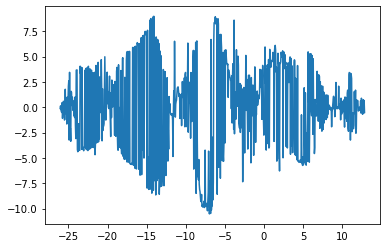

In [62]:
with torch.no_grad():
    plt.plot(xdos,M_soap(train_data_soap[:][0][1]))